In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'P2_2.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain]
x_val = xval
y_val = [yval,yval]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM, fx

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 934)      3508104     input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 364)      340340      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        730         dense[0][0]                      
_______________________________________________________________________________________

In [24]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/Desktop/Bayes_Lstm_P2/Model Checkpoint/P2_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [25]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik},loss_weights=[0.5,0.5],optimizer= 'Adam')

In [26]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 51069120.00000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00002: val_loss improved from 51069120.00000 to 36604144.00000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00003: val_loss improved from 36604144.00000 to 33262164.00000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00004: val_loss improved from 33262164.00000 to 32599208.00000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00005: val_loss did not improve from 32599208.00000

Epoch 00006: val_loss improved from 32599208.00000 to 30066618.00000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00007: val_loss did not improve from 30066618.00000

Epoch 00008: val_loss improved from 30066618.


Epoch 00091: val_loss did not improve from 6214179.50000

Epoch 00092: val_loss did not improve from 6214179.50000

Epoch 00093: val_loss did not improve from 6214179.50000

Epoch 00094: val_loss improved from 6214179.50000 to 4264412.00000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00095: val_loss did not improve from 4264412.00000

Epoch 00096: val_loss did not improve from 4264412.00000

Epoch 00097: val_loss did not improve from 4264412.00000

Epoch 00098: val_loss did not improve from 4264412.00000

Epoch 00099: val_loss did not improve from 4264412.00000

Epoch 00100: val_loss did not improve from 4264412.00000

Epoch 00101: val_loss improved from 4264412.00000 to 3915171.25000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00102: val_loss did not improve from 3915171.25000

Epoch 00103: val_loss improved from 3915171.25000 to 3598562.50000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpo


Epoch 00209: val_loss did not improve from 1007641.81250

Epoch 00210: val_loss did not improve from 1007641.81250

Epoch 00211: val_loss did not improve from 1007641.81250

Epoch 00212: val_loss did not improve from 1007641.81250

Epoch 00213: val_loss did not improve from 1007641.81250

Epoch 00214: val_loss did not improve from 1007641.81250

Epoch 00215: val_loss did not improve from 1007641.81250

Epoch 00216: val_loss improved from 1007641.81250 to 998843.31250, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00217: val_loss did not improve from 998843.31250

Epoch 00218: val_loss did not improve from 998843.31250

Epoch 00219: val_loss did not improve from 998843.31250

Epoch 00220: val_loss did not improve from 998843.31250

Epoch 00221: val_loss did not improve from 998843.31250

Epoch 00222: val_loss did not improve from 998843.31250

Epoch 00223: val_loss did not improve from 998843.31250

Epoch 00224: val_loss did not improve from 998843.3


Epoch 00332: val_loss did not improve from 903733.62500

Epoch 00333: val_loss did not improve from 903733.62500

Epoch 00334: val_loss did not improve from 903733.62500

Epoch 00335: val_loss did not improve from 903733.62500

Epoch 00336: val_loss did not improve from 903733.62500

Epoch 00337: val_loss improved from 903733.62500 to 877595.75000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00338: val_loss did not improve from 877595.75000

Epoch 00339: val_loss did not improve from 877595.75000

Epoch 00340: val_loss did not improve from 877595.75000

Epoch 00341: val_loss did not improve from 877595.75000

Epoch 00342: val_loss did not improve from 877595.75000

Epoch 00343: val_loss did not improve from 877595.75000

Epoch 00344: val_loss did not improve from 877595.75000

Epoch 00345: val_loss did not improve from 877595.75000

Epoch 00346: val_loss did not improve from 877595.75000

Epoch 00347: val_loss did not improve from 877595.75000

Ep


Epoch 00455: val_loss did not improve from 763517.50000

Epoch 00456: val_loss did not improve from 763517.50000

Epoch 00457: val_loss improved from 763517.50000 to 750799.00000, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00458: val_loss did not improve from 750799.00000

Epoch 00459: val_loss did not improve from 750799.00000

Epoch 00460: val_loss did not improve from 750799.00000

Epoch 00461: val_loss did not improve from 750799.00000

Epoch 00462: val_loss did not improve from 750799.00000

Epoch 00463: val_loss did not improve from 750799.00000

Epoch 00464: val_loss did not improve from 750799.00000

Epoch 00465: val_loss improved from 750799.00000 to 738017.62500, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00466: val_loss did not improve from 738017.62500

Epoch 00467: val_loss did not improve from 738017.62500

Epoch 00468: val_loss did not improve from 738017.62500

Epoch 00469: val_loss did not i


Epoch 00572: val_loss improved from 617949.31250 to 613111.68750, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00573: val_loss did not improve from 613111.68750

Epoch 00574: val_loss did not improve from 613111.68750

Epoch 00575: val_loss did not improve from 613111.68750

Epoch 00576: val_loss did not improve from 613111.68750

Epoch 00577: val_loss improved from 613111.68750 to 611350.18750, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00578: val_loss did not improve from 611350.18750

Epoch 00579: val_loss did not improve from 611350.18750

Epoch 00580: val_loss did not improve from 611350.18750

Epoch 00581: val_loss did not improve from 611350.18750

Epoch 00582: val_loss did not improve from 611350.18750

Epoch 00583: val_loss did not improve from 611350.18750

Epoch 00584: val_loss did not improve from 611350.18750

Epoch 00585: val_loss improved from 611350.18750 to 603014.43750, saving model to C:/Use


Epoch 00688: val_loss did not improve from 498382.96875

Epoch 00689: val_loss improved from 498382.96875 to 491375.43750, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00690: val_loss did not improve from 491375.43750

Epoch 00691: val_loss improved from 491375.43750 to 485201.87500, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00692: val_loss did not improve from 485201.87500

Epoch 00693: val_loss did not improve from 485201.87500

Epoch 00694: val_loss did not improve from 485201.87500

Epoch 00695: val_loss did not improve from 485201.87500

Epoch 00696: val_loss did not improve from 485201.87500

Epoch 00697: val_loss did not improve from 485201.87500

Epoch 00698: val_loss did not improve from 485201.87500

Epoch 00699: val_loss did not improve from 485201.87500

Epoch 00700: val_loss did not improve from 485201.87500

Epoch 00701: val_loss did not improve from 485201.87500

Epoch 00702: val_loss did not i


Epoch 00804: val_loss did not improve from 378744.56250

Epoch 00805: val_loss did not improve from 378744.56250

Epoch 00806: val_loss did not improve from 378744.56250

Epoch 00807: val_loss improved from 378744.56250 to 368171.12500, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00808: val_loss improved from 368171.12500 to 367334.15625, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00809: val_loss did not improve from 367334.15625

Epoch 00810: val_loss did not improve from 367334.15625

Epoch 00811: val_loss did not improve from 367334.15625

Epoch 00812: val_loss did not improve from 367334.15625

Epoch 00813: val_loss did not improve from 367334.15625

Epoch 00814: val_loss did not improve from 367334.15625

Epoch 00815: val_loss did not improve from 367334.15625

Epoch 00816: val_loss did not improve from 367334.15625

Epoch 00817: val_loss improved from 367334.15625 to 352577.81250, saving model to C:/Use


Epoch 00921: val_loss did not improve from 267644.03125

Epoch 00922: val_loss did not improve from 267644.03125

Epoch 00923: val_loss did not improve from 267644.03125

Epoch 00924: val_loss did not improve from 267644.03125

Epoch 00925: val_loss did not improve from 267644.03125

Epoch 00926: val_loss did not improve from 267644.03125

Epoch 00927: val_loss did not improve from 267644.03125

Epoch 00928: val_loss did not improve from 267644.03125

Epoch 00929: val_loss did not improve from 267644.03125

Epoch 00930: val_loss improved from 267644.03125 to 260599.18750, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 00931: val_loss did not improve from 260599.18750

Epoch 00932: val_loss did not improve from 260599.18750

Epoch 00933: val_loss did not improve from 260599.18750

Epoch 00934: val_loss did not improve from 260599.18750

Epoch 00935: val_loss did not improve from 260599.18750

Epoch 00936: val_loss improved from 260599.18750 to 255339.


Epoch 01042: val_loss did not improve from 178825.14062

Epoch 01043: val_loss did not improve from 178825.14062

Epoch 01044: val_loss did not improve from 178825.14062

Epoch 01045: val_loss did not improve from 178825.14062

Epoch 01046: val_loss improved from 178825.14062 to 176673.68750, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 01047: val_loss did not improve from 176673.68750

Epoch 01048: val_loss did not improve from 176673.68750

Epoch 01049: val_loss did not improve from 176673.68750

Epoch 01050: val_loss did not improve from 176673.68750

Epoch 01051: val_loss did not improve from 176673.68750

Epoch 01052: val_loss did not improve from 176673.68750

Epoch 01053: val_loss did not improve from 176673.68750

Epoch 01054: val_loss did not improve from 176673.68750

Epoch 01055: val_loss did not improve from 176673.68750

Epoch 01056: val_loss did not improve from 176673.68750

Epoch 01057: val_loss improved from 176673.68750 to 171245.


Epoch 01167: val_loss did not improve from 119184.00000

Epoch 01168: val_loss did not improve from 119184.00000

Epoch 01169: val_loss did not improve from 119184.00000

Epoch 01170: val_loss did not improve from 119184.00000

Epoch 01171: val_loss did not improve from 119184.00000

Epoch 01172: val_loss did not improve from 119184.00000

Epoch 01173: val_loss did not improve from 119184.00000

Epoch 01174: val_loss did not improve from 119184.00000

Epoch 01175: val_loss did not improve from 119184.00000

Epoch 01176: val_loss did not improve from 119184.00000

Epoch 01177: val_loss did not improve from 119184.00000

Epoch 01178: val_loss did not improve from 119184.00000

Epoch 01179: val_loss did not improve from 119184.00000

Epoch 01180: val_loss did not improve from 119184.00000

Epoch 01181: val_loss improved from 119184.00000 to 119129.78906, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 01182: val_loss did not improve from 119129.78906

Ep


Epoch 01298: val_loss did not improve from 65116.33203

Epoch 01299: val_loss did not improve from 65116.33203

Epoch 01300: val_loss did not improve from 65116.33203

Epoch 01301: val_loss did not improve from 65116.33203

Epoch 01302: val_loss did not improve from 65116.33203

Epoch 01303: val_loss improved from 65116.33203 to 61281.66016, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 01304: val_loss did not improve from 61281.66016

Epoch 01305: val_loss did not improve from 61281.66016

Epoch 01306: val_loss did not improve from 61281.66016

Epoch 01307: val_loss did not improve from 61281.66016

Epoch 01308: val_loss did not improve from 61281.66016

Epoch 01309: val_loss did not improve from 61281.66016

Epoch 01310: val_loss did not improve from 61281.66016

Epoch 01311: val_loss did not improve from 61281.66016

Epoch 01312: val_loss did not improve from 61281.66016

Epoch 01313: val_loss did not improve from 61281.66016

Epoch 01314: val_lo


Epoch 01433: val_loss did not improve from 29813.77930

Epoch 01434: val_loss improved from 29813.77930 to 26831.94336, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 01435: val_loss did not improve from 26831.94336

Epoch 01436: val_loss improved from 26831.94336 to 24570.30859, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 01437: val_loss did not improve from 24570.30859

Epoch 01438: val_loss did not improve from 24570.30859

Epoch 01439: val_loss did not improve from 24570.30859

Epoch 01440: val_loss did not improve from 24570.30859

Epoch 01441: val_loss did not improve from 24570.30859

Epoch 01442: val_loss did not improve from 24570.30859

Epoch 01443: val_loss did not improve from 24570.30859

Epoch 01444: val_loss did not improve from 24570.30859

Epoch 01445: val_loss did not improve from 24570.30859

Epoch 01446: val_loss did not improve from 24570.30859

Epoch 01447: val_loss did not improve from 2457


Epoch 01573: val_loss did not improve from 6845.04150

Epoch 01574: val_loss did not improve from 6845.04150

Epoch 01575: val_loss did not improve from 6845.04150

Epoch 01576: val_loss did not improve from 6845.04150

Epoch 01577: val_loss did not improve from 6845.04150

Epoch 01578: val_loss did not improve from 6845.04150

Epoch 01579: val_loss did not improve from 6845.04150

Epoch 01580: val_loss did not improve from 6845.04150

Epoch 01581: val_loss did not improve from 6845.04150

Epoch 01582: val_loss did not improve from 6845.04150

Epoch 01583: val_loss did not improve from 6845.04150

Epoch 01584: val_loss did not improve from 6845.04150

Epoch 01585: val_loss did not improve from 6845.04150

Epoch 01586: val_loss did not improve from 6845.04150

Epoch 01587: val_loss did not improve from 6845.04150

Epoch 01588: val_loss did not improve from 6845.04150

Epoch 01589: val_loss did not improve from 6845.04150

Epoch 01590: val_loss did not improve from 6845.04150

Epoch 015


Epoch 01719: val_loss did not improve from 5910.82227

Epoch 01720: val_loss did not improve from 5910.82227

Epoch 01721: val_loss did not improve from 5910.82227

Epoch 01722: val_loss did not improve from 5910.82227

Epoch 01723: val_loss did not improve from 5910.82227

Epoch 01724: val_loss did not improve from 5910.82227

Epoch 01725: val_loss did not improve from 5910.82227

Epoch 01726: val_loss did not improve from 5910.82227

Epoch 01727: val_loss did not improve from 5910.82227

Epoch 01728: val_loss did not improve from 5910.82227

Epoch 01729: val_loss did not improve from 5910.82227

Epoch 01730: val_loss did not improve from 5910.82227

Epoch 01731: val_loss did not improve from 5910.82227

Epoch 01732: val_loss did not improve from 5910.82227

Epoch 01733: val_loss did not improve from 5910.82227

Epoch 01734: val_loss did not improve from 5910.82227

Epoch 01735: val_loss did not improve from 5910.82227

Epoch 01736: val_loss did not improve from 5910.82227

Epoch 017


Epoch 01868: val_loss did not improve from 5910.82227

Epoch 01869: val_loss did not improve from 5910.82227

Epoch 01870: val_loss did not improve from 5910.82227

Epoch 01871: val_loss did not improve from 5910.82227

Epoch 01872: val_loss did not improve from 5910.82227

Epoch 01873: val_loss did not improve from 5910.82227

Epoch 01874: val_loss did not improve from 5910.82227

Epoch 01875: val_loss did not improve from 5910.82227

Epoch 01876: val_loss did not improve from 5910.82227

Epoch 01877: val_loss did not improve from 5910.82227

Epoch 01878: val_loss did not improve from 5910.82227

Epoch 01879: val_loss did not improve from 5910.82227

Epoch 01880: val_loss did not improve from 5910.82227

Epoch 01881: val_loss did not improve from 5910.82227

Epoch 01882: val_loss did not improve from 5910.82227

Epoch 01883: val_loss did not improve from 5910.82227

Epoch 01884: val_loss did not improve from 5910.82227

Epoch 01885: val_loss did not improve from 5910.82227

Epoch 018


Epoch 02017: val_loss did not improve from 5910.82227

Epoch 02018: val_loss did not improve from 5910.82227

Epoch 02019: val_loss did not improve from 5910.82227

Epoch 02020: val_loss did not improve from 5910.82227

Epoch 02021: val_loss did not improve from 5910.82227

Epoch 02022: val_loss did not improve from 5910.82227

Epoch 02023: val_loss did not improve from 5910.82227

Epoch 02024: val_loss did not improve from 5910.82227

Epoch 02025: val_loss did not improve from 5910.82227

Epoch 02026: val_loss did not improve from 5910.82227

Epoch 02027: val_loss did not improve from 5910.82227

Epoch 02028: val_loss did not improve from 5910.82227

Epoch 02029: val_loss did not improve from 5910.82227

Epoch 02030: val_loss did not improve from 5910.82227

Epoch 02031: val_loss did not improve from 5910.82227

Epoch 02032: val_loss did not improve from 5910.82227

Epoch 02033: val_loss did not improve from 5910.82227

Epoch 02034: val_loss did not improve from 5910.82227

Epoch 020


Epoch 02165: val_loss did not improve from 5371.87695

Epoch 02166: val_loss did not improve from 5371.87695

Epoch 02167: val_loss did not improve from 5371.87695

Epoch 02168: val_loss did not improve from 5371.87695

Epoch 02169: val_loss did not improve from 5371.87695

Epoch 02170: val_loss did not improve from 5371.87695

Epoch 02171: val_loss did not improve from 5371.87695

Epoch 02172: val_loss did not improve from 5371.87695

Epoch 02173: val_loss did not improve from 5371.87695

Epoch 02174: val_loss did not improve from 5371.87695

Epoch 02175: val_loss did not improve from 5371.87695

Epoch 02176: val_loss did not improve from 5371.87695

Epoch 02177: val_loss did not improve from 5371.87695

Epoch 02178: val_loss improved from 5371.87695 to 5132.79248, saving model to C:/Users/Asus/Desktop/New folder2/model checkpoint\P2_ckpt

Epoch 02179: val_loss did not improve from 5132.79248

Epoch 02180: val_loss did not improve from 5132.79248

Epoch 02181: val_loss did not improv


Epoch 02313: val_loss did not improve from 5132.79248

Epoch 02314: val_loss did not improve from 5132.79248

Epoch 02315: val_loss did not improve from 5132.79248

Epoch 02316: val_loss did not improve from 5132.79248

Epoch 02317: val_loss did not improve from 5132.79248

Epoch 02318: val_loss did not improve from 5132.79248

Epoch 02319: val_loss did not improve from 5132.79248

Epoch 02320: val_loss did not improve from 5132.79248

Epoch 02321: val_loss did not improve from 5132.79248

Epoch 02322: val_loss did not improve from 5132.79248

Epoch 02323: val_loss did not improve from 5132.79248

Epoch 02324: val_loss did not improve from 5132.79248

Epoch 02325: val_loss did not improve from 5132.79248

Epoch 02326: val_loss did not improve from 5132.79248

Epoch 02327: val_loss did not improve from 5132.79248

Epoch 02328: val_loss did not improve from 5132.79248

Epoch 02329: val_loss did not improve from 5132.79248

Epoch 02330: val_loss did not improve from 5132.79248

Epoch 023


Epoch 02462: val_loss did not improve from 5132.79248

Epoch 02463: val_loss did not improve from 5132.79248

Epoch 02464: val_loss did not improve from 5132.79248

Epoch 02465: val_loss did not improve from 5132.79248

Epoch 02466: val_loss did not improve from 5132.79248

Epoch 02467: val_loss did not improve from 5132.79248

Epoch 02468: val_loss did not improve from 5132.79248

Epoch 02469: val_loss did not improve from 5132.79248

Epoch 02470: val_loss did not improve from 5132.79248

Epoch 02471: val_loss did not improve from 5132.79248

Epoch 02472: val_loss did not improve from 5132.79248

Epoch 02473: val_loss did not improve from 5132.79248

Epoch 02474: val_loss did not improve from 5132.79248

Epoch 02475: val_loss did not improve from 5132.79248

Epoch 02476: val_loss did not improve from 5132.79248

Epoch 02477: val_loss did not improve from 5132.79248

Epoch 02478: val_loss did not improve from 5132.79248

Epoch 02479: val_loss did not improve from 5132.79248

Epoch 024


Epoch 02610: val_loss did not improve from 5050.03662

Epoch 02611: val_loss did not improve from 5050.03662

Epoch 02612: val_loss did not improve from 5050.03662

Epoch 02613: val_loss did not improve from 5050.03662

Epoch 02614: val_loss did not improve from 5050.03662

Epoch 02615: val_loss did not improve from 5050.03662

Epoch 02616: val_loss did not improve from 5050.03662

Epoch 02617: val_loss did not improve from 5050.03662

Epoch 02618: val_loss did not improve from 5050.03662

Epoch 02619: val_loss did not improve from 5050.03662

Epoch 02620: val_loss did not improve from 5050.03662

Epoch 02621: val_loss did not improve from 5050.03662

Epoch 02622: val_loss did not improve from 5050.03662

Epoch 02623: val_loss did not improve from 5050.03662

Epoch 02624: val_loss did not improve from 5050.03662

Epoch 02625: val_loss did not improve from 5050.03662

Epoch 02626: val_loss did not improve from 5050.03662

Epoch 02627: val_loss did not improve from 5050.03662

Epoch 026


Epoch 02759: val_loss did not improve from 5050.03662

Epoch 02760: val_loss did not improve from 5050.03662

Epoch 02761: val_loss did not improve from 5050.03662

Epoch 02762: val_loss did not improve from 5050.03662

Epoch 02763: val_loss did not improve from 5050.03662

Epoch 02764: val_loss did not improve from 5050.03662

Epoch 02765: val_loss did not improve from 5050.03662

Epoch 02766: val_loss did not improve from 5050.03662

Epoch 02767: val_loss did not improve from 5050.03662

Epoch 02768: val_loss did not improve from 5050.03662

Epoch 02769: val_loss did not improve from 5050.03662

Epoch 02770: val_loss did not improve from 5050.03662

Epoch 02771: val_loss did not improve from 5050.03662

Epoch 02772: val_loss did not improve from 5050.03662

Epoch 02773: val_loss did not improve from 5050.03662

Epoch 02774: val_loss did not improve from 5050.03662

Epoch 02775: val_loss did not improve from 5050.03662

Epoch 02776: val_loss did not improve from 5050.03662

Epoch 027


Epoch 02908: val_loss did not improve from 5050.03662

Epoch 02909: val_loss did not improve from 5050.03662

Epoch 02910: val_loss did not improve from 5050.03662

Epoch 02911: val_loss did not improve from 5050.03662

Epoch 02912: val_loss did not improve from 5050.03662

Epoch 02913: val_loss did not improve from 5050.03662

Epoch 02914: val_loss did not improve from 5050.03662

Epoch 02915: val_loss did not improve from 5050.03662

Epoch 02916: val_loss did not improve from 5050.03662

Epoch 02917: val_loss did not improve from 5050.03662

Epoch 02918: val_loss did not improve from 5050.03662

Epoch 02919: val_loss did not improve from 5050.03662

Epoch 02920: val_loss did not improve from 5050.03662

Epoch 02921: val_loss did not improve from 5050.03662

Epoch 02922: val_loss did not improve from 5050.03662

Epoch 02923: val_loss did not improve from 5050.03662

Epoch 02924: val_loss did not improve from 5050.03662

Epoch 02925: val_loss did not improve from 5050.03662

Epoch 029


Epoch 03057: val_loss did not improve from 5050.03662

Epoch 03058: val_loss did not improve from 5050.03662

Epoch 03059: val_loss did not improve from 5050.03662

Epoch 03060: val_loss did not improve from 5050.03662

Epoch 03061: val_loss did not improve from 5050.03662

Epoch 03062: val_loss did not improve from 5050.03662

Epoch 03063: val_loss did not improve from 5050.03662

Epoch 03064: val_loss did not improve from 5050.03662

Epoch 03065: val_loss did not improve from 5050.03662

Epoch 03066: val_loss did not improve from 5050.03662

Epoch 03067: val_loss did not improve from 5050.03662

Epoch 03068: val_loss did not improve from 5050.03662

Epoch 03069: val_loss did not improve from 5050.03662

Epoch 03070: val_loss did not improve from 5050.03662

Epoch 03071: val_loss did not improve from 5050.03662

Epoch 03072: val_loss did not improve from 5050.03662

Epoch 03073: val_loss did not improve from 5050.03662

Epoch 03074: val_loss did not improve from 5050.03662

Epoch 030


Epoch 03206: val_loss did not improve from 5050.03662

Epoch 03207: val_loss did not improve from 5050.03662

Epoch 03208: val_loss did not improve from 5050.03662

Epoch 03209: val_loss did not improve from 5050.03662

Epoch 03210: val_loss did not improve from 5050.03662

Epoch 03211: val_loss did not improve from 5050.03662

Epoch 03212: val_loss did not improve from 5050.03662

Epoch 03213: val_loss did not improve from 5050.03662

Epoch 03214: val_loss did not improve from 5050.03662

Epoch 03215: val_loss did not improve from 5050.03662

Epoch 03216: val_loss did not improve from 5050.03662

Epoch 03217: val_loss did not improve from 5050.03662

Epoch 03218: val_loss did not improve from 5050.03662

Epoch 03219: val_loss did not improve from 5050.03662

Epoch 03220: val_loss did not improve from 5050.03662

Epoch 03221: val_loss did not improve from 5050.03662

Epoch 03222: val_loss did not improve from 5050.03662

Epoch 03223: val_loss did not improve from 5050.03662

Epoch 032


Epoch 03355: val_loss did not improve from 5050.03662

Epoch 03356: val_loss did not improve from 5050.03662

Epoch 03357: val_loss did not improve from 5050.03662

Epoch 03358: val_loss did not improve from 5050.03662

Epoch 03359: val_loss did not improve from 5050.03662

Epoch 03360: val_loss did not improve from 5050.03662

Epoch 03361: val_loss did not improve from 5050.03662

Epoch 03362: val_loss did not improve from 5050.03662

Epoch 03363: val_loss did not improve from 5050.03662

Epoch 03364: val_loss did not improve from 5050.03662

Epoch 03365: val_loss did not improve from 5050.03662

Epoch 03366: val_loss did not improve from 5050.03662

Epoch 03367: val_loss did not improve from 5050.03662

Epoch 03368: val_loss did not improve from 5050.03662

Epoch 03369: val_loss did not improve from 5050.03662

Epoch 03370: val_loss did not improve from 5050.03662

Epoch 03371: val_loss did not improve from 5050.03662

Epoch 03372: val_loss did not improve from 5050.03662

Epoch 033


Epoch 03504: val_loss did not improve from 5050.03662

Epoch 03505: val_loss did not improve from 5050.03662

Epoch 03506: val_loss did not improve from 5050.03662

Epoch 03507: val_loss did not improve from 5050.03662

Epoch 03508: val_loss did not improve from 5050.03662

Epoch 03509: val_loss did not improve from 5050.03662

Epoch 03510: val_loss did not improve from 5050.03662

Epoch 03511: val_loss did not improve from 5050.03662

Epoch 03512: val_loss did not improve from 5050.03662

Epoch 03513: val_loss did not improve from 5050.03662

Epoch 03514: val_loss did not improve from 5050.03662

Epoch 03515: val_loss did not improve from 5050.03662

Epoch 03516: val_loss did not improve from 5050.03662

Epoch 03517: val_loss did not improve from 5050.03662

Epoch 03518: val_loss did not improve from 5050.03662

Epoch 03519: val_loss did not improve from 5050.03662

Epoch 03520: val_loss did not improve from 5050.03662

Epoch 03521: val_loss did not improve from 5050.03662

Epoch 035


Epoch 03653: val_loss did not improve from 5050.03662

Epoch 03654: val_loss did not improve from 5050.03662

Epoch 03655: val_loss did not improve from 5050.03662

Epoch 03656: val_loss did not improve from 5050.03662

Epoch 03657: val_loss did not improve from 5050.03662

Epoch 03658: val_loss did not improve from 5050.03662

Epoch 03659: val_loss did not improve from 5050.03662

Epoch 03660: val_loss did not improve from 5050.03662

Epoch 03661: val_loss did not improve from 5050.03662

Epoch 03662: val_loss did not improve from 5050.03662

Epoch 03663: val_loss did not improve from 5050.03662

Epoch 03664: val_loss did not improve from 5050.03662

Epoch 03665: val_loss did not improve from 5050.03662

Epoch 03666: val_loss did not improve from 5050.03662

Epoch 03667: val_loss did not improve from 5050.03662

Epoch 03668: val_loss did not improve from 5050.03662

Epoch 03669: val_loss did not improve from 5050.03662

Epoch 03670: val_loss did not improve from 5050.03662

Epoch 036


Epoch 03802: val_loss did not improve from 5050.03662

Epoch 03803: val_loss did not improve from 5050.03662

Epoch 03804: val_loss did not improve from 5050.03662

Epoch 03805: val_loss did not improve from 5050.03662

Epoch 03806: val_loss did not improve from 5050.03662

Epoch 03807: val_loss did not improve from 5050.03662

Epoch 03808: val_loss did not improve from 5050.03662

Epoch 03809: val_loss did not improve from 5050.03662

Epoch 03810: val_loss did not improve from 5050.03662

Epoch 03811: val_loss did not improve from 5050.03662

Epoch 03812: val_loss did not improve from 5050.03662

Epoch 03813: val_loss did not improve from 5050.03662

Epoch 03814: val_loss did not improve from 5050.03662

Epoch 03815: val_loss did not improve from 5050.03662

Epoch 03816: val_loss did not improve from 5050.03662

Epoch 03817: val_loss did not improve from 5050.03662

Epoch 03818: val_loss did not improve from 5050.03662

Epoch 03819: val_loss did not improve from 5050.03662

Epoch 038


Epoch 03951: val_loss did not improve from 5050.03662

Epoch 03952: val_loss did not improve from 5050.03662

Epoch 03953: val_loss did not improve from 5050.03662

Epoch 03954: val_loss did not improve from 5050.03662

Epoch 03955: val_loss did not improve from 5050.03662

Epoch 03956: val_loss did not improve from 5050.03662

Epoch 03957: val_loss did not improve from 5050.03662

Epoch 03958: val_loss did not improve from 5050.03662

Epoch 03959: val_loss did not improve from 5050.03662

Epoch 03960: val_loss did not improve from 5050.03662

Epoch 03961: val_loss did not improve from 5050.03662

Epoch 03962: val_loss did not improve from 5050.03662

Epoch 03963: val_loss did not improve from 5050.03662

Epoch 03964: val_loss did not improve from 5050.03662

Epoch 03965: val_loss did not improve from 5050.03662

Epoch 03966: val_loss did not improve from 5050.03662

Epoch 03967: val_loss did not improve from 5050.03662

Epoch 03968: val_loss did not improve from 5050.03662

Epoch 039


Epoch 04100: val_loss did not improve from 5050.03662

Epoch 04101: val_loss did not improve from 5050.03662

Epoch 04102: val_loss did not improve from 5050.03662

Epoch 04103: val_loss did not improve from 5050.03662

Epoch 04104: val_loss did not improve from 5050.03662

Epoch 04105: val_loss did not improve from 5050.03662

Epoch 04106: val_loss did not improve from 5050.03662

Epoch 04107: val_loss did not improve from 5050.03662

Epoch 04108: val_loss did not improve from 5050.03662

Epoch 04109: val_loss did not improve from 5050.03662

Epoch 04110: val_loss did not improve from 5050.03662

Epoch 04111: val_loss did not improve from 5050.03662

Epoch 04112: val_loss did not improve from 5050.03662

Epoch 04113: val_loss did not improve from 5050.03662

Epoch 04114: val_loss did not improve from 5050.03662

Epoch 04115: val_loss did not improve from 5050.03662

Epoch 04116: val_loss did not improve from 5050.03662

Epoch 04117: val_loss did not improve from 5050.03662

Epoch 041


Epoch 04249: val_loss did not improve from 5050.03662

Epoch 04250: val_loss did not improve from 5050.03662

Epoch 04251: val_loss did not improve from 5050.03662

Epoch 04252: val_loss did not improve from 5050.03662

Epoch 04253: val_loss did not improve from 5050.03662

Epoch 04254: val_loss did not improve from 5050.03662

Epoch 04255: val_loss did not improve from 5050.03662

Epoch 04256: val_loss did not improve from 5050.03662

Epoch 04257: val_loss did not improve from 5050.03662

Epoch 04258: val_loss did not improve from 5050.03662

Epoch 04259: val_loss did not improve from 5050.03662

Epoch 04260: val_loss did not improve from 5050.03662

Epoch 04261: val_loss did not improve from 5050.03662

Epoch 04262: val_loss did not improve from 5050.03662

Epoch 04263: val_loss did not improve from 5050.03662

Epoch 04264: val_loss did not improve from 5050.03662

Epoch 04265: val_loss did not improve from 5050.03662

Epoch 04266: val_loss did not improve from 5050.03662

Epoch 042


Epoch 04398: val_loss did not improve from 5050.03662

Epoch 04399: val_loss did not improve from 5050.03662

Epoch 04400: val_loss did not improve from 5050.03662

Epoch 04401: val_loss did not improve from 5050.03662

Epoch 04402: val_loss did not improve from 5050.03662

Epoch 04403: val_loss did not improve from 5050.03662

Epoch 04404: val_loss did not improve from 5050.03662

Epoch 04405: val_loss did not improve from 5050.03662

Epoch 04406: val_loss did not improve from 5050.03662

Epoch 04407: val_loss did not improve from 5050.03662

Epoch 04408: val_loss did not improve from 5050.03662

Epoch 04409: val_loss did not improve from 5050.03662

Epoch 04410: val_loss did not improve from 5050.03662

Epoch 04411: val_loss did not improve from 5050.03662

Epoch 04412: val_loss did not improve from 5050.03662

Epoch 04413: val_loss did not improve from 5050.03662

Epoch 04414: val_loss did not improve from 5050.03662

Epoch 04415: val_loss did not improve from 5050.03662

Epoch 044


Epoch 04547: val_loss did not improve from 5050.03662

Epoch 04548: val_loss did not improve from 5050.03662

Epoch 04549: val_loss did not improve from 5050.03662

Epoch 04550: val_loss did not improve from 5050.03662

Epoch 04551: val_loss did not improve from 5050.03662

Epoch 04552: val_loss did not improve from 5050.03662

Epoch 04553: val_loss did not improve from 5050.03662

Epoch 04554: val_loss did not improve from 5050.03662

Epoch 04555: val_loss did not improve from 5050.03662

Epoch 04556: val_loss did not improve from 5050.03662

Epoch 04557: val_loss did not improve from 5050.03662

Epoch 04558: val_loss did not improve from 5050.03662

Epoch 04559: val_loss did not improve from 5050.03662

Epoch 04560: val_loss did not improve from 5050.03662

Epoch 04561: val_loss did not improve from 5050.03662

Epoch 04562: val_loss did not improve from 5050.03662

Epoch 04563: val_loss did not improve from 5050.03662

Epoch 04564: val_loss did not improve from 5050.03662

Epoch 045


Epoch 04696: val_loss did not improve from 5050.03662

Epoch 04697: val_loss did not improve from 5050.03662

Epoch 04698: val_loss did not improve from 5050.03662

Epoch 04699: val_loss did not improve from 5050.03662

Epoch 04700: val_loss did not improve from 5050.03662

Epoch 04701: val_loss did not improve from 5050.03662

Epoch 04702: val_loss did not improve from 5050.03662

Epoch 04703: val_loss did not improve from 5050.03662

Epoch 04704: val_loss did not improve from 5050.03662

Epoch 04705: val_loss did not improve from 5050.03662

Epoch 04706: val_loss did not improve from 5050.03662

Epoch 04707: val_loss did not improve from 5050.03662

Epoch 04708: val_loss did not improve from 5050.03662

Epoch 04709: val_loss did not improve from 5050.03662

Epoch 04710: val_loss did not improve from 5050.03662

Epoch 04711: val_loss did not improve from 5050.03662

Epoch 04712: val_loss did not improve from 5050.03662

Epoch 04713: val_loss did not improve from 5050.03662

Epoch 047


Epoch 04845: val_loss did not improve from 5050.03662

Epoch 04846: val_loss did not improve from 5050.03662

Epoch 04847: val_loss did not improve from 5050.03662

Epoch 04848: val_loss did not improve from 5050.03662

Epoch 04849: val_loss did not improve from 5050.03662

Epoch 04850: val_loss did not improve from 5050.03662

Epoch 04851: val_loss did not improve from 5050.03662

Epoch 04852: val_loss did not improve from 5050.03662

Epoch 04853: val_loss did not improve from 5050.03662

Epoch 04854: val_loss did not improve from 5050.03662

Epoch 04855: val_loss did not improve from 5050.03662

Epoch 04856: val_loss did not improve from 5050.03662

Epoch 04857: val_loss did not improve from 5050.03662

Epoch 04858: val_loss did not improve from 5050.03662

Epoch 04859: val_loss did not improve from 5050.03662

Epoch 04860: val_loss did not improve from 5050.03662

Epoch 04861: val_loss did not improve from 5050.03662

Epoch 04862: val_loss did not improve from 5050.03662

Epoch 048


Epoch 04994: val_loss did not improve from 5050.03662

Epoch 04995: val_loss did not improve from 5050.03662

Epoch 04996: val_loss did not improve from 5050.03662

Epoch 04997: val_loss did not improve from 5050.03662

Epoch 04998: val_loss did not improve from 5050.03662

Epoch 04999: val_loss did not improve from 5050.03662

Epoch 05000: val_loss did not improve from 5050.03662

Epoch 05001: val_loss did not improve from 5050.03662

Epoch 05002: val_loss did not improve from 5050.03662

Epoch 05003: val_loss did not improve from 5050.03662

Epoch 05004: val_loss did not improve from 5050.03662

Epoch 05005: val_loss did not improve from 5050.03662

Epoch 05006: val_loss did not improve from 5050.03662

Epoch 05007: val_loss did not improve from 5050.03662

Epoch 05008: val_loss did not improve from 5050.03662

Epoch 05009: val_loss did not improve from 5050.03662

Epoch 05010: val_loss did not improve from 5050.03662

Epoch 05011: val_loss did not improve from 5050.03662

Epoch 050


Epoch 05143: val_loss did not improve from 5050.03662

Epoch 05144: val_loss did not improve from 5050.03662

Epoch 05145: val_loss did not improve from 5050.03662

Epoch 05146: val_loss did not improve from 5050.03662

Epoch 05147: val_loss did not improve from 5050.03662

Epoch 05148: val_loss did not improve from 5050.03662

Epoch 05149: val_loss did not improve from 5050.03662

Epoch 05150: val_loss did not improve from 5050.03662

Epoch 05151: val_loss did not improve from 5050.03662

Epoch 05152: val_loss did not improve from 5050.03662

Epoch 05153: val_loss did not improve from 5050.03662

Epoch 05154: val_loss did not improve from 5050.03662

Epoch 05155: val_loss did not improve from 5050.03662

Epoch 05156: val_loss did not improve from 5050.03662

Epoch 05157: val_loss did not improve from 5050.03662

Epoch 05158: val_loss did not improve from 5050.03662

Epoch 05159: val_loss did not improve from 5050.03662

Epoch 05160: val_loss did not improve from 5050.03662

Epoch 051


Epoch 05292: val_loss did not improve from 5050.03662

Epoch 05293: val_loss did not improve from 5050.03662

Epoch 05294: val_loss did not improve from 5050.03662

Epoch 05295: val_loss did not improve from 5050.03662

Epoch 05296: val_loss did not improve from 5050.03662

Epoch 05297: val_loss did not improve from 5050.03662

Epoch 05298: val_loss did not improve from 5050.03662

Epoch 05299: val_loss did not improve from 5050.03662

Epoch 05300: val_loss did not improve from 5050.03662

Epoch 05301: val_loss did not improve from 5050.03662

Epoch 05302: val_loss did not improve from 5050.03662

Epoch 05303: val_loss did not improve from 5050.03662

Epoch 05304: val_loss did not improve from 5050.03662

Epoch 05305: val_loss did not improve from 5050.03662

Epoch 05306: val_loss did not improve from 5050.03662

Epoch 05307: val_loss did not improve from 5050.03662

Epoch 05308: val_loss did not improve from 5050.03662

Epoch 05309: val_loss did not improve from 5050.03662

Epoch 053


Epoch 05441: val_loss did not improve from 5050.03662

Epoch 05442: val_loss did not improve from 5050.03662

Epoch 05443: val_loss did not improve from 5050.03662

Epoch 05444: val_loss did not improve from 5050.03662

Epoch 05445: val_loss did not improve from 5050.03662

Epoch 05446: val_loss did not improve from 5050.03662

Epoch 05447: val_loss did not improve from 5050.03662

Epoch 05448: val_loss did not improve from 5050.03662

Epoch 05449: val_loss did not improve from 5050.03662

Epoch 05450: val_loss did not improve from 5050.03662

Epoch 05451: val_loss did not improve from 5050.03662

Epoch 05452: val_loss did not improve from 5050.03662

Epoch 05453: val_loss did not improve from 5050.03662

Epoch 05454: val_loss did not improve from 5050.03662

Epoch 05455: val_loss did not improve from 5050.03662

Epoch 05456: val_loss did not improve from 5050.03662

Epoch 05457: val_loss did not improve from 5050.03662

Epoch 05458: val_loss did not improve from 5050.03662

Epoch 054


Epoch 05590: val_loss did not improve from 5050.03662

Epoch 05591: val_loss did not improve from 5050.03662

Epoch 05592: val_loss did not improve from 5050.03662

Epoch 05593: val_loss did not improve from 5050.03662

Epoch 05594: val_loss did not improve from 5050.03662

Epoch 05595: val_loss did not improve from 5050.03662

Epoch 05596: val_loss did not improve from 5050.03662

Epoch 05597: val_loss did not improve from 5050.03662

Epoch 05598: val_loss did not improve from 5050.03662

Epoch 05599: val_loss did not improve from 5050.03662

Epoch 05600: val_loss did not improve from 5050.03662

Epoch 05601: val_loss did not improve from 5050.03662

Epoch 05602: val_loss did not improve from 5050.03662

Epoch 05603: val_loss did not improve from 5050.03662

Epoch 05604: val_loss did not improve from 5050.03662

Epoch 05605: val_loss did not improve from 5050.03662

Epoch 05606: val_loss did not improve from 5050.03662

Epoch 05607: val_loss did not improve from 5050.03662

Epoch 056


Epoch 05739: val_loss did not improve from 5050.03662

Epoch 05740: val_loss did not improve from 5050.03662

Epoch 05741: val_loss did not improve from 5050.03662

Epoch 05742: val_loss did not improve from 5050.03662

Epoch 05743: val_loss did not improve from 5050.03662

Epoch 05744: val_loss did not improve from 5050.03662

Epoch 05745: val_loss did not improve from 5050.03662

Epoch 05746: val_loss did not improve from 5050.03662

Epoch 05747: val_loss did not improve from 5050.03662

Epoch 05748: val_loss did not improve from 5050.03662

Epoch 05749: val_loss did not improve from 5050.03662

Epoch 05750: val_loss did not improve from 5050.03662

Epoch 05751: val_loss did not improve from 5050.03662

Epoch 05752: val_loss did not improve from 5050.03662

Epoch 05753: val_loss did not improve from 5050.03662

Epoch 05754: val_loss did not improve from 5050.03662

Epoch 05755: val_loss did not improve from 5050.03662

Epoch 05756: val_loss did not improve from 5050.03662

Epoch 057


Epoch 05888: val_loss did not improve from 5050.03662

Epoch 05889: val_loss did not improve from 5050.03662

Epoch 05890: val_loss did not improve from 5050.03662

Epoch 05891: val_loss did not improve from 5050.03662

Epoch 05892: val_loss did not improve from 5050.03662

Epoch 05893: val_loss did not improve from 5050.03662

Epoch 05894: val_loss did not improve from 5050.03662

Epoch 05895: val_loss did not improve from 5050.03662

Epoch 05896: val_loss did not improve from 5050.03662

Epoch 05897: val_loss did not improve from 5050.03662

Epoch 05898: val_loss did not improve from 5050.03662

Epoch 05899: val_loss did not improve from 5050.03662

Epoch 05900: val_loss did not improve from 5050.03662

Epoch 05901: val_loss did not improve from 5050.03662

Epoch 05902: val_loss did not improve from 5050.03662

Epoch 05903: val_loss did not improve from 5050.03662

Epoch 05904: val_loss did not improve from 5050.03662

Epoch 05905: val_loss did not improve from 5050.03662

Epoch 059


Epoch 06037: val_loss did not improve from 5050.03662

Epoch 06038: val_loss did not improve from 5050.03662

Epoch 06039: val_loss did not improve from 5050.03662

Epoch 06040: val_loss did not improve from 5050.03662

Epoch 06041: val_loss did not improve from 5050.03662

Epoch 06042: val_loss did not improve from 5050.03662

Epoch 06043: val_loss did not improve from 5050.03662

Epoch 06044: val_loss did not improve from 5050.03662

Epoch 06045: val_loss did not improve from 5050.03662

Epoch 06046: val_loss did not improve from 5050.03662

Epoch 06047: val_loss did not improve from 5050.03662

Epoch 06048: val_loss did not improve from 5050.03662

Epoch 06049: val_loss did not improve from 5050.03662

Epoch 06050: val_loss did not improve from 5050.03662

Epoch 06051: val_loss did not improve from 5050.03662

Epoch 06052: val_loss did not improve from 5050.03662

Epoch 06053: val_loss did not improve from 5050.03662

Epoch 06054: val_loss did not improve from 5050.03662

Epoch 060


Epoch 06186: val_loss did not improve from 5050.03662

Epoch 06187: val_loss did not improve from 5050.03662

Epoch 06188: val_loss did not improve from 5050.03662

Epoch 06189: val_loss did not improve from 5050.03662

Epoch 06190: val_loss did not improve from 5050.03662

Epoch 06191: val_loss did not improve from 5050.03662

Epoch 06192: val_loss did not improve from 5050.03662

Epoch 06193: val_loss did not improve from 5050.03662

Epoch 06194: val_loss did not improve from 5050.03662

Epoch 06195: val_loss did not improve from 5050.03662

Epoch 06196: val_loss did not improve from 5050.03662

Epoch 06197: val_loss did not improve from 5050.03662

Epoch 06198: val_loss did not improve from 5050.03662

Epoch 06199: val_loss did not improve from 5050.03662

Epoch 06200: val_loss did not improve from 5050.03662

Epoch 06201: val_loss did not improve from 5050.03662

Epoch 06202: val_loss did not improve from 5050.03662

Epoch 06203: val_loss did not improve from 5050.03662

Epoch 062


Epoch 06335: val_loss did not improve from 5050.03662

Epoch 06336: val_loss did not improve from 5050.03662

Epoch 06337: val_loss did not improve from 5050.03662

Epoch 06338: val_loss did not improve from 5050.03662

Epoch 06339: val_loss did not improve from 5050.03662

Epoch 06340: val_loss did not improve from 5050.03662

Epoch 06341: val_loss did not improve from 5050.03662

Epoch 06342: val_loss did not improve from 5050.03662

Epoch 06343: val_loss did not improve from 5050.03662

Epoch 06344: val_loss did not improve from 5050.03662

Epoch 06345: val_loss did not improve from 5050.03662

Epoch 06346: val_loss did not improve from 5050.03662

Epoch 06347: val_loss did not improve from 5050.03662

Epoch 06348: val_loss did not improve from 5050.03662

Epoch 06349: val_loss did not improve from 5050.03662

Epoch 06350: val_loss did not improve from 5050.03662

Epoch 06351: val_loss did not improve from 5050.03662

Epoch 06352: val_loss did not improve from 5050.03662

Epoch 063


Epoch 06484: val_loss did not improve from 5050.03662

Epoch 06485: val_loss did not improve from 5050.03662

Epoch 06486: val_loss did not improve from 5050.03662

Epoch 06487: val_loss did not improve from 5050.03662

Epoch 06488: val_loss did not improve from 5050.03662

Epoch 06489: val_loss did not improve from 5050.03662

Epoch 06490: val_loss did not improve from 5050.03662

Epoch 06491: val_loss did not improve from 5050.03662

Epoch 06492: val_loss did not improve from 5050.03662

Epoch 06493: val_loss did not improve from 5050.03662

Epoch 06494: val_loss did not improve from 5050.03662

Epoch 06495: val_loss did not improve from 5050.03662

Epoch 06496: val_loss did not improve from 5050.03662

Epoch 06497: val_loss did not improve from 5050.03662

Epoch 06498: val_loss did not improve from 5050.03662

Epoch 06499: val_loss did not improve from 5050.03662

Epoch 06500: val_loss did not improve from 5050.03662

Epoch 06501: val_loss did not improve from 5050.03662

Epoch 065


Epoch 06633: val_loss did not improve from 5050.03662

Epoch 06634: val_loss did not improve from 5050.03662

Epoch 06635: val_loss did not improve from 5050.03662

Epoch 06636: val_loss did not improve from 5050.03662

Epoch 06637: val_loss did not improve from 5050.03662

Epoch 06638: val_loss did not improve from 5050.03662

Epoch 06639: val_loss did not improve from 5050.03662

Epoch 06640: val_loss did not improve from 5050.03662

Epoch 06641: val_loss did not improve from 5050.03662

Epoch 06642: val_loss did not improve from 5050.03662

Epoch 06643: val_loss did not improve from 5050.03662

Epoch 06644: val_loss did not improve from 5050.03662

Epoch 06645: val_loss did not improve from 5050.03662

Epoch 06646: val_loss did not improve from 5050.03662

Epoch 06647: val_loss did not improve from 5050.03662

Epoch 06648: val_loss did not improve from 5050.03662

Epoch 06649: val_loss did not improve from 5050.03662

Epoch 06650: val_loss did not improve from 5050.03662

Epoch 066


Epoch 06782: val_loss did not improve from 5050.03662

Epoch 06783: val_loss did not improve from 5050.03662

Epoch 06784: val_loss did not improve from 5050.03662

Epoch 06785: val_loss did not improve from 5050.03662

Epoch 06786: val_loss did not improve from 5050.03662

Epoch 06787: val_loss did not improve from 5050.03662

Epoch 06788: val_loss did not improve from 5050.03662

Epoch 06789: val_loss did not improve from 5050.03662

Epoch 06790: val_loss did not improve from 5050.03662

Epoch 06791: val_loss did not improve from 5050.03662

Epoch 06792: val_loss did not improve from 5050.03662

Epoch 06793: val_loss did not improve from 5050.03662

Epoch 06794: val_loss did not improve from 5050.03662

Epoch 06795: val_loss did not improve from 5050.03662

Epoch 06796: val_loss did not improve from 5050.03662

Epoch 06797: val_loss did not improve from 5050.03662

Epoch 06798: val_loss did not improve from 5050.03662

Epoch 06799: val_loss did not improve from 5050.03662

Epoch 068


Epoch 06931: val_loss did not improve from 5050.03662

Epoch 06932: val_loss did not improve from 5050.03662

Epoch 06933: val_loss did not improve from 5050.03662

Epoch 06934: val_loss did not improve from 5050.03662

Epoch 06935: val_loss did not improve from 5050.03662

Epoch 06936: val_loss did not improve from 5050.03662

Epoch 06937: val_loss did not improve from 5050.03662

Epoch 06938: val_loss did not improve from 5050.03662

Epoch 06939: val_loss did not improve from 5050.03662

Epoch 06940: val_loss did not improve from 5050.03662

Epoch 06941: val_loss did not improve from 5050.03662

Epoch 06942: val_loss did not improve from 5050.03662

Epoch 06943: val_loss did not improve from 5050.03662

Epoch 06944: val_loss did not improve from 5050.03662

Epoch 06945: val_loss did not improve from 5050.03662

Epoch 06946: val_loss did not improve from 5050.03662

Epoch 06947: val_loss did not improve from 5050.03662

Epoch 06948: val_loss did not improve from 5050.03662

Epoch 069


Epoch 07080: val_loss did not improve from 5050.03662

Epoch 07081: val_loss did not improve from 5050.03662

Epoch 07082: val_loss did not improve from 5050.03662

Epoch 07083: val_loss did not improve from 5050.03662

Epoch 07084: val_loss did not improve from 5050.03662

Epoch 07085: val_loss did not improve from 5050.03662

Epoch 07086: val_loss did not improve from 5050.03662

Epoch 07087: val_loss did not improve from 5050.03662

Epoch 07088: val_loss did not improve from 5050.03662

Epoch 07089: val_loss did not improve from 5050.03662

Epoch 07090: val_loss did not improve from 5050.03662

Epoch 07091: val_loss did not improve from 5050.03662

Epoch 07092: val_loss did not improve from 5050.03662

Epoch 07093: val_loss did not improve from 5050.03662

Epoch 07094: val_loss did not improve from 5050.03662

Epoch 07095: val_loss did not improve from 5050.03662

Epoch 07096: val_loss did not improve from 5050.03662

Epoch 07097: val_loss did not improve from 5050.03662

Epoch 070


Epoch 07229: val_loss did not improve from 5050.03662

Epoch 07230: val_loss did not improve from 5050.03662

Epoch 07231: val_loss did not improve from 5050.03662

Epoch 07232: val_loss did not improve from 5050.03662

Epoch 07233: val_loss did not improve from 5050.03662

Epoch 07234: val_loss did not improve from 5050.03662

Epoch 07235: val_loss did not improve from 5050.03662

Epoch 07236: val_loss did not improve from 5050.03662

Epoch 07237: val_loss did not improve from 5050.03662

Epoch 07238: val_loss did not improve from 5050.03662

Epoch 07239: val_loss did not improve from 5050.03662

Epoch 07240: val_loss did not improve from 5050.03662

Epoch 07241: val_loss did not improve from 5050.03662

Epoch 07242: val_loss did not improve from 5050.03662

Epoch 07243: val_loss did not improve from 5050.03662

Epoch 07244: val_loss did not improve from 5050.03662

Epoch 07245: val_loss did not improve from 5050.03662

Epoch 07246: val_loss did not improve from 5050.03662

Epoch 072


Epoch 07378: val_loss did not improve from 5050.03662

Epoch 07379: val_loss did not improve from 5050.03662

Epoch 07380: val_loss did not improve from 5050.03662

Epoch 07381: val_loss did not improve from 5050.03662

Epoch 07382: val_loss did not improve from 5050.03662

Epoch 07383: val_loss did not improve from 5050.03662

Epoch 07384: val_loss did not improve from 5050.03662

Epoch 07385: val_loss did not improve from 5050.03662

Epoch 07386: val_loss did not improve from 5050.03662

Epoch 07387: val_loss did not improve from 5050.03662

Epoch 07388: val_loss did not improve from 5050.03662

Epoch 07389: val_loss did not improve from 5050.03662

Epoch 07390: val_loss did not improve from 5050.03662

Epoch 07391: val_loss did not improve from 5050.03662

Epoch 07392: val_loss did not improve from 5050.03662

Epoch 07393: val_loss did not improve from 5050.03662

Epoch 07394: val_loss did not improve from 5050.03662

Epoch 07395: val_loss did not improve from 5050.03662

Epoch 073


Epoch 07527: val_loss did not improve from 5050.03662

Epoch 07528: val_loss did not improve from 5050.03662

Epoch 07529: val_loss did not improve from 5050.03662

Epoch 07530: val_loss did not improve from 5050.03662

Epoch 07531: val_loss did not improve from 5050.03662

Epoch 07532: val_loss did not improve from 5050.03662

Epoch 07533: val_loss did not improve from 5050.03662

Epoch 07534: val_loss did not improve from 5050.03662

Epoch 07535: val_loss did not improve from 5050.03662

Epoch 07536: val_loss did not improve from 5050.03662

Epoch 07537: val_loss did not improve from 5050.03662

Epoch 07538: val_loss did not improve from 5050.03662

Epoch 07539: val_loss did not improve from 5050.03662

Epoch 07540: val_loss did not improve from 5050.03662

Epoch 07541: val_loss did not improve from 5050.03662

Epoch 07542: val_loss did not improve from 5050.03662

Epoch 07543: val_loss did not improve from 5050.03662

Epoch 07544: val_loss did not improve from 5050.03662

Epoch 075


Epoch 07676: val_loss did not improve from 5050.03662

Epoch 07677: val_loss did not improve from 5050.03662

Epoch 07678: val_loss did not improve from 5050.03662

Epoch 07679: val_loss did not improve from 5050.03662

Epoch 07680: val_loss did not improve from 5050.03662

Epoch 07681: val_loss did not improve from 5050.03662

Epoch 07682: val_loss did not improve from 5050.03662

Epoch 07683: val_loss did not improve from 5050.03662

Epoch 07684: val_loss did not improve from 5050.03662

Epoch 07685: val_loss did not improve from 5050.03662

Epoch 07686: val_loss did not improve from 5050.03662

Epoch 07687: val_loss did not improve from 5050.03662

Epoch 07688: val_loss did not improve from 5050.03662

Epoch 07689: val_loss did not improve from 5050.03662

Epoch 07690: val_loss did not improve from 5050.03662

Epoch 07691: val_loss did not improve from 5050.03662

Epoch 07692: val_loss did not improve from 5050.03662

Epoch 07693: val_loss did not improve from 5050.03662

Epoch 076


Epoch 07825: val_loss did not improve from 5050.03662

Epoch 07826: val_loss did not improve from 5050.03662

Epoch 07827: val_loss did not improve from 5050.03662

Epoch 07828: val_loss did not improve from 5050.03662

Epoch 07829: val_loss did not improve from 5050.03662

Epoch 07830: val_loss did not improve from 5050.03662

Epoch 07831: val_loss did not improve from 5050.03662

Epoch 07832: val_loss did not improve from 5050.03662

Epoch 07833: val_loss did not improve from 5050.03662

Epoch 07834: val_loss did not improve from 5050.03662

Epoch 07835: val_loss did not improve from 5050.03662

Epoch 07836: val_loss did not improve from 5050.03662

Epoch 07837: val_loss did not improve from 5050.03662

Epoch 07838: val_loss did not improve from 5050.03662

Epoch 07839: val_loss did not improve from 5050.03662

Epoch 07840: val_loss did not improve from 5050.03662

Epoch 07841: val_loss did not improve from 5050.03662

Epoch 07842: val_loss did not improve from 5050.03662

Epoch 078


Epoch 07974: val_loss did not improve from 5050.03662

Epoch 07975: val_loss did not improve from 5050.03662

Epoch 07976: val_loss did not improve from 5050.03662

Epoch 07977: val_loss did not improve from 5050.03662

Epoch 07978: val_loss did not improve from 5050.03662

Epoch 07979: val_loss did not improve from 5050.03662

Epoch 07980: val_loss did not improve from 5050.03662

Epoch 07981: val_loss did not improve from 5050.03662

Epoch 07982: val_loss did not improve from 5050.03662

Epoch 07983: val_loss did not improve from 5050.03662

Epoch 07984: val_loss did not improve from 5050.03662

Epoch 07985: val_loss did not improve from 5050.03662

Epoch 07986: val_loss did not improve from 5050.03662

Epoch 07987: val_loss did not improve from 5050.03662

Epoch 07988: val_loss did not improve from 5050.03662

Epoch 07989: val_loss did not improve from 5050.03662

Epoch 07990: val_loss did not improve from 5050.03662

Epoch 07991: val_loss did not improve from 5050.03662

Epoch 079


Epoch 08123: val_loss did not improve from 5050.03662

Epoch 08124: val_loss did not improve from 5050.03662

Epoch 08125: val_loss did not improve from 5050.03662

Epoch 08126: val_loss did not improve from 5050.03662

Epoch 08127: val_loss did not improve from 5050.03662

Epoch 08128: val_loss did not improve from 5050.03662

Epoch 08129: val_loss did not improve from 5050.03662

Epoch 08130: val_loss did not improve from 5050.03662

Epoch 08131: val_loss did not improve from 5050.03662

Epoch 08132: val_loss did not improve from 5050.03662

Epoch 08133: val_loss did not improve from 5050.03662

Epoch 08134: val_loss did not improve from 5050.03662

Epoch 08135: val_loss did not improve from 5050.03662

Epoch 08136: val_loss did not improve from 5050.03662

Epoch 08137: val_loss did not improve from 5050.03662

Epoch 08138: val_loss did not improve from 5050.03662

Epoch 08139: val_loss did not improve from 5050.03662

Epoch 08140: val_loss did not improve from 5050.03662

Epoch 081


Epoch 08272: val_loss did not improve from 5050.03662

Epoch 08273: val_loss did not improve from 5050.03662

Epoch 08274: val_loss did not improve from 5050.03662

Epoch 08275: val_loss did not improve from 5050.03662

Epoch 08276: val_loss did not improve from 5050.03662

Epoch 08277: val_loss did not improve from 5050.03662

Epoch 08278: val_loss did not improve from 5050.03662

Epoch 08279: val_loss did not improve from 5050.03662

Epoch 08280: val_loss did not improve from 5050.03662

Epoch 08281: val_loss did not improve from 5050.03662

Epoch 08282: val_loss did not improve from 5050.03662

Epoch 08283: val_loss did not improve from 5050.03662

Epoch 08284: val_loss did not improve from 5050.03662

Epoch 08285: val_loss did not improve from 5050.03662

Epoch 08286: val_loss did not improve from 5050.03662

Epoch 08287: val_loss did not improve from 5050.03662

Epoch 08288: val_loss did not improve from 5050.03662

Epoch 08289: val_loss did not improve from 5050.03662

Epoch 082


Epoch 08421: val_loss did not improve from 5050.03662

Epoch 08422: val_loss did not improve from 5050.03662

Epoch 08423: val_loss did not improve from 5050.03662

Epoch 08424: val_loss did not improve from 5050.03662

Epoch 08425: val_loss did not improve from 5050.03662

Epoch 08426: val_loss did not improve from 5050.03662

Epoch 08427: val_loss did not improve from 5050.03662

Epoch 08428: val_loss did not improve from 5050.03662

Epoch 08429: val_loss did not improve from 5050.03662

Epoch 08430: val_loss did not improve from 5050.03662

Epoch 08431: val_loss did not improve from 5050.03662

Epoch 08432: val_loss did not improve from 5050.03662

Epoch 08433: val_loss did not improve from 5050.03662

Epoch 08434: val_loss did not improve from 5050.03662

Epoch 08435: val_loss did not improve from 5050.03662

Epoch 08436: val_loss did not improve from 5050.03662

Epoch 08437: val_loss did not improve from 5050.03662

Epoch 08438: val_loss did not improve from 5050.03662

Epoch 084


Epoch 08570: val_loss did not improve from 5050.03662

Epoch 08571: val_loss did not improve from 5050.03662

Epoch 08572: val_loss did not improve from 5050.03662

Epoch 08573: val_loss did not improve from 5050.03662

Epoch 08574: val_loss did not improve from 5050.03662

Epoch 08575: val_loss did not improve from 5050.03662

Epoch 08576: val_loss did not improve from 5050.03662

Epoch 08577: val_loss did not improve from 5050.03662

Epoch 08578: val_loss did not improve from 5050.03662

Epoch 08579: val_loss did not improve from 5050.03662

Epoch 08580: val_loss did not improve from 5050.03662

Epoch 08581: val_loss did not improve from 5050.03662

Epoch 08582: val_loss did not improve from 5050.03662

Epoch 08583: val_loss did not improve from 5050.03662

Epoch 08584: val_loss did not improve from 5050.03662

Epoch 08585: val_loss did not improve from 5050.03662

Epoch 08586: val_loss did not improve from 5050.03662

Epoch 08587: val_loss did not improve from 5050.03662

Epoch 085


Epoch 08719: val_loss did not improve from 5050.03662

Epoch 08720: val_loss did not improve from 5050.03662

Epoch 08721: val_loss did not improve from 5050.03662

Epoch 08722: val_loss did not improve from 5050.03662

Epoch 08723: val_loss did not improve from 5050.03662

Epoch 08724: val_loss did not improve from 5050.03662

Epoch 08725: val_loss did not improve from 5050.03662

Epoch 08726: val_loss did not improve from 5050.03662

Epoch 08727: val_loss did not improve from 5050.03662

Epoch 08728: val_loss did not improve from 5050.03662

Epoch 08729: val_loss did not improve from 5050.03662

Epoch 08730: val_loss did not improve from 5050.03662

Epoch 08731: val_loss did not improve from 5050.03662

Epoch 08732: val_loss did not improve from 5050.03662

Epoch 08733: val_loss did not improve from 5050.03662

Epoch 08734: val_loss did not improve from 5050.03662

Epoch 08735: val_loss did not improve from 5050.03662

Epoch 08736: val_loss did not improve from 5050.03662

Epoch 087


Epoch 08868: val_loss did not improve from 5050.03662

Epoch 08869: val_loss did not improve from 5050.03662

Epoch 08870: val_loss did not improve from 5050.03662

Epoch 08871: val_loss did not improve from 5050.03662

Epoch 08872: val_loss did not improve from 5050.03662

Epoch 08873: val_loss did not improve from 5050.03662

Epoch 08874: val_loss did not improve from 5050.03662

Epoch 08875: val_loss did not improve from 5050.03662

Epoch 08876: val_loss did not improve from 5050.03662

Epoch 08877: val_loss did not improve from 5050.03662

Epoch 08878: val_loss did not improve from 5050.03662

Epoch 08879: val_loss did not improve from 5050.03662

Epoch 08880: val_loss did not improve from 5050.03662

Epoch 08881: val_loss did not improve from 5050.03662

Epoch 08882: val_loss did not improve from 5050.03662

Epoch 08883: val_loss did not improve from 5050.03662

Epoch 08884: val_loss did not improve from 5050.03662

Epoch 08885: val_loss did not improve from 5050.03662

Epoch 088


Epoch 09017: val_loss did not improve from 5050.03662

Epoch 09018: val_loss did not improve from 5050.03662

Epoch 09019: val_loss did not improve from 5050.03662

Epoch 09020: val_loss did not improve from 5050.03662

Epoch 09021: val_loss did not improve from 5050.03662

Epoch 09022: val_loss did not improve from 5050.03662

Epoch 09023: val_loss did not improve from 5050.03662

Epoch 09024: val_loss did not improve from 5050.03662

Epoch 09025: val_loss did not improve from 5050.03662

Epoch 09026: val_loss did not improve from 5050.03662

Epoch 09027: val_loss did not improve from 5050.03662

Epoch 09028: val_loss did not improve from 5050.03662

Epoch 09029: val_loss did not improve from 5050.03662

Epoch 09030: val_loss did not improve from 5050.03662

Epoch 09031: val_loss did not improve from 5050.03662

Epoch 09032: val_loss did not improve from 5050.03662

Epoch 09033: val_loss did not improve from 5050.03662

Epoch 09034: val_loss did not improve from 5050.03662

Epoch 090


Epoch 09166: val_loss did not improve from 5050.03662

Epoch 09167: val_loss did not improve from 5050.03662

Epoch 09168: val_loss did not improve from 5050.03662

Epoch 09169: val_loss did not improve from 5050.03662

Epoch 09170: val_loss did not improve from 5050.03662

Epoch 09171: val_loss did not improve from 5050.03662

Epoch 09172: val_loss did not improve from 5050.03662

Epoch 09173: val_loss did not improve from 5050.03662

Epoch 09174: val_loss did not improve from 5050.03662

Epoch 09175: val_loss did not improve from 5050.03662

Epoch 09176: val_loss did not improve from 5050.03662

Epoch 09177: val_loss did not improve from 5050.03662

Epoch 09178: val_loss did not improve from 5050.03662

Epoch 09179: val_loss did not improve from 5050.03662

Epoch 09180: val_loss did not improve from 5050.03662

Epoch 09181: val_loss did not improve from 5050.03662

Epoch 09182: val_loss did not improve from 5050.03662

Epoch 09183: val_loss did not improve from 5050.03662

Epoch 091


Epoch 09315: val_loss did not improve from 5050.03662

Epoch 09316: val_loss did not improve from 5050.03662

Epoch 09317: val_loss did not improve from 5050.03662

Epoch 09318: val_loss did not improve from 5050.03662

Epoch 09319: val_loss did not improve from 5050.03662

Epoch 09320: val_loss did not improve from 5050.03662

Epoch 09321: val_loss did not improve from 5050.03662

Epoch 09322: val_loss did not improve from 5050.03662

Epoch 09323: val_loss did not improve from 5050.03662

Epoch 09324: val_loss did not improve from 5050.03662

Epoch 09325: val_loss did not improve from 5050.03662

Epoch 09326: val_loss did not improve from 5050.03662

Epoch 09327: val_loss did not improve from 5050.03662

Epoch 09328: val_loss did not improve from 5050.03662

Epoch 09329: val_loss did not improve from 5050.03662

Epoch 09330: val_loss did not improve from 5050.03662

Epoch 09331: val_loss did not improve from 5050.03662

Epoch 09332: val_loss did not improve from 5050.03662

Epoch 093


Epoch 09464: val_loss did not improve from 5050.03662

Epoch 09465: val_loss did not improve from 5050.03662

Epoch 09466: val_loss did not improve from 5050.03662

Epoch 09467: val_loss did not improve from 5050.03662

Epoch 09468: val_loss did not improve from 5050.03662

Epoch 09469: val_loss did not improve from 5050.03662

Epoch 09470: val_loss did not improve from 5050.03662

Epoch 09471: val_loss did not improve from 5050.03662

Epoch 09472: val_loss did not improve from 5050.03662

Epoch 09473: val_loss did not improve from 5050.03662

Epoch 09474: val_loss did not improve from 5050.03662

Epoch 09475: val_loss did not improve from 5050.03662

Epoch 09476: val_loss did not improve from 5050.03662

Epoch 09477: val_loss did not improve from 5050.03662

Epoch 09478: val_loss did not improve from 5050.03662

Epoch 09479: val_loss did not improve from 5050.03662

Epoch 09480: val_loss did not improve from 5050.03662

Epoch 09481: val_loss did not improve from 5050.03662

Epoch 094


Epoch 09613: val_loss did not improve from 5050.03662

Epoch 09614: val_loss did not improve from 5050.03662

Epoch 09615: val_loss did not improve from 5050.03662

Epoch 09616: val_loss did not improve from 5050.03662

Epoch 09617: val_loss did not improve from 5050.03662

Epoch 09618: val_loss did not improve from 5050.03662

Epoch 09619: val_loss did not improve from 5050.03662

Epoch 09620: val_loss did not improve from 5050.03662

Epoch 09621: val_loss did not improve from 5050.03662

Epoch 09622: val_loss did not improve from 5050.03662

Epoch 09623: val_loss did not improve from 5050.03662

Epoch 09624: val_loss did not improve from 5050.03662

Epoch 09625: val_loss did not improve from 5050.03662

Epoch 09626: val_loss did not improve from 5050.03662

Epoch 09627: val_loss did not improve from 5050.03662

Epoch 09628: val_loss did not improve from 5050.03662

Epoch 09629: val_loss did not improve from 5050.03662

Epoch 09630: val_loss did not improve from 5050.03662

Epoch 096


Epoch 09762: val_loss did not improve from 5050.03662

Epoch 09763: val_loss did not improve from 5050.03662

Epoch 09764: val_loss did not improve from 5050.03662

Epoch 09765: val_loss did not improve from 5050.03662

Epoch 09766: val_loss did not improve from 5050.03662

Epoch 09767: val_loss did not improve from 5050.03662

Epoch 09768: val_loss did not improve from 5050.03662

Epoch 09769: val_loss did not improve from 5050.03662

Epoch 09770: val_loss did not improve from 5050.03662

Epoch 09771: val_loss did not improve from 5050.03662

Epoch 09772: val_loss did not improve from 5050.03662

Epoch 09773: val_loss did not improve from 5050.03662

Epoch 09774: val_loss did not improve from 5050.03662

Epoch 09775: val_loss did not improve from 5050.03662

Epoch 09776: val_loss did not improve from 5050.03662

Epoch 09777: val_loss did not improve from 5050.03662

Epoch 09778: val_loss did not improve from 5050.03662

Epoch 09779: val_loss did not improve from 5050.03662

Epoch 097


Epoch 09911: val_loss did not improve from 5050.03662

Epoch 09912: val_loss did not improve from 5050.03662

Epoch 09913: val_loss did not improve from 5050.03662

Epoch 09914: val_loss did not improve from 5050.03662

Epoch 09915: val_loss did not improve from 5050.03662

Epoch 09916: val_loss did not improve from 5050.03662

Epoch 09917: val_loss did not improve from 5050.03662

Epoch 09918: val_loss did not improve from 5050.03662

Epoch 09919: val_loss did not improve from 5050.03662

Epoch 09920: val_loss did not improve from 5050.03662

Epoch 09921: val_loss did not improve from 5050.03662

Epoch 09922: val_loss did not improve from 5050.03662

Epoch 09923: val_loss did not improve from 5050.03662

Epoch 09924: val_loss did not improve from 5050.03662

Epoch 09925: val_loss did not improve from 5050.03662

Epoch 09926: val_loss did not improve from 5050.03662

Epoch 09927: val_loss did not improve from 5050.03662

Epoch 09928: val_loss did not improve from 5050.03662

Epoch 099

In [27]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

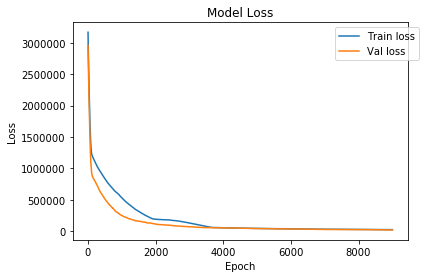

In [27]:
#Plot Model Loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

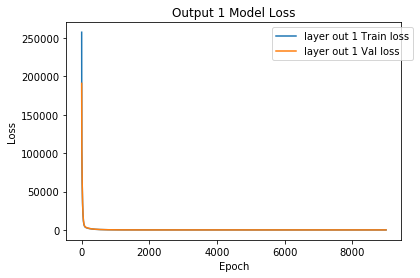

In [28]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

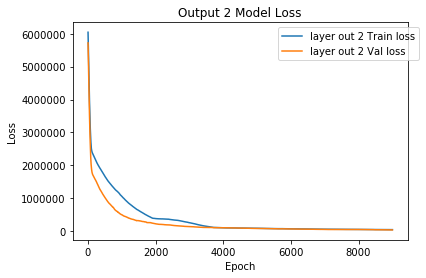

In [29]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [30]:
#visualize graph

%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

Reusing TensorBoard on port 6006 (pid 16856), started 16:53:15 ago. (Use '!kill 16856' to kill it.)

In [28]:
#load ground truth

ytest2 = np.zeros((34,1))
for i in range(34):
    ytest2[i] =  ytest[i][0]
    
ytest2 =ytest2.reshape(34,)
ytest2

array([10686.04688182, 10642.79686921, 10763.21119564, 10709.68392347,
       10780.37744105, 10812.19660948, 10735.820162  , 10794.60026246,
       10754.76390468, 10782.21089348, 10927.9491969 , 11000.22846942,
       11035.01865341, 10921.29057967, 10869.79033381, 11055.15758385,
       10997.51293268, 10977.81924247, 10973.38833665, 10931.54547552,
       10924.12881926, 10885.50186436, 10958.62319593, 10982.39400499,
       11002.4524395 , 10985.33405688, 10904.63278307, 10912.22100859,
       11002.19665977, 10945.72764096, 11019.8242073 , 11015.45831736,
       10930.50939438, 11048.18112676])

In [29]:
#Load ground truth sequence

fleet_Rul_File = "ytestT.csv"
fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)
#fleet_RUL = fleet_RUL*(thrmax-thrmin) + thrmin
fleet_RUL_np = np.zeros((34,24))
for i in range(34):
    for j in range(24):
        fleet_RUL_np[i][j] = fleet_RUL[i][j]

fleet_RUL_np.shape

(34, 24)

In [30]:
#Prediction

#Make 100 predictions and calculate average RMSE

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)

    #RMSE with AU

    #Predicted RUL for each Fleet
    mean_Fleet_All = np.zeros((tens_draw.shape[1],tens_draw.shape[2]))
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for s in range(tens_draw.shape[2]):
        for y in range(tens_draw.shape[1]):
            for x in range(tens_draw.shape[0]):
                mean_Fleet[x] = tens_draw[x,y,s]
            mean_Fleet_All[y][s] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    mean_Fleet_All1 = np.zeros((tens_draw1.shape[1],tens_draw1.shape[2]))
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for s in range(tens_draw1.shape[2]):
        for y in range(tens_draw1.shape[1]):
            for x in range(tens_draw1.shape[0]):
                mean_Fleet1[x] = tens_draw1[x,y,s]
            mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1

#Average RMSE with AU & EU

np.mean(rmse),np.mean(rmse1)

(702.497717817206, 772.9874741106054)

In [31]:
#Calculate Mean & Std of prediction with AU

pad = 24
fleet_NUM = np.arange(0,pad,1)

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [32]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
meaP2 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        meaP2[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

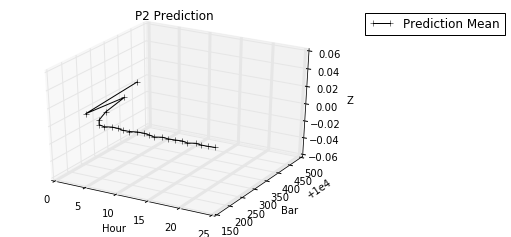

In [33]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("P2 Prediction")
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.tiff',bbox_inches='tight')
plt.show()

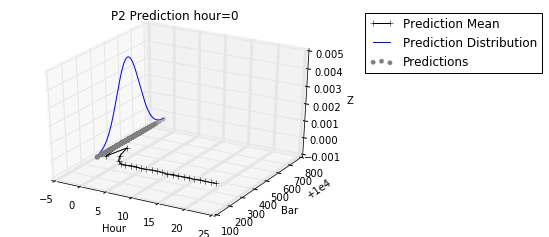

In [34]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("P2 Prediction hour=%i" % i)
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_2.tiff',bbox_inches='tight')
plt.show()

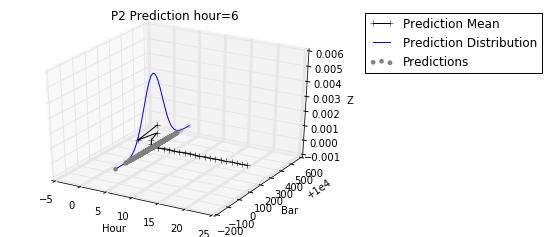

In [35]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 5

ax.set_title("P2 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_3.tiff',bbox_inches='tight')
plt.show()

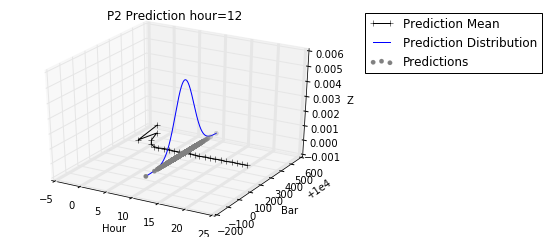

In [36]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 11

ax.set_title("P2 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_4.tiff',bbox_inches='tight')
plt.show()

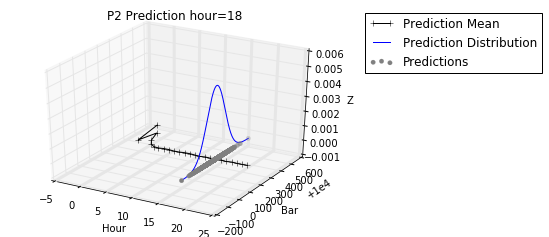

In [37]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("P2 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_5.tiff',bbox_inches='tight')
plt.show()

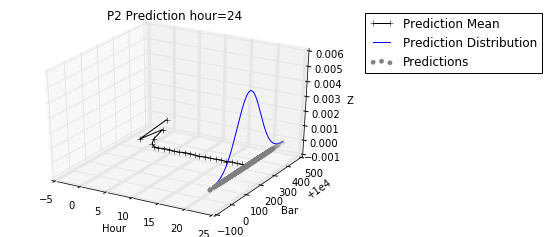

In [38]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 23

ax.set_title("P2 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_6.tiff',bbox_inches='tight')
plt.show()

In [39]:
#Load date of prediction

date = "date.csv"
date = pd.read_csv(date, skiprows = 0,header = None)
date = date.to_numpy()

In [40]:
#Load hour of prediction

hour_NUM = ['8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am']

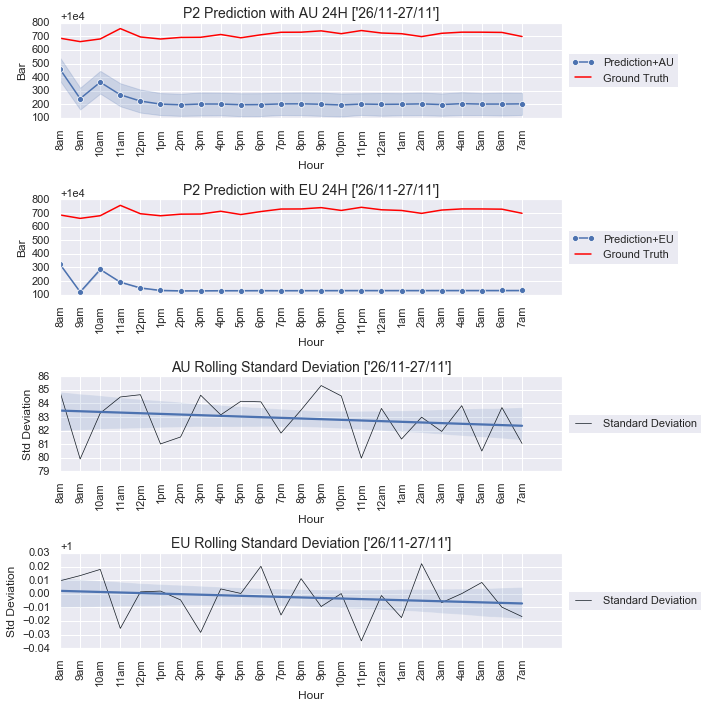

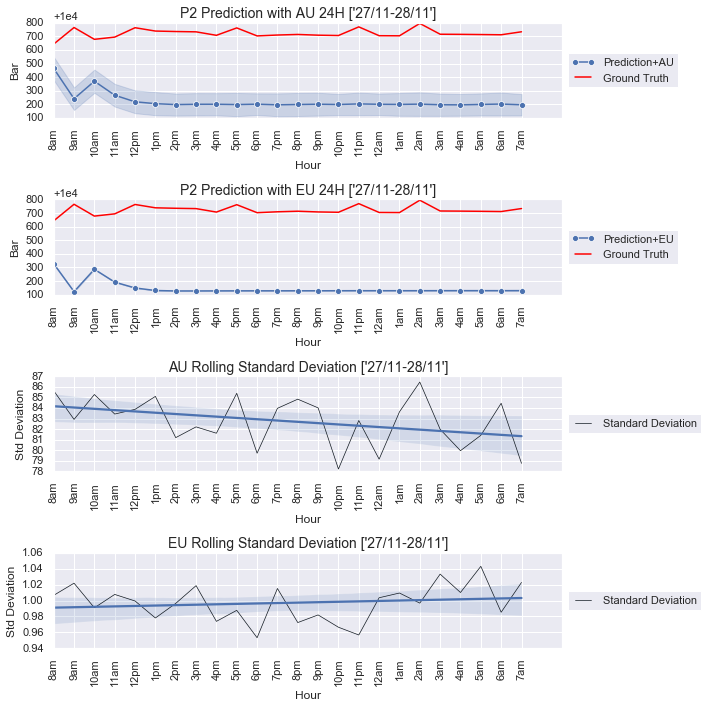

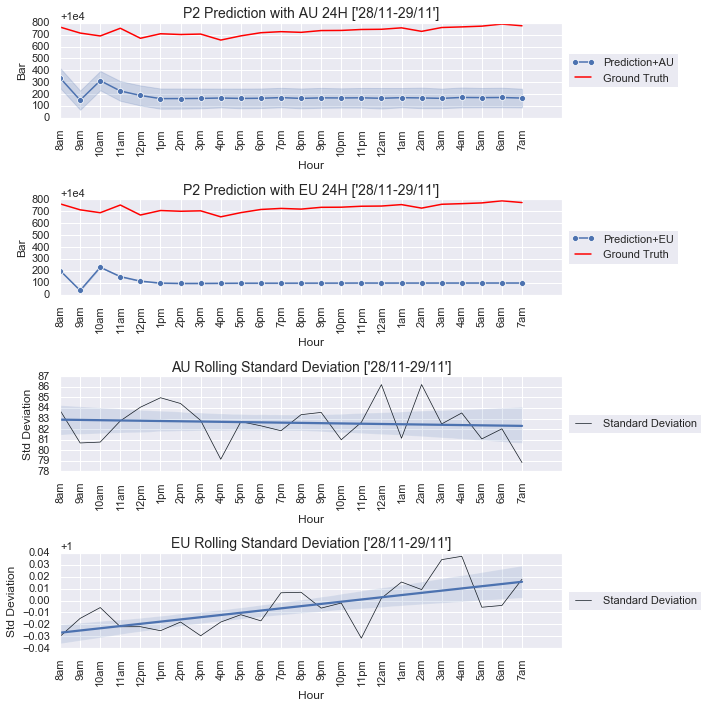

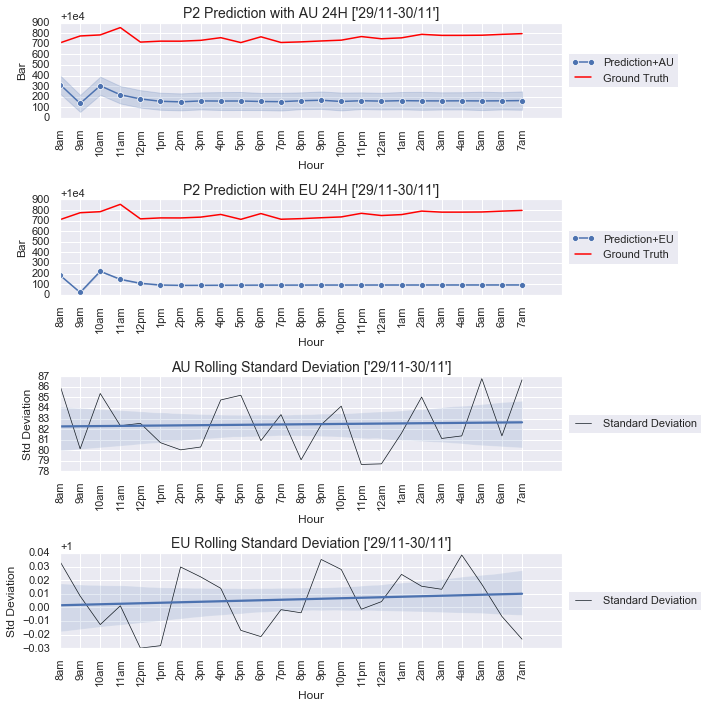

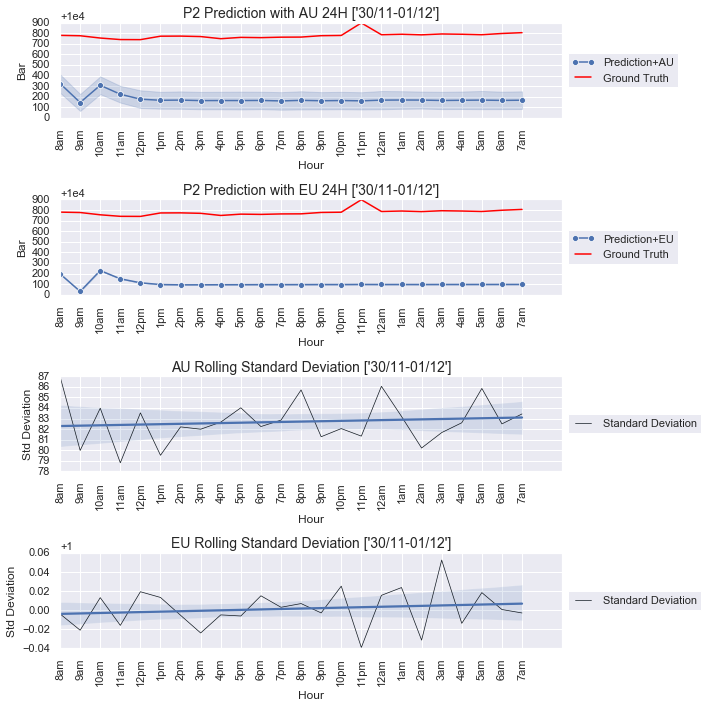

...

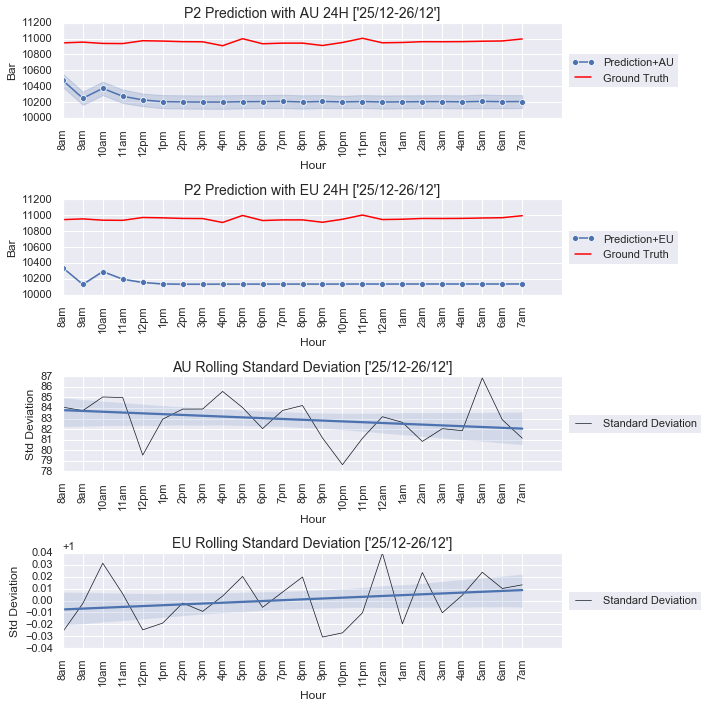

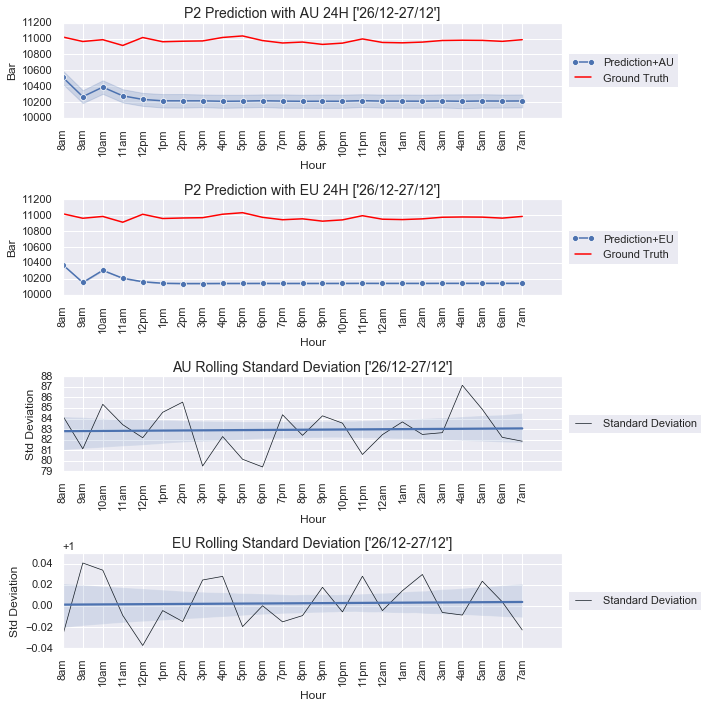

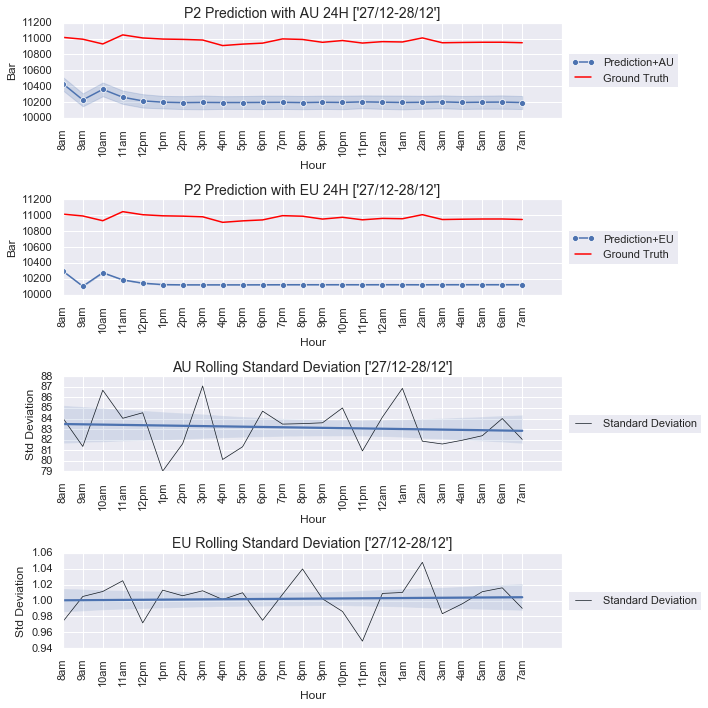

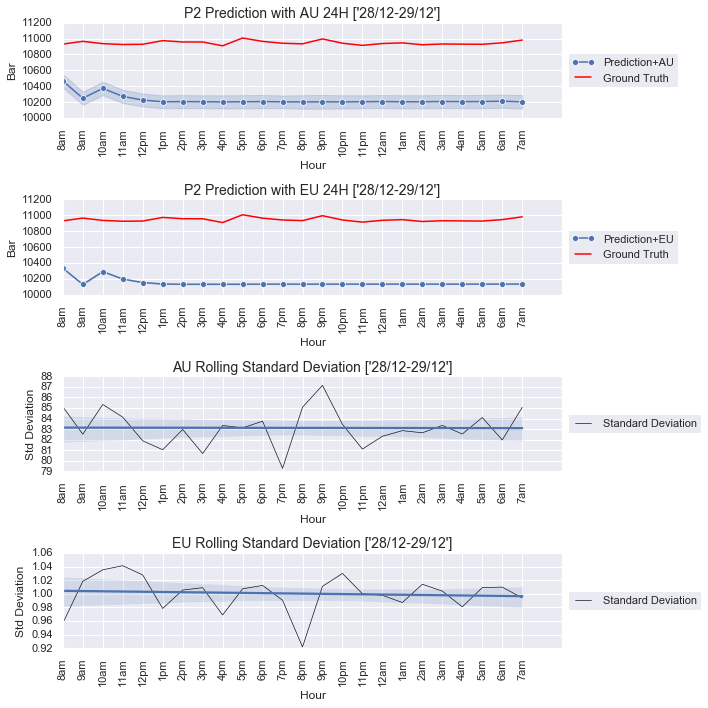

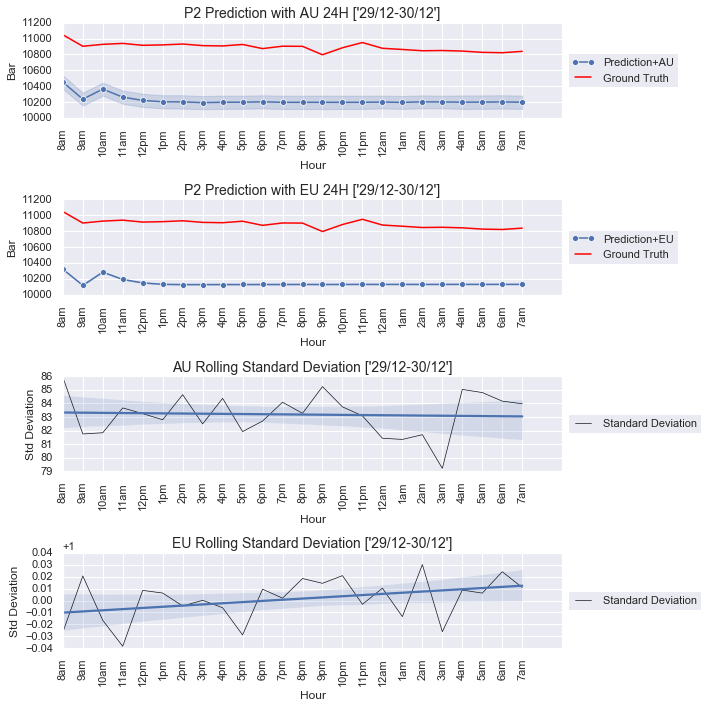

In [41]:
#Prediction Visualization

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set()
for B in range(34):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Hour','Bar']
    
    max_Seq_Arrange1.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Hour','Bar']
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(4,1)
    fig = plt.figure(figsize=(10,10))
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="Prediction+AU")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('P2 Prediction with AU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[1])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="Prediction+EU")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('P2 Prediction with EU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    

    ax = fig.add_subplot(gs[2])
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],scatter = False)
    plt.title('AU Rolling Standard Deviation ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[3])
    ax.plot('Hour', 'Bar', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Hour'],med_Std_Arrange['Bar'],scatter = False)
    plt.title('EU Rolling Standard Deviation ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

In [42]:
#SHAP cannot be used with model with probabilistic layers. So, define non probabilistic f'x

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 934)           3508104   
_________________________________________________________________
dense_2 (Dense)              (None, 24, 364)           340340    
_________________________________________________________________
dense_3 (Dense)              (None, 24, 1)             365       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 3,848,809
Trainable params: 3,848,809
Non-trainable params: 0
_________________________________________________________________


In [43]:
#Extract only "Mean" weights, exclude "Standard Deviation" weights

a = model.layers[3].get_weights()

b = np.zeros((len(a[0]),1))
for x in range(len(a[0])):
    b[x] = a[0][x][0]
    
d = np.zeros(1)
for x in range(1):
    d[x] = a[1][x]
    
c = [b,d]

In [44]:
#Transfer weights from fx to f'x

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(c)

In [45]:
#Prediction with f'x

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [46]:
#Import SHAP & initialized JS for f'x explanation

import shap
shap.initjs()

In [47]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [48]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

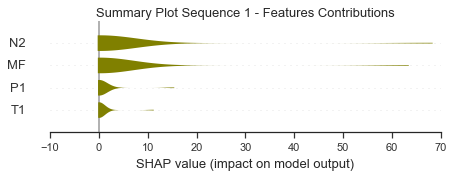

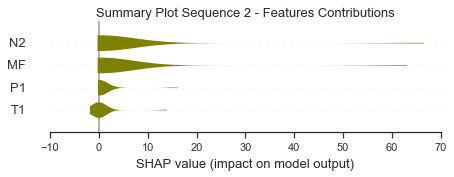

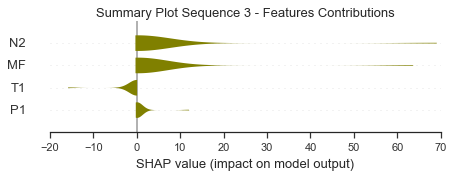

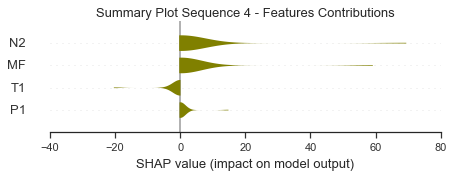

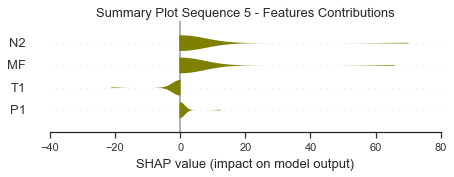

...

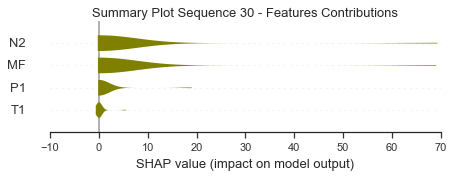

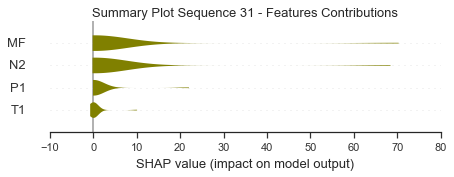

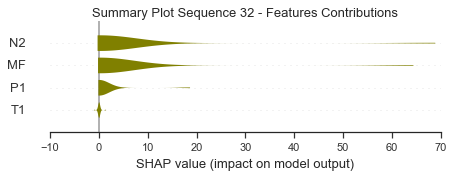

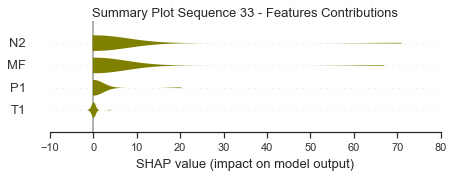

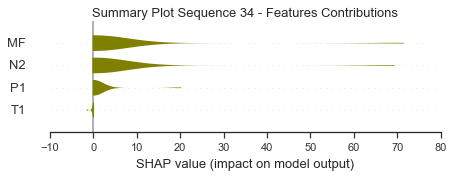

In [49]:
#SHAP Summmary Plot

sns.set_style('ticks')
instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="violin", color='olive')
    plt.title("Summary Plot Sequence %i - Features Contributions" %(i+1),fontsize=13)
    plt.figure
    plt.show()

In [50]:
#SHAP Force Plot

import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [15.43896676 11.23603564 68.36503776 63.47515473]


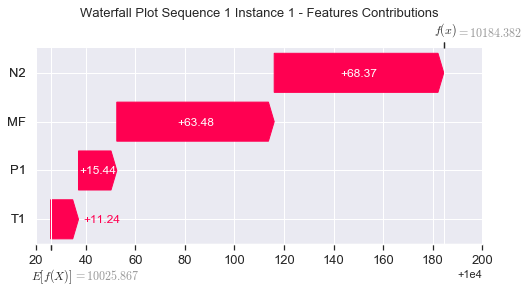

None

Contribution: [-0.17697363 -0.05478573 -0.25206498 -0.21378363]


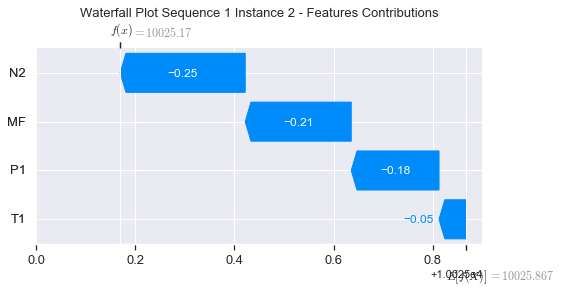

None

Contribution: [0.32555949 0.31300269 1.14703099 1.06272709]


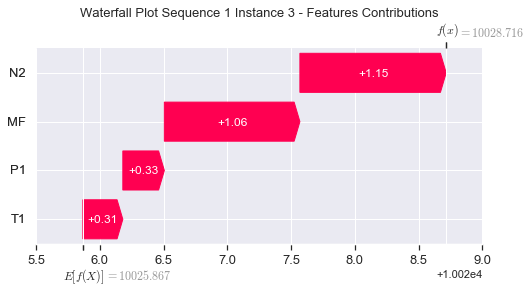

None

Contribution: [0.09330866 0.07956721 0.32855847 0.30643516]


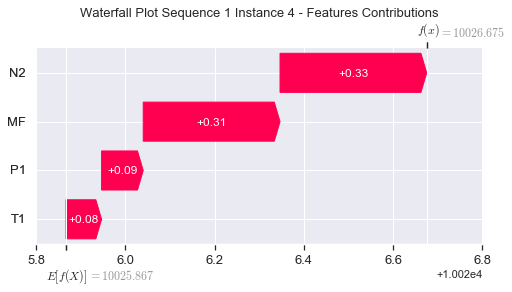

None

Contribution: [0.07979254 0.08185263 0.26620639 0.24215721]


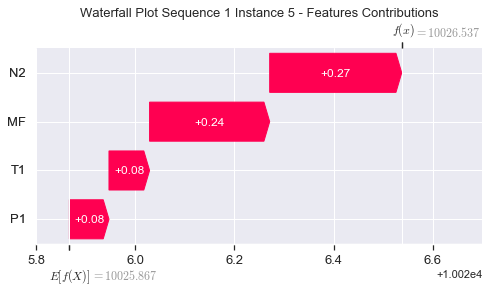

None

Contribution: [0.07023162 0.07138482 0.23213828 0.21134529]


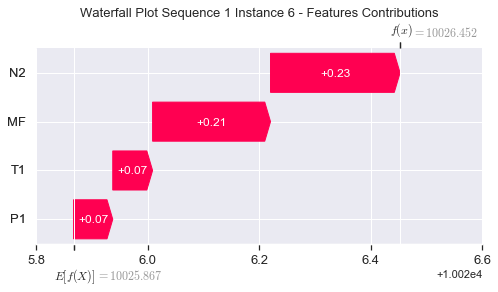

None

Contribution: [0.06533491 0.0675984  0.21685832 0.19773074]


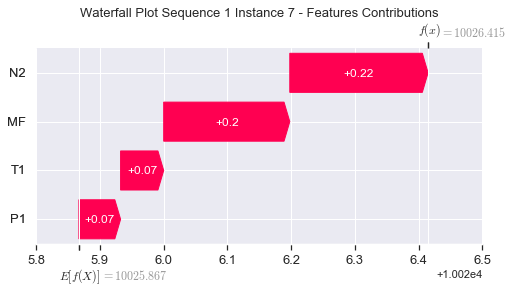

None

Contribution: [0.06230488 0.06465458 0.20642977 0.18813737]


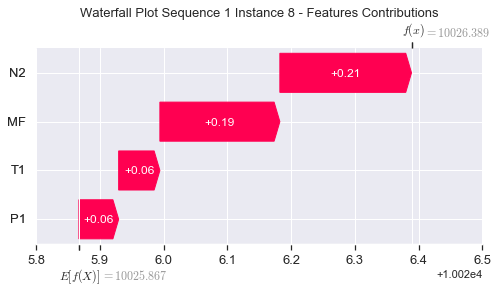

None

Contribution: [0.06045566 0.06664406 0.1986871  0.18261439]


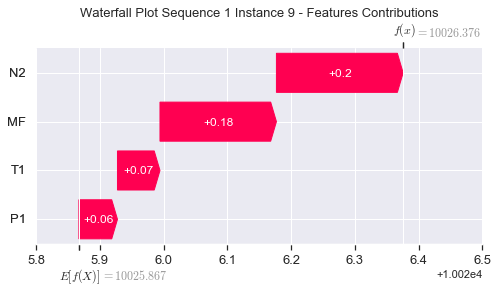

None

Contribution: [0.05764661 0.06177908 0.19096206 0.17549985]


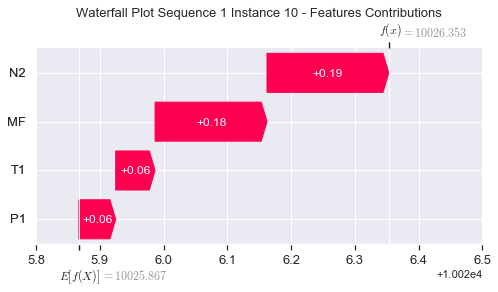

None

Contribution: [0.05676698 0.05995733 0.18540682 0.16968954]


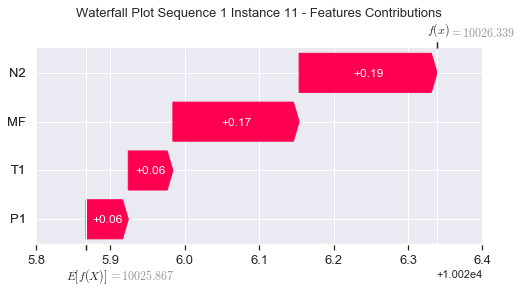

None

Contribution: [0.05340449 0.05552206 0.1789639  0.1634374 ]


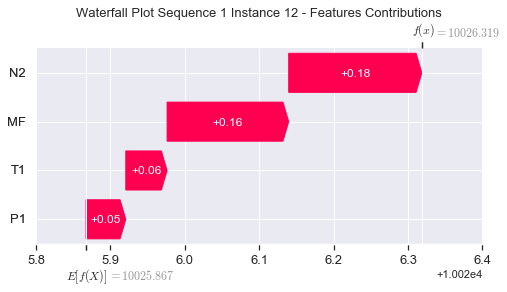

None

Contribution: [0.05209822 0.05487882 0.17484    0.15968254]


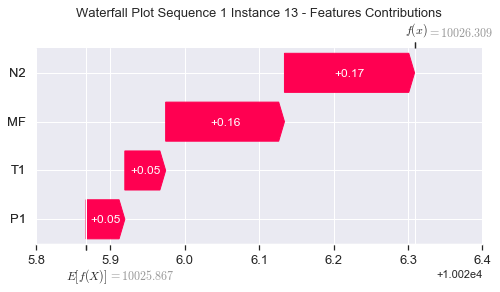

None

Contribution: [0.05237086 0.05343874 0.1704633  0.1553541 ]


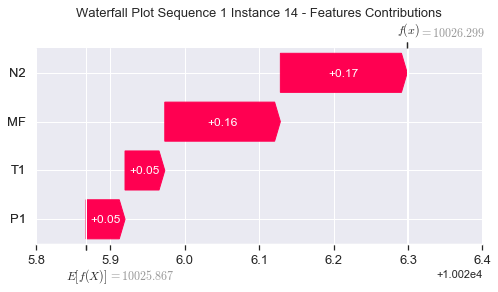

None

Contribution: [0.04996588 0.05269653 0.16706697 0.15268526]


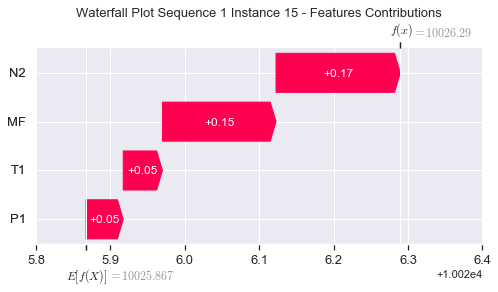

None

Contribution: [0.04850337 0.05208405 0.16396976 0.15231415]


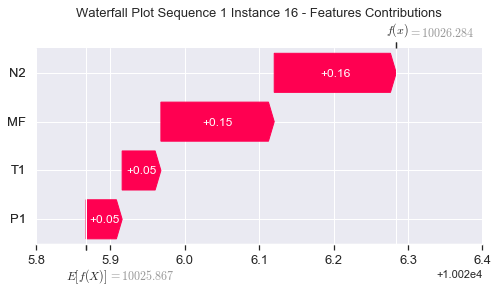

None

Contribution: [0.04796228 0.05162564 0.16090643 0.14702611]


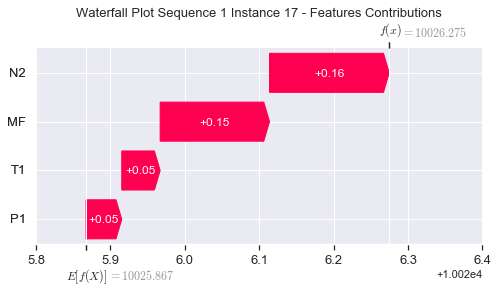

None

Contribution: [0.04723853 0.05078679 0.15837331 0.14452734]


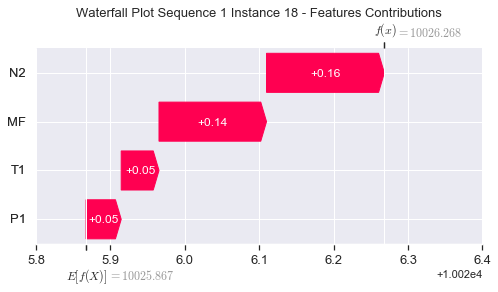

None

Contribution: [0.04585583 0.05042837 0.15726618 0.1440341 ]


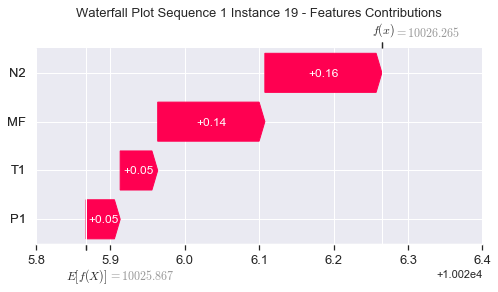

None

Contribution: [0.04742845 0.05228276 0.15991266 0.14569937]


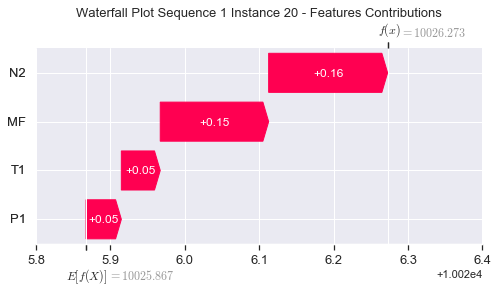

None

Contribution: [0.05181295 0.0574977  0.17557026 0.15986299]


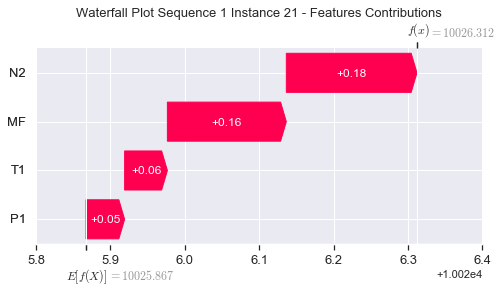

None

Contribution: [0.07055995 0.07878243 0.24313337 0.22161552]


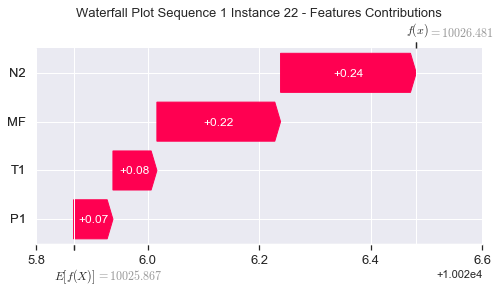

None

Contribution: [0.13604607 0.1385433  0.52391249 0.48441454]


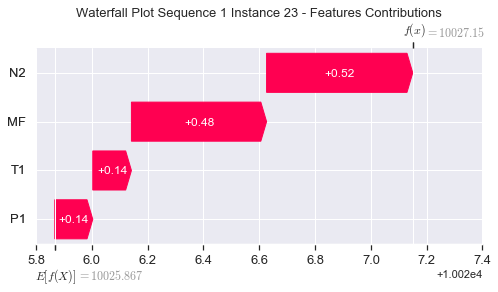

None

Contribution: [ 0.30424194 -0.14589393  1.84921051  1.79479619]


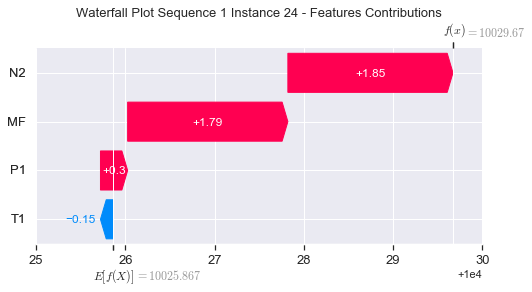

None

Contribution: [16.1158227  13.92777121 66.55758279 63.16058681]


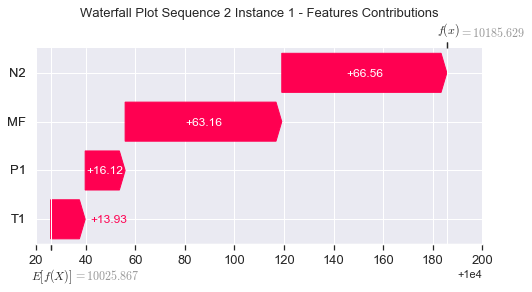

None

Contribution: [-0.20082307  0.0123425  -0.28329825 -0.25488682]


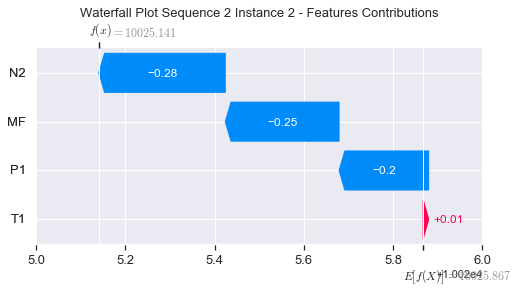

None

Contribution: [0.32630551 0.31522218 1.13481782 1.07739928]


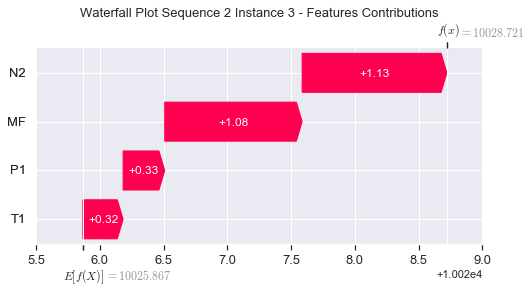

None

Contribution: [0.0918311  0.08202727 0.32758905 0.29736857]


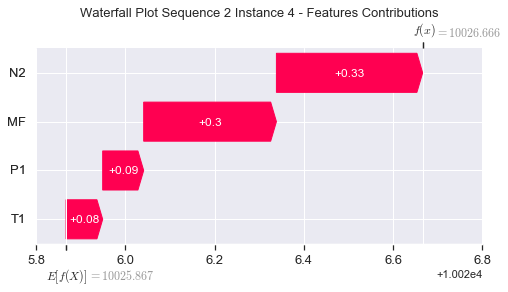

None

Contribution: [0.07945665 0.06720691 0.26785079 0.24728086]


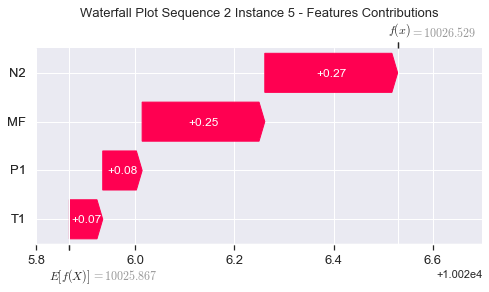

None

Contribution: [0.06911797 0.05665862 0.23271844 0.2135711 ]


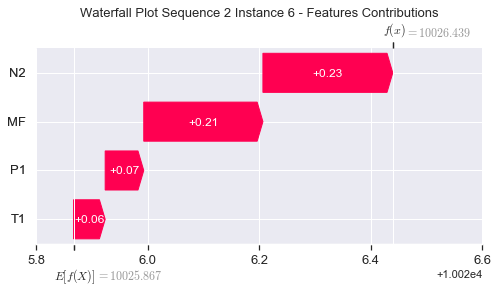

None

Contribution: [0.06457744 0.05232969 0.21744632 0.1992122 ]


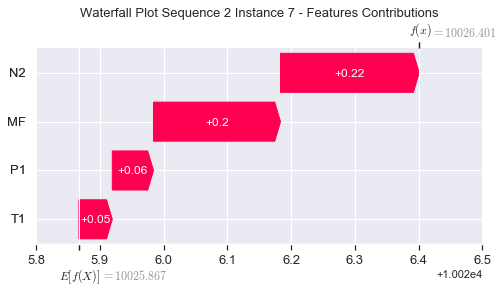

None

Contribution: [0.06140208 0.04982459 0.20701663 0.18971013]


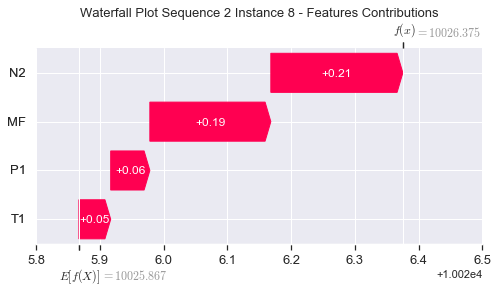

None

Contribution: [0.05940354 0.04661378 0.19981622 0.18252328]


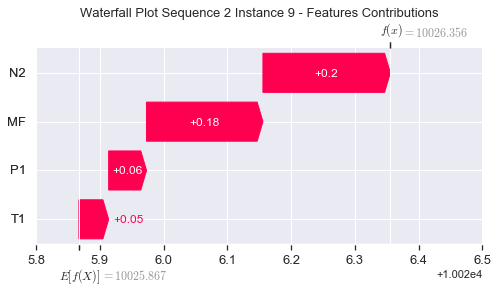

None

Contribution: [0.05687431 0.04429724 0.19266826 0.17594018]


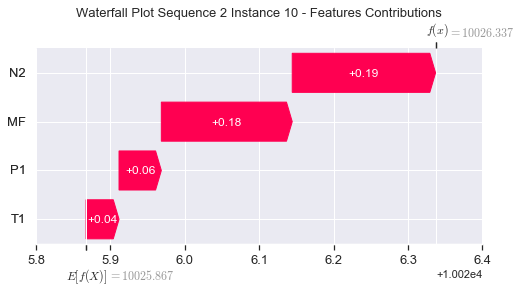

None

Contribution: [0.05505912 0.04283467 0.18593638 0.169759  ]


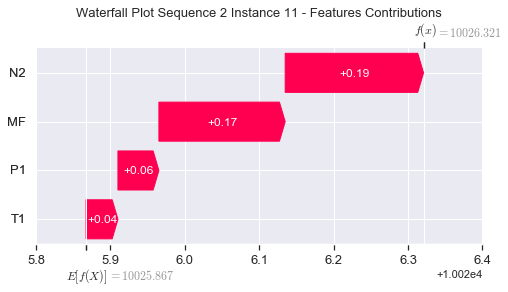

None

Contribution: [0.05283946 0.03974571 0.17913471 0.16301205]


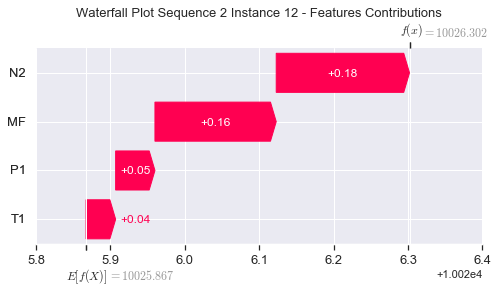

None

Contribution: [0.05165046 0.03914432 0.17514264 0.15944963]


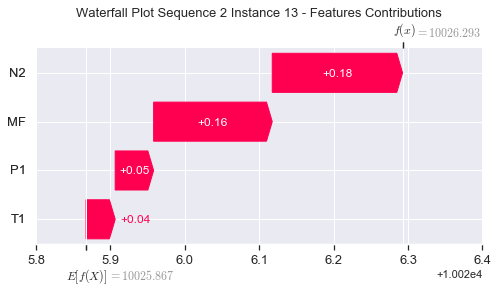

None

Contribution: [0.05049534 0.03701068 0.17063608 0.15530626]


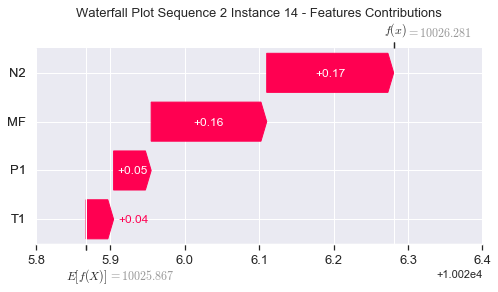

None

Contribution: [0.04926089 0.03718379 0.16728822 0.15223838]


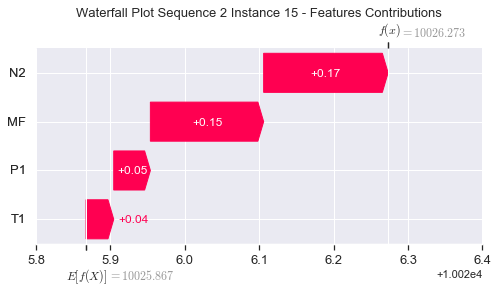

None

Contribution: [0.04787716 0.03687856 0.16421351 0.15017916]


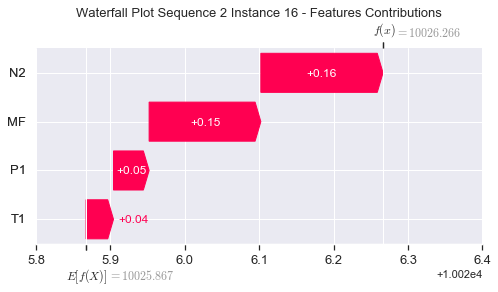

None

Contribution: [0.0473903  0.03530948 0.16122758 0.14654426]


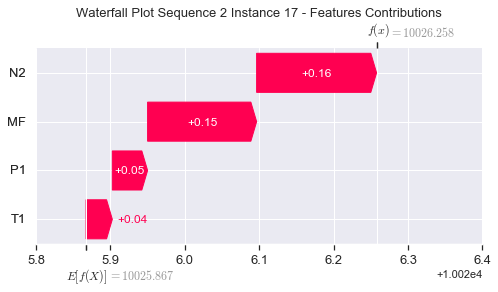

None

Contribution: [0.04655628 0.03471273 0.15866019 0.1442115 ]


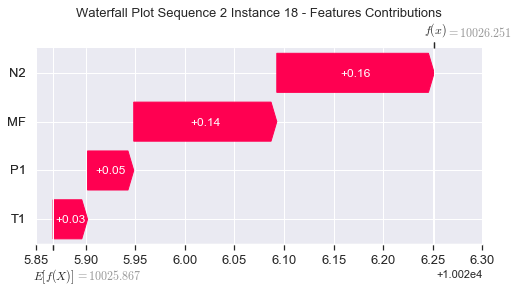

None

Contribution: [0.04627666 0.03537174 0.15752124 0.14292238]


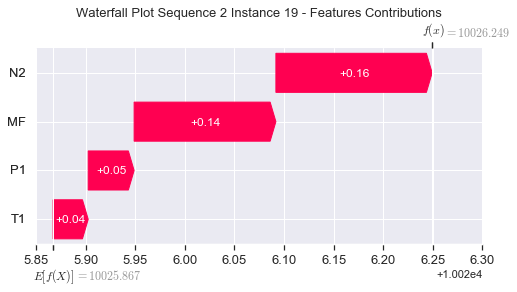

None

Contribution: [0.04693967 0.03582003 0.16049209 0.14609228]


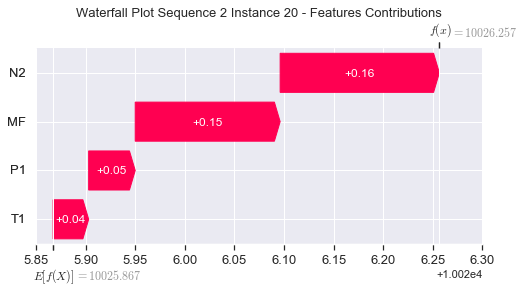

None

Contribution: [0.05129185 0.03902913 0.17628346 0.16038357]


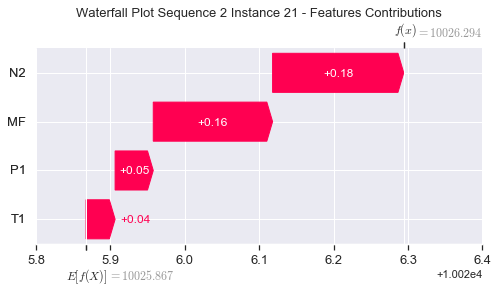

None

Contribution: [0.06961711 0.04915369 0.24426313 0.2227359 ]


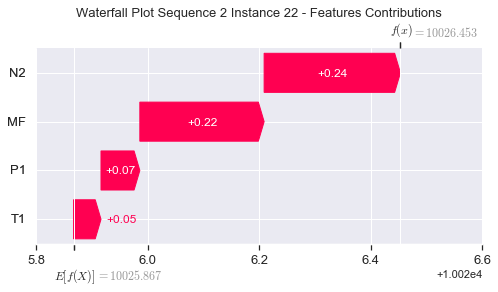

None

Contribution: [ 0.12947925 -0.00298504  0.52602864  0.48563874]


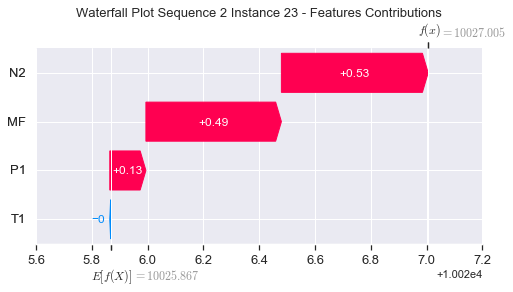

None

Contribution: [ 0.16803774 -1.82796446  1.85223337  1.81671176]


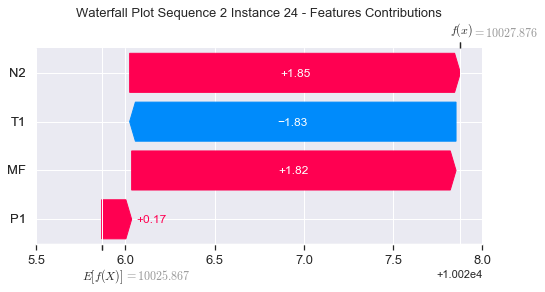

None

Contribution: [ 12.00810538 -15.85307231  69.11251954  63.66960253]


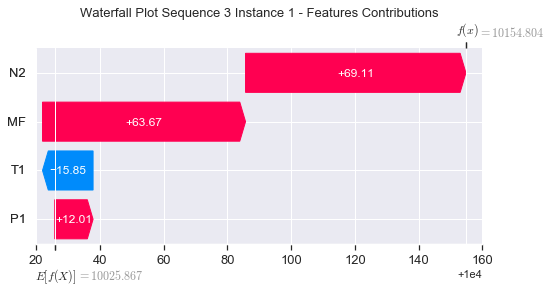

None

Contribution: [-0.24923387 -0.57004503 -0.33557407 -0.31458058]


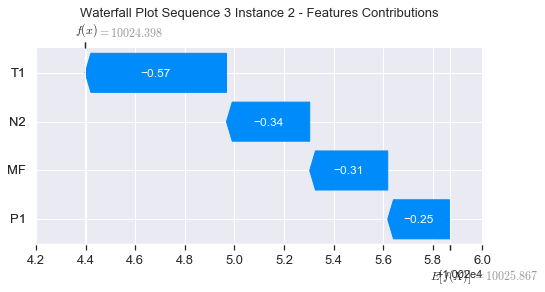

None

Contribution: [0.31505553 0.05095661 1.1643102  1.06732006]


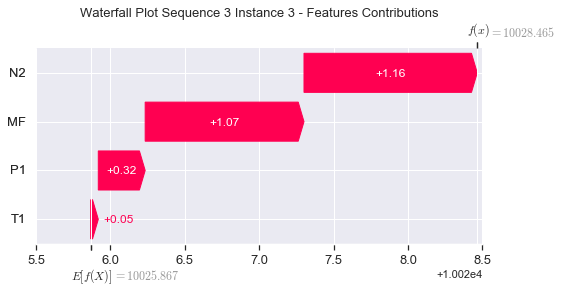

None

Contribution: [0.09629043 0.02791252 0.33693565 0.31018669]


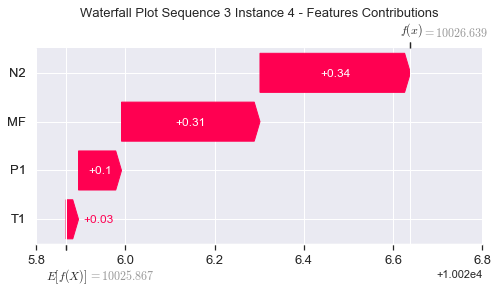

None

Contribution: [0.07968413 0.05544423 0.26809564 0.24343825]


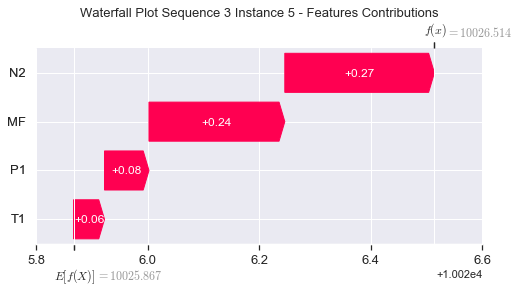

None

Contribution: [0.06931312 0.05119265 0.23351327 0.2117142 ]


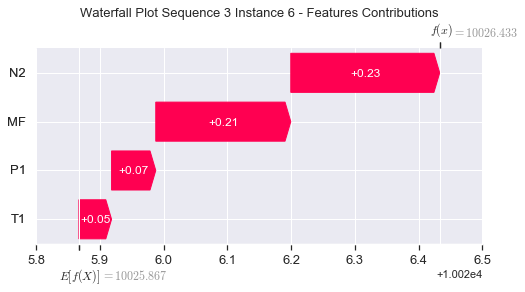

None

Contribution: [0.06463349 0.0478659  0.21808785 0.19766699]


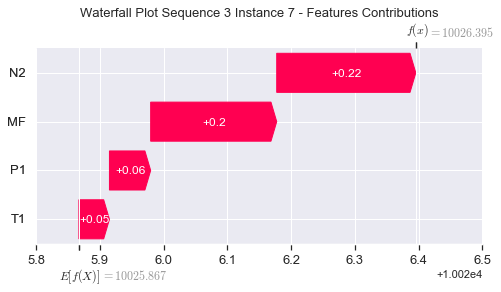

None

Contribution: [0.06160982 0.04580432 0.20773567 0.1882579 ]


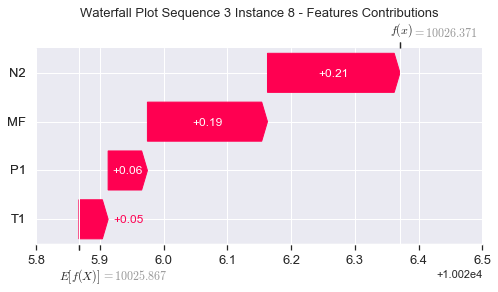

None

Contribution: [0.0591165  0.04667029 0.19980728 0.18013234]


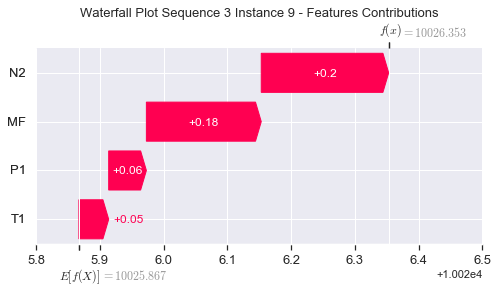

None

Contribution: [0.05767184 0.04823566 0.19353923 0.1757871 ]


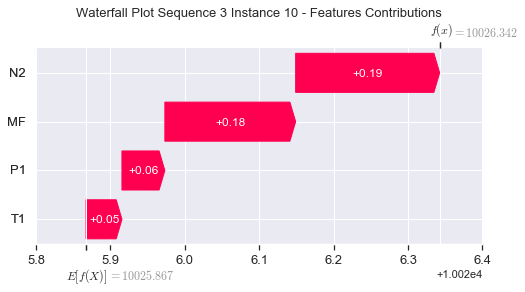

None

Contribution: [0.05574784 0.04432829 0.18709591 0.16893832]


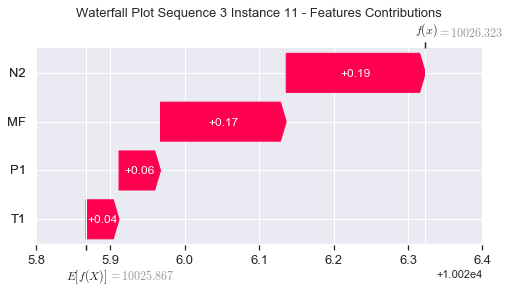

None

Contribution: [0.05384041 0.03959435 0.18083593 0.16400394]


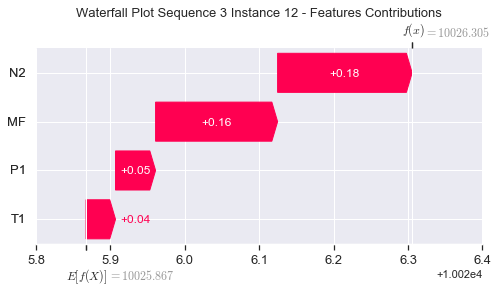

None

Contribution: [0.05244128 0.03846176 0.17658773 0.16012975]


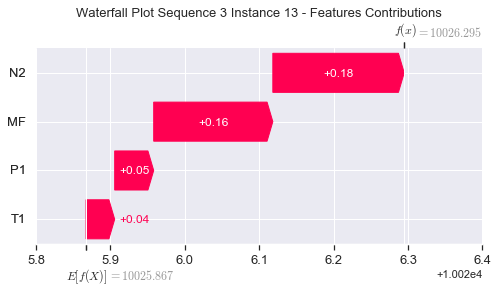

None

Contribution: [0.05003387 0.03880697 0.17242742 0.15618104]


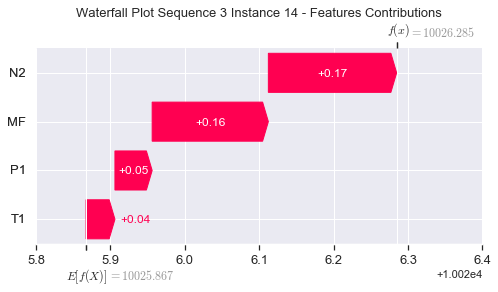

None

Contribution: [0.04983192 0.03670075 0.16876653 0.15314647]


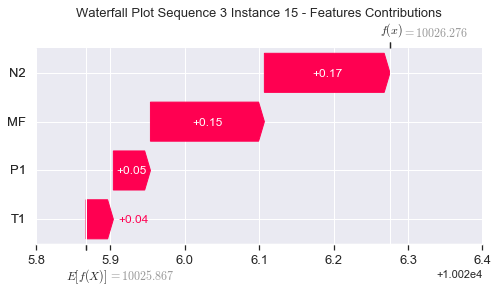

None

Contribution: [0.04970712 0.03671046 0.16624076 0.15313598]


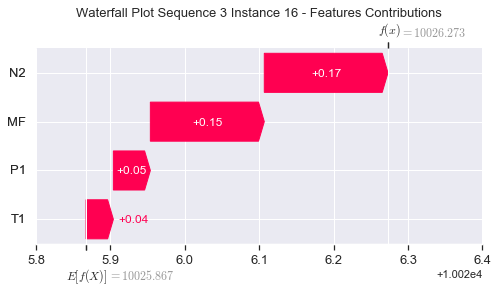

None

Contribution: [0.04784813 0.03526392 0.16265035 0.14758033]


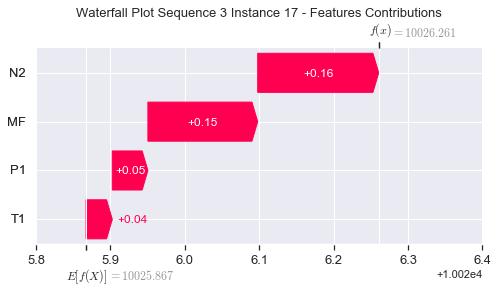

None

Contribution: [0.04705329 0.03463349 0.16019147 0.14537789]


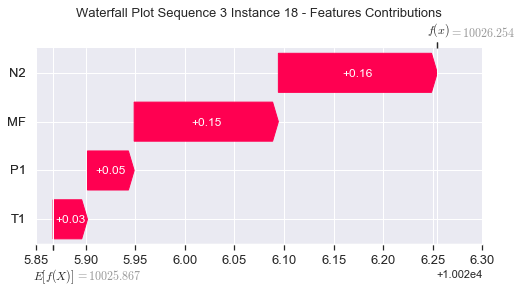

None

Contribution: [0.0472405  0.03315973 0.15926874 0.14441327]


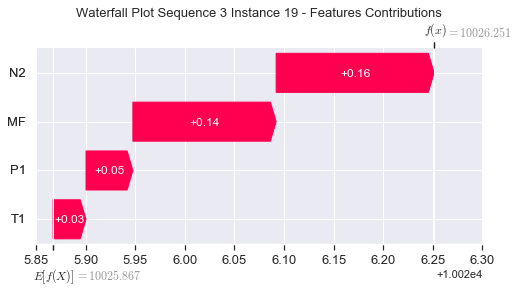

None

Contribution: [0.04725805 0.03429059 0.16183095 0.14688377]


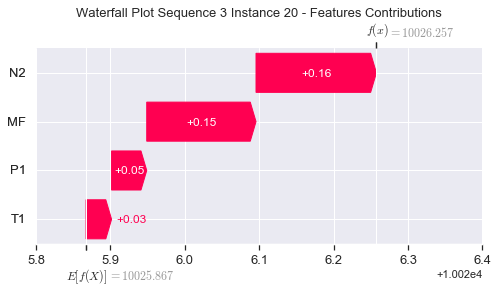

None

Contribution: [0.05185065 0.03746084 0.17809912 0.16166019]


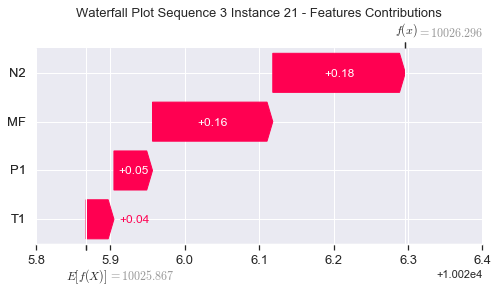

None

Contribution: [0.07073434 0.04592152 0.24739799 0.22507534]


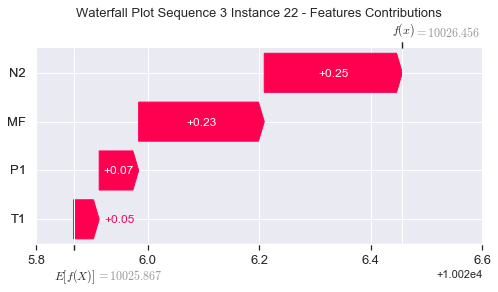

None

Contribution: [ 0.13344269 -0.01317238  0.53522366  0.49319214]


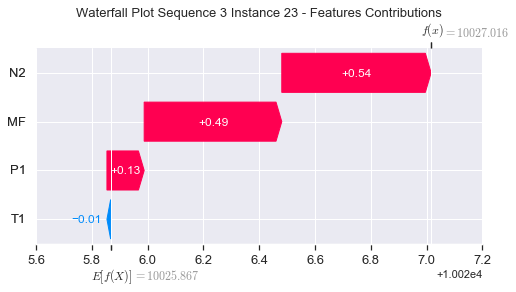

None

Contribution: [ 0.22823523 -2.07245969  1.89317849  1.75759335]


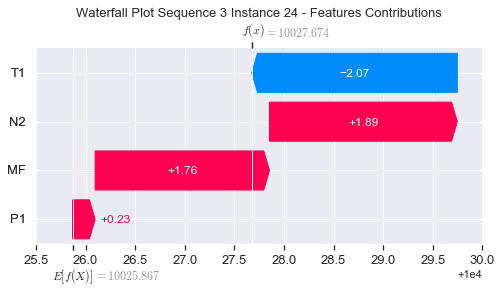

None

Contribution: [ 14.80976196 -20.40767321  69.44155598  59.16294265]


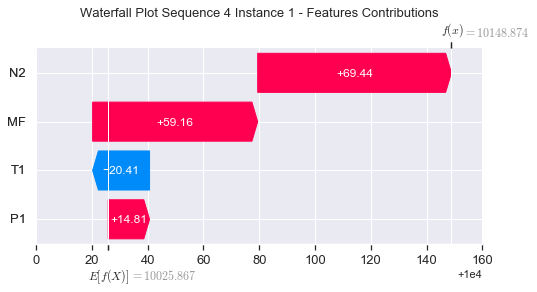

None

Contribution: [-0.23257966 -0.61299781 -0.33430795 -0.30441368]


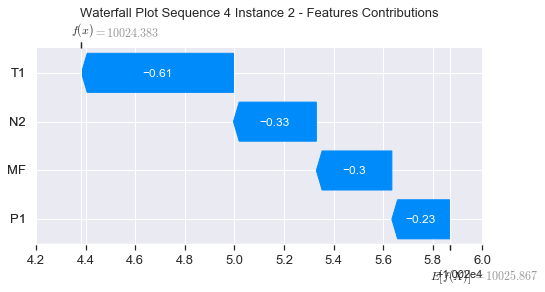

None

Contribution: [0.30478957 0.05841248 1.17113561 1.08573935]


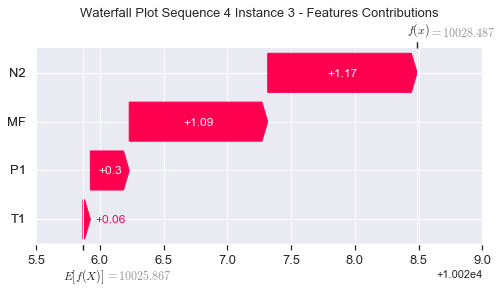

None

Contribution: [0.09829633 0.03383977 0.33868792 0.31144142]


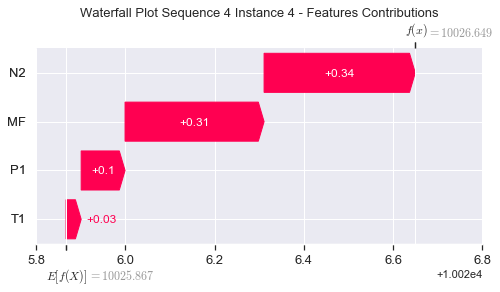

None

Contribution: [0.08033083 0.05362616 0.26893087 0.24493057]


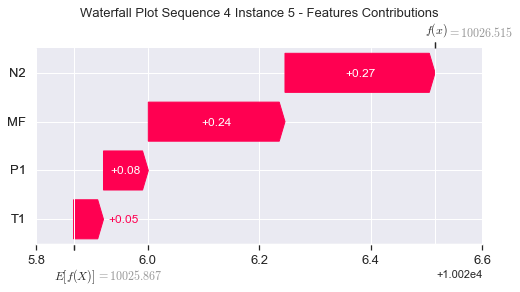

None

Contribution: [0.07017359 0.0477615  0.23421199 0.21397806]


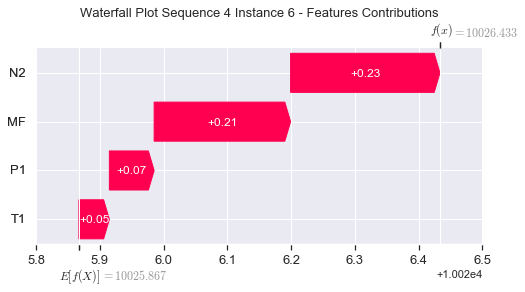

None

Contribution: [0.06555657 0.0449359  0.21874699 0.19961039]


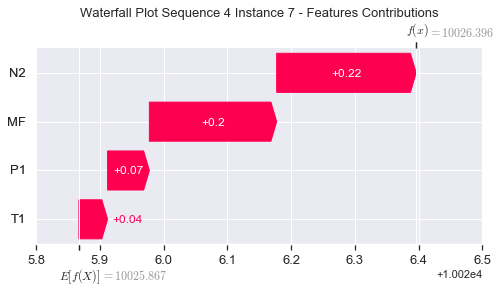

None

Contribution: [0.06217109 0.04277166 0.20834253 0.19030194]


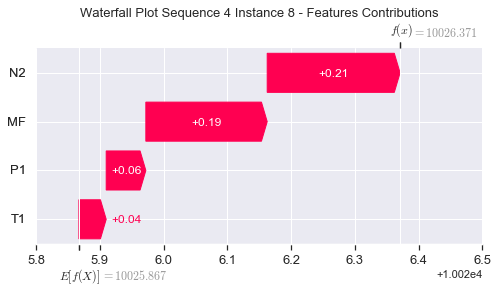

None

Contribution: [0.0589214  0.04283835 0.20060459 0.18376572]


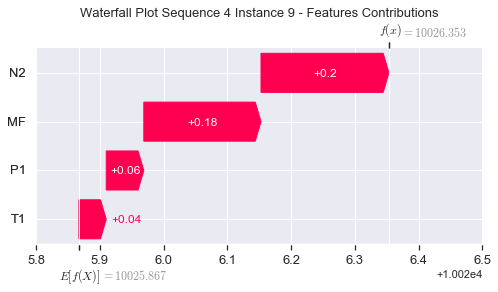

None

Contribution: [0.05808294 0.03932274 0.19348265 0.17756143]


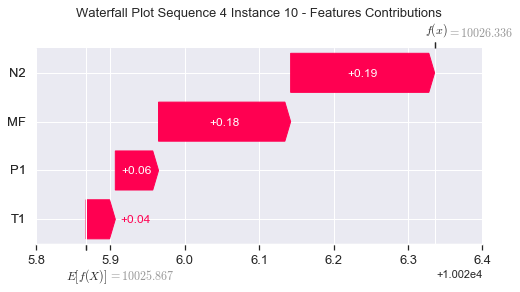

None

Contribution: [0.05489374 0.0393045  0.18757237 0.1722327 ]


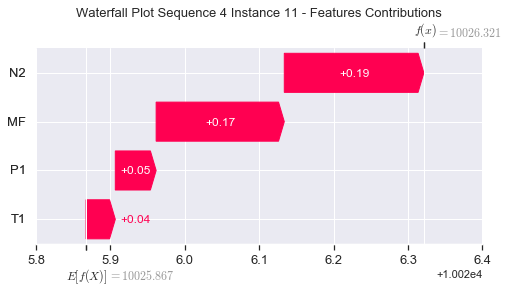

None

Contribution: [0.05382573 0.03721778 0.18111676 0.16490322]


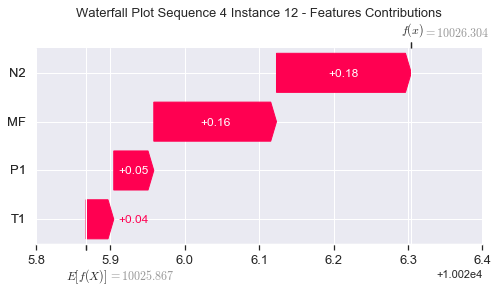

None

Contribution: [0.052553   0.0363894  0.17691619 0.16107118]


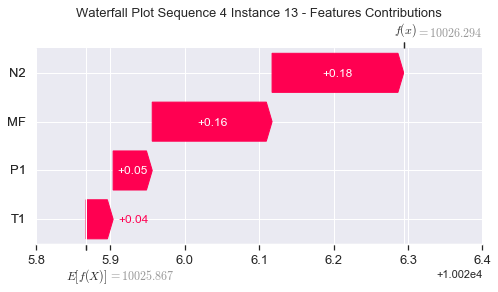

None

Contribution: [0.05092783 0.0365101  0.17325736 0.15986968]


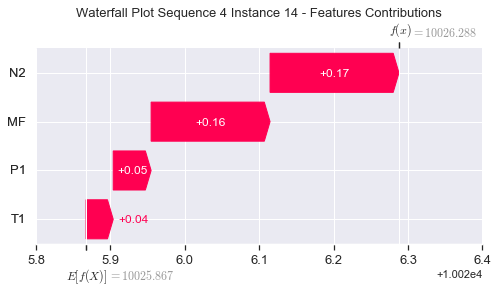

None

Contribution: [0.05007019 0.03445477 0.16908208 0.1543304 ]


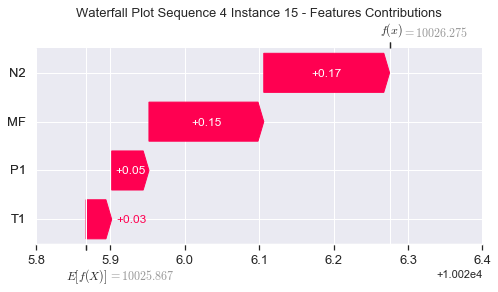

None

Contribution: [0.04855266 0.03451675 0.16581885 0.1514306 ]


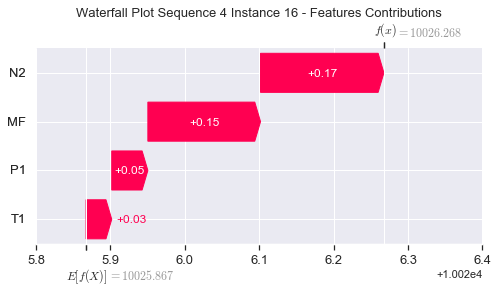

None

Contribution: [0.04818503 0.03318535 0.16301711 0.14890781]


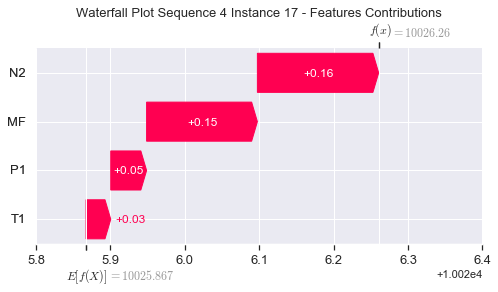

None

Contribution: [0.04737552 0.03246462 0.16055484 0.14681115]


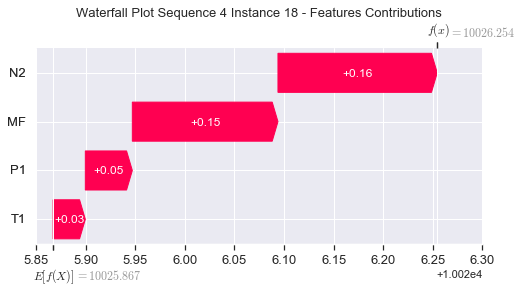

None

Contribution: [0.04750895 0.03310456 0.15923605 0.14353747]


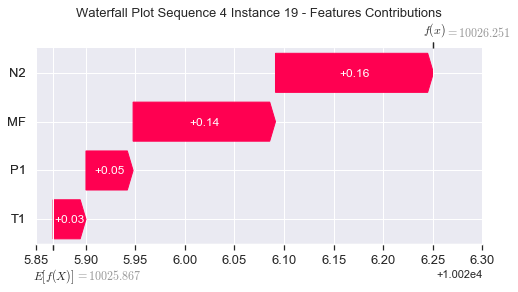

None

Contribution: [0.0476363  0.03258481 0.16225621 0.1483339 ]


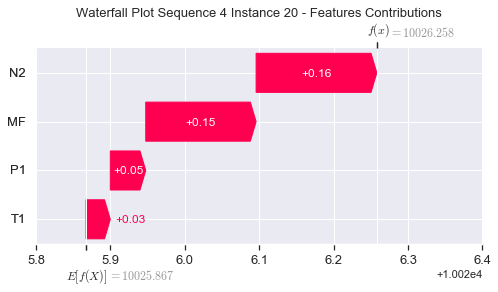

None

Contribution: [0.05208695 0.03571154 0.17856557 0.16318345]


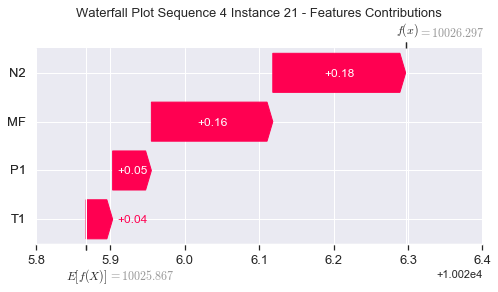

None

Contribution: [0.07078284 0.04311138 0.24802561 0.22726087]


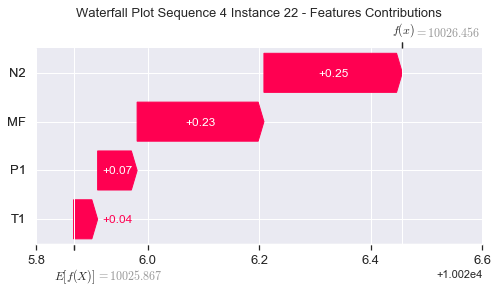

None

Contribution: [ 0.13316453 -0.02993972  0.53675002  0.50370991]


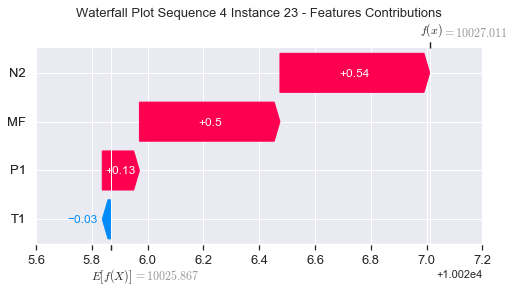

None

Contribution: [ 0.19790602 -2.24952566  1.91429413  1.95019356]


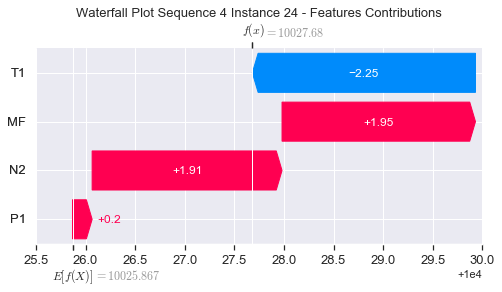

None

Contribution: [ 12.41958068 -21.23906462  70.19815042  65.94252418]


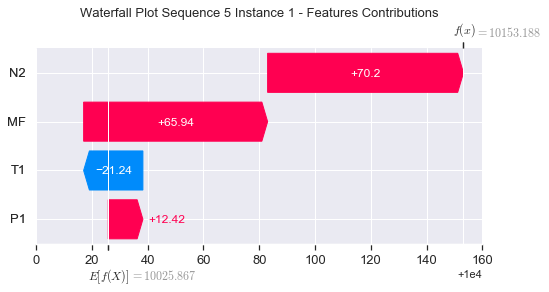

None

Contribution: [-0.24756182 -0.63077144 -0.32400956 -0.28673367]


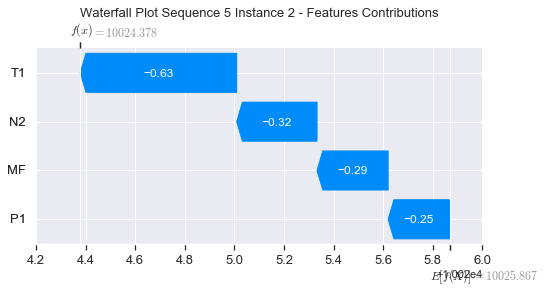

None

Contribution: [0.30275336 0.04697675 1.16343128 1.09416341]


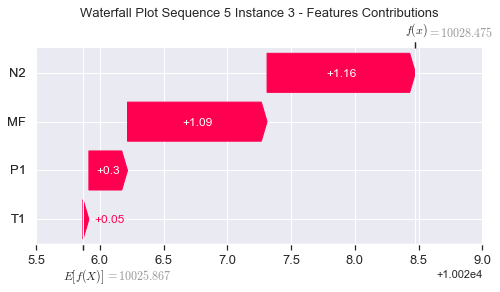

None

Contribution: [0.09355155 0.03322372 0.33691971 0.31223705]


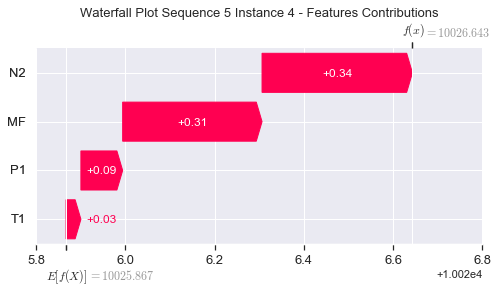

None

Contribution: [0.0785529  0.05434207 0.26821004 0.24586594]


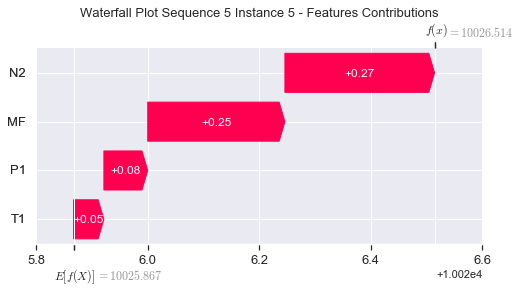

None

Contribution: [0.06892356 0.05022265 0.23367039 0.21433459]


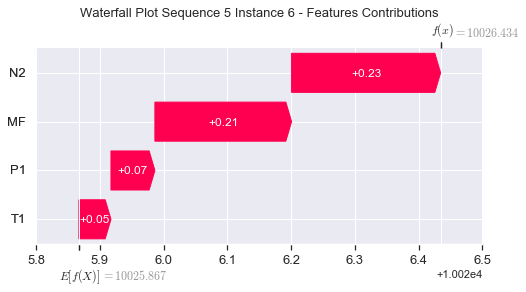

None

Contribution: [0.06430816 0.0469109  0.21814896 0.19991   ]


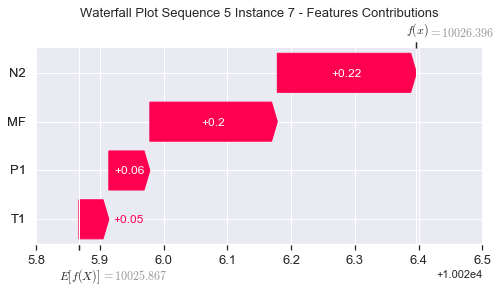

None

Contribution: [0.06125678 0.04502312 0.20781604 0.19037786]


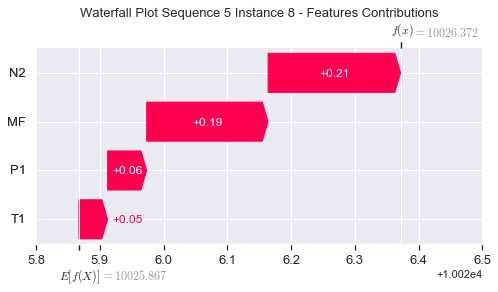

None

Contribution: [0.05887092 0.04493862 0.19968375 0.18250616]


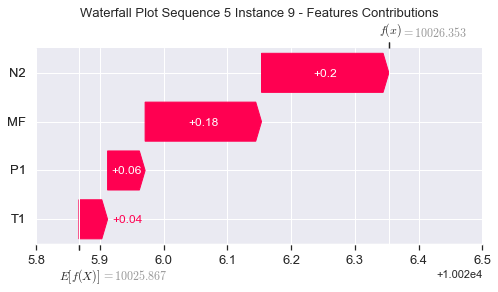

None

Contribution: [0.05578273 0.04314186 0.19257525 0.17576887]


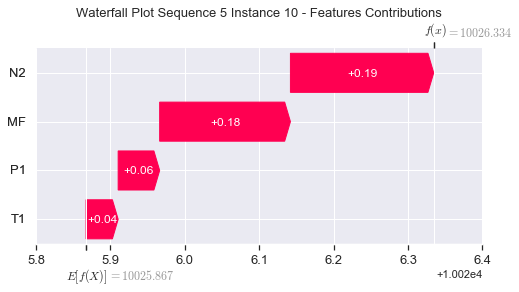

None

Contribution: [0.05504762 0.04339808 0.18704298 0.17078221]


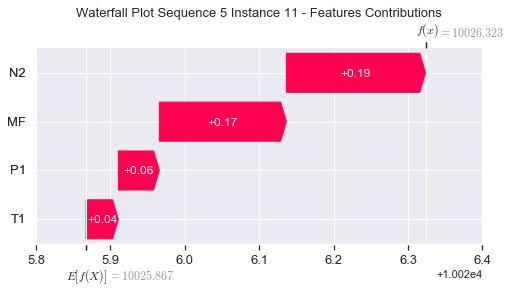

None

Contribution: [0.05308453 0.03964152 0.18079435 0.16491859]


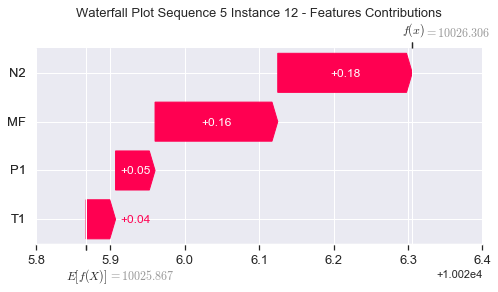

None

Contribution: [0.05185619 0.03848233 0.17655162 0.16107914]


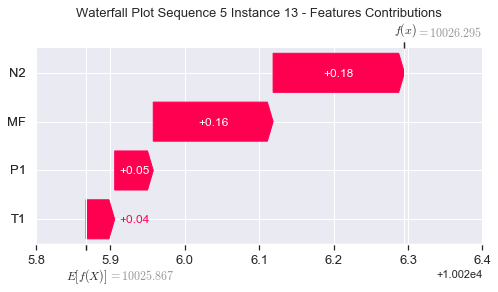

None

Contribution: [0.0513487  0.03799266 0.17310235 0.1589722 ]


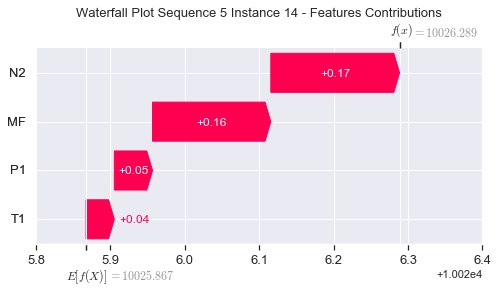

None

Contribution: [0.04966676 0.03716817 0.16885212 0.15431771]


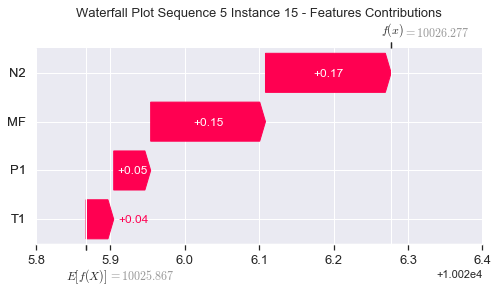

None

Contribution: [0.04979518 0.03622416 0.16684596 0.15709952]


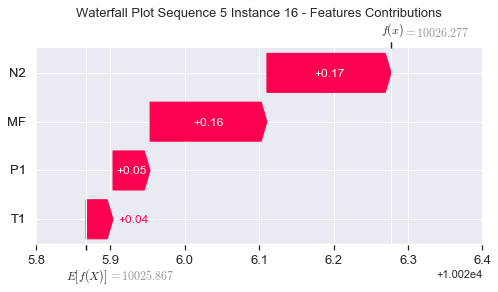

None

Contribution: [0.04794066 0.035857   0.16271444 0.14863861]


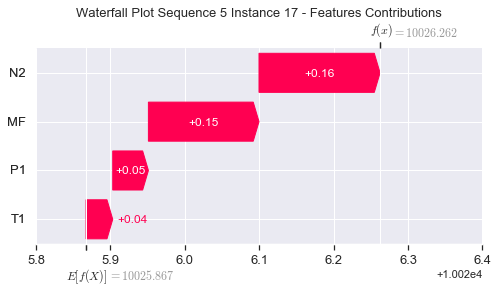

None

Contribution: [0.04727038 0.03544036 0.16028574 0.14644203]


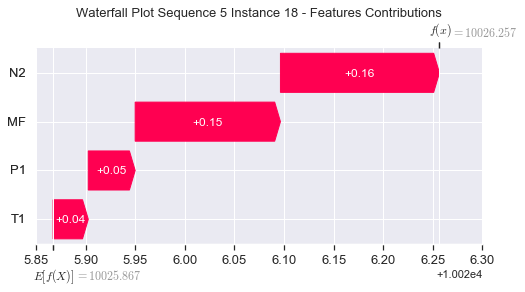

None

Contribution: [0.04697898 0.0339011  0.15854592 0.14464041]


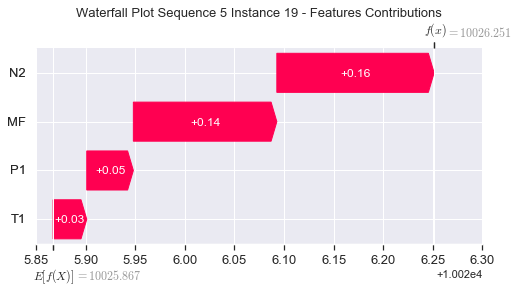

None

Contribution: [0.04768506 0.03543698 0.16192581 0.14785227]


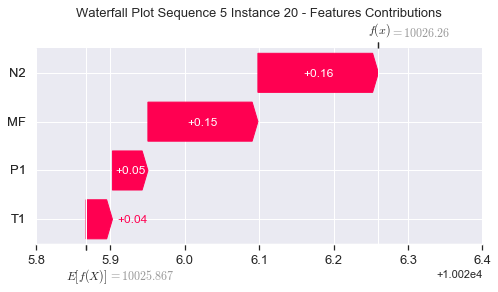

None

Contribution: [0.05222301 0.03899653 0.17821354 0.16254655]


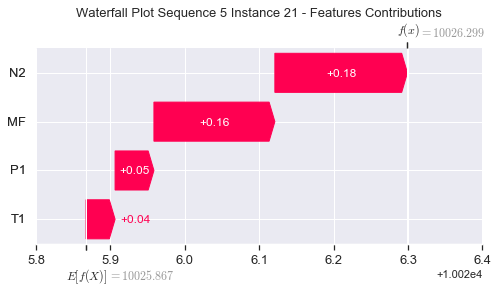

None

Contribution: [0.07114325 0.04906624 0.24755316 0.22611583]


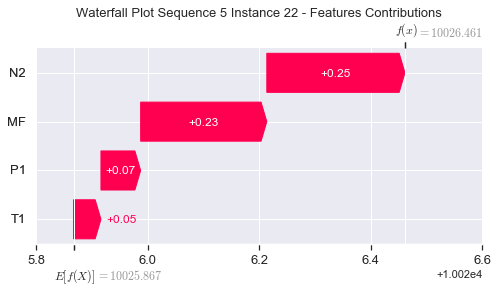

None

Contribution: [0.13611779 0.00203968 0.53566481 0.49844664]


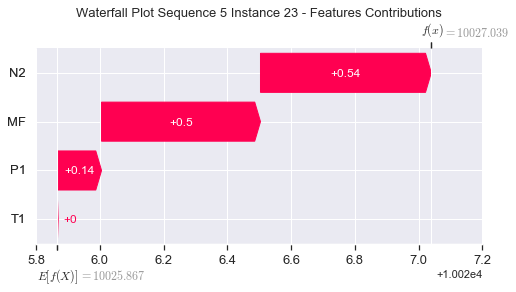

None

Contribution: [ 0.26888237 -1.8748087   1.91236279  1.90874199]


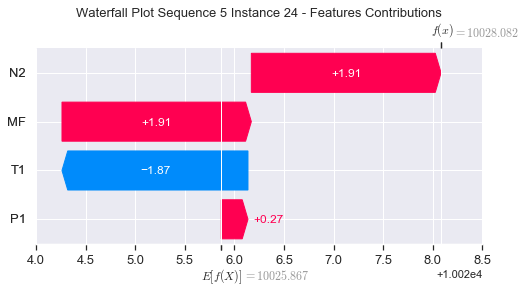

None

Contribution: [ 15.27897771 -15.67311828  69.54980794  65.44452142]


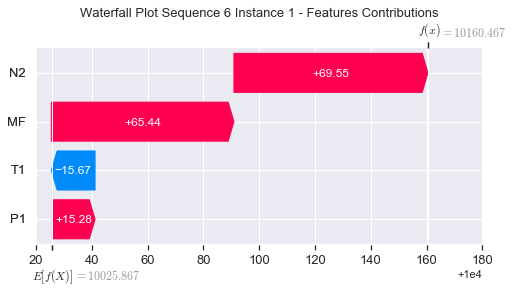

None

Contribution: [-0.22683489 -0.51286489 -0.30690416 -0.28736972]


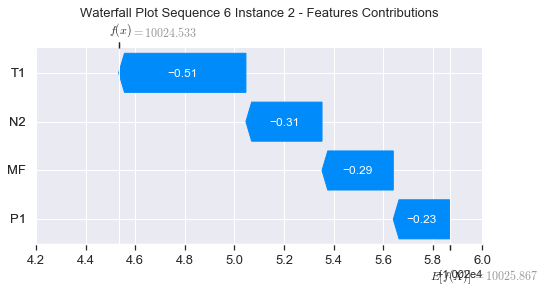

None

Contribution: [0.31142493 0.12025612 1.16849993 1.08589424]


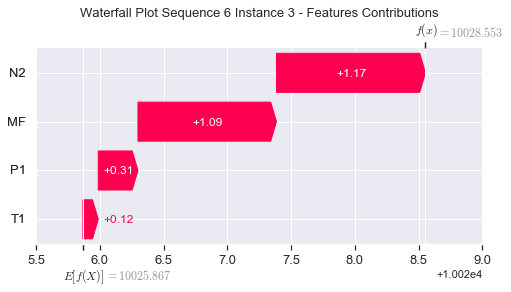

None

Contribution: [0.09580845 0.03917499 0.33748434 0.3071418 ]


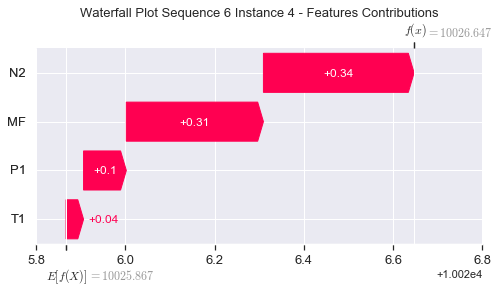

None

Contribution: [0.08003892 0.06047673 0.26946927 0.24545923]


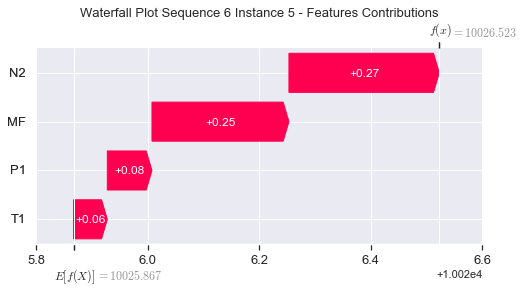

None

Contribution: [0.06987614 0.05180407 0.23426945 0.21342673]


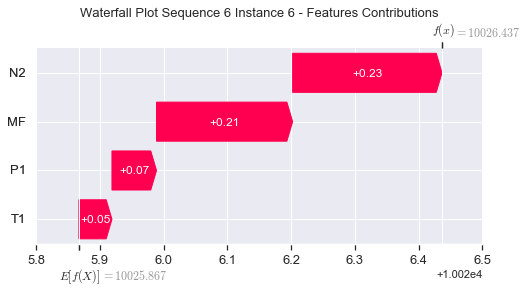

None

Contribution: [0.06525419 0.04787621 0.21860486 0.19917321]


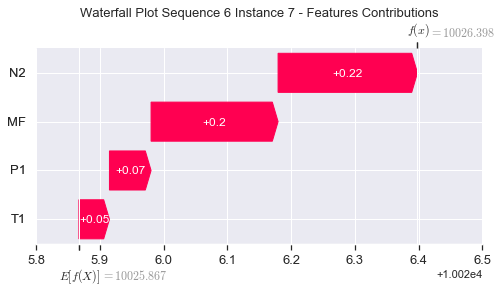

None

Contribution: [0.06195848 0.04508119 0.20821214 0.18935168]


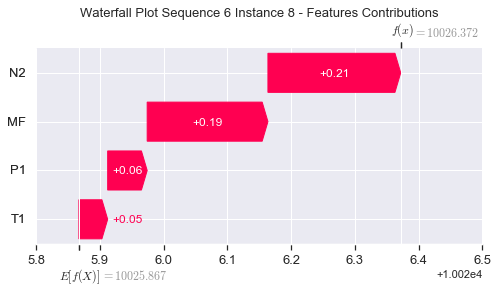

None

Contribution: [0.05950119 0.04264644 0.19985363 0.18062939]


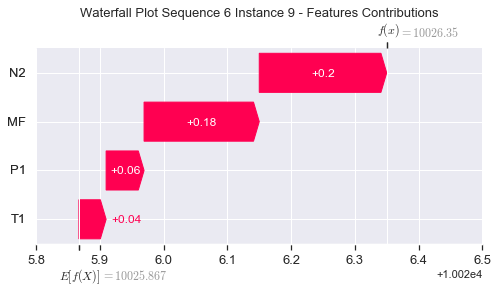

None

Contribution: [0.05673443 0.04226741 0.19318133 0.17665454]


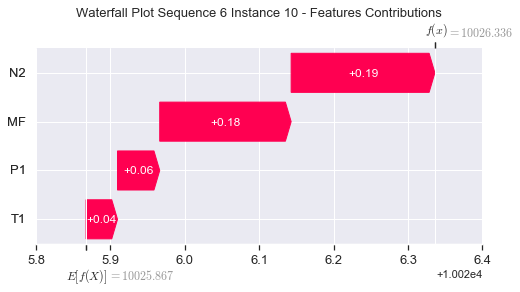

None

Contribution: [0.05531309 0.03928883 0.18692208 0.16853821]


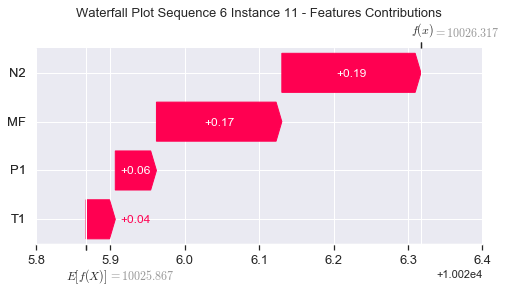

None

Contribution: [0.05352048 0.03666691 0.1802154  0.16363852]


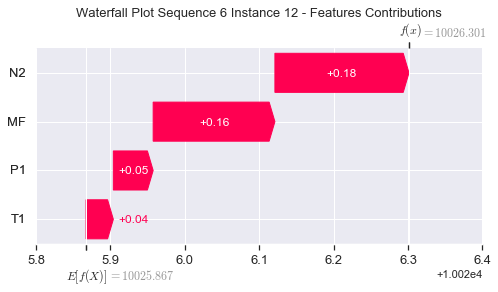

None

Contribution: [0.05224187 0.03561507 0.17610394 0.15991747]


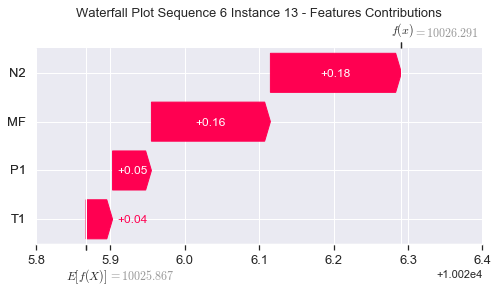

None

Contribution: [0.05099805 0.0361532  0.17184153 0.15672488]


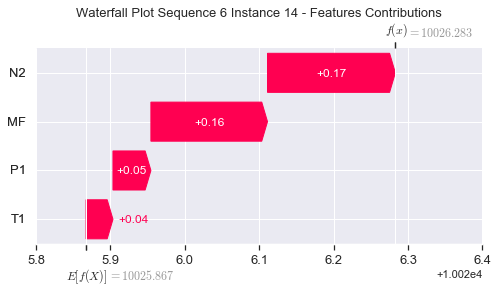

None

Contribution: [0.04979304 0.03325196 0.16838987 0.15285765]


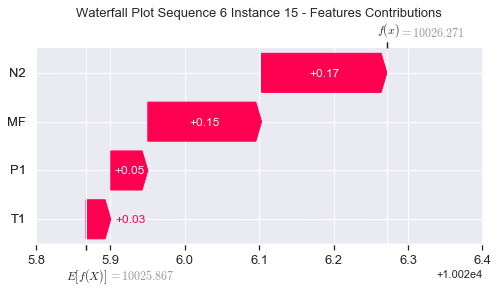

None

Contribution: [0.04876375 0.03054991 0.16477967 0.14879672]


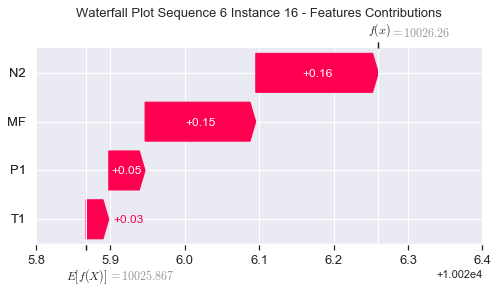

None

Contribution: [0.04785664 0.03059564 0.16231144 0.14732785]


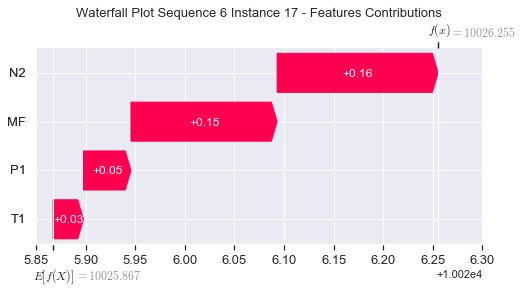

None

Contribution: [0.04700664 0.02944822 0.15993533 0.14508428]


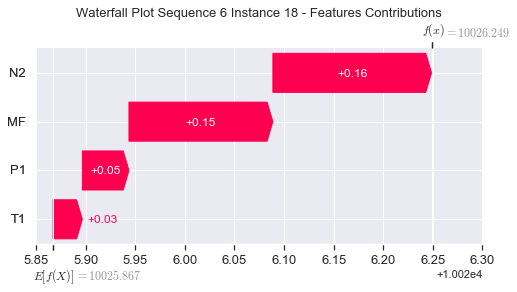

None

Contribution: [0.0468789  0.02812242 0.15917699 0.14375388]


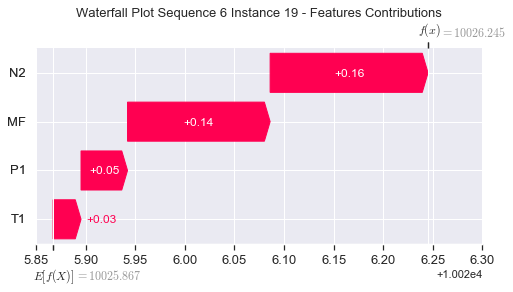

None

Contribution: [0.04723332 0.02884011 0.16190332 0.14665516]


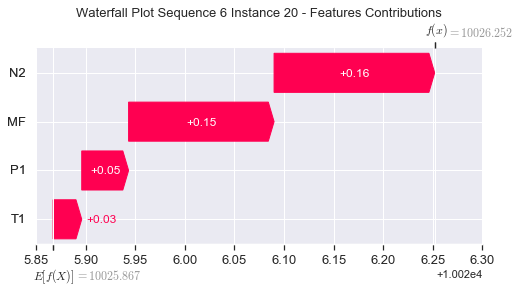

None

Contribution: [0.0516545  0.03124421 0.17810777 0.16115788]


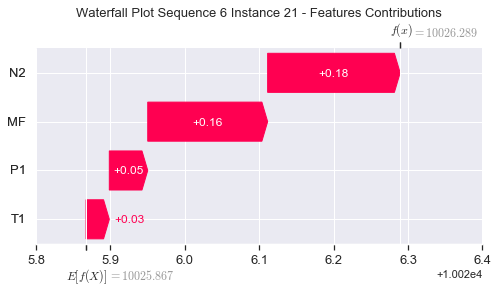

None

Contribution: [0.07012586 0.03581129 0.24758126 0.22392581]


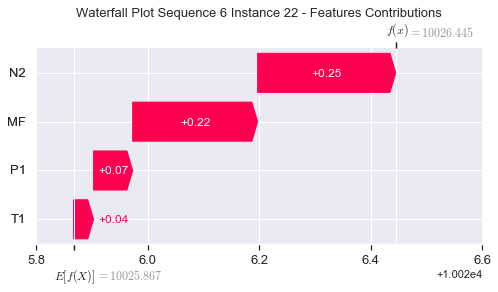

None

Contribution: [ 0.13050546 -0.06871741  0.53693524  0.48810256]


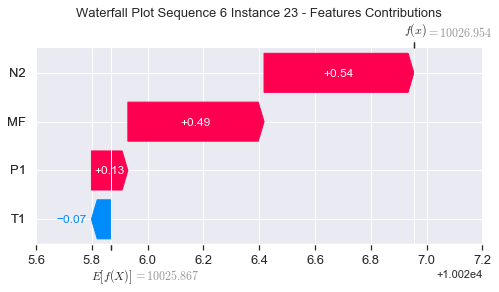

None

Contribution: [ 0.18084293 -2.71984262  1.94560174  1.7551652 ]


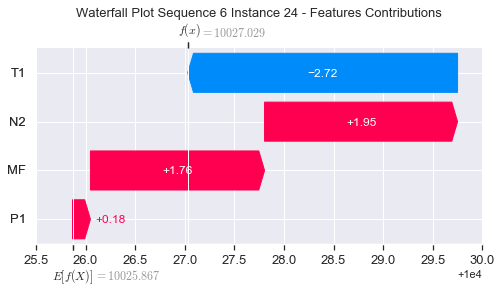

None

Contribution: [ 13.16491904 -34.1565024   71.30734257  62.04237213]


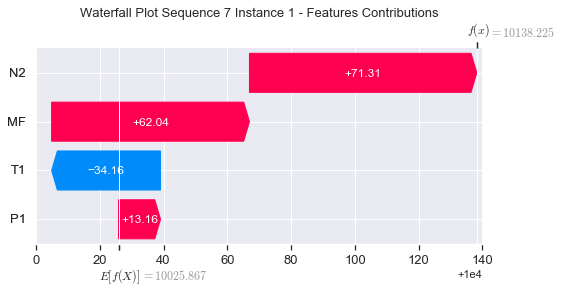

None

Contribution: [-0.2690268  -0.86052796 -0.35004043 -0.36384789]


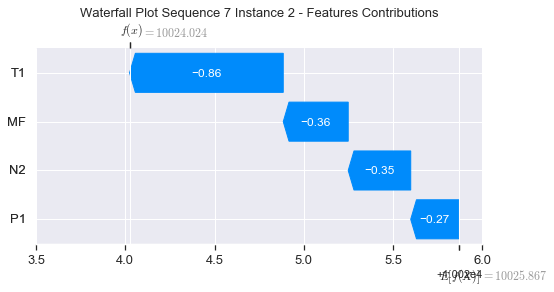

None

Contribution: [0.31436287 0.01305639 1.17561915 1.0878201 ]


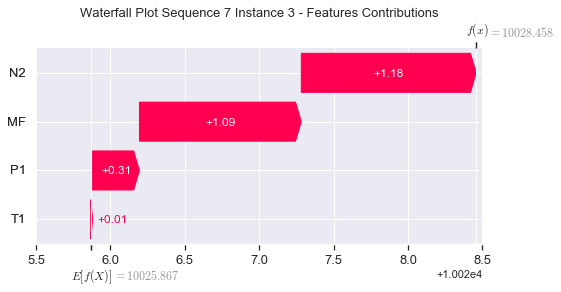

None

Contribution: [0.09759623 0.01594764 0.34343014 0.31785985]


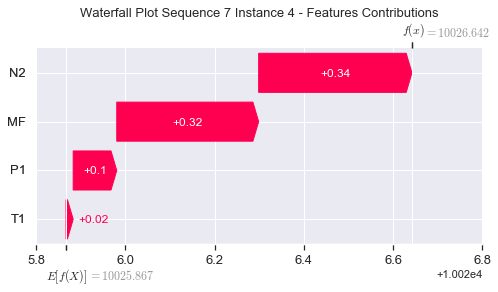

None

Contribution: [0.08044549 0.0463879  0.27030556 0.24794842]


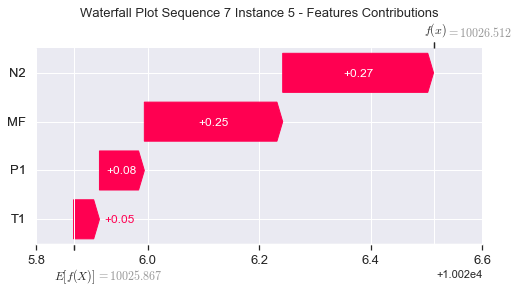

None

Contribution: [0.06951306 0.04103178 0.23451494 0.21437916]


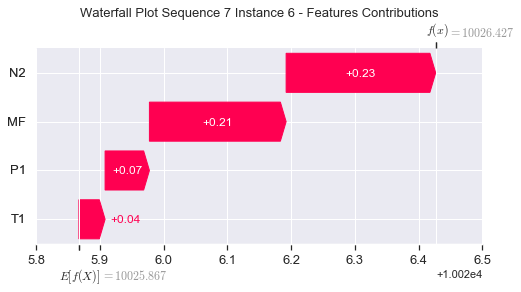

None

Contribution: [0.06467335 0.03895141 0.21908816 0.20056164]


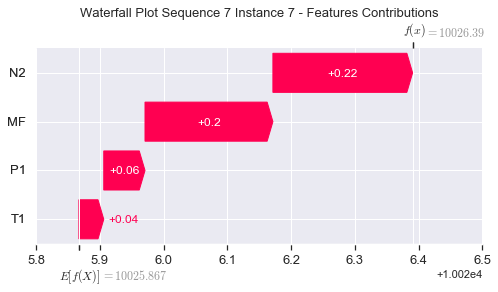

None

Contribution: [0.06165664 0.0371653  0.20861892 0.19056952]


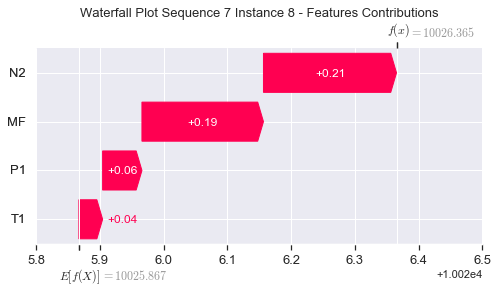

None

Contribution: [0.05898598 0.03876936 0.20045261 0.18355188]


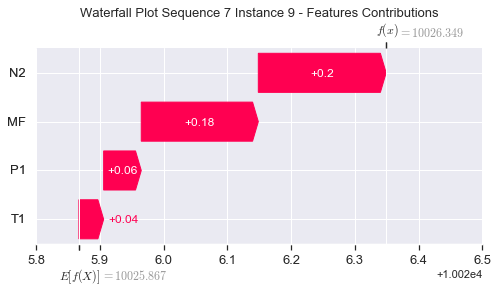

None

Contribution: [0.05764108 0.03843568 0.19396992 0.177804  ]


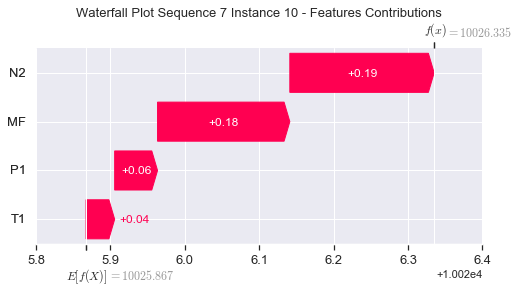

None

Contribution: [0.05542063 0.03472921 0.18711532 0.16968898]


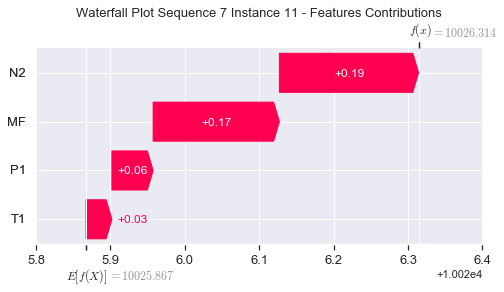

None

Contribution: [0.05313691 0.03241973 0.18139045 0.16511853]


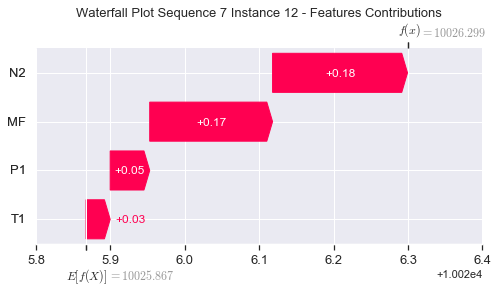

None

Contribution: [0.05184328 0.03189615 0.17726882 0.16152038]


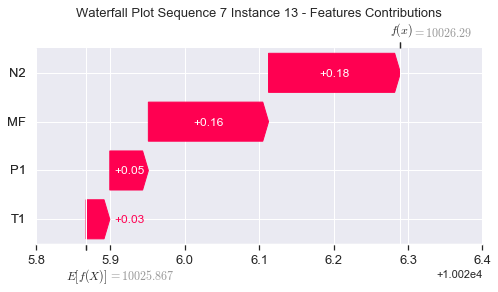

None

Contribution: [0.05043753 0.03382978 0.17323996 0.15797889]


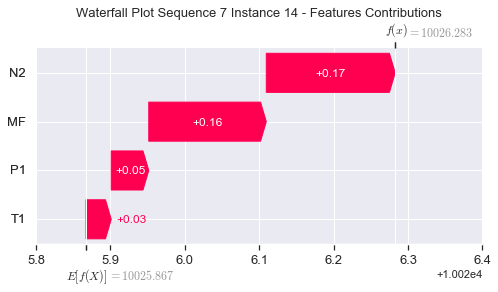

None

Contribution: [0.04942214 0.03006454 0.1694158  0.15410873]


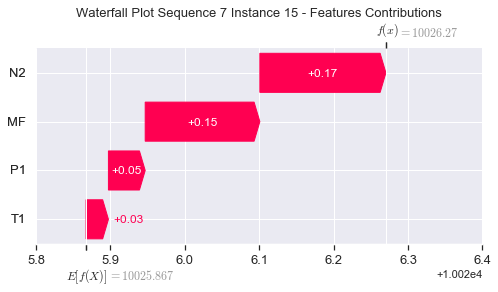

None

Contribution: [0.04967396 0.02885742 0.16677182 0.15305871]


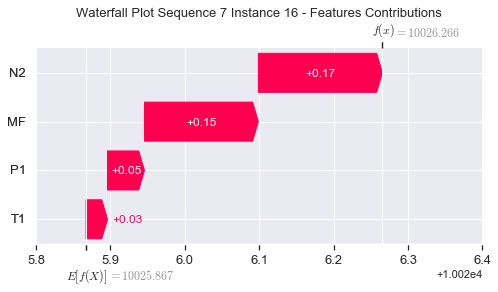

None

Contribution: [0.04733284 0.02915485 0.16332024 0.14852305]


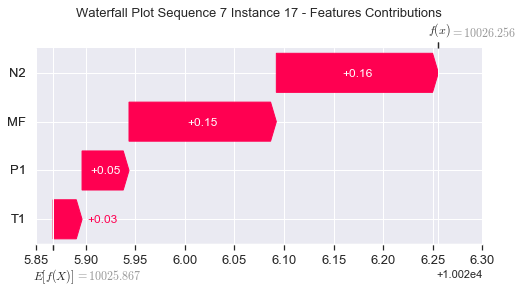

None

Contribution: [0.04656803 0.02842825 0.16083292 0.14594855]


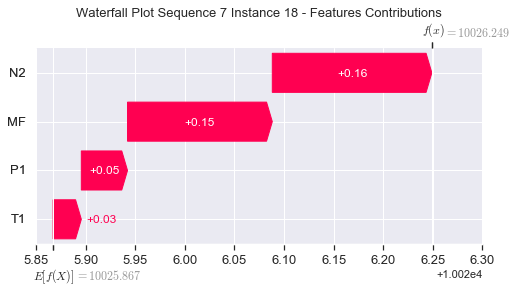

None

Contribution: [0.04758863 0.02693429 0.16032914 0.14559161]


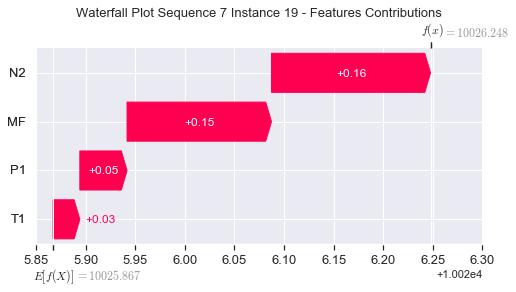

None

Contribution: [0.04694587 0.02875874 0.16278822 0.14762533]


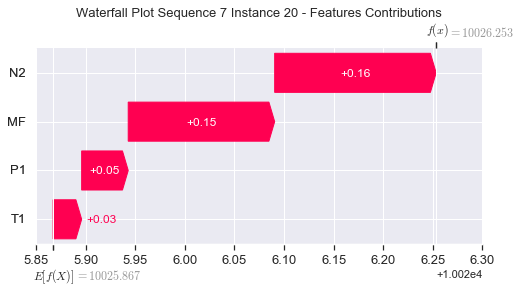

None

Contribution: [0.05146402 0.03156375 0.17931691 0.16236009]


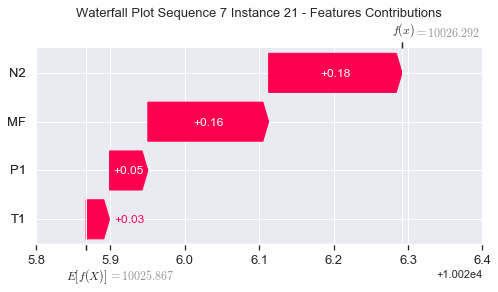

None

Contribution: [0.07015357 0.03622255 0.24943705 0.22547471]


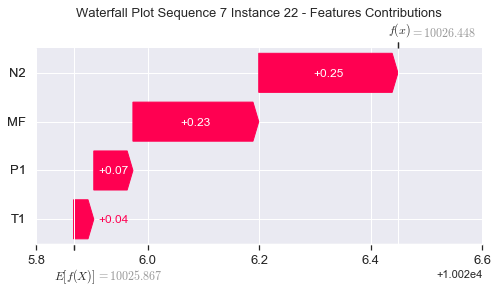

None

Contribution: [ 0.12884731 -0.06394774  0.53929061  0.48720931]


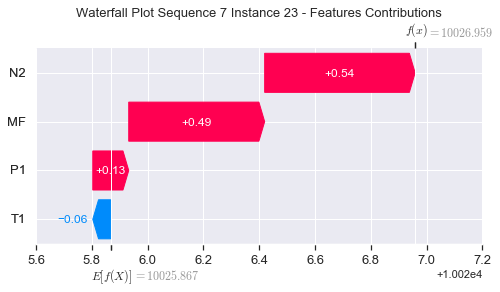

None

Contribution: [ 0.16861527 -2.70780101  1.92308944  1.71484583]


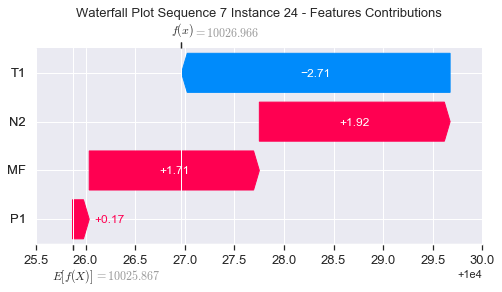

None

Contribution: [ 12.5052     -33.76616463  71.0170663   63.31932435]


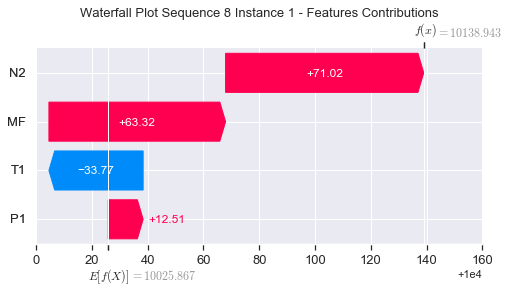

None

Contribution: [-0.27032444 -0.77716312 -0.34252175 -0.35934947]


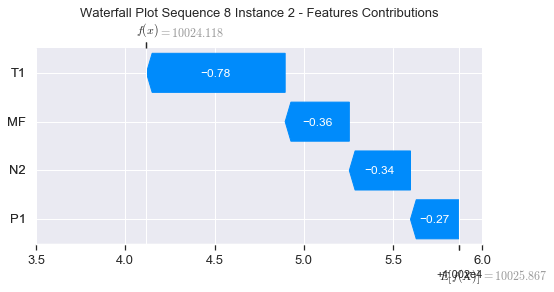

None

Contribution: [ 0.30670572 -0.03925852  1.18834326  1.10550859]


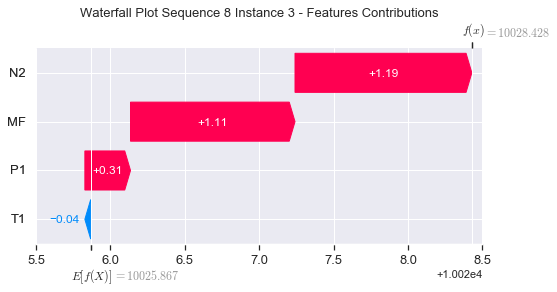

None

Contribution: [0.09376667 0.01440651 0.34190981 0.31812598]


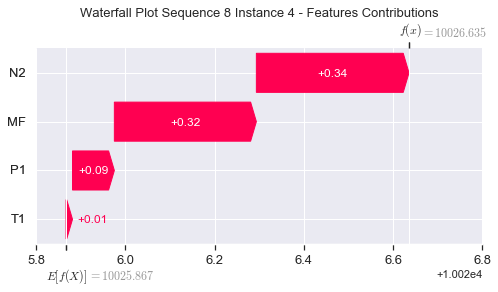

None

Contribution: [0.0738582  0.044694   0.26561745 0.23054605]


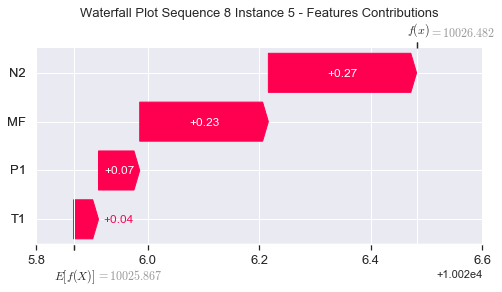

None

Contribution: [0.0682218  0.04538987 0.23365851 0.20924334]


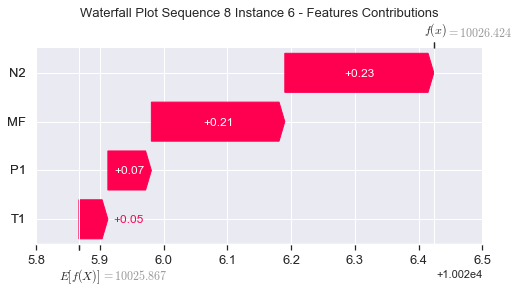

None

Contribution: [0.06358006 0.04241871 0.21838287 0.19605477]


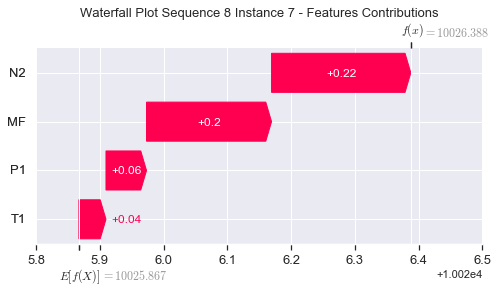

None

Contribution: [0.06054519 0.04134353 0.20812701 0.18697632]


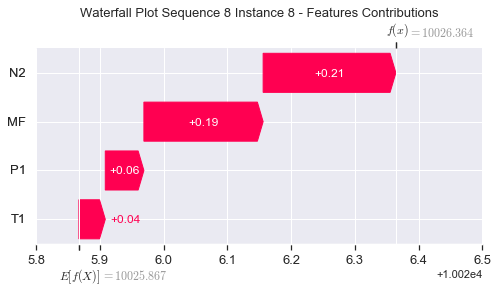

None

Contribution: [0.05700703 0.03833952 0.20103327 0.18391731]


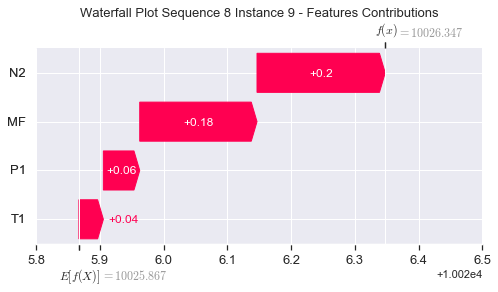

None

Contribution: [0.05174216 0.03489086 0.19287995 0.17194177]


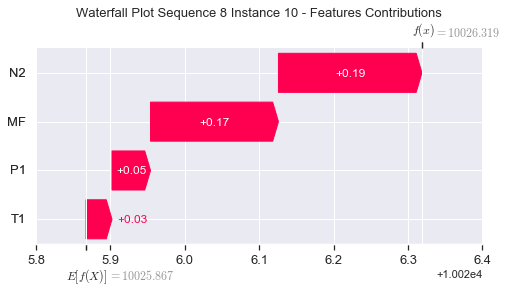

None

Contribution: [0.0556945  0.04221835 0.18928994 0.17478686]


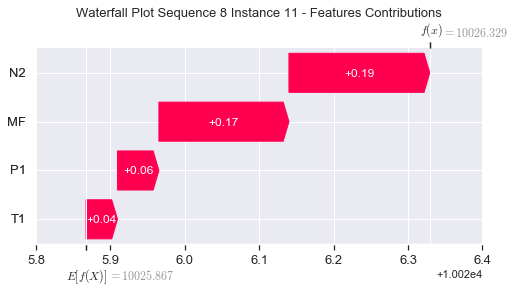

None

Contribution: [0.05452573 0.04279774 0.18252731 0.1665202 ]


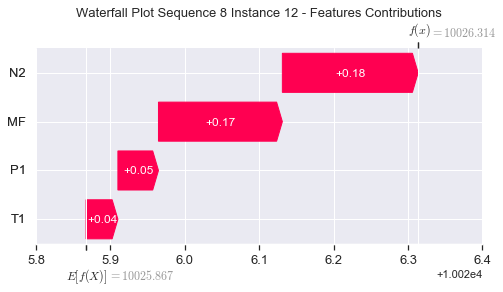

None

Contribution: [0.05270746 0.04067864 0.17797031 0.16180544]


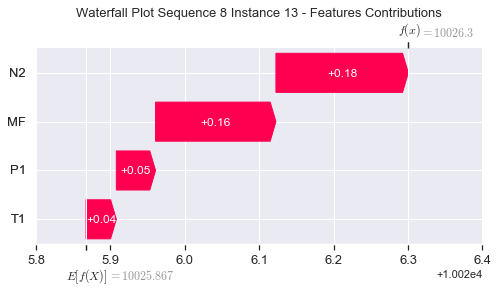

None

Contribution: [0.05173768 0.03961469 0.17415943 0.16046342]


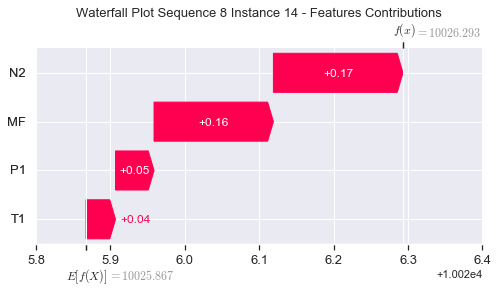

None

Contribution: [0.05093633 0.03912046 0.17038337 0.15564596]


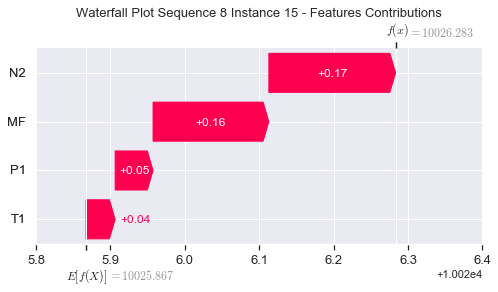

None

Contribution: [0.04993282 0.03761647 0.16746357 0.15490101]


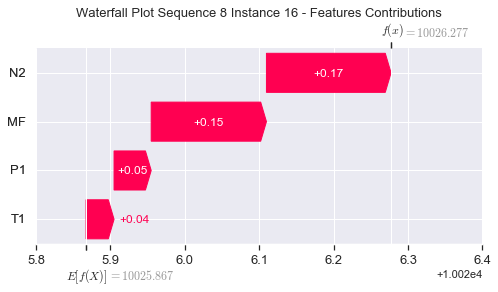

None

Contribution: [0.04922078 0.03847113 0.16443212 0.15089883]


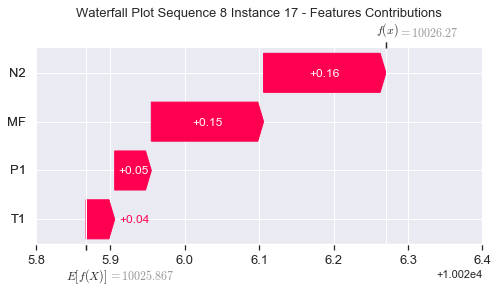

None

Contribution: [0.04878939 0.0386786  0.16206822 0.14896406]


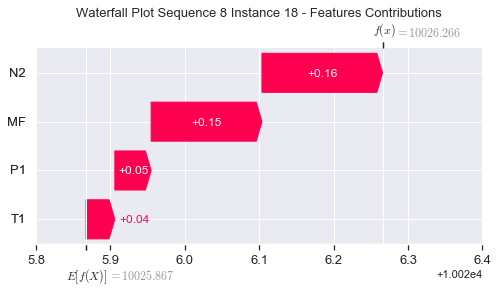

None

Contribution: [0.04810128 0.03518247 0.16051023 0.1457496 ]


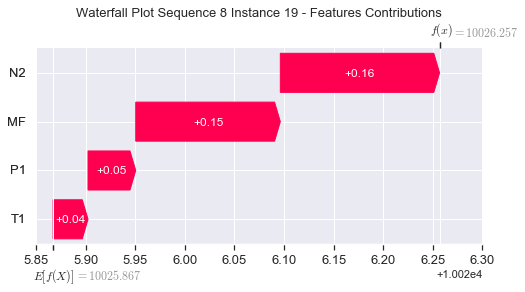

None

Contribution: [0.04827546 0.03759764 0.16323721 0.14860267]


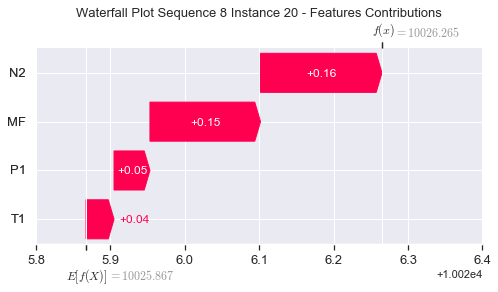

None

Contribution: [0.05295103 0.04241243 0.17966876 0.16332675]


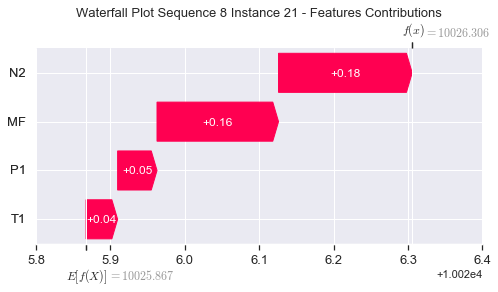

None

Contribution: [0.07236456 0.05561756 0.24949656 0.22626781]


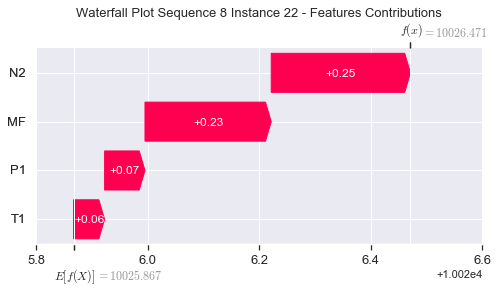

None

Contribution: [0.14676699 0.0426447  0.54327197 0.50825468]


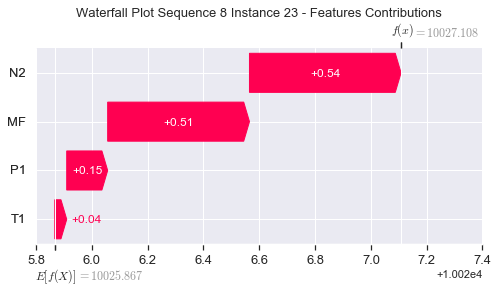

None

Contribution: [ 0.32386035 -1.50855821  1.94772826  1.78503546]


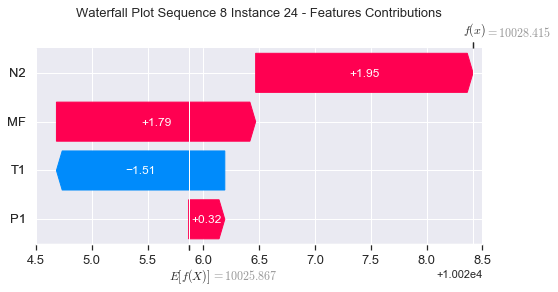

None

Contribution: [ 15.03962403 -10.13359465  69.61201893  60.62344466]


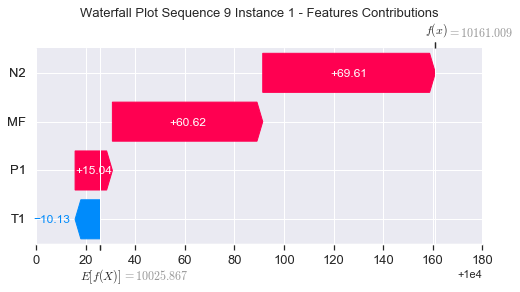

None

Contribution: [-0.2110622  -0.31160177 -0.30703099 -0.31274234]


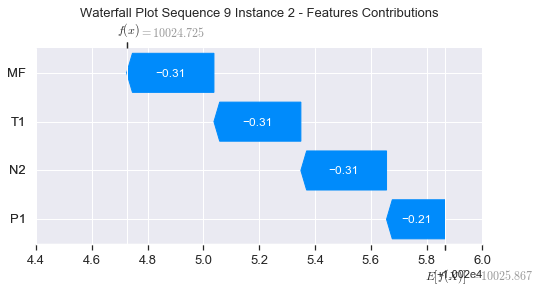

None

Contribution: [0.32609138 0.09541898 1.16781356 1.06072858]


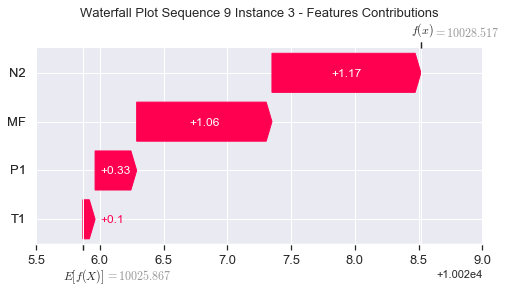

None

Contribution: [0.09293789 0.05822009 0.33289167 0.30206665]


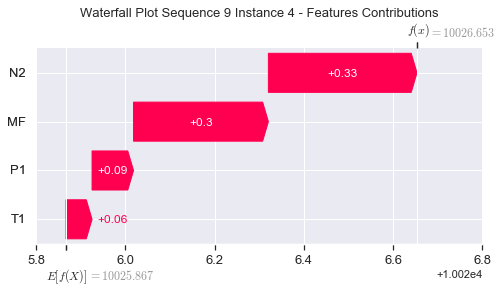

None

Contribution: [0.07963178 0.06479949 0.26808045 0.24587674]


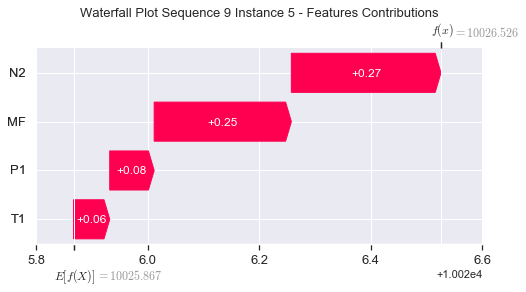

None

Contribution: [0.06931676 0.05623925 0.23318649 0.21273235]


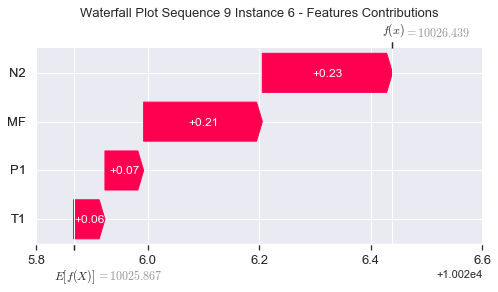

None

Contribution: [0.06479514 0.0525859  0.21774834 0.19821983]


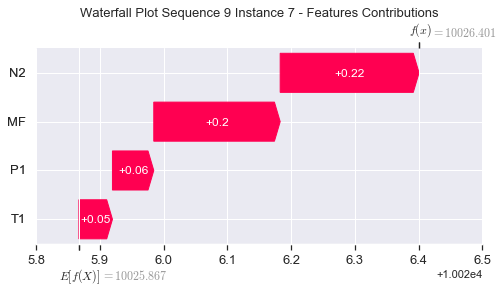

None

Contribution: [0.06196908 0.05015996 0.20753415 0.18934602]


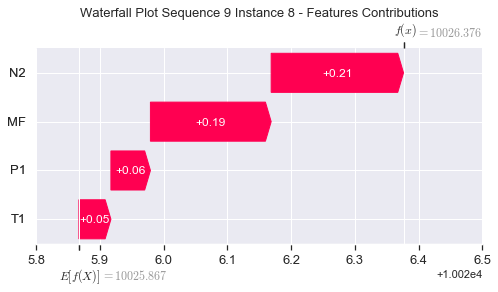

None

Contribution: [0.06083758 0.05043247 0.19970271 0.18179826]


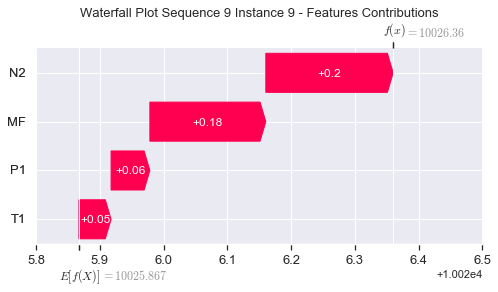

None

Contribution: [0.0578542  0.04865783 0.19321735 0.17951298]


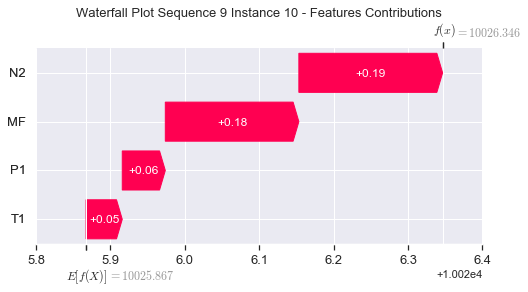

None

Contribution: [0.05670834 0.04670288 0.18694908 0.17091783]


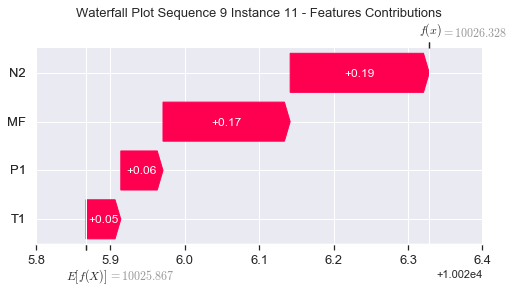

None

Contribution: [0.05393063 0.04234389 0.18056444 0.16439428]


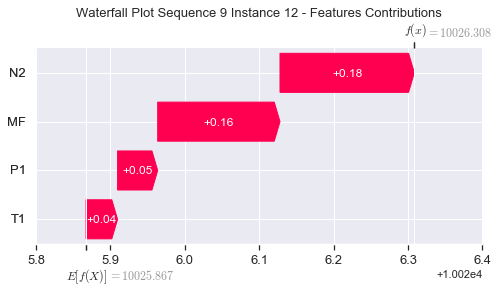

None

Contribution: [0.05277451 0.04136278 0.17640156 0.16067603]


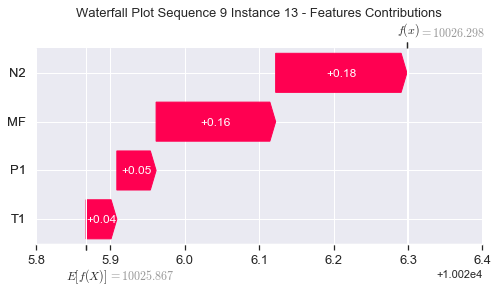

None

Contribution: [0.05251592 0.03940525 0.17295265 0.16021146]


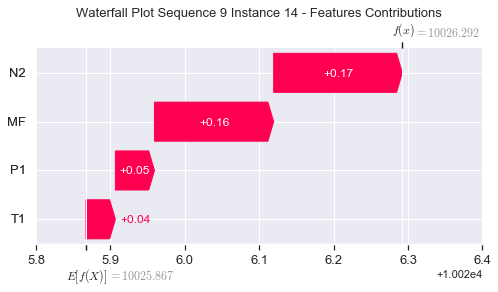

None

Contribution: [0.05048609 0.03901157 0.16863014 0.15383833]


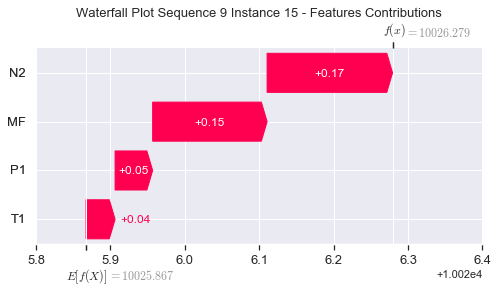

None

Contribution: [0.05003427 0.03544105 0.16579964 0.15357254]


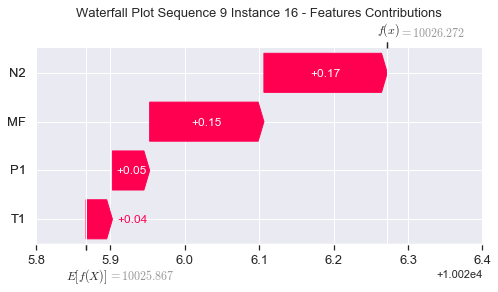

None

Contribution: [0.04885499 0.03713024 0.16254968 0.14813103]


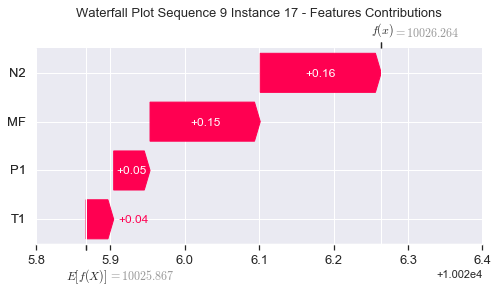

None

Contribution: [0.04817023 0.03622374 0.16013792 0.1461069 ]


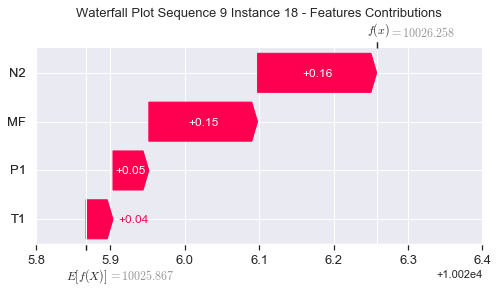

None

Contribution: [0.04784352 0.0374452  0.15953868 0.14708057]


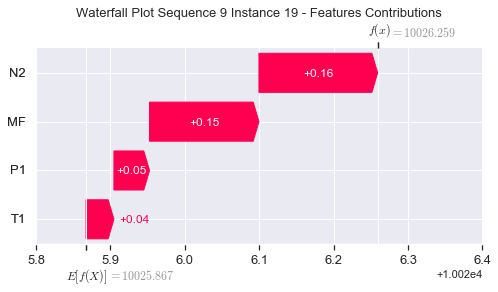

None

Contribution: [0.04881702 0.0364606  0.16191445 0.14795602]


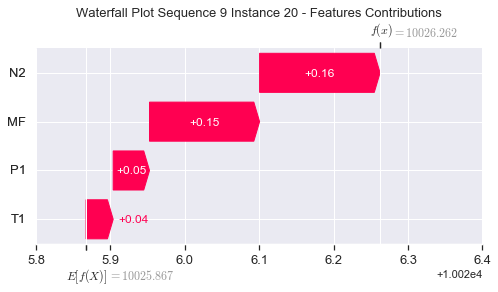

None

Contribution: [0.05359459 0.03986757 0.17817971 0.16294807]


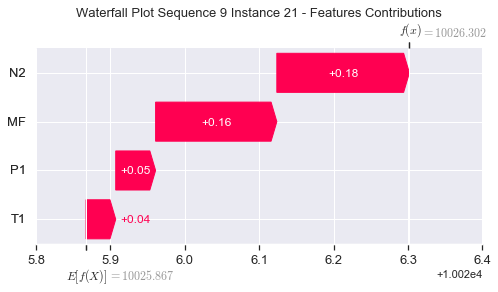

None

Contribution: [0.07355783 0.05012736 0.24763931 0.22773237]


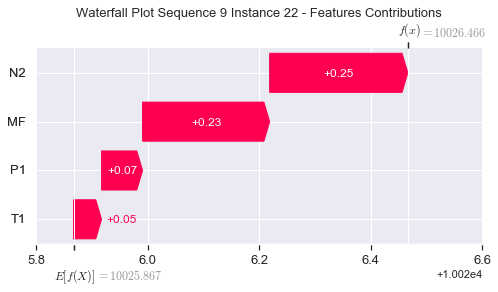

None

Contribution: [0.14746845 0.0011637  0.53860714 0.50790758]


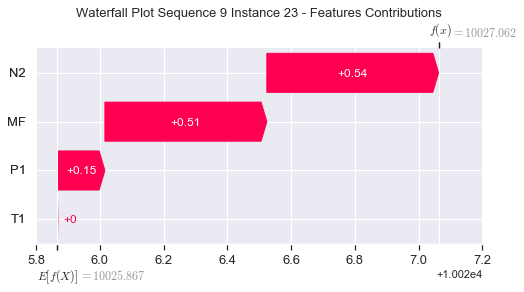

None

Contribution: [ 0.41565934 -1.90127352  1.95992285  2.02279675]


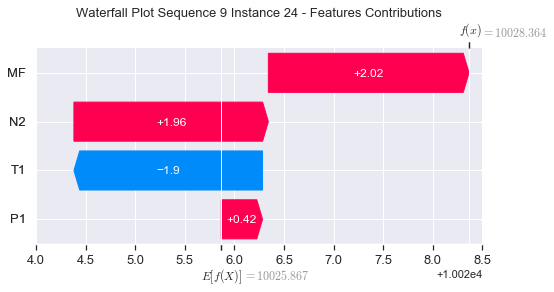

None

Contribution: [ 18.18904713 -17.38397457  69.9483831   64.92815878]


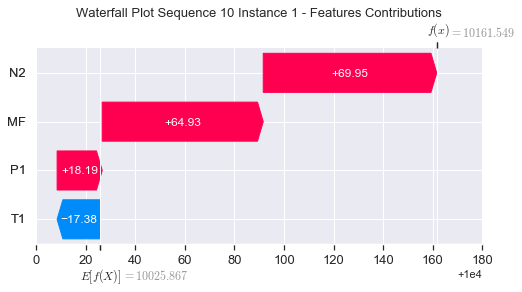

None

Contribution: [-0.16845241 -0.49269364 -0.29272395 -0.21535901]


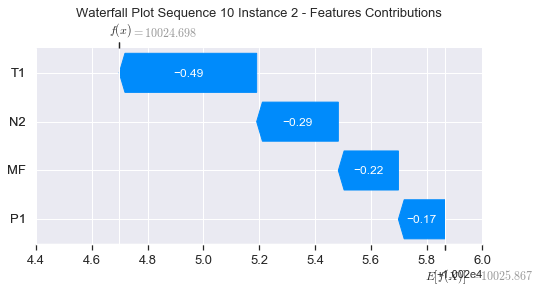

None

Contribution: [0.33008509 0.10534336 1.16654964 1.09891605]


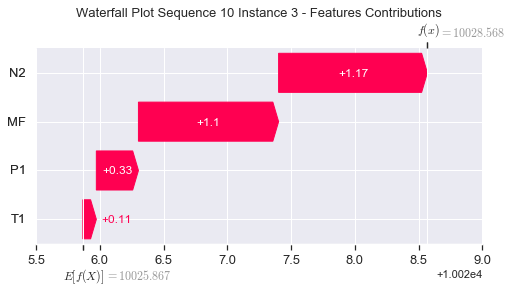

None

Contribution: [0.10021889 0.04030461 0.33521687 0.30490923]


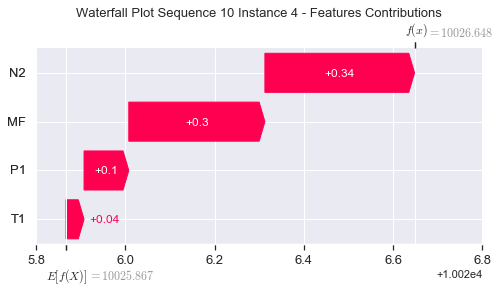

None

Contribution: [0.08293933 0.06786393 0.26882533 0.24671054]


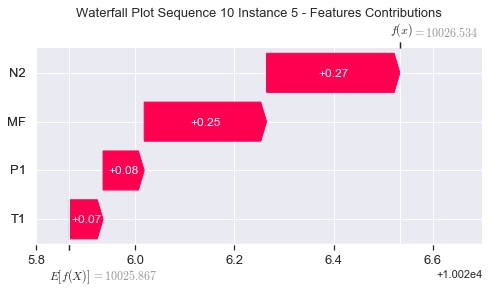

None

Contribution: [0.07337725 0.05172262 0.23444279 0.21738017]


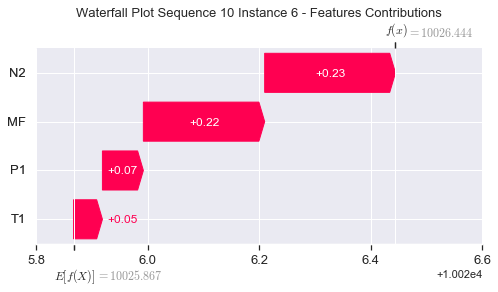

None

Contribution: [0.06784746 0.04585254 0.21850922 0.20200688]


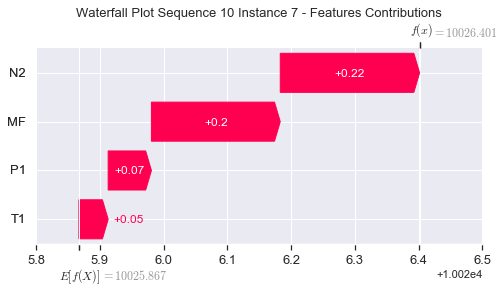

None

Contribution: [0.06557795 0.04612201 0.20851406 0.19344105]


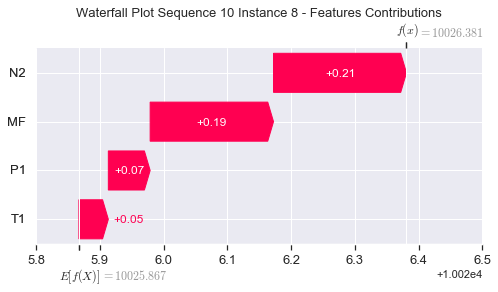

None

Contribution: [0.065503   0.05018761 0.20087157 0.18862894]


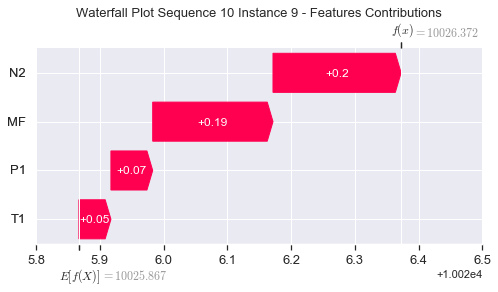

None

Contribution: [0.06277701 0.05052068 0.19416641 0.18143688]


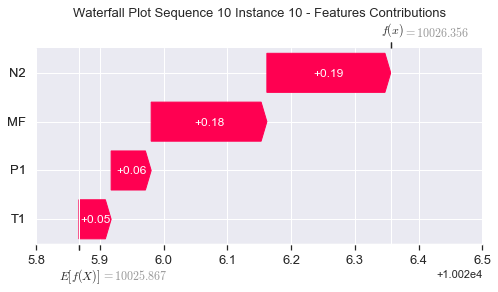

None

Contribution: [0.06431105 0.05175095 0.18982807 0.18172455]


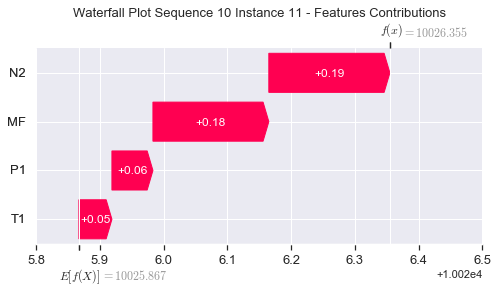

None

Contribution: [0.05728405 0.0383309  0.181795   0.16953298]


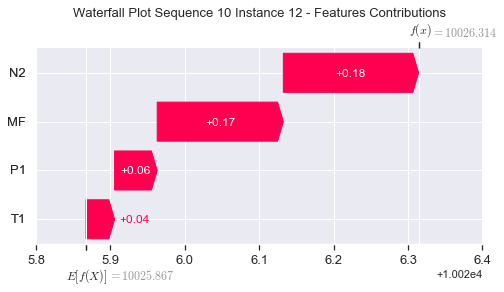

None

Contribution: [0.05546056 0.03653524 0.17719034 0.16444077]


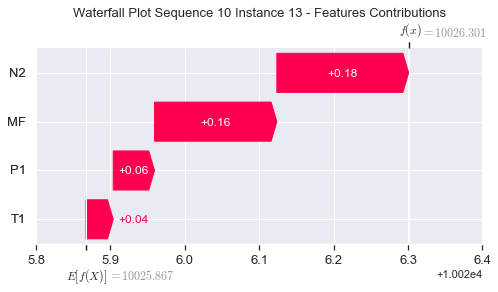

None

Contribution: [0.05475423 0.04095956 0.1731246  0.15977395]


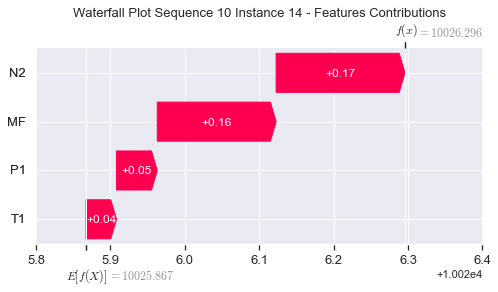

None

Contribution: [0.05313858 0.03263508 0.16925329 0.15728701]


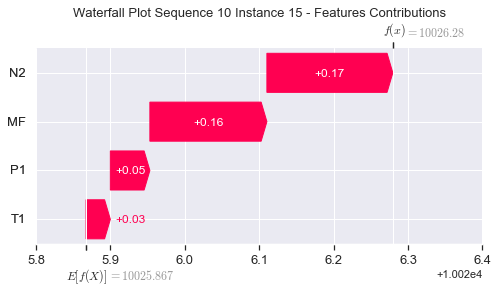

None

Contribution: [0.04919996 0.01680716 0.16454511 0.15302754]


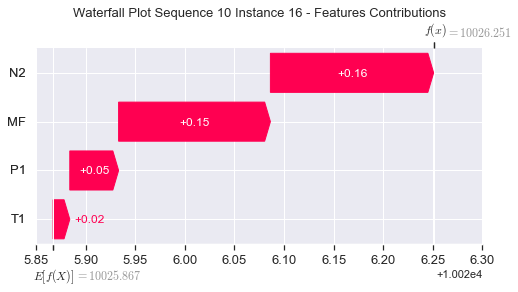

None

Contribution: [0.05088941 0.02855116 0.16272442 0.15055962]


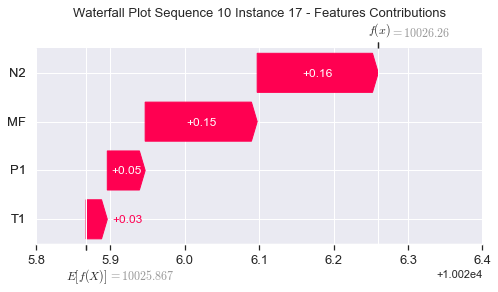

None

Contribution: [0.05033809 0.02740468 0.16028821 0.14835914]


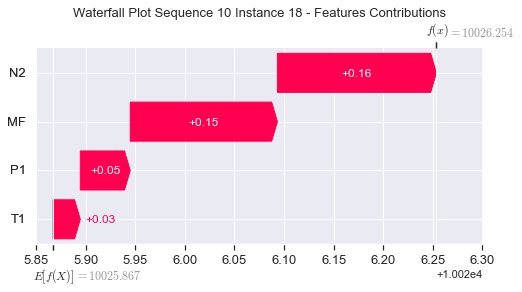

None

Contribution: [0.04896065 0.01696014 0.15929704 0.14788713]


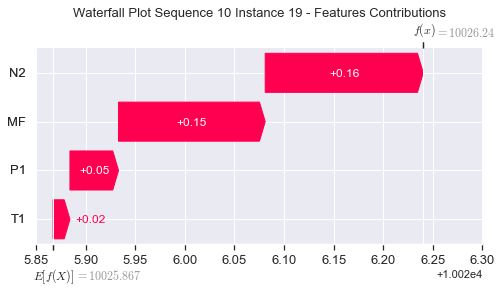

None

Contribution: [0.05035186 0.02690769 0.16152308 0.14826853]


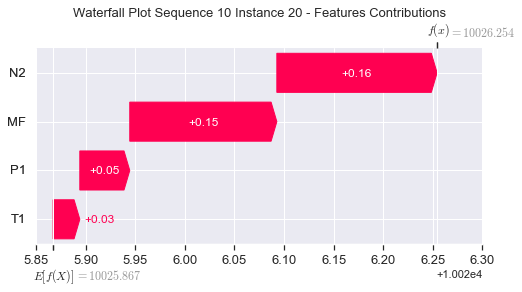

None

Contribution: [0.05546606 0.03093467 0.17790044 0.16333952]


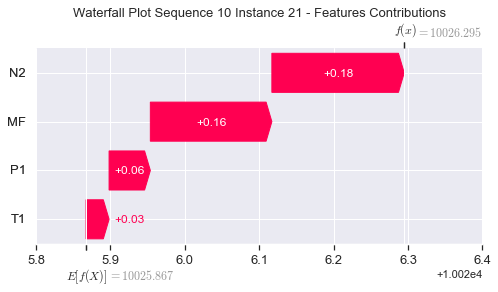

None

Contribution: [0.0772882  0.03864495 0.24759803 0.22860824]


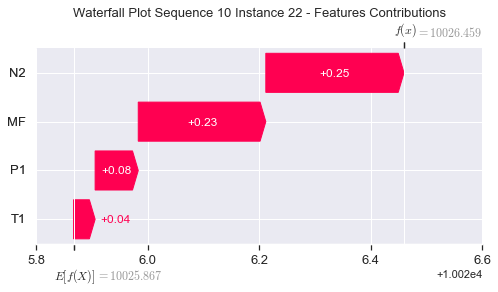

None

Contribution: [ 0.16793838 -0.06362288  0.53996497  0.51811617]


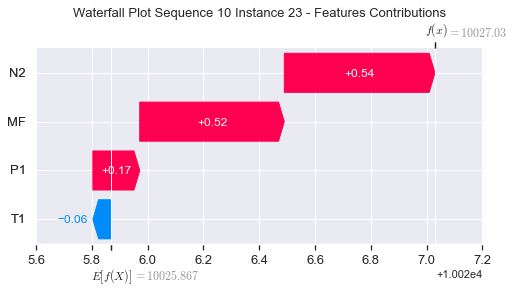

None

Contribution: [ 0.60652908 -2.46229994  1.94411937  1.98525263]


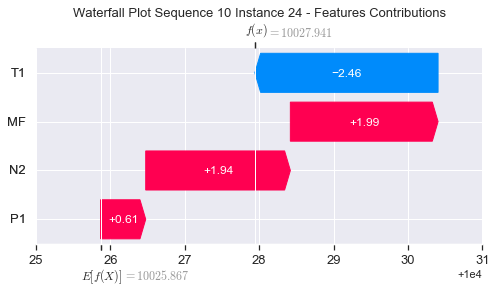

None

Contribution: [ 18.03995981 -20.35098066  68.9545091   60.86229118]


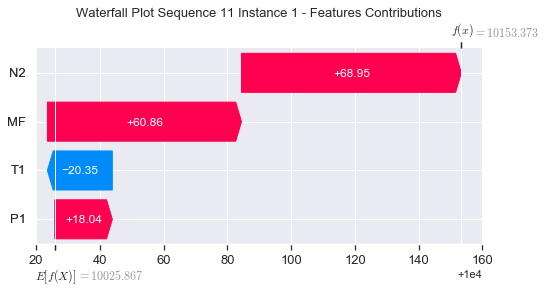

None

Contribution: [-0.12082775 -0.62068759 -0.31481716 -0.24163039]


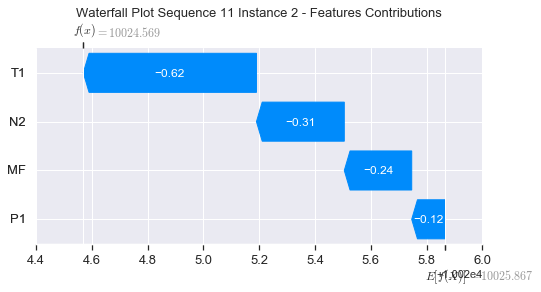

None

Contribution: [0.36368631 0.09853183 1.17111935 1.13616024]


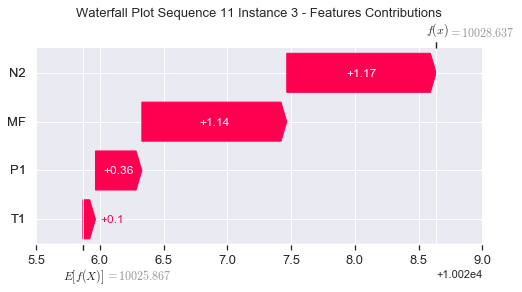

None

Contribution: [0.10925721 0.05881022 0.33416086 0.31670993]


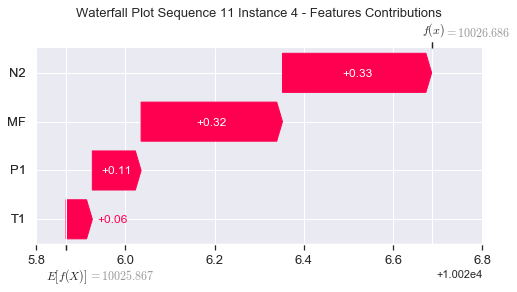

None

Contribution: [0.08628323 0.06988269 0.26886509 0.24984475]


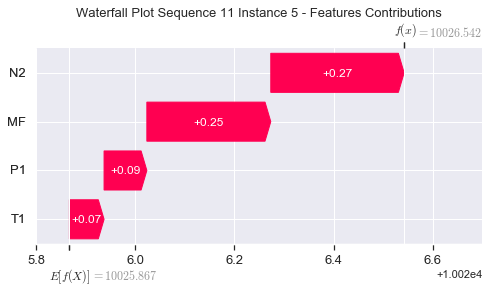

None

Contribution: [0.07594726 0.06276951 0.2344348  0.21790816]


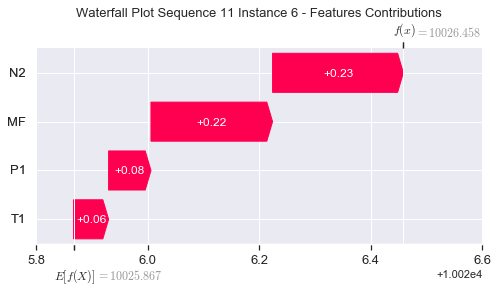

None

Contribution: [0.07033589 0.05919893 0.2187767  0.20262485]


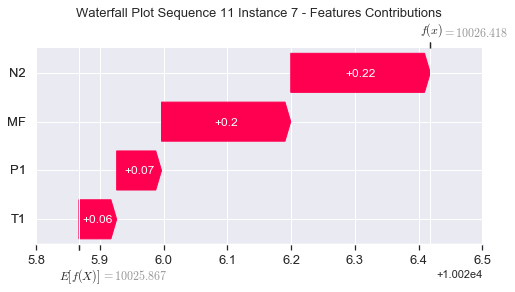

None

Contribution: [0.06722422 0.05652184 0.20837091 0.19316487]


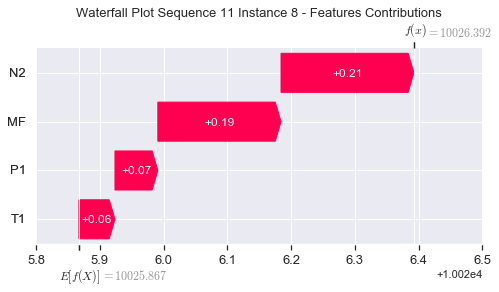

None

Contribution: [0.06284347 0.05545901 0.19945204 0.18111335]


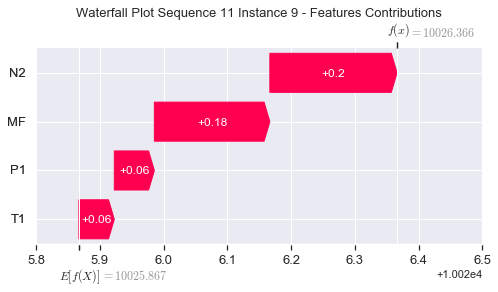

None

Contribution: [0.06018786 0.05333257 0.19290133 0.17726336]


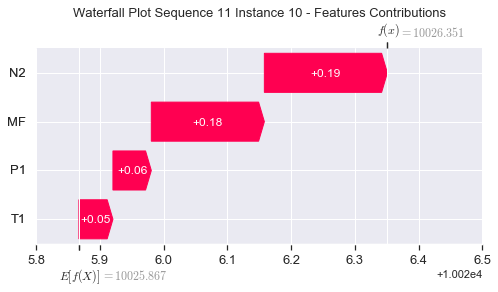

None

Contribution: [0.0609312  0.05119592 0.18726048 0.17225277]


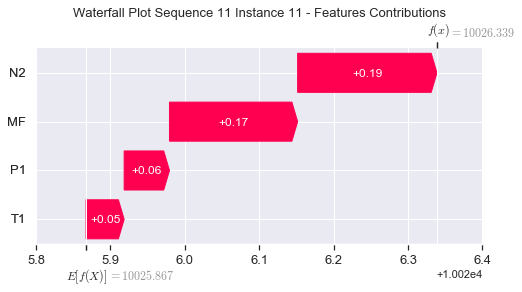

None

Contribution: [0.05893001 0.04921324 0.18126957 0.16832032]


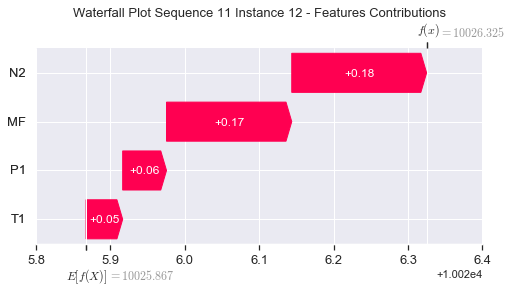

None

Contribution: [0.05717711 0.04849354 0.17690586 0.16407171]


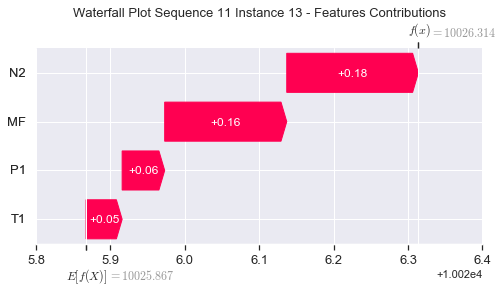

None

Contribution: [0.05587816 0.0483627  0.17277985 0.16101375]


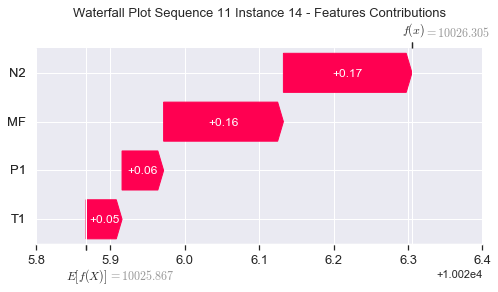

None

Contribution: [0.05474807 0.0468873  0.16895736 0.15721399]


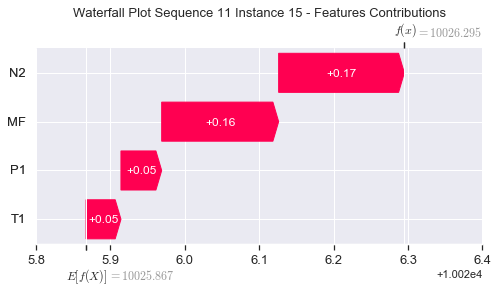

None

Contribution: [0.05655229 0.04398722 0.16596062 0.15788828]


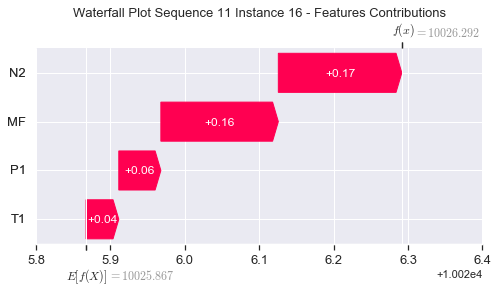

None

Contribution: [0.05236836 0.04621986 0.16260514 0.15108582]


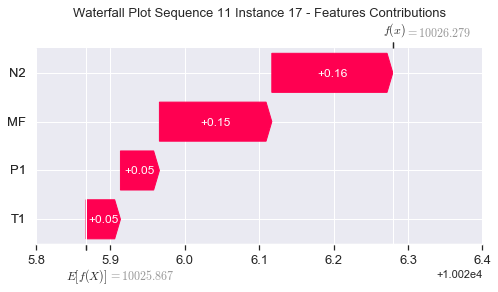

None

Contribution: [0.05174973 0.04586041 0.16014358 0.14921972]


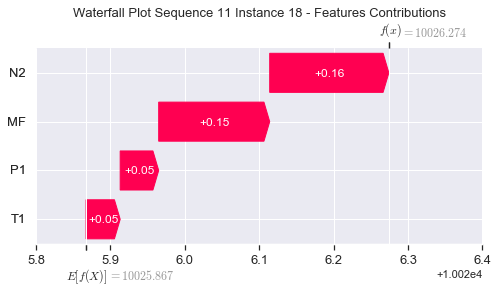

None

Contribution: [0.05279558 0.04640636 0.1598328  0.15323037]


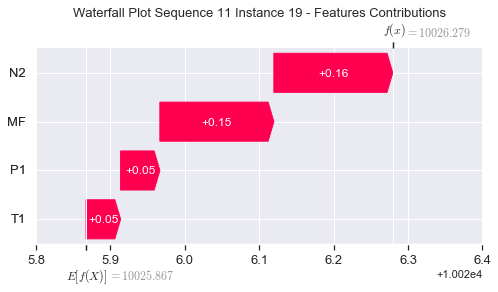

None

Contribution: [0.05166061 0.04709331 0.16152765 0.15043437]


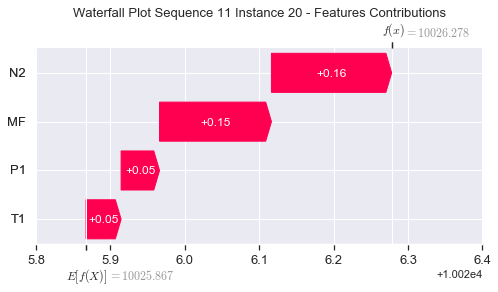

None

Contribution: [0.05674749 0.05182027 0.17762731 0.16553804]


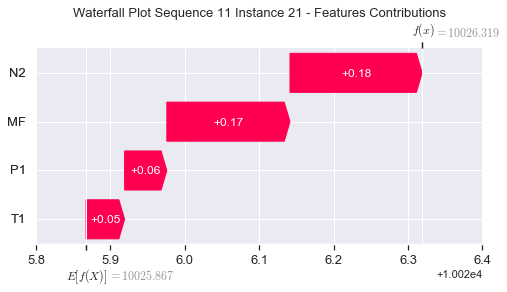

None

Contribution: [0.07901694 0.06966303 0.24656118 0.23202203]


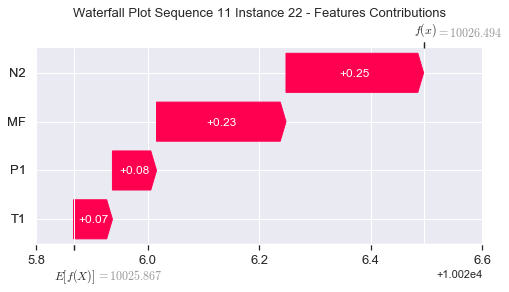

None

Contribution: [0.17585446 0.09803256 0.53431142 0.53254384]


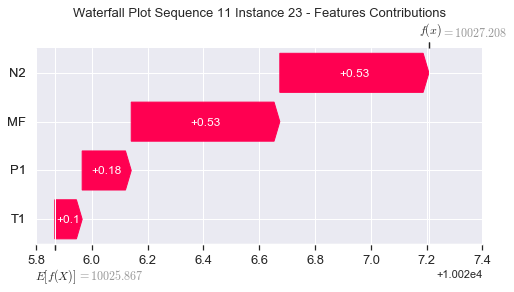

None

Contribution: [ 0.7625451  -0.66404411  1.9171648   2.33578954]


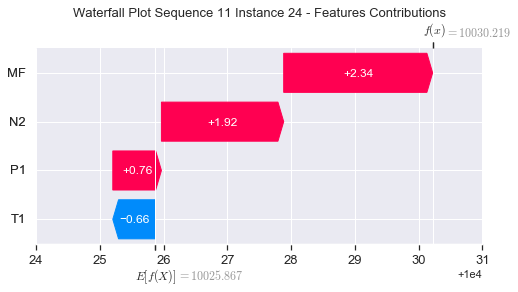

None

Contribution: [22.50535056  5.76967017 67.00997823 67.38435069]


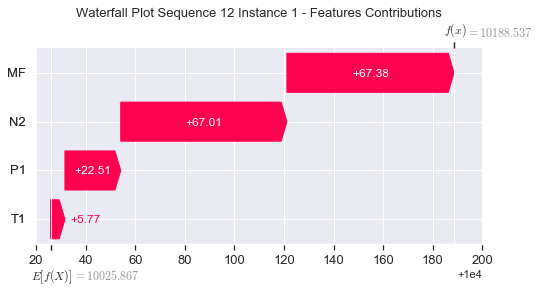

None

Contribution: [-0.07778415 -0.10401651 -0.26585362 -0.13376404]


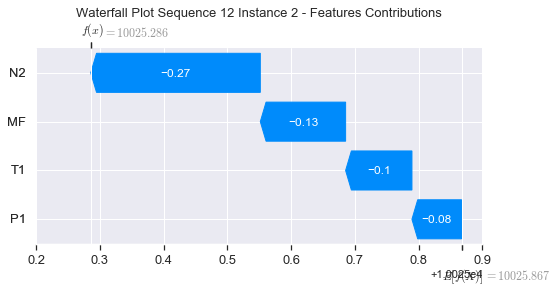

None

Contribution: [0.36618814 0.2449036  1.12809012 1.1049041 ]


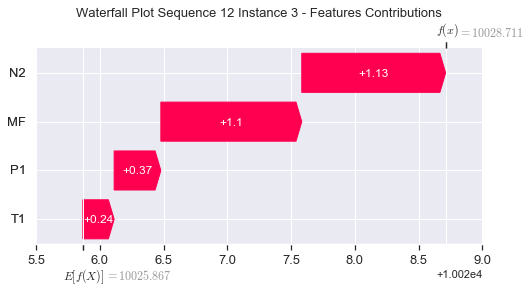

None

Contribution: [0.10576709 0.07064834 0.32421496 0.30899081]


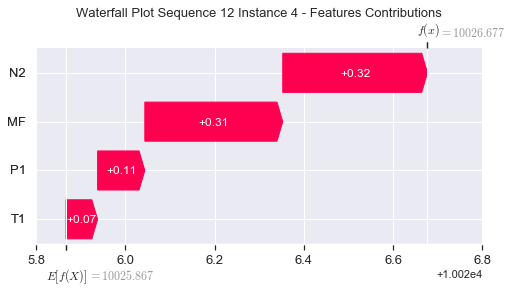

None

Contribution: [0.08521181 0.07623169 0.26612068 0.2464658 ]


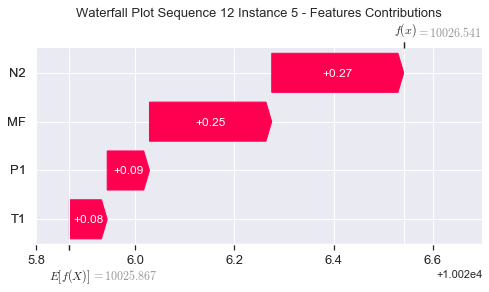

None

Contribution: [0.07451916 0.06485762 0.23242553 0.21692776]


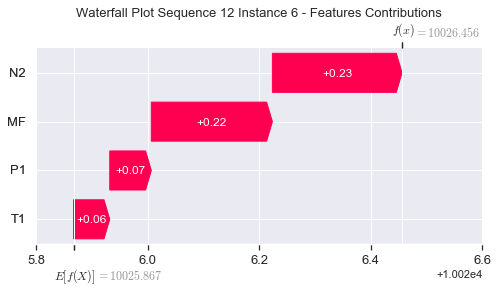

None

Contribution: [0.06960504 0.05988281 0.21703055 0.20249026]


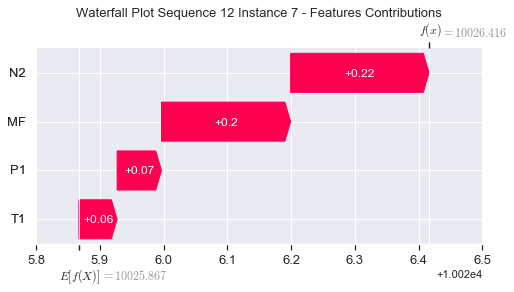

None

Contribution: [0.06627657 0.05738702 0.20667189 0.19257201]


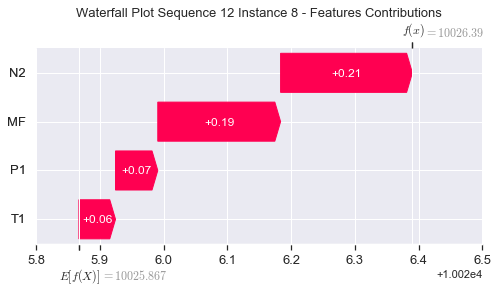

None

Contribution: [0.06370478 0.05490017 0.19821658 0.18360458]


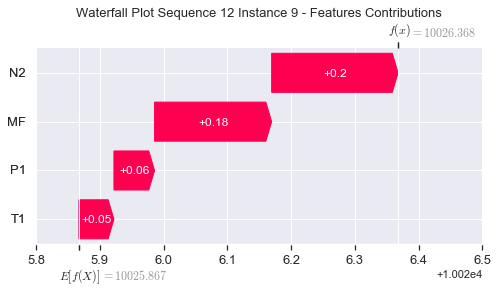

None

Contribution: [0.06319179 0.05333378 0.19228772 0.18106981]


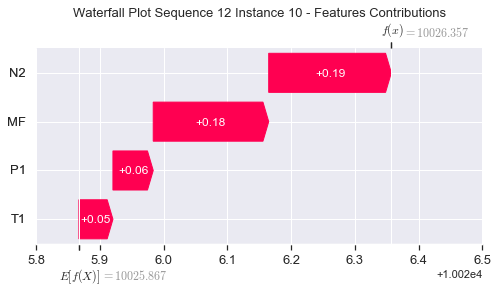

None

Contribution: [0.05934832 0.0518139  0.18539359 0.17156148]


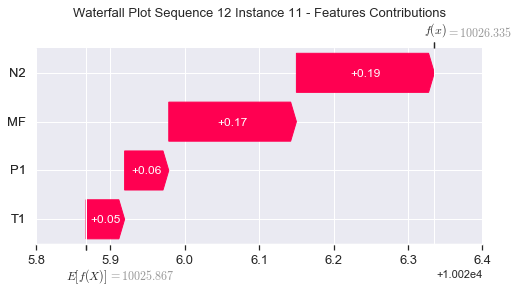

None

Contribution: [0.0571266  0.04729701 0.17924096 0.16646032]


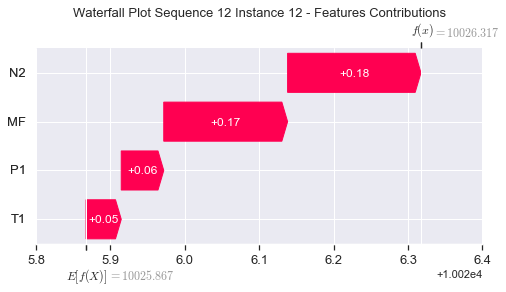

None

Contribution: [0.05590256 0.04632799 0.17513963 0.16274041]


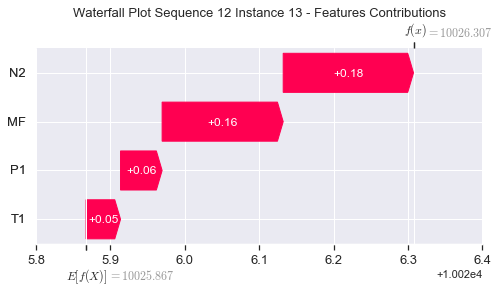

None

Contribution: [0.05513423 0.04350739 0.17104996 0.16094597]


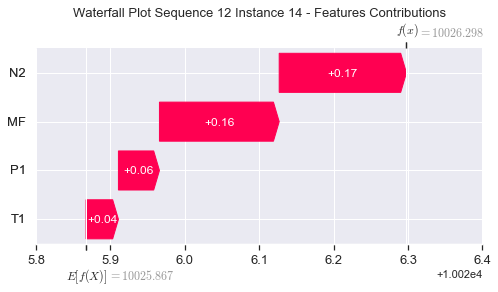

None

Contribution: [0.05348273 0.04417677 0.16747654 0.15592298]


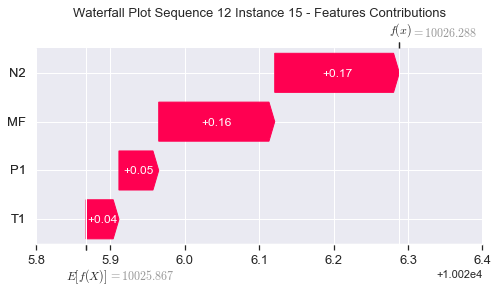

None

Contribution: [0.0529781  0.04091508 0.16439805 0.15472458]


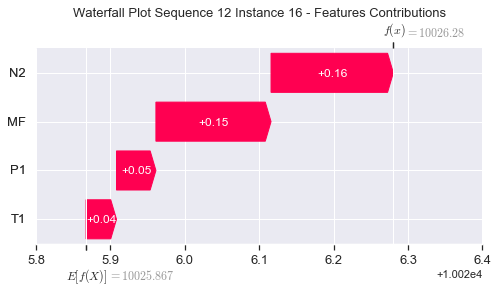

None

Contribution: [0.05166371 0.0421355  0.16149993 0.15082603]


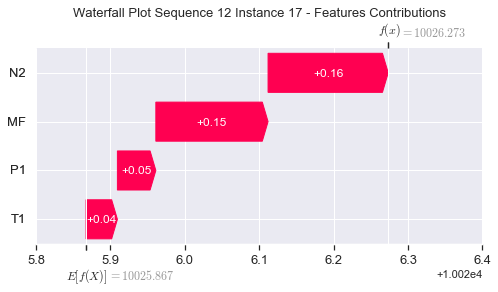

None

Contribution: [0.05090608 0.04151852 0.1591229  0.1488133 ]


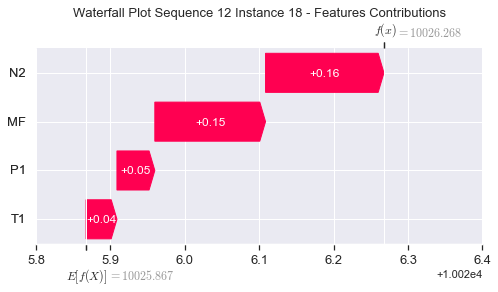

None

Contribution: [0.04981134 0.03988573 0.15771399 0.14561495]


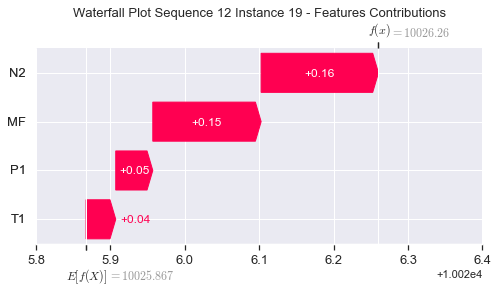

None

Contribution: [0.05140508 0.0425754  0.1607875  0.15018245]


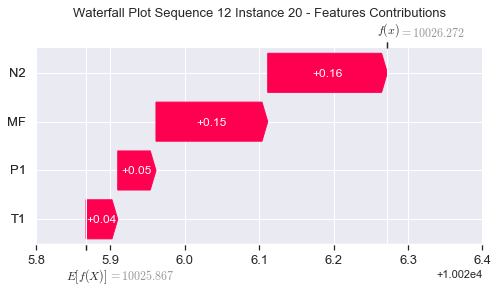

None

Contribution: [0.05620531 0.04682805 0.17654609 0.16461443]


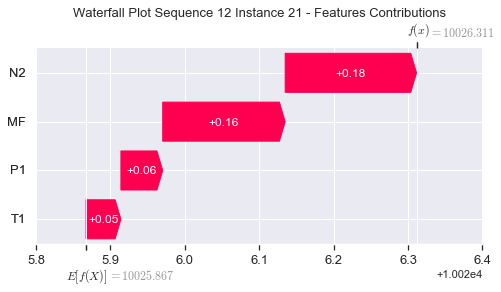

None

Contribution: [0.07755392 0.06242707 0.24478841 0.22893487]


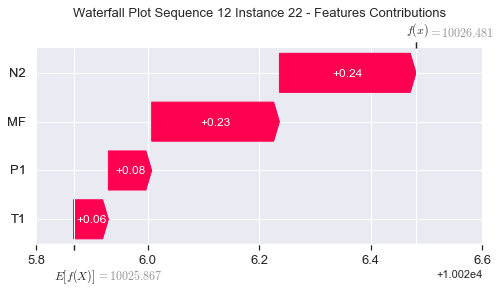

None

Contribution: [0.16873021 0.06019429 0.53366684 0.525105  ]


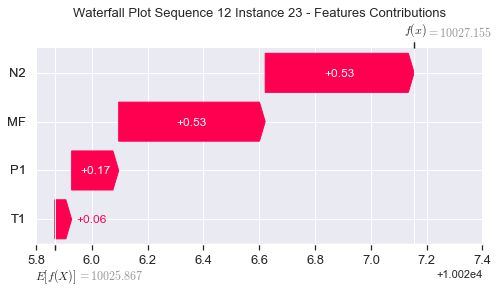

None

Contribution: [ 0.68688681 -0.98369149  1.98716826  2.363722  ]


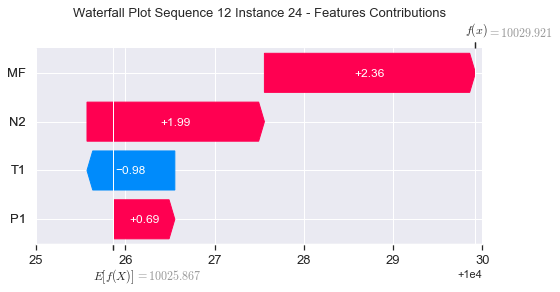

None

Contribution: [20.69040703  3.53148497 68.68410092 71.85237552]


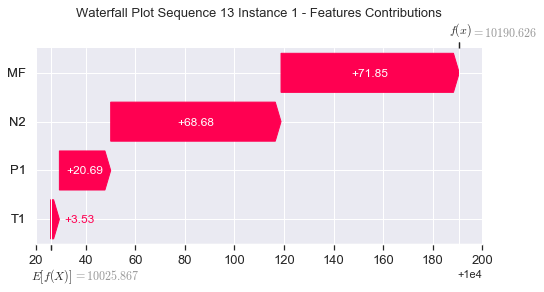

None

Contribution: [-0.08734807 -0.21005019 -0.23613103 -0.15827791]


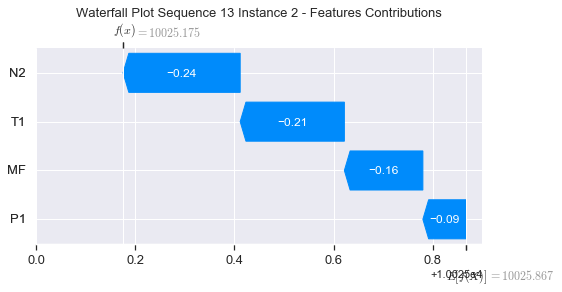

None

Contribution: [0.34658686 0.23228365 1.13361285 1.05740239]


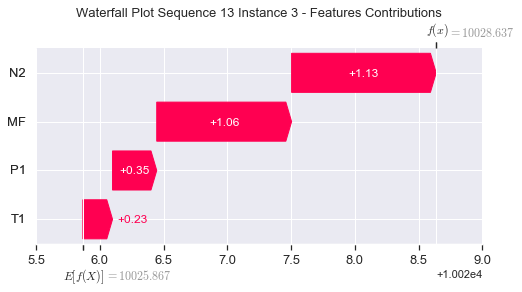

None

Contribution: [0.09971272 0.0711016  0.325205   0.30847969]


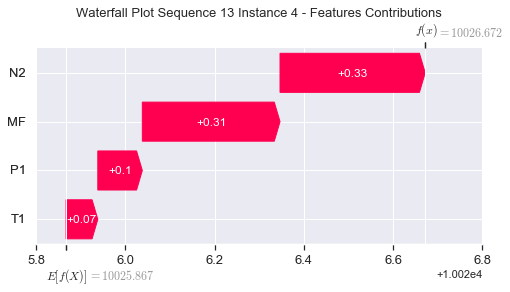

None

Contribution: [0.08306182 0.07189789 0.26574268 0.24505592]


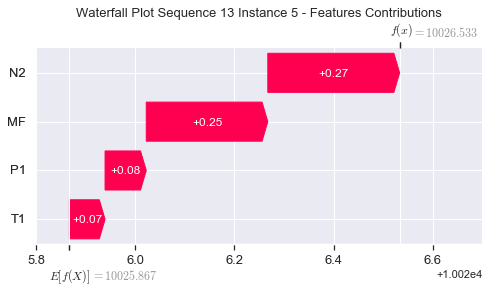

None

Contribution: [0.07249796 0.06338652 0.23176238 0.21231508]


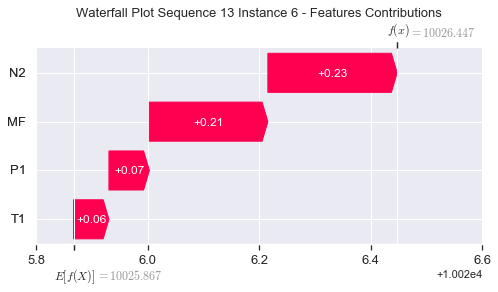

None

Contribution: [0.06771695 0.05919753 0.21651368 0.19845508]


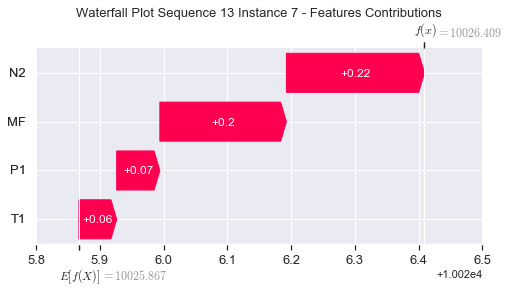

None

Contribution: [0.06459469 0.05689353 0.20635185 0.18975676]


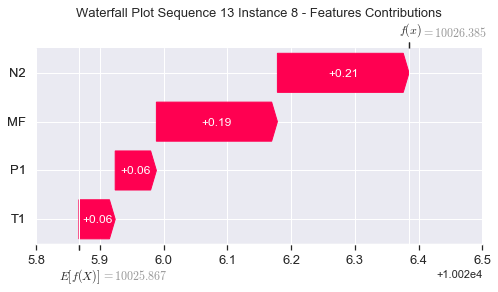

None

Contribution: [0.0629669  0.05521806 0.19877977 0.18509481]


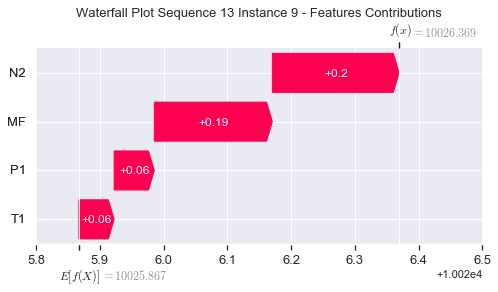

None

Contribution: [0.05985239 0.0471576  0.19102332 0.17657834]


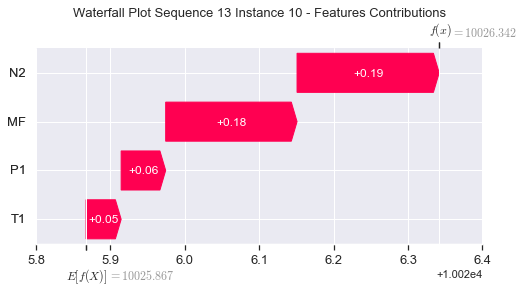

None

Contribution: [0.05888385 0.05291537 0.18614188 0.17320463]


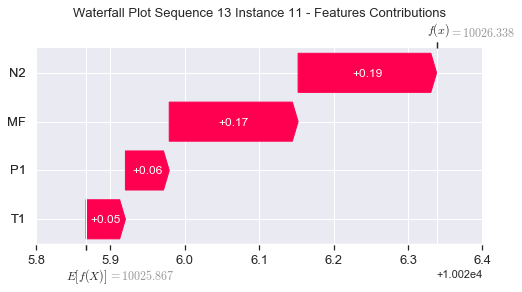

None

Contribution: [0.0562052  0.05114339 0.17981652 0.16568983]


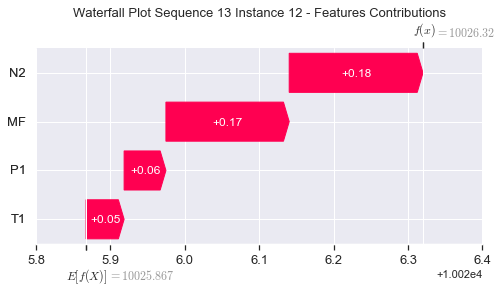

None

Contribution: [0.05485382 0.04983832 0.17560291 0.16201159]


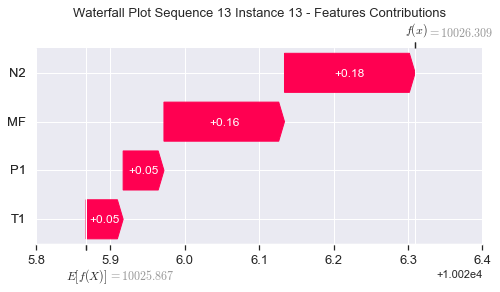

None

Contribution: [0.05403604 0.05044781 0.17174842 0.16025539]


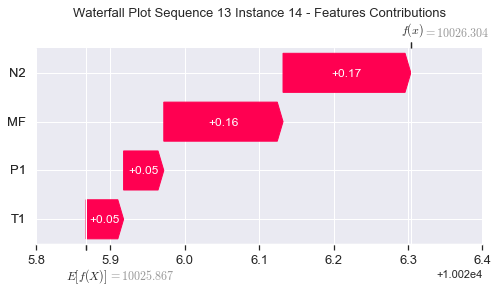

None

Contribution: [0.0522587  0.04803908 0.16777222 0.15485112]


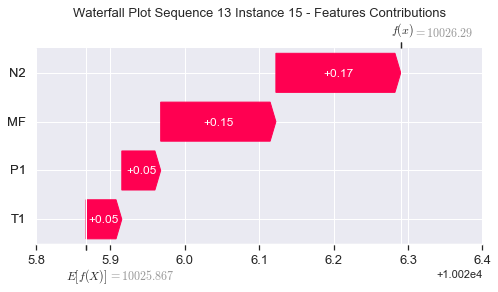

None

Contribution: [0.05105026 0.04613459 0.16438956 0.15193206]


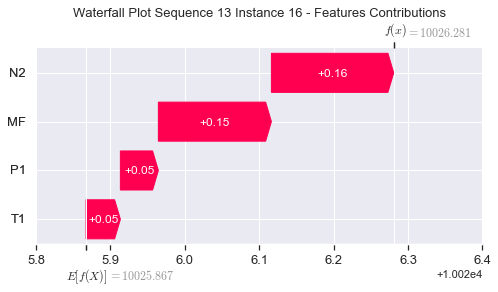

None

Contribution: [0.05032818 0.04639389 0.16168585 0.14959652]


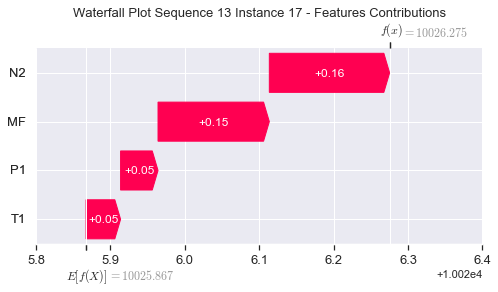

None

Contribution: [0.04947978 0.04584734 0.15921971 0.14742476]


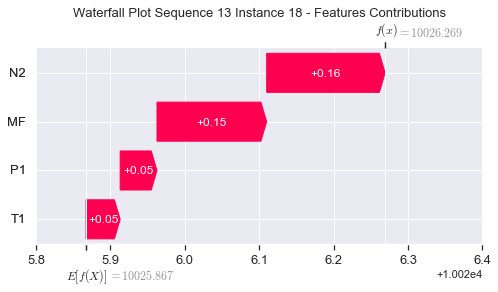

None

Contribution: [0.04812755 0.0439995  0.15806242 0.1463785 ]


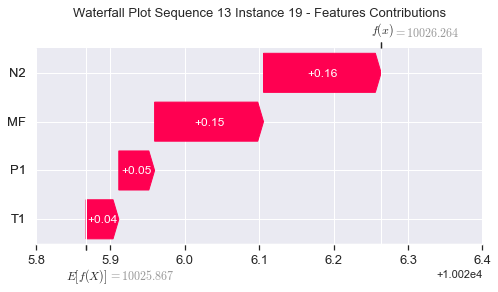

None

Contribution: [0.04972662 0.04629598 0.1607201  0.14942069]


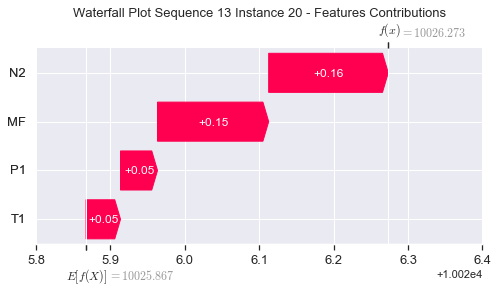

None

Contribution: [0.05446586 0.05152544 0.17659653 0.16449392]


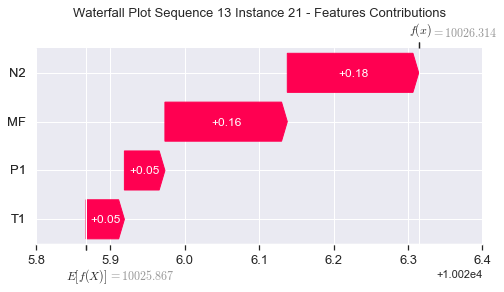

None

Contribution: [0.07477673 0.07040164 0.24489409 0.22993959]


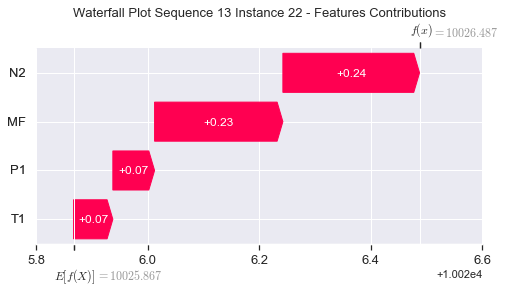

None

Contribution: [0.15516046 0.10218282 0.53372641 0.52458054]


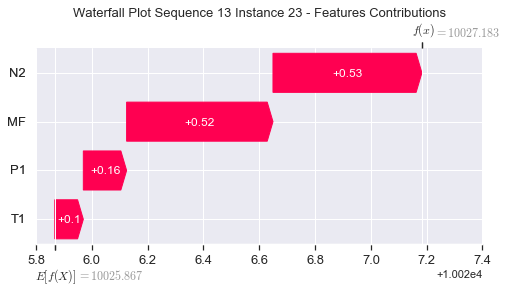

None

Contribution: [ 0.51871711 -0.55104688  1.97415222  2.23569051]


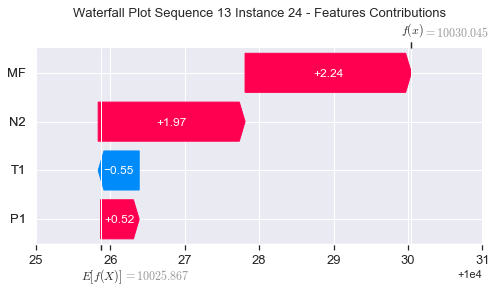

None

Contribution: [19.18617908 10.84221379 68.42532396 64.75863289]


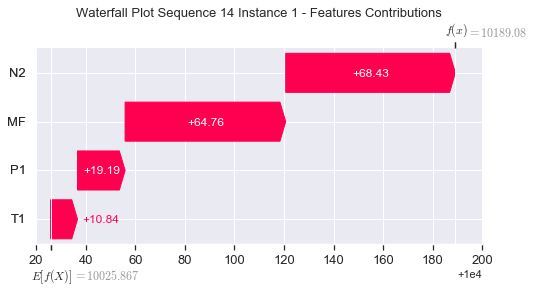

None

Contribution: [-0.12537848 -0.05168105 -0.24557031 -0.10343034]


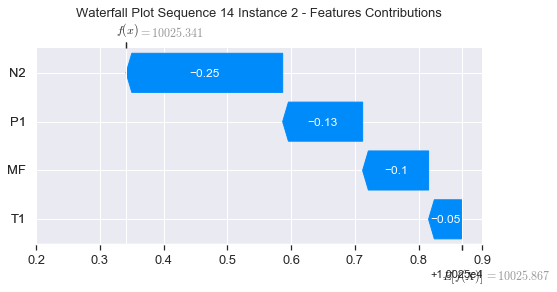

None

Contribution: [0.34051245 0.3453235  1.13847636 1.09496986]


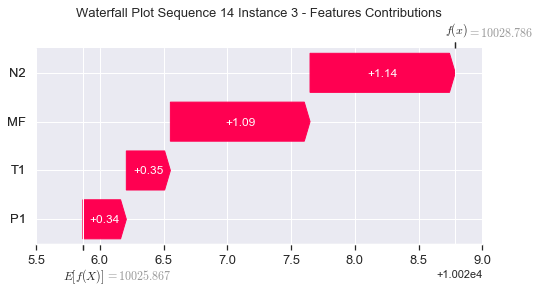

None

Contribution: [0.10348522 0.08873915 0.32642343 0.31877647]


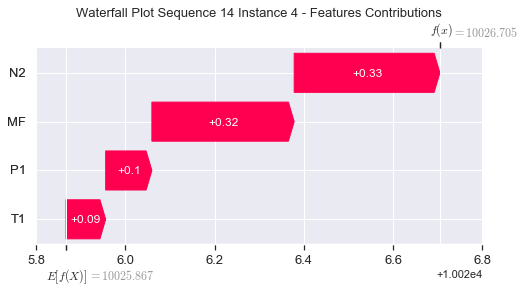

None

Contribution: [0.083822   0.08409322 0.26596886 0.24602892]


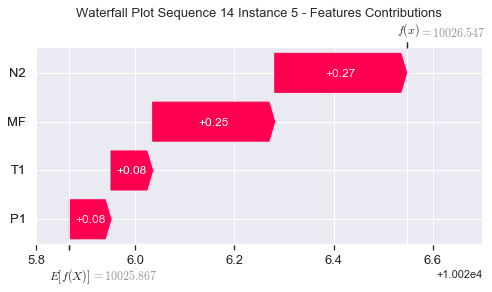

None

Contribution: [0.07274776 0.07155928 0.23194342 0.21370987]


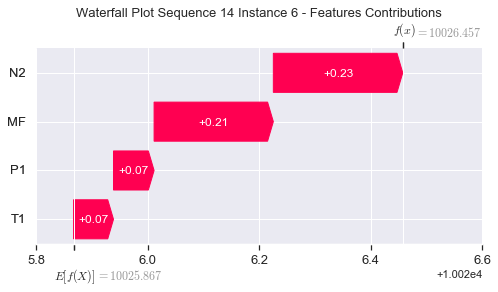

None

Contribution: [0.06803479 0.06674144 0.21673862 0.19997728]


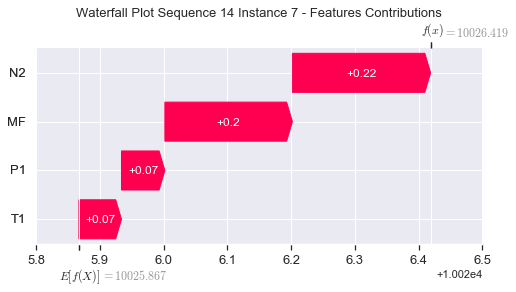

None

Contribution: [0.06478782 0.06379147 0.2064286  0.19037029]


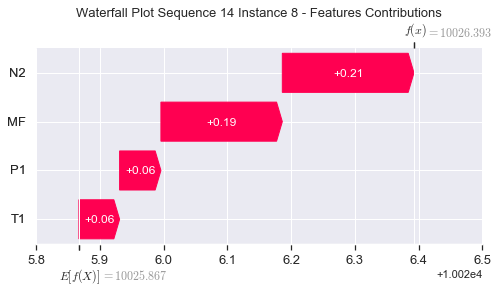

None

Contribution: [0.06297817 0.06402667 0.19865985 0.18302671]


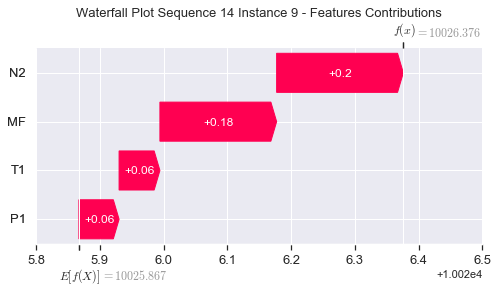

None

Contribution: [0.06071582 0.06130245 0.19182817 0.17820106]


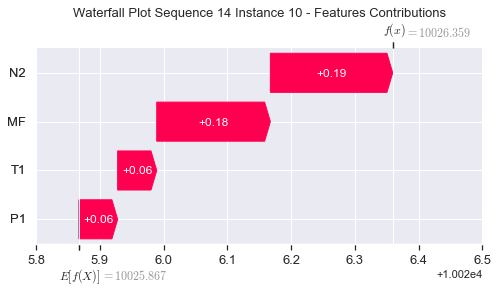

None

Contribution: [0.05837788 0.05907533 0.18566331 0.1702957 ]


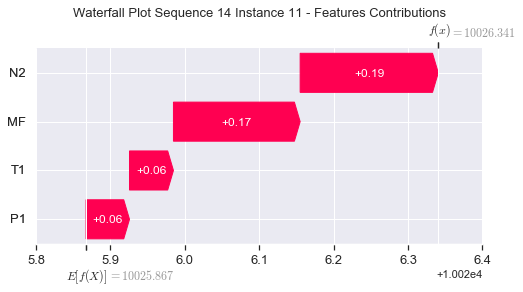

None

Contribution: [0.05597239 0.05364298 0.1793933  0.16549914]


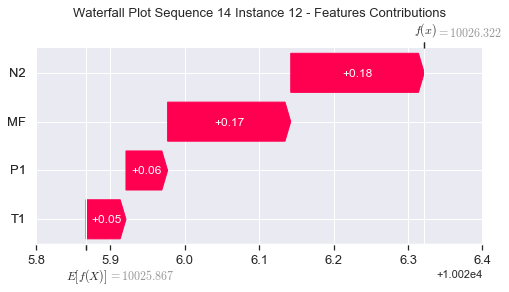

None

Contribution: [0.05475403 0.05252109 0.17526197 0.16189564]


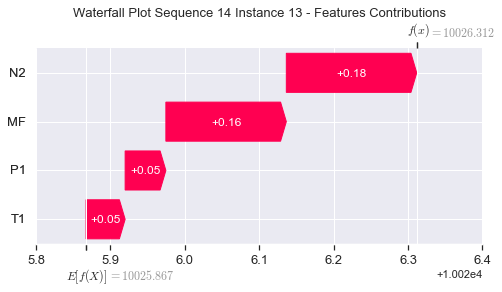

None

Contribution: [0.05356056 0.05116248 0.17070694 0.15726265]


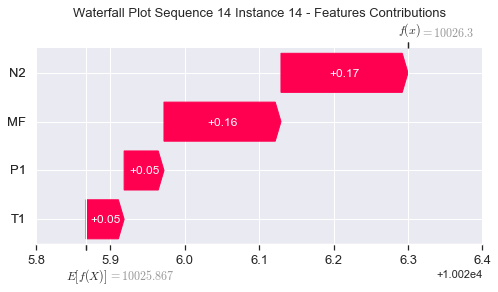

None

Contribution: [0.05224755 0.04964952 0.16746431 0.15467726]


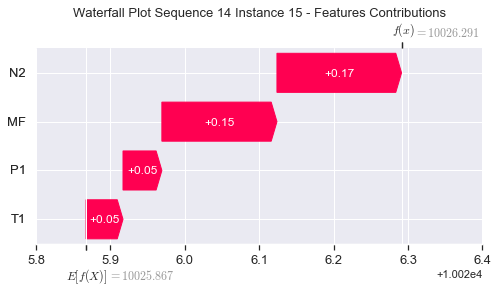

None

Contribution: [0.05095501 0.04532105 0.16416416 0.15276252]


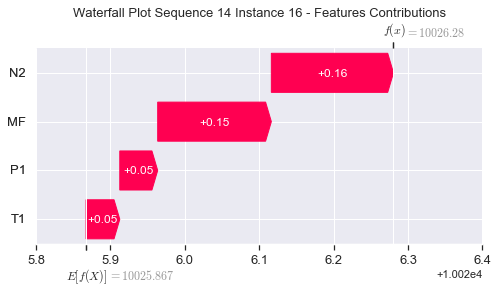

None

Contribution: [0.05029631 0.04719821 0.1613883  0.14934967]


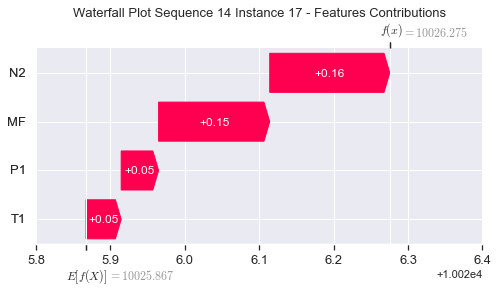

None

Contribution: [0.04942415 0.0460295  0.15890584 0.14703873]


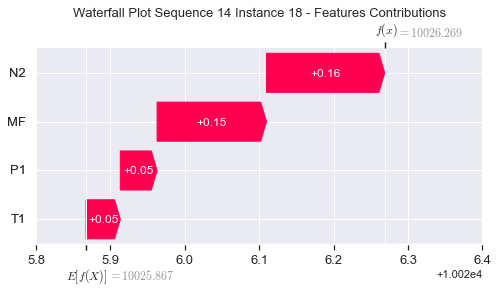

None

Contribution: [0.04939513 0.0436699  0.1582475  0.14697919]


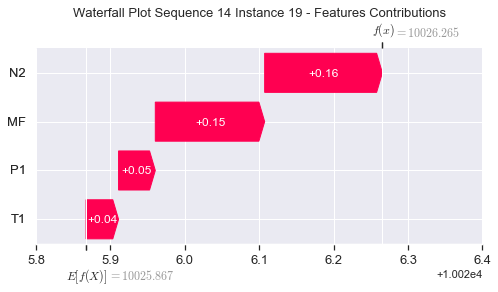

None

Contribution: [0.04988534 0.04647802 0.16052939 0.14887553]


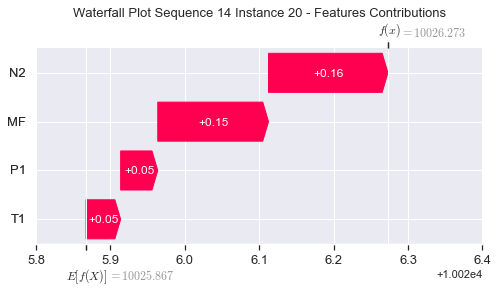

None

Contribution: [0.05457488 0.05111472 0.17632775 0.16351328]


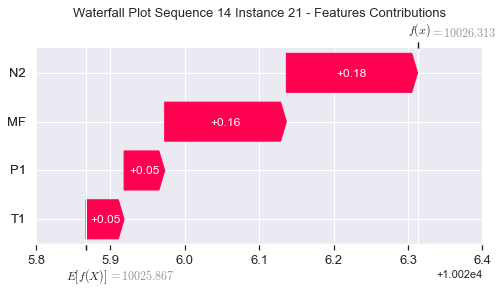

None

Contribution: [0.07503347 0.06882474 0.24458774 0.22792212]


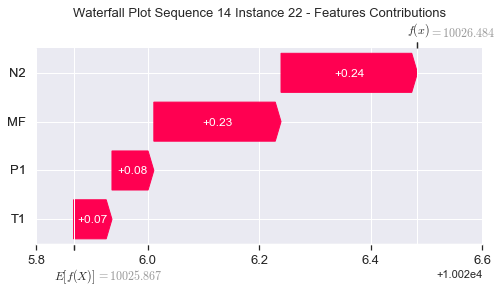

None

Contribution: [0.15575988 0.08839225 0.53290039 0.51580638]


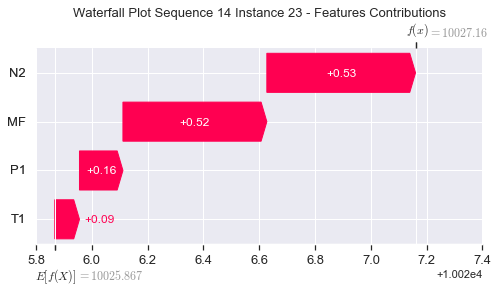

None

Contribution: [ 0.5258433  -0.708066    1.95182666  2.11795384]


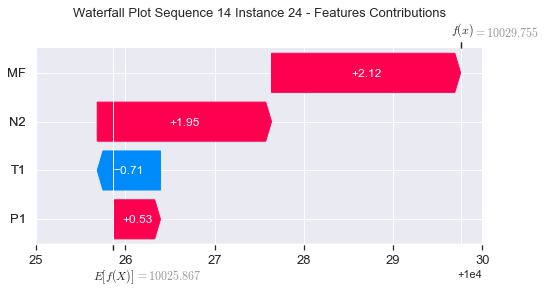

None

Contribution: [18.89562955  7.18420577 67.75313454 63.00061863]


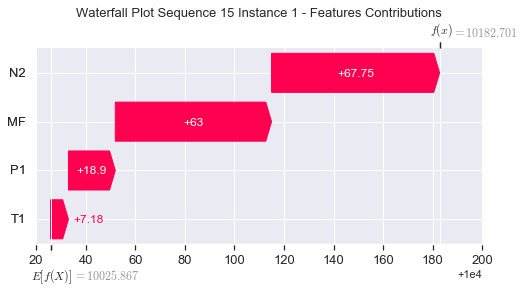

None

Contribution: [-0.12580805 -0.13521469 -0.25983936 -0.15411164]


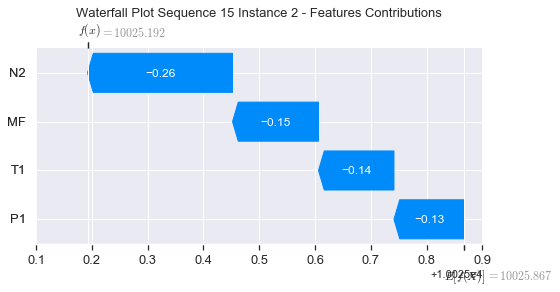

None

Contribution: [0.35018216 0.27509656 1.14214486 1.07519372]


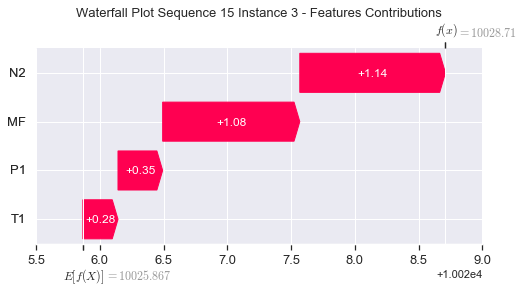

None

Contribution: [0.09870535 0.06844944 0.32659423 0.30663   ]


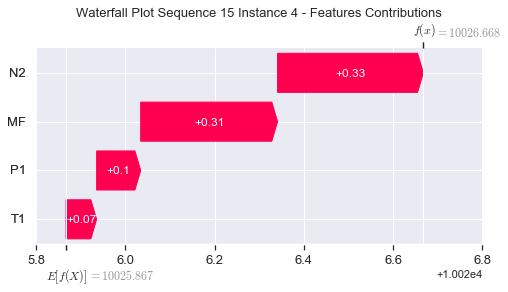

None

Contribution: [0.08357595 0.07761274 0.26665987 0.24646665]


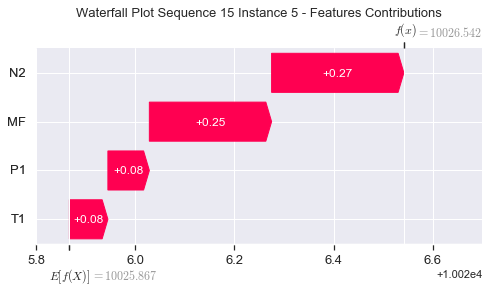

None

Contribution: [0.07322738 0.06638816 0.2328193  0.2155901 ]


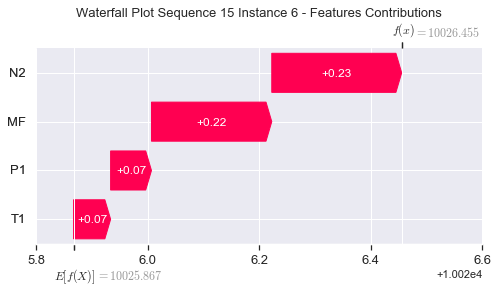

None

Contribution: [0.06840558 0.06268924 0.2175662  0.20159127]


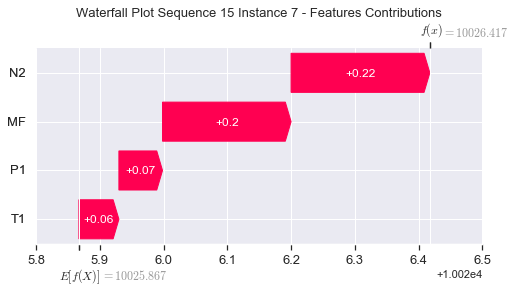

None

Contribution: [0.06495857 0.05973674 0.20707263 0.19156526]


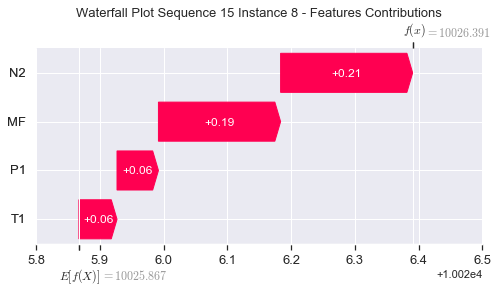

None

Contribution: [0.062145   0.0592275  0.19898891 0.18396982]


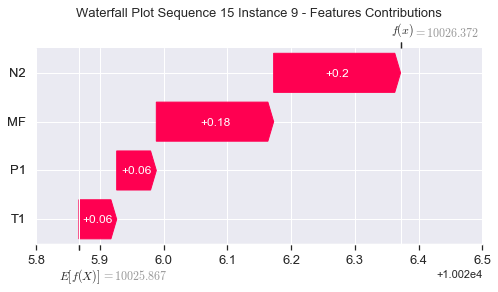

None

Contribution: [0.06070679 0.0567428  0.19229422 0.1791675 ]


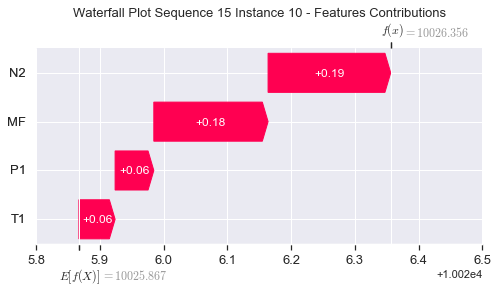

None

Contribution: [0.0575926  0.05407017 0.18566374 0.17027398]


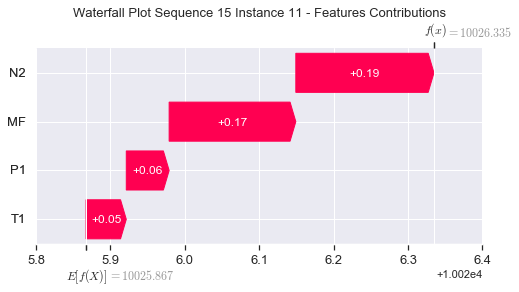

None

Contribution: [0.05598887 0.05265412 0.17981057 0.16539276]


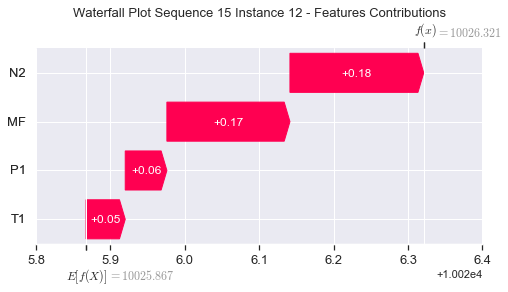

None

Contribution: [0.05476175 0.05167652 0.17570668 0.16191974]


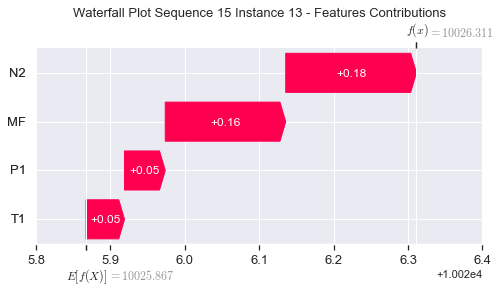

None

Contribution: [0.05437721 0.04827546 0.17190421 0.16062993]


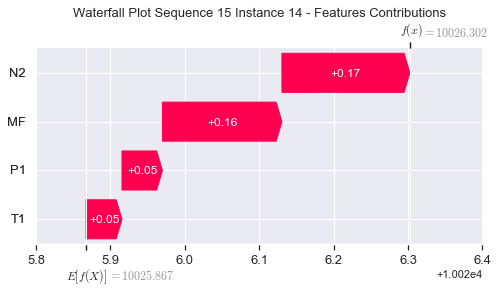

None

Contribution: [0.05226767 0.04899918 0.16795386 0.15512709]


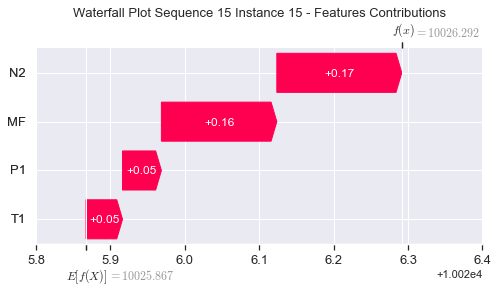

None

Contribution: [0.05156161 0.04857895 0.16489579 0.1538196 ]


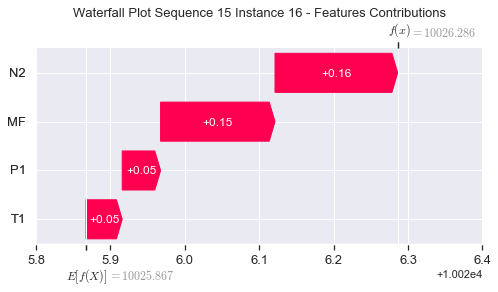

None

Contribution: [0.05042643 0.04729476 0.16192716 0.14991716]


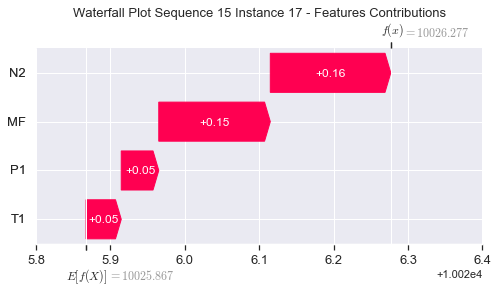

None

Contribution: [0.04961753 0.04623201 0.15944202 0.14765992]


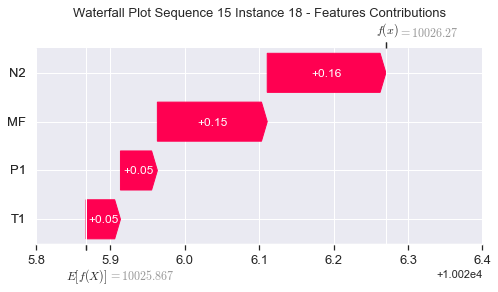

None

Contribution: [0.04957976 0.04646609 0.15841481 0.14637129]


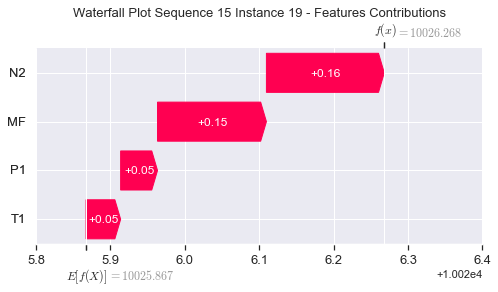

None

Contribution: [0.04992765 0.04701173 0.16101673 0.14927691]


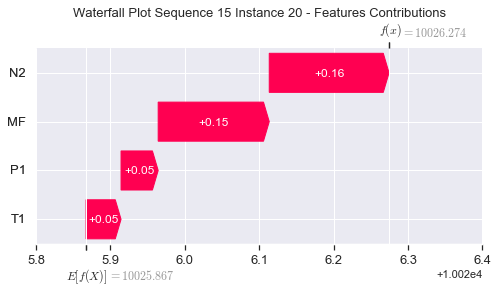

None

Contribution: [0.05450732 0.05199053 0.17681103 0.16362534]


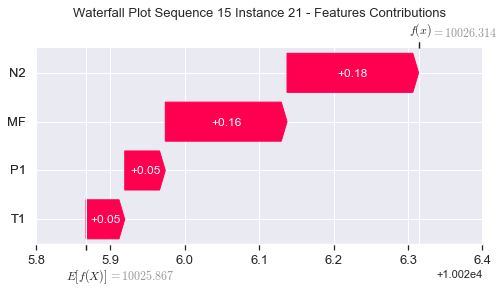

None

Contribution: [0.07461746 0.0704282  0.24511388 0.22732838]


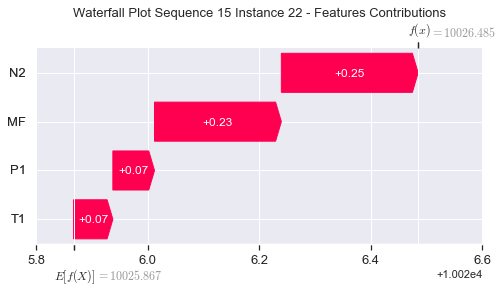

None

Contribution: [0.15467941 0.09679615 0.53395049 0.51310406]


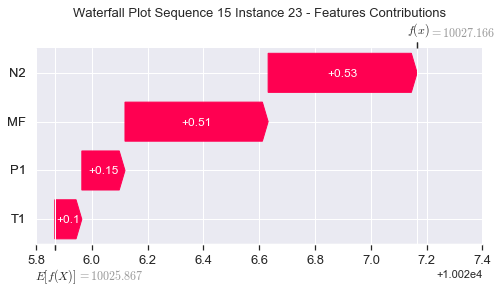

None

Contribution: [ 0.53725352 -0.65080573  1.97714077  2.22907346]


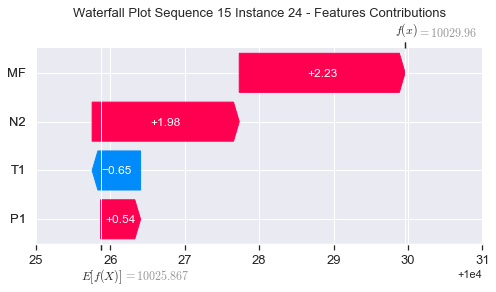

None

Contribution: [20.06216561  8.65694804 68.28087473 70.49842272]


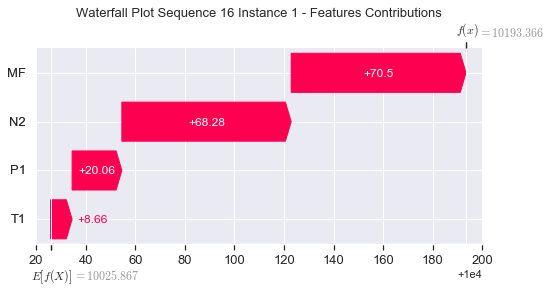

None

Contribution: [-0.13284772 -0.05225963 -0.23586715 -0.18223468]


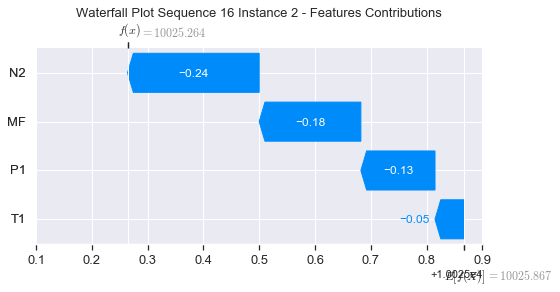

None

Contribution: [0.33595689 0.30749853 1.13624708 1.08327109]


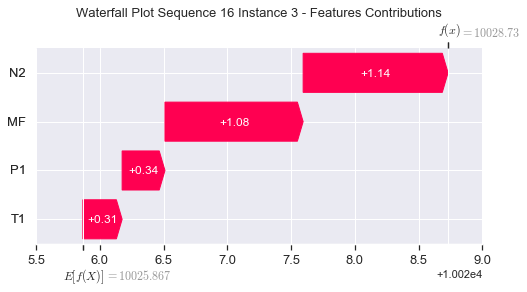

None

Contribution: [0.10157268 0.081425   0.3250611  0.30343193]


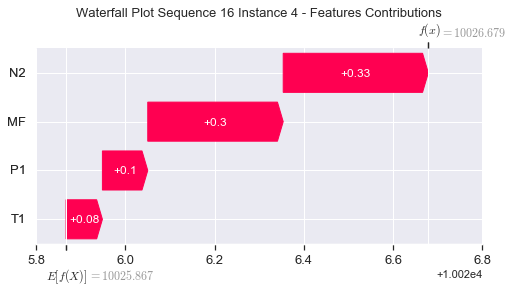

None

Contribution: [0.08406653 0.07599077 0.26625753 0.24746092]


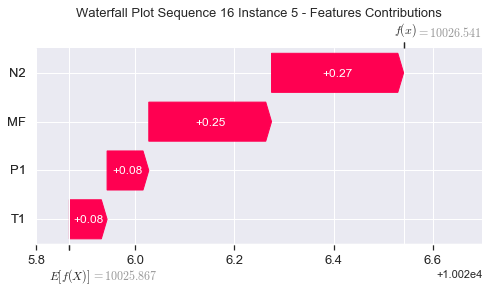

None

Contribution: [0.07337044 0.06534444 0.23245581 0.21572325]


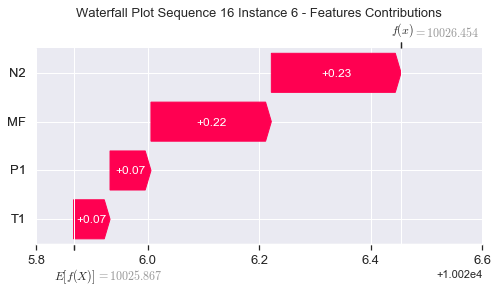

None

Contribution: [0.06839838 0.06160466 0.21718634 0.2014813 ]


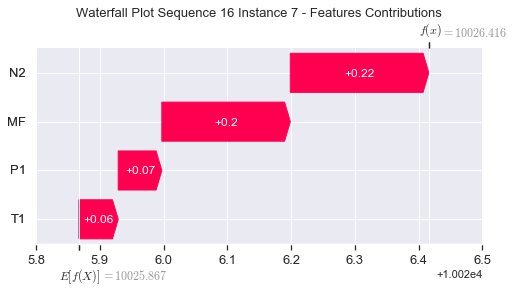

None

Contribution: [0.06505539 0.0580206  0.20672196 0.19176395]


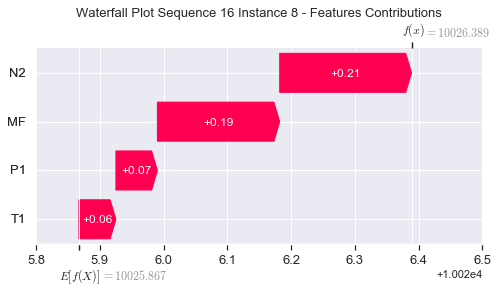

None

Contribution: [0.06239634 0.0545565  0.19862916 0.18464351]


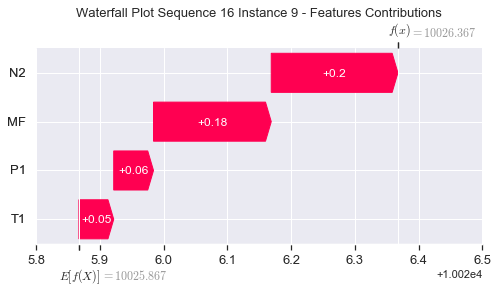

None

Contribution: [0.06022346 0.0554002  0.19184986 0.17837523]


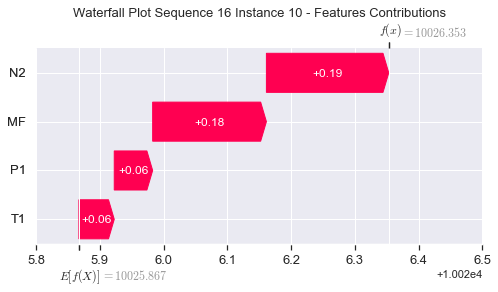

None

Contribution: [0.05829937 0.04873073 0.1856785  0.17264154]


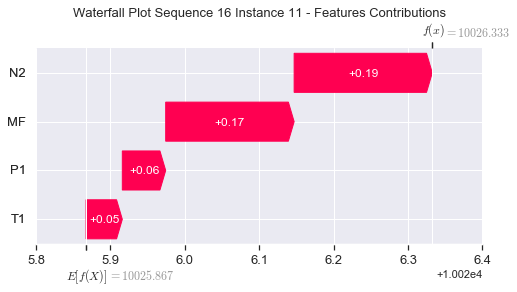

None

Contribution: [0.05597016 0.04996729 0.17978239 0.16674896]


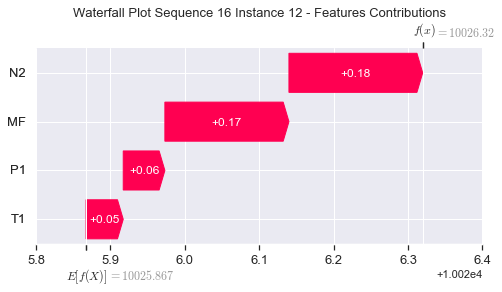

None

Contribution: [0.05464408 0.04923823 0.1755604  0.16275532]


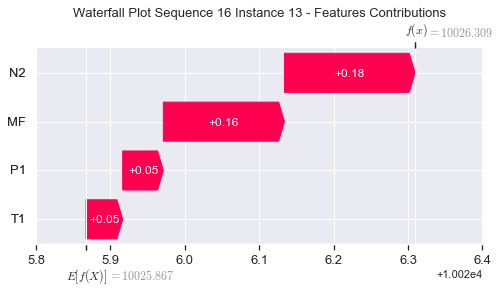

None

Contribution: [0.05302636 0.04754462 0.17094495 0.15786209]


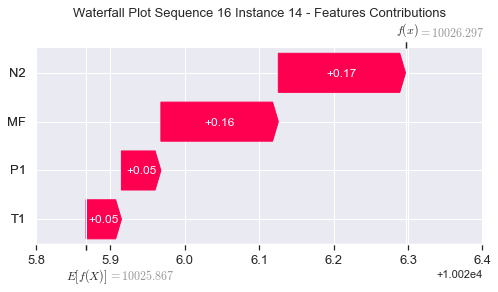

None

Contribution: [0.05219365 0.04656748 0.16764221 0.15507136]


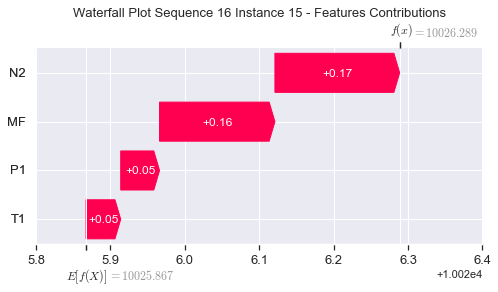

None

Contribution: [0.05035313 0.04334751 0.16357121 0.14927637]


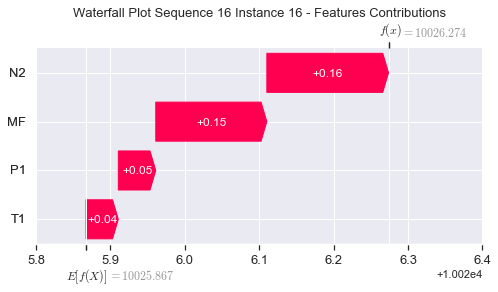

None

Contribution: [0.05015292 0.04505018 0.16148867 0.14931509]


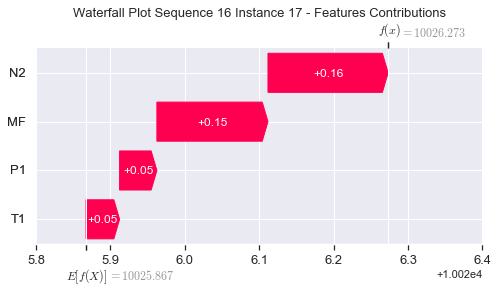

None

Contribution: [0.04933441 0.04403734 0.15894768 0.14688977]


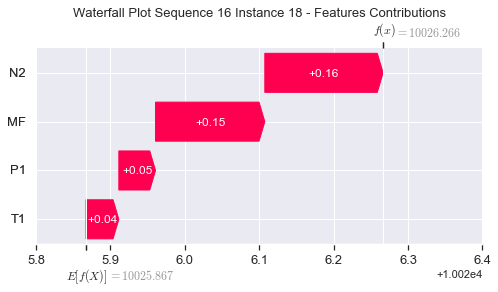

None

Contribution: [0.04942566 0.04275722 0.15796647 0.14801734]


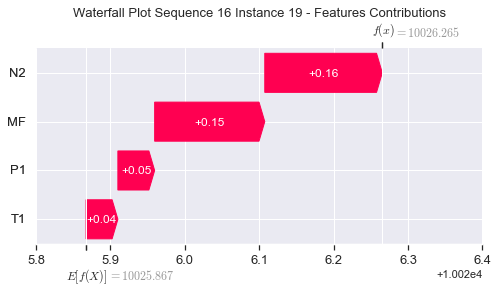

None

Contribution: [0.04965191 0.04473761 0.16032358 0.14791478]


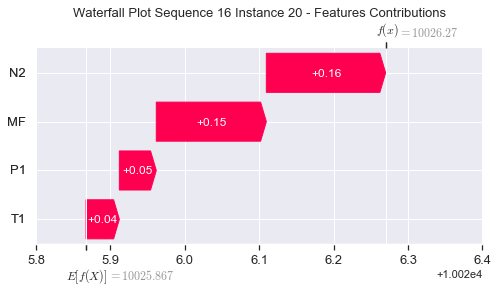

None

Contribution: [0.05425284 0.04912253 0.17606234 0.16234217]


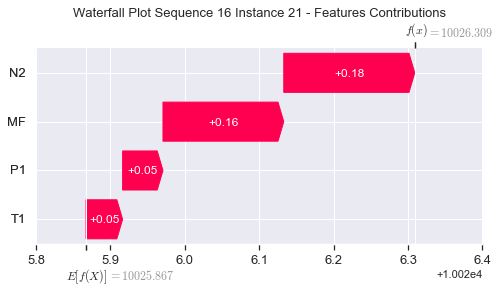

None

Contribution: [0.07452146 0.06511881 0.24403971 0.22579571]


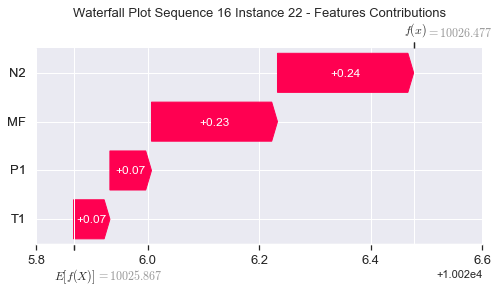

None

Contribution: [0.15412879 0.07278606 0.53058069 0.50686464]


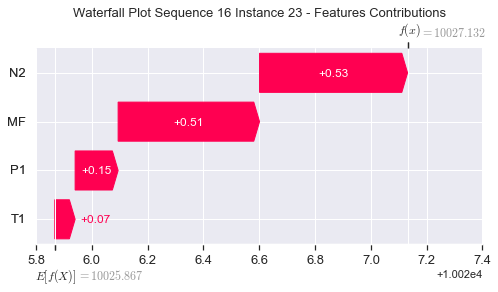

None

Contribution: [ 0.53733993 -0.86912579  1.94345778  2.11439606]


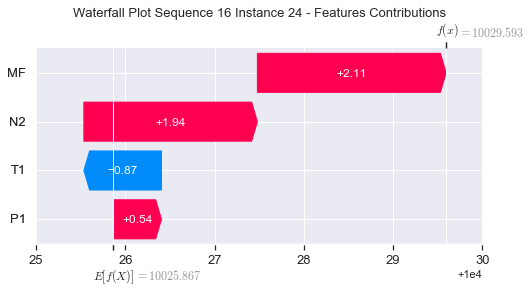

None

Contribution: [19.83045471  7.56126574 68.34101586 68.79353433]


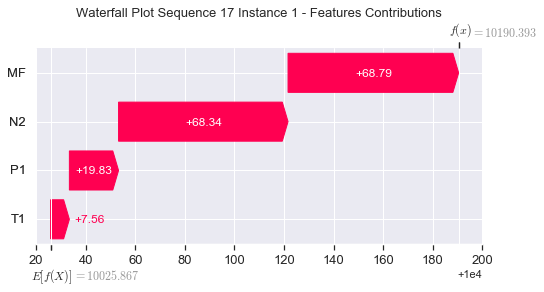

None

Contribution: [-0.13221569 -0.15421291 -0.23895192 -0.17117033]


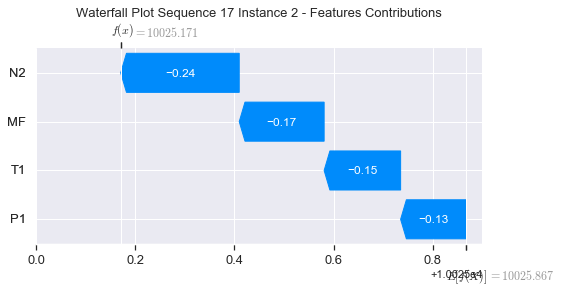

None

Contribution: [0.35927933 0.24303393 1.14271522 1.07741609]


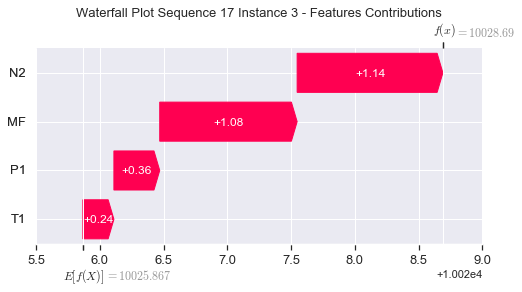

None

Contribution: [0.10534475 0.06660859 0.32872994 0.31836345]


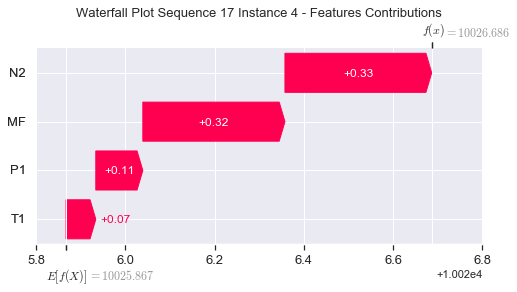

None

Contribution: [0.08411922 0.07038654 0.26635242 0.24616009]


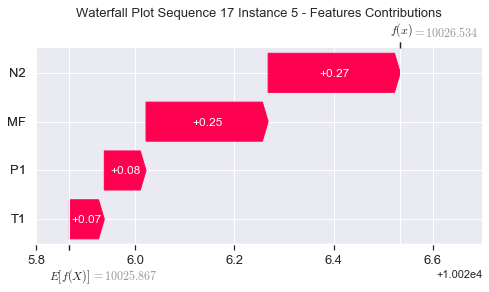

None

Contribution: [0.07285337 0.06129806 0.23214339 0.21342781]


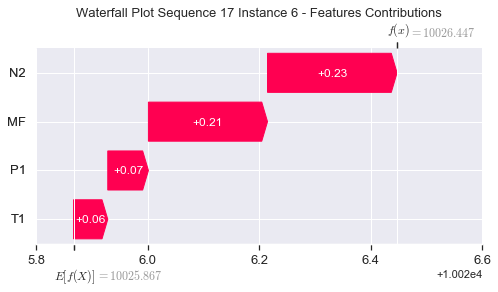

None

Contribution: [0.06806396 0.05725836 0.21687534 0.19934785]


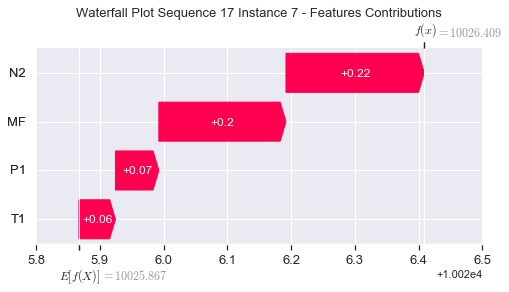

None

Contribution: [0.06475955 0.05467532 0.20651668 0.18978228]


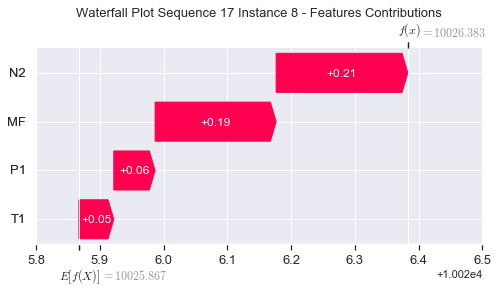

None

Contribution: [0.0624223  0.05245574 0.19825224 0.18270184]


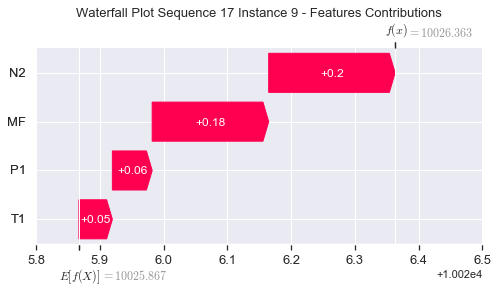

None

Contribution: [0.05990431 0.05254684 0.19228513 0.17712483]


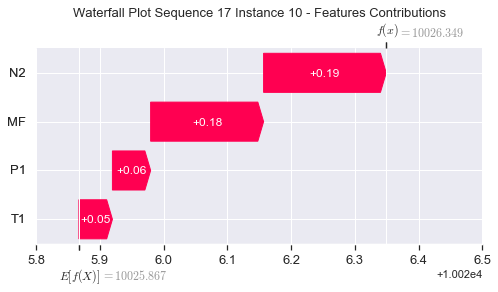

None

Contribution: [0.05796532 0.04929521 0.18537346 0.17014817]


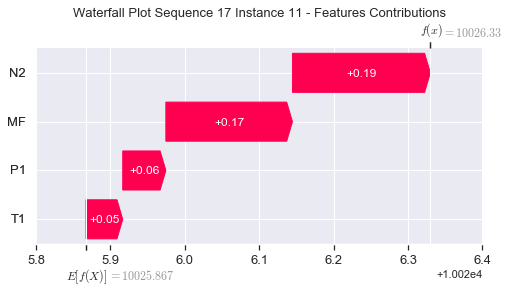

None

Contribution: [0.05604904 0.04726731 0.17965919 0.16467502]


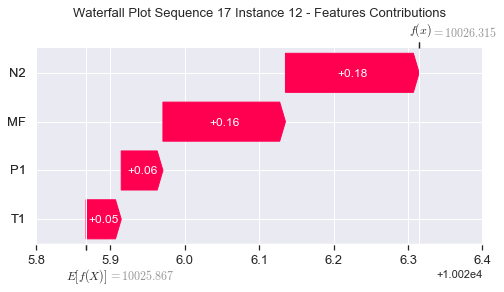

None

Contribution: [0.05477974 0.04624712 0.17550485 0.16092984]


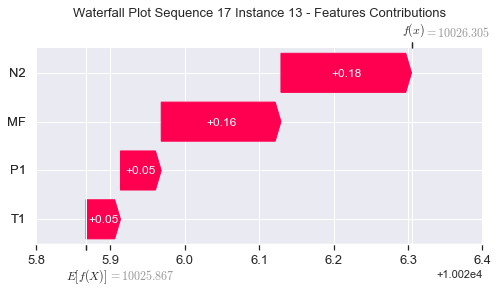

None

Contribution: [0.05241001 0.04343756 0.17083666 0.15610479]


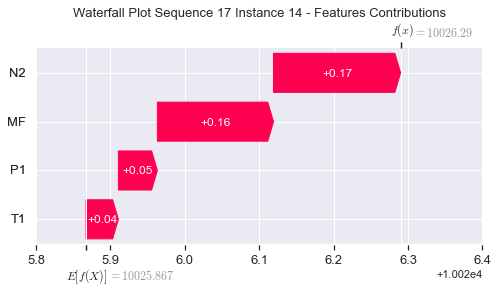

None

Contribution: [0.05229109 0.04424393 0.16773632 0.15359172]


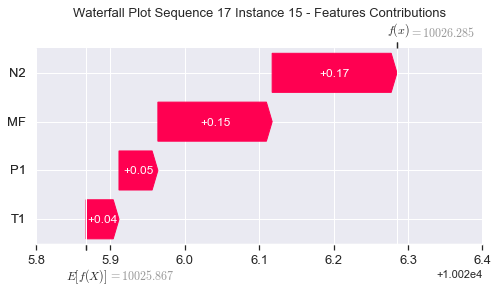

None

Contribution: [0.05227077 0.04439107 0.16495598 0.15183922]


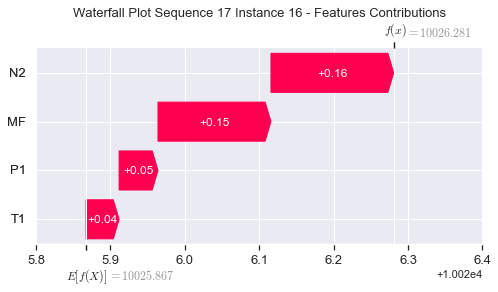

None

Contribution: [0.05024104 0.04248593 0.16162955 0.1478583 ]


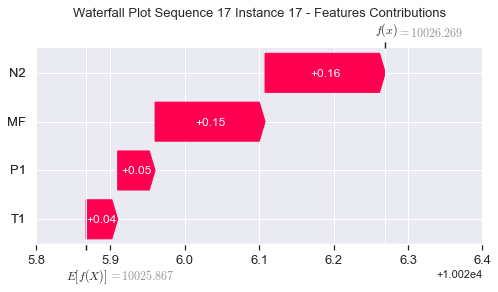

None

Contribution: [0.04935635 0.0418246  0.15915858 0.14543477]


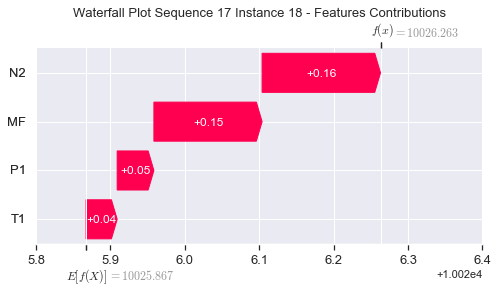

None

Contribution: [0.04951521 0.04350547 0.15847323 0.14478069]


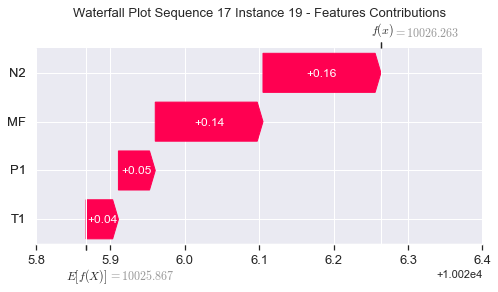

None

Contribution: [0.04978518 0.04245898 0.16075695 0.14688997]


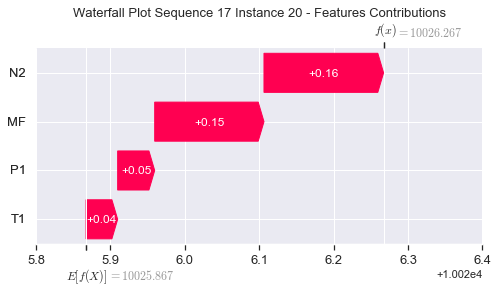

None

Contribution: [0.05449502 0.04674941 0.17662355 0.1613462 ]


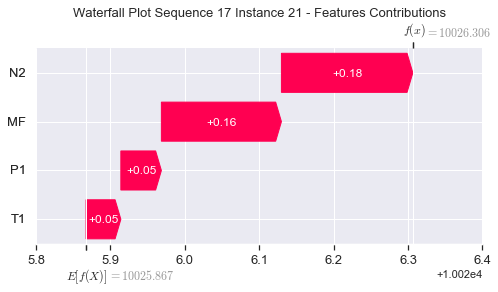

None

Contribution: [0.0749826  0.06214307 0.24506113 0.22435052]


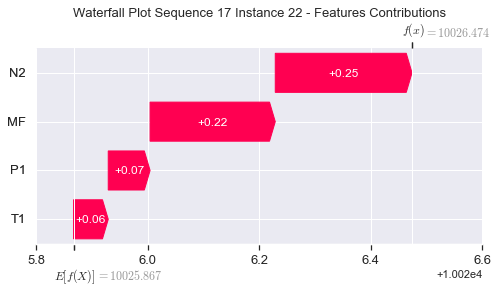

None

Contribution: [0.15495129 0.06185873 0.5339921  0.49661252]


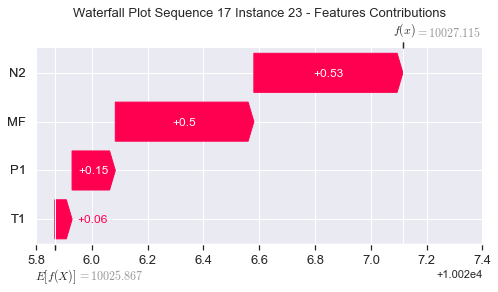

None

Contribution: [ 0.5649823  -1.05358746  1.9789136   2.04413029]


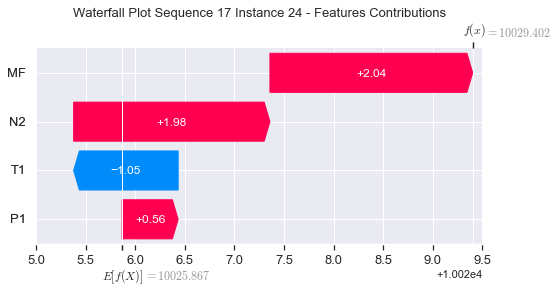

None

Contribution: [21.76040408  1.98774019 68.76852109 69.87421277]


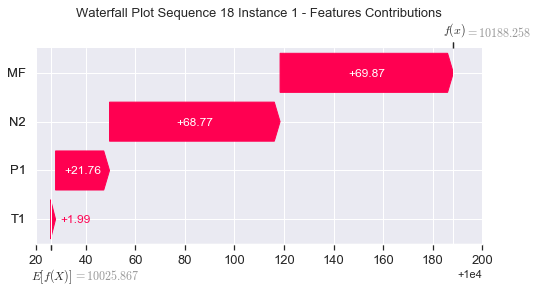

None

Contribution: [-0.11878639 -0.19845209 -0.23126591 -0.19673828]


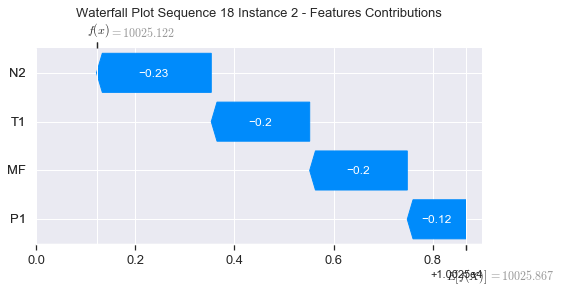

None

Contribution: [0.36226378 0.2340693  1.14640252 1.08158052]


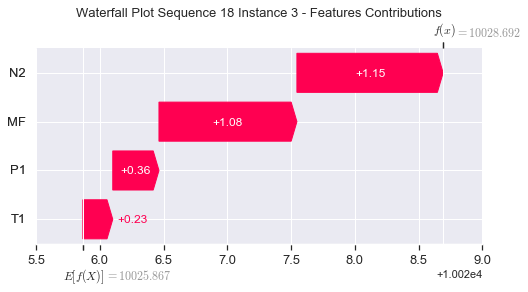

None

Contribution: [0.10052521 0.05797106 0.32653283 0.30694896]


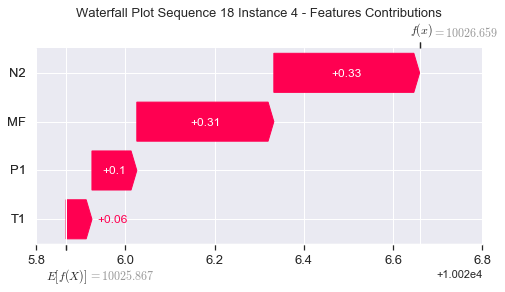

None

Contribution: [0.08418873 0.07151618 0.26648729 0.24732458]


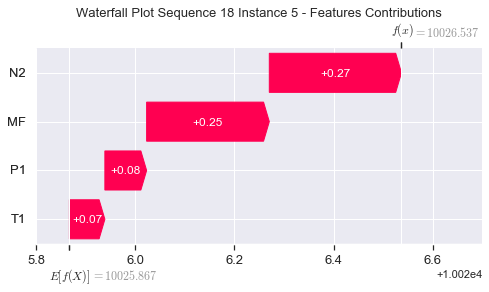

None

Contribution: [0.07403796 0.06356756 0.23303702 0.21715327]


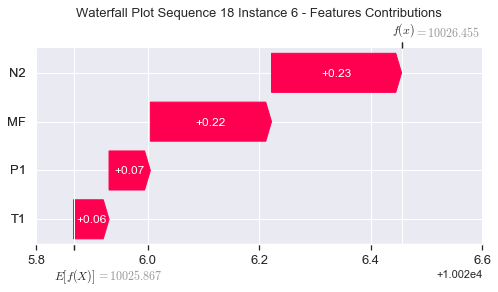

None

Contribution: [0.06945695 0.05980857 0.21782092 0.20309219]


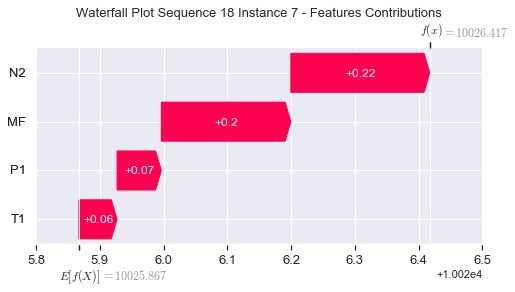

None

Contribution: [0.06582672 0.05699313 0.20726092 0.19283676]


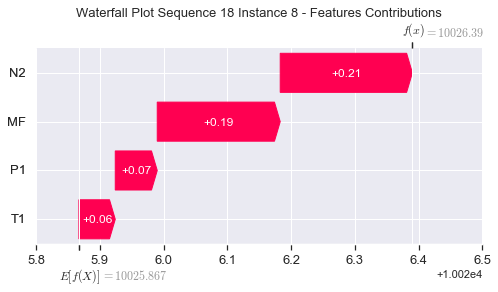

None

Contribution: [0.0631479  0.05651199 0.19903754 0.18457563]


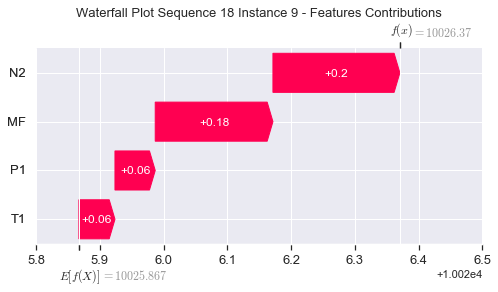

None

Contribution: [0.06177978 0.05357724 0.1919709  0.17813881]


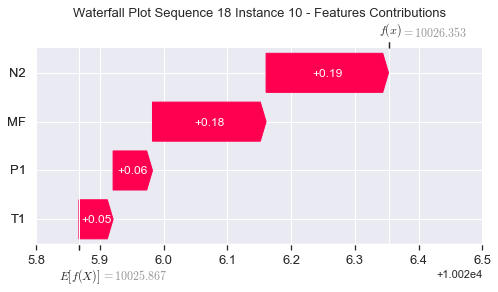

None

Contribution: [0.058825   0.05258887 0.18620609 0.17317904]


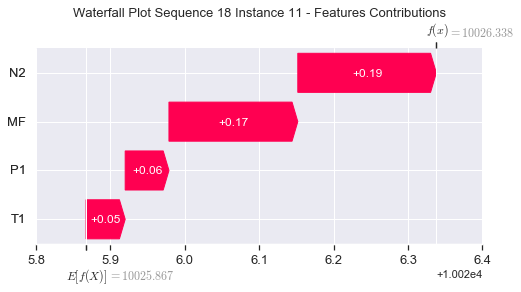

None

Contribution: [0.05819816 0.05071681 0.18071265 0.16939228]


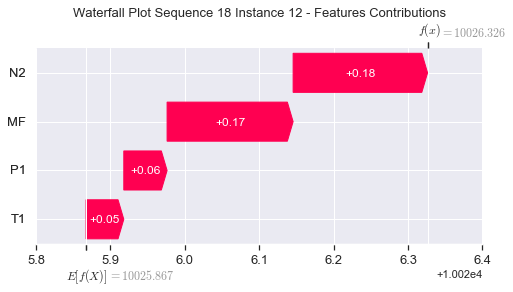

None

Contribution: [0.05669396 0.04947878 0.17638698 0.16492711]


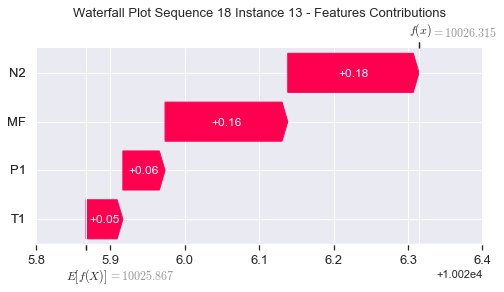

None

Contribution: [0.05396084 0.04979223 0.17147987 0.15832428]


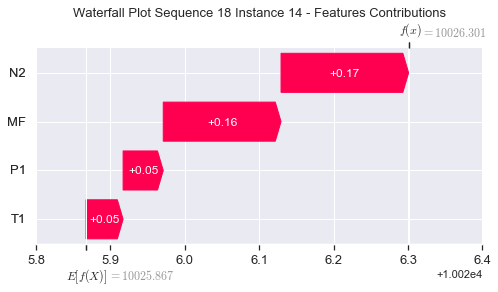

None

Contribution: [0.05368836 0.04702588 0.16833232 0.15673198]


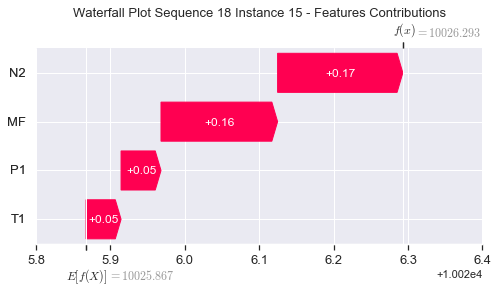

None

Contribution: [0.05144634 0.04720222 0.1642329  0.15098083]


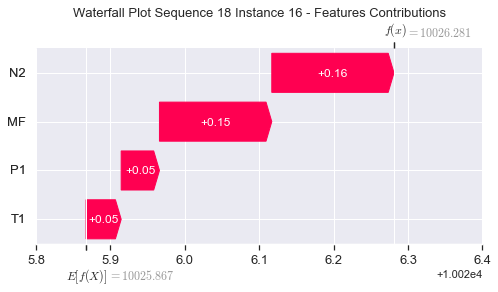

None

Contribution: [0.05169631 0.04528832 0.16217035 0.1506954 ]


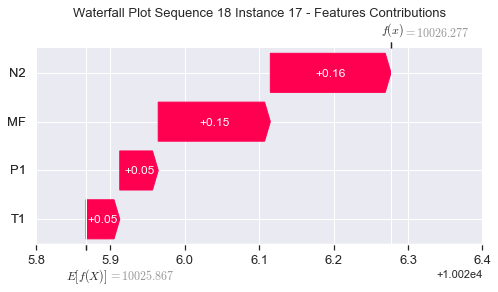

None

Contribution: [0.05067787 0.04435035 0.15959682 0.14801094]


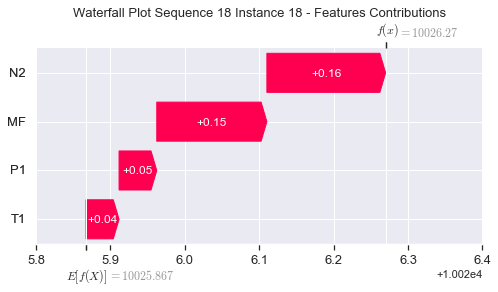

None

Contribution: [0.05024229 0.0436776  0.15855866 0.14729269]


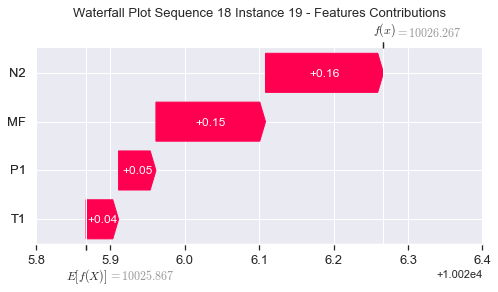

None

Contribution: [0.0505046  0.04420051 0.16081235 0.14798317]


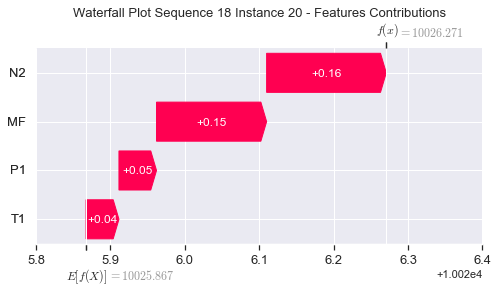

None

Contribution: [0.0552761  0.04874382 0.17664466 0.16243731]


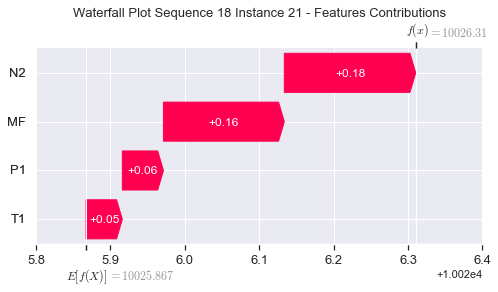

None

Contribution: [0.07586309 0.06476492 0.2449511  0.22556017]


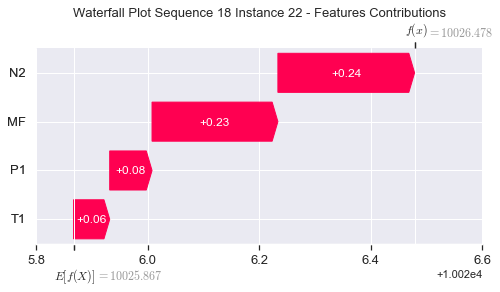

None

Contribution: [0.16077901 0.07528904 0.53450261 0.50663263]


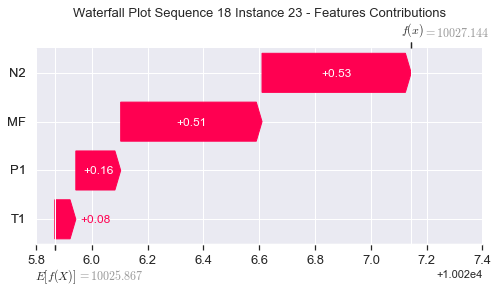

None

Contribution: [ 0.59217544 -0.93700075  1.97229723  2.03654078]


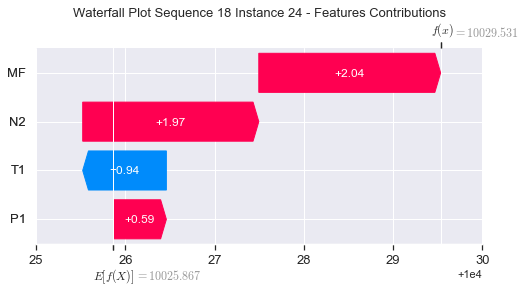

None

Contribution: [22.44202162  5.18651829 68.59757227 67.70834533]


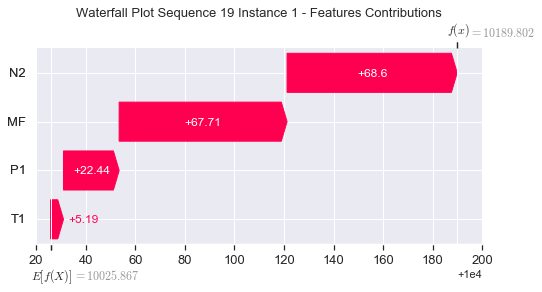

None

Contribution: [-0.10098085 -0.14663561 -0.2358712  -0.18403419]


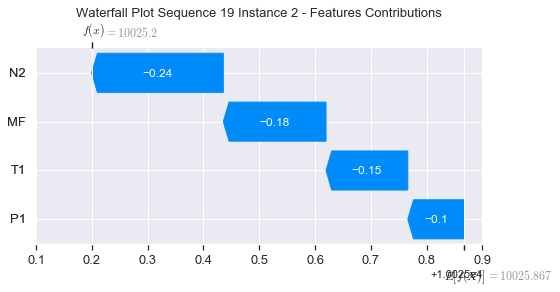

None

Contribution: [0.34298531 0.24810182 1.13836927 1.05598006]


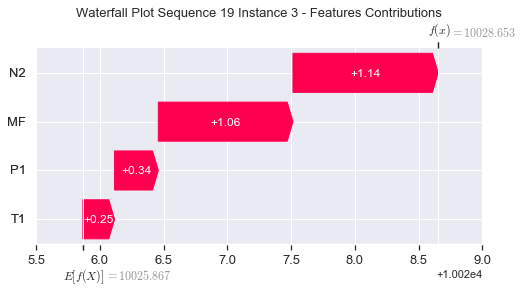

None

Contribution: [0.10360073 0.06412665 0.32779155 0.31006073]


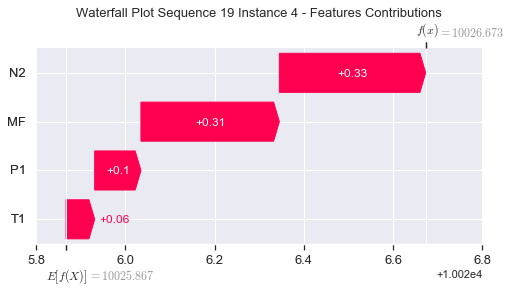

None

Contribution: [0.08490764 0.07235596 0.26699116 0.24806193]


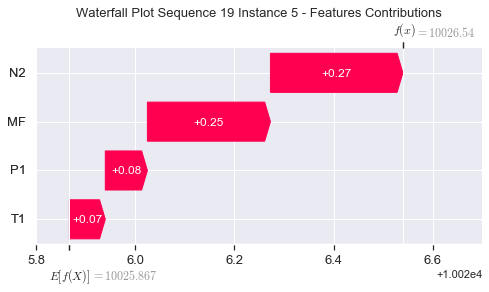

None

Contribution: [0.07355168 0.0627191  0.2323779  0.21409437]


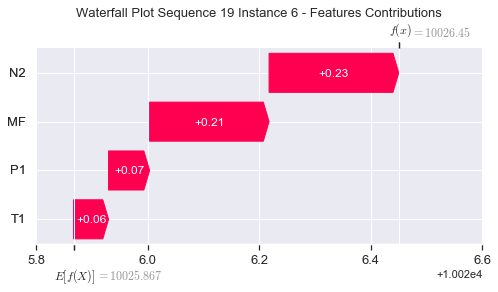

None

Contribution: [0.06896512 0.05921228 0.21720095 0.2002144 ]


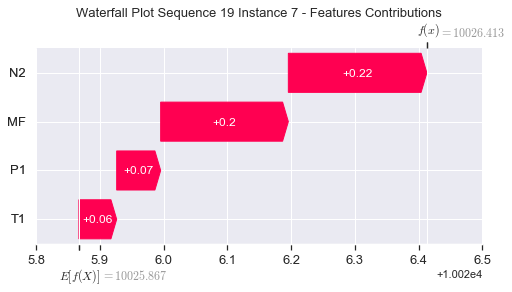

None

Contribution: [0.06552155 0.05619927 0.20679991 0.19074925]


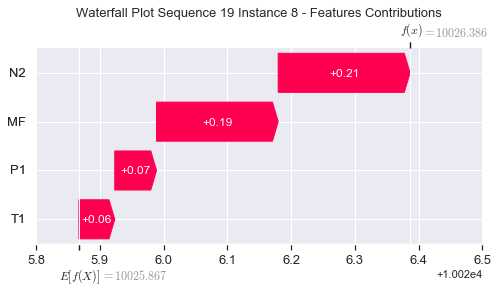

None

Contribution: [0.06321912 0.05531589 0.19923361 0.18445492]


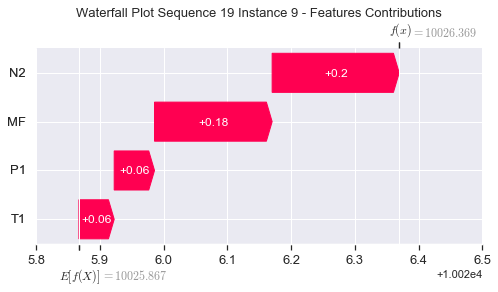

None

Contribution: [0.06124218 0.0534103  0.19200607 0.17721242]


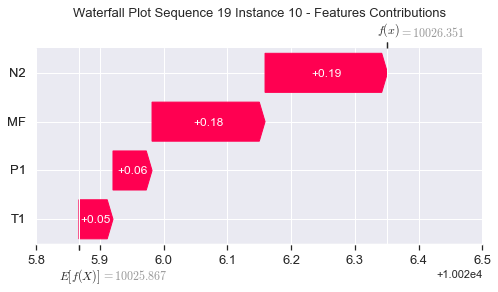

None

Contribution: [0.05819028 0.04971922 0.18572836 0.17096109]


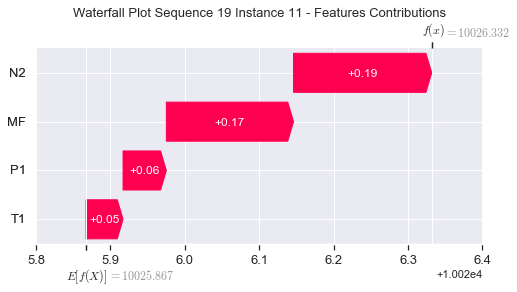

None

Contribution: [0.05679305 0.04846379 0.17959459 0.16514482]


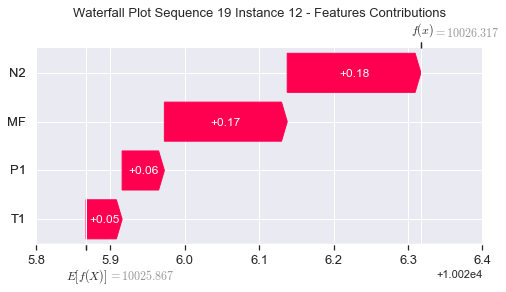

None

Contribution: [0.05564542 0.04774961 0.17551342 0.16167731]


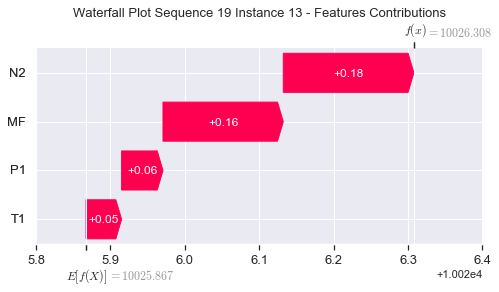

None

Contribution: [0.05474059 0.04726925 0.17196781 0.16023762]


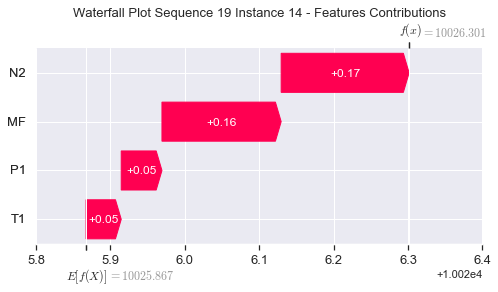

None

Contribution: [0.0531573  0.04546341 0.16760721 0.15436056]


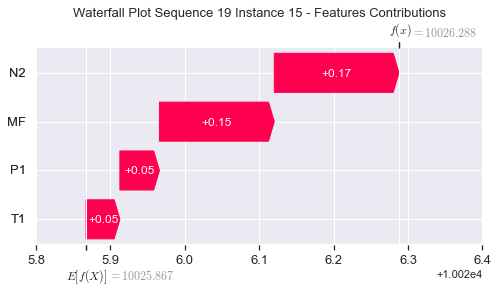

None

Contribution: [0.05184695 0.04594954 0.16437721 0.15188692]


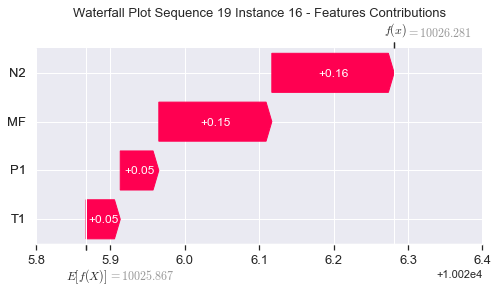

None

Contribution: [0.05131452 0.04409579 0.16147952 0.14882212]


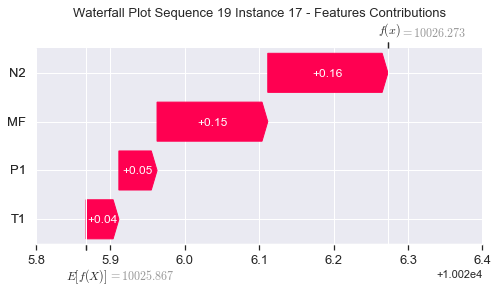

None

Contribution: [0.05040718 0.04316712 0.15889838 0.14637946]


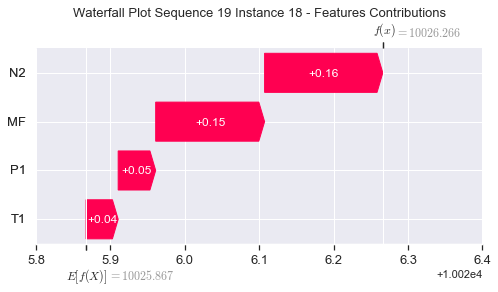

None

Contribution: [0.04933656 0.04291644 0.15765812 0.14422294]


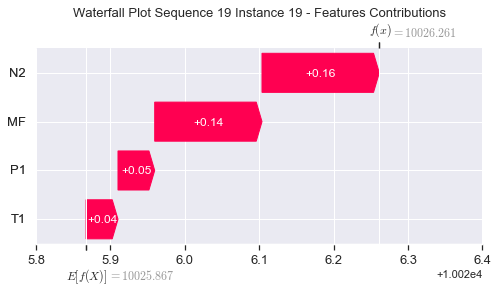

None

Contribution: [0.0509806  0.04397388 0.16048983 0.14830792]


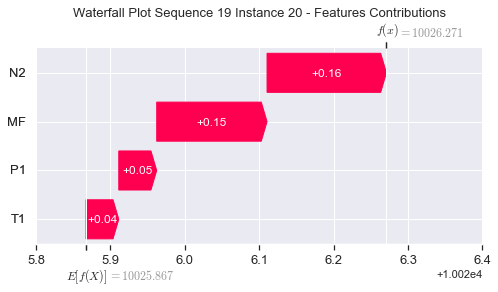

None

Contribution: [0.05580853 0.04830567 0.17627096 0.16297535]


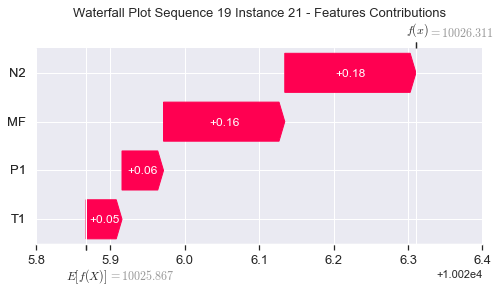

None

Contribution: [0.0769537  0.06387121 0.24430981 0.22701006]


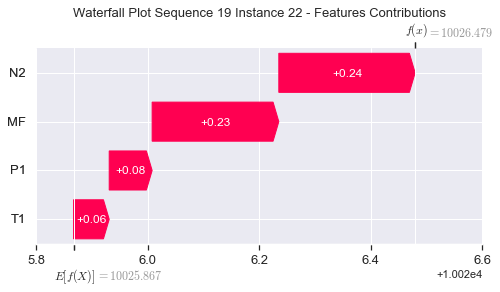

None

Contribution: [0.16396348 0.0677705  0.52976604 0.50792494]


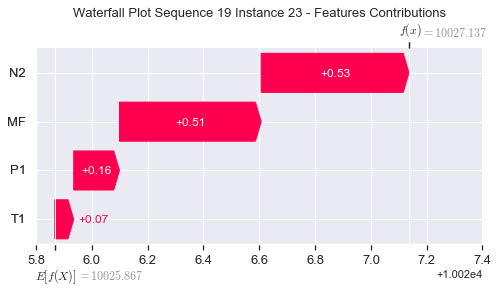

None

Contribution: [ 0.59446397 -1.02960297  1.89840134  2.01800672]


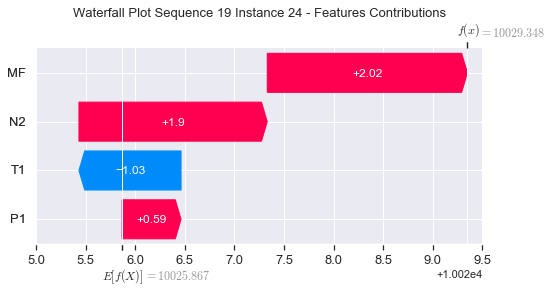

None

Contribution: [18.55044834  0.35404532 67.23121272 61.6918308 ]


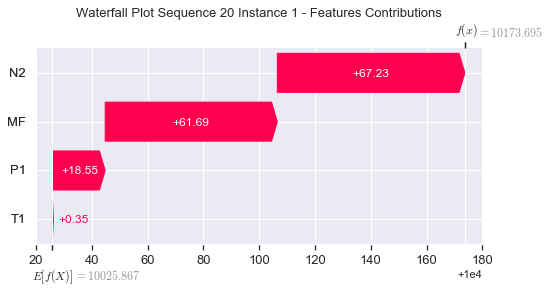

None

Contribution: [-0.10349312 -0.21055224 -0.29339051 -0.18880364]


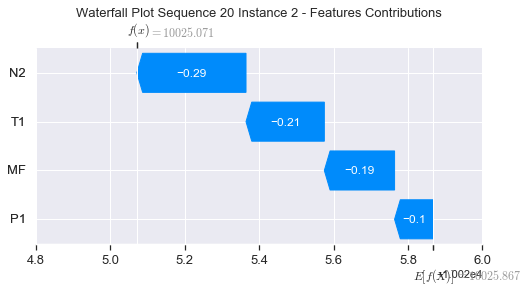

None

Contribution: [0.36882109 0.24056806 1.14770276 1.07620917]


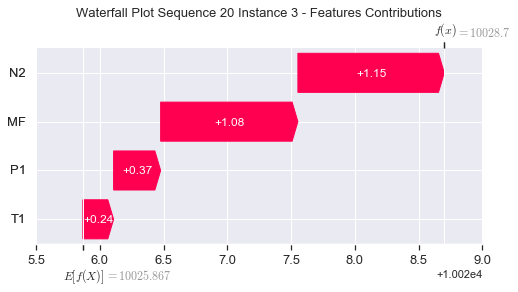

None

Contribution: [0.10226842 0.07018366 0.32824527 0.30186322]


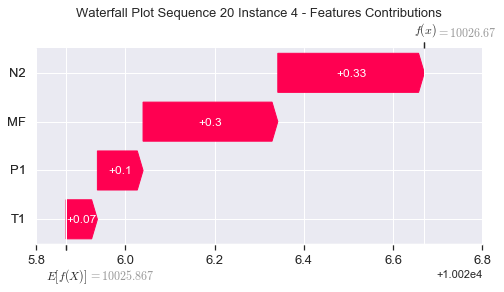

None

Contribution: [0.08618357 0.07568283 0.26788773 0.24870577]


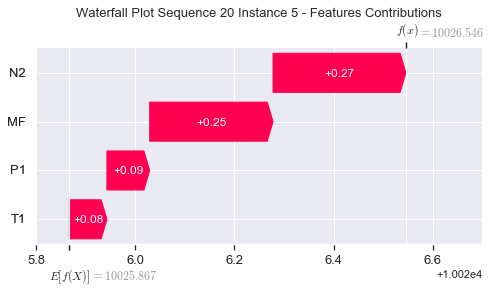

None

Contribution: [0.07394746 0.06461857 0.23295151 0.21411205]


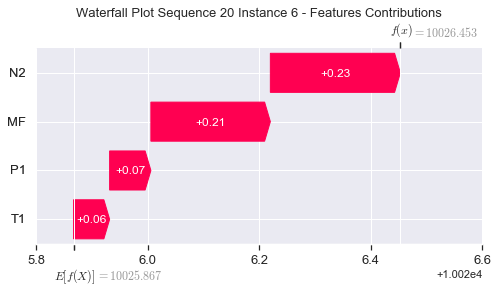

None

Contribution: [0.06928261 0.06079375 0.21789152 0.20058857]


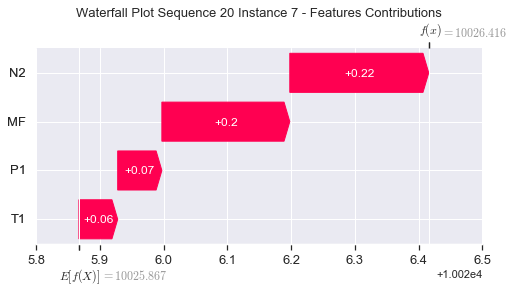

None

Contribution: [0.06581463 0.0576657  0.20731603 0.1909236 ]


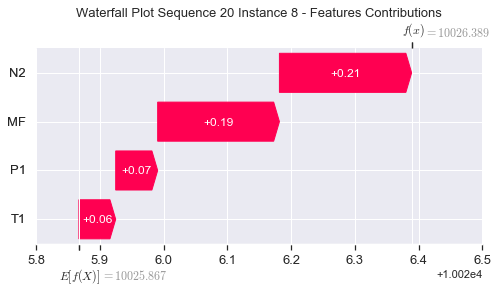

None

Contribution: [0.06277588 0.05523654 0.19939819 0.18411315]


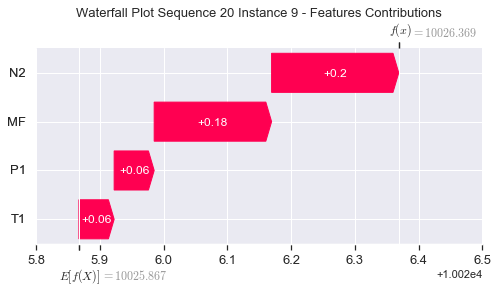

None

Contribution: [0.0620108  0.04989144 0.19185612 0.17841207]


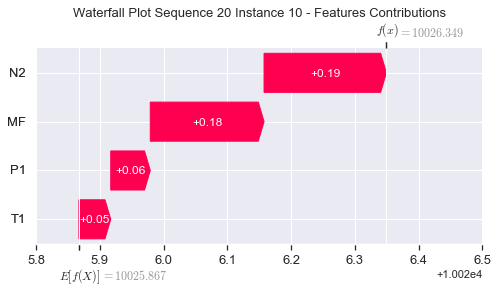

None

Contribution: [0.05788164 0.05068959 0.18554796 0.17036519]


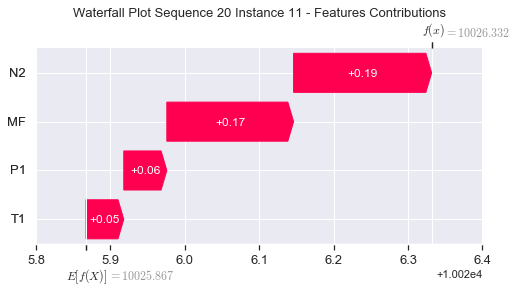

None

Contribution: [0.05737828 0.05130252 0.18034776 0.16691311]


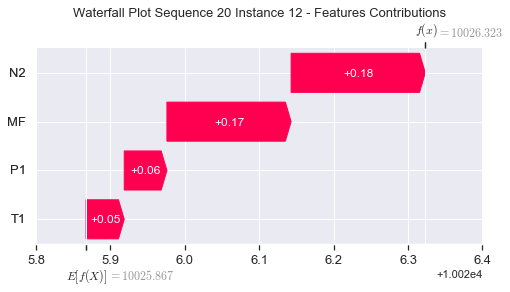

None

Contribution: [0.05620024 0.05017905 0.17627938 0.16336714]


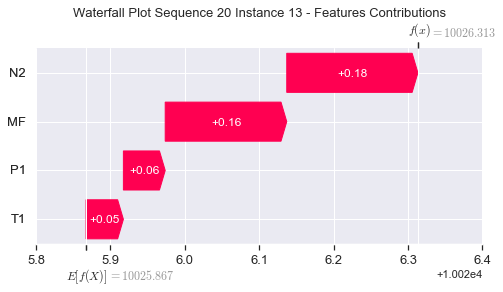

None

Contribution: [0.0545854  0.04965941 0.17196912 0.15942638]


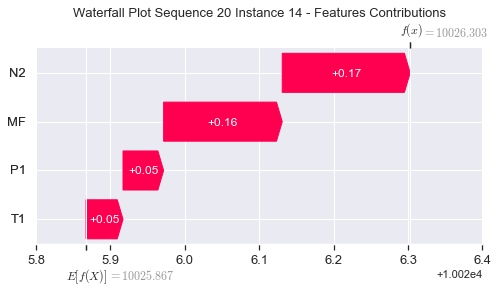

None

Contribution: [0.05345333 0.04748104 0.1682895  0.15571691]


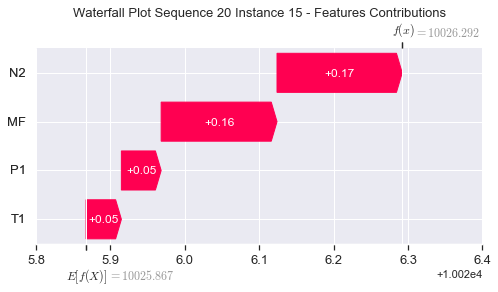

None

Contribution: [0.0521783  0.04506927 0.16508739 0.15322867]


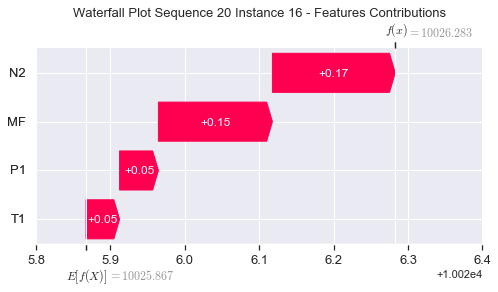

None

Contribution: [0.05152692 0.04547265 0.16222361 0.15019785]


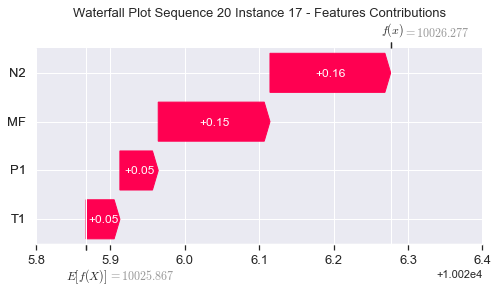

None

Contribution: [0.05059249 0.04436084 0.1596034  0.14761349]


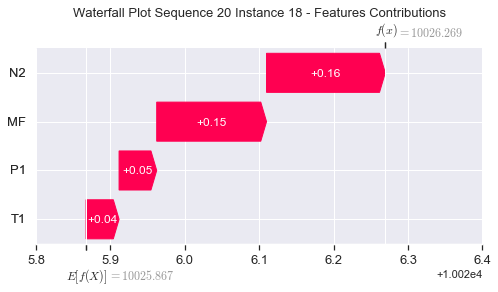

None

Contribution: [0.05052555 0.04412057 0.15878335 0.146593  ]


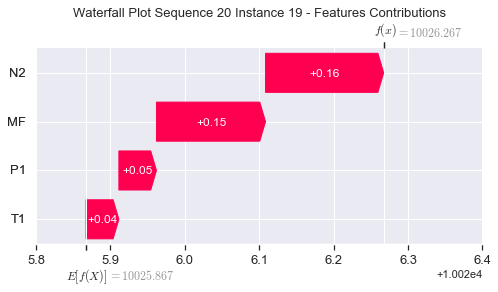

None

Contribution: [0.05119183 0.04462445 0.16128987 0.14950211]


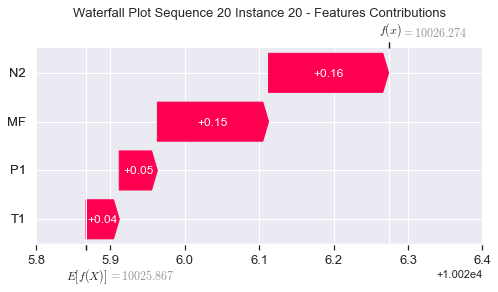

None

Contribution: [0.05616418 0.04945813 0.17723287 0.16459777]


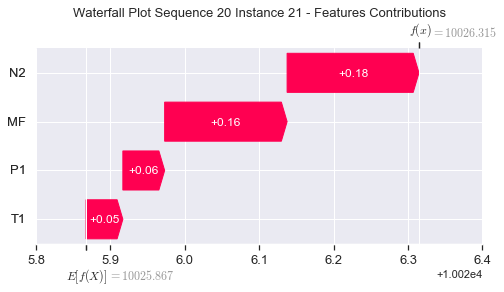

None

Contribution: [0.07767562 0.06632265 0.24572814 0.22980869]


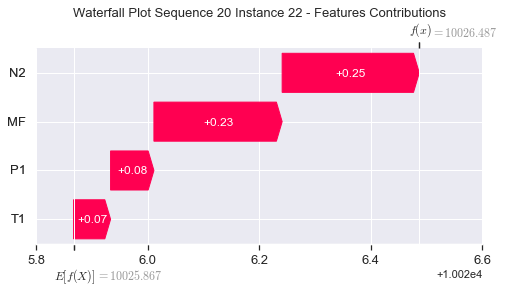

None

Contribution: [0.16572719 0.07644394 0.53319919 0.51752677]


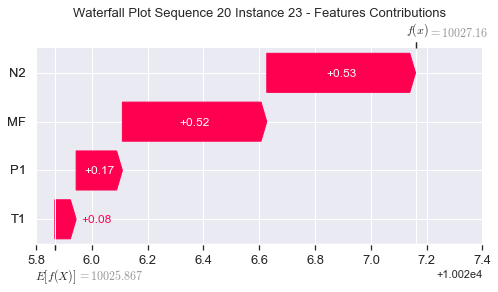

None

Contribution: [ 0.65273381 -0.91361207  1.92205257  2.20083386]


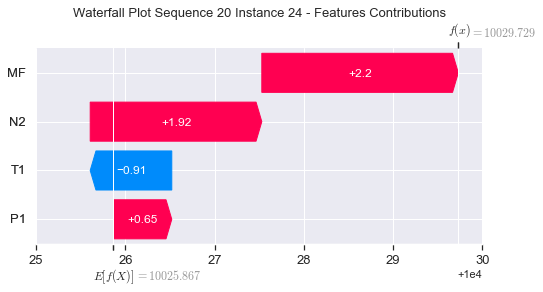

None

Contribution: [21.20601301  4.84477728 66.84837852 69.35739033]


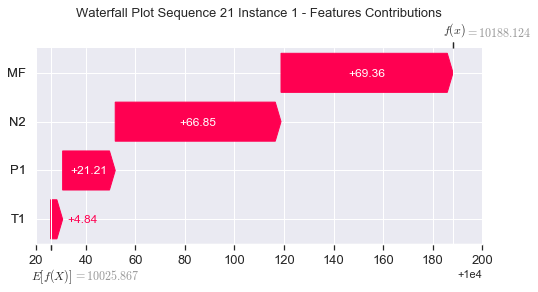

None

Contribution: [-0.08140604 -0.11491365 -0.2590816  -0.11754387]


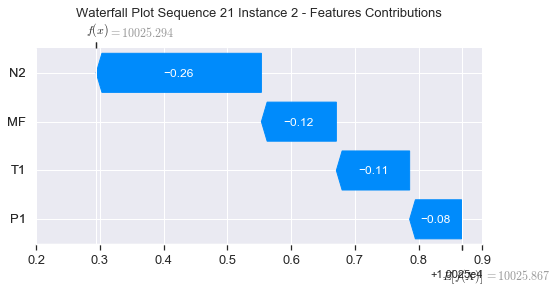

None

Contribution: [0.36857376 0.30853844 1.13497969 1.10540137]


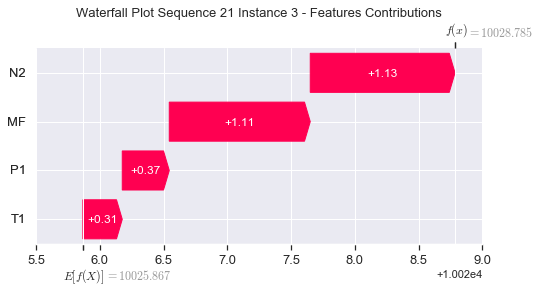

None

Contribution: [0.10641925 0.08042565 0.32514759 0.30858027]


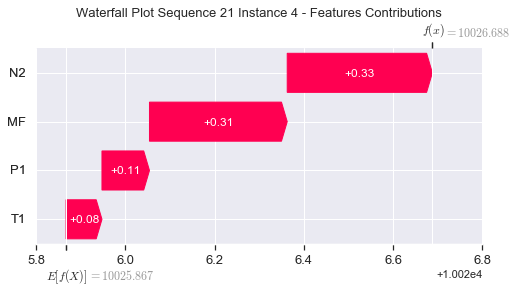

None

Contribution: [0.08531368 0.0747648  0.26629187 0.24868503]


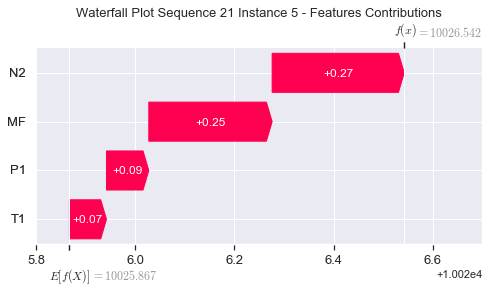

None

Contribution: [0.07498444 0.06602004 0.2327366  0.21711794]


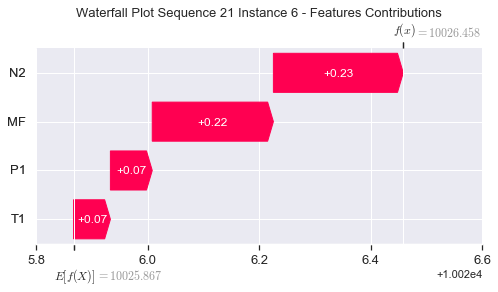

None

Contribution: [0.06984469 0.06162686 0.21739678 0.20269145]


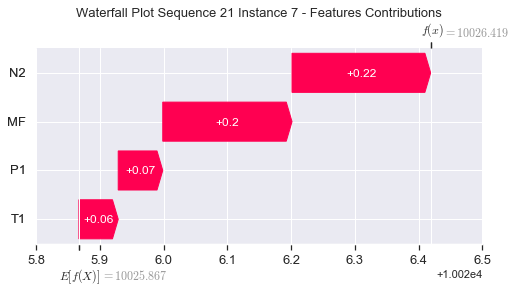

None

Contribution: [0.06651222 0.05827157 0.20700384 0.19295114]


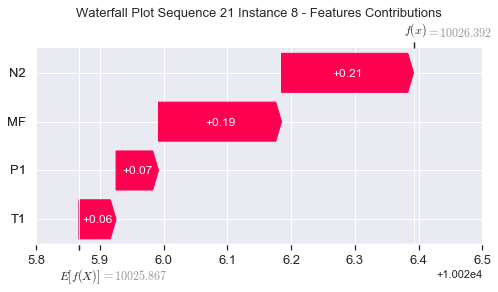

None

Contribution: [0.06398211 0.05547715 0.19886172 0.18568072]


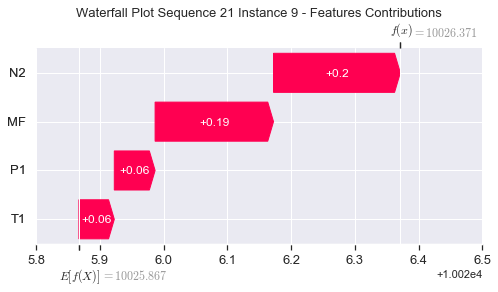

None

Contribution: [0.05913445 0.05339301 0.19133085 0.17691217]


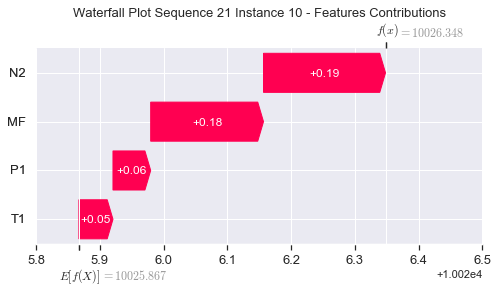

None

Contribution: [0.0600372  0.05134548 0.18616917 0.17397541]


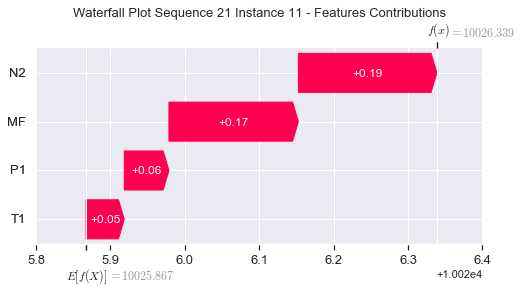

None

Contribution: [0.0569778  0.04918673 0.1799276  0.16741738]


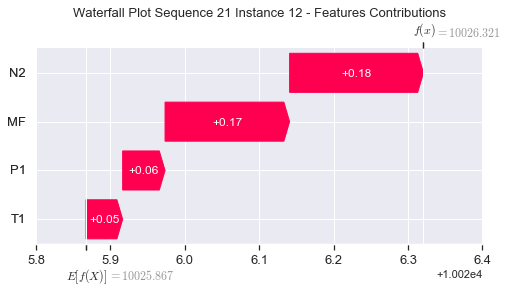

None

Contribution: [0.05561547 0.04803128 0.175701   0.16334765]


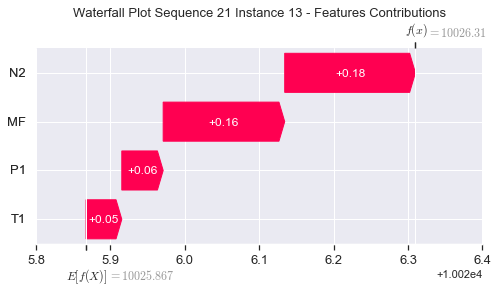

None

Contribution: [0.05536325 0.04700553 0.1718178  0.15993399]


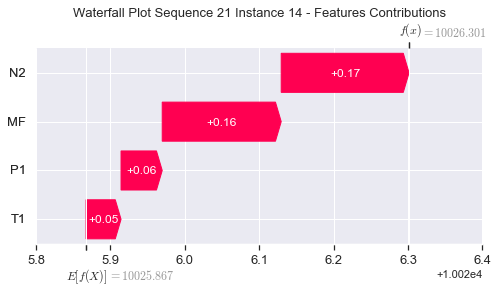

None

Contribution: [0.05340247 0.04566274 0.16799367 0.1561279 ]


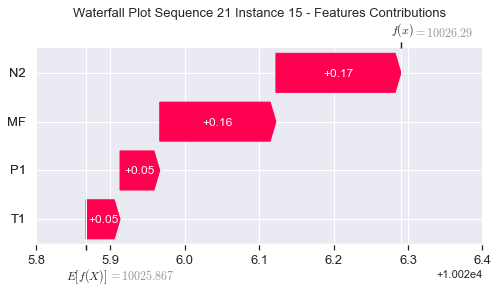

None

Contribution: [0.052366   0.04543063 0.1648309  0.15425933]


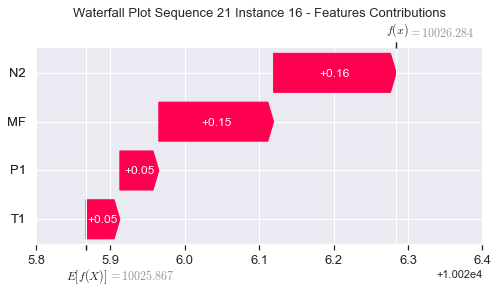

None

Contribution: [0.05136837 0.04358003 0.16185531 0.15012028]


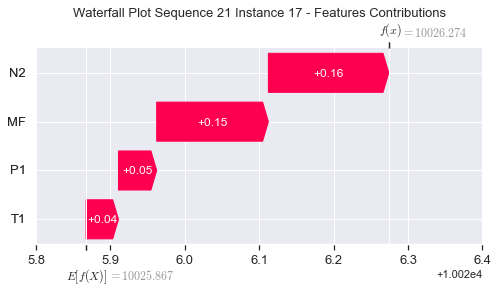

None

Contribution: [0.05062323 0.0426248  0.15939408 0.14769015]


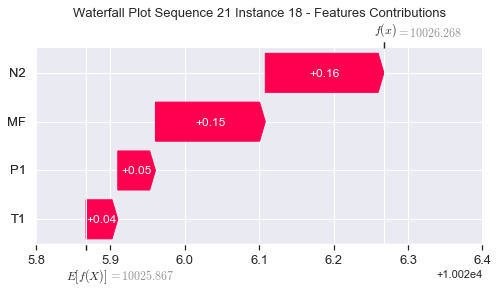

None

Contribution: [0.05061855 0.04167076 0.15860546 0.14802136]


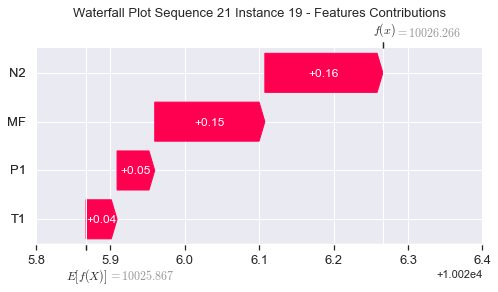

None

Contribution: [0.05097103 0.04255847 0.16086317 0.14867872]


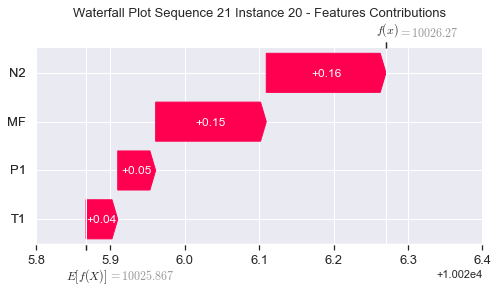

None

Contribution: [0.05566589 0.04643298 0.1767063  0.16318928]


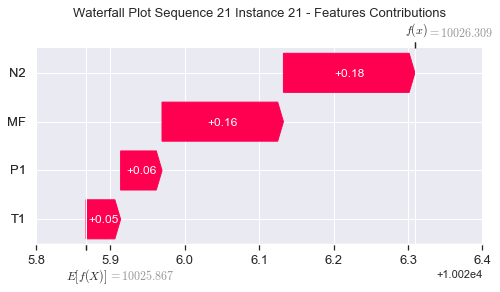

None

Contribution: [0.07678429 0.06057114 0.24524859 0.22736289]


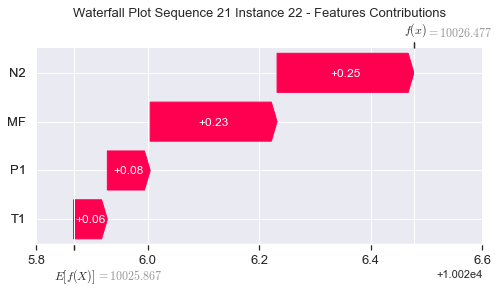

None

Contribution: [0.16542084 0.05414212 0.53595259 0.5134866 ]


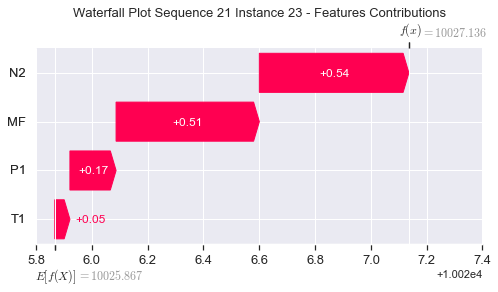

None

Contribution: [ 0.59328263 -1.21293232  1.96793951  2.0473561 ]


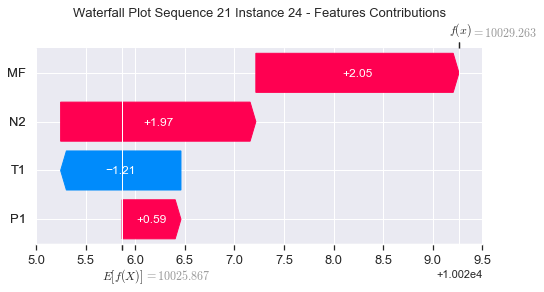

None

Contribution: [16.73676656 -4.15380252 68.47860956 61.95907168]


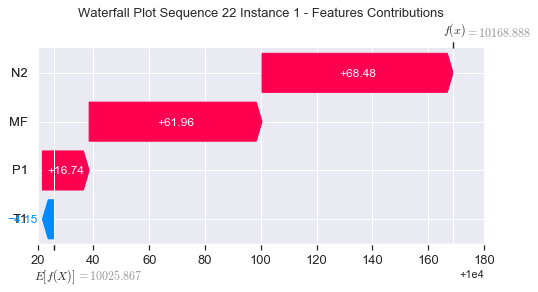

None

Contribution: [-0.12922023 -0.3146857  -0.28170367 -0.20470696]


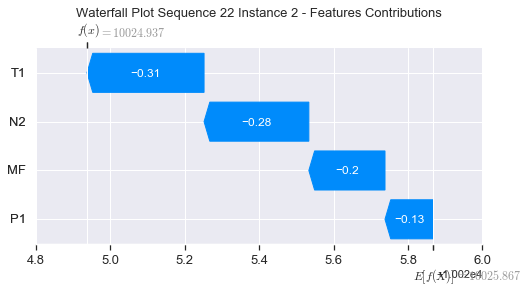

None

Contribution: [0.37348848 0.19234811 1.16276874 1.11870534]


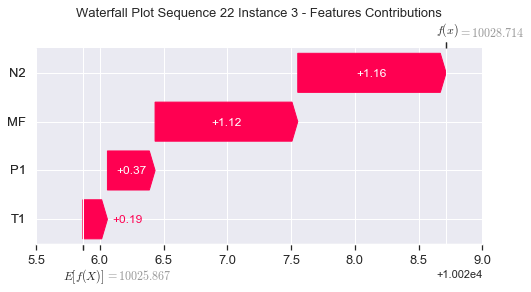

None

Contribution: [0.1079952  0.05508419 0.33220025 0.31654121]


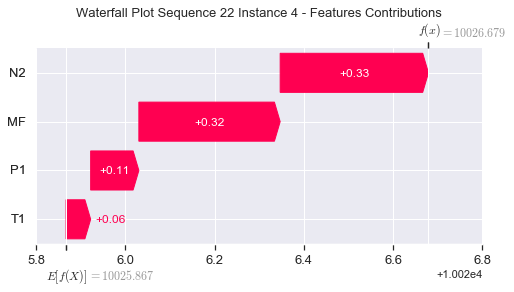

None

Contribution: [0.08541796 0.06618205 0.26698891 0.24950036]


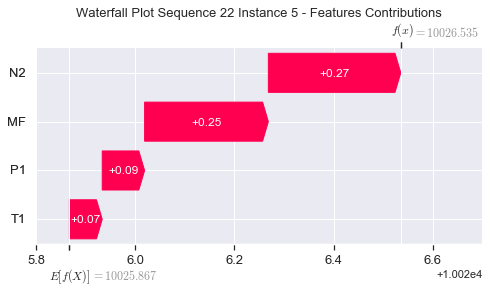

None

Contribution: [0.07419779 0.05942501 0.23257202 0.21750842]


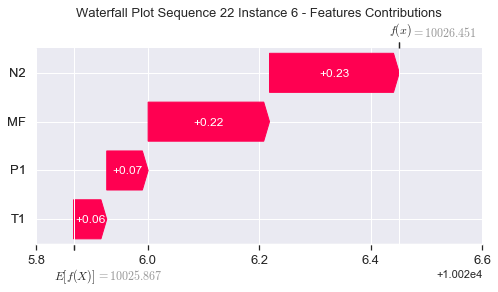

None

Contribution: [0.0696307  0.05585368 0.21742702 0.2039963 ]


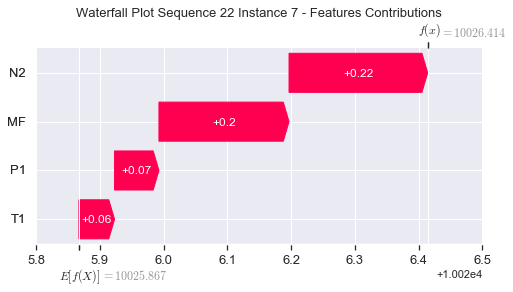

None

Contribution: [0.06604129 0.05378095 0.20695274 0.19349409]


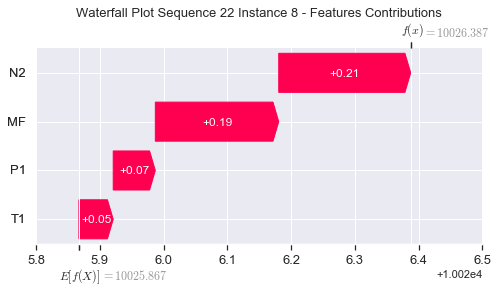

None

Contribution: [0.06317813 0.05228502 0.19832329 0.18502914]


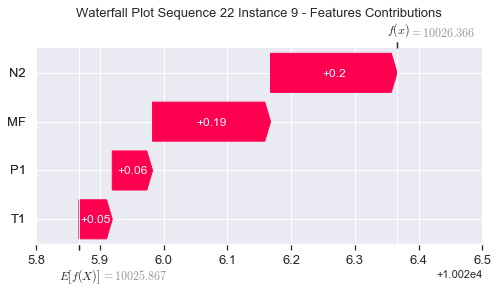

None

Contribution: [0.06154178 0.05227834 0.19175119 0.17725253]


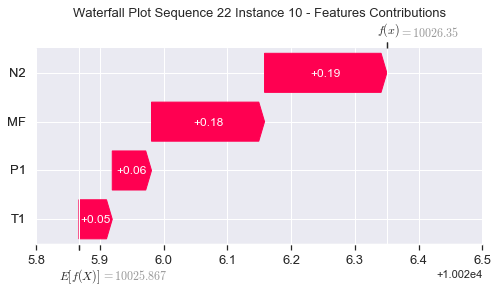

None

Contribution: [0.05799372 0.05048732 0.1851233  0.17085324]


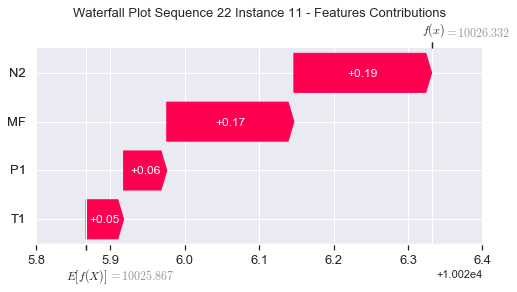

None

Contribution: [0.05711984 0.04925946 0.18024744 0.16886263]


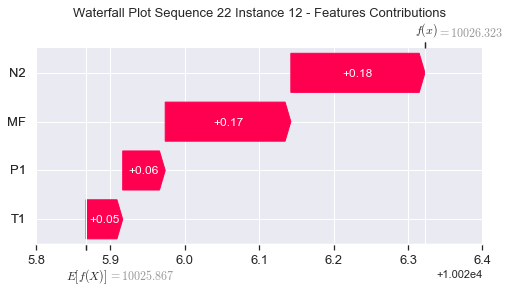

None

Contribution: [0.05601333 0.04804825 0.17615354 0.16522578]


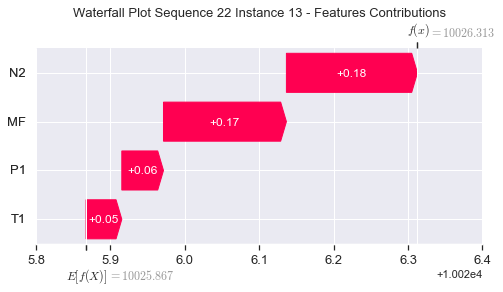

None

Contribution: [0.05442471 0.04755173 0.17206669 0.16188607]


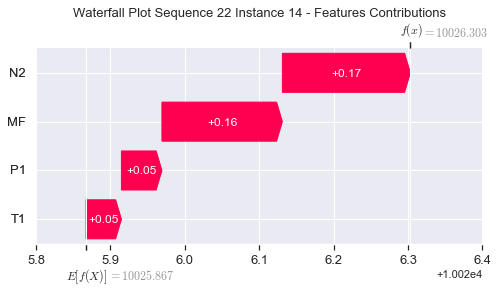

None

Contribution: [0.05352759 0.04595118 0.16835207 0.15789064]


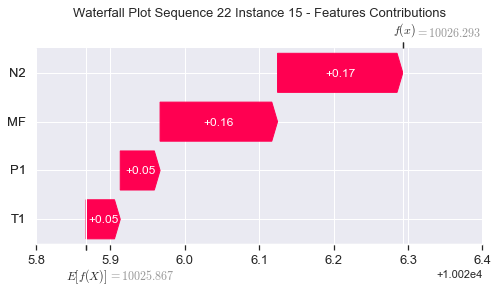

None

Contribution: [0.05282133 0.04532238 0.1654555  0.15515063]


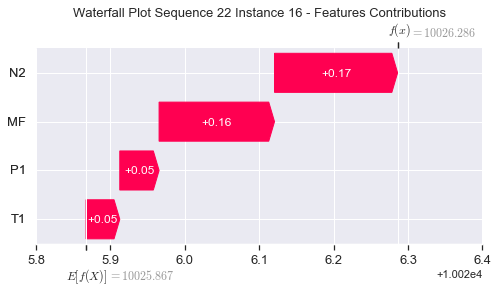

None

Contribution: [0.0518205  0.04485539 0.16239285 0.15262814]


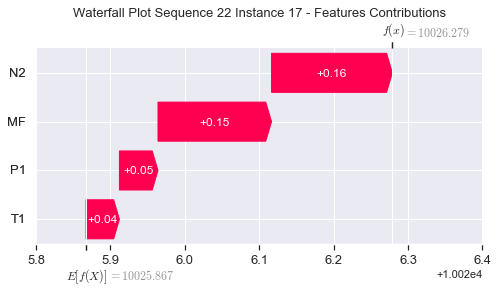

None

Contribution: [0.0509527  0.04446969 0.1599263  0.15006701]


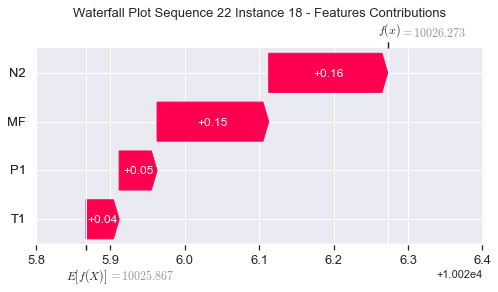

None

Contribution: [0.04968565 0.04368397 0.15872557 0.14682863]


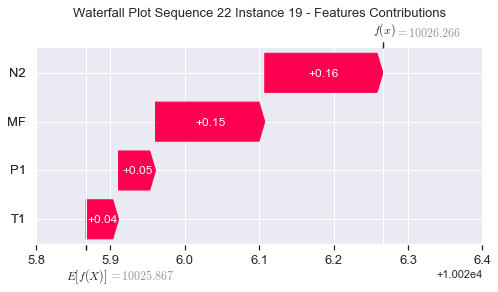

None

Contribution: [0.05163265 0.04487957 0.16166545 0.15152667]


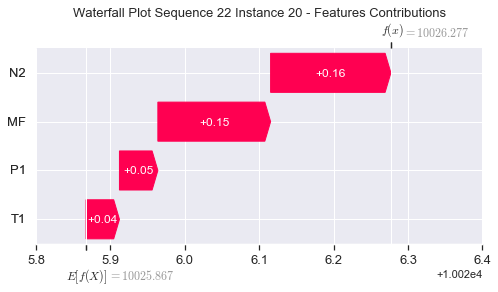

None

Contribution: [0.05646885 0.04987285 0.1777067  0.16639679]


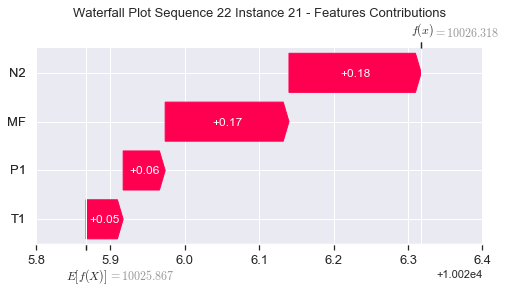

None

Contribution: [0.0778045  0.06727238 0.24659531 0.23167482]


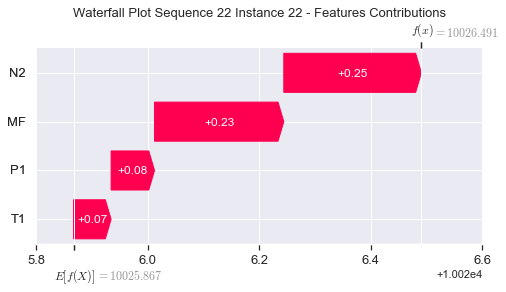

None

Contribution: [0.16696615 0.08972206 0.53684872 0.52811747]


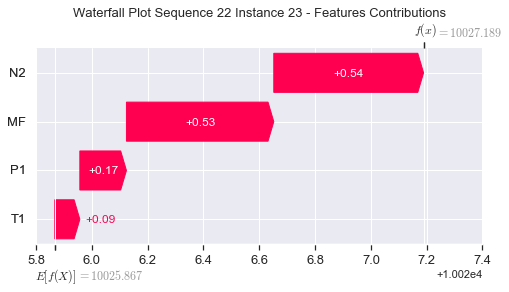

None

Contribution: [ 0.62240986 -0.81354333  1.97958145  2.23972668]


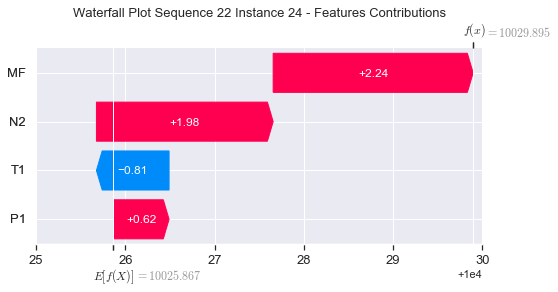

None

Contribution: [18.48615767  3.6217813  68.64401822 67.12028639]


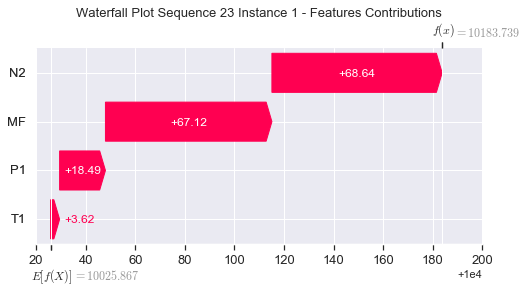

None

Contribution: [-0.10042215 -0.10284775 -0.25853846 -0.14285252]


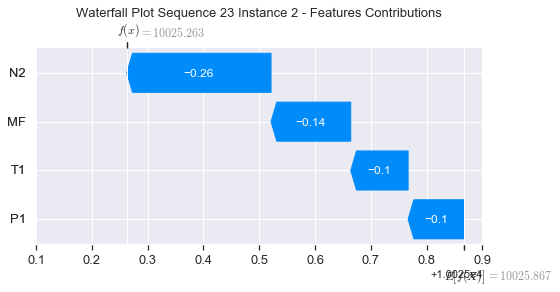

None

Contribution: [0.3479688  0.19757406 1.14591619 1.10623459]


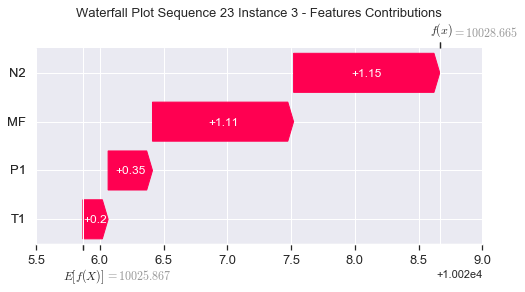

None

Contribution: [0.09857859 0.05717264 0.32687006 0.30671885]


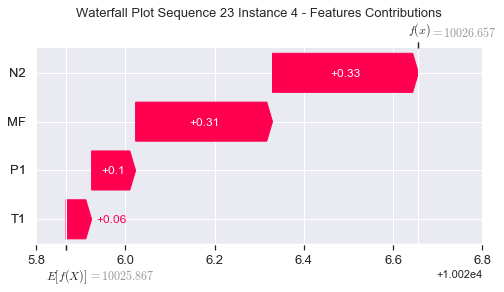

None

Contribution: [0.08518946 0.07031415 0.26705898 0.24907205]


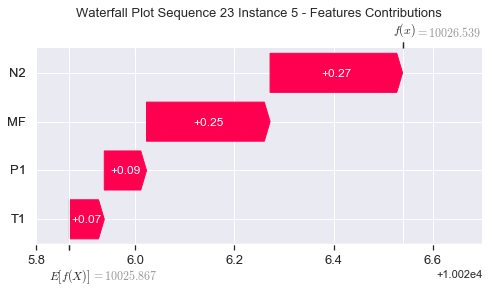

None

Contribution: [0.07463427 0.06268886 0.23302413 0.21639491]


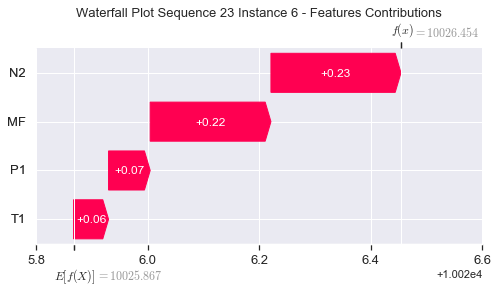

None

Contribution: [0.06984815 0.05908145 0.21780995 0.20231497]


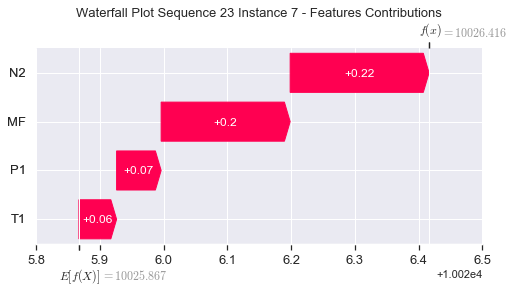

None

Contribution: [0.0663148  0.05613334 0.20731176 0.19227031]


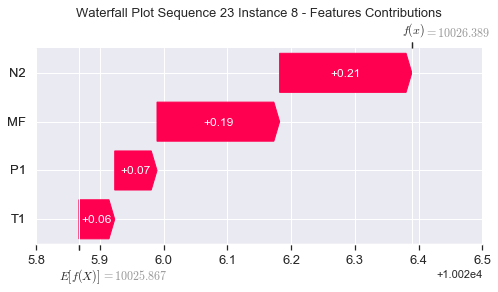

None

Contribution: [0.06400103 0.05482598 0.19950676 0.18523479]


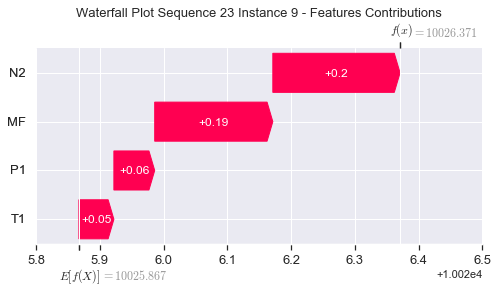

None

Contribution: [0.06228679 0.05303613 0.1924808  0.17847089]


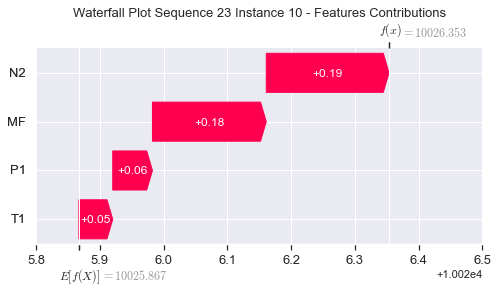

None

Contribution: [0.05924857 0.05068673 0.18612448 0.17129263]


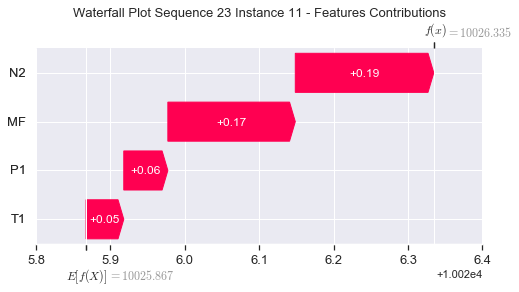

None

Contribution: [0.05749275 0.04960696 0.18025944 0.1662169 ]


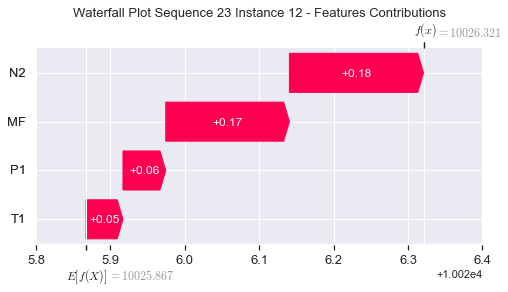

None

Contribution: [0.05620199 0.0485451  0.17611909 0.16261541]


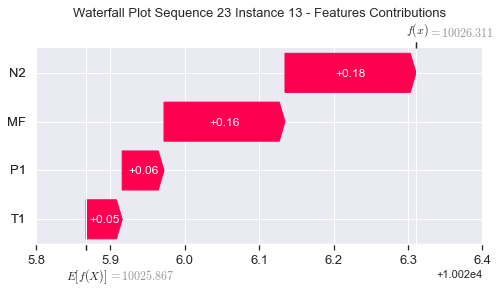

None

Contribution: [0.05493003 0.04813438 0.17234067 0.16174302]


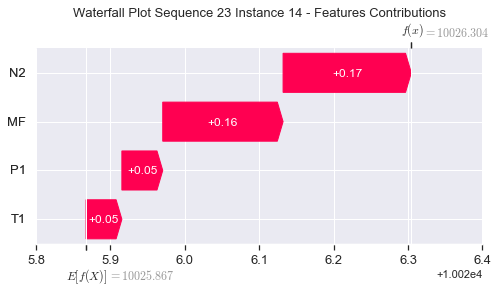

None

Contribution: [0.05359791 0.04641016 0.1682586  0.15518894]


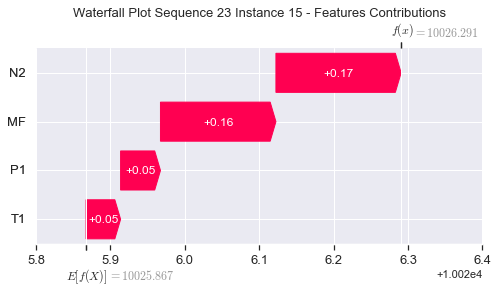

None

Contribution: [0.05141851 0.04517472 0.16457943 0.15160267]


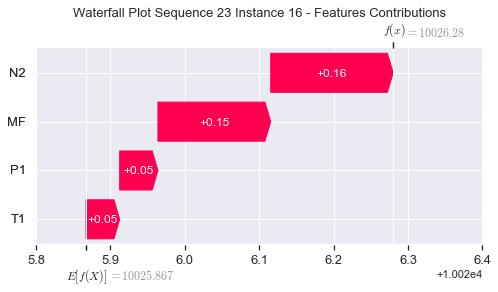

None

Contribution: [0.05172584 0.04493583 0.16219785 0.14960642]


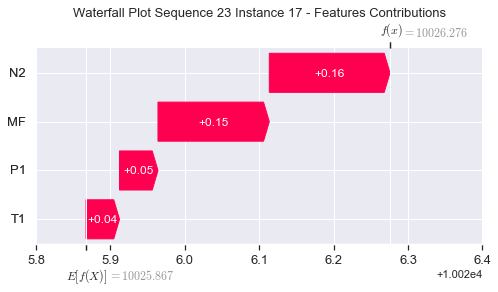

None

Contribution: [0.05083268 0.0441202  0.15965084 0.14704705]


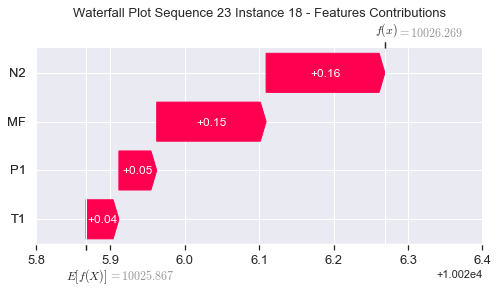

None

Contribution: [0.05027902 0.04299155 0.15809534 0.1437572 ]


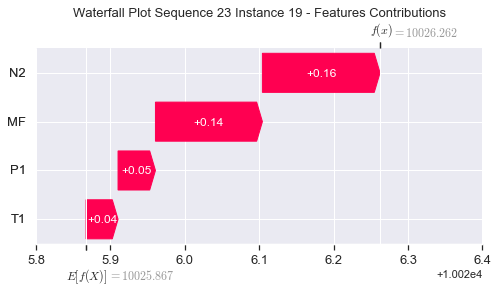

None

Contribution: [0.05110516 0.04432161 0.16116733 0.14840703]


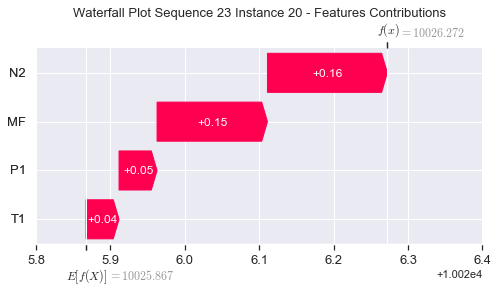

None

Contribution: [0.0558592  0.04879801 0.1770435  0.1628634 ]


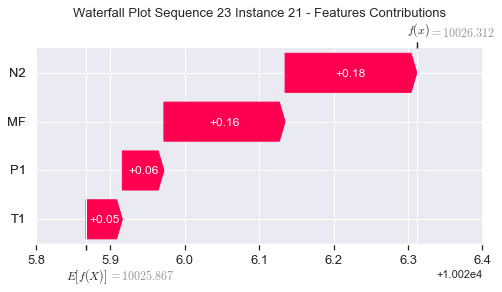

None

Contribution: [0.07684127 0.06480275 0.24554451 0.22618134]


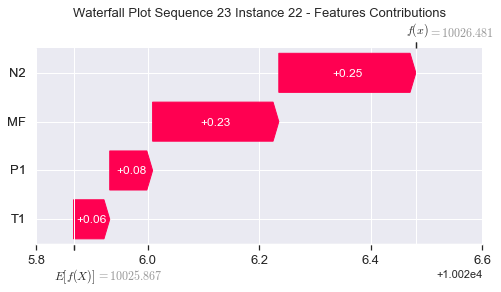

None

Contribution: [0.16451908 0.07532296 0.5354127  0.50398312]


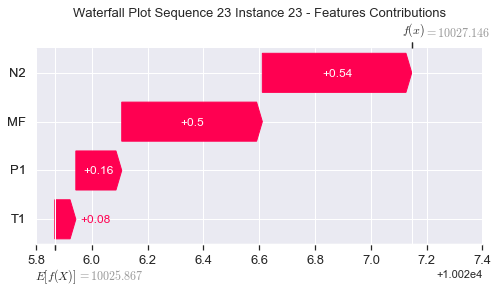

None

Contribution: [ 0.67281049 -0.93563977  1.98661982  2.07567941]


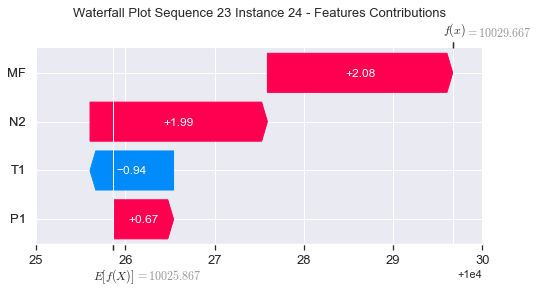

None

Contribution: [23.43010308  4.34038968 68.78405618 67.50187403]


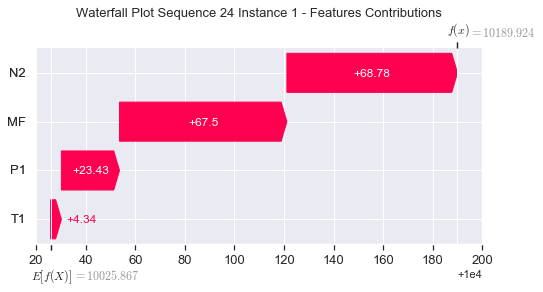

None

Contribution: [-0.10046697 -0.15358613 -0.23117078 -0.19222572]


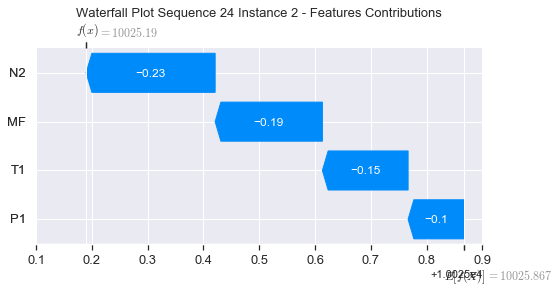

None

Contribution: [0.36780249 0.24511684 1.14486102 1.08651757]


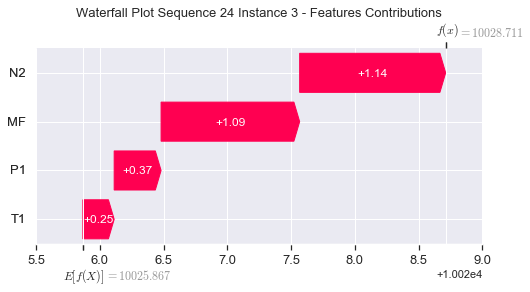

None

Contribution: [0.10897771 0.05886668 0.32733713 0.31220969]


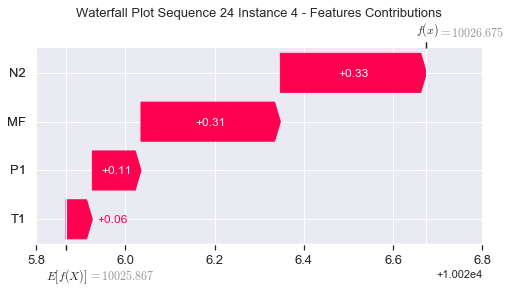

None

Contribution: [0.08558431 0.06881084 0.26623942 0.24584612]


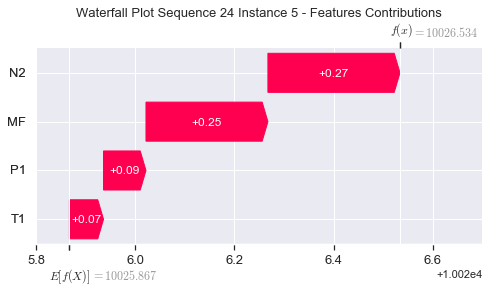

None

Contribution: [0.07447877 0.06068491 0.2325261  0.21474602]


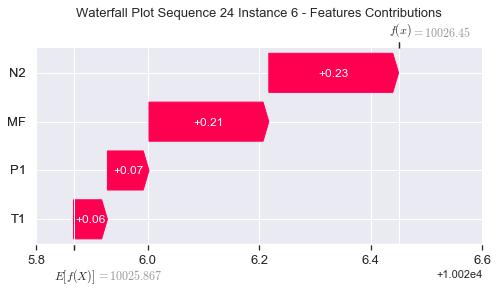

None

Contribution: [0.06974355 0.05728006 0.21741913 0.20109885]


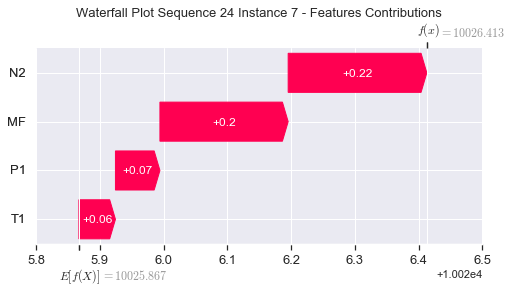

None

Contribution: [0.06620134 0.05479145 0.20688487 0.19098382]


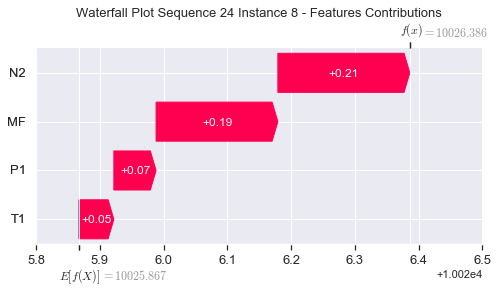

None

Contribution: [0.06306306 0.05323898 0.19851628 0.18180936]


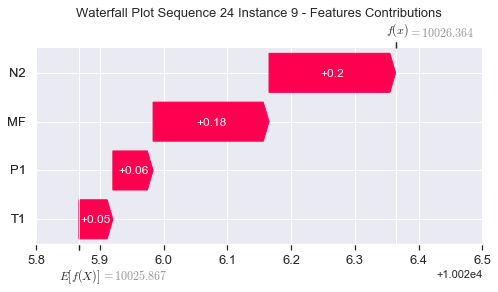

None

Contribution: [0.06154341 0.05016512 0.1918556  0.17842927]


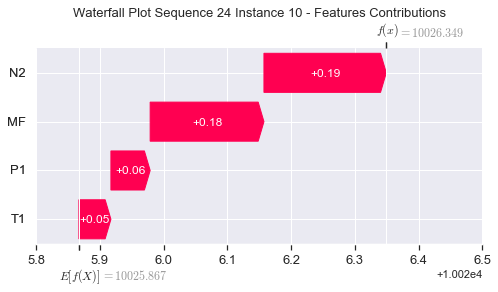

None

Contribution: [0.05868721 0.04889148 0.18544294 0.16980887]


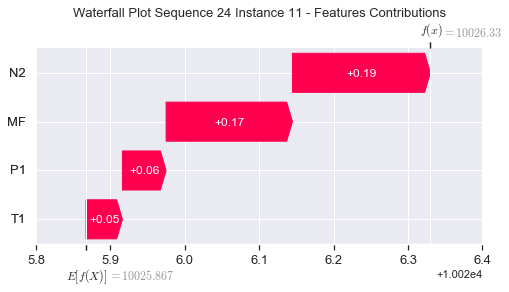

None

Contribution: [0.05783027 0.04773431 0.18019331 0.16735064]


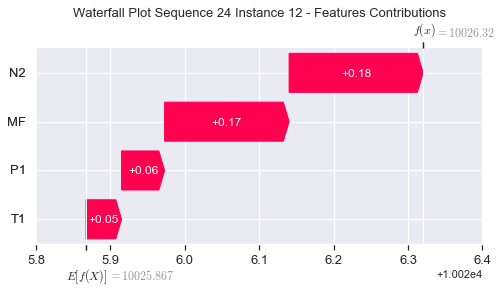

None

Contribution: [0.05650048 0.04721368 0.17602211 0.16343089]


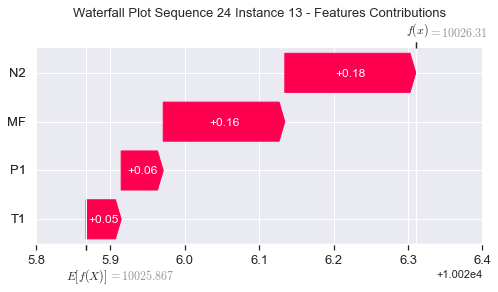

None

Contribution: [0.05433001 0.04554532 0.17116758 0.15722741]


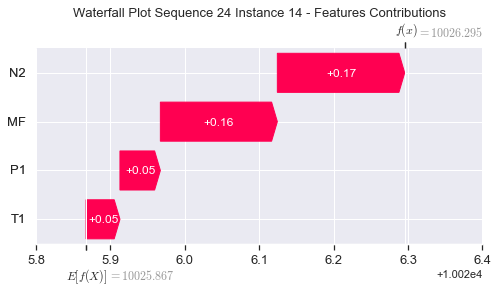

None

Contribution: [0.05395508 0.04596571 0.16824571 0.15629319]


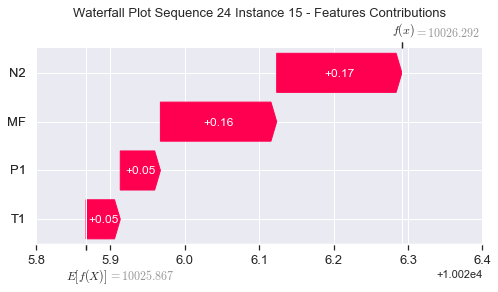

None

Contribution: [0.05150846 0.0431272  0.16403443 0.15126455]


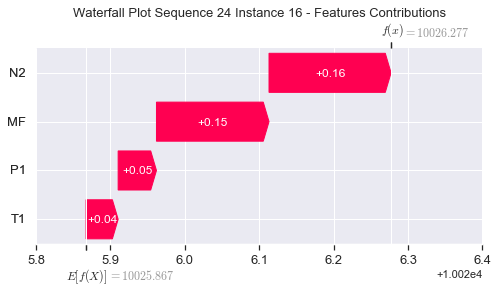

None

Contribution: [0.05193931 0.04534501 0.16219443 0.15073228]


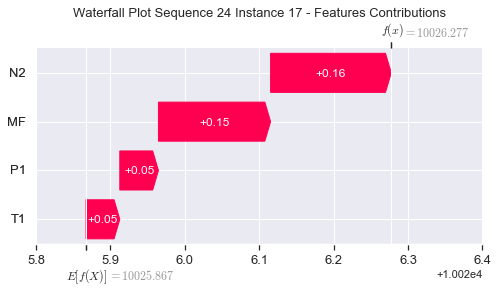

None

Contribution: [0.05103464 0.04507564 0.15968106 0.14831829]


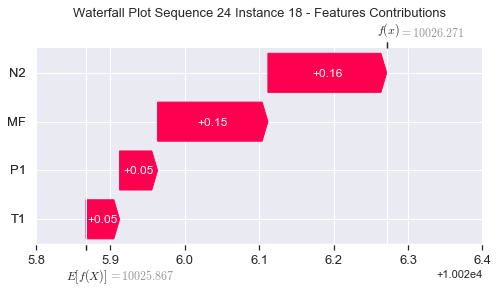

None

Contribution: [0.0502804  0.04545466 0.15917779 0.14698546]


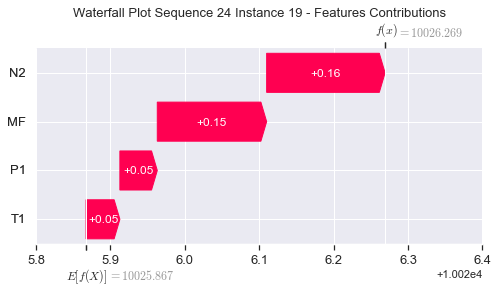

None

Contribution: [0.05135927 0.04687756 0.16116472 0.14949954]


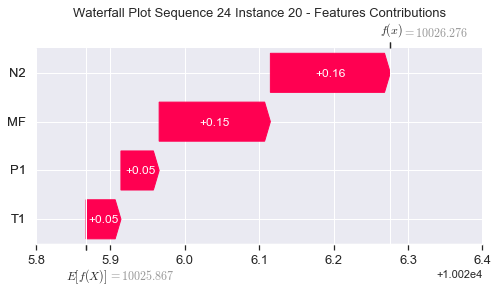

None

Contribution: [0.05624153 0.05172291 0.17692893 0.16417986]


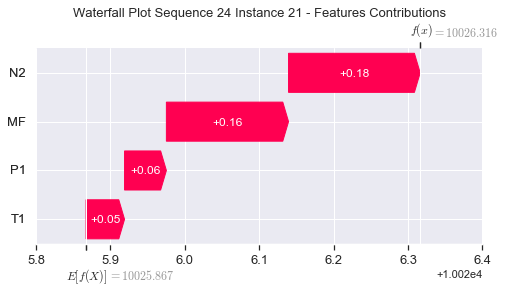

None

Contribution: [0.07773013 0.07022049 0.24521098 0.22882704]


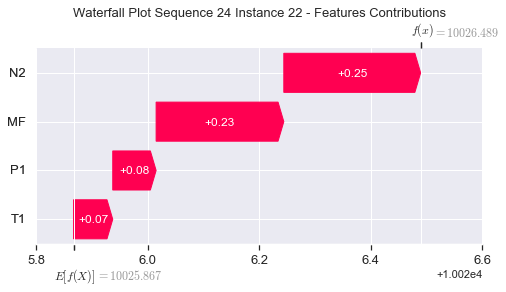

None

Contribution: [0.16821708 0.10165987 0.5351107  0.52008236]


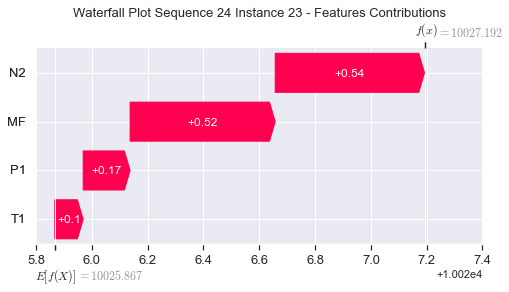

None

Contribution: [ 0.67716152 -0.55094269  1.9765759   2.17191418]


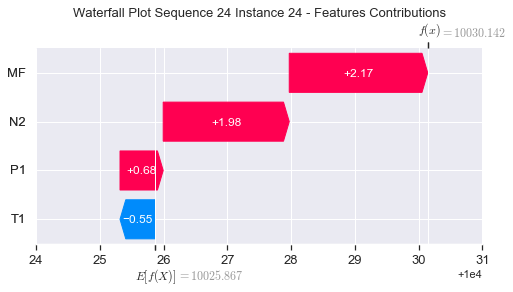

None

Contribution: [21.22523147  8.75592253 67.95260526 64.8234412 ]


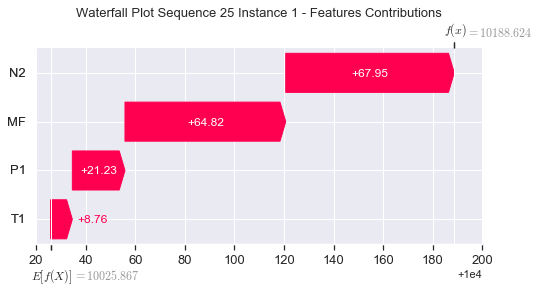

None

Contribution: [-0.08265199 -0.07212737 -0.24691175 -0.14016752]


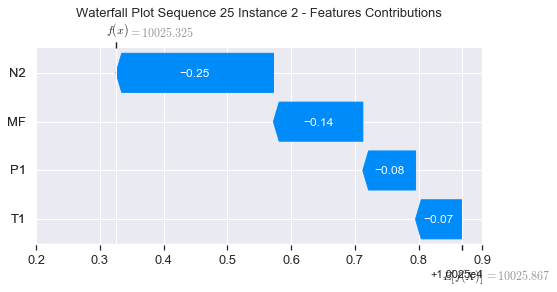

None

Contribution: [0.37608176 0.27253882 1.14512249 1.11599147]


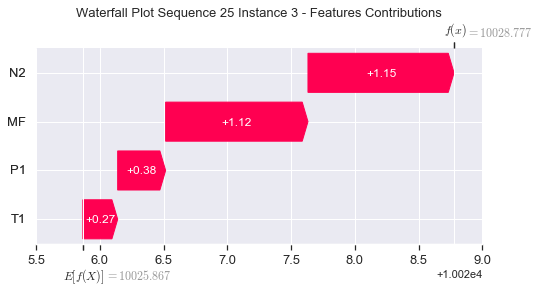

None

Contribution: [0.1010287  0.06256141 0.32588101 0.30443167]


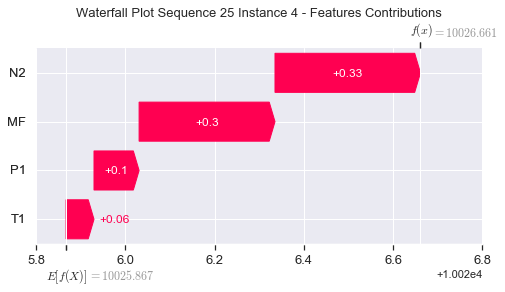

None

Contribution: [0.08444529 0.07423363 0.26586797 0.24360379]


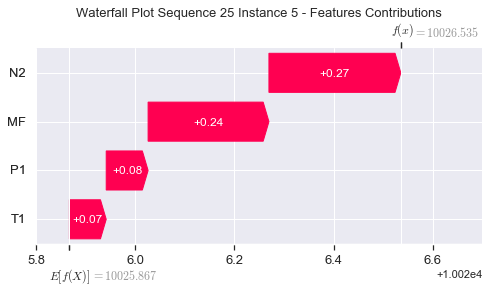

None

Contribution: [0.07341689 0.06414643 0.23217316 0.21280714]


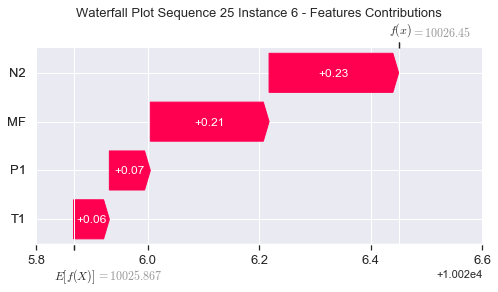

None

Contribution: [0.06861152 0.05989785 0.21699645 0.19922608]


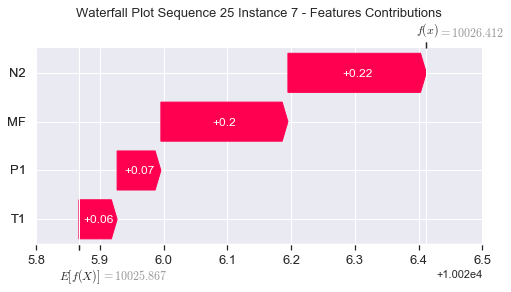

None

Contribution: [0.0654448  0.05772282 0.20671793 0.18996453]


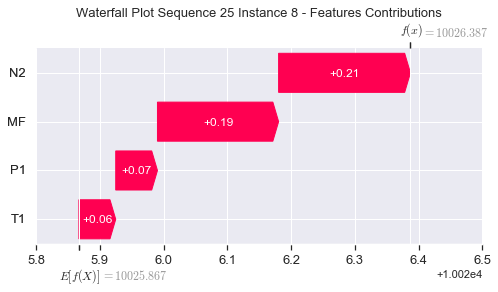

None

Contribution: [0.06374185 0.0562308  0.19936522 0.18592504]


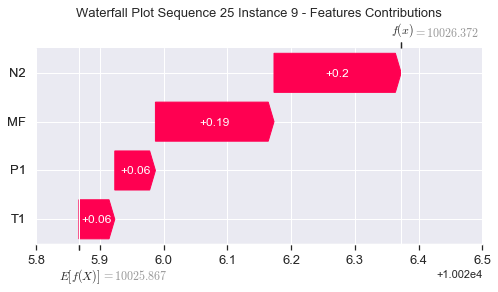

None

Contribution: [0.05894721 0.05163647 0.19103223 0.17363645]


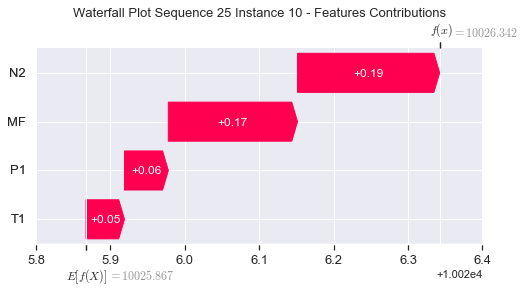

None

Contribution: [0.05954678 0.05345377 0.18647978 0.17340439]


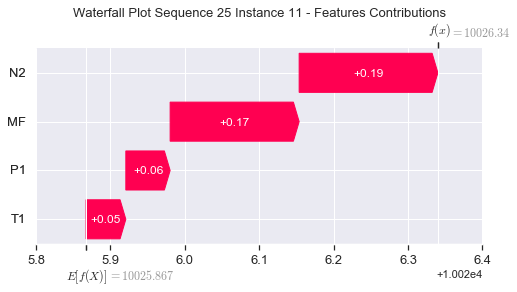

None

Contribution: [0.05704611 0.05062003 0.18009972 0.16611108]


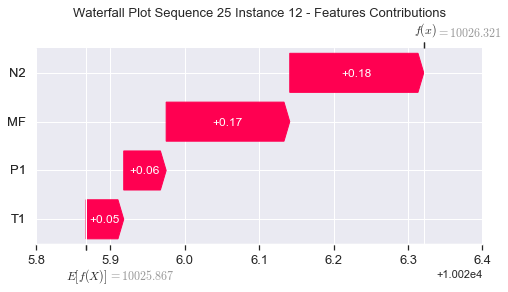

None

Contribution: [0.05570346 0.04962536 0.17588604 0.16223588]


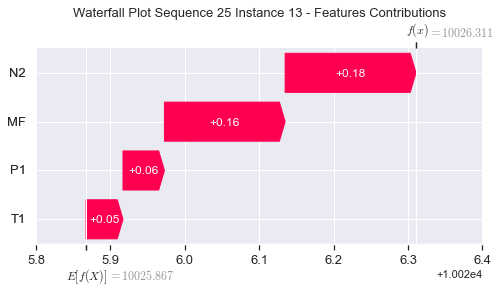

None

Contribution: [0.0546801  0.0478269  0.17128241 0.1571189 ]


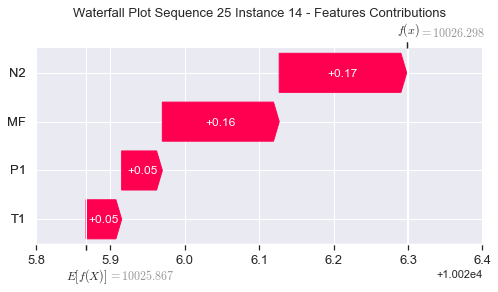

None

Contribution: [0.05319867 0.04788213 0.16811366 0.15520504]


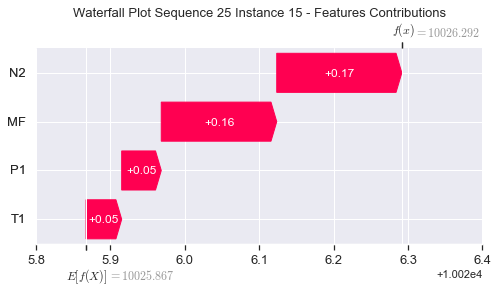

None

Contribution: [0.05047161 0.04444793 0.16386124 0.1493212 ]


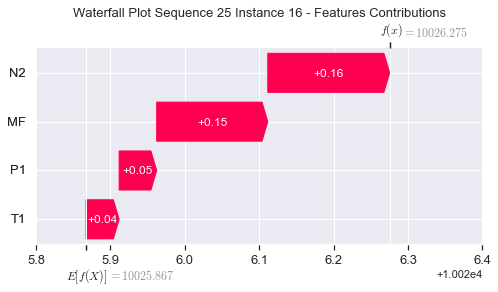

None

Contribution: [0.05118569 0.04639633 0.16204934 0.14977709]


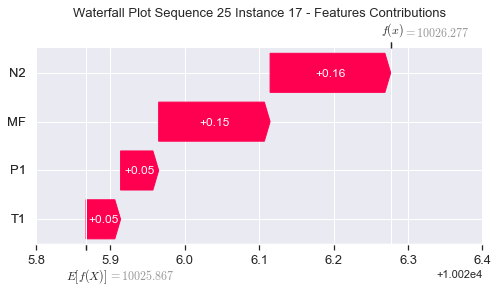

None

Contribution: [0.05034028 0.045978   0.1595599  0.1474005 ]


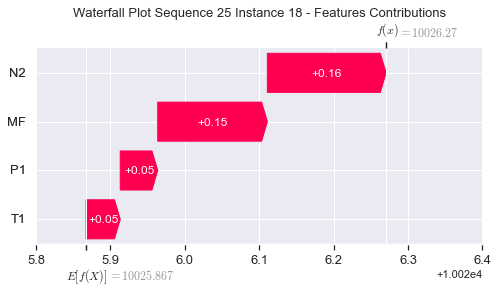

None

Contribution: [0.05088791 0.04583815 0.15888421 0.14746465]


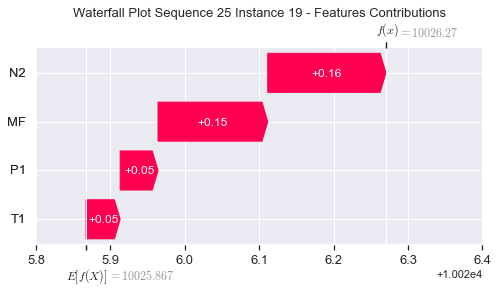

None

Contribution: [0.05070748 0.04727842 0.16104891 0.14879621]


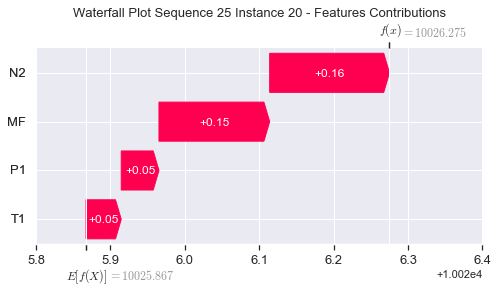

None

Contribution: [0.05557235 0.05250508 0.17688969 0.16349518]


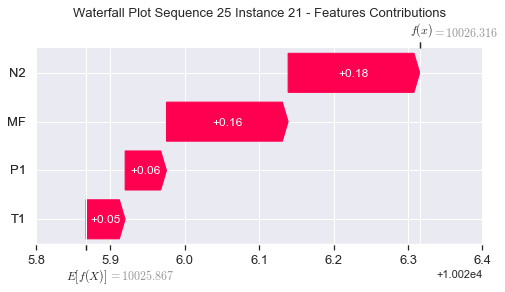

None

Contribution: [0.07675547 0.07221701 0.24526083 0.22775571]


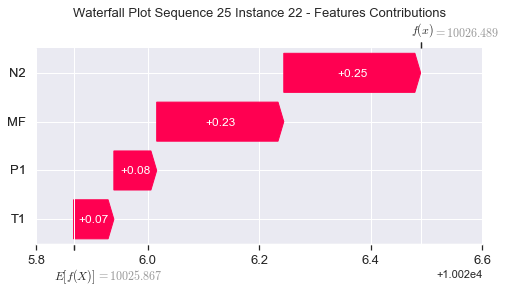

None

Contribution: [0.16394173 0.10928598 0.53546431 0.51498661]


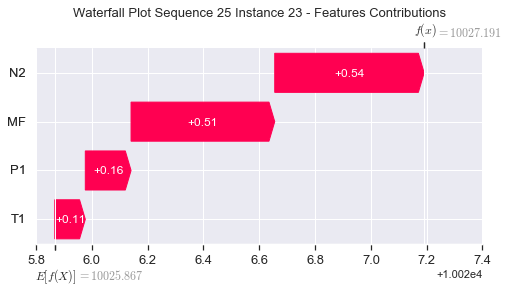

None

Contribution: [ 0.62422625 -0.4451216   1.9975463   2.20295482]


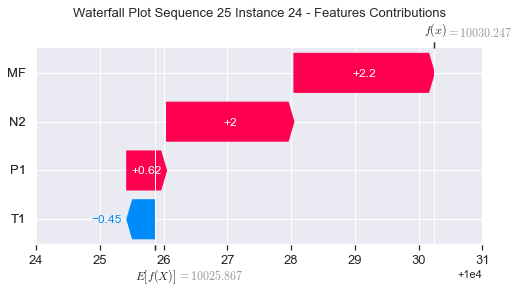

None

Contribution: [20.40320372 10.89938925 68.5455751  70.14435801]


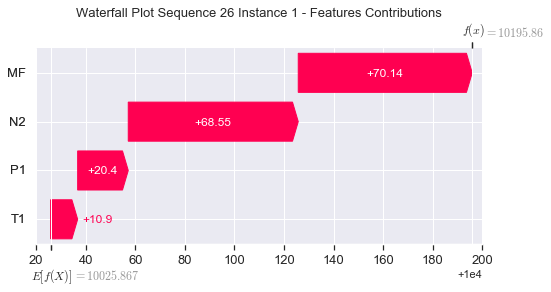

None

Contribution: [-0.08897859 -0.02051438 -0.22561372 -0.14115128]


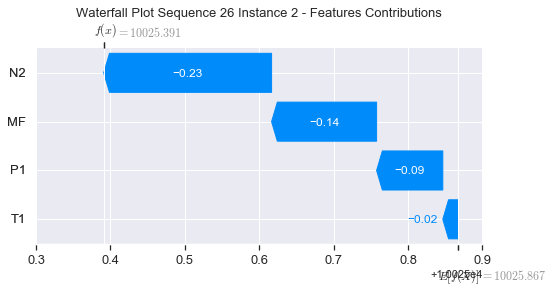

None

Contribution: [0.37024584 0.3143991  1.14017803 1.11292506]


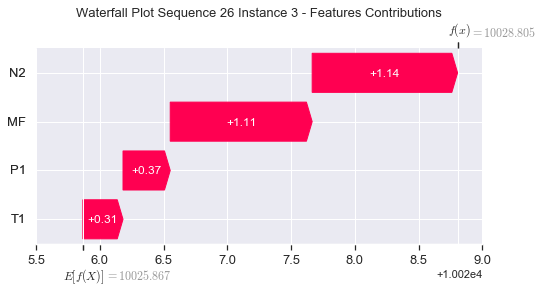

None

Contribution: [0.1043594  0.07519218 0.32544005 0.30858788]


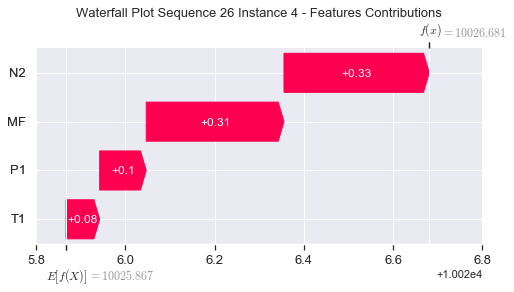

None

Contribution: [0.08498162 0.0773704  0.26602866 0.24631302]


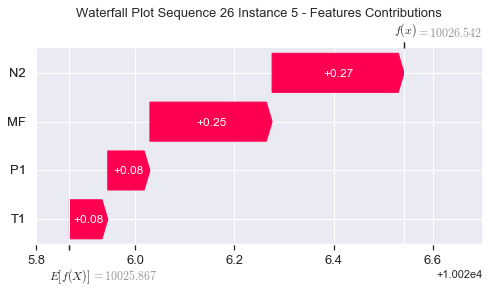

None

Contribution: [0.07331496 0.06676389 0.23209631 0.21417613]


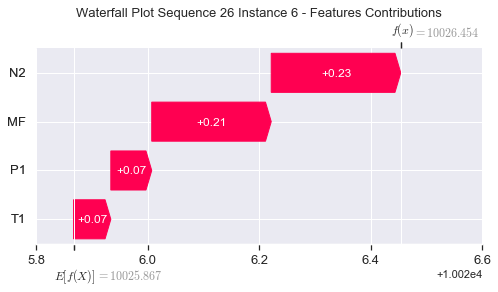

None

Contribution: [0.06862517 0.06262054 0.21697283 0.20059763]


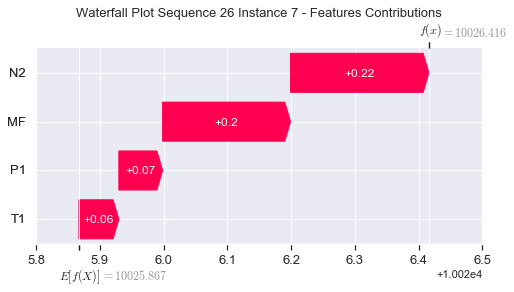

None

Contribution: [0.06538688 0.05982936 0.20656007 0.19079073]


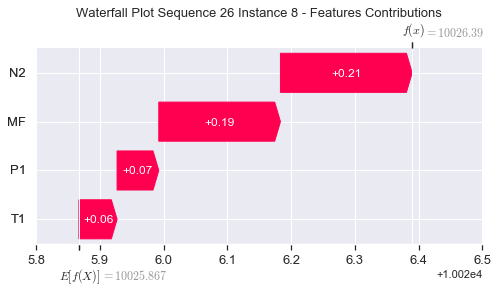

None

Contribution: [0.06305379 0.05808805 0.198507   0.18326391]


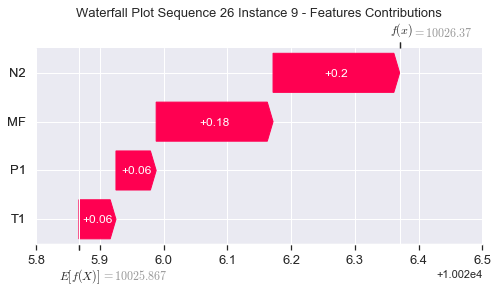

None

Contribution: [0.06081426 0.05580408 0.19172312 0.17793898]


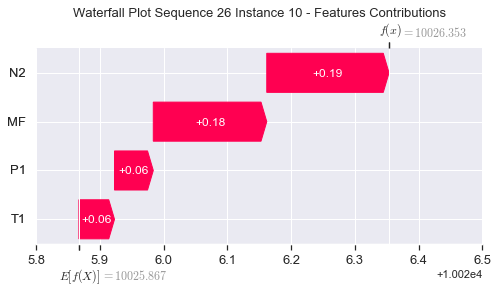

None

Contribution: [0.05913475 0.05372858 0.1856105  0.17109149]


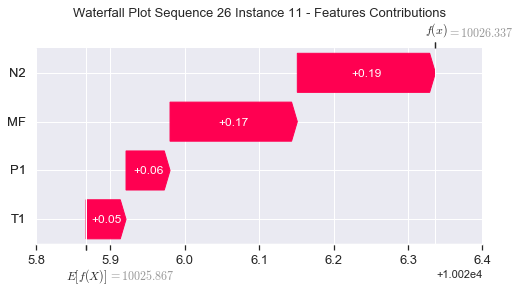

None

Contribution: [0.05793359 0.05193662 0.18011473 0.16794067]


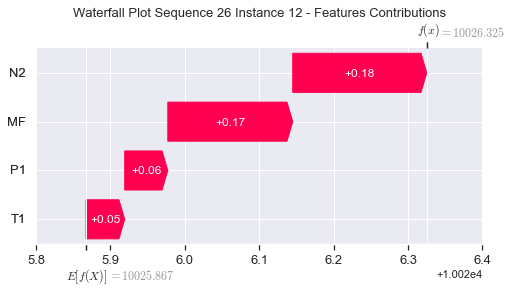

None

Contribution: [0.05645413 0.05100779 0.17587519 0.16392324]


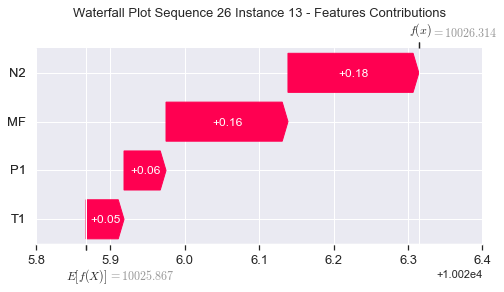

None

Contribution: [0.05453987 0.04969504 0.17127302 0.15917172]


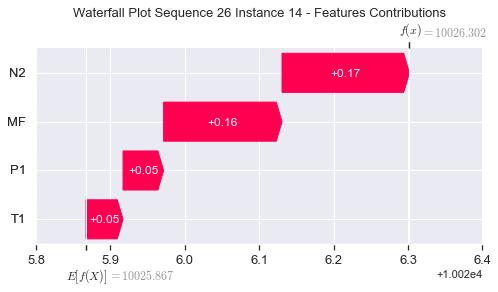

None

Contribution: [0.05352922 0.04858777 0.16793293 0.15640635]


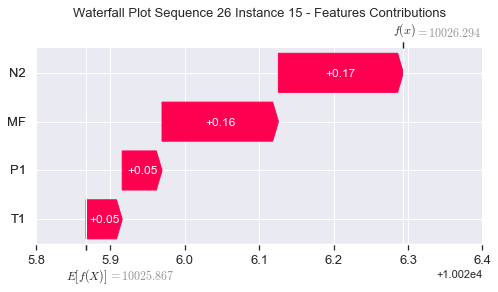

None

Contribution: [0.05193986 0.04869599 0.16458287 0.15316773]


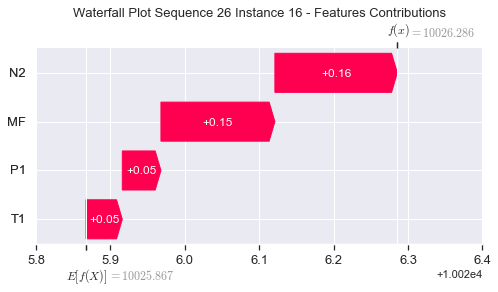

None

Contribution: [0.05131659 0.0469968  0.16174894 0.15057129]


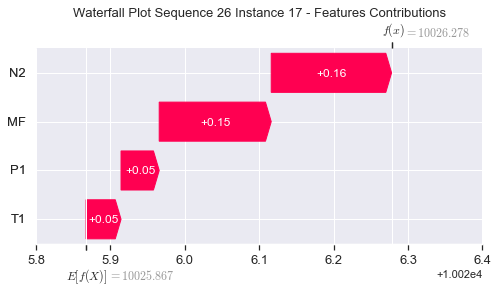

None

Contribution: [0.05030618 0.04623537 0.15917274 0.14794912]


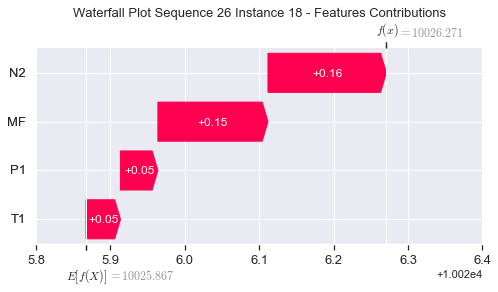

None

Contribution: [0.05005698 0.04671964 0.15815867 0.14695353]


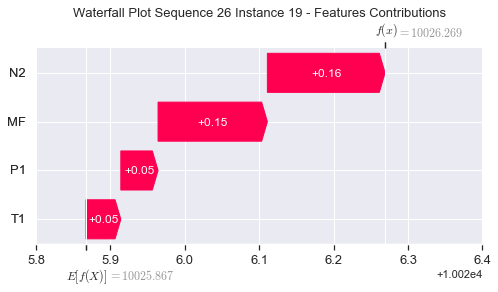

None

Contribution: [0.05039397 0.04713591 0.16053191 0.14890843]


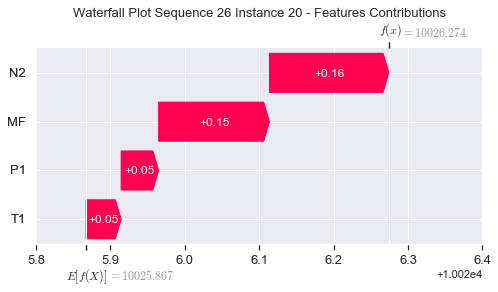

None

Contribution: [0.05539968 0.05199472 0.17632688 0.16379771]


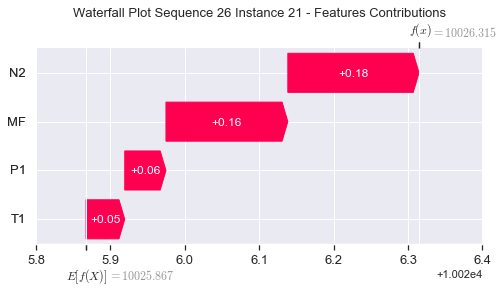

None

Contribution: [0.07667034 0.07045067 0.24449347 0.22859279]


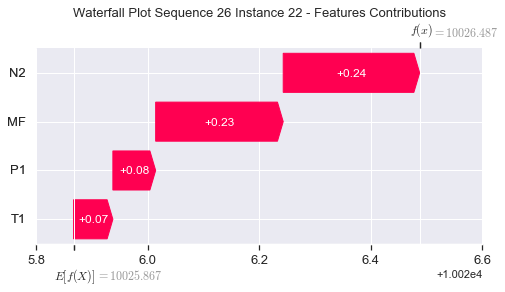

None

Contribution: [0.16325555 0.10069431 0.53349065 0.51912414]


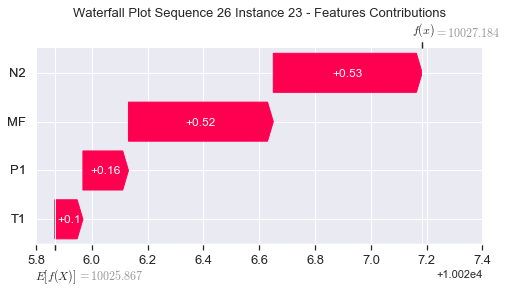

None

Contribution: [ 0.59169374 -0.58947102  1.96417728  2.18014241]


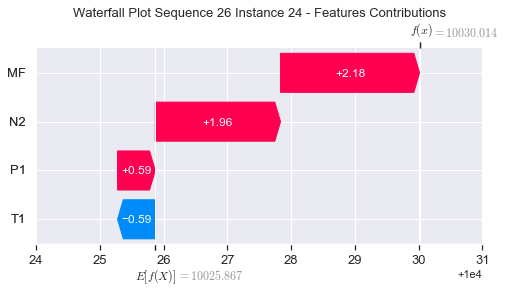

None

Contribution: [19.877609    8.17107748 67.71048531 66.81747302]


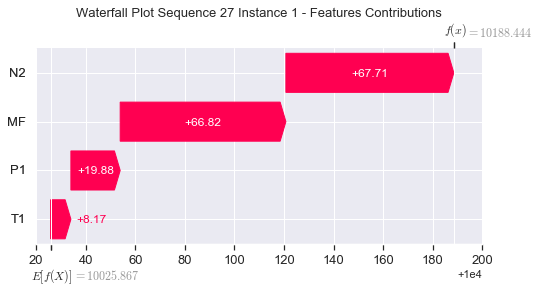

None

Contribution: [-0.07715371 -0.0700431  -0.24817216 -0.11686865]


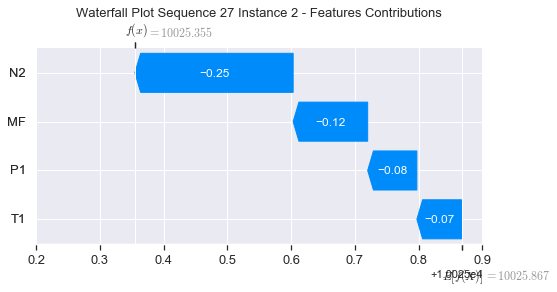

None

Contribution: [0.37121198 0.26394589 1.14650019 1.14893481]


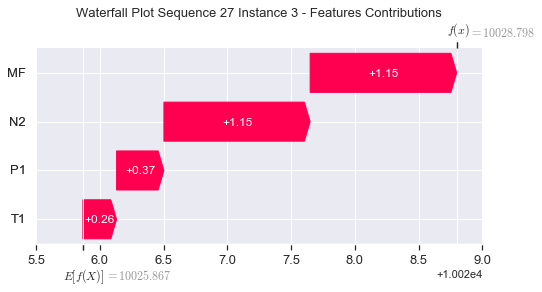

None

Contribution: [0.10586461 0.07329722 0.32750893 0.31595863]


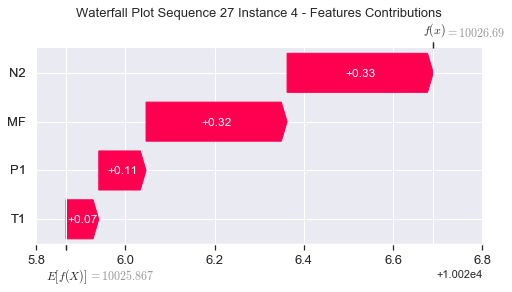

None

Contribution: [0.08331726 0.07145518 0.26559695 0.24419591]


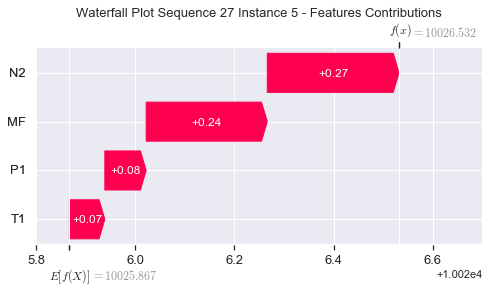

None

Contribution: [0.0737874  0.06437478 0.23245565 0.21517514]


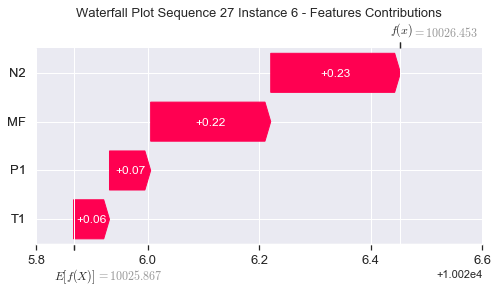

None

Contribution: [0.06893275 0.06073719 0.21720279 0.20087899]


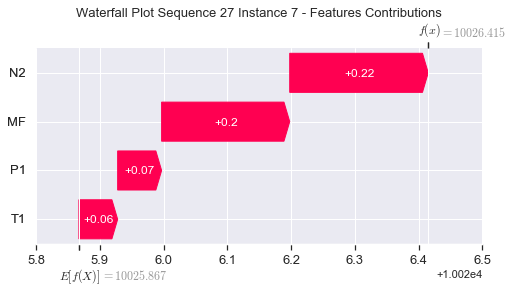

None

Contribution: [0.06547331 0.05784153 0.20674321 0.19105437]


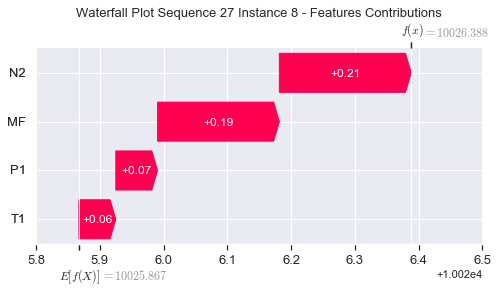

None

Contribution: [0.06256108 0.05664869 0.19857047 0.18242964]


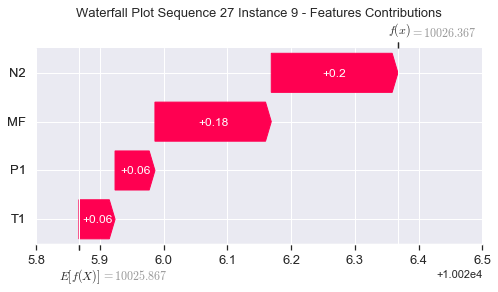

None

Contribution: [0.06038342 0.05409186 0.1915721  0.17604374]


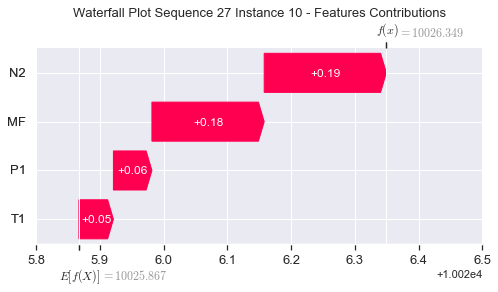

None

Contribution: [0.05834398 0.05135512 0.18549882 0.17042274]


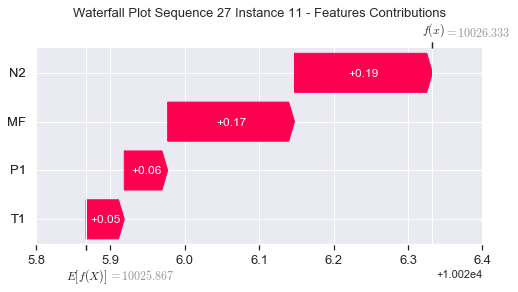

None

Contribution: [0.05635025 0.04944184 0.17938681 0.16468763]


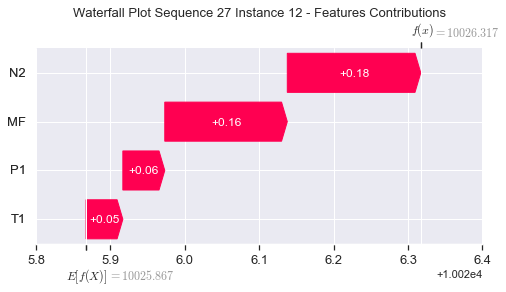

None

Contribution: [0.05507168 0.04894303 0.17528171 0.16103304]


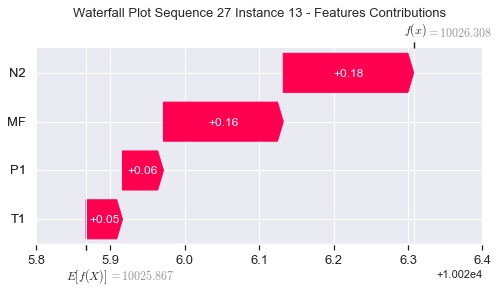

None

Contribution: [0.05375001 0.04890272 0.17125066 0.15832307]


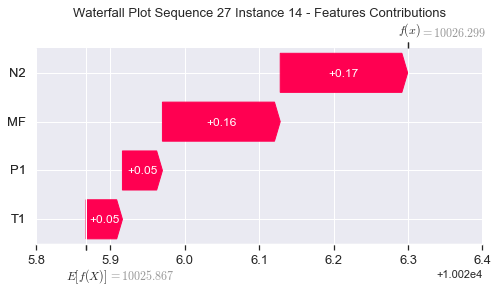

None

Contribution: [0.05270223 0.04769227 0.16766432 0.15449925]


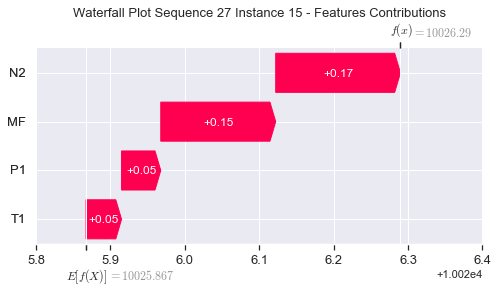

None

Contribution: [0.05208871 0.04844125 0.16471623 0.15251903]


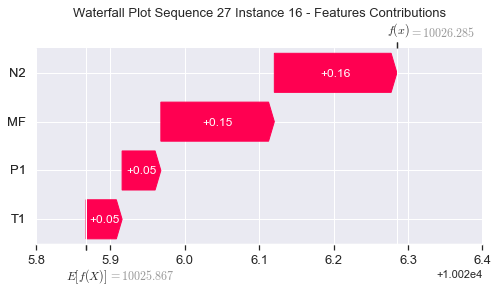

None

Contribution: [0.05102678 0.04720777 0.1617634  0.14959016]


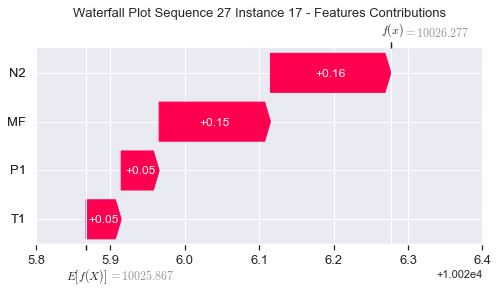

None

Contribution: [0.05031992 0.04688204 0.15935709 0.14767966]


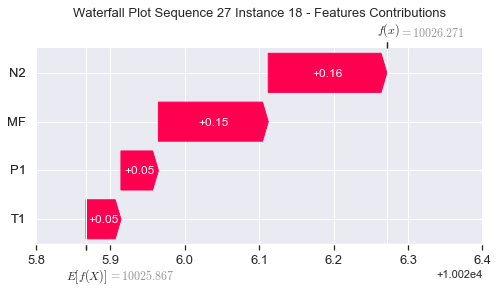

None

Contribution: [0.04993423 0.04647106 0.15805869 0.14527599]


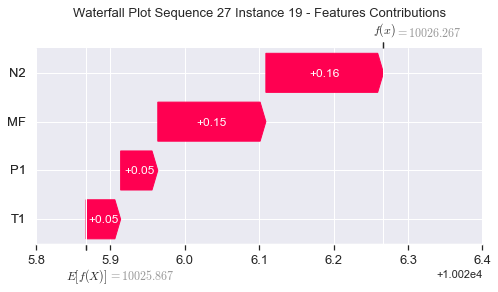

None

Contribution: [0.05067166 0.04842889 0.16093037 0.14931575]


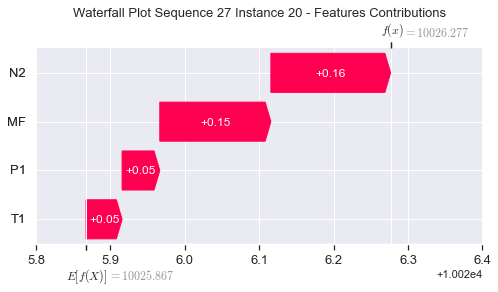

None

Contribution: [0.05523096 0.05306989 0.17658973 0.16353158]


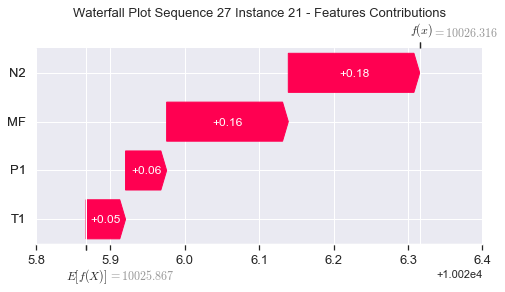

None

Contribution: [0.07566324 0.07153927 0.24459481 0.22711526]


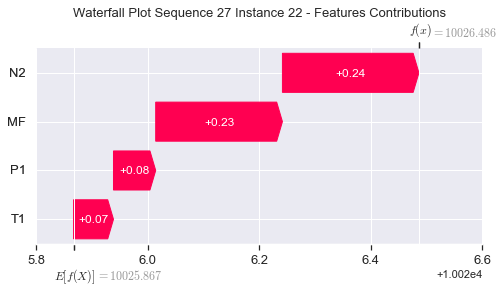

None

Contribution: [0.1611483  0.10939197 0.53280947 0.51619611]


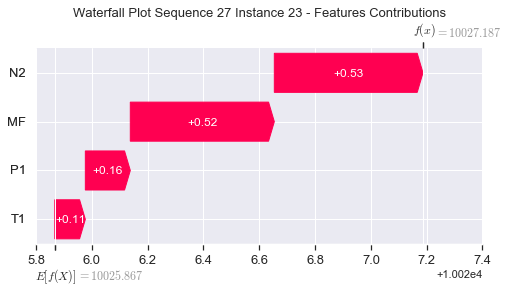

None

Contribution: [ 0.57763727 -0.42935604  1.95405862  2.19768319]


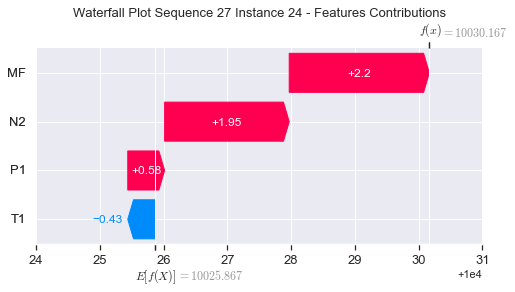

None

Contribution: [18.56706448 11.67357626 67.28337433 65.54884041]


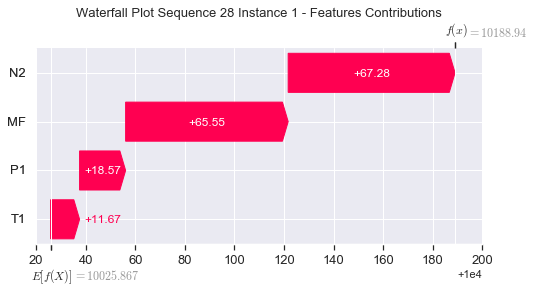

None

Contribution: [-0.12764094 -0.08514845 -0.24807342 -0.20112001]


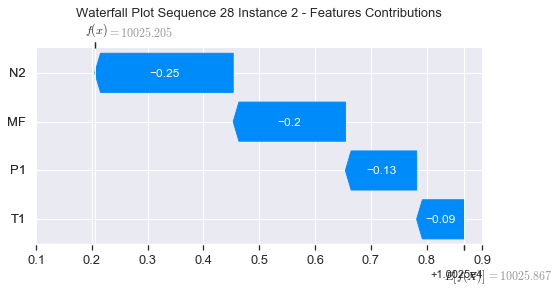

None

Contribution: [0.33164387 0.27442968 1.13524496 1.05153316]


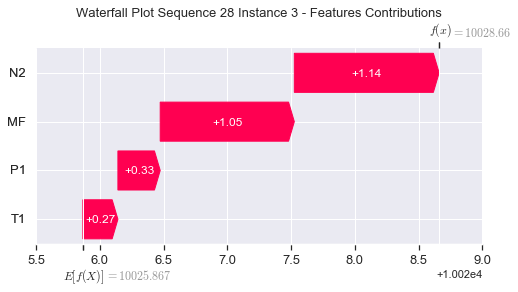

None

Contribution: [0.10594343 0.07369184 0.32558719 0.31270277]


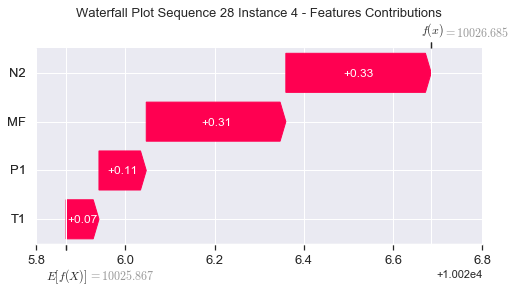

None

Contribution: [0.08690884 0.07565702 0.26680932 0.25053813]


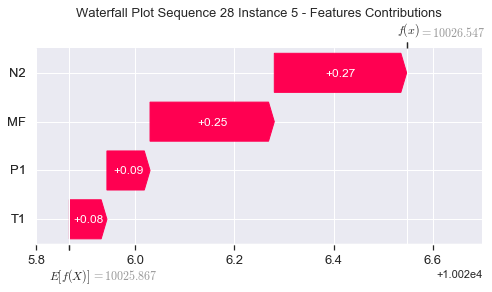

None

Contribution: [0.07464829 0.06962859 0.23263019 0.21678166]


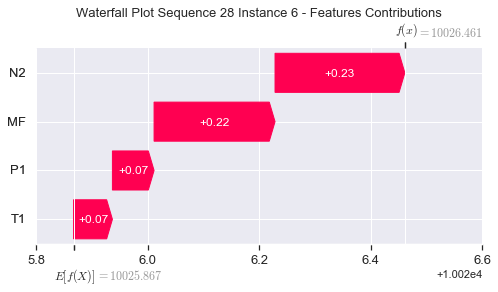

None

Contribution: [0.06913732 0.06685167 0.21754898 0.20271815]


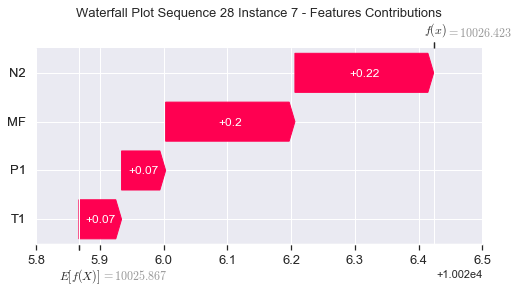

None

Contribution: [0.06646661 0.06167966 0.20711054 0.19287745]


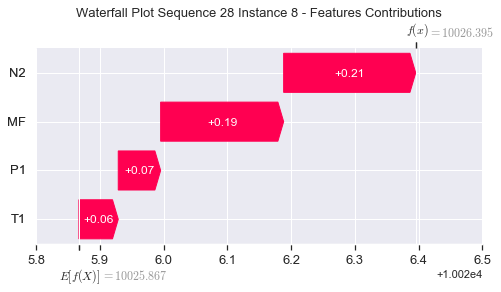

None

Contribution: [0.06360693 0.06404361 0.20016843 0.1862254 ]


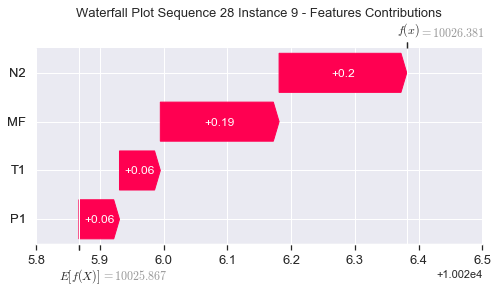

None

Contribution: [0.06314886 0.0607078  0.19327608 0.18201908]


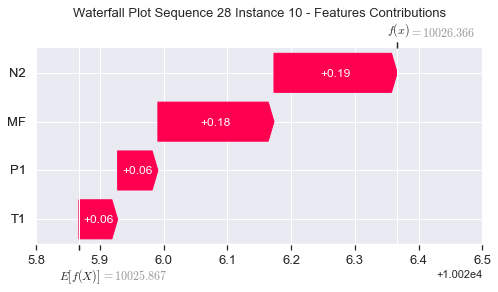

None

Contribution: [0.06082274 0.0542148  0.18636196 0.17250401]


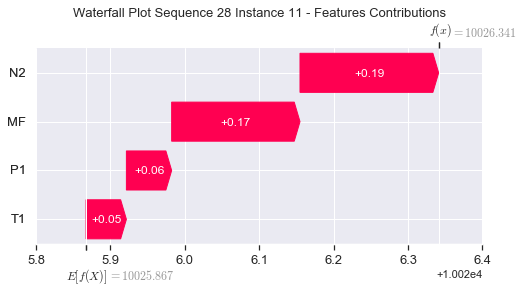

None

Contribution: [0.05798373 0.05077906 0.18004293 0.16785243]


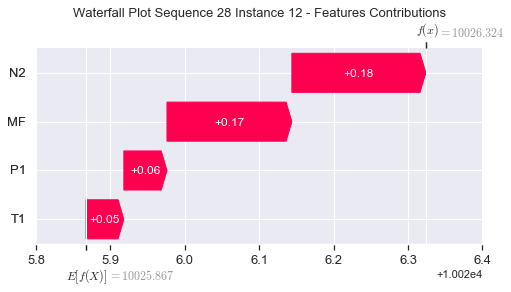

None

Contribution: [0.05658582 0.04973705 0.17594533 0.1641209 ]


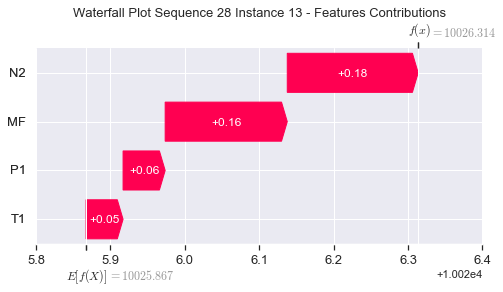

None

Contribution: [0.05373107 0.04698826 0.17085447 0.1563871 ]


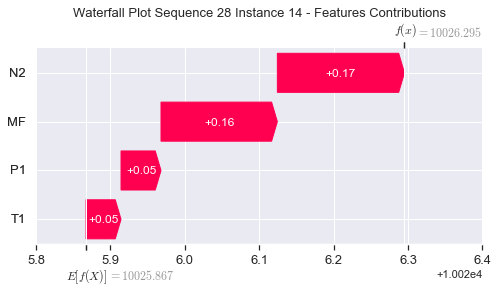

None

Contribution: [0.05418516 0.04583675 0.1679062  0.15608213]


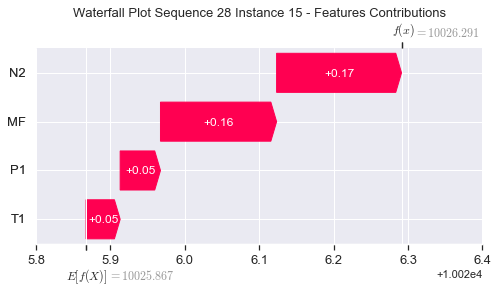

None

Contribution: [0.05400271 0.04690493 0.16517672 0.15518159]


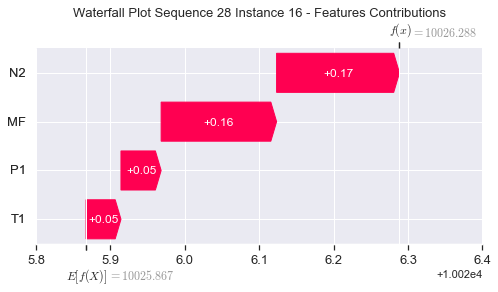

None

Contribution: [0.05218058 0.04388477 0.16189746 0.15050043]


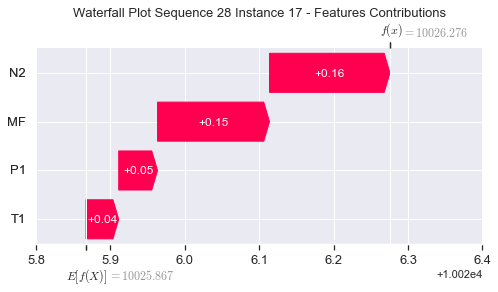

None

Contribution: [0.05164399 0.04172977 0.15929801 0.14791121]


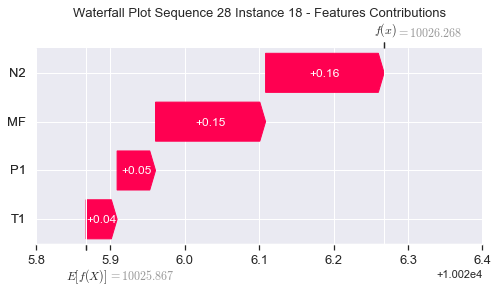

None

Contribution: [0.05012833 0.04022517 0.15817042 0.14692404]


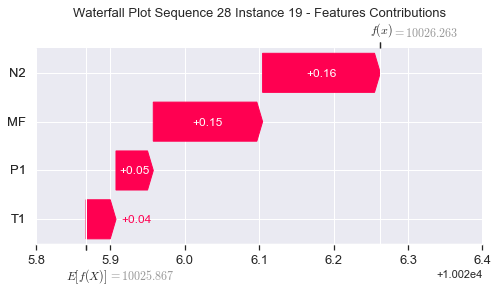

None

Contribution: [0.05250572 0.04015306 0.16090876 0.14946011]


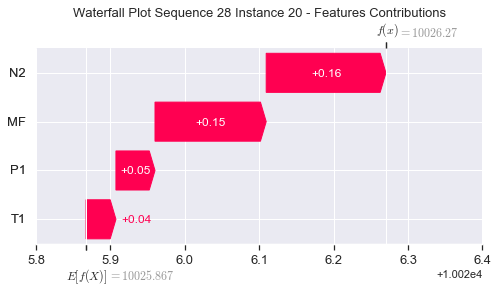

None

Contribution: [0.05801759 0.04229069 0.17679775 0.16434481]


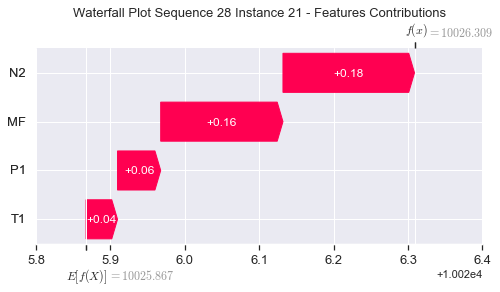

None

Contribution: [0.08184366 0.04996274 0.24538845 0.22935061]


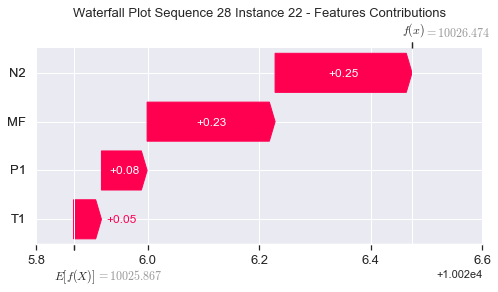

None

Contribution: [0.18860443 0.00321838 0.53634018 0.52068994]


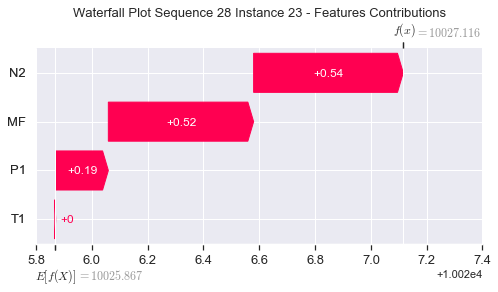

None

Contribution: [ 1.21053118 -2.27955512  2.05264244  2.59705208]


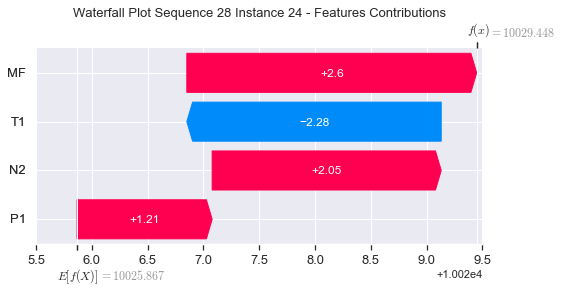

None

Contribution: [ 39.32039781 -26.77225101  71.79601708  90.01568741]


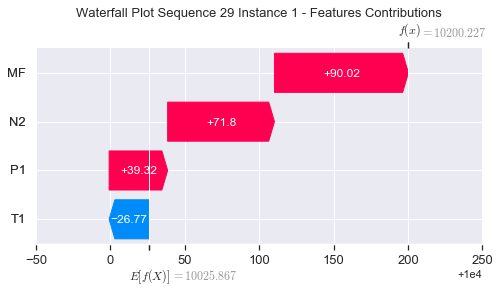

None

Contribution: [ 0.01496893 -0.4480919  -0.19041297 -0.0735313 ]


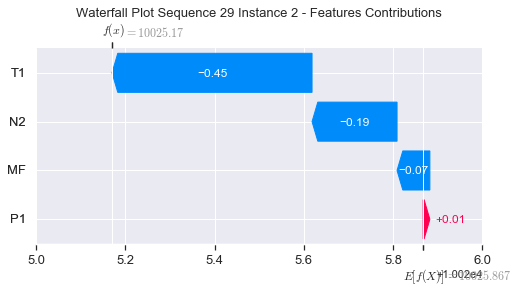

None

Contribution: [ 0.44416716 -0.0418298   1.14990913  1.1303619 ]


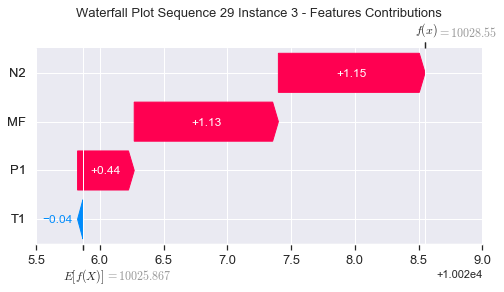

None

Contribution: [ 0.13260164 -0.00272371  0.33197673  0.33497155]


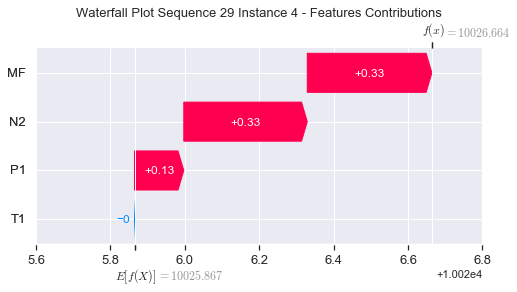

None

Contribution: [0.09197469 0.04148635 0.26588068 0.24525573]


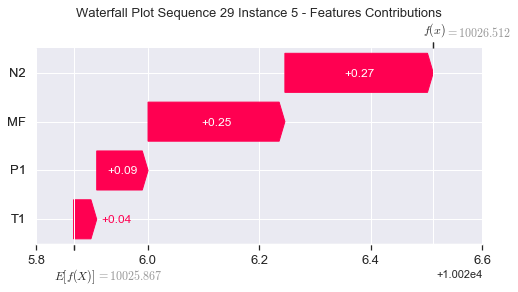

None

Contribution: [0.08504702 0.03431889 0.23393213 0.22142862]


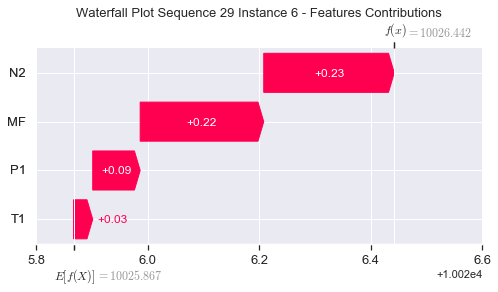

None

Contribution: [0.0794951  0.03147145 0.21843526 0.20681124]


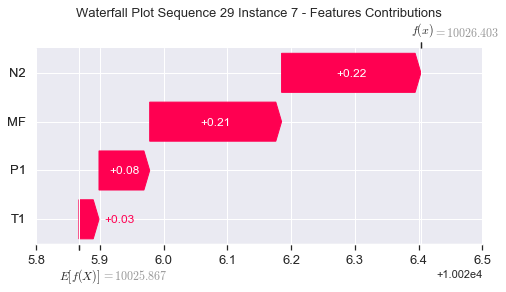

None

Contribution: [0.07461298 0.03186723 0.20785824 0.1959426 ]


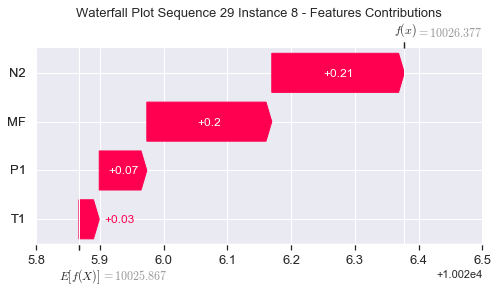

None

Contribution: [0.07091798 0.02856581 0.19906128 0.18604607]


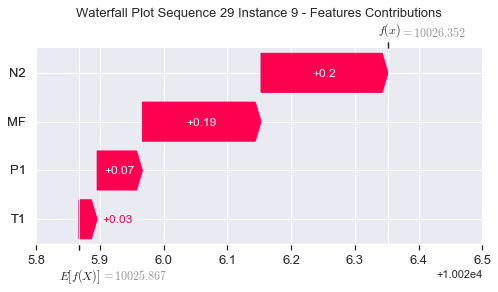

None

Contribution: [0.06333004 0.02812868 0.19074866 0.17467558]


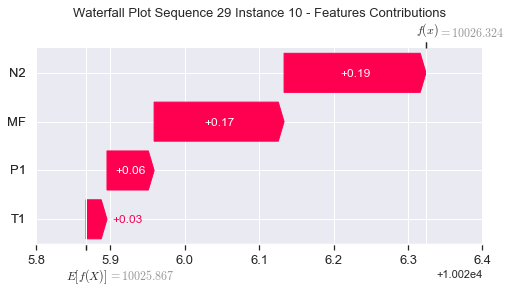

None

Contribution: [0.06708142 0.02771763 0.18708963 0.1769962 ]


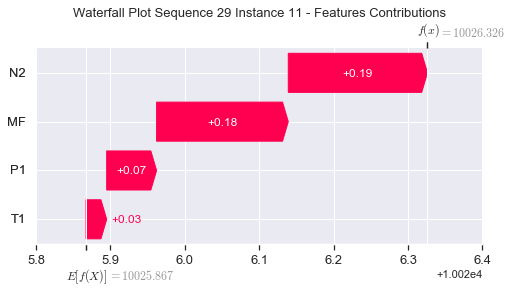

None

Contribution: [0.06603107 0.02625451 0.18139208 0.17402381]


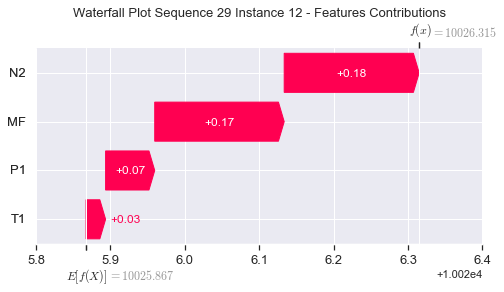

None

Contribution: [0.06359053 0.02706323 0.17687903 0.16860922]


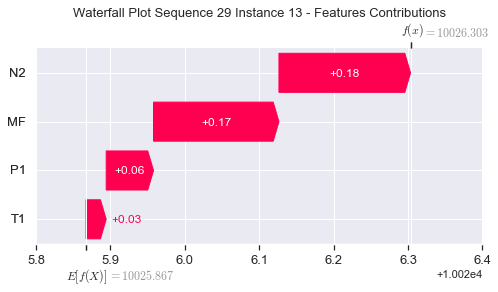

None

Contribution: [0.06541699 0.02811262 0.17352466 0.16726567]


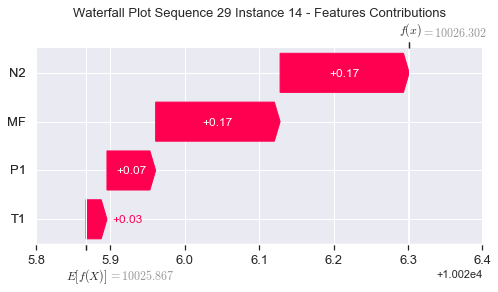

None

Contribution: [0.0602552  0.02846423 0.16912754 0.16087979]


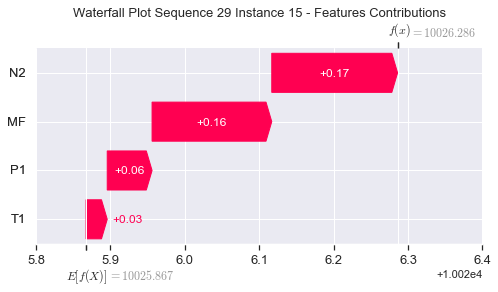

None

Contribution: [0.06004996 0.02374559 0.16595016 0.159015  ]


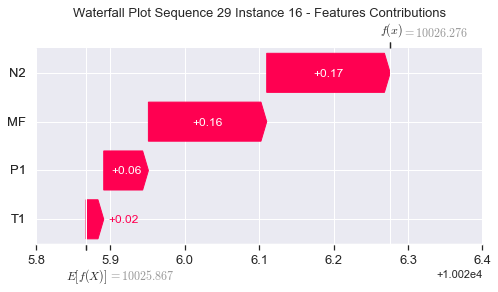

None

Contribution: [0.05712072 0.02973044 0.16287823 0.15436729]


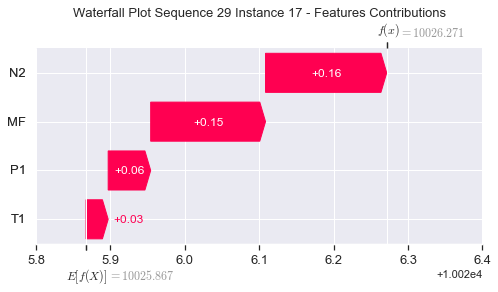

None

Contribution: [0.05560679 0.0313135  0.16040523 0.15168339]


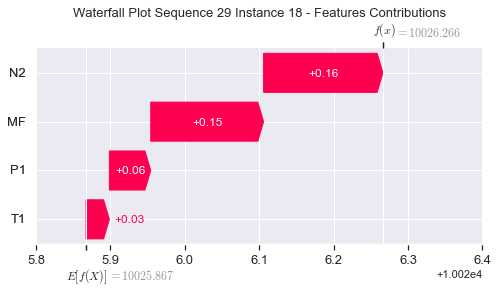

None

Contribution: [0.05210085 0.03770413 0.158355   0.14636569]


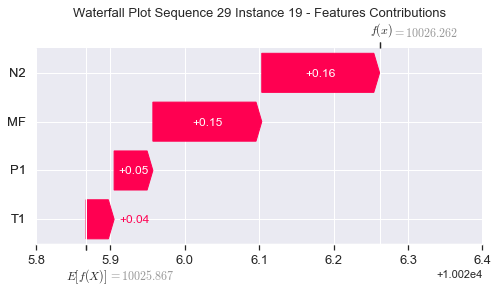

None

Contribution: [0.05293651 0.03649309 0.1611605  0.14923851]


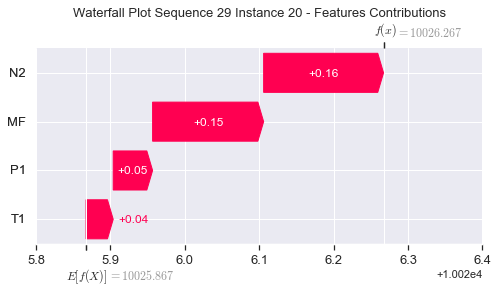

None

Contribution: [0.05733199 0.04100222 0.17687723 0.1634845 ]


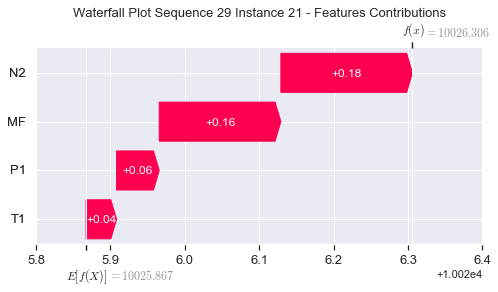

None

Contribution: [0.07755382 0.05581028 0.24501494 0.22605154]


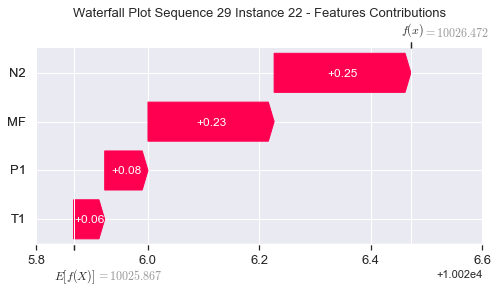

None

Contribution: [0.17332421 0.03762403 0.53722739 0.51869232]


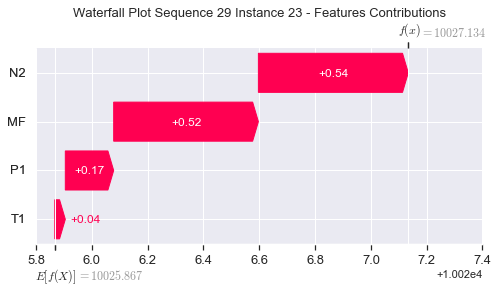

None

Contribution: [ 0.5784069  -1.02742067  2.00538852  2.08691139]


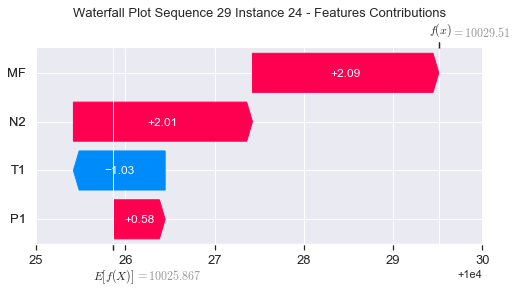

None

Contribution: [19.03124224  5.56849624 69.34053776 69.07719006]


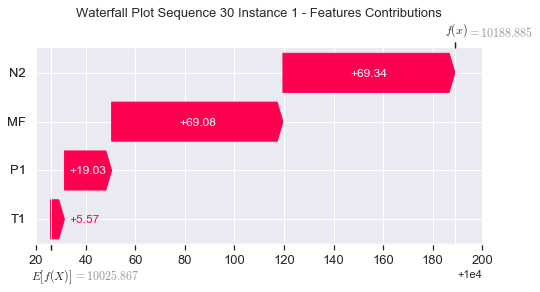

None

Contribution: [-0.13271782 -0.22105908 -0.22886228 -0.19523506]


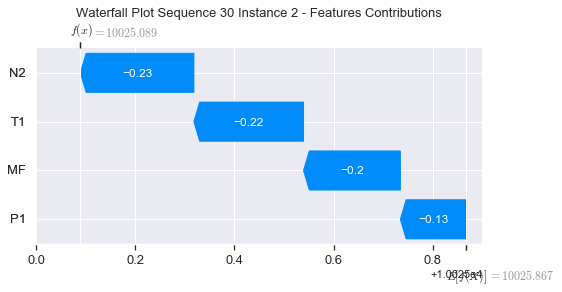

None

Contribution: [0.3498071  0.18367536 1.14471377 1.0652442 ]


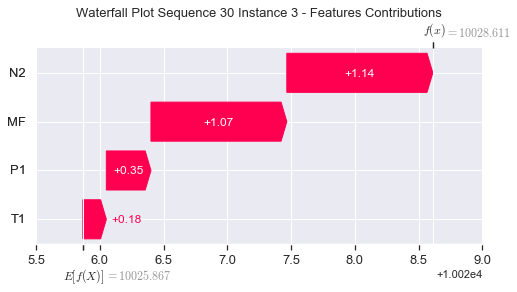

None

Contribution: [0.09195107 0.04428143 0.32612651 0.29799103]


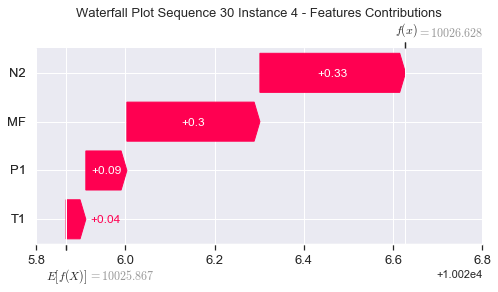

None

Contribution: [0.0850941  0.07505671 0.26712824 0.24703638]


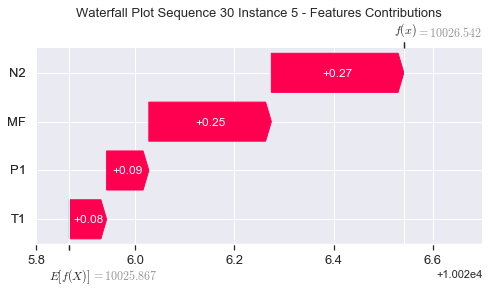

None

Contribution: [0.07373121 0.064751   0.23289035 0.21443673]


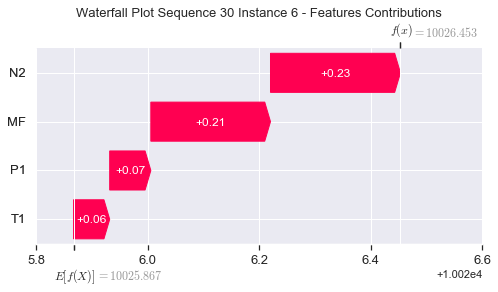

None

Contribution: [0.06882595 0.06073174 0.21749374 0.20016881]


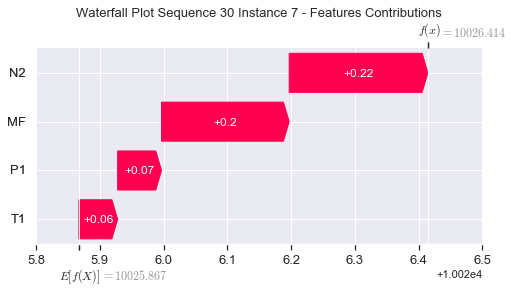

None

Contribution: [0.06550157 0.05814276 0.20710964 0.19059577]


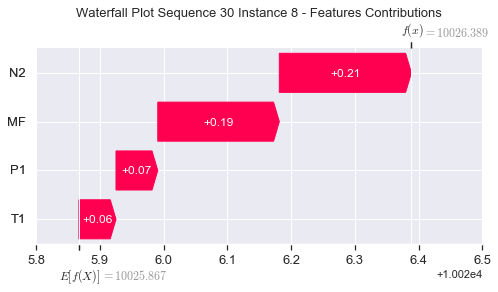

None

Contribution: [0.06318637 0.05798296 0.19897506 0.18359472]


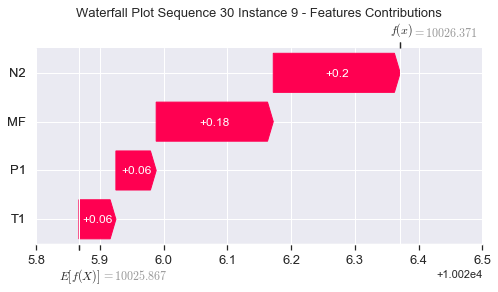

None

Contribution: [0.06129742 0.05435813 0.19214381 0.17625571]


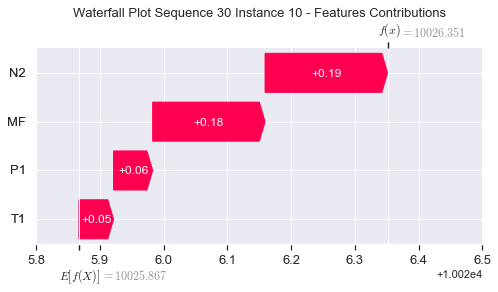

None

Contribution: [0.05844477 0.05309786 0.18612032 0.17104723]


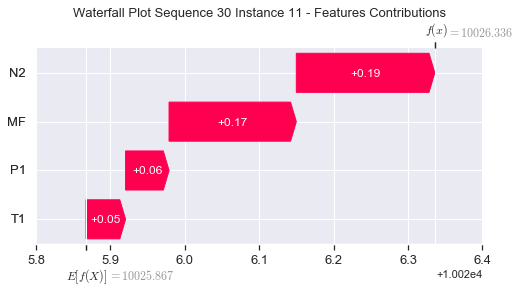

None

Contribution: [0.05620908 0.0494451  0.17993659 0.16469552]


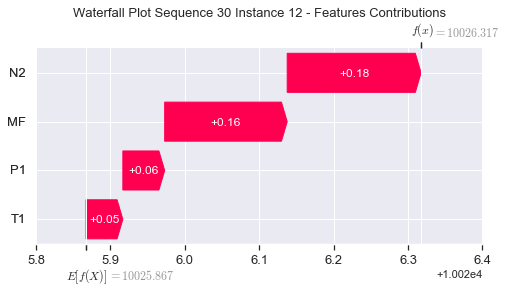

None

Contribution: [0.05502737 0.04871915 0.17573095 0.16094748]


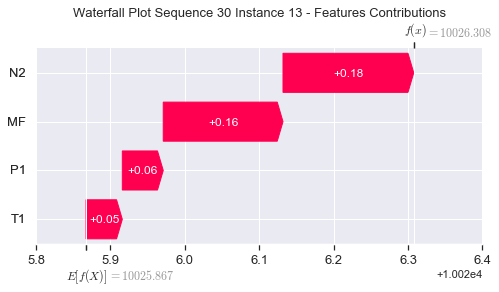

None

Contribution: [0.05381941 0.04586413 0.17077983 0.1544798 ]


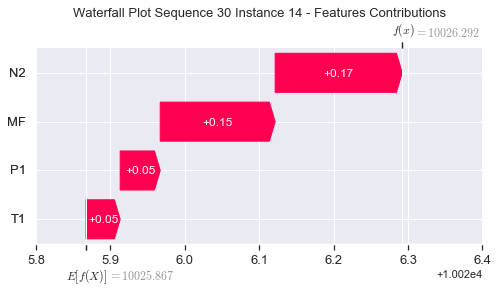

None

Contribution: [0.05250498 0.04679845 0.16796306 0.15373596]


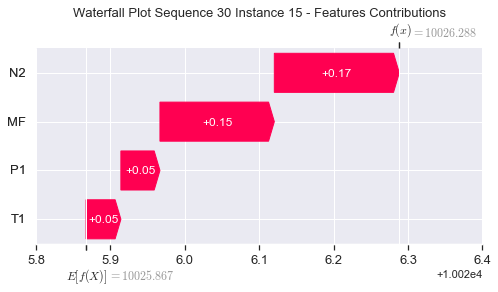

None

Contribution: [0.05238577 0.04656604 0.16520608 0.15325363]


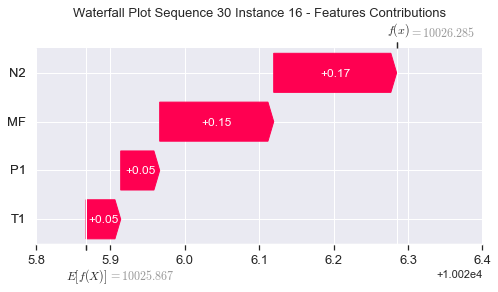

None

Contribution: [0.05054071 0.04538155 0.16172792 0.14796867]


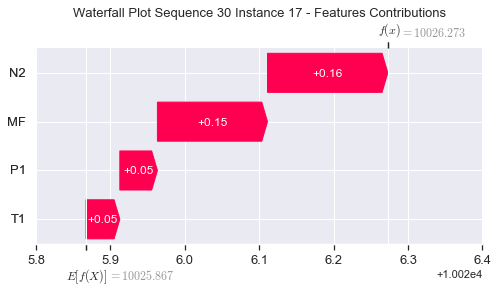

None

Contribution: [0.0496979  0.0447177  0.15922624 0.14560584]


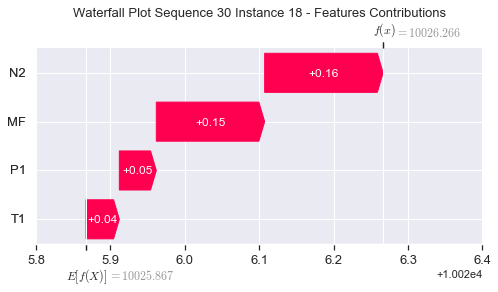

None

Contribution: [0.05005662 0.04623982 0.15854718 0.14589762]


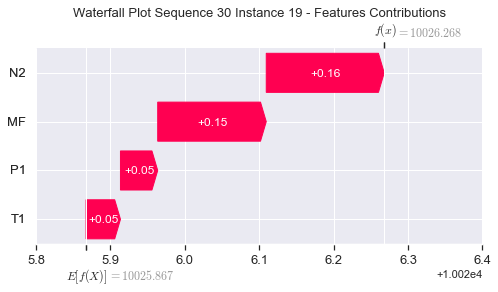

None

Contribution: [0.05020884 0.04609701 0.16073554 0.14717886]


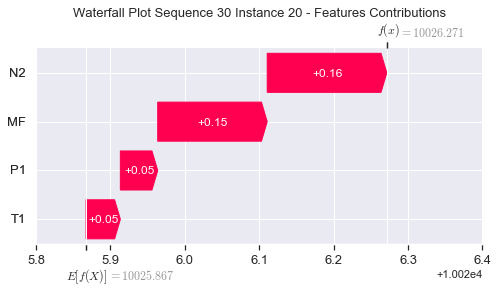

None

Contribution: [0.05487018 0.05072712 0.17655157 0.1615101 ]


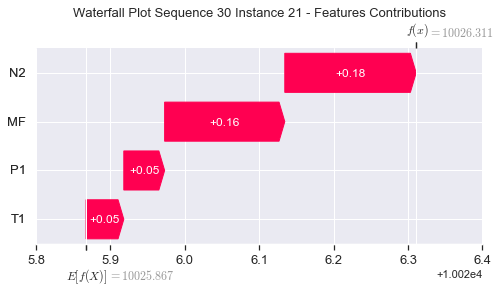

None

Contribution: [0.07540027 0.06842951 0.24491855 0.22453854]


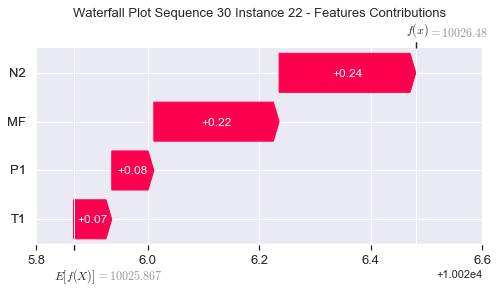

None

Contribution: [0.15732681 0.08979404 0.53343112 0.49835328]


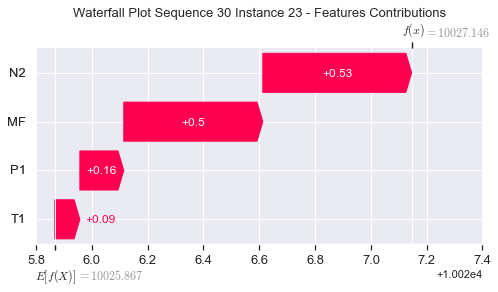

None

Contribution: [ 0.60451986 -0.64347604  1.98455585  2.0986929 ]


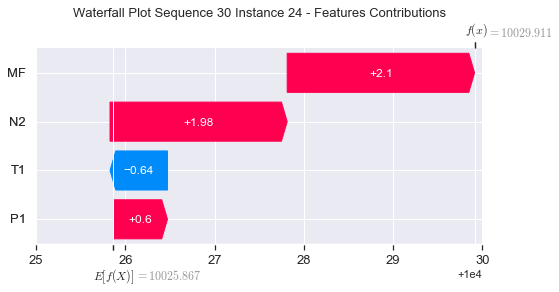

None

Contribution: [22.00601948 10.04774913 68.44105727 70.30802294]


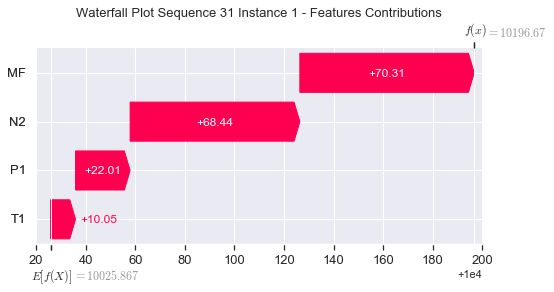

None

Contribution: [-0.11180465 -0.09316962 -0.21490986 -0.18949954]


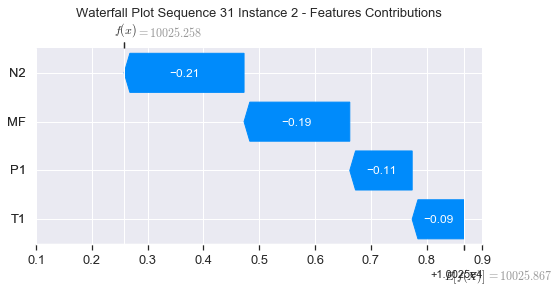

None

Contribution: [0.34543901 0.28365784 1.14730177 1.065978  ]


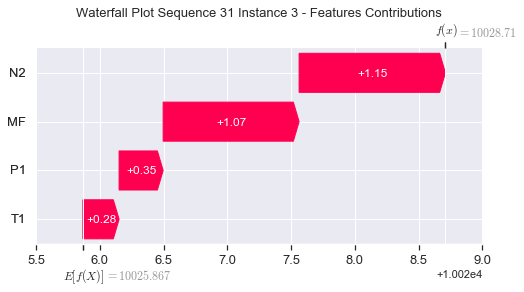

None

Contribution: [0.09960846 0.07332913 0.32546375 0.30230609]


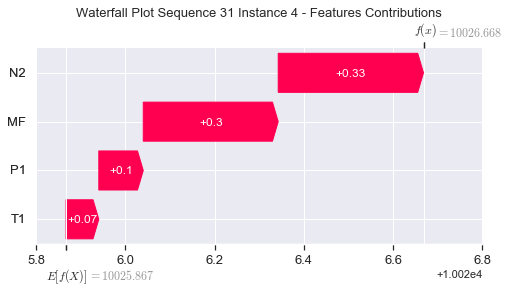

None

Contribution: [0.08488812 0.07487941 0.2677387  0.2471321 ]


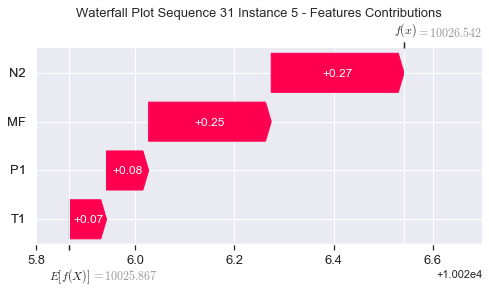

None

Contribution: [0.07273289 0.06535464 0.23286065 0.21280388]


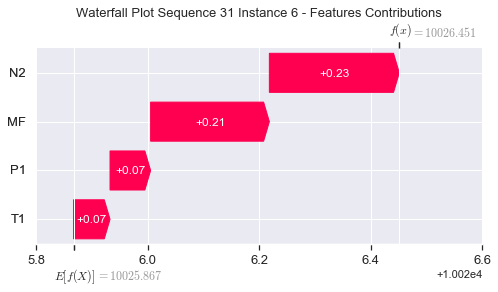

None

Contribution: [0.06814017 0.06128447 0.21749305 0.19868845]


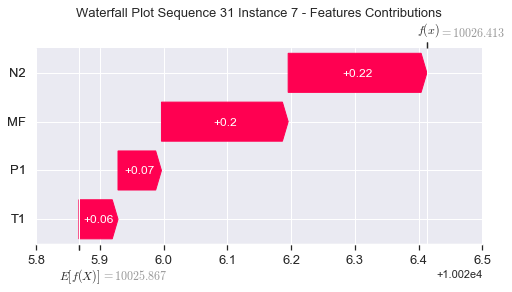

None

Contribution: [0.06518322 0.05853571 0.20722909 0.19001969]


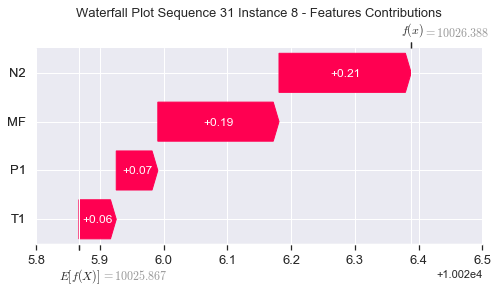

None

Contribution: [0.0647426  0.05691119 0.19959055 0.1860255 ]


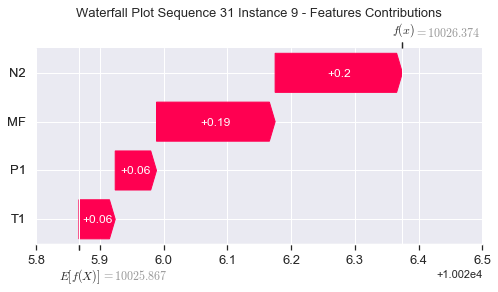

None

Contribution: [0.06138409 0.05602671 0.19207109 0.17687306]


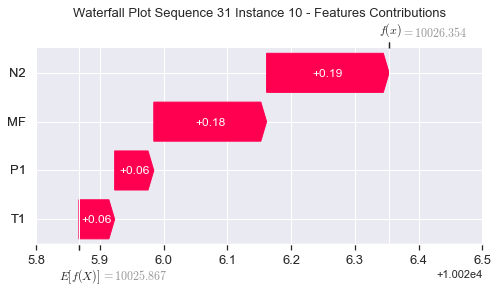

None

Contribution: [0.05947181 0.0529819  0.18630499 0.17295724]


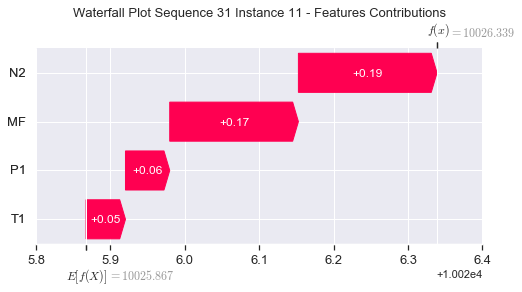

None

Contribution: [0.05587622 0.05029043 0.1795366  0.16349801]


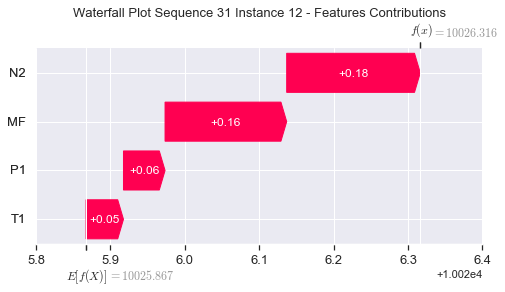

None

Contribution: [0.05488298 0.04935492 0.17548325 0.16015786]


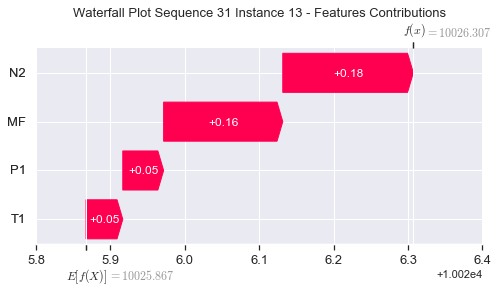

None

Contribution: [0.0533462  0.04637575 0.17118137 0.15766999]


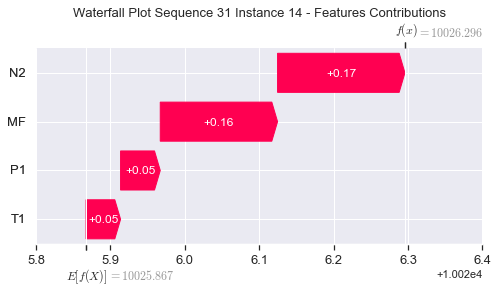

None

Contribution: [0.05229816 0.04737281 0.16765313 0.15318674]


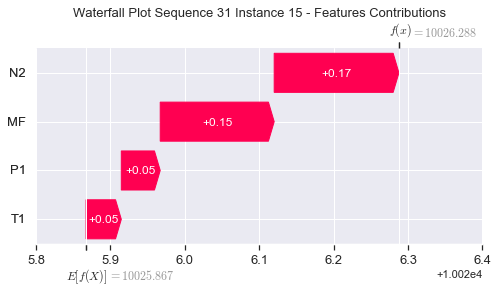

None

Contribution: [0.05206147 0.04880527 0.16520091 0.15293476]


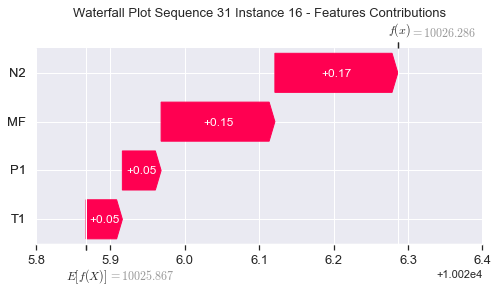

None

Contribution: [0.0506623  0.04585674 0.161545   0.14783237]


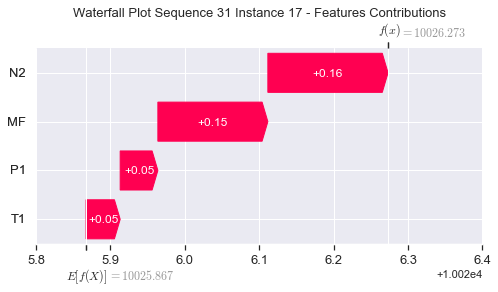

None

Contribution: [0.04983872 0.04518415 0.15905305 0.14563085]


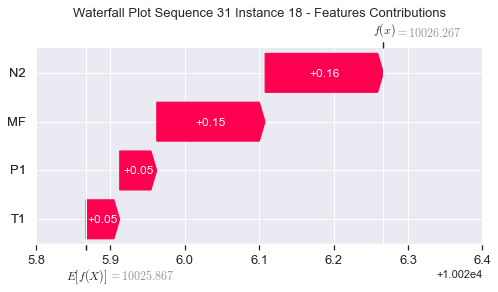

None

Contribution: [0.04914676 0.0448746  0.15834011 0.14312453]


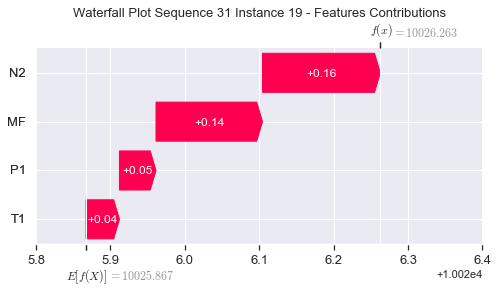

None

Contribution: [0.05090595 0.04617476 0.16083809 0.1482128 ]


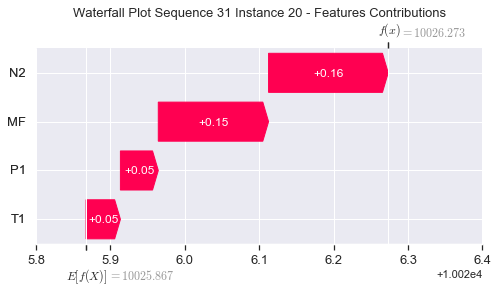

None

Contribution: [0.05575125 0.05078926 0.17658214 0.1629073 ]


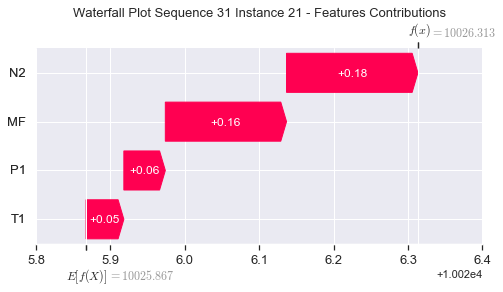

None

Contribution: [0.07693181 0.06849602 0.24487041 0.22726985]


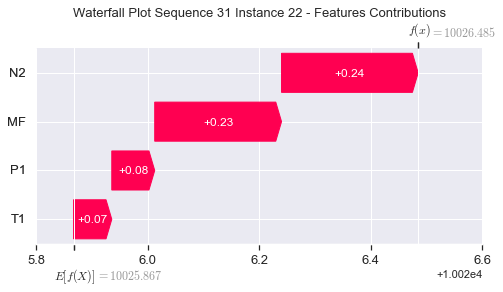

None

Contribution: [0.16373409 0.0922256  0.53410347 0.51068884]


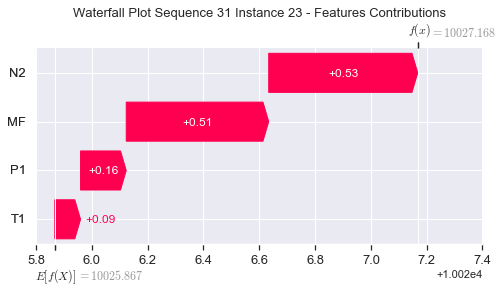

None

Contribution: [ 0.61186176 -0.76061498  1.99249684  2.13575856]


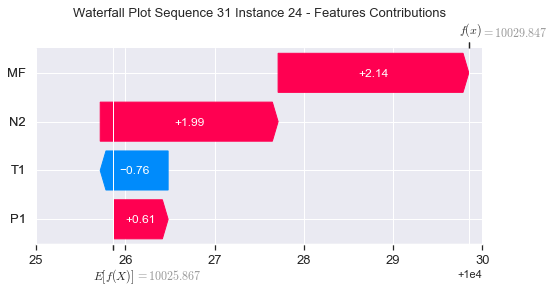

None

Contribution: [18.6674149   1.46865528 68.88756695 64.42103547]


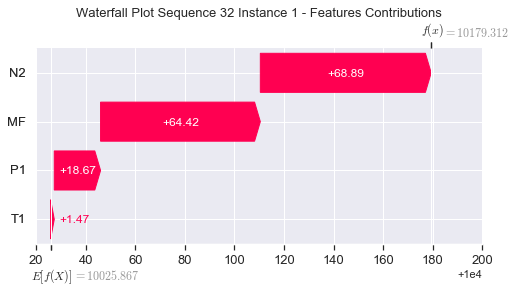

None

Contribution: [-0.09667421 -0.13388333 -0.26916013 -0.17358845]


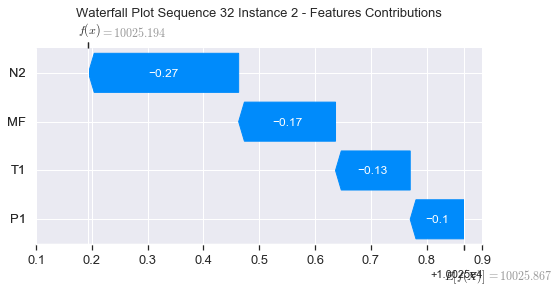

None

Contribution: [0.33601576 0.25993971 1.15436004 1.0751685 ]


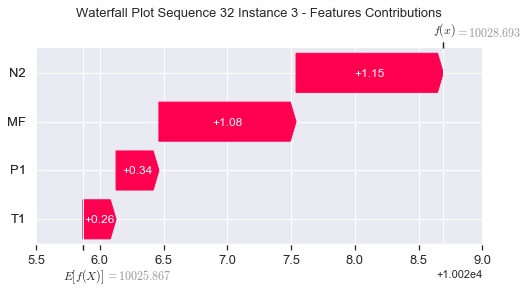

None

Contribution: [0.10506982 0.07070146 0.33311414 0.30835971]


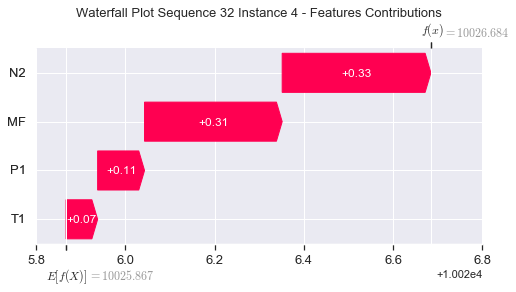

None

Contribution: [0.08696917 0.07406546 0.27066629 0.25276418]


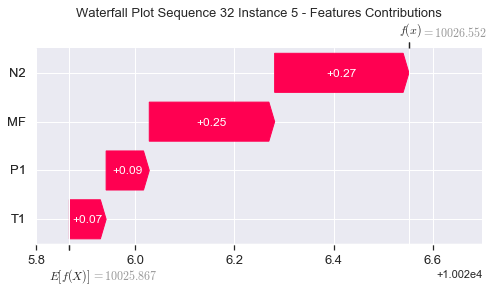

None

Contribution: [0.07530873 0.06428009 0.23558938 0.21896707]


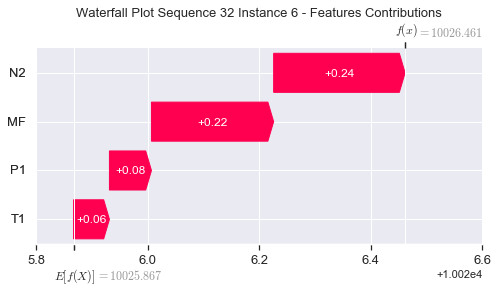

None

Contribution: [0.07022181 0.06036883 0.22003422 0.20464107]


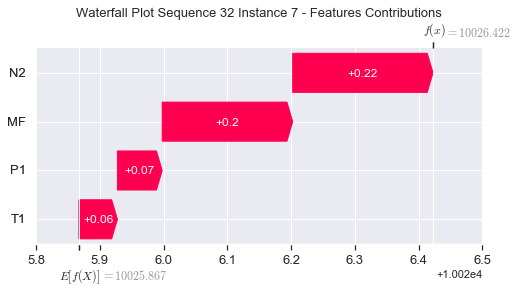

None

Contribution: [0.06658052 0.05751418 0.20929118 0.19417273]


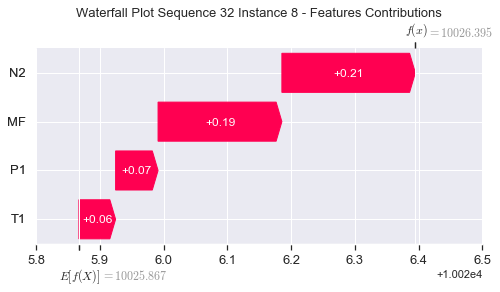

None

Contribution: [0.06191986 0.05654156 0.19946396 0.18306731]


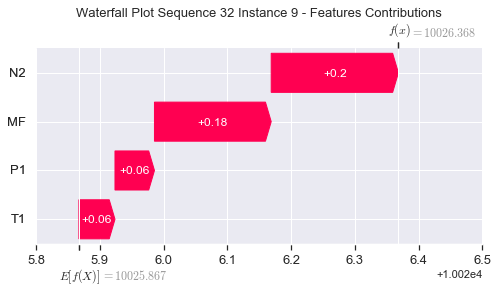

None

Contribution: [0.05864172 0.05445166 0.19129659 0.17419073]


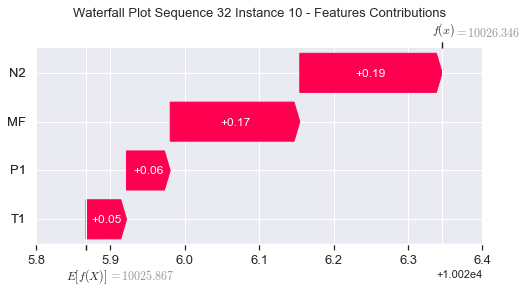

None

Contribution: [0.05807916 0.05214471 0.18657712 0.17110087]


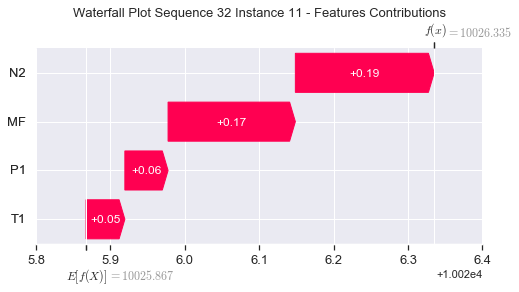

None

Contribution: [0.0580207  0.05060347 0.18219664 0.17000503]


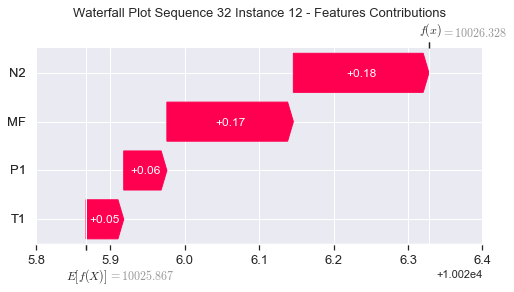

None

Contribution: [0.05654603 0.0494847  0.17789274 0.16579571]


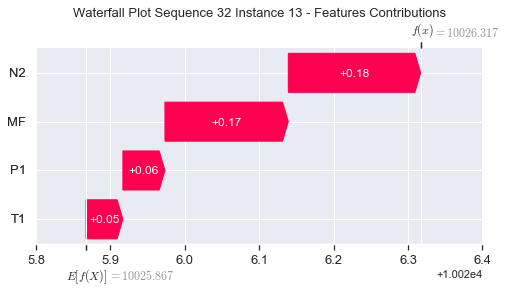

None

Contribution: [0.05424683 0.0504031  0.17323774 0.15949878]


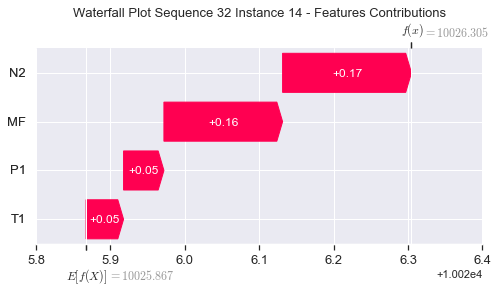

None

Contribution: [0.05355804 0.04649294 0.1697565  0.15739771]


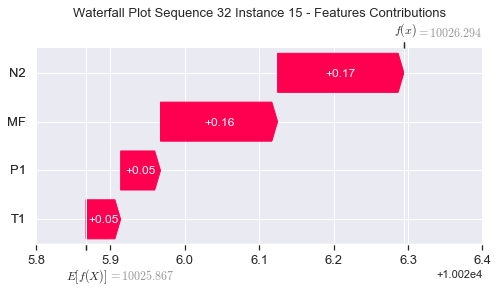

None

Contribution: [0.05138128 0.04493391 0.16582893 0.15157171]


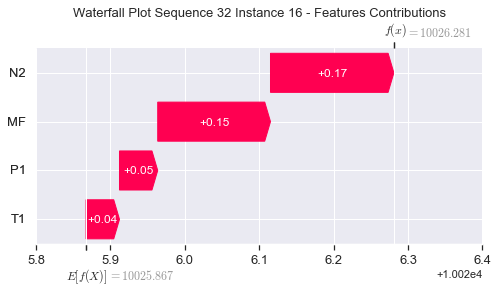

None

Contribution: [0.05143067 0.04478531 0.16345369 0.15131097]


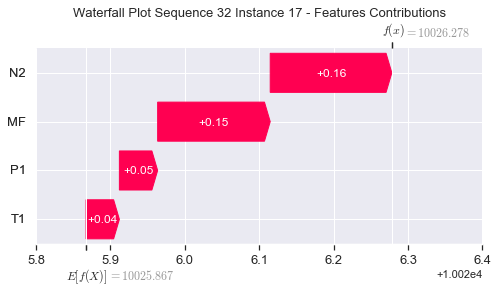

None

Contribution: [0.05051517 0.04375376 0.16086979 0.14861163]


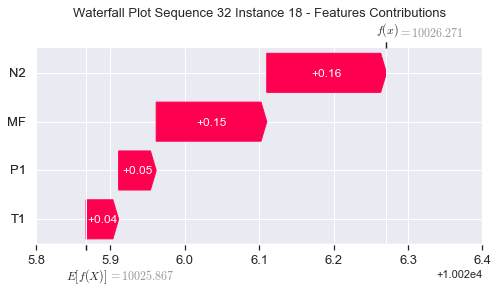

None

Contribution: [0.04746874 0.0404262  0.15834738 0.14474415]


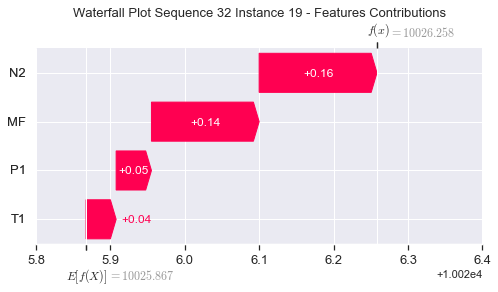

None

Contribution: [0.0506469  0.04381982 0.16231119 0.14935782]


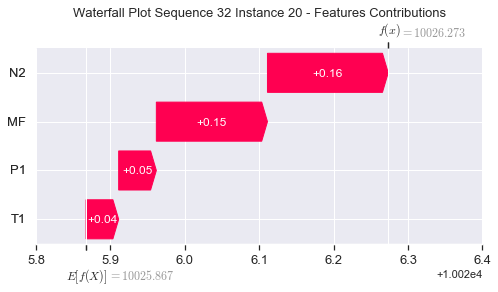

None

Contribution: [0.05555215 0.04841827 0.17843909 0.16427951]


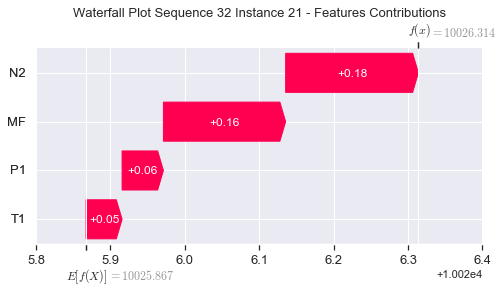

None

Contribution: [0.07656492 0.06408354 0.24797886 0.22893048]


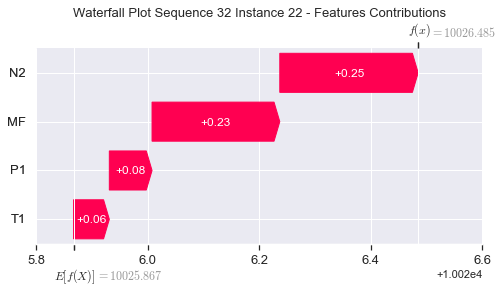

None

Contribution: [0.1622452  0.0688474  0.54584539 0.51676779]


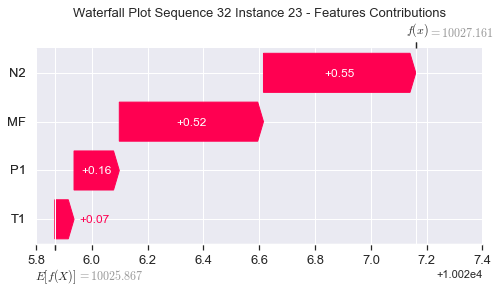

None

Contribution: [ 0.60514536 -1.00286248  2.11465643  2.14688601]


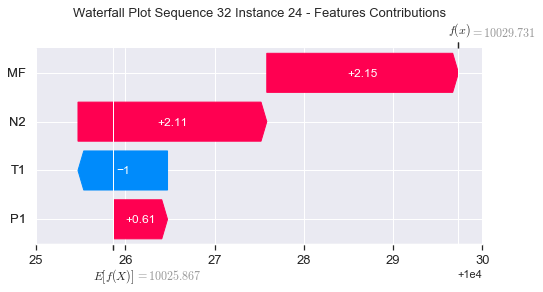

None

Contribution: [20.27087467  3.94793321 70.96001279 67.03159889]


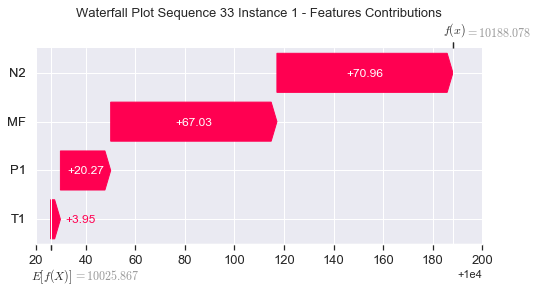

None

Contribution: [-0.10486543 -0.158081   -0.21016662 -0.14156335]


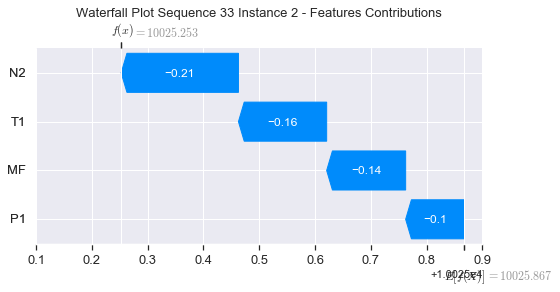

None

Contribution: [0.3315896  0.2160097  1.16338894 1.06414349]


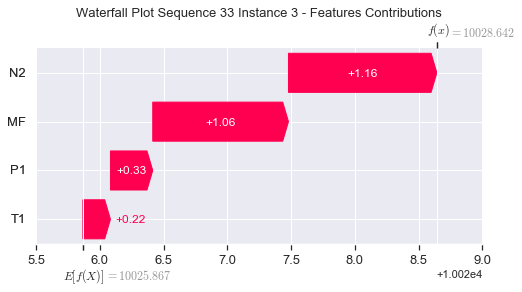

None

Contribution: [0.10590703 0.07391496 0.33346715 0.31379641]


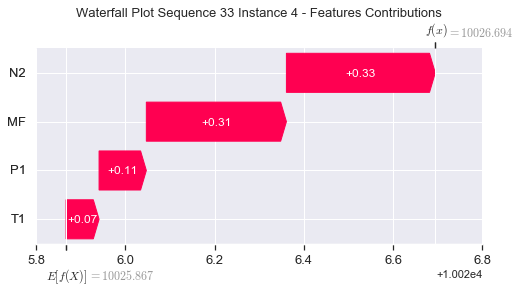

None

Contribution: [0.08325965 0.07054698 0.26899168 0.2457417 ]


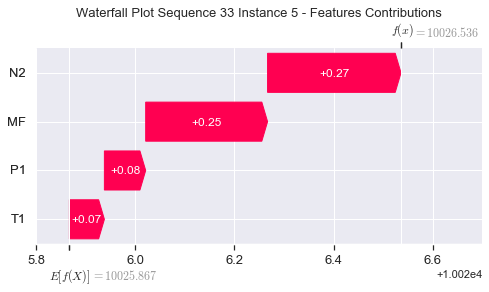

None

Contribution: [0.07413259 0.06265618 0.23483238 0.21647821]


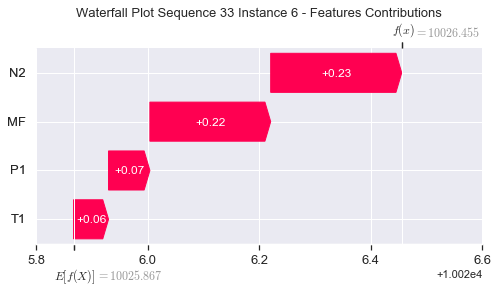

None

Contribution: [0.06871533 0.0580066  0.21895776 0.20101519]


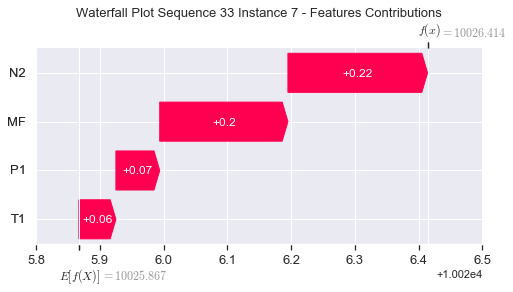

None

Contribution: [0.06519944 0.0553155  0.20845242 0.19169243]


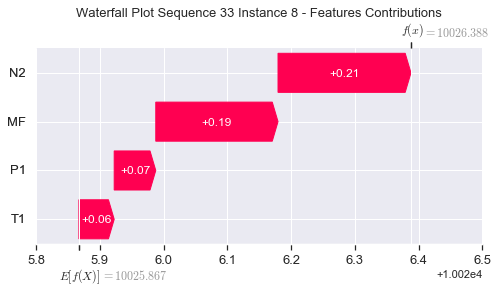

None

Contribution: [0.05997272 0.05282579 0.19931002 0.18201907]


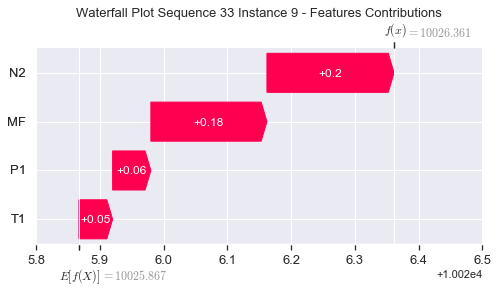

None

Contribution: [0.05892345 0.05257414 0.19165207 0.17444989]


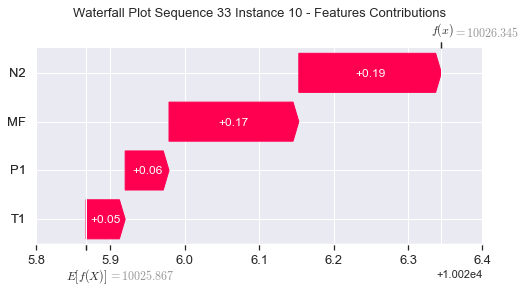

None

Contribution: [0.05782428 0.0501283  0.18725576 0.17443937]


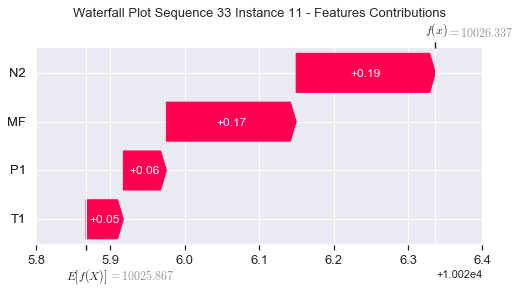

None

Contribution: [0.05694449 0.04618323 0.18077944 0.16719819]


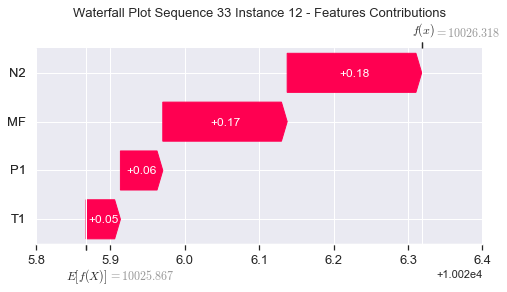

None

Contribution: [0.05517529 0.04501481 0.17635158 0.16237317]


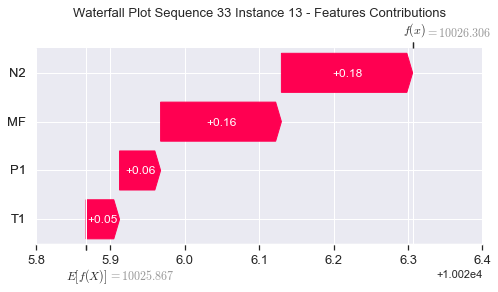

None

Contribution: [0.05357962 0.04342612 0.17130169 0.15618674]


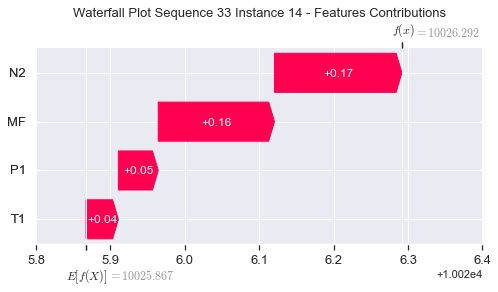

None

Contribution: [0.05266764 0.04284854 0.1684234  0.1552602 ]


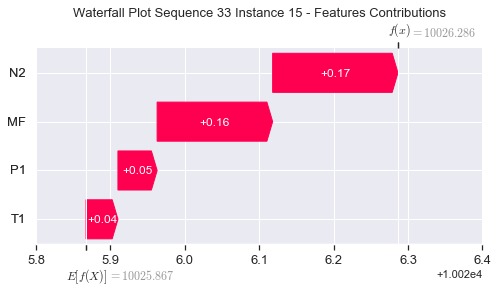

None

Contribution: [0.05094814 0.04322135 0.16446424 0.15043802]


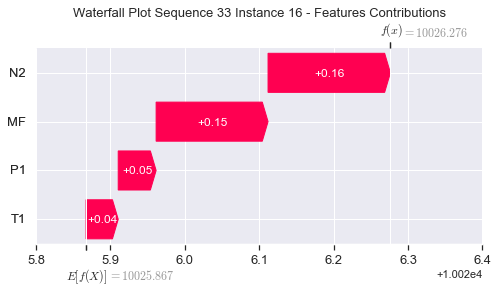

None

Contribution: [0.05031485 0.04093182 0.16192559 0.14878933]


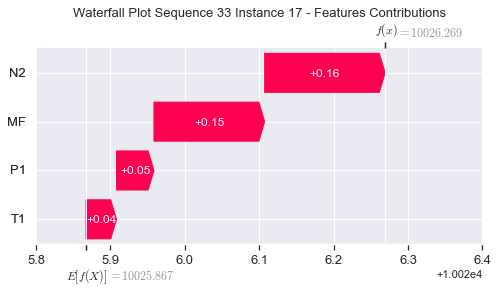

None

Contribution: [0.0495837  0.04031254 0.15942411 0.146715  ]


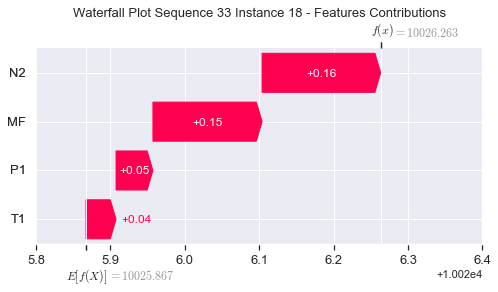

None

Contribution: [0.04791997 0.03975548 0.15765687 0.14282155]


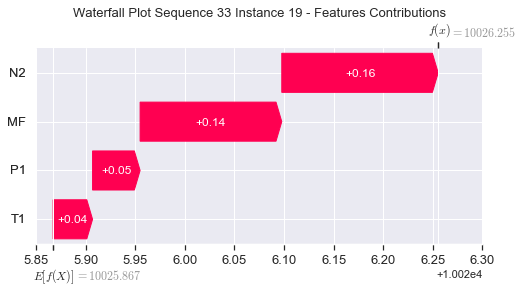

None

Contribution: [0.04908584 0.04043593 0.16064406 0.14679201]


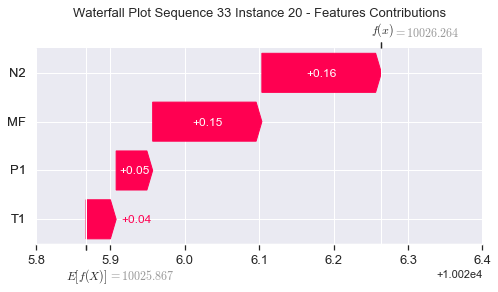

None

Contribution: [0.05369589 0.04413391 0.17646572 0.16141269]


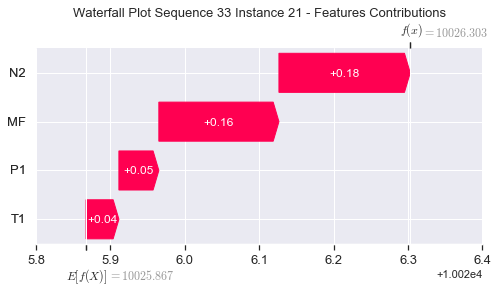

None

Contribution: [0.07367877 0.05715279 0.24486241 0.22517713]


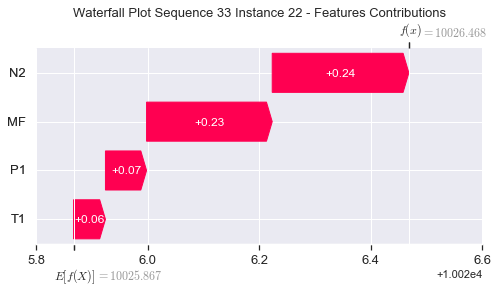

None

Contribution: [0.15278505 0.04026359 0.53263924 0.50720927]


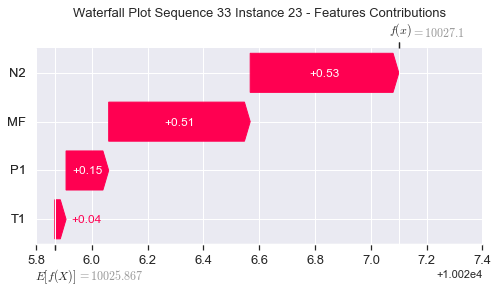

None

Contribution: [ 0.51070334 -1.29981567  1.97251212  2.15325338]


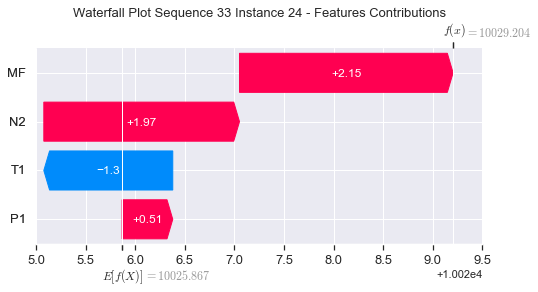

None

Contribution: [20.21617301 -1.58677823 69.4877578  71.50628927]


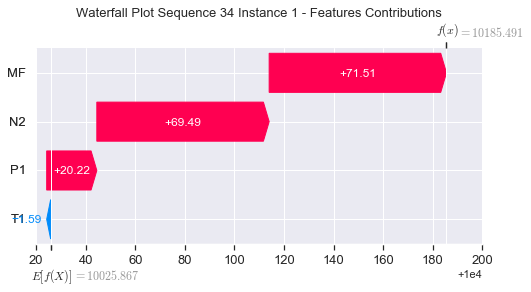

None

Contribution: [-0.1536985  -0.33001949 -0.24534562 -0.19612701]


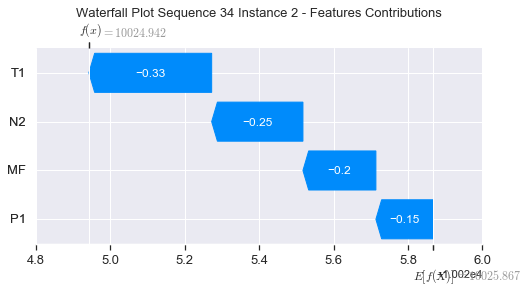

None

Contribution: [0.33962567 0.13810636 1.14784285 1.09742437]


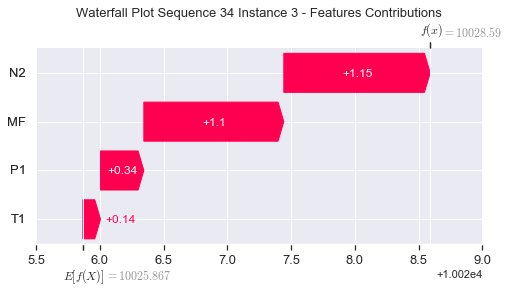

None

Contribution: [0.10008206 0.04833103 0.33006367 0.31512179]


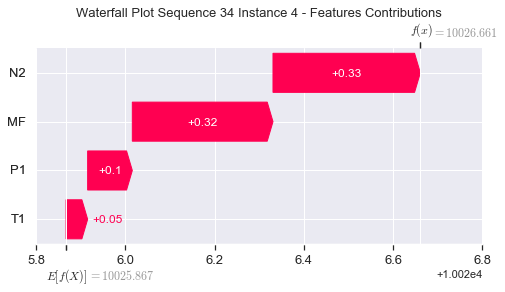

None

Contribution: [0.08210676 0.06410813 0.2667126  0.24377454]


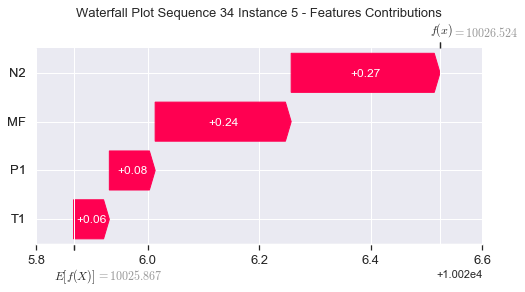

None

Contribution: [0.07173699 0.05720994 0.23303968 0.21389056]


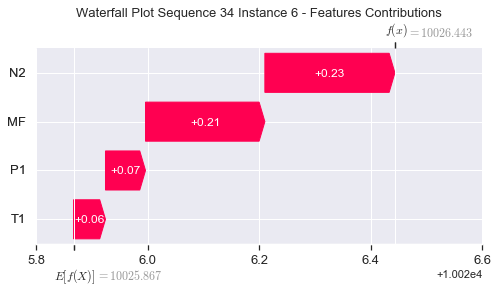

None

Contribution: [0.06695593 0.05368624 0.21773802 0.19970797]


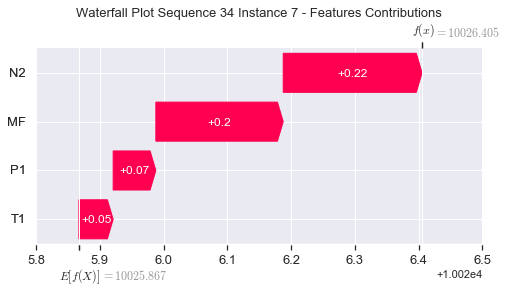

None

Contribution: [0.06334729 0.05085363 0.20728398 0.1900253 ]


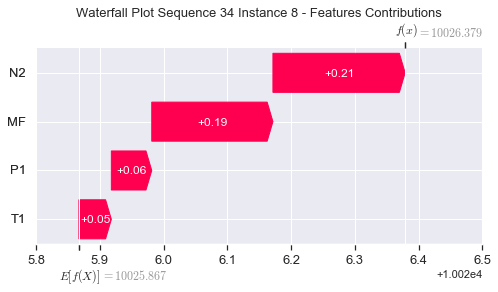

None

Contribution: [0.05933894 0.04854677 0.19926721 0.18242188]


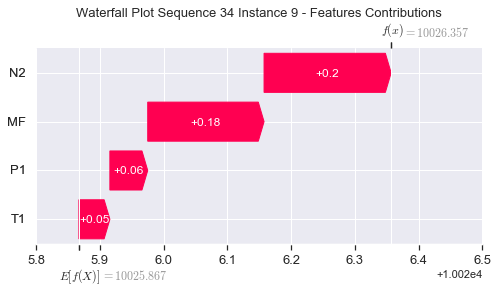

None

Contribution: [0.05677988 0.04595762 0.19226663 0.17641804]


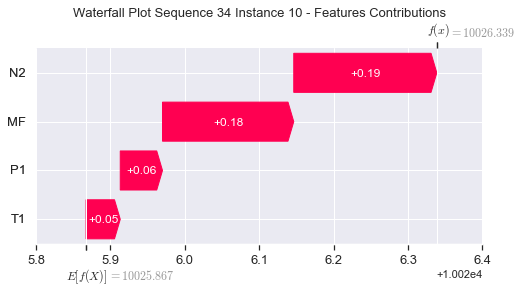

None

Contribution: [0.05470321 0.04517276 0.1864176  0.17106187]


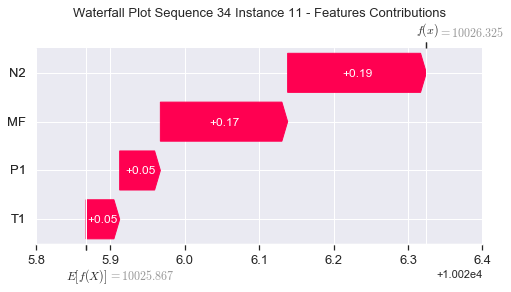

None

Contribution: [0.05370909 0.04418311 0.18041313 0.16504556]


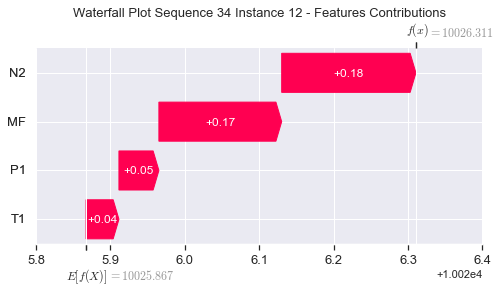

None

Contribution: [0.05261578 0.04314686 0.17616839 0.16103576]


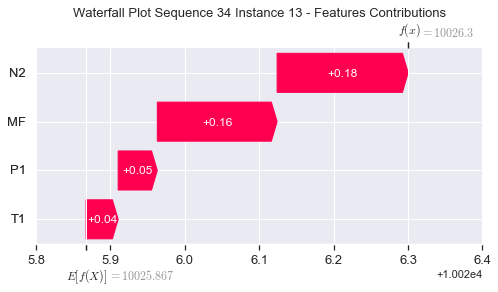

None

Contribution: [0.04921299 0.04092655 0.17138685 0.15420017]


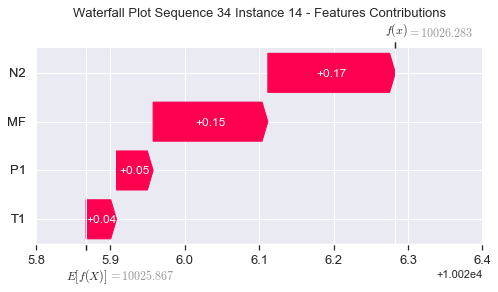

None

Contribution: [0.05057321 0.04124467 0.16840291 0.154113  ]


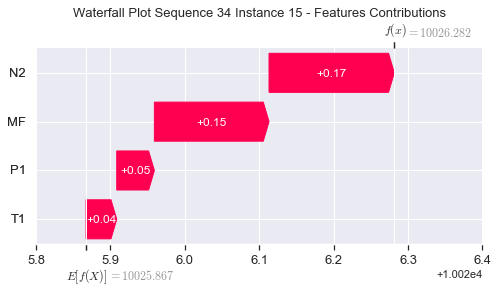

None

Contribution: [0.05093229 0.03878874 0.16583589 0.15296864]


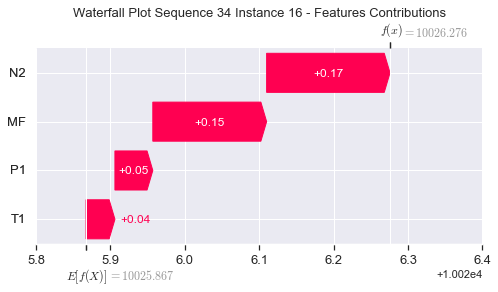

None

Contribution: [0.04883616 0.03971584 0.1623267  0.14862288]


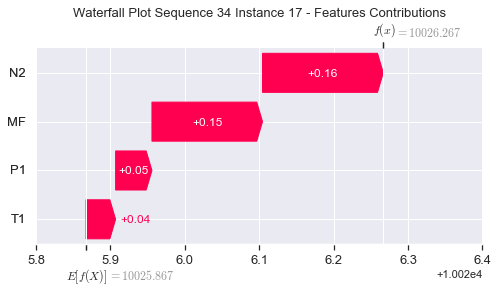

None

Contribution: [0.04811644 0.03899142 0.15983673 0.14640548]


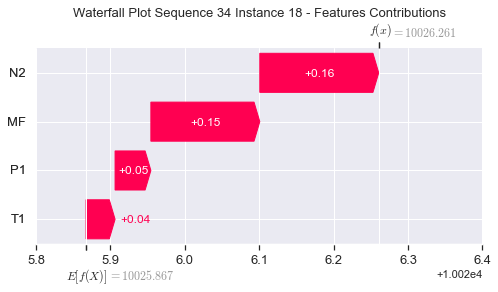

None

Contribution: [0.0464704  0.03709612 0.15830078 0.14324446]


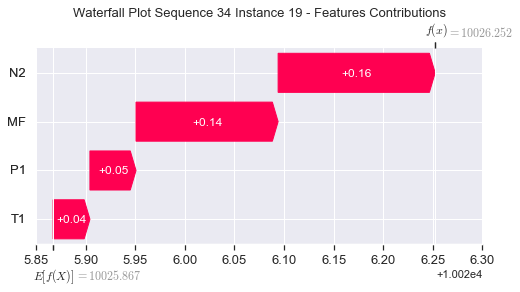

None

Contribution: [0.04886598 0.03917962 0.1612824  0.14756859]


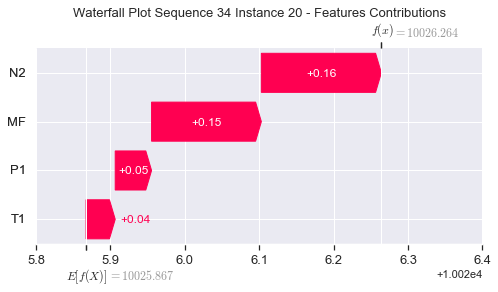

None

Contribution: [0.05325067 0.04299071 0.17718938 0.16196308]


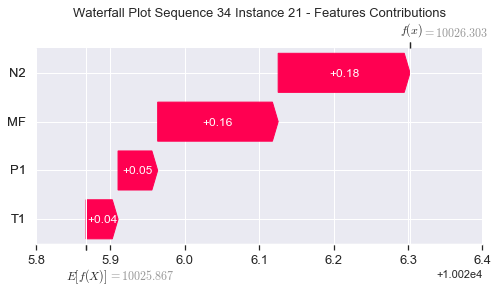

None

Contribution: [0.07266441 0.05537881 0.24575643 0.22506397]


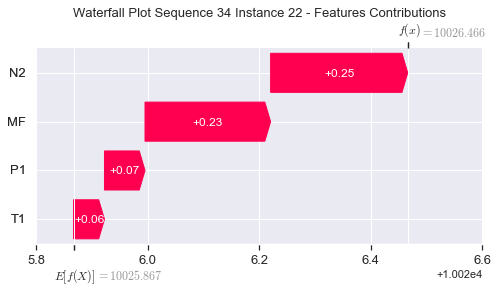

None

Contribution: [0.1439708  0.03031028 0.53569456 0.50221359]


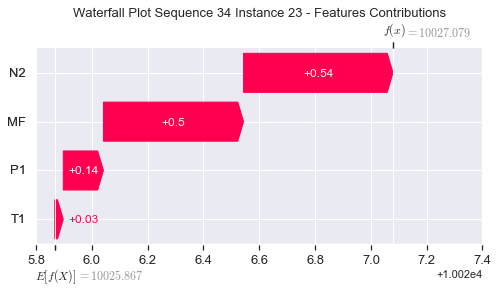

None

Contribution: [ 0.43532875 -1.49055932  1.97206621  2.05839653]


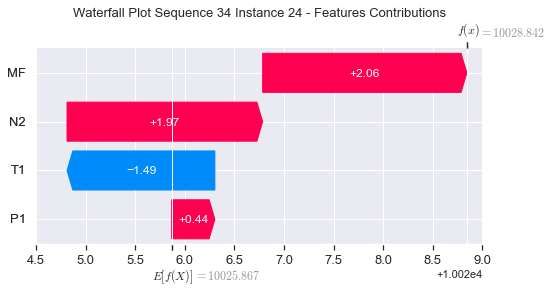

None

In [51]:
#Waterfall Plot for Local Accuracy & Consistency metrics

sns.set()
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [52]:
# calculate variables for control limit c

std.stack().max(),std.stack().mean(),std.stack().std()

(87.35021673901731, 82.70198678514707, 1.8688138601339266)

In [53]:
#calculate control limit

c = (std.stack().max() - std.stack().mean())/std.stack().std()
c

2.487262136175045

In [54]:
#Load Null anomaly testing data 1

xtest_AD_file = "xNull2.csv"
xtest_AD = pd.read_csv(xtest_AD_file, index_col=False)
xtest_AD = xtest_AD.to_numpy()
xtest_AD = xtest_AD.reshape(1,24,4)

In [55]:
#Load Null anomaly ground truth 1

ytest_AD_file = "yNull2.csv"
ytest_AD = pd.read_csv(ytest_AD_file, index_col=False)

In [56]:
#Prediction

preds_AD = model(xtest_AD)
y_AD = preds_AD[0].sample(1000)
#y1_AD = preds_AD[1]
y_AD = tf.keras.backend.get_value(y_AD)
#y1_AD = tf.keras.backend.get_value(y1_AD)
tens_draw_AD = y_AD
#tens_draw1_AD = y1_AD

#Predicted RUL for each Fleet
mean_Fleet_All_AD = np.zeros(tens_draw_AD.shape[1])
mean_Fleet_AD = np.zeros(tens_draw_AD.shape[0])
for y in range(tens_draw_AD.shape[1]):
    for x in range(tens_draw_AD.shape[0]):
        mean_Fleet_AD[x] = tens_draw_AD[x,y,0]
    mean_Fleet_All_AD[y] = mean_Fleet_AD.mean()
      
mean_Fleet_All_AD, #tens_draw1_AD

(array([10658.05758105]),)

In [57]:
#Calculate Mean and Std for predictions with AU

Fleet_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[0])))
mean_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
std_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
for z in range(tens_draw_AD.shape[1]):
    for y in range(tens_draw_AD.shape[0]):
        for x in range(pad):
            Fleet_AD[y][x] = tens_draw_AD[y,z,x]
    row_Mean_AD = Fleet_AD.mean(axis=1)
    row_Std_AD = Fleet_AD.std(axis=1)
    for j in range(pad):
        mean_AD[z][j] = row_Mean_AD[j]
    for k in range(pad):
        std_AD[z][k] = row_Std_AD[k]

In [58]:
hour_NUM2 = ['1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm']

0


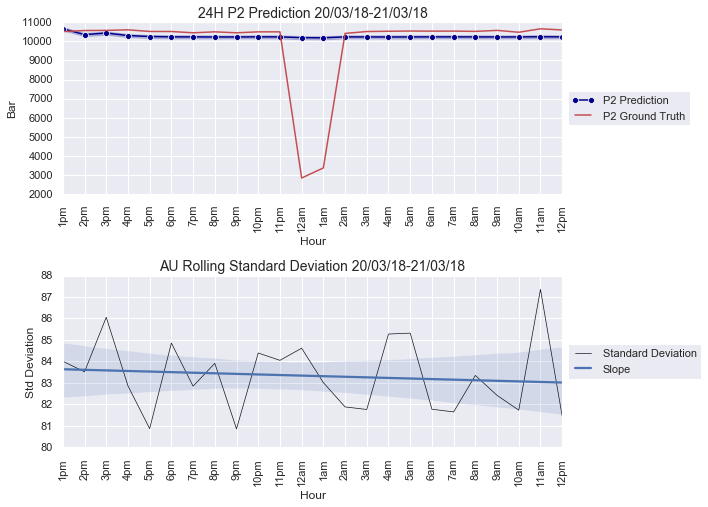

In [59]:
#Visualize prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD.shape[0])))
    for y in range(tens_draw_AD.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD.shape[0]:
        if(m < (tens_draw_AD.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD['P2'][x]
    max_RUL_Arrange.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange, color='darkblue', ax=ax, label="P2 Prediction")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='r', ax=ax,label="P2 Ground Truth")
    plt.title('24H P2 Prediction 20/03/18-21/03/18',fontsize=14)
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.set_xlabel('Hour')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],label ='Slope',scatter = False)
    plt.title('AU Rolling Standard Deviation 20/03/18-21/03/18',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

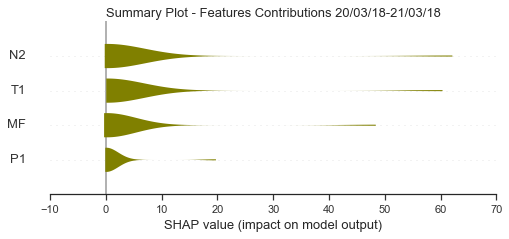

In [60]:
#Summary Plot for anomaly

sns.set_style("ticks")
instance = xtest_AD
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
plt.title("Summary Plot - Features Contributions 20/03/18-21/03/18",fontsize=13)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="violin", color='olive')

In [61]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [62]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:/Users/Asus/Desktop/Bayes_Lstm_P2/AD1.csv', index = False)

In [63]:
#Load Null anomaly testing data 2

xtest_AD_ALL_file = "xNull1.csv"
xtest_AD_ALL = pd.read_csv(xtest_AD_ALL_file, index_col=False)
xtest_AD_ALL = xtest_AD_ALL.to_numpy()
xtest_AD_ALL = xtest_AD_ALL.reshape(1,24,4)

In [64]:
#Load Null anomaly ground truth 2

ytest_AD_ALL_file = "yNull1.csv"
ytest_AD_ALL = pd.read_csv(ytest_AD_ALL_file, index_col=False)

In [65]:
#Prediction

preds_AD_ALL = model(xtest_AD_ALL)
y_AD_ALL = preds_AD_ALL[0].sample(1000)
#y1_AD_ALL = preds_AD_ALL[2]
y_AD_ALL = tf.keras.backend.get_value(y_AD_ALL)
#y1_AD_ALL = tf.keras.backend.get_value(y1_AD_ALL)
tens_draw_AD_ALL = y_AD_ALL
#tens_draw1_AD_ALL = y1_AD_ALL

#Predicted RUL for each Fleet
mean_Fleet_All_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[1])
mean_Fleet_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[0])
for y in range(tens_draw_AD_ALL.shape[1]):
    for x in range(tens_draw_AD_ALL.shape[0]):
        mean_Fleet_AD_ALL[x] = tens_draw_AD_ALL[x,y,0]
    mean_Fleet_All_AD_ALL[y] = mean_Fleet_AD_ALL.mean()
      
mean_Fleet_All_AD_ALL, #tens_draw1_AD_ALL

(array([10565.38878516]),)

In [66]:
#Calculate Mean and Std for predictions with AU

Fleet_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[0])))
mean_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
std_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
for z in range(tens_draw_AD_ALL.shape[1]):
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(pad):
            Fleet_AD_ALL[y][x] = tens_draw_AD_ALL[y,z,x]
    row_Mean_AD_ALL = Fleet_AD_ALL.mean(axis=1)
    row_Std_AD_ALL = Fleet_AD_ALL.std(axis=1)
    for j in range(pad):
        mean_AD_ALL[z][j] = row_Mean_AD_ALL[j]
    for k in range(pad):
        std_AD_ALL[z][k] = row_Std_AD_ALL[k]

In [67]:
hour_NUM3 = ['12pm','1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am']

0


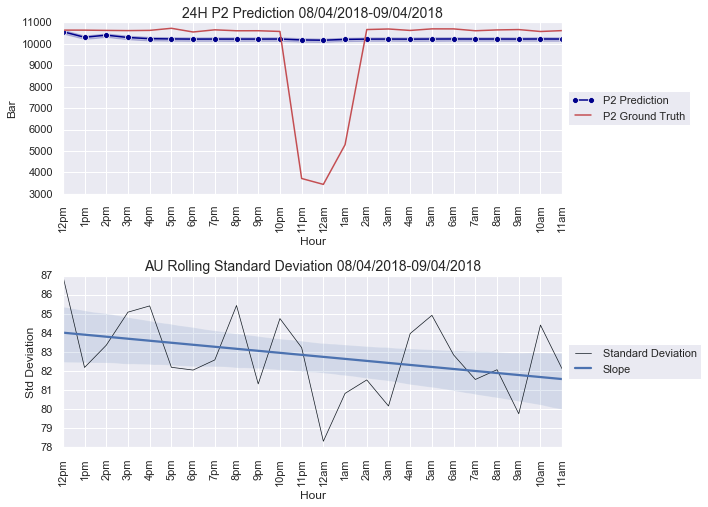

In [68]:
#Visualize anomaly prediction
sns.set()
for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD_ALL.shape[0])))
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD_ALL[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD_ALL.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD_ALL.shape[0]:
        if(m < (tens_draw_AD_ALL.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD_ALL['P2'][x]
    max_RUL_Arrange.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD_ALL[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange,color='darkblue', ax=ax, label="P2 Prediction")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='r', ax=ax,label="P2 Ground Truth")
    plt.title('24H P2 Prediction 08/04/2018-09/04/2018',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],label ='Slope',scatter = False)
    plt.title('AU Rolling Standard Deviation 08/04/2018-09/04/2018',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

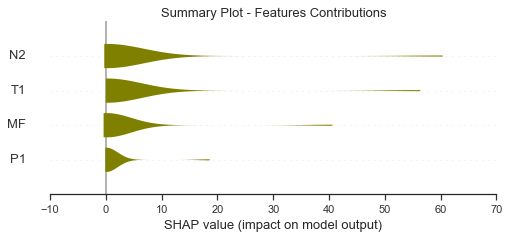

In [69]:
#Summary Plot for anomaly

sns.set_style("ticks")
instance = xtest_AD_ALL
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
plt.title("Summary Plot - Features Contributions",fontsize=13)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="violin", color='olive')

In [70]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD_ALL[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [71]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:/Users/Asus/Desktop/Bayes_Lstm_P2/AD2.csv', index = False)

In [72]:
#Define f''x

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 934)           3504368   
_________________________________________________________________
dense_4 (Dense)              (None, 24, 364)           340340    
_________________________________________________________________
dense_5 (Dense)              (None, 24, 1)             365       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 3,845,073
Trainable params: 3,845,073
Non-trainable params: 0
_________________________________________________________________


In [73]:
#Extract only weights for 3 variables excluding mf

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [74]:
#Transfer weights from f'x to f''x

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [75]:
#Load xtest and delete mf

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete mf

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [76]:
#Prediction with features excluding mf

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [77]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [ -8.67449903 -90.77470353  59.17403037]


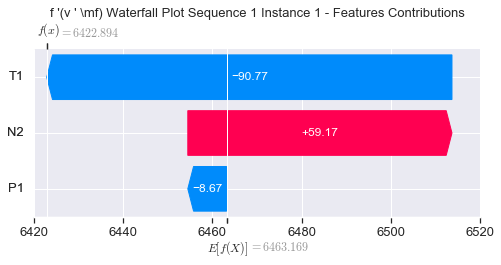

None

Contribution: [1.26269549 2.63667449 2.08005709]


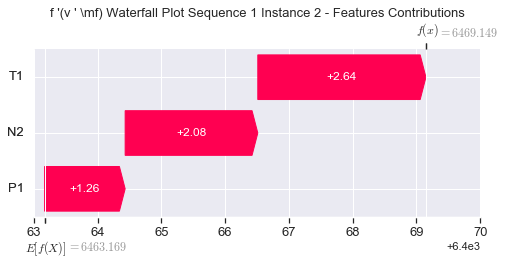

None

Contribution: [-0.09090607 -0.90259239  1.33709454]


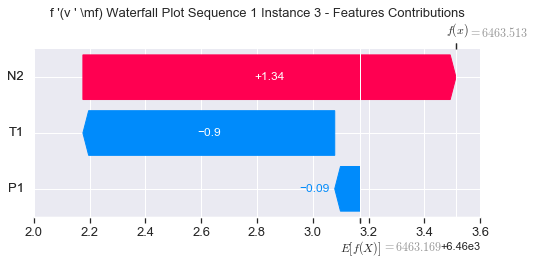

None

Contribution: [0.11077577 0.05222915 0.51464268]


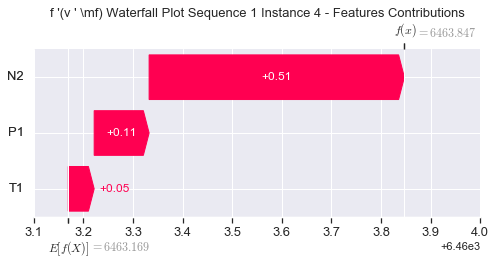

None

Contribution: [0.08918837 0.07837895 0.37114844]


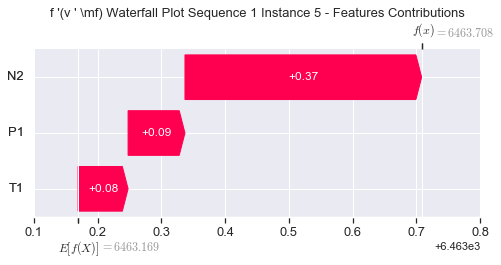

None

Contribution: [0.08143228 0.06322205 0.33192721]


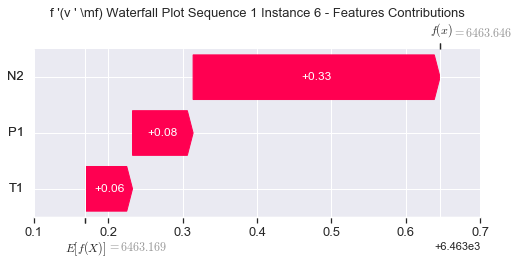

None

Contribution: [0.07525279 0.06473235 0.32180688]


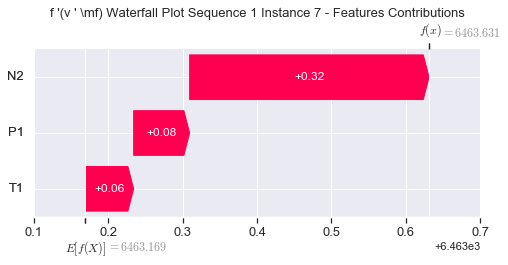

None

Contribution: [0.07259717 0.06364052 0.30997029]


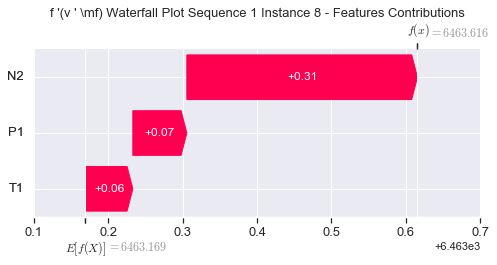

None

Contribution: [0.06567251 0.10465127 0.30540081]


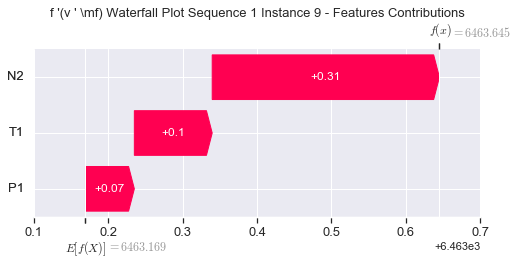

None

Contribution: [0.05361656 0.09203881 0.29542038]


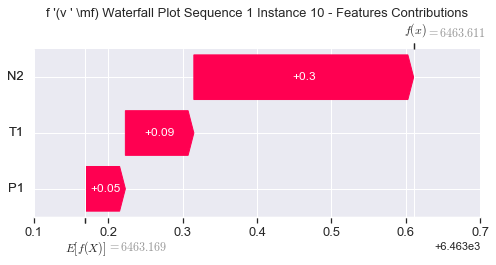

None

Contribution: [0.0687753  0.09785768 0.28844373]


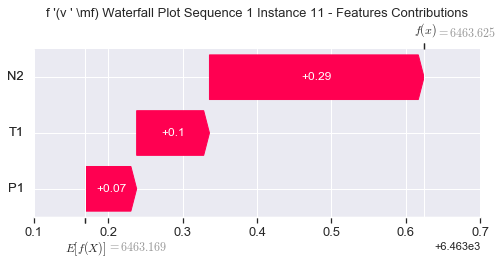

None

Contribution: [0.06336201 0.07544068 0.27616173]


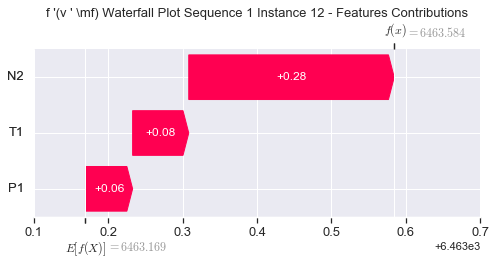

None

Contribution: [0.0662286  0.10652065 0.27138049]


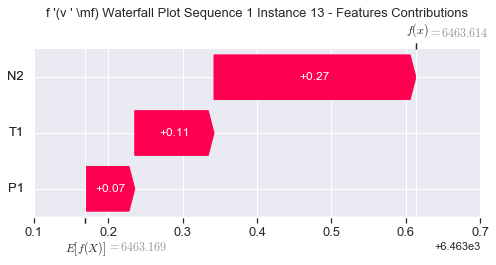

None

Contribution: [0.07729731 0.13151892 0.26634447]


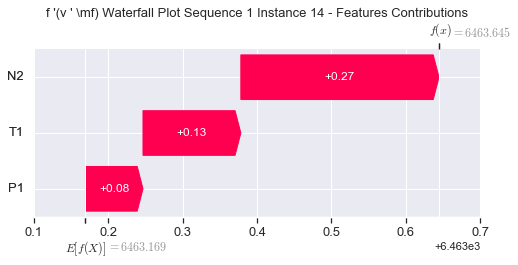

None

Contribution: [0.07329416 0.16274496 0.26348363]


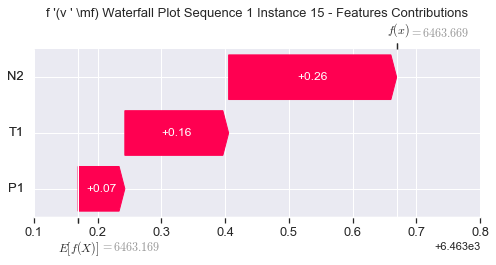

None

Contribution: [0.08861978 0.21206817 0.25885155]


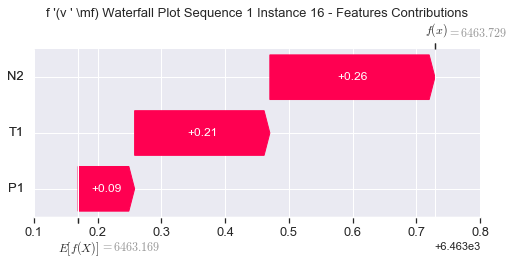

None

Contribution: [0.08872988 0.28532316 0.26241907]


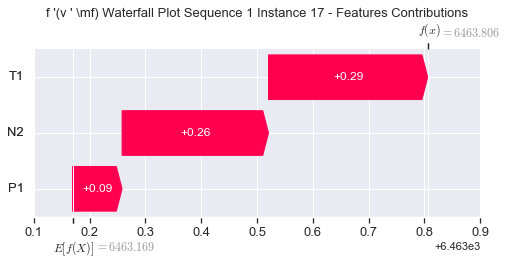

None

Contribution: [0.09693207 0.35930354 0.26682147]


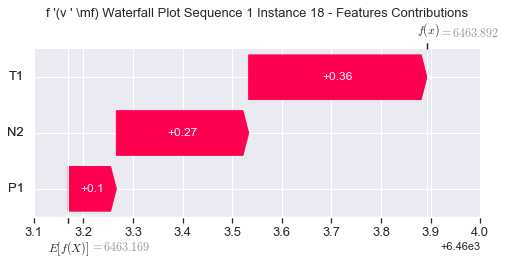

None

Contribution: [0.09319807 0.42830963 0.28170196]


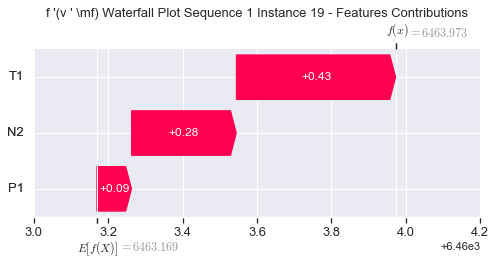

None

Contribution: [0.0919709  0.45764137 0.30457526]


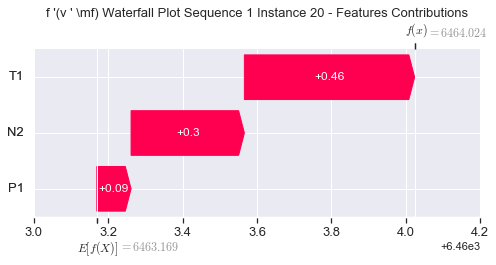

None

Contribution: [0.05019964 0.37129138 0.37032345]


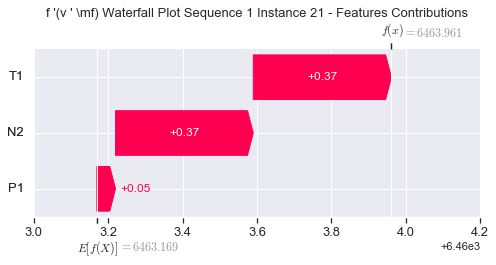

None

Contribution: [-0.07040702 -0.03007321  0.55167447]


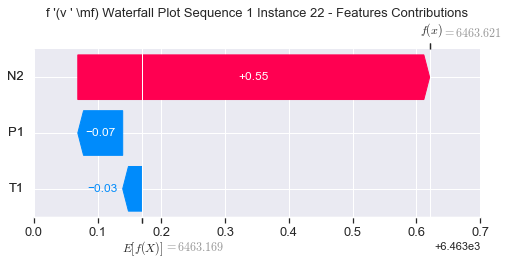

None

Contribution: [-0.44982555 -1.13932761  1.1329458 ]


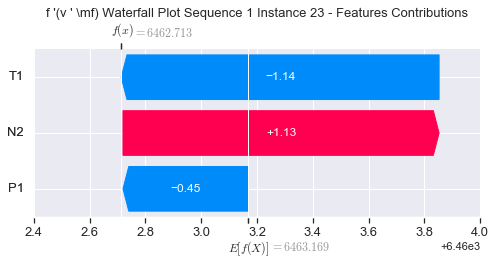

None

Contribution: [-0.57450698 -4.016216    3.1158964 ]


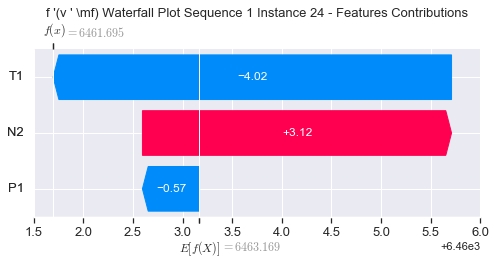

None

Contribution: [ -5.263417   -76.65556932  48.51570813]


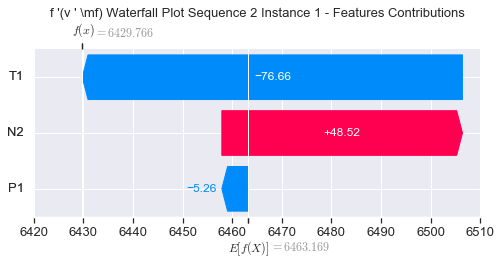

None

Contribution: [1.54705982 2.28479988 2.42148625]


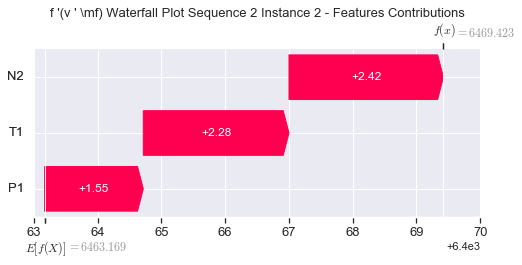

None

Contribution: [-0.10189273 -0.93120116  1.13172616]


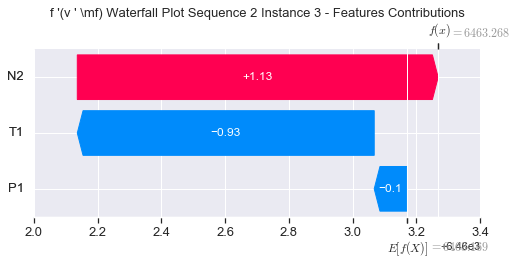

None

Contribution: [0.09776341 0.05597215 0.49601497]


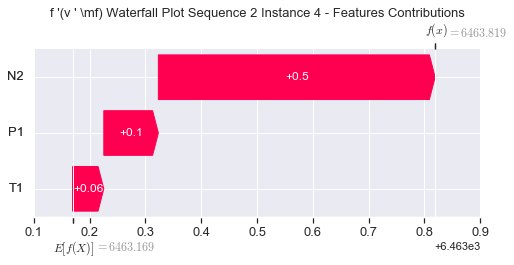

None

Contribution: [ 0.08349898 -0.02428554  0.37137888]


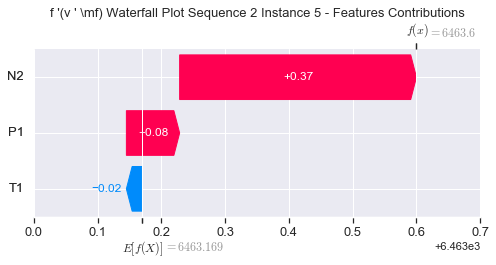

None

Contribution: [ 0.07048222 -0.05589671  0.32925045]


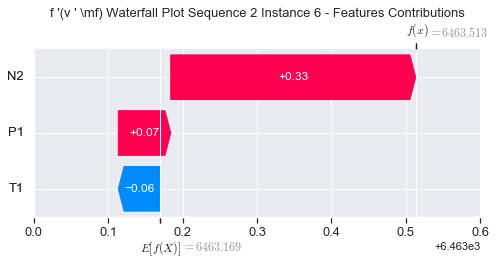

None

Contribution: [ 0.06671241 -0.07023069  0.32021114]


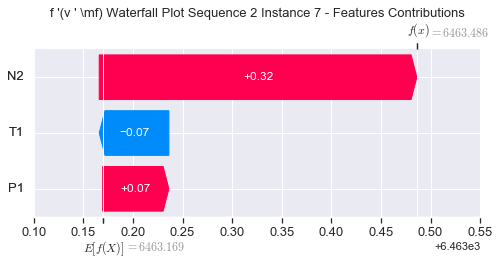

None

Contribution: [ 0.06249281 -0.07242367  0.30835184]


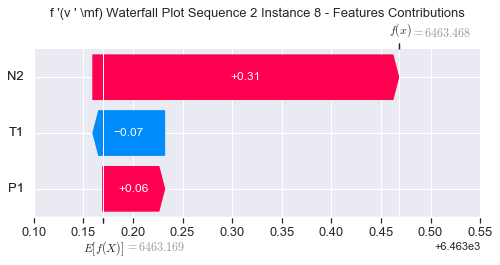

None

Contribution: [ 0.05522566 -0.0792746   0.31164277]


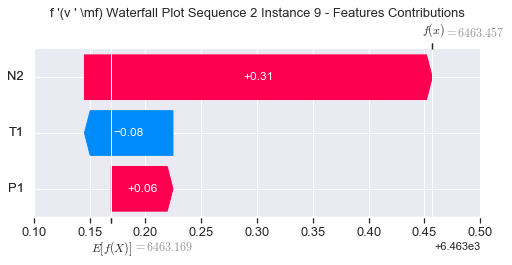

None

Contribution: [ 0.04531221 -0.06768821  0.30511276]


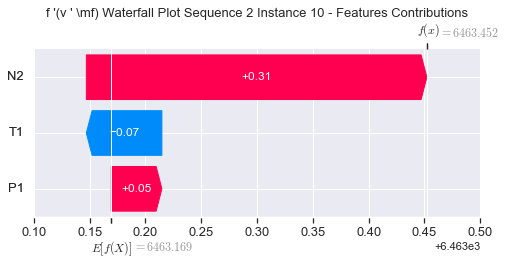

None

Contribution: [ 0.05296472 -0.05267964  0.28882188]


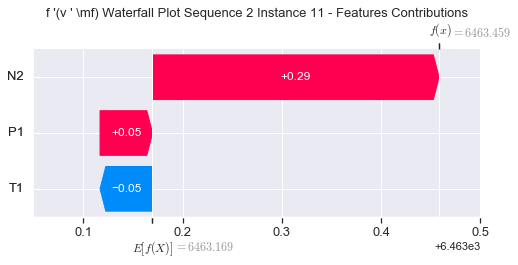

None

Contribution: [ 0.05739861 -0.05456725  0.27335176]


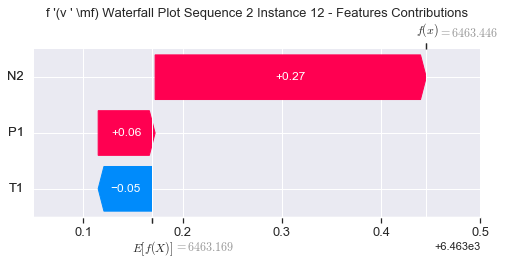

None

Contribution: [ 0.06153519 -0.00866917  0.26966743]


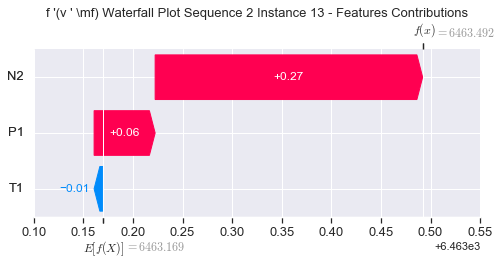

None

Contribution: [0.06559442 0.0340666  0.26445027]


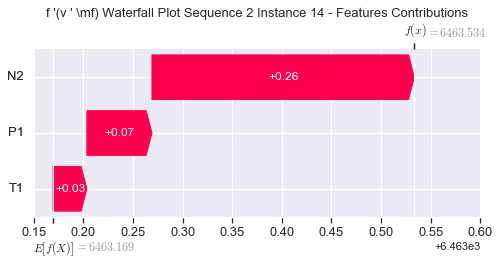

None

Contribution: [0.0691381  0.09943111 0.26186355]


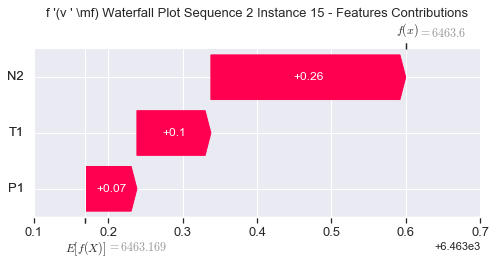

None

Contribution: [0.08529154 0.18704348 0.25804202]


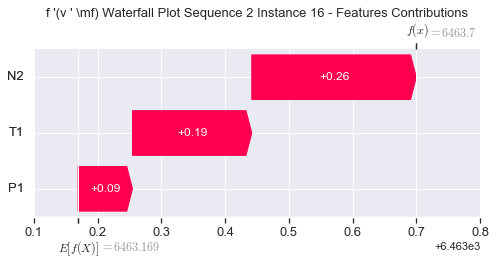

None

Contribution: [0.08782365 0.30405954 0.26095558]


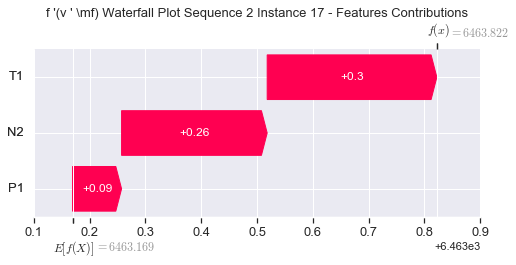

None

Contribution: [0.09753859 0.41522792 0.26525146]


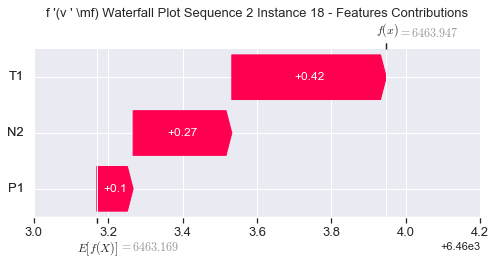

None

Contribution: [0.0882043  0.47775667 0.28065081]


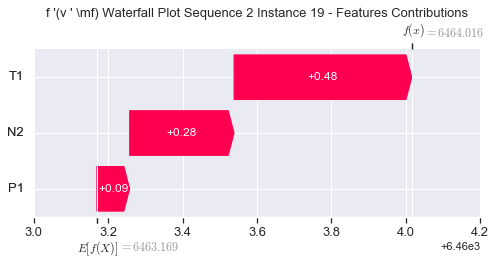

None

Contribution: [0.08663383 0.3939768  0.30336135]


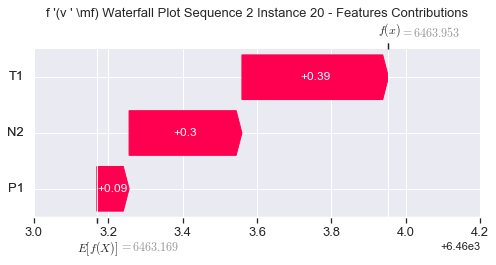

None

Contribution: [ 0.02987433 -0.10392878  0.37279242]


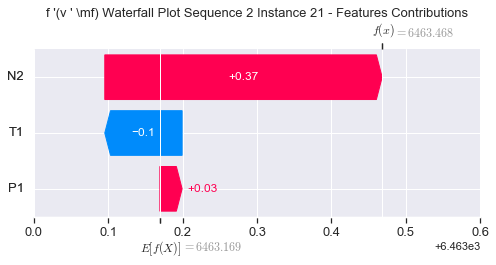

None

Contribution: [-0.13567299 -1.55636783  0.55842077]


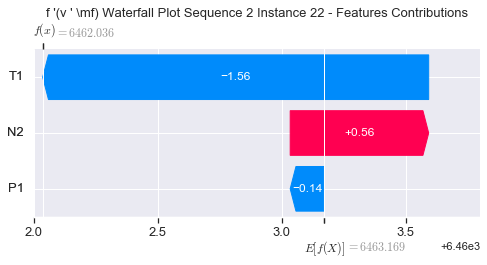

None

Contribution: [-0.66282929 -5.34456999  1.13462023]


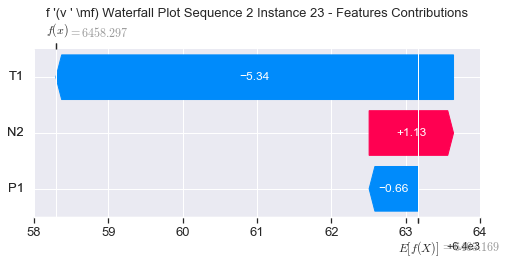

None

Contribution: [ -1.36643829 -13.91529775   3.12049763]


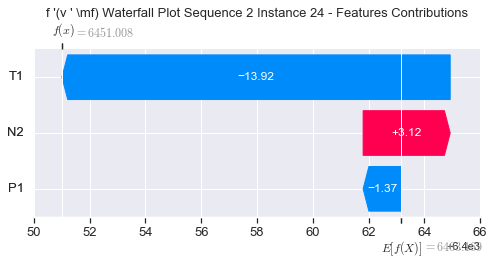

None

Contribution: [ -29.15019025 -253.00806745   46.92991746]


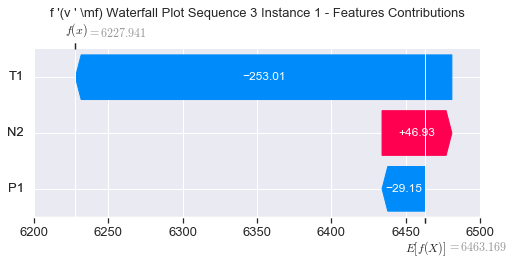

None

Contribution: [1.64929596 4.47035896 2.68670073]


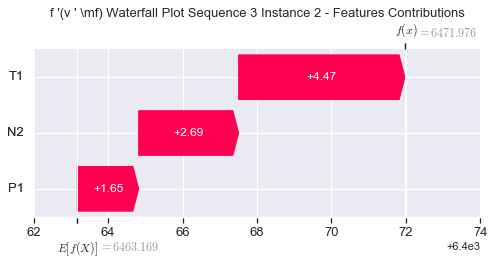

None

Contribution: [-0.35863338 -4.71585955  1.10788917]


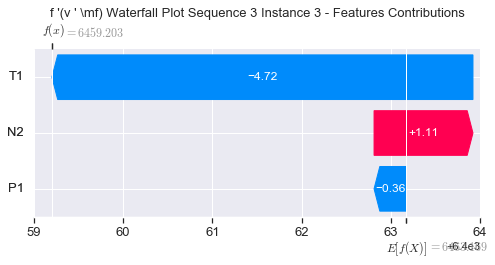

None

Contribution: [ 0.09623372 -0.31477866  0.49005334]


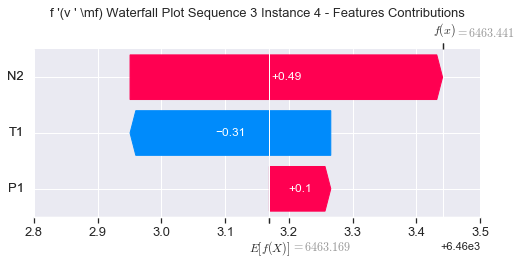

None

Contribution: [ 0.07340065 -0.15271839  0.34857945]


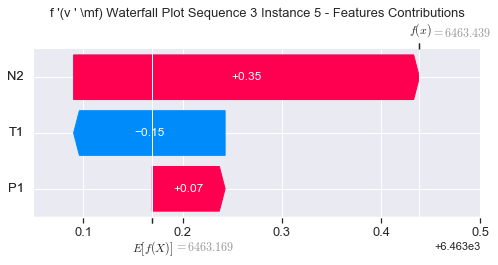

None

Contribution: [ 0.06108774 -0.14985037  0.31535414]


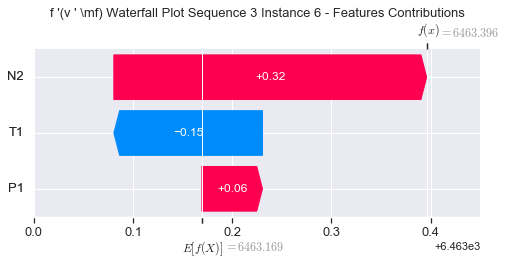

None

Contribution: [ 0.05627283 -0.1633622   0.306916  ]


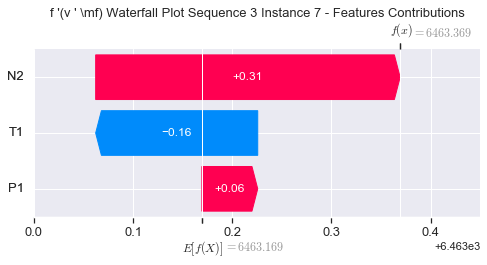

None

Contribution: [ 0.05342998 -0.16756839  0.29748004]


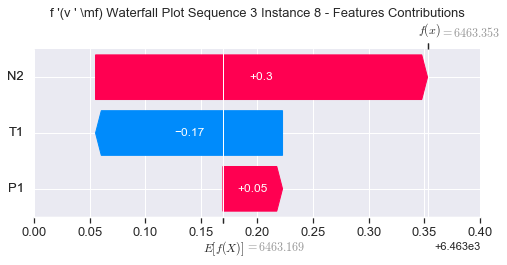

None

Contribution: [ 0.03992403 -0.14109727  0.29557473]


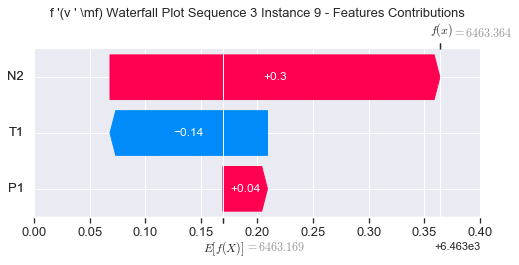

None

Contribution: [ 0.03889692 -0.09919651  0.29530196]


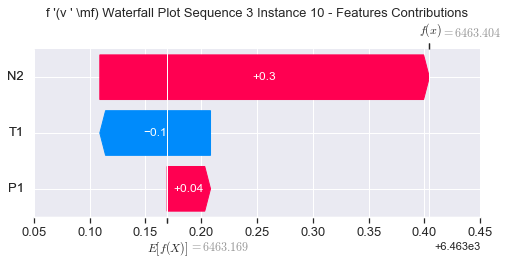

None

Contribution: [ 0.04493329 -0.12062939  0.28378317]


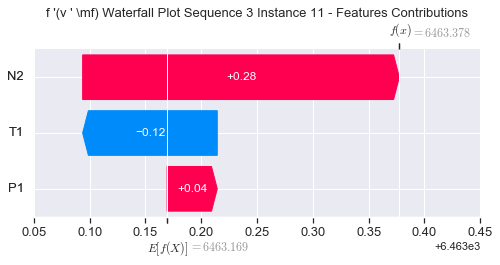

None

Contribution: [ 0.05204745 -0.1628807   0.2719821 ]


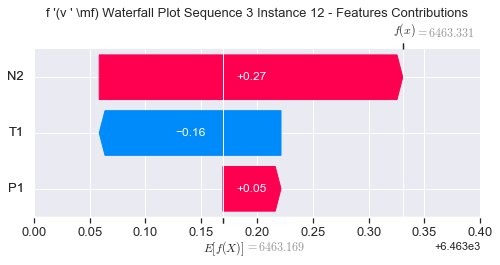

None

Contribution: [ 0.05198515 -0.14264224  0.26686268]


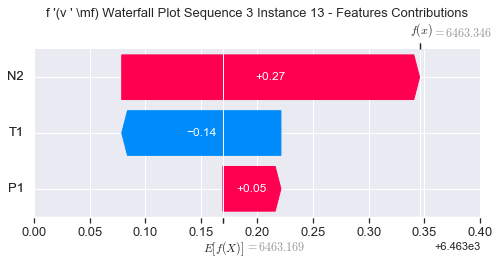

None

Contribution: [ 0.04041355 -0.10969815  0.26358005]


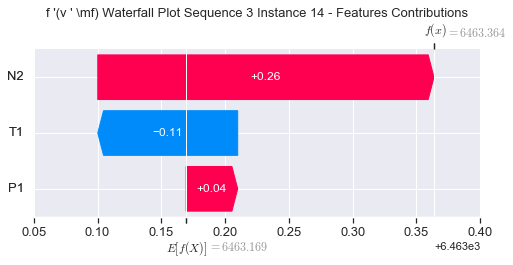

None

Contribution: [ 0.05014819 -0.09860018  0.2580833 ]


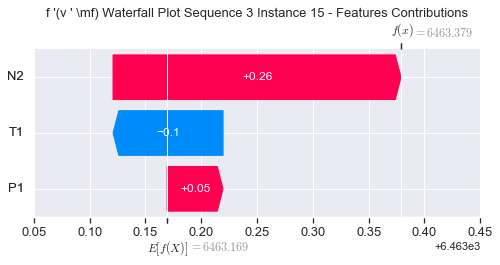

None

Contribution: [ 0.05999283 -0.04958245  0.2610481 ]


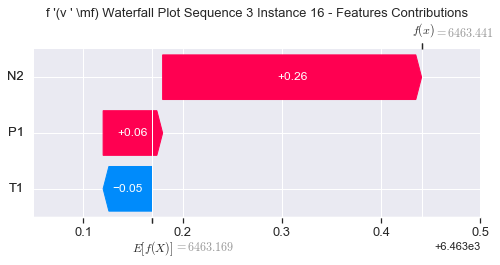

None

Contribution: [ 0.05762258 -0.00111834  0.25448893]


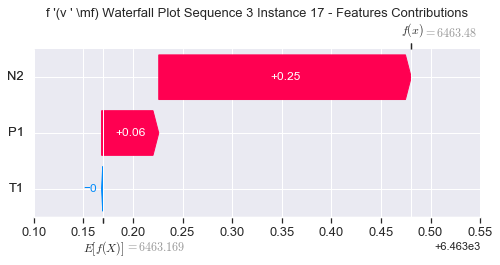

None

Contribution: [0.0598945  0.04230089 0.25597749]


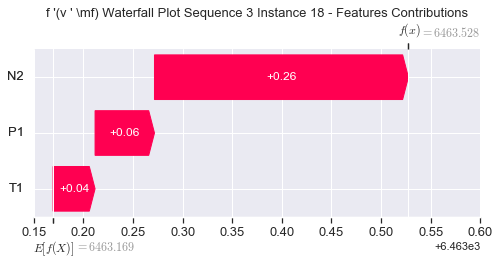

None

Contribution: [0.04488157 0.02577995 0.26993768]


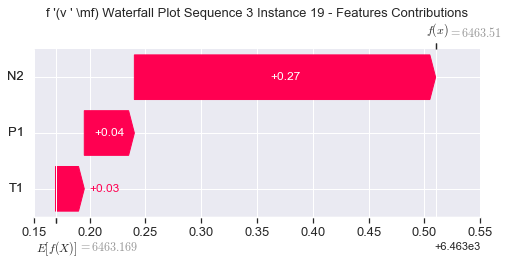

None

Contribution: [ 0.03542628 -0.12271112  0.28996877]


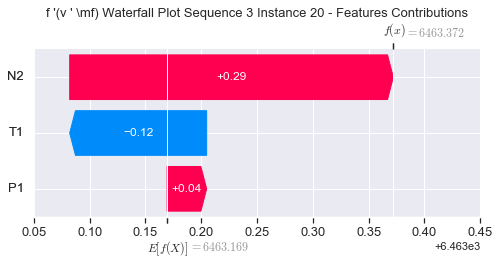

None

Contribution: [-0.01810518 -0.68139287  0.36278304]


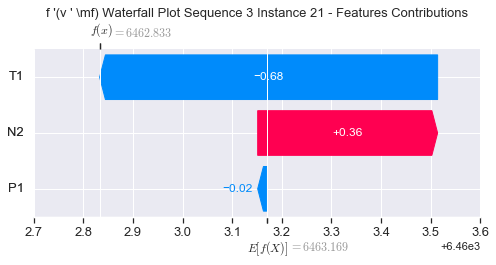

None

Contribution: [-0.16275944 -2.1988278   0.57397096]


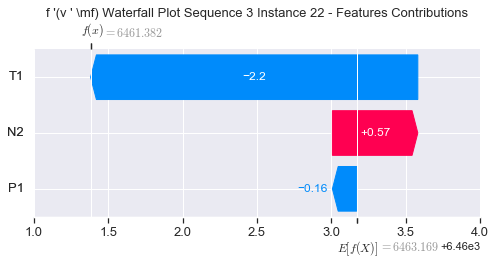

None

Contribution: [-0.60486573 -5.8663051   1.26533597]


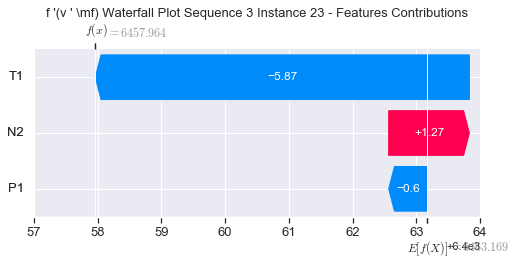

None

Contribution: [ -0.96861056 -14.961526     3.36894969]


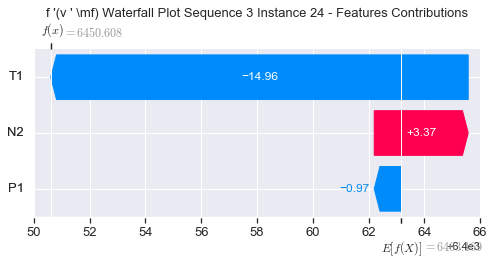

None

Contribution: [ -14.57089896 -273.85905776   46.40348575]


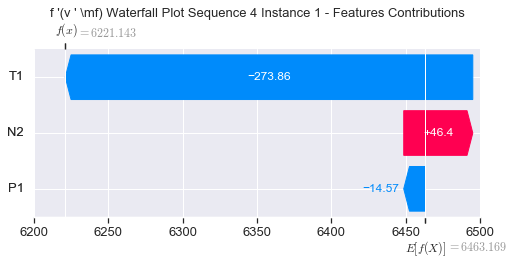

None

Contribution: [1.4717785  4.55209585 2.57617501]


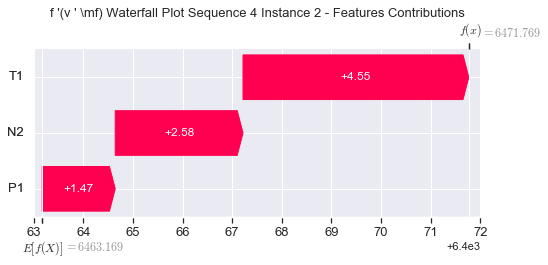

None

Contribution: [-0.49975556 -4.60395596  1.13983312]


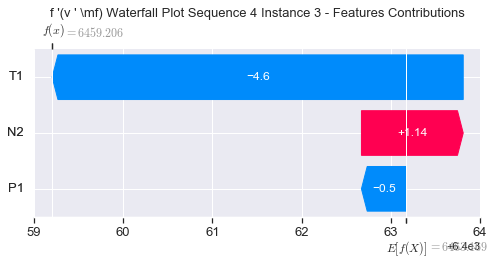

None

Contribution: [ 0.10480126 -0.28699504  0.4920009 ]


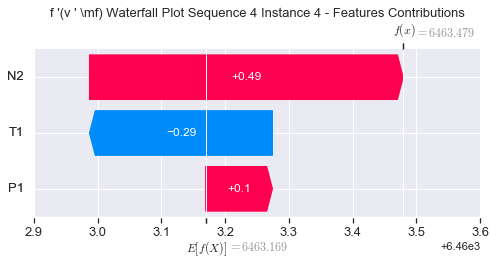

None

Contribution: [ 0.07687848 -0.16852895  0.35082452]


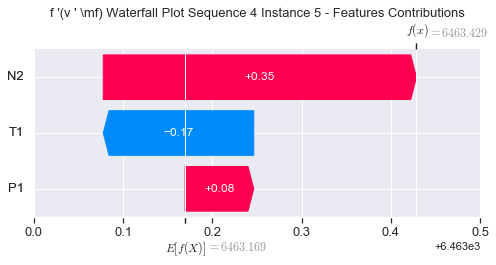

None

Contribution: [ 0.06756131 -0.18205895  0.31803474]


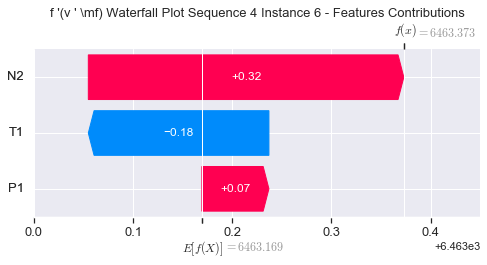

None

Contribution: [ 0.06408724 -0.19387416  0.3096315 ]


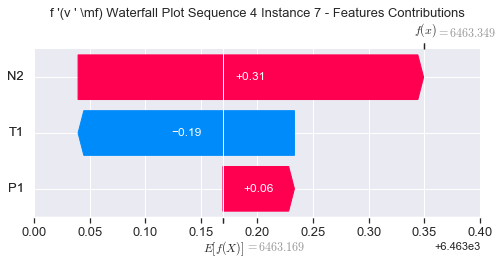

None

Contribution: [ 0.05804415 -0.20043727  0.30006726]


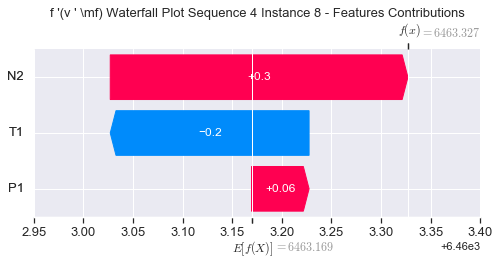

None

Contribution: [ 0.03665387 -0.18338032  0.29989301]


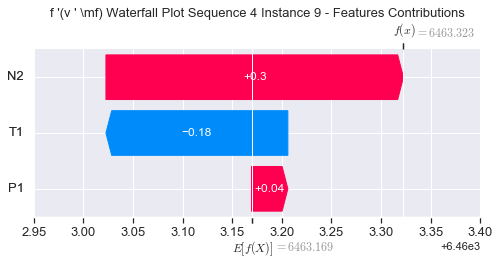

None

Contribution: [ 0.04361153 -0.19585627  0.29463455]


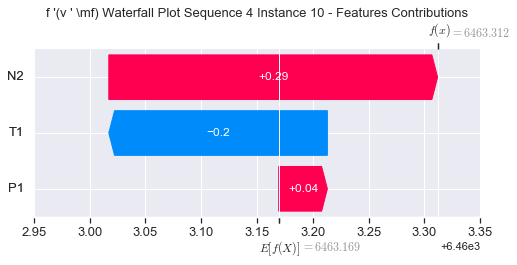

None

Contribution: [ 0.03486241 -0.1766988   0.28616613]


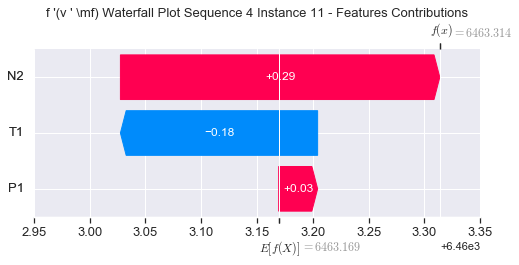

None

Contribution: [ 0.050982   -0.19110463  0.27238316]


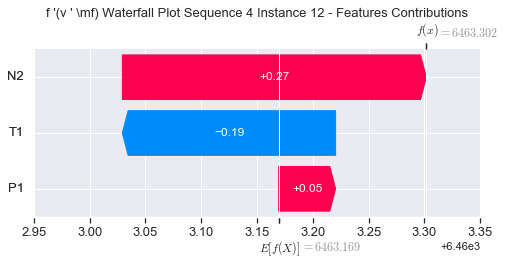

None

Contribution: [ 0.05215585 -0.1679907   0.26767488]


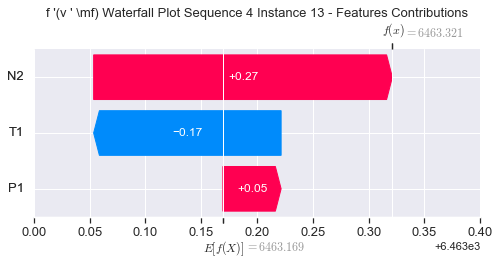

None

Contribution: [ 0.04775954 -0.13786125  0.26734212]


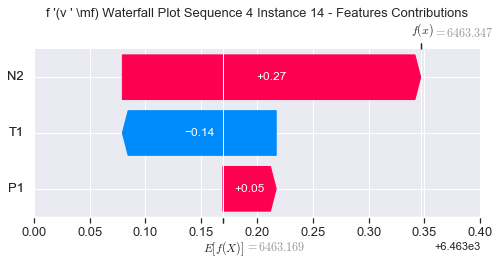

None

Contribution: [ 0.05132936 -0.1252028   0.2587614 ]


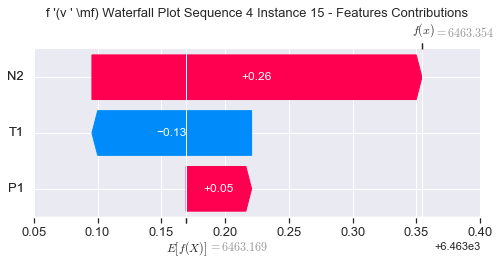

None

Contribution: [ 0.04931616 -0.07397806  0.2576508 ]


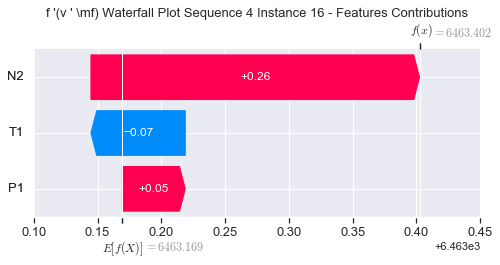

None

Contribution: [ 0.05896448 -0.02550458  0.25523244]


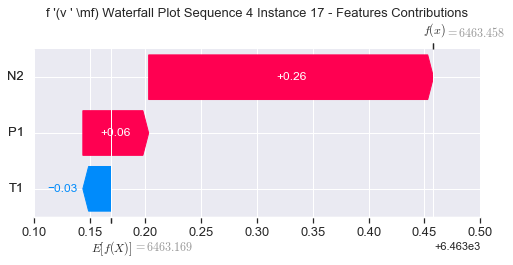

None

Contribution: [0.06090656 0.0158727  0.25671037]


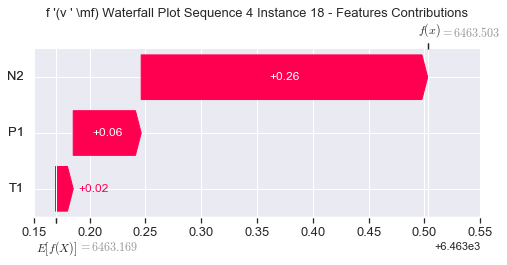

None

Contribution: [0.04602037 0.01284153 0.26757613]


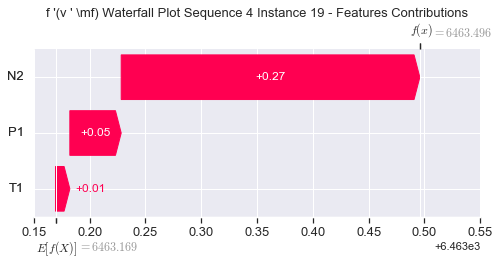

None

Contribution: [ 0.03963084 -0.16748741  0.29225452]


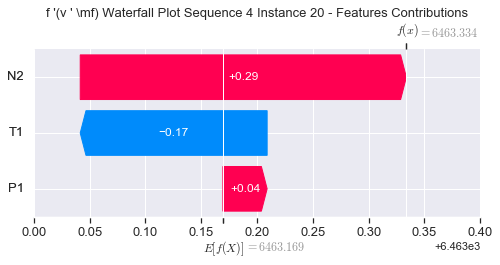

None

Contribution: [-0.01396042 -0.76286149  0.36721895]


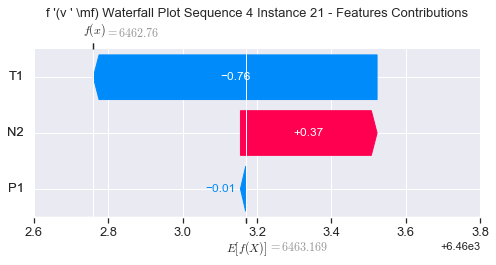

None

Contribution: [-0.16885108 -2.37046016  0.58012721]


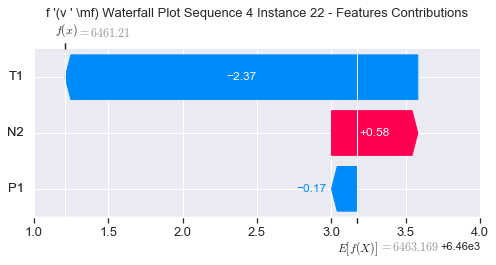

None

Contribution: [-0.61936101 -6.36234268  1.28222512]


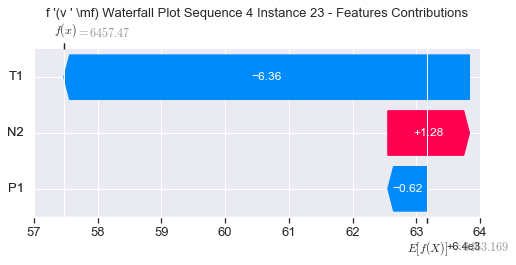

None

Contribution: [ -1.13930517 -15.96432232   3.4843377 ]


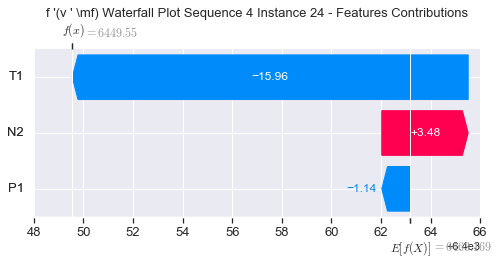

None

Contribution: [ -26.74292919 -280.49323177   51.86674673]


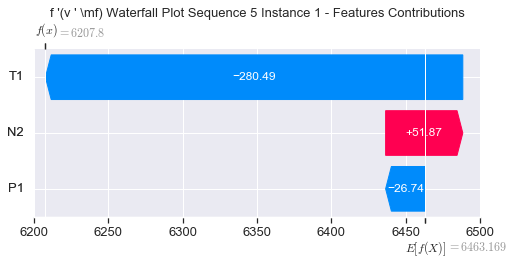

None

Contribution: [1.61136636 4.59272982 2.61449984]


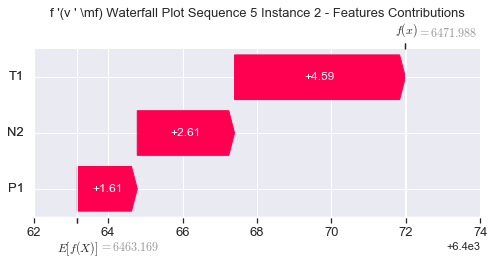

None

Contribution: [-0.51779144 -4.78507958  1.08942644]


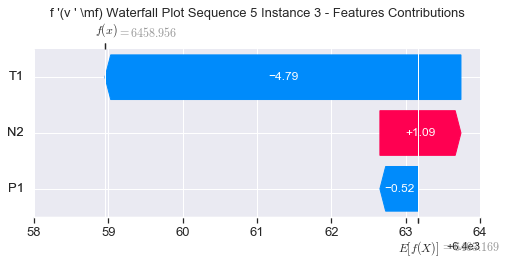

None

Contribution: [ 0.07952405 -0.28854663  0.48885752]


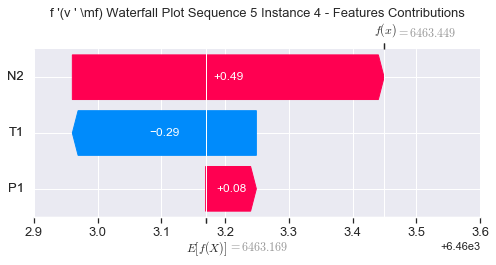

None

Contribution: [ 0.06441825 -0.16362301  0.34856959]


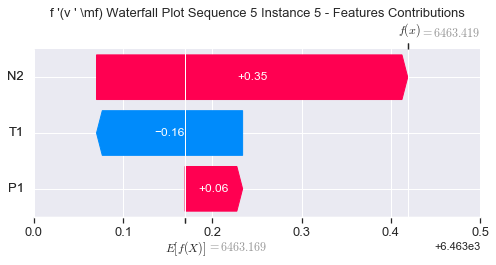

None

Contribution: [ 0.05700327 -0.1611479   0.31562699]


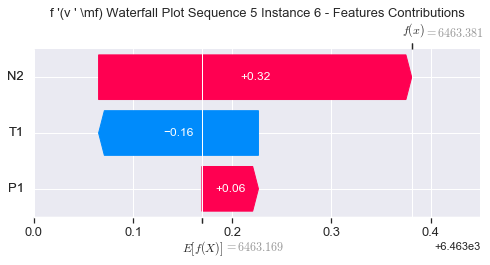

None

Contribution: [ 0.05255138 -0.17541734  0.3066734 ]


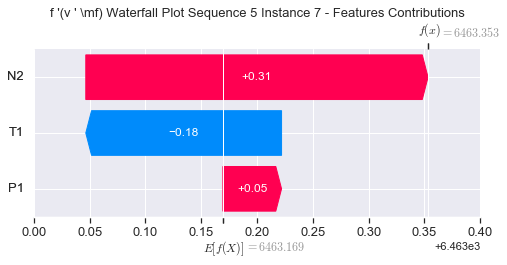

None

Contribution: [ 0.04925663 -0.17845647  0.29751698]


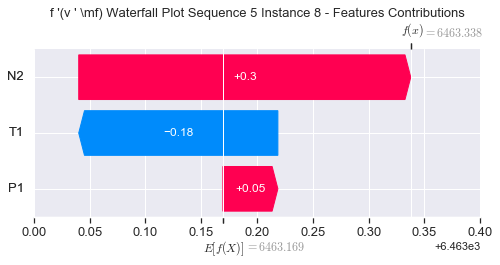

None

Contribution: [ 0.03687574 -0.16225255  0.29387639]


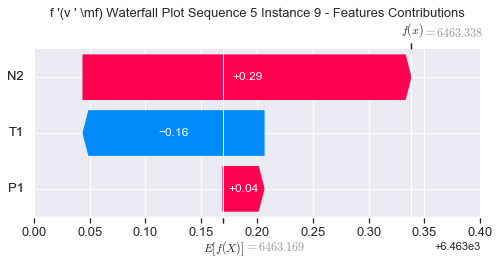

None

Contribution: [ 0.0195677  -0.15569408  0.28930343]


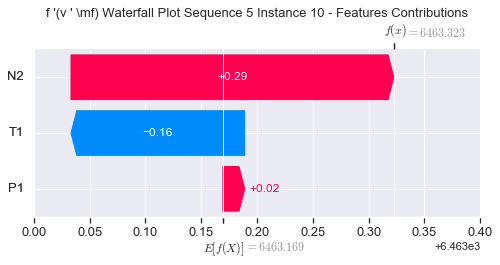

None

Contribution: [ 0.03671751 -0.13445243  0.28297011]


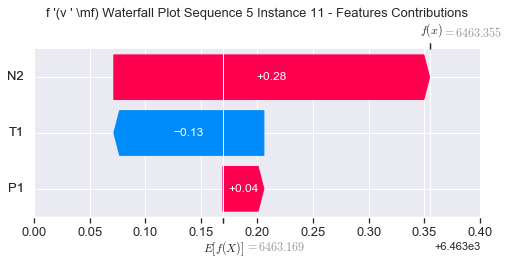

None

Contribution: [ 0.0432962  -0.16758954  0.27161341]


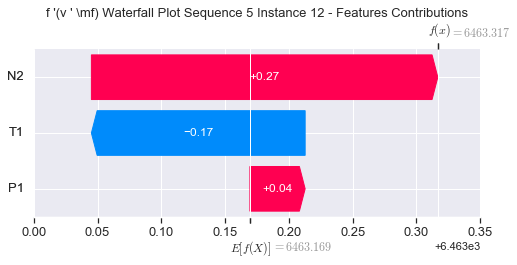

None

Contribution: [ 0.04506013 -0.14913938  0.26657684]


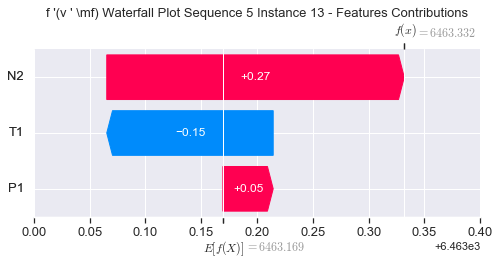

None

Contribution: [ 0.05241135 -0.12732585  0.2687552 ]


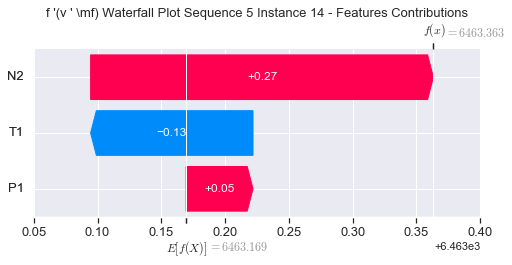

None

Contribution: [ 0.04729229 -0.10527675  0.25852358]


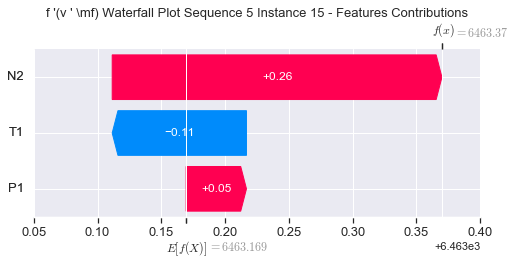

None

Contribution: [ 0.05876101 -0.06795507  0.2650635 ]


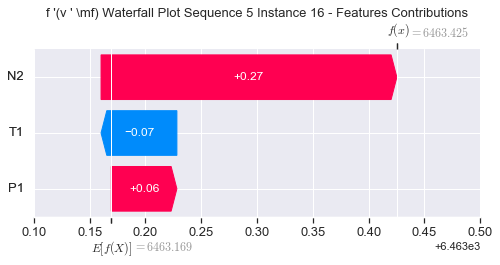

None

Contribution: [ 0.05652966 -0.01432006  0.25455552]


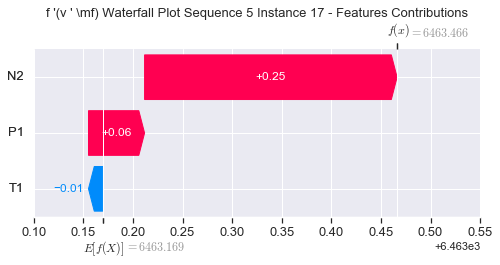

None

Contribution: [0.05935253 0.02651743 0.25607126]


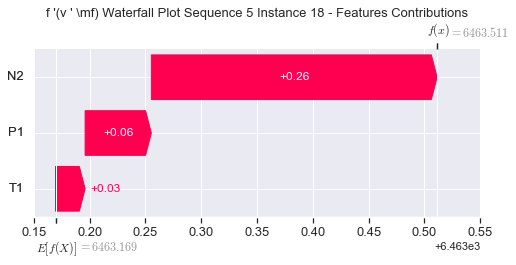

None

Contribution: [0.04001259 0.00641453 0.26259687]


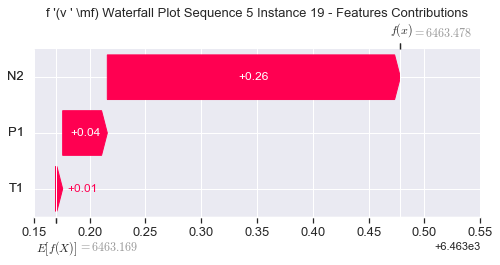

None

Contribution: [ 0.04024632 -0.13101738  0.28992666]


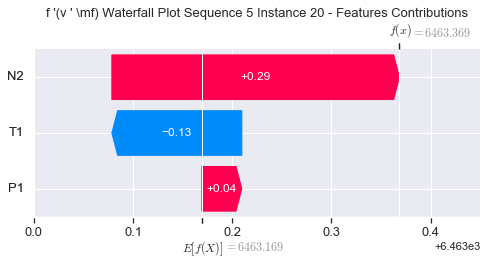

None

Contribution: [-0.00700298 -0.65171561  0.36434582]


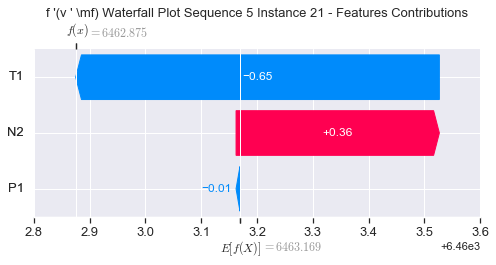

None

Contribution: [-0.14209658 -2.04297637  0.58082204]


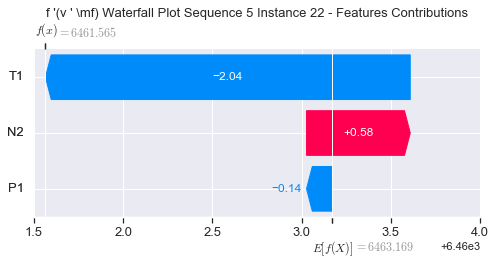

None

Contribution: [-0.52465883 -5.41990318  1.28196795]


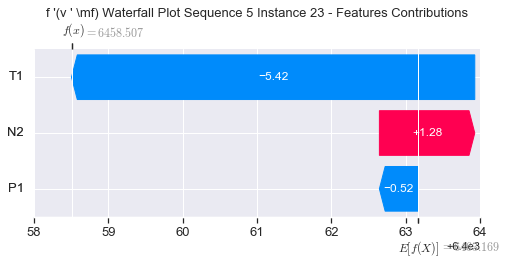

None

Contribution: [ -0.73330638 -13.79031759   3.48600838]


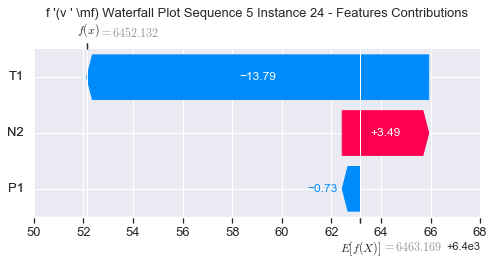

None

Contribution: [ -12.04979995 -256.69560751   51.15213232]


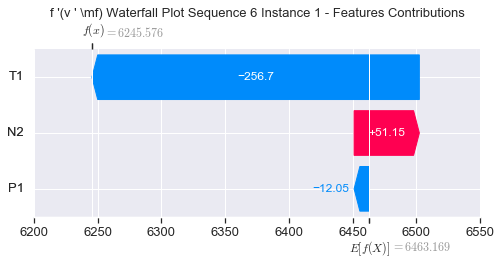

None

Contribution: [1.5149486  4.35797721 2.52523125]


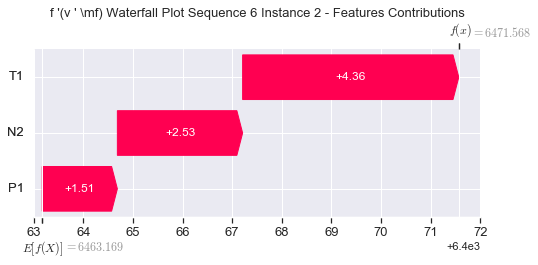

None

Contribution: [-0.39828142 -3.86176439  1.22444793]


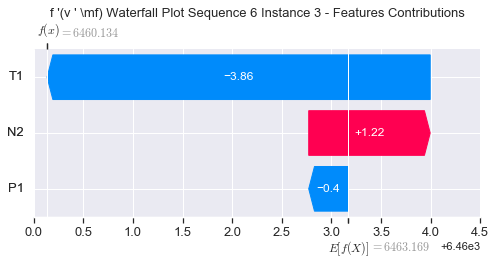

None

Contribution: [ 0.09556786 -0.24519353  0.49936601]


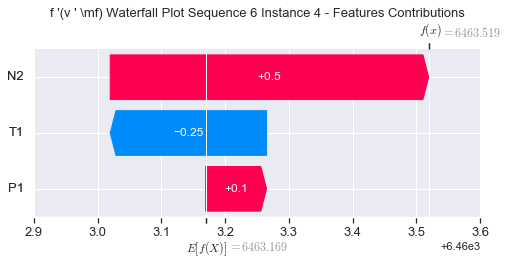

None

Contribution: [ 0.07541837 -0.11539725  0.35687825]


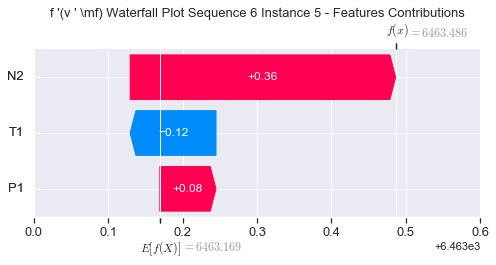

None

Contribution: [ 0.0657591  -0.14397281  0.32088582]


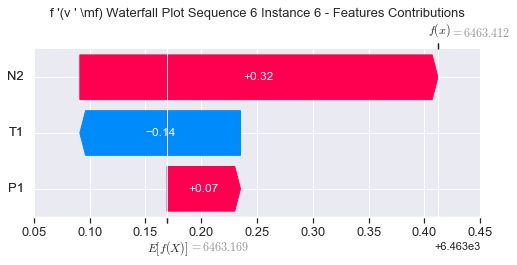

None

Contribution: [ 0.06204262 -0.16251259  0.31075803]


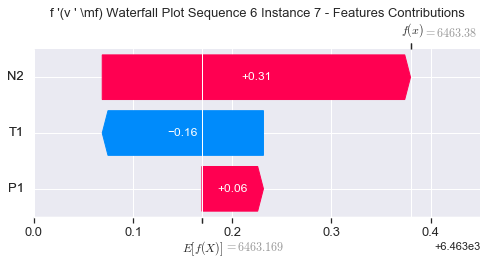

None

Contribution: [ 0.05690916 -0.17357756  0.30150954]


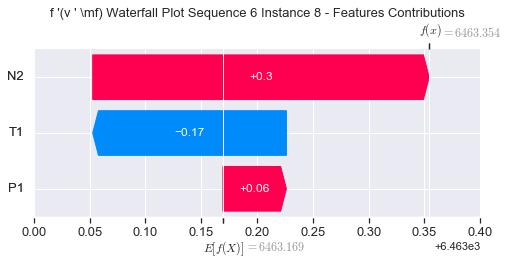

None

Contribution: [ 0.04475726 -0.18094175  0.29718918]


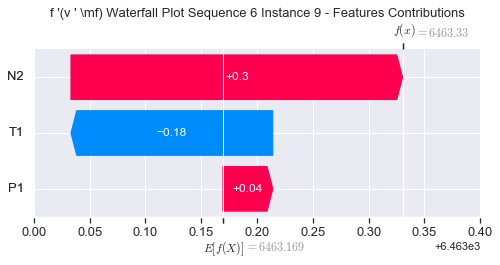

None

Contribution: [ 0.03025013 -0.15954976  0.29389455]


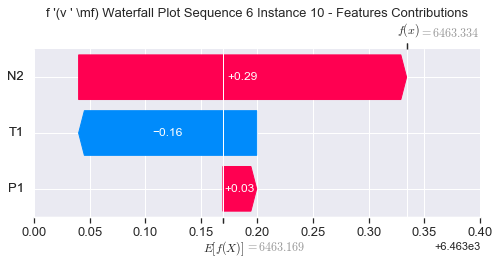

None

Contribution: [ 0.04152962 -0.17079536  0.28418336]


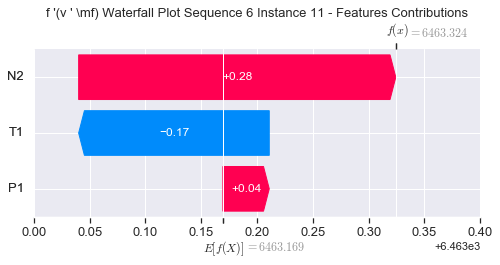

None

Contribution: [ 0.04948094 -0.18920267  0.26662375]


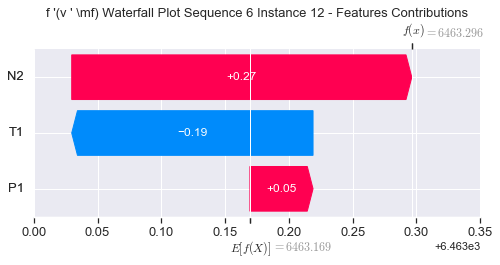

None

Contribution: [ 0.05074983 -0.16657926  0.26278819]


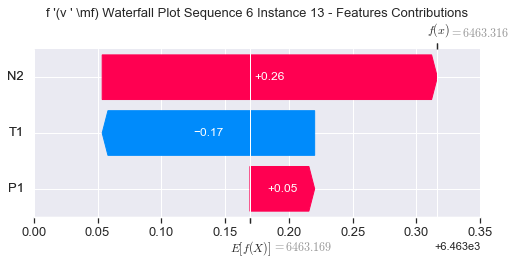

None

Contribution: [ 0.05086574 -0.12978787  0.2575585 ]


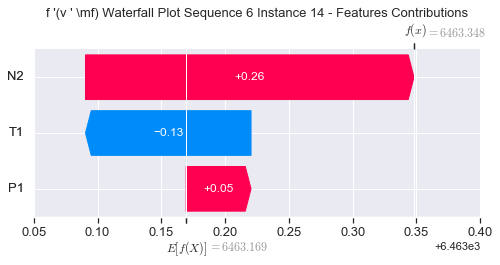

None

Contribution: [ 0.05097379 -0.12148463  0.25557026]


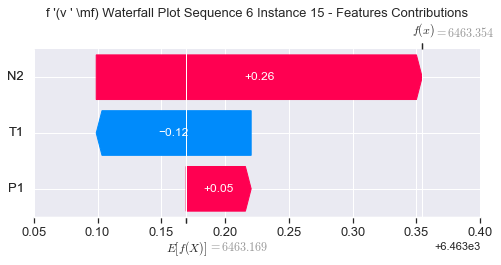

None

Contribution: [ 0.05477367 -0.08778712  0.25304306]


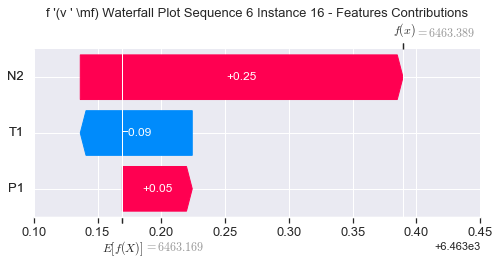

None

Contribution: [ 0.05931535 -0.02065941  0.25284377]


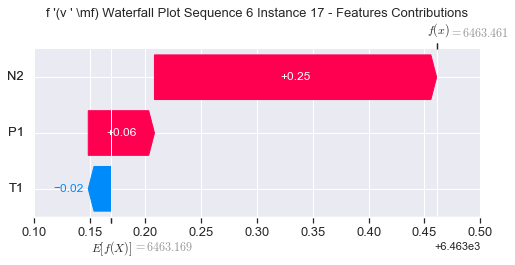

None

Contribution: [0.06154495 0.02402124 0.25520077]


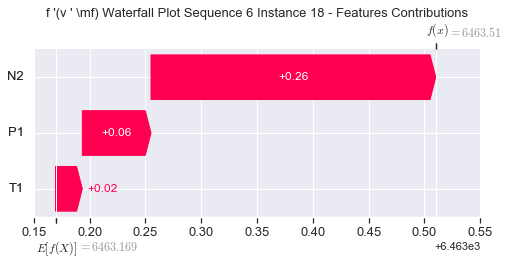

None

Contribution: [0.04383166 0.00204954 0.27077618]


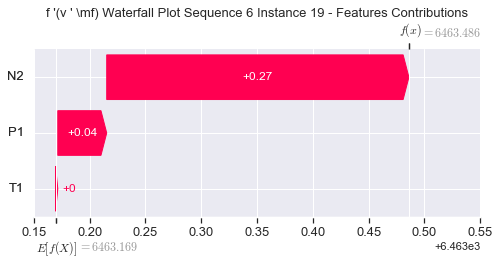

None

Contribution: [ 0.03806722 -0.19373004  0.29446406]


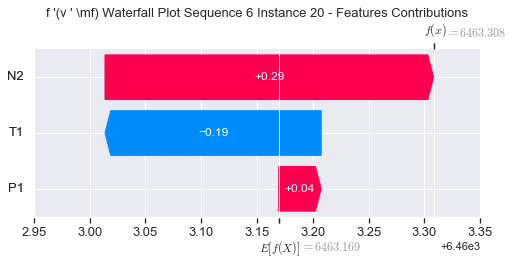

None

Contribution: [-0.02109717 -0.89022441  0.37133544]


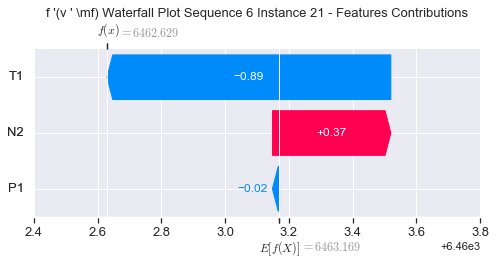

None

Contribution: [-0.19196373 -2.75059194  0.59707529]


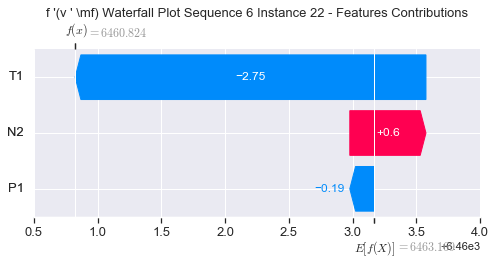

None

Contribution: [-0.69123451 -7.52165779  1.3205825 ]


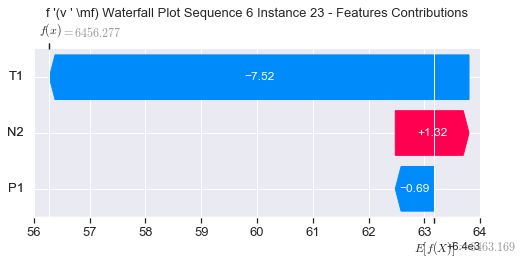

None

Contribution: [ -1.24072926 -18.72155336   3.66925607]


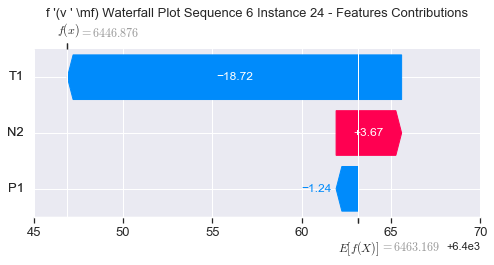

None

Contribution: [ -22.49977742 -334.51671563   51.45145073]


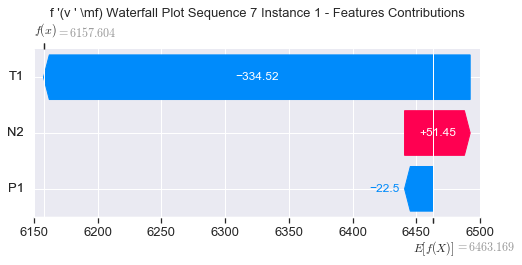

None

Contribution: [1.65481124 4.98880638 2.71464114]


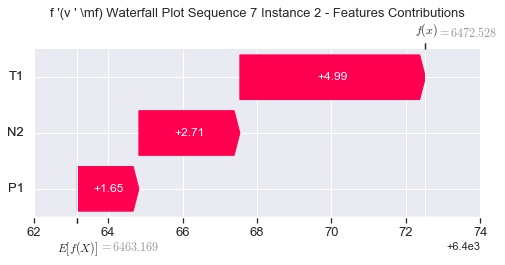

None

Contribution: [-0.40707522 -5.17623877  1.05672884]


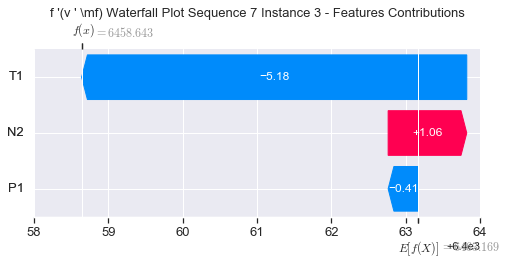

None

Contribution: [ 0.08999997 -0.42039128  0.49155401]


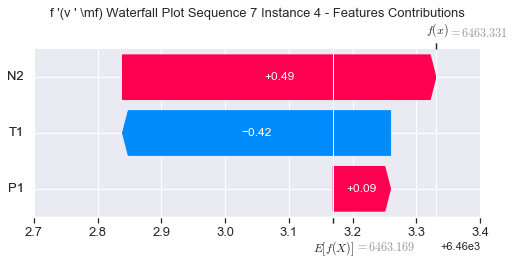

None

Contribution: [ 0.07263641 -0.23558703  0.34706875]


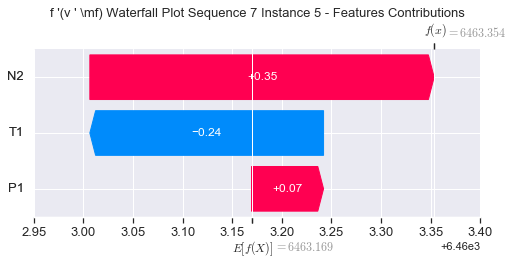

None

Contribution: [ 0.05802731 -0.25339717  0.31138982]


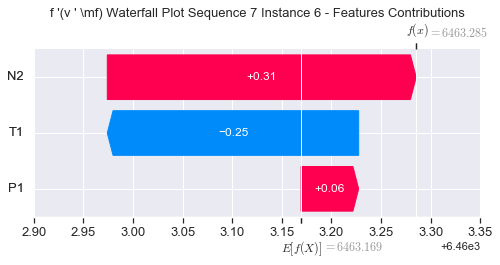

None

Contribution: [ 0.05172533 -0.26429312  0.30362378]


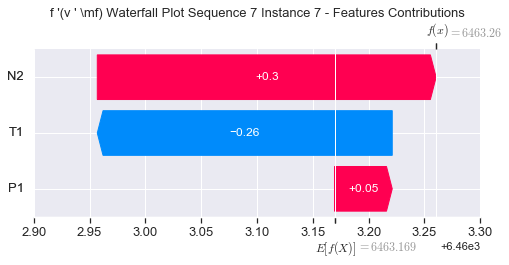

None

Contribution: [ 0.04914052 -0.27099747  0.29426975]


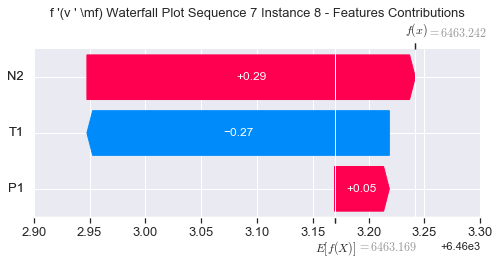

None

Contribution: [ 0.03323181 -0.24055612  0.28950033]


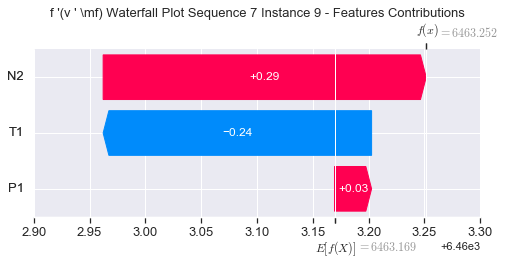

None

Contribution: [ 0.03410848 -0.22163396  0.28956942]


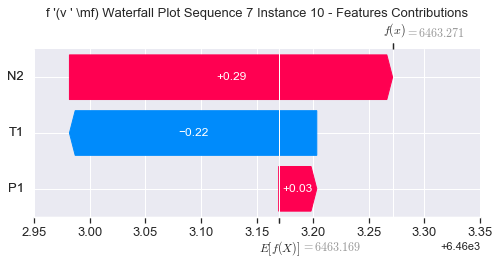

None

Contribution: [ 0.03700737 -0.24416954  0.27514171]


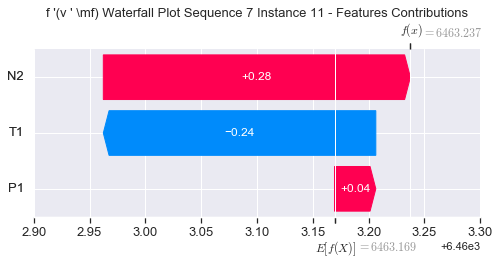

None

Contribution: [ 0.03942553 -0.2647856   0.26798731]


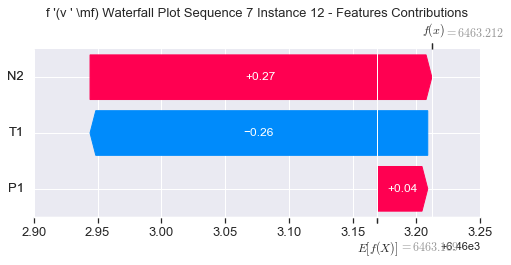

None

Contribution: [ 0.04002361 -0.24204502  0.26404281]


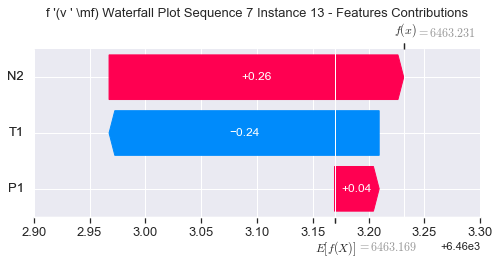

None

Contribution: [ 0.03757794 -0.19643572  0.26089782]


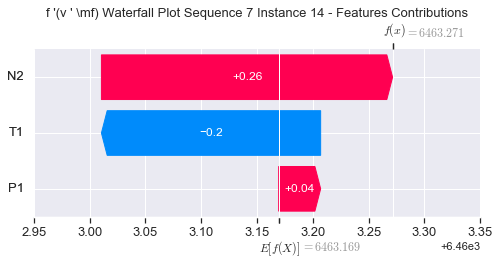

None

Contribution: [ 0.03941109 -0.20863638  0.25571981]


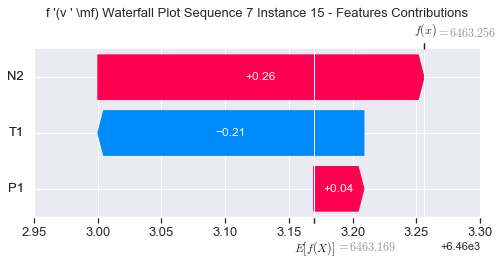

None

Contribution: [ 0.05222641 -0.17680272  0.25988106]


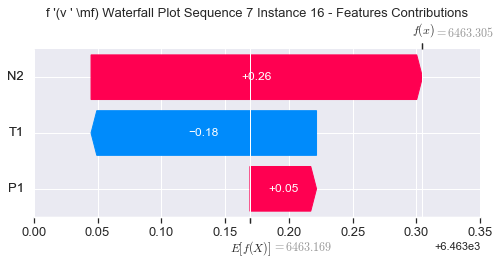

None

Contribution: [ 0.0442431  -0.12333568  0.25212591]


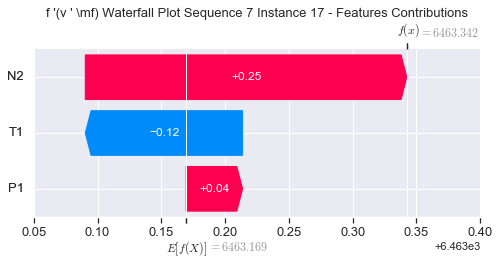

None

Contribution: [ 0.04523707 -0.0970018   0.25325829]


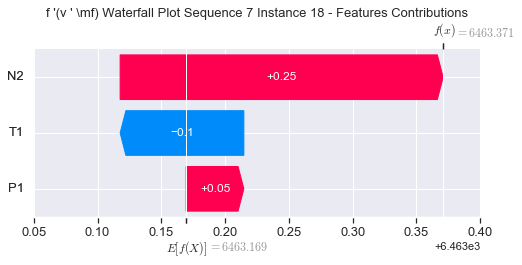

None

Contribution: [ 0.03797581 -0.14866442  0.27065235]


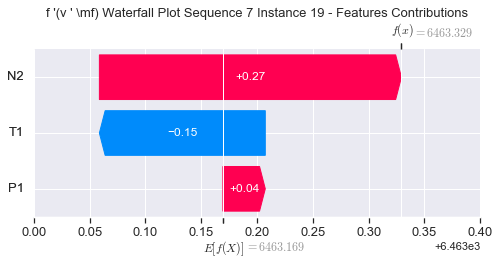

None

Contribution: [ 0.01349293 -0.34465805  0.28884674]


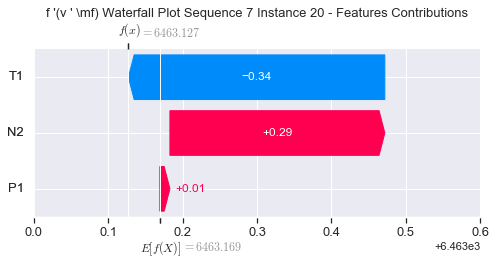

None

Contribution: [-0.05558524 -1.02769557  0.36397648]


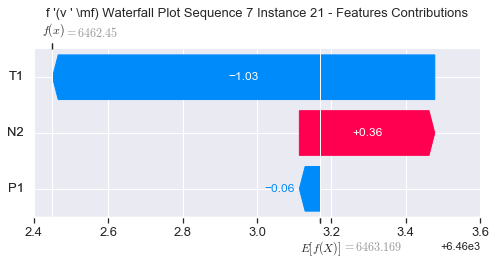

None

Contribution: [-0.23124845 -2.8425275   0.58570937]


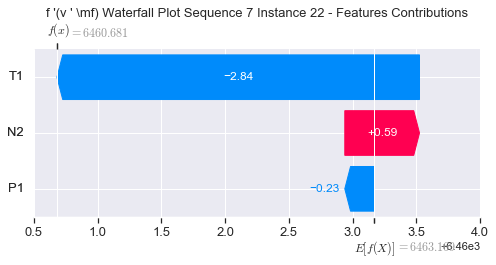

None

Contribution: [-0.76485676 -7.37833809  1.28423391]


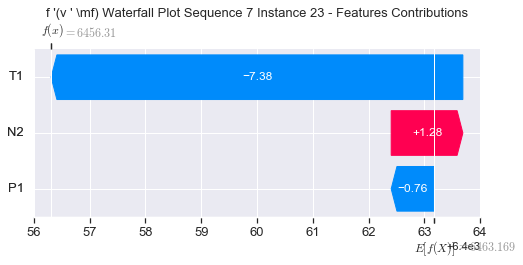

None

Contribution: [ -1.29428074 -18.49715986   3.53040763]


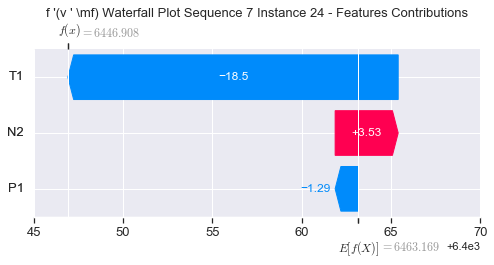

None

Contribution: [ -25.48184074 -331.63564607   50.67069656]


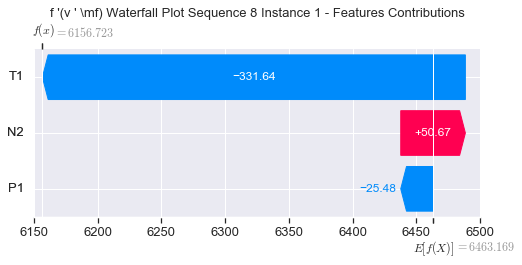

None

Contribution: [1.65666198 4.66841095 2.65357066]


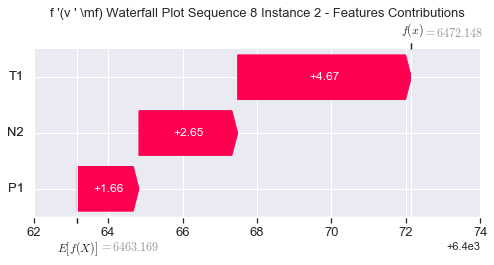

None

Contribution: [-0.49055962 -5.7999526   1.24699276]


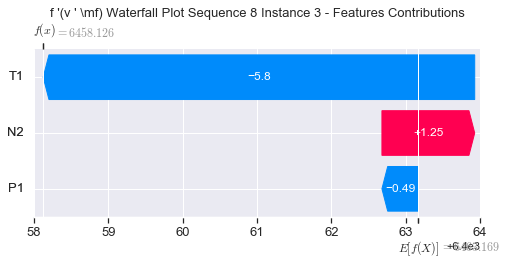

None

Contribution: [ 0.07064998 -0.42052141  0.49068035]


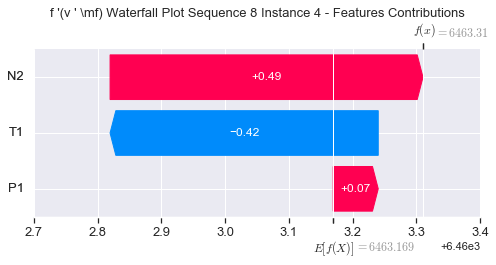

None

Contribution: [ 0.02910534 -0.24002547  0.33083509]


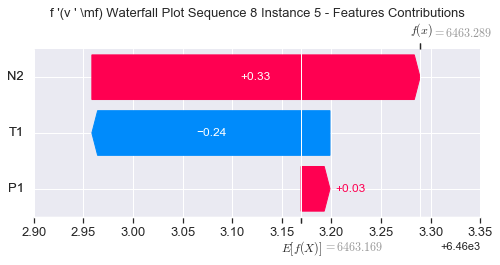

None

Contribution: [ 0.04897577 -0.20988049  0.31129599]


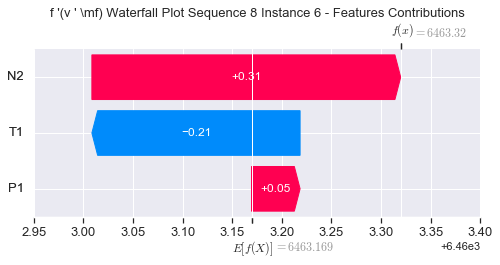

None

Contribution: [ 0.04360851 -0.22550497  0.30477578]


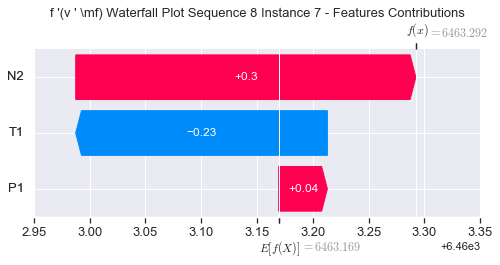

None

Contribution: [ 0.03999281 -0.22302547  0.29644132]


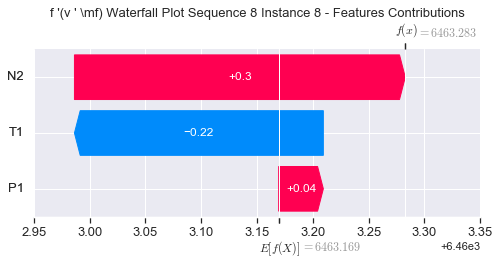

None

Contribution: [ 0.01456431 -0.23986436  0.30288345]


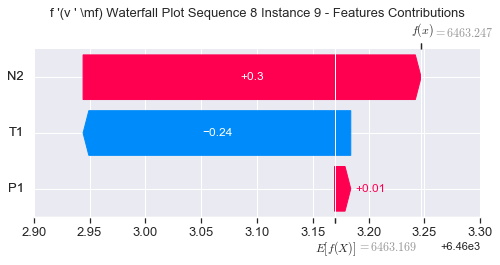

None

Contribution: [-0.02520752 -0.25221542  0.2942428 ]


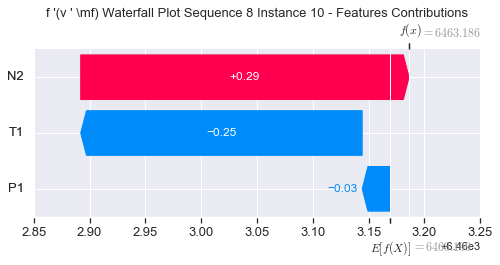

None

Contribution: [ 0.0392577  -0.15935515  0.29672594]


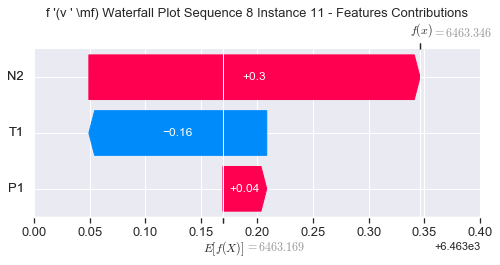

None

Contribution: [ 0.05464934 -0.1475693   0.27972786]


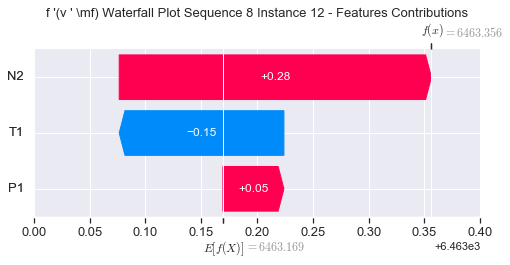

None

Contribution: [ 0.05008565 -0.14241163  0.27339935]


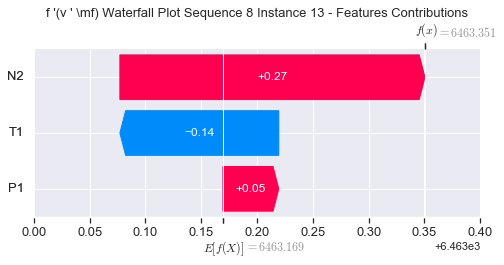

None

Contribution: [ 0.05232068 -0.13089144  0.27231943]


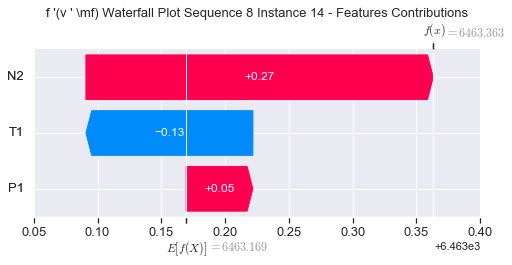

None

Contribution: [ 0.05547232 -0.11136537  0.26616648]


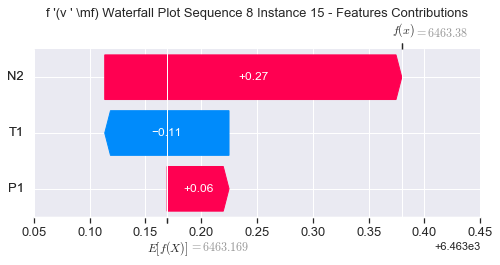

None

Contribution: [ 0.05540695 -0.08616032  0.26786731]


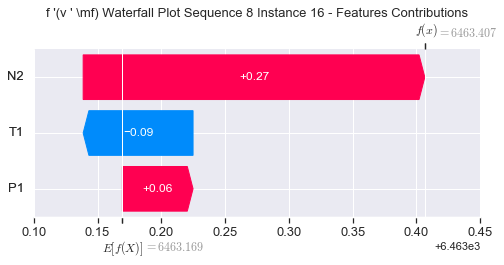

None

Contribution: [ 0.06231366 -0.03150999  0.26250963]


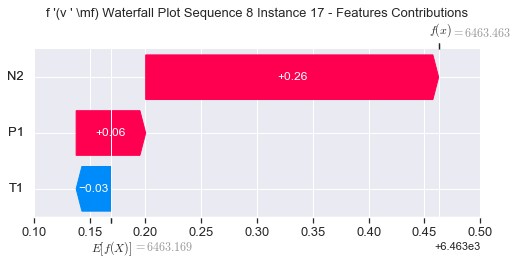

None

Contribution: [0.06674819 0.00638352 0.26425422]


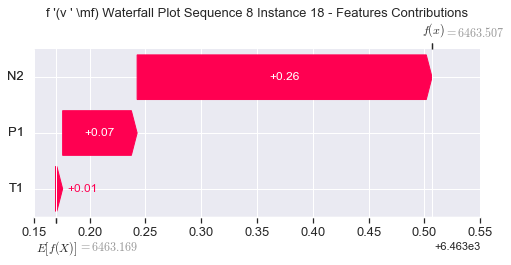

None

Contribution: [ 0.04549213 -0.04019621  0.27604954]


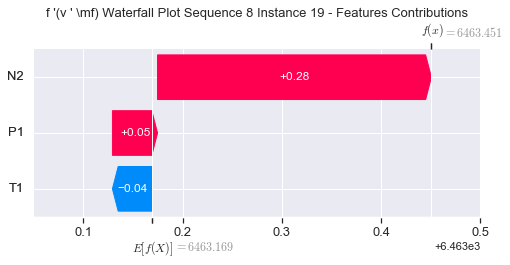

None

Contribution: [ 0.04228216 -0.15392438  0.30093235]


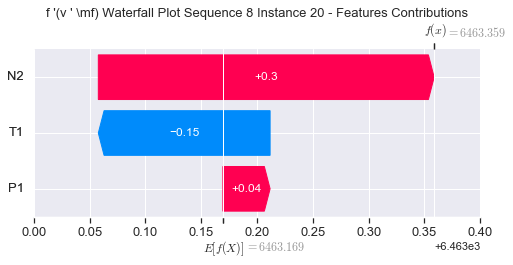

None

Contribution: [ 0.00654133 -0.58454982  0.38630718]


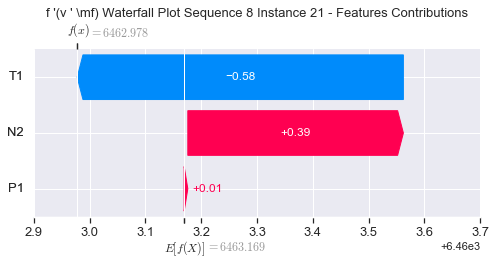

None

Contribution: [-0.09525449 -1.7240312   0.62414601]


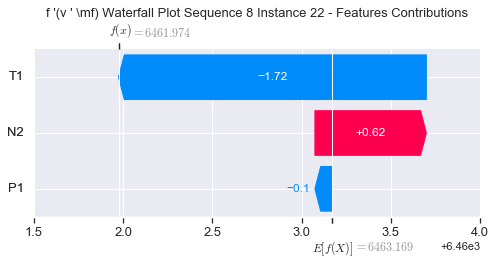

None

Contribution: [-0.22142385 -4.21740047  1.45242987]


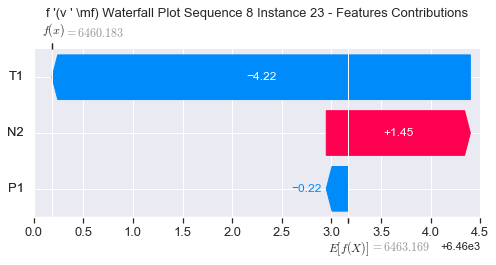

None

Contribution: [ -0.41897267 -11.63129976   3.68179163]


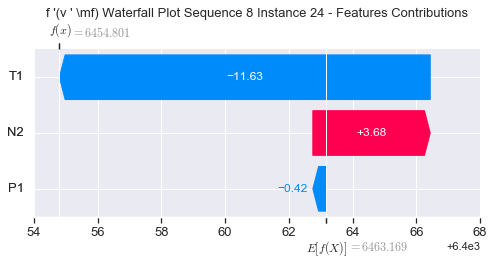

None

Contribution: [ -13.11906026 -224.32634314   52.62955731]


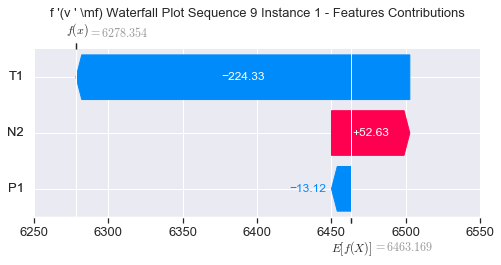

None

Contribution: [1.37346874 3.55309191 2.39555857]


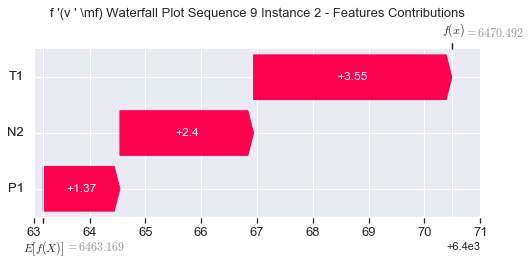

None

Contribution: [-0.18961099 -4.09043017  1.25897327]


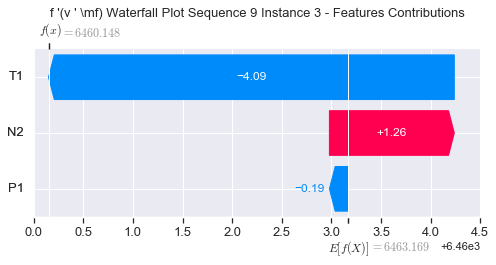

None

Contribution: [ 0.08555066 -0.12204434  0.48867214]


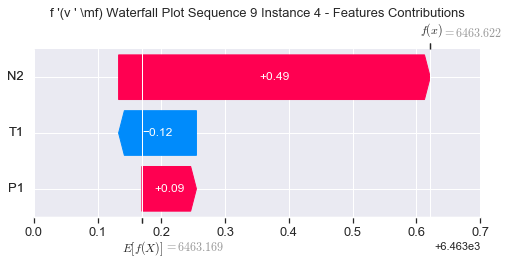

None

Contribution: [ 0.07621669 -0.0748019   0.35665886]


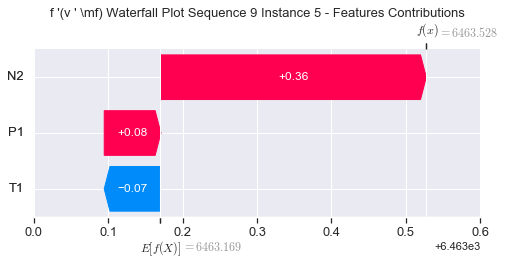

None

Contribution: [ 0.06429181 -0.09633084  0.32024374]


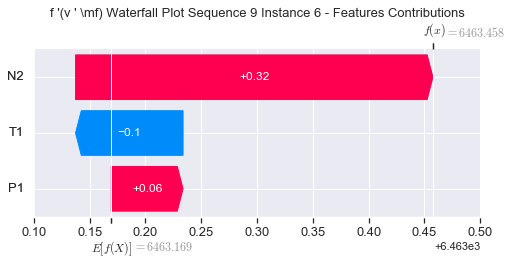

None

Contribution: [ 0.0609525  -0.10804851  0.31110698]


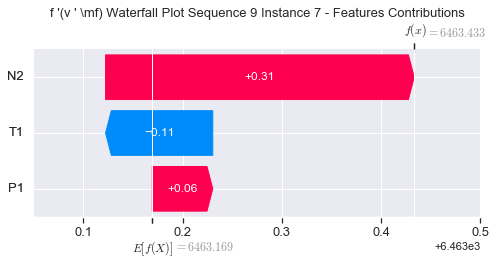

None

Contribution: [ 0.05998029 -0.11304529  0.30201601]


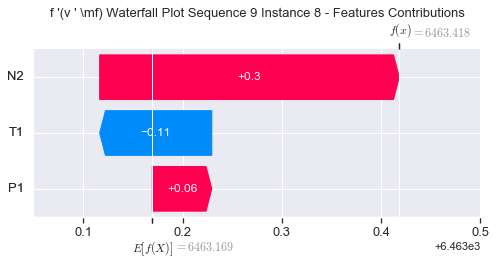

None

Contribution: [ 0.06066938 -0.09124339  0.29972579]


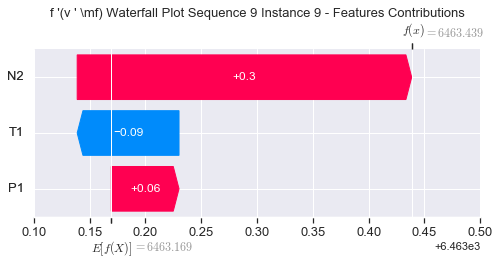

None

Contribution: [ 0.04417947 -0.0825361   0.29787921]


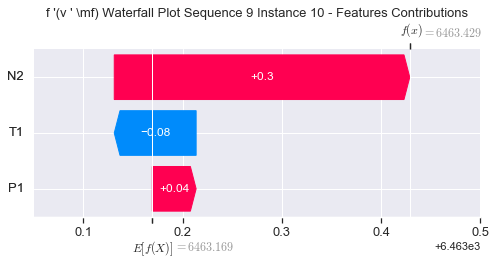

None

Contribution: [ 0.05830427 -0.08136239  0.28749115]


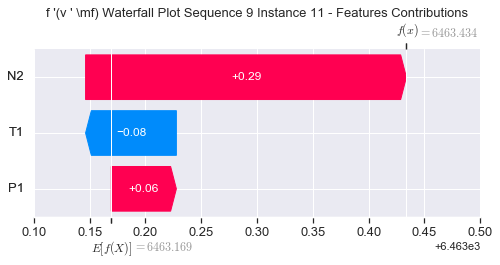

None

Contribution: [ 0.05648781 -0.11511745  0.27557165]


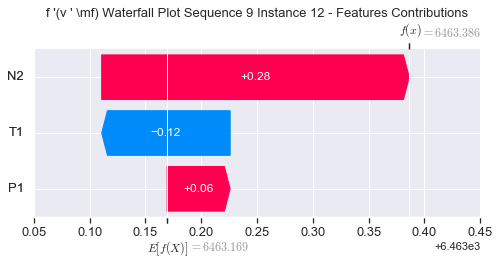

None

Contribution: [ 0.05903987 -0.09038532  0.270682  ]


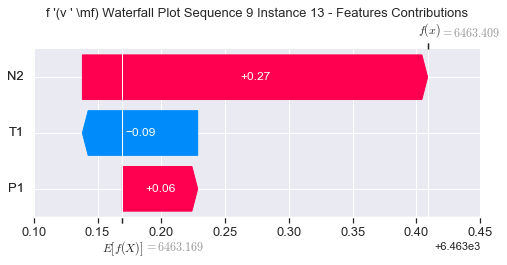

None

Contribution: [ 0.06808125 -0.07666217  0.27140191]


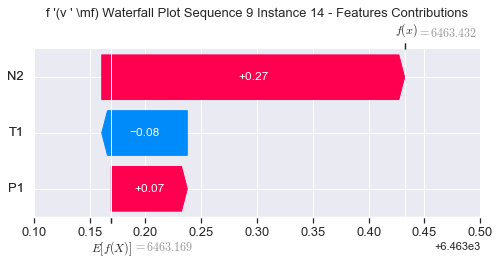

None

Contribution: [ 0.06054573 -0.04293455  0.26172425]


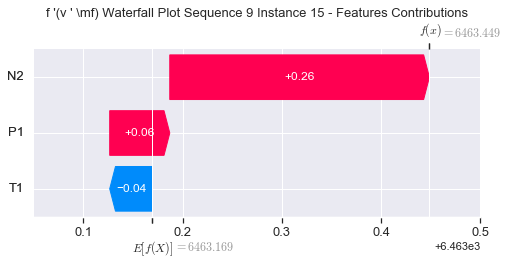

None

Contribution: [ 0.06891566 -0.01332519  0.26210876]


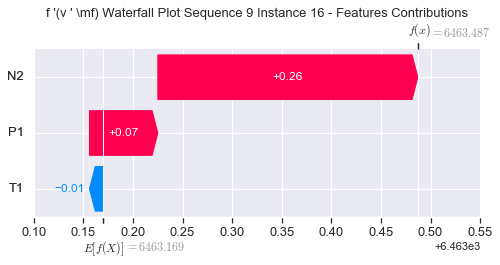

None

Contribution: [0.07029393 0.06760996 0.25772959]


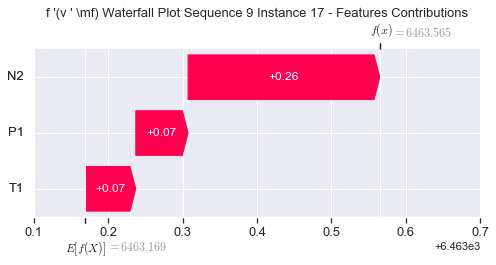

None

Contribution: [0.07385042 0.12157545 0.25969382]


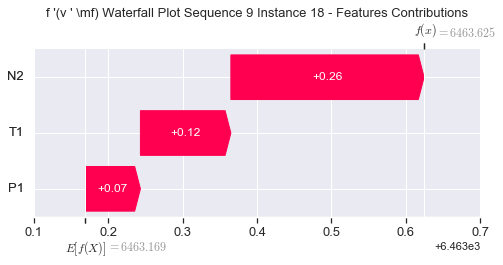

None

Contribution: [0.05734537 0.14291666 0.27567618]


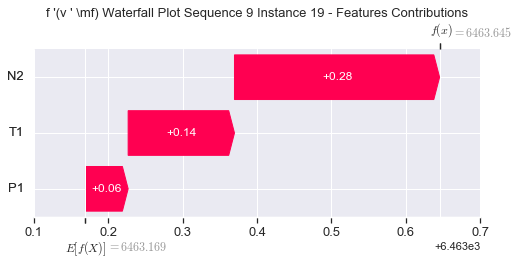

None

Contribution: [0.07116749 0.00603176 0.30079333]


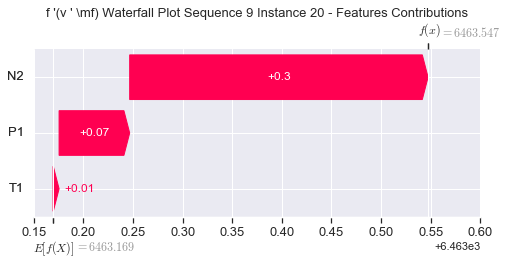

None

Contribution: [ 0.05937729 -0.4973298   0.38844563]


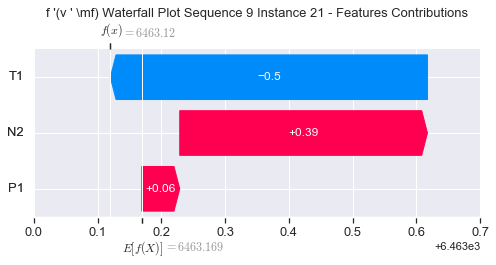

None

Contribution: [ 0.01721058 -1.88106671  0.63971045]


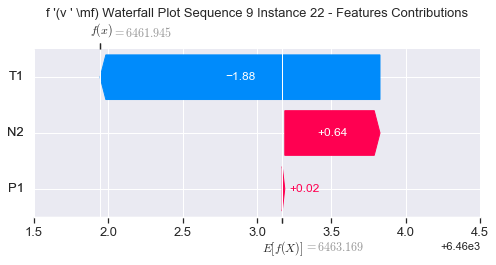

None

Contribution: [-0.16919682 -5.41077143  1.41885823]


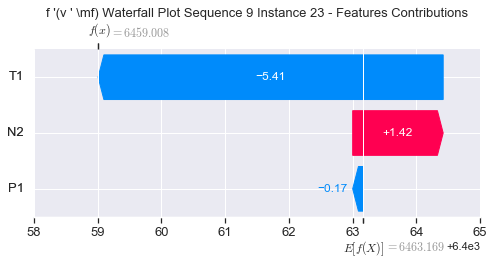

None

Contribution: [  0.08464594 -14.04530499   3.7547715 ]


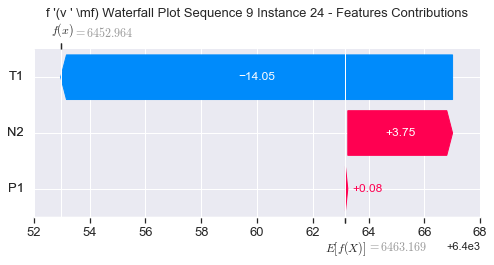

None

Contribution: [   3.70027293 -266.97811087   54.10083654]


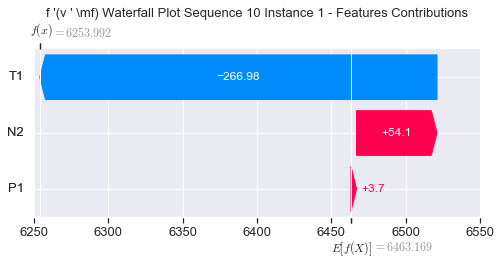

None

Contribution: [1.02543078 4.31498525 2.34845494]


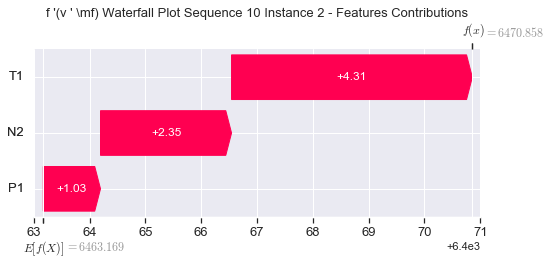

None

Contribution: [-0.13909263 -4.04004524  1.2569505 ]


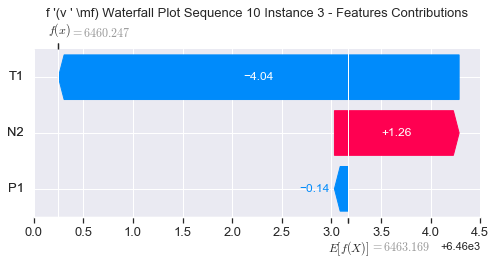

None

Contribution: [ 0.12594744 -0.23115198  0.50216649]


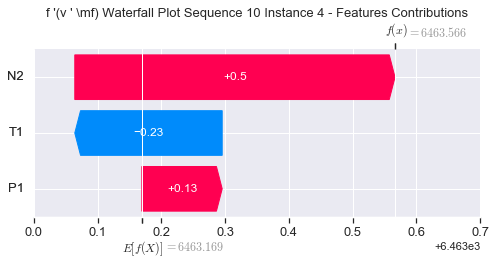

None

Contribution: [ 0.09921718 -0.05790321  0.35937633]


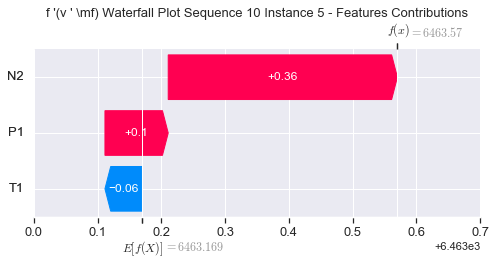

None

Contribution: [ 0.09857846 -0.14235287  0.3285012 ]


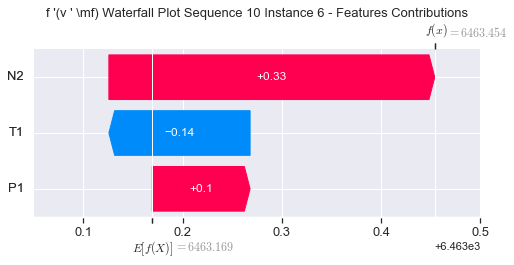

None

Contribution: [ 0.0897717  -0.17909493  0.31778076]


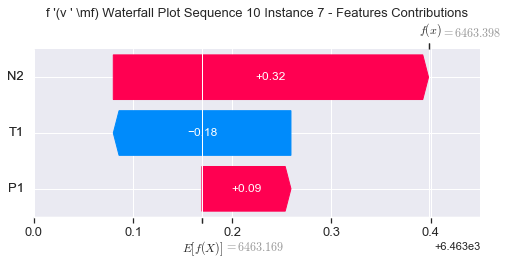

None

Contribution: [ 0.09543991 -0.16142501  0.30951814]


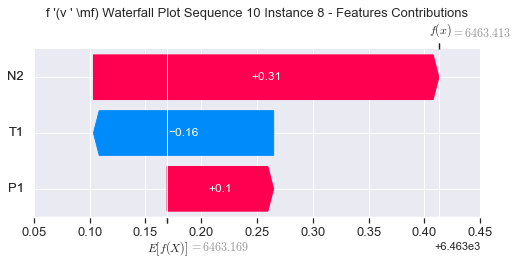

None

Contribution: [ 0.10734286 -0.10285058  0.30543391]


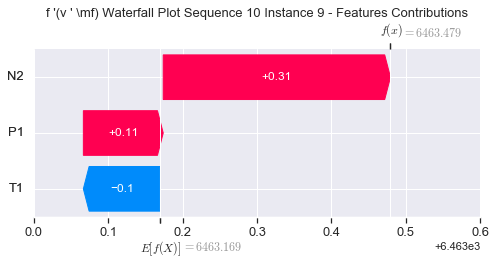

None

Contribution: [ 0.09478948 -0.07197199  0.30410577]


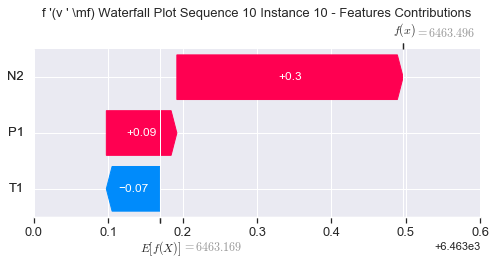

None

Contribution: [ 0.13539735 -0.0406403   0.30458874]


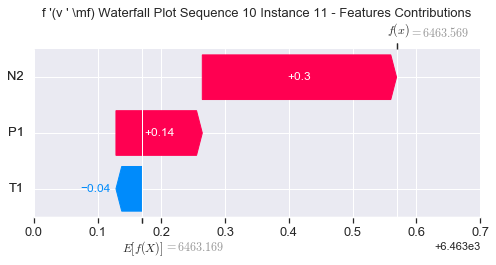

None

Contribution: [ 0.09050494 -0.17012943  0.28611517]


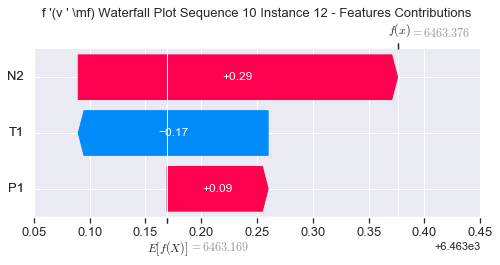

None

Contribution: [ 0.08545175 -0.15378242  0.27769907]


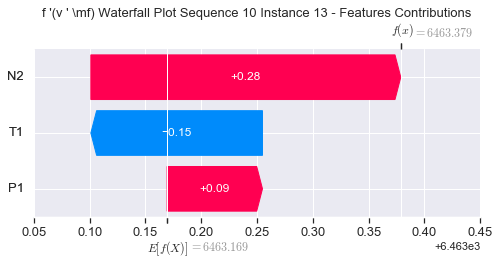

None

Contribution: [ 0.08884179 -0.07892481  0.2720261 ]


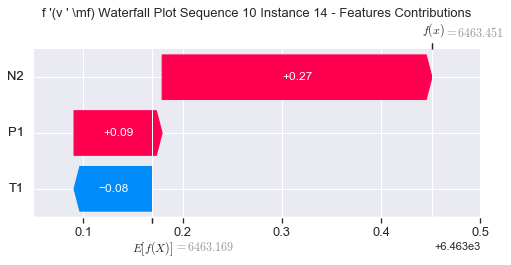

None

Contribution: [ 0.0827877  -0.1199093   0.26628811]


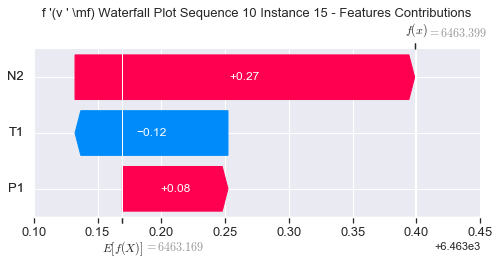

None

Contribution: [ 0.0620982  -0.18047668  0.25870075]


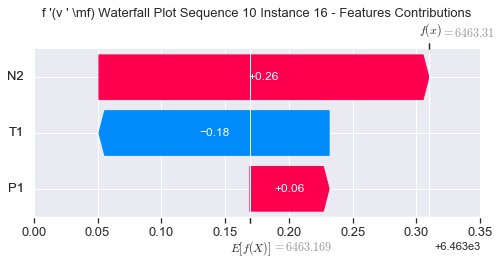

None

Contribution: [ 0.08233642 -0.02171087  0.25808903]


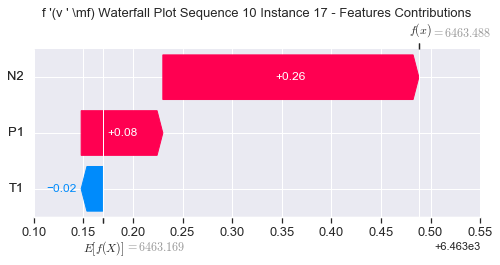

None

Contribution: [0.08561115 0.02685426 0.25968399]


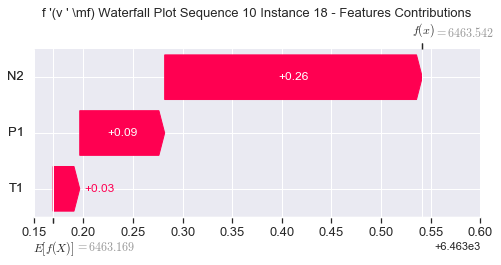

None

Contribution: [ 0.0655952  -0.06917259  0.27799736]


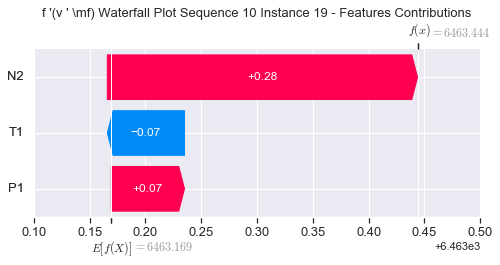

None

Contribution: [ 0.0959094  -0.20343579  0.29750247]


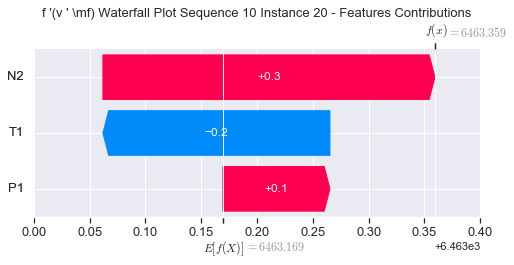

None

Contribution: [ 0.1289694  -0.87763632  0.38418695]


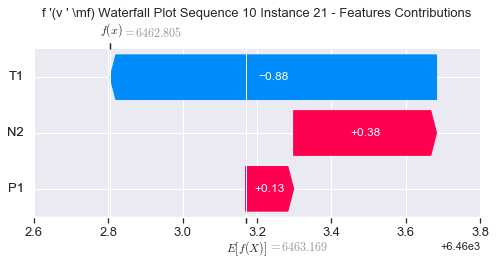

None

Contribution: [ 0.22657631 -2.57059219  0.63674556]


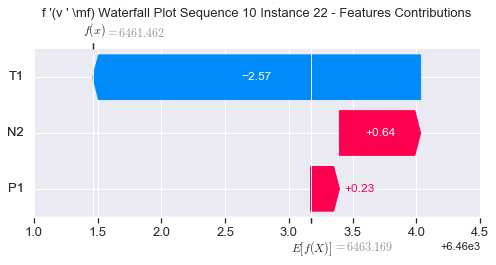

None

Contribution: [ 0.44112908 -7.36890459  1.45207193]


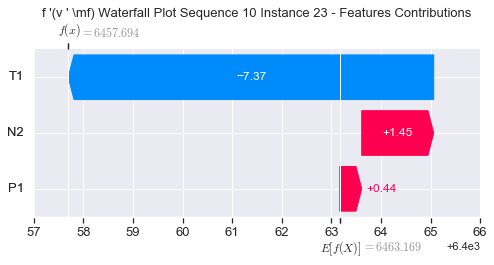

None

Contribution: [  1.16703658 -17.23842486   3.66860561]


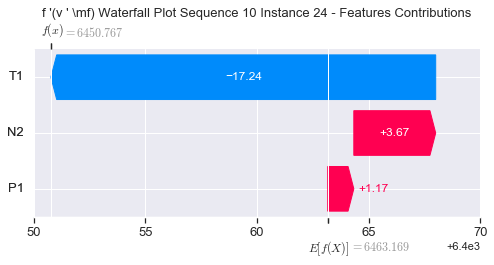

None

Contribution: [   2.75318286 -274.22719327   46.80805721]


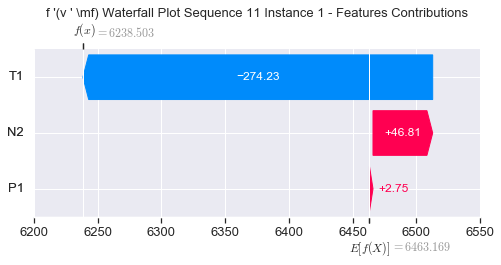

None

Contribution: [0.59825694 4.67815302 2.40979959]


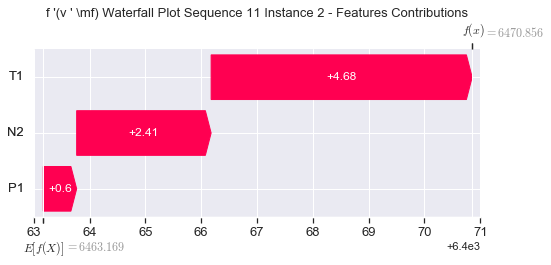

None

Contribution: [ 0.30158857 -4.06769721  1.31725254]


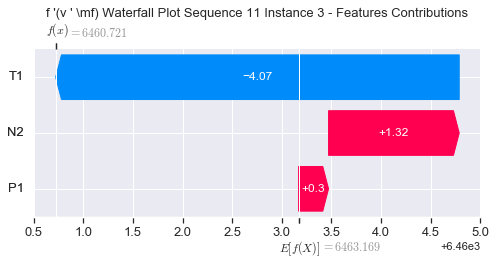

None

Contribution: [ 0.17969274 -0.11823406  0.50442476]


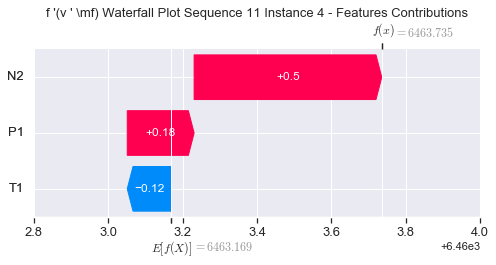

None

Contribution: [ 0.12608303 -0.03979761  0.36610616]


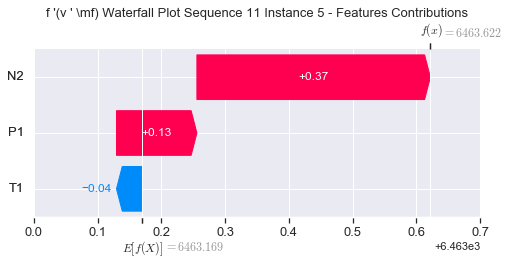

None

Contribution: [ 0.12230085 -0.0433017   0.3317292 ]


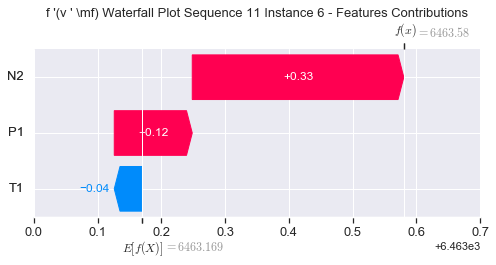

None

Contribution: [ 0.11449951 -0.04846853  0.32202155]


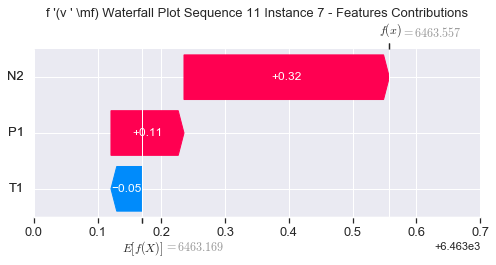

None

Contribution: [ 0.11357265 -0.05284105  0.31214429]


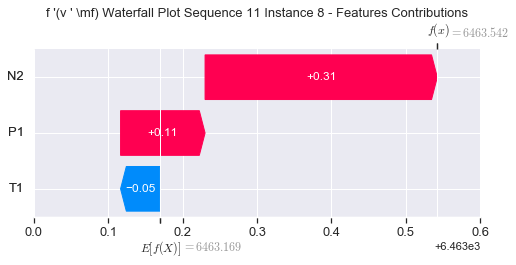

None

Contribution: [ 0.08362788 -0.04070598  0.30455701]


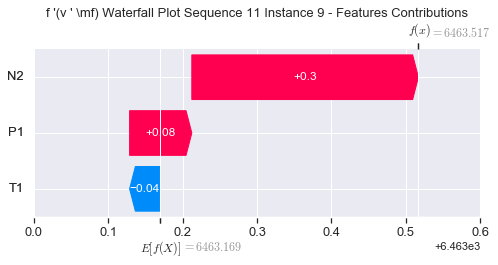

None

Contribution: [ 0.07097577 -0.03548365  0.30298604]


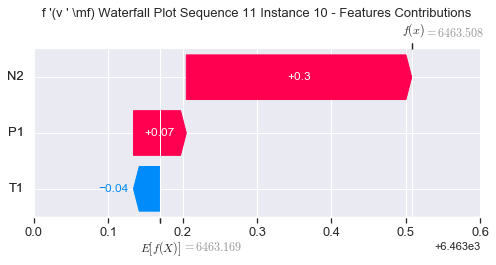

None

Contribution: [ 0.10449606 -0.03842708  0.29551886]


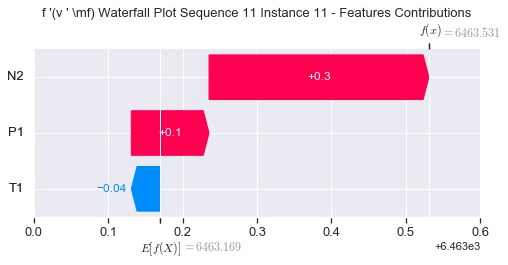

None

Contribution: [ 0.10920341 -0.05130865  0.28403179]


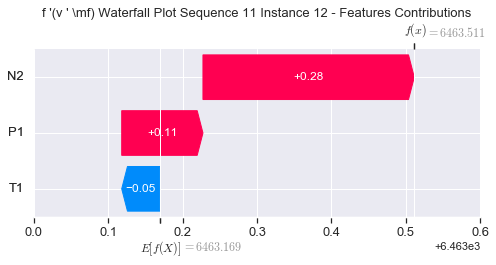

None

Contribution: [ 0.1041866  -0.02758379  0.27751191]


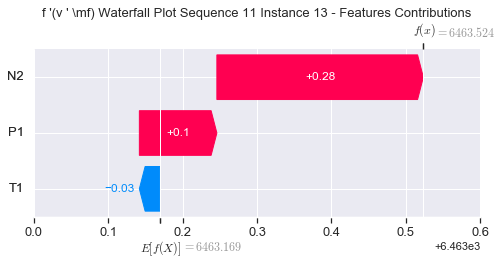

None

Contribution: [ 0.10136709 -0.00242255  0.27306339]


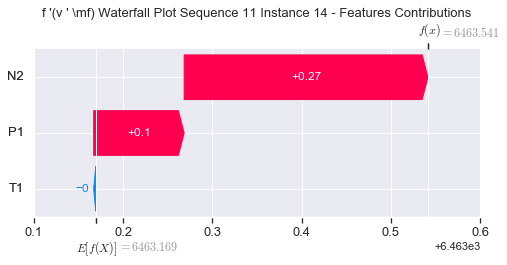

None

Contribution: [0.09818381 0.01072258 0.26593846]


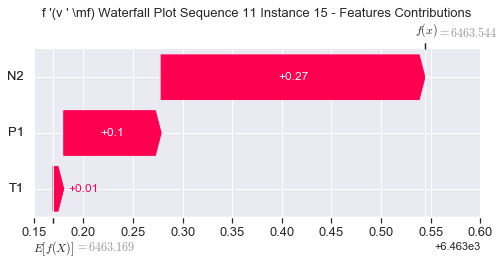

None

Contribution: [0.11922669 0.03019499 0.26391523]


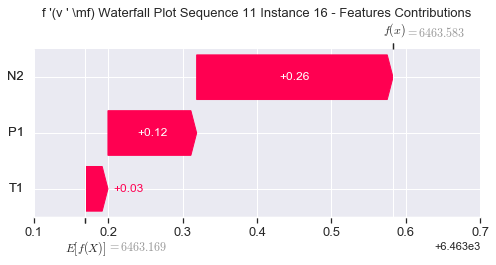

None

Contribution: [0.09338799 0.10241725 0.25929408]


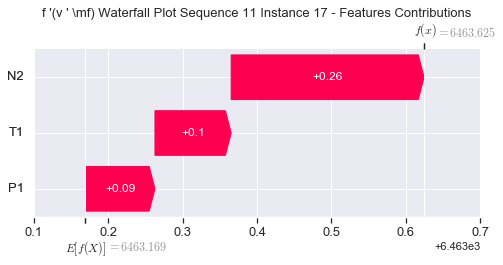

None

Contribution: [0.09557046 0.14912439 0.26056421]


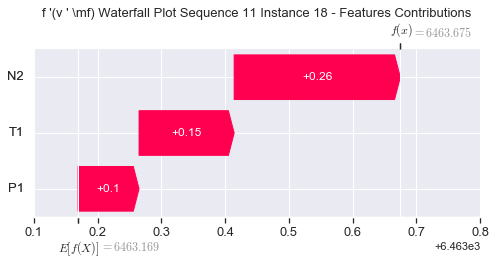

None

Contribution: [0.09692523 0.17895575 0.27762927]


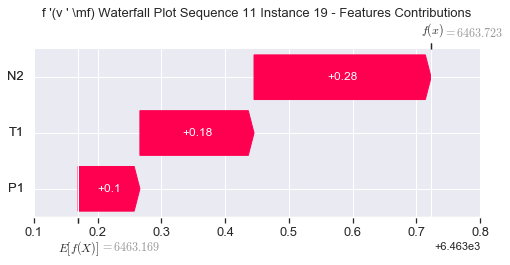

None

Contribution: [0.11798724 0.13955346 0.2966488 ]


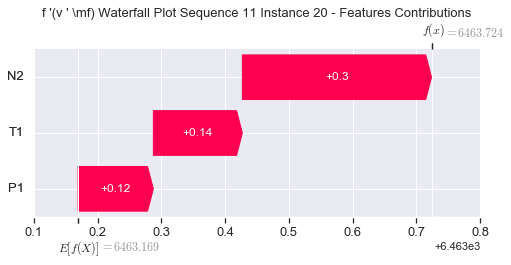

None

Contribution: [ 0.17756989 -0.09713667  0.37558663]


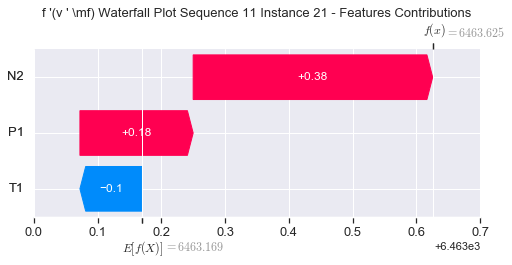

None

Contribution: [ 0.33302609 -0.80663324  0.60247641]


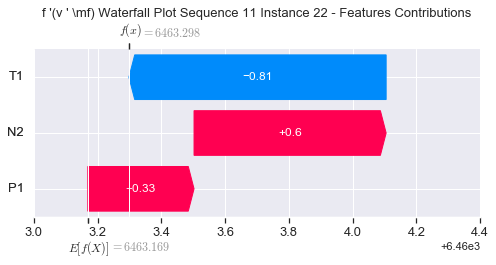

None

Contribution: [ 0.69204189 -2.5156062   1.32325915]


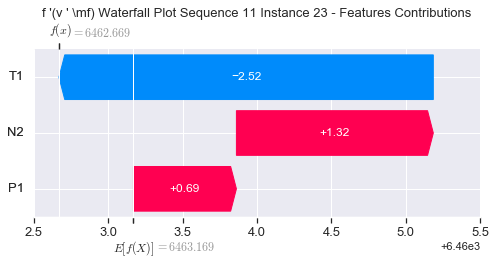

None

Contribution: [ 2.0484525  -6.86152945  3.52153174]


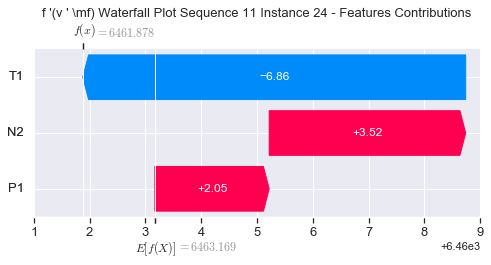

None

Contribution: [  32.28039244 -127.88258829   52.83718375]


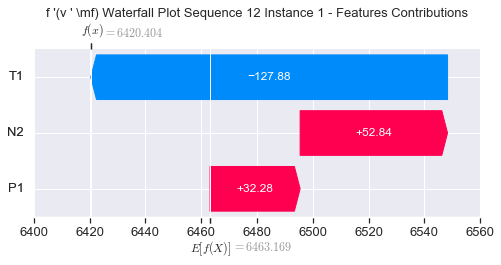

None

Contribution: [0.21390099 2.98403094 2.21998173]


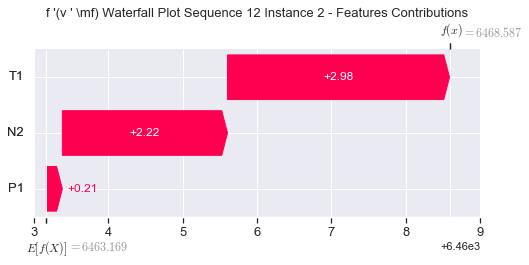

None

Contribution: [ 0.4367077  -1.79582594  1.13980271]


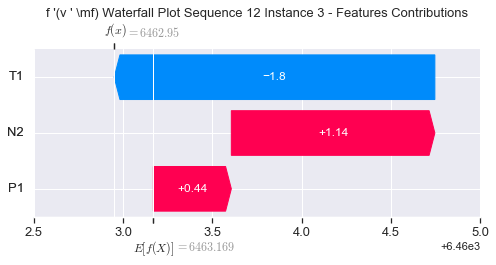

None

Contribution: [0.17383483 0.00749378 0.49953418]


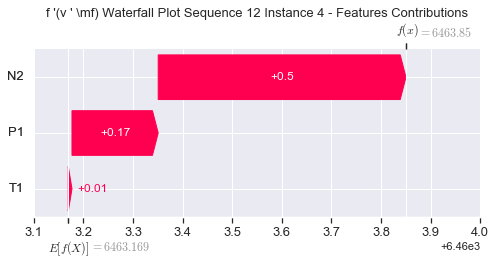

None

Contribution: [0.1254793  0.03923771 0.37171048]


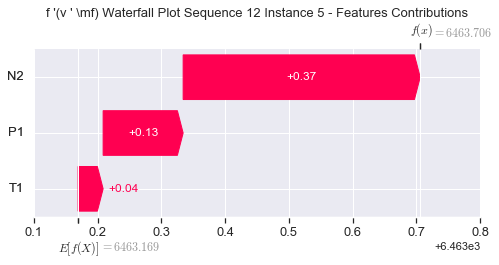

None

Contribution: [0.11502368 0.00978523 0.33443013]


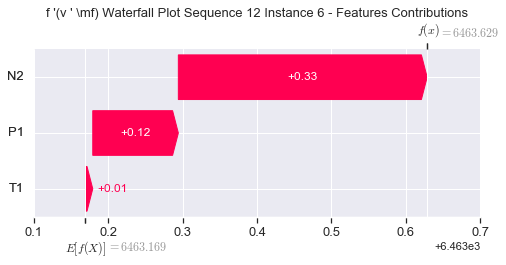

None

Contribution: [ 0.11219389 -0.00395633  0.3241862 ]


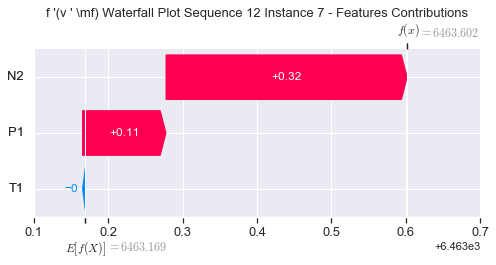

None

Contribution: [ 0.10823731 -0.00366213  0.31291962]


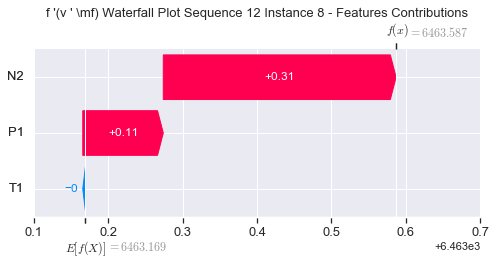

None

Contribution: [ 0.09666584 -0.0027607   0.30610708]


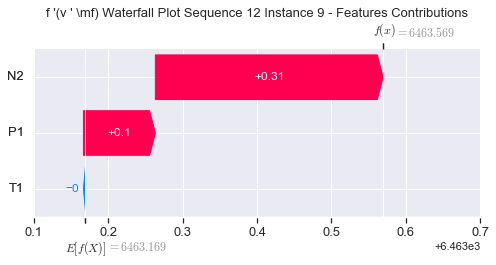

None

Contribution: [0.10287973 0.01308788 0.30649978]


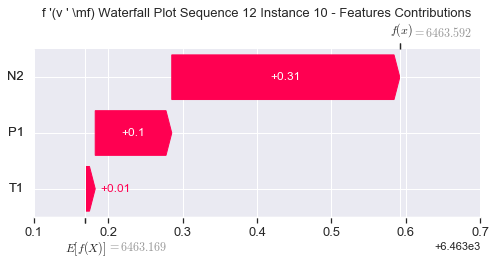

None

Contribution: [0.09177256 0.02538944 0.29102899]


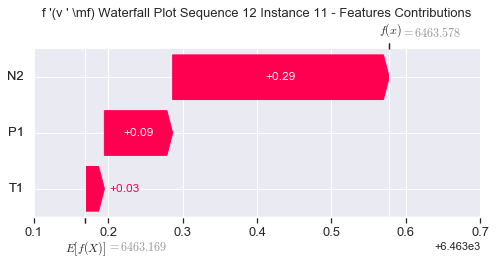

None

Contribution: [0.09326483 0.00604208 0.2796444 ]


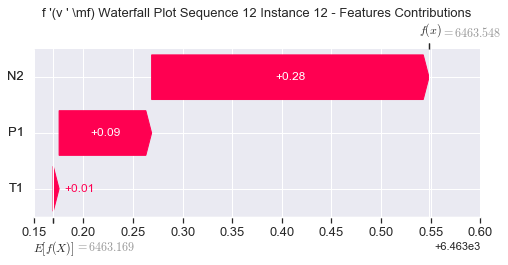

None

Contribution: [0.0930097  0.04231932 0.27450455]


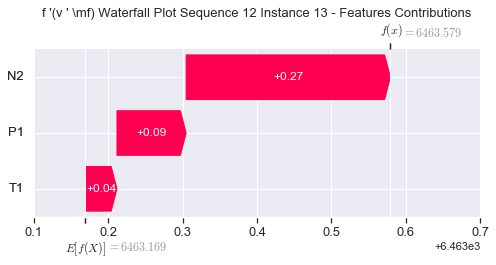

None

Contribution: [0.09291774 0.07078632 0.26977846]


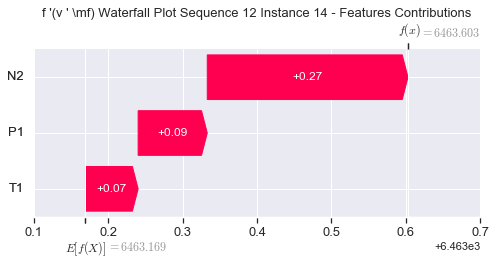

None

Contribution: [0.08601433 0.12562188 0.26505656]


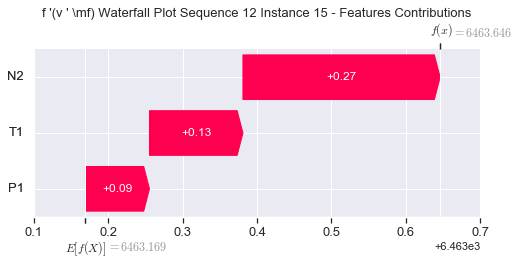

None

Contribution: [0.0928732  0.19283944 0.25913128]


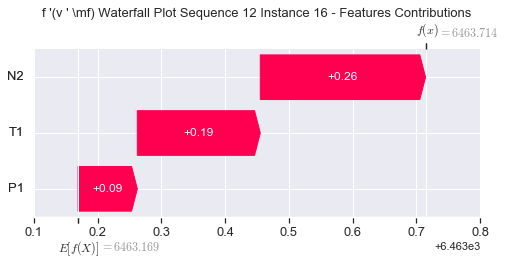

None

Contribution: [0.08201655 0.29341697 0.26020332]


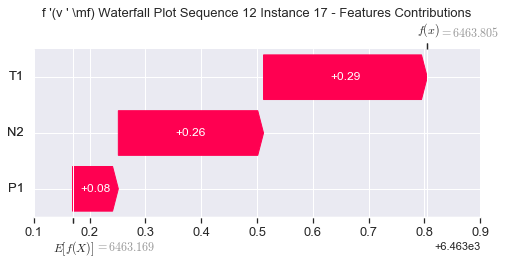

None

Contribution: [0.08129199 0.38823098 0.2621873 ]


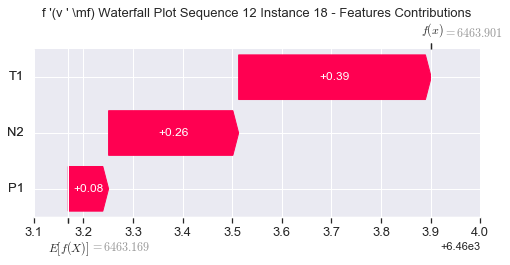

None

Contribution: [0.07512437 0.46098021 0.27733139]


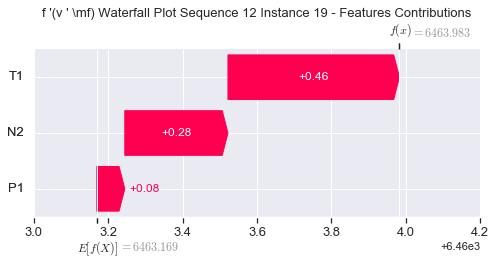

None

Contribution: [0.10400936 0.41710703 0.30697207]


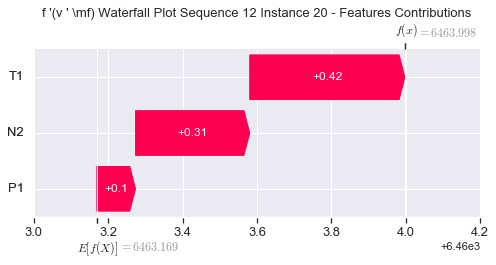

None

Contribution: [0.1605064  0.09550225 0.39923788]


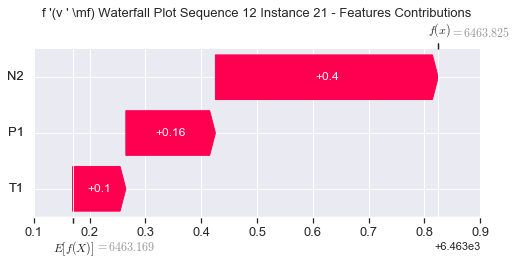

None

Contribution: [ 0.29052994 -0.86973979  0.65313373]


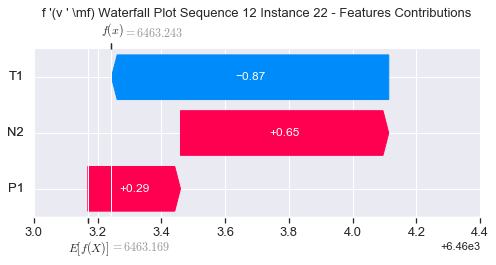

None

Contribution: [ 0.52824486 -3.47014139  1.44403832]


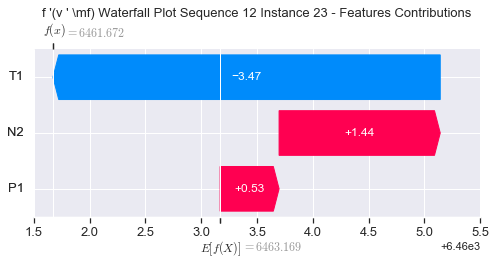

None

Contribution: [ 1.63702556 -8.92114274  3.93876341]


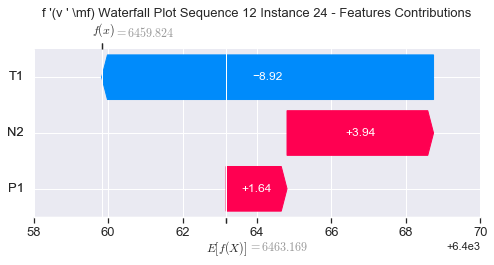

None

Contribution: [  22.11080342 -144.82863166   63.6200326 ]


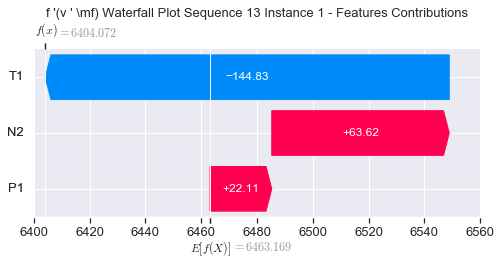

None

Contribution: [0.396585   3.64192363 2.14396046]


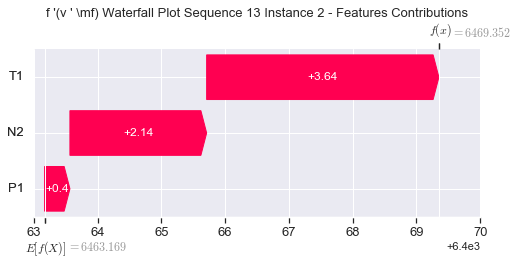

None

Contribution: [ 0.1863597  -2.00490304  1.20840025]


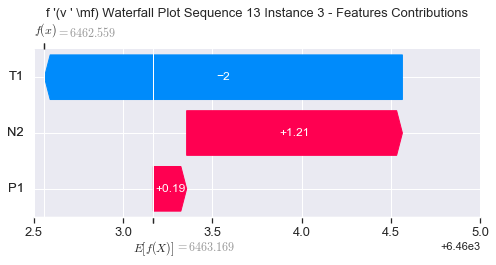

None

Contribution: [0.14384445 0.00585552 0.50465828]


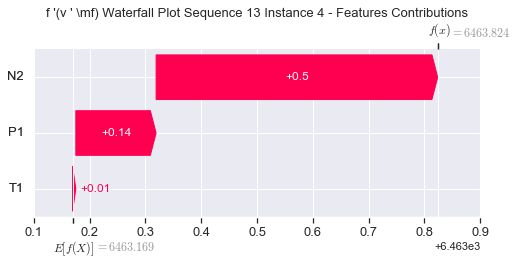

None

Contribution: [0.1114864  0.00761984 0.3706304 ]


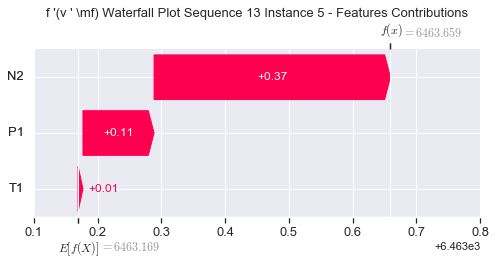

None

Contribution: [ 0.10001424 -0.00424268  0.33227055]


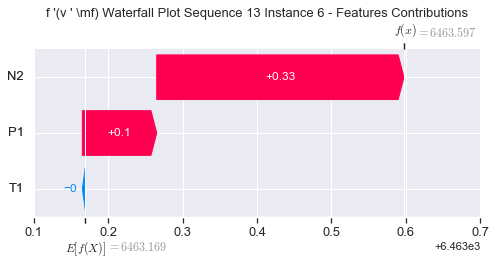

None

Contribution: [ 0.09671926 -0.01276158  0.32261829]


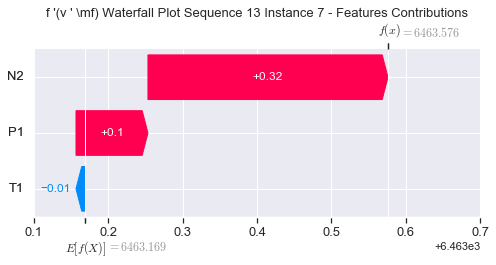

None

Contribution: [ 0.09380321 -0.01156639  0.31230246]


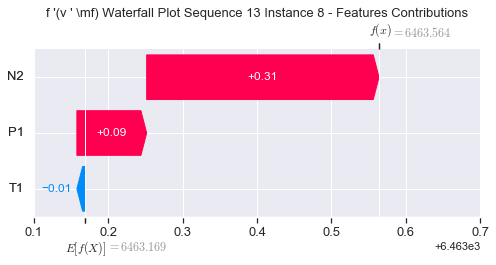

None

Contribution: [ 0.08957494 -0.00482126  0.31016674]


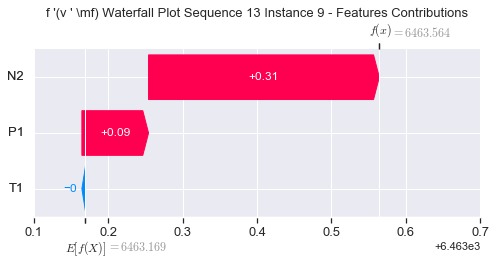

None

Contribution: [ 0.07503469 -0.04621697  0.30179537]


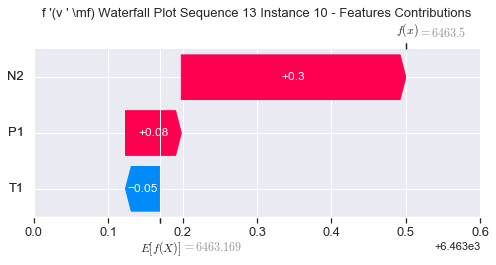

None

Contribution: [0.08731689 0.02846357 0.2963021 ]


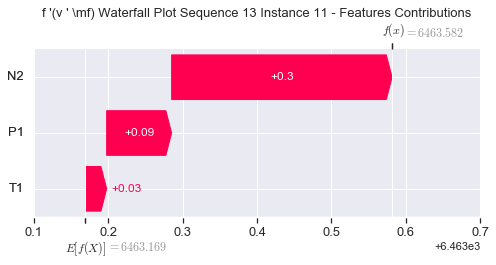

None

Contribution: [0.08568654 0.02903987 0.28401425]


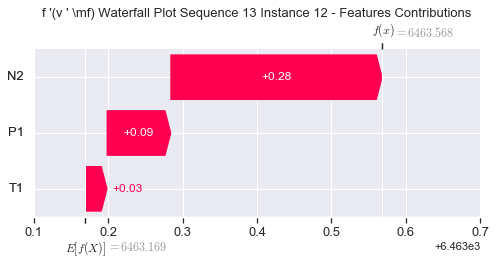

None

Contribution: [0.0855343  0.05788205 0.27807751]


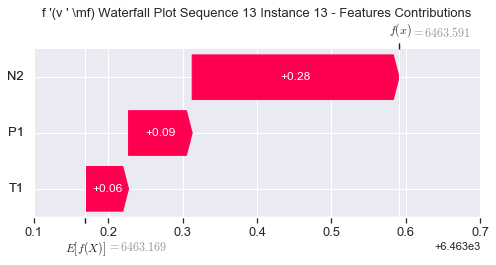

None

Contribution: [0.08667956 0.09913398 0.27373406]


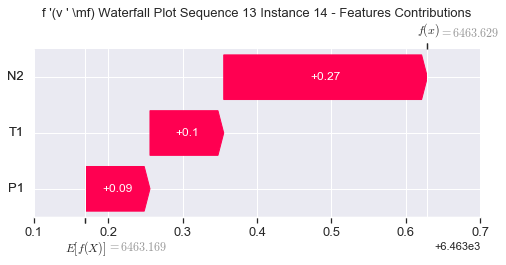

None

Contribution: [0.08131931 0.12645344 0.26698541]


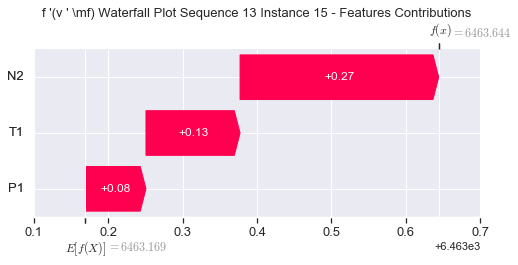

None

Contribution: [0.0891451  0.18182117 0.26061304]


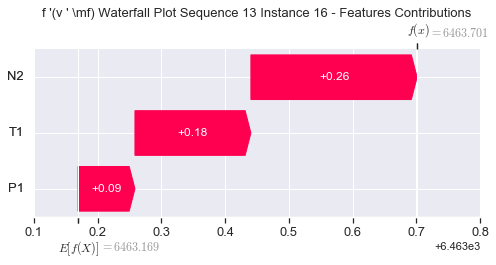

None

Contribution: [0.08393664 0.26559551 0.26090711]


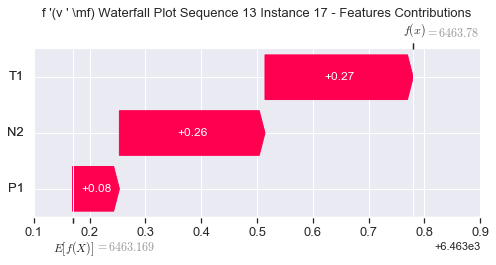

None

Contribution: [0.08651228 0.34523996 0.26268097]


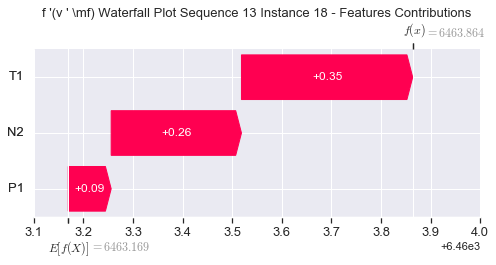

None

Contribution: [0.0789965  0.41179736 0.27725646]


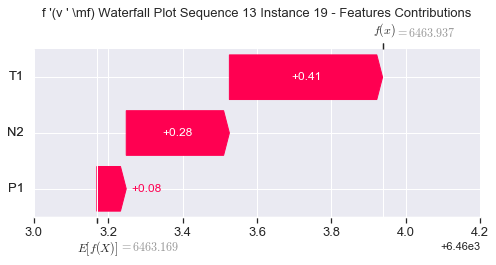

None

Contribution: [0.09751179 0.39411648 0.30725229]


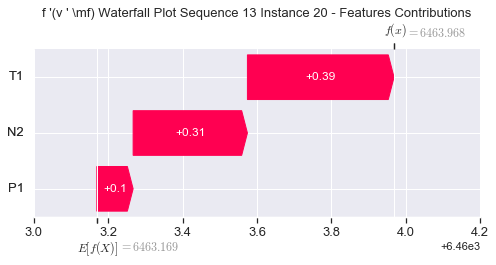

None

Contribution: [0.11607395 0.17647371 0.40124996]


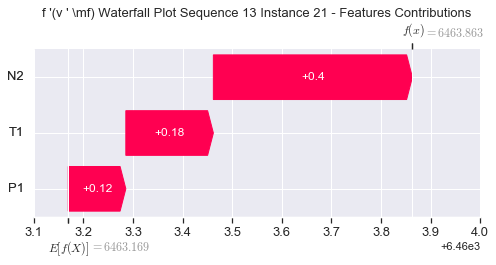

None

Contribution: [ 0.14826384 -0.49473024  0.66419714]


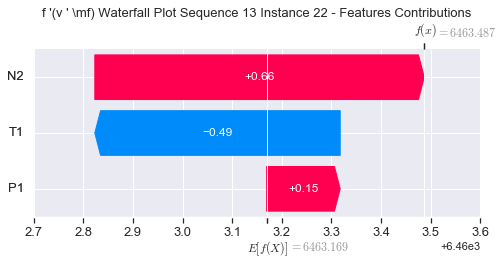

None

Contribution: [ 0.12530975 -2.2422158   1.46006554]


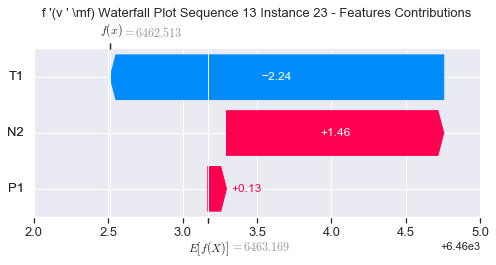

None

Contribution: [ 0.67038044 -6.36476267  3.86824897]


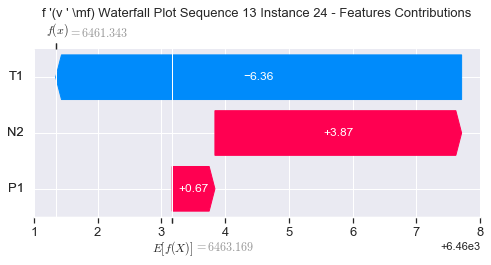

None

Contribution: [ 13.27916612 -89.84206856  62.13651444]


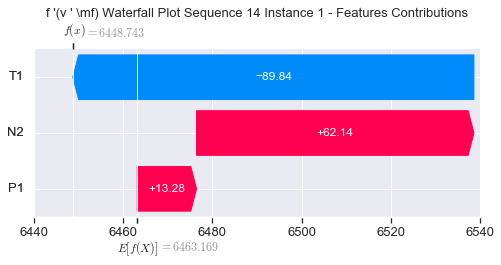

None

Contribution: [0.71695989 2.66268077 1.96189793]


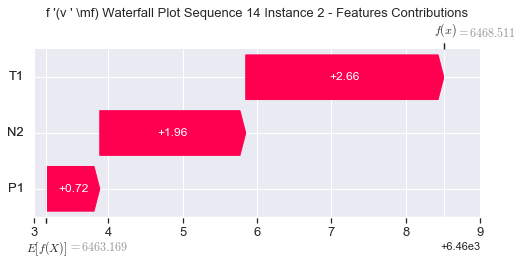

None

Contribution: [ 0.11936698 -0.40316826  1.3077263 ]


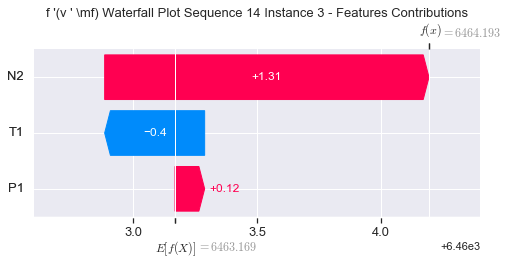

None

Contribution: [0.16373487 0.10990639 0.51499449]


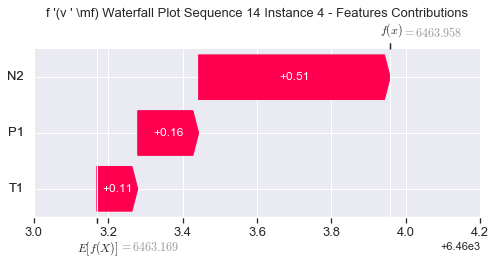

None

Contribution: [0.11691969 0.09918585 0.37323377]


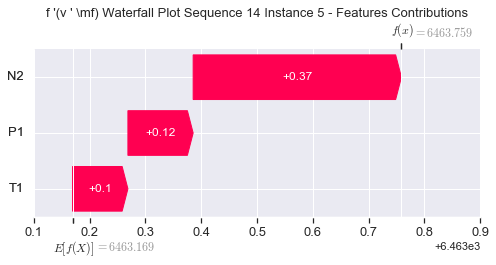

None

Contribution: [0.10216636 0.07139719 0.3339027 ]


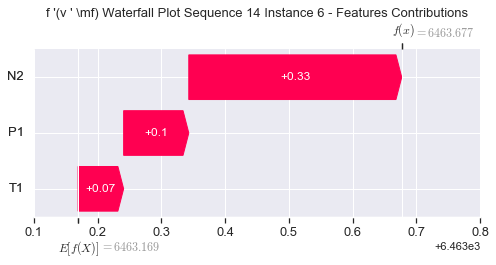

None

Contribution: [0.09943218 0.06488075 0.3241215 ]


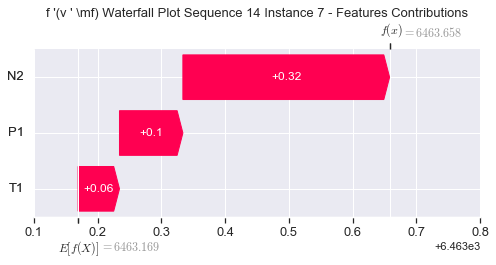

None

Contribution: [0.09561869 0.06395398 0.3129731 ]


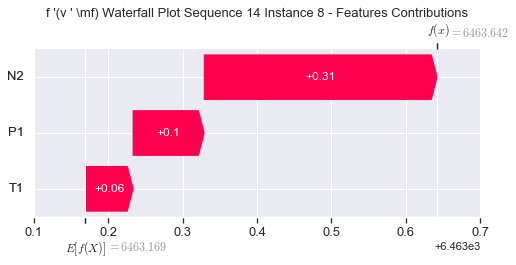

None

Contribution: [0.08976666 0.08937813 0.30951759]


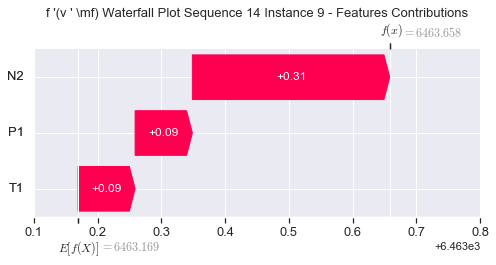

None

Contribution: [0.0811621  0.09637999 0.30442098]


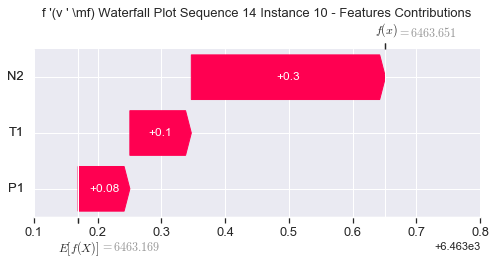

None

Contribution: [0.08365234 0.10096649 0.29371944]


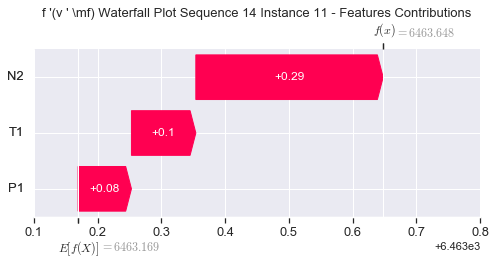

None

Contribution: [0.08436286 0.07555404 0.28155364]


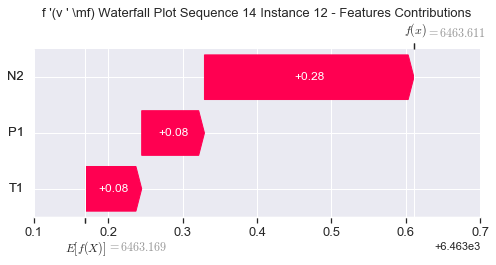

None

Contribution: [0.08517851 0.10764766 0.27591416]


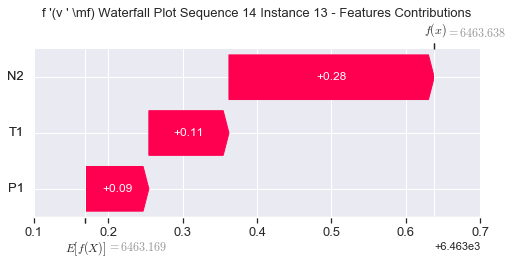

None

Contribution: [0.084287   0.14018409 0.26942413]


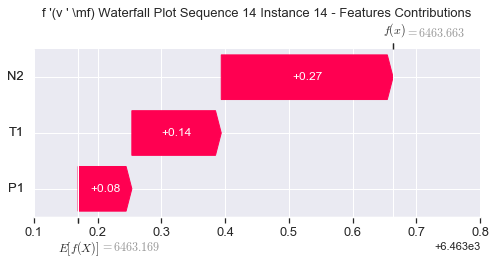

None

Contribution: [0.08175639 0.17855558 0.26555738]


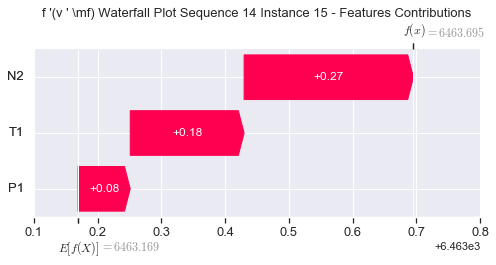

None

Contribution: [0.09369115 0.24416403 0.25750697]


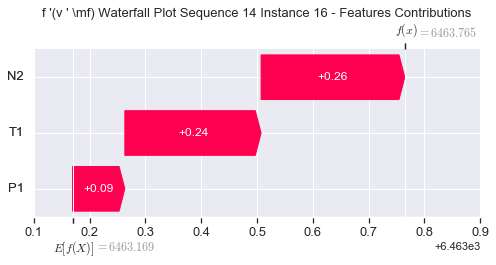

None

Contribution: [0.08401922 0.33583416 0.26022374]


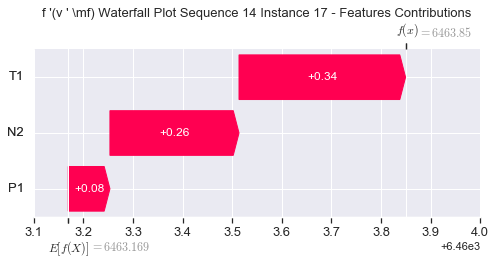

None

Contribution: [0.08711503 0.43286557 0.26249133]


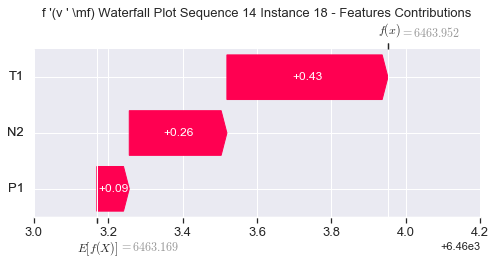

None

Contribution: [0.07806356 0.52983731 0.27396199]


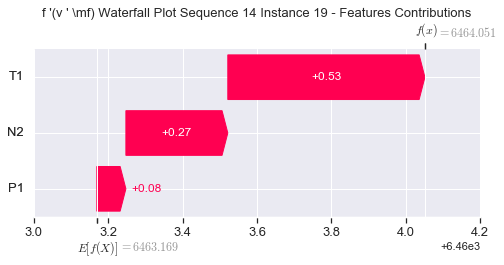

None

Contribution: [0.09875224 0.51664849 0.30661527]


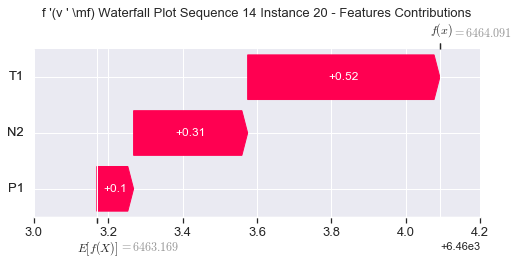

None

Contribution: [0.12028097 0.29813325 0.39760085]


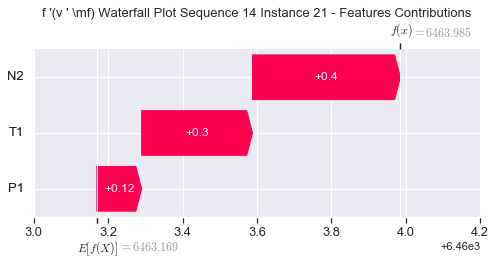

None

Contribution: [ 0.16605483 -0.45197344  0.65124496]


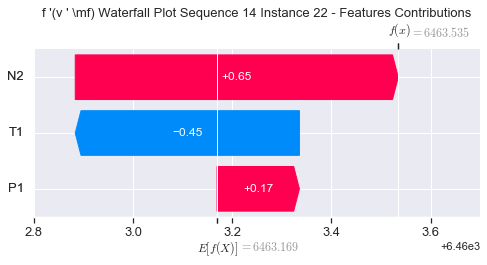

None

Contribution: [ 0.14748109 -2.57129513  1.42480957]


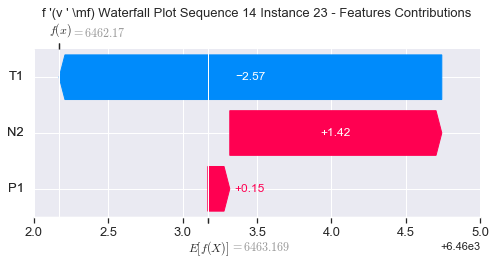

None

Contribution: [ 0.7049612  -7.35374428  3.72481351]


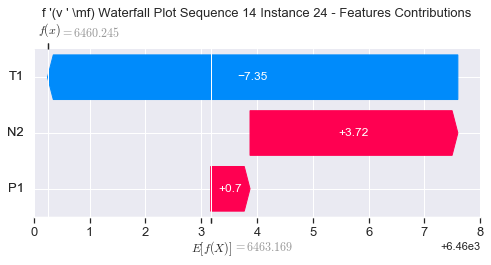

None

Contribution: [  10.69483146 -117.79233871   54.49627912]


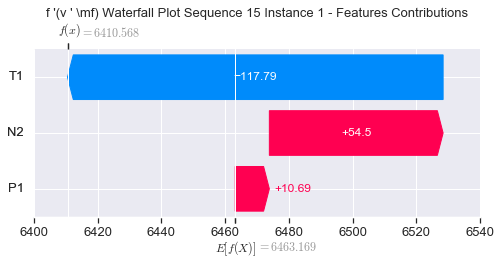

None

Contribution: [0.70271227 3.09003874 2.0865983 ]


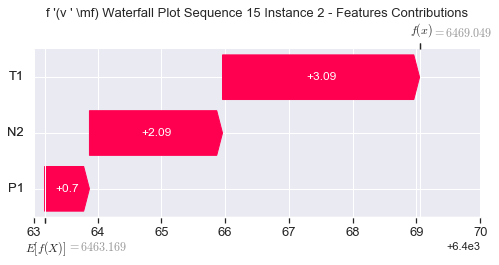

None

Contribution: [ 0.21671157 -1.42965901  1.26535626]


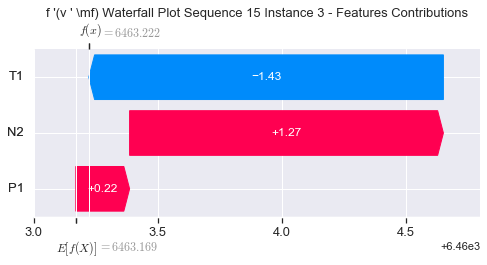

None

Contribution: [ 0.13682766 -0.00857502  0.50499981]


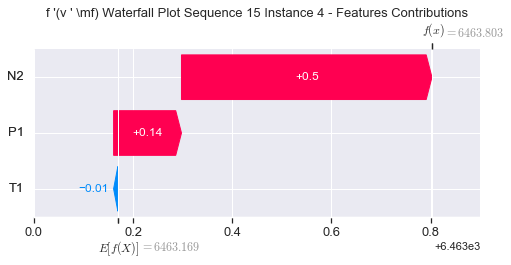

None

Contribution: [0.11377277 0.04673653 0.37297616]


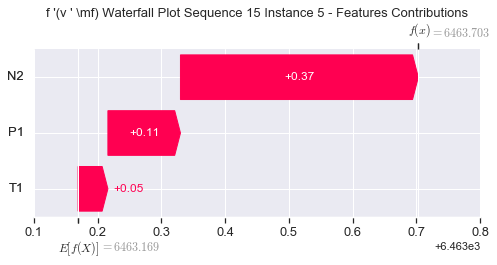

None

Contribution: [0.10445849 0.02021883 0.33630881]


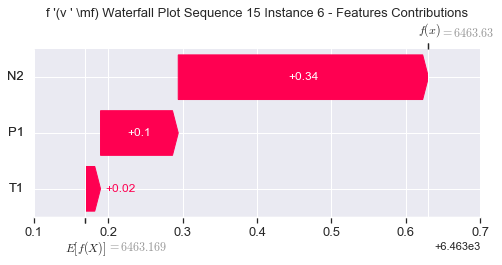

None

Contribution: [0.10123296 0.0183479  0.32696849]


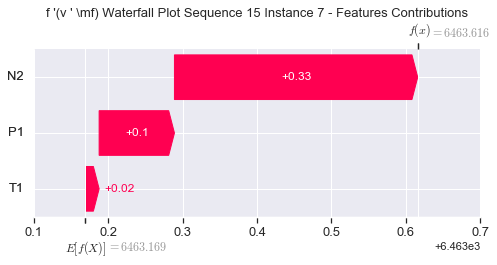

None

Contribution: [0.09597361 0.01545351 0.31518358]


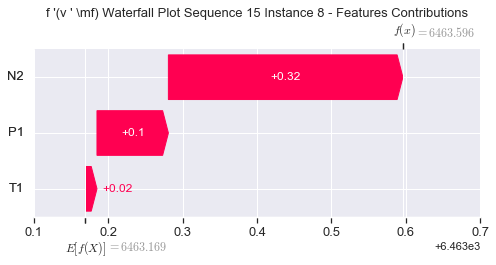

None

Contribution: [0.0814683  0.03411491 0.31031146]


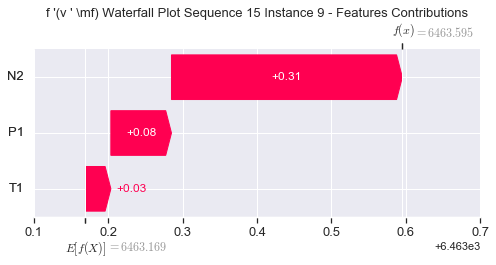

None

Contribution: [0.08041433 0.04177935 0.30623952]


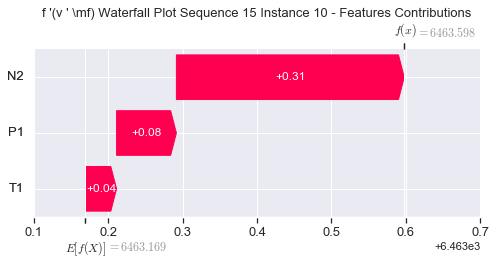

None

Contribution: [0.07623773 0.04249887 0.2928643 ]


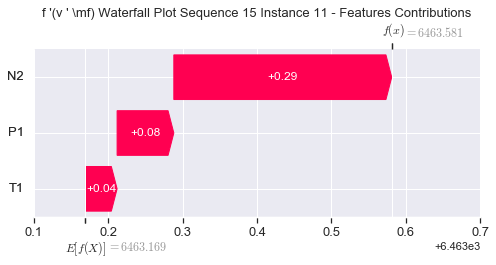

None

Contribution: [0.0834619  0.04533654 0.28244188]


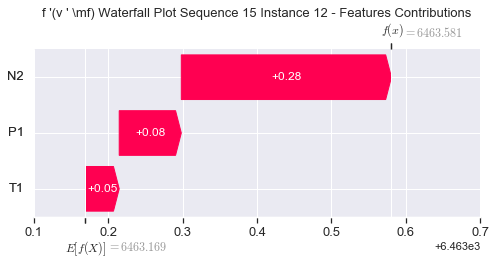

None

Contribution: [0.08436765 0.07590842 0.27709768]


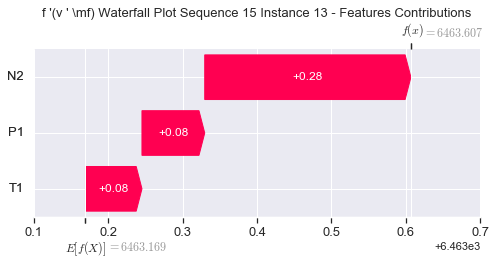

None

Contribution: [0.08835794 0.09215899 0.27362019]


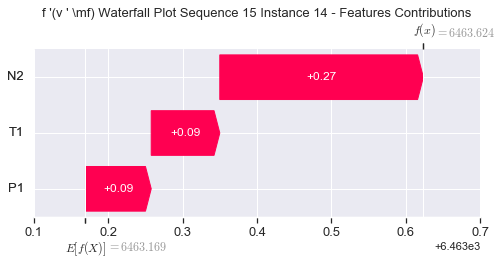

None

Contribution: [0.08112274 0.1375709  0.26658642]


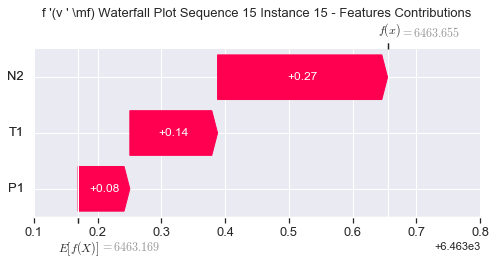

None

Contribution: [0.09059536 0.19469096 0.26051882]


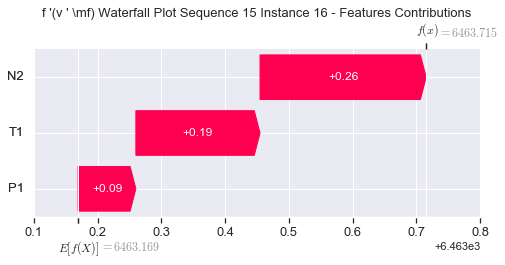

None

Contribution: [0.08393047 0.27596101 0.26060165]


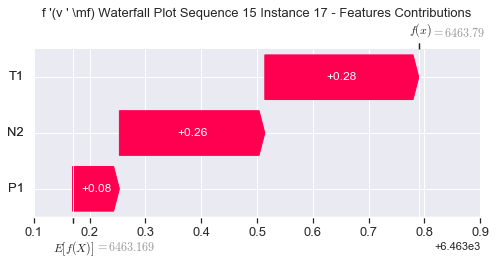

None

Contribution: [0.0863343  0.35783882 0.26223264]


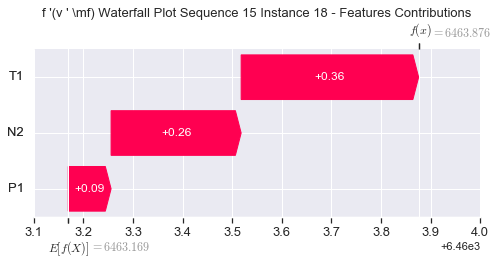

None

Contribution: [0.07646766 0.42085711 0.27739698]


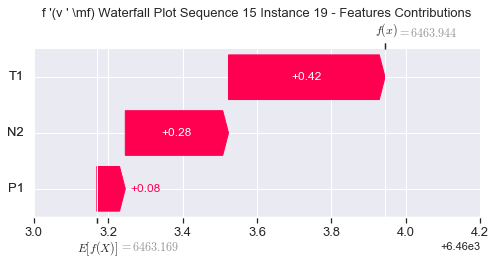

None

Contribution: [0.09835085 0.41513002 0.30755551]


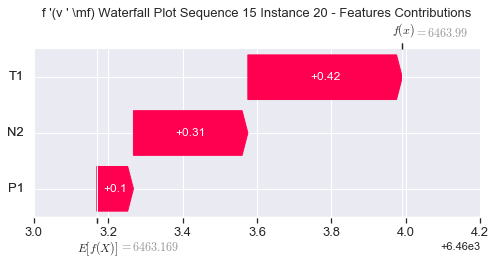

None

Contribution: [0.11543353 0.20569868 0.4004741 ]


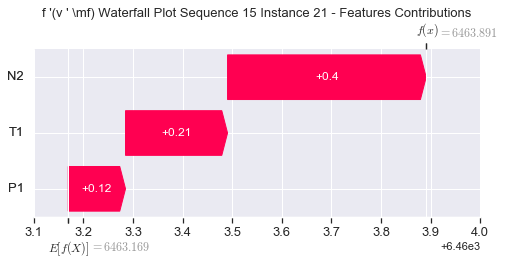

None

Contribution: [ 0.13370877 -0.48179869  0.65209931]


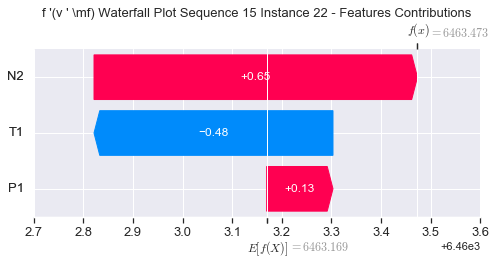

None

Contribution: [ 0.10255135 -2.39363692  1.43217001]


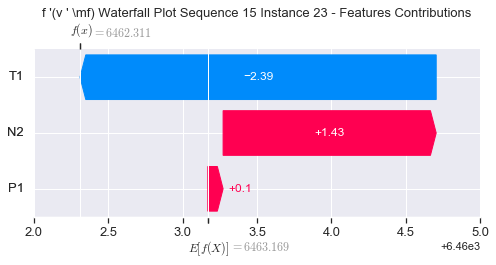

None

Contribution: [ 0.77271304 -6.96042944  3.87229149]


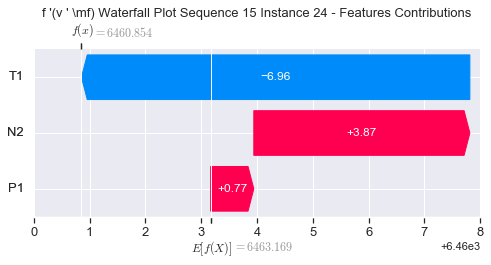

None

Contribution: [  18.9068615  -107.47205833   63.29023914]


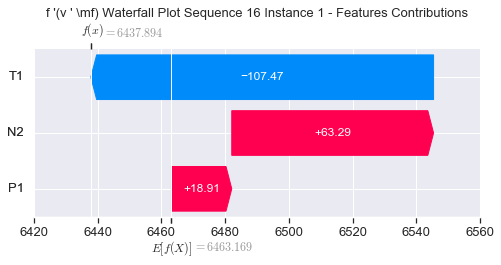

None

Contribution: [0.88442112 2.72425414 2.10521671]


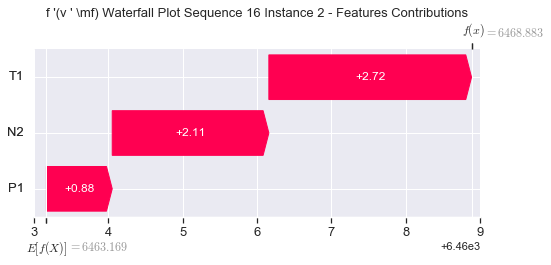

None

Contribution: [ 0.06417805 -0.9267835   1.29248448]


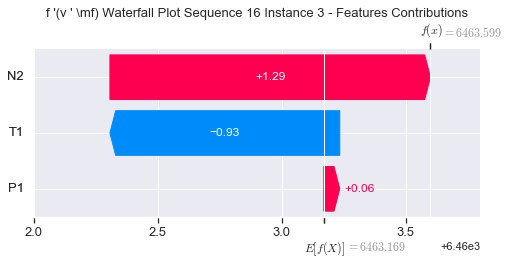

None

Contribution: [0.15478126 0.06962047 0.50883557]


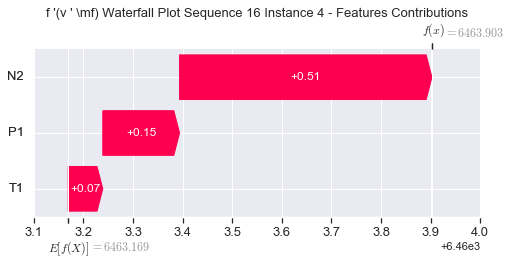

None

Contribution: [0.11839247 0.04297328 0.3746668 ]


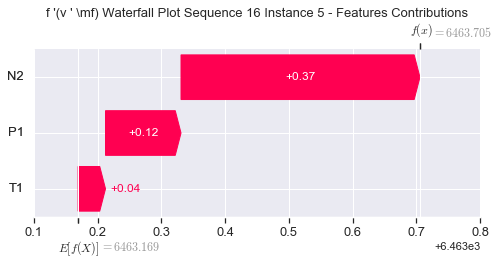

None

Contribution: [0.10663304 0.01977495 0.33691921]


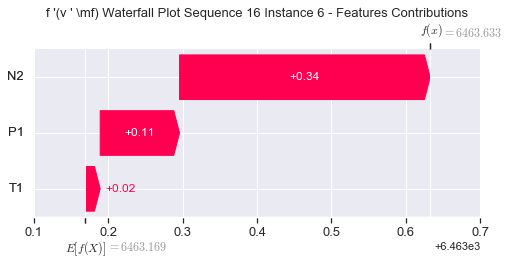

None

Contribution: [0.10223083 0.01736611 0.3271032 ]


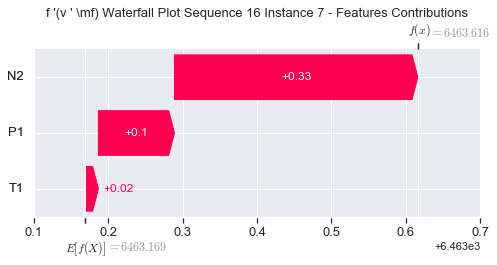

None

Contribution: [0.09782664 0.00929505 0.31515882]


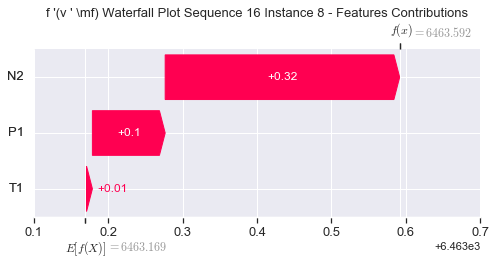

None

Contribution: [0.08521139 0.00234939 0.31063546]


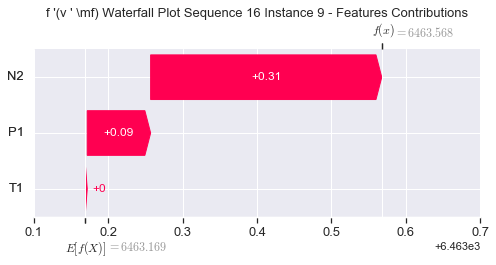

None

Contribution: [0.07727899 0.04073859 0.30527426]


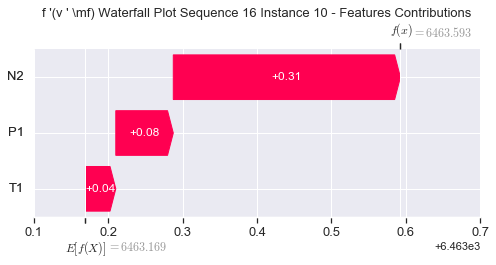

None

Contribution: [0.08336444 0.01076772 0.29484911]


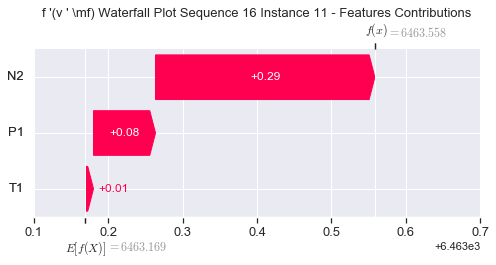

None

Contribution: [0.08404688 0.0394565  0.28374383]


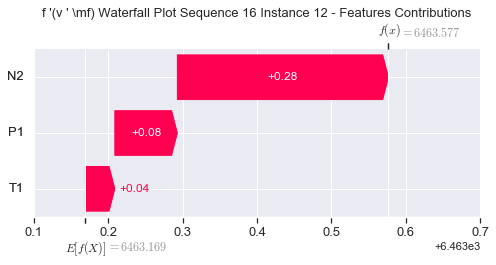

None

Contribution: [0.08429646 0.07680542 0.27751982]


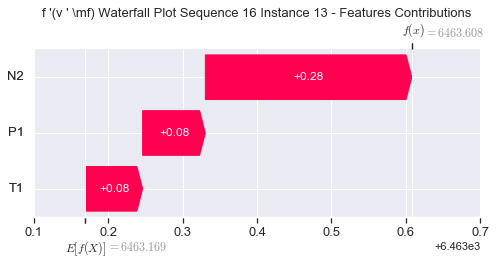

None

Contribution: [0.08165742 0.11111002 0.27052056]


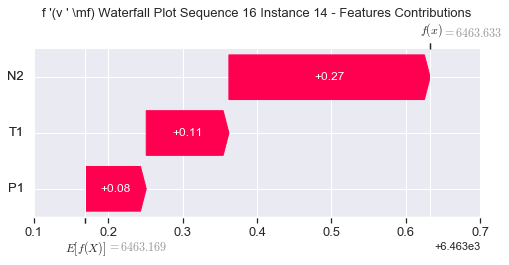

None

Contribution: [0.08149736 0.15576381 0.26613299]


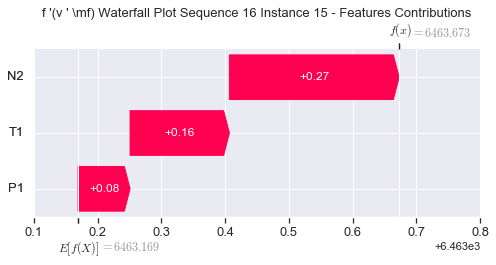

None

Contribution: [0.09205618 0.2239222  0.25836796]


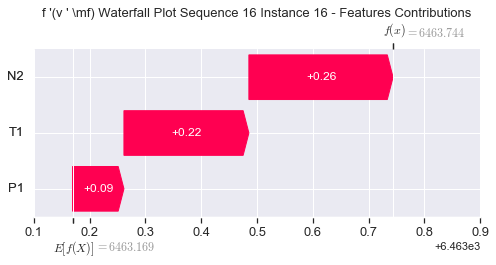

None

Contribution: [0.08449617 0.32024486 0.26034271]


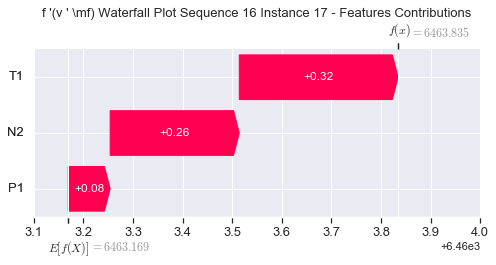

None

Contribution: [0.087548   0.41691111 0.26271141]


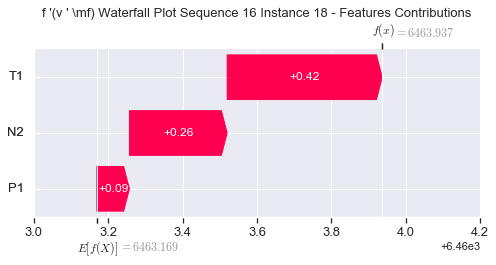

None

Contribution: [0.07762224 0.49837027 0.27763099]


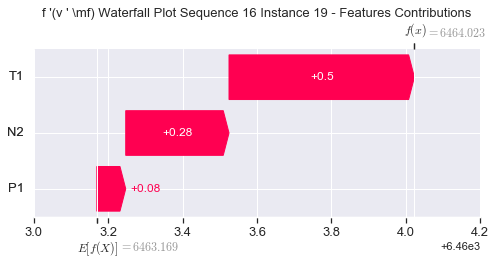

None

Contribution: [0.09856239 0.47696742 0.30672992]


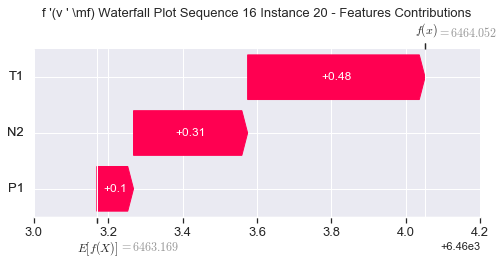

None

Contribution: [0.11338709 0.21145386 0.39300279]


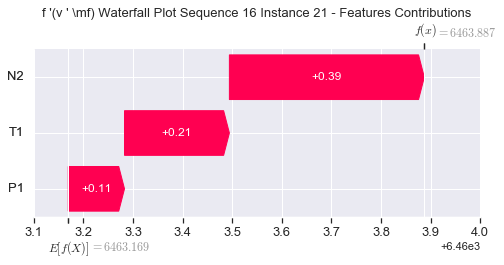

None

Contribution: [ 0.14122211 -0.67470288  0.62988812]


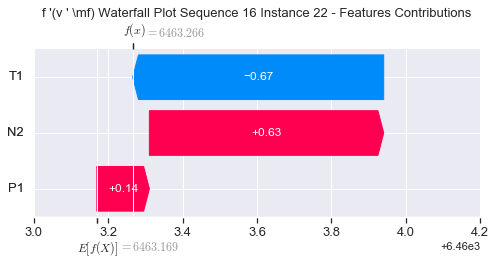

None

Contribution: [ 0.09869269 -3.06184425  1.36408452]


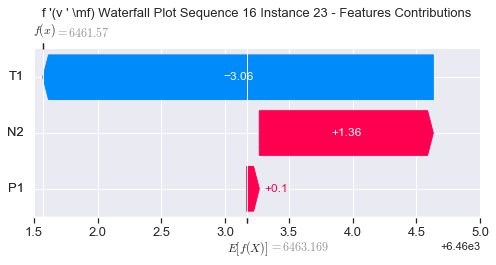

None

Contribution: [ 0.77405693 -8.28308438  3.68201417]


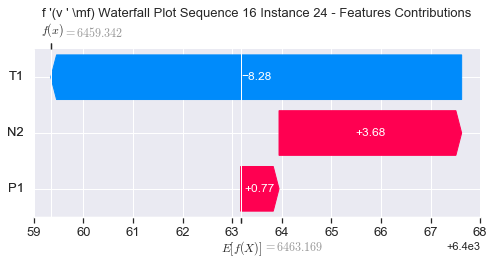

None

Contribution: [  17.05452231 -116.31816596   61.71434651]


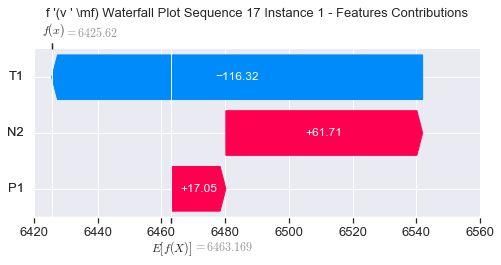

None

Contribution: [0.87006312 3.32635178 2.14070314]


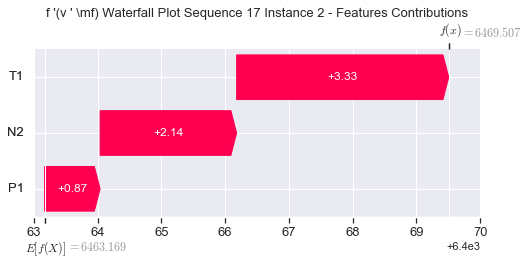

None

Contribution: [ 0.34509312 -1.80324562  1.31914183]


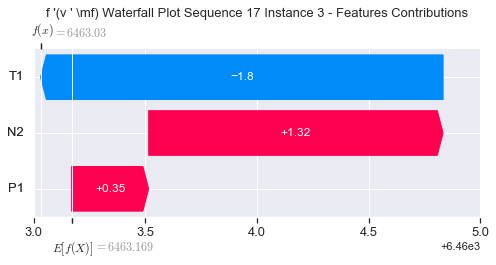

None

Contribution: [ 0.17052228 -0.01095398  0.51828073]


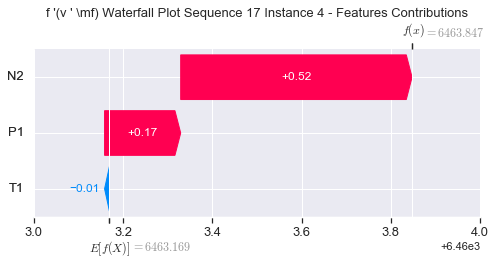

None

Contribution: [0.11764457 0.0013357  0.37173215]


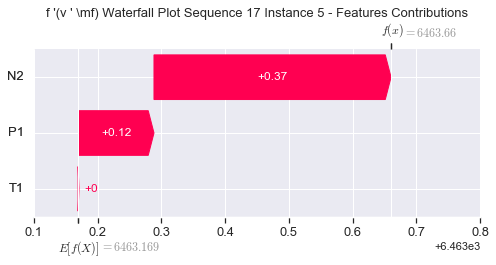

None

Contribution: [ 0.1020448  -0.01614891  0.33260829]


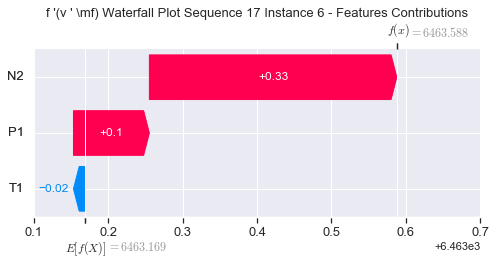

None

Contribution: [ 0.09890817 -0.02447328  0.3229166 ]


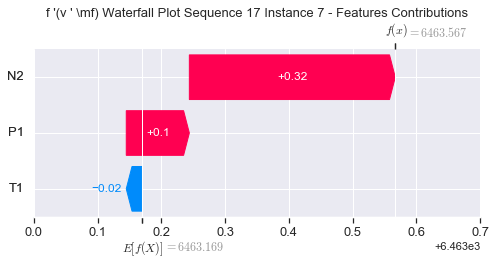

None

Contribution: [ 0.09465436 -0.02568723  0.31155197]


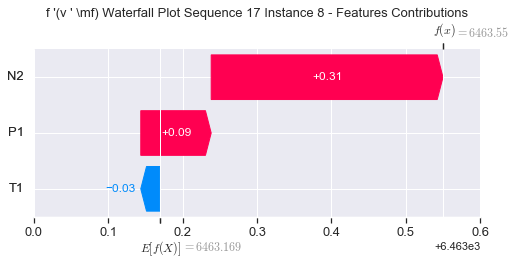

None

Contribution: [ 0.08469484 -0.02277671  0.30519106]


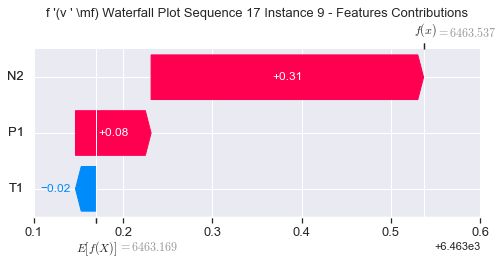

None

Contribution: [0.0737257  0.00886455 0.30709083]


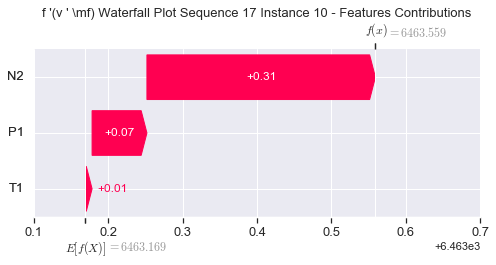

None

Contribution: [0.07972352 0.00658733 0.2902422 ]


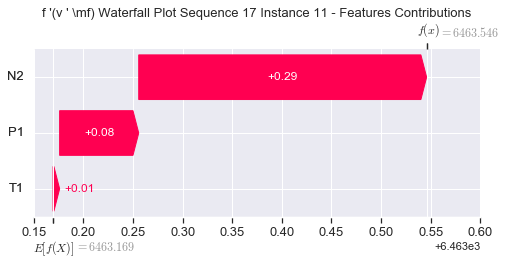

None

Contribution: [0.08420148 0.0088935  0.2816696 ]


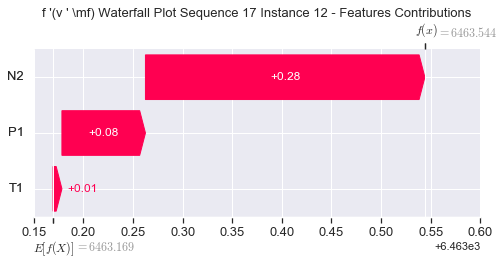

None

Contribution: [0.08476228 0.04554596 0.27613762]


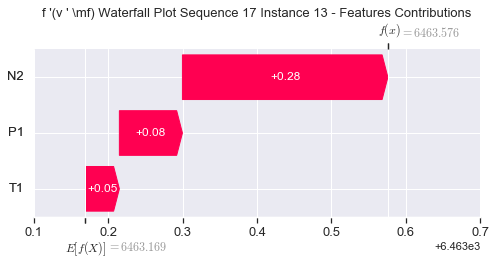

None

Contribution: [0.07781111 0.0760833  0.2694145 ]


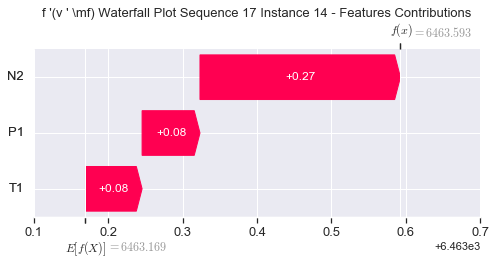

None

Contribution: [0.08145403 0.13177289 0.26592477]


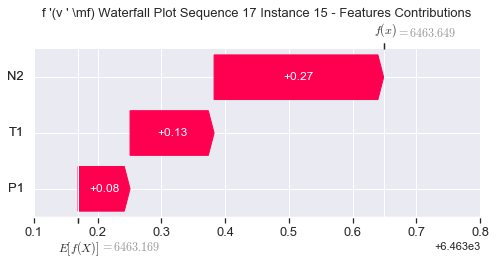

None

Contribution: [0.09224304 0.20314015 0.26020408]


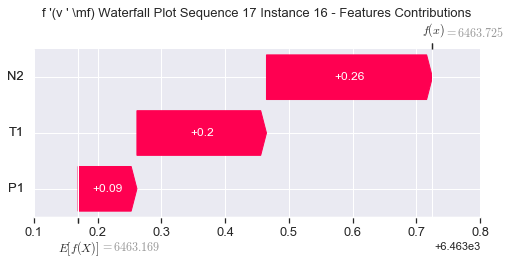

None

Contribution: [0.08420826 0.30191507 0.26058756]


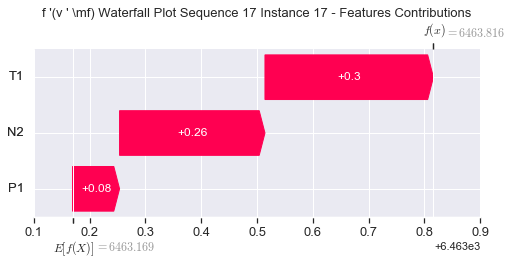

None

Contribution: [0.08733844 0.39794045 0.26263833]


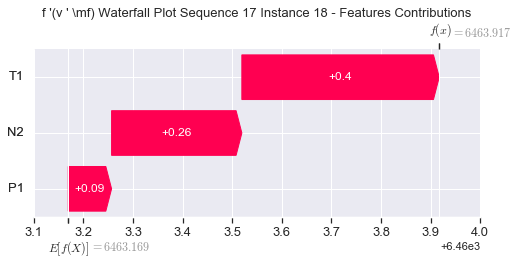

None

Contribution: [0.07713757 0.45763028 0.27714963]


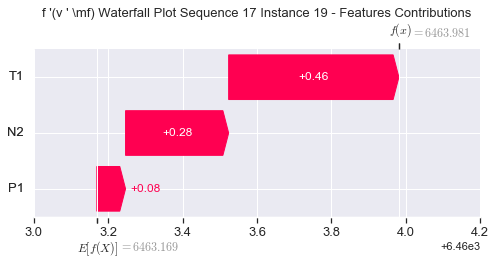

None

Contribution: [0.09827662 0.43134196 0.30712283]


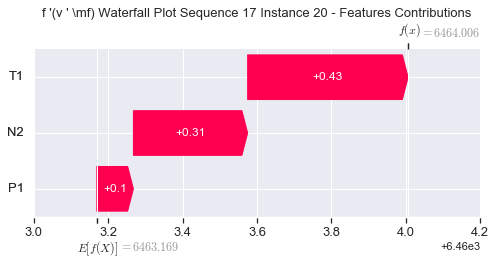

None

Contribution: [0.11664435 0.10845323 0.39952728]


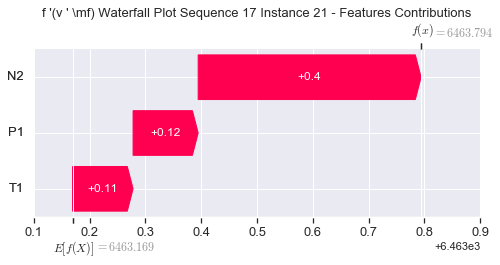

None

Contribution: [ 0.1561847  -0.87220267  0.65858642]


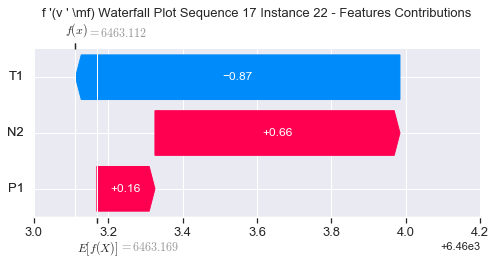

None

Contribution: [ 0.11433271 -3.41525573  1.44259389]


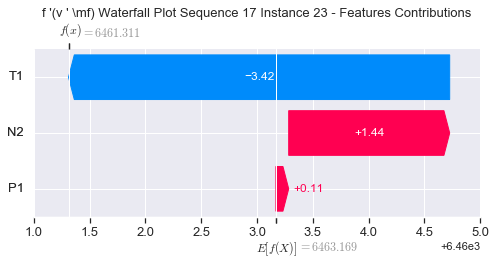

None

Contribution: [ 0.93288763 -9.34804024  3.88633282]


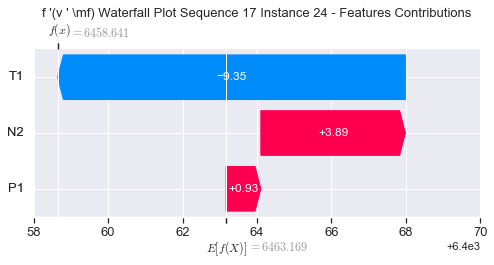

None

Contribution: [  27.92612025 -154.23561719   62.73447167]


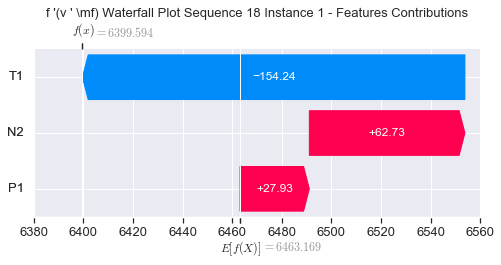

None

Contribution: [0.71488893 3.51479564 2.06647891]


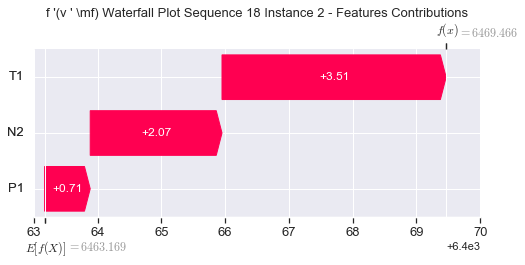

None

Contribution: [ 0.38643077 -2.00306414  1.36318008]


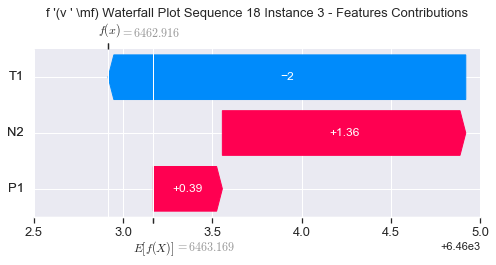

None

Contribution: [ 0.14712095 -0.06373695  0.50896168]


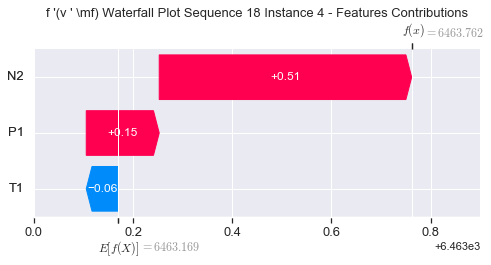

None

Contribution: [0.11858412 0.00349898 0.37402268]


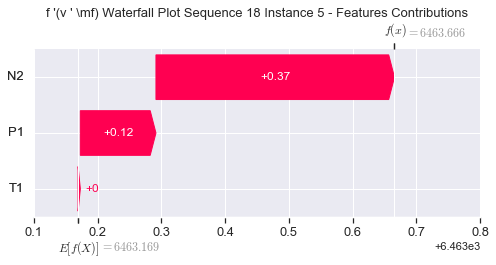

None

Contribution: [ 0.11119429 -0.0051362   0.33886287]


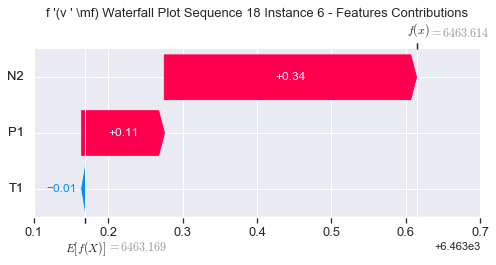

None

Contribution: [ 0.11077126 -0.01004947  0.3301039 ]


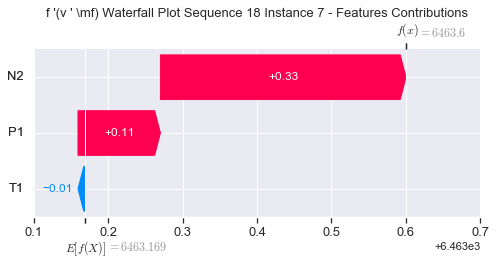

None

Contribution: [ 0.10426267 -0.01287917  0.31804616]


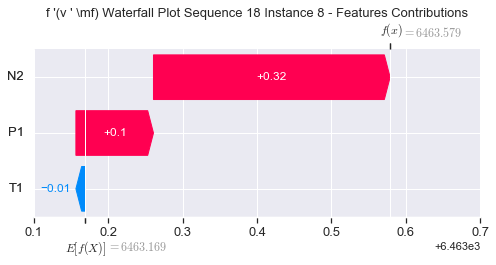

None

Contribution: [0.09116108 0.00559168 0.31236346]


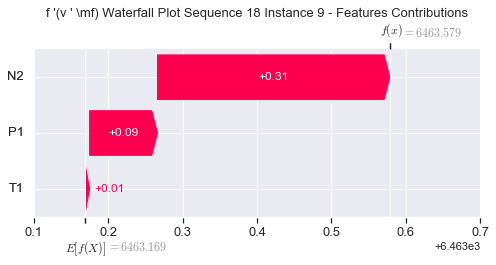

None

Contribution: [0.09126227 0.00905297 0.30613534]


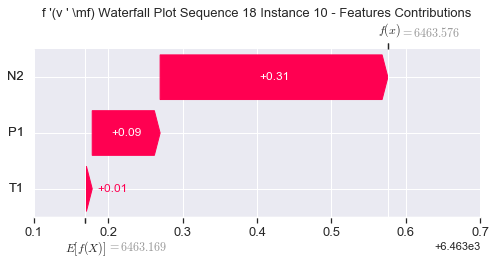

None

Contribution: [0.08688872 0.02387511 0.29728221]


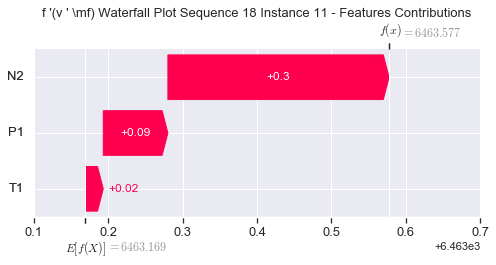

None

Contribution: [0.10175715 0.02223468 0.28887252]


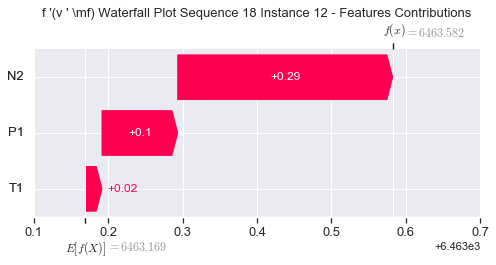

None

Contribution: [0.09896669 0.05185178 0.28200247]


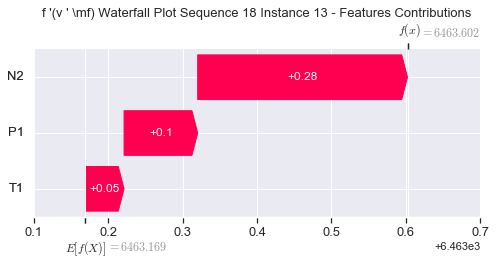

None

Contribution: [0.0864856  0.09250139 0.27287595]


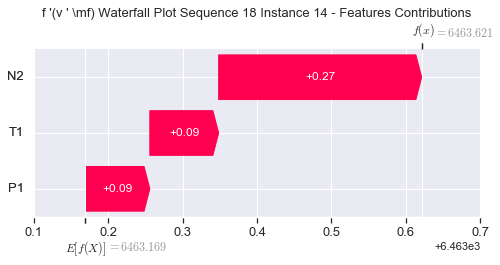

None

Contribution: [0.08769603 0.11790629 0.26874372]


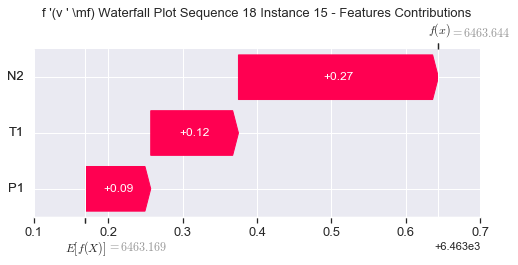

None

Contribution: [0.08973049 0.17933978 0.26035005]


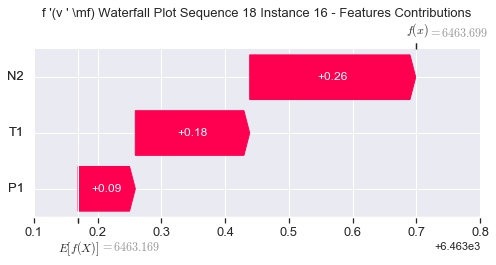

None

Contribution: [0.08377592 0.26034166 0.26078622]


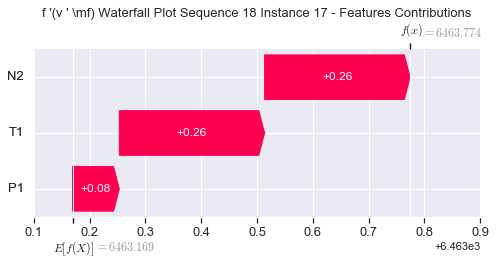

None

Contribution: [0.08387175 0.34221529 0.26179824]


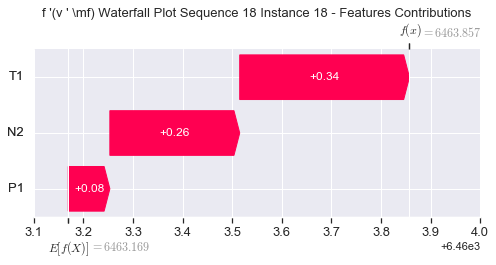

None

Contribution: [0.07488793 0.40345868 0.27684971]


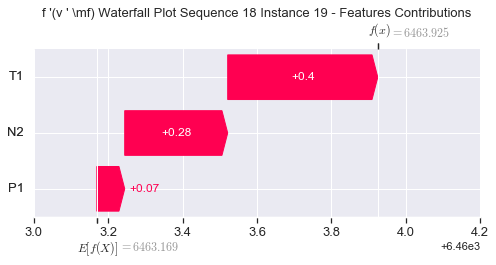

None

Contribution: [0.10187079 0.37367833 0.30782302]


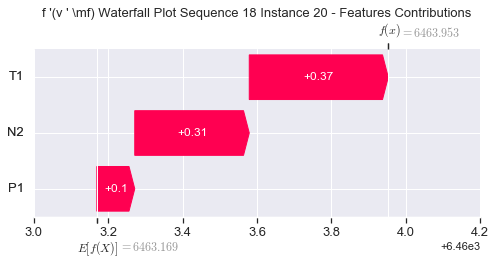

None

Contribution: [0.13852067 0.09172226 0.4035478 ]


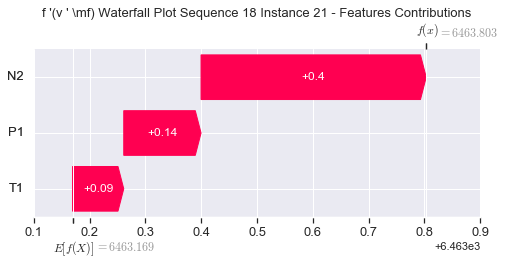

None

Contribution: [ 0.20336355 -0.7981827   0.66189408]


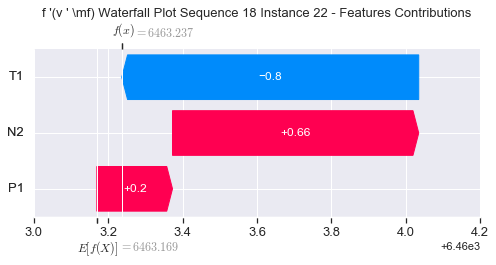

None

Contribution: [ 0.28752722 -3.05294549  1.46325111]


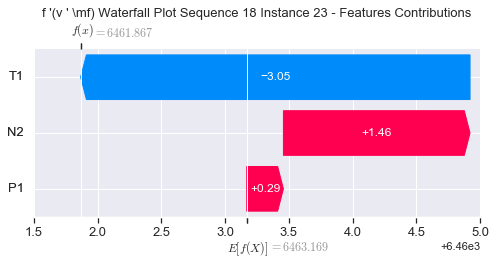

None

Contribution: [ 1.09065753 -8.62571515  3.84996458]


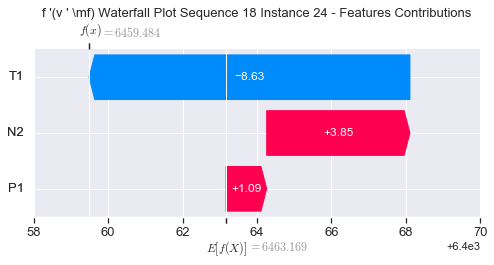

None

Contribution: [  32.0410764  -130.42448059   62.72889226]


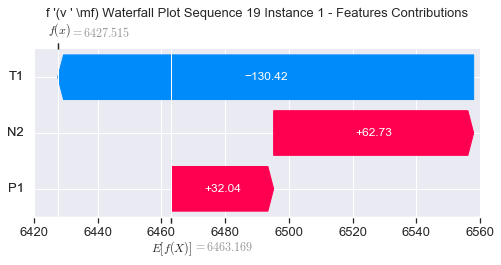

None

Contribution: [0.51302235 3.24667301 2.05667903]


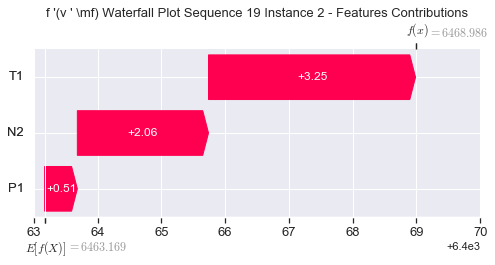

None

Contribution: [ 0.13672922 -1.71692515  1.25837303]


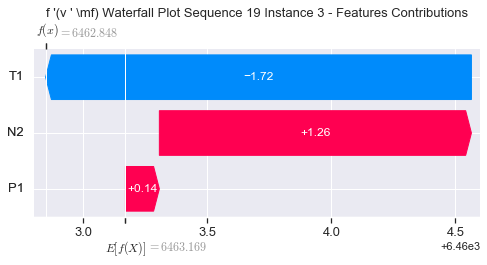

None

Contribution: [ 0.16254386 -0.02183522  0.51554542]


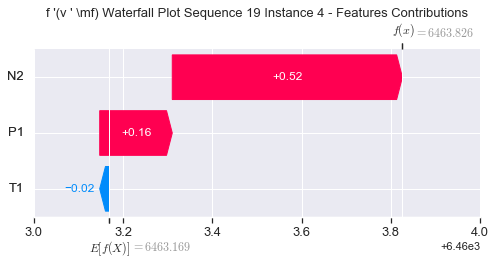

None

Contribution: [0.12304298 0.01533652 0.37654577]


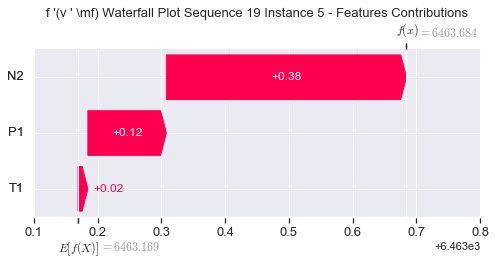

None

Contribution: [ 0.10777685 -0.00395028  0.3353809 ]


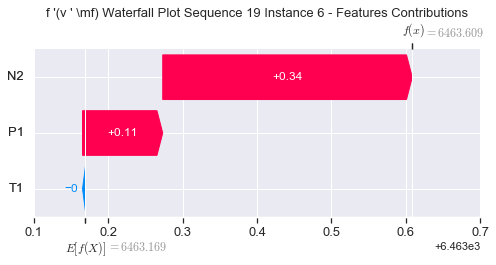

None

Contribution: [ 0.10674365 -0.00675783  0.32614857]


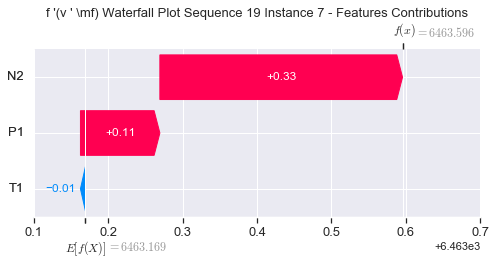

None

Contribution: [ 0.10158931 -0.01099874  0.31465967]


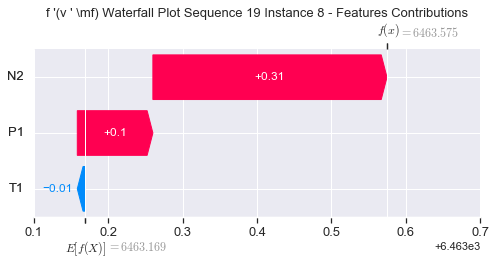

None

Contribution: [0.09156645 0.00368592 0.31327752]


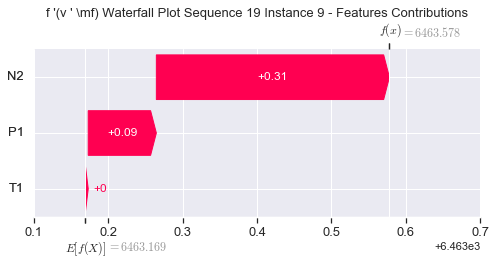

None

Contribution: [0.08592991 0.01823064 0.30583769]


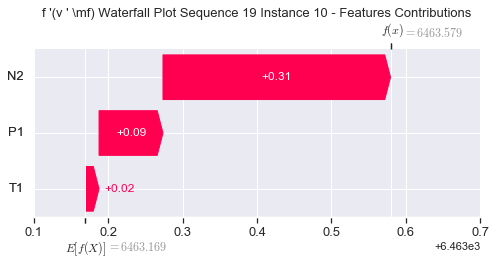

None

Contribution: [0.08198527 0.01226135 0.2942617 ]


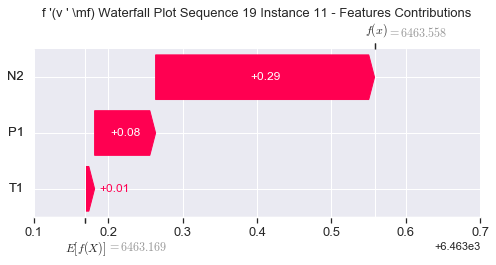

None

Contribution: [0.09029996 0.02059332 0.28193916]


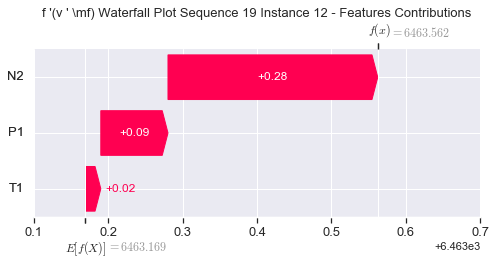

None

Contribution: [0.09086899 0.05832859 0.27665984]


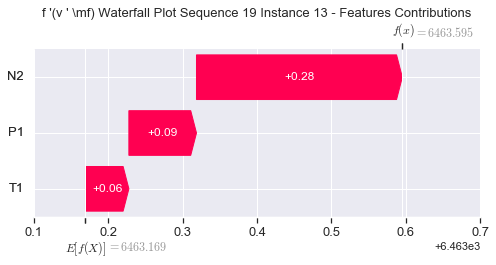

None

Contribution: [0.09011218 0.0986727  0.27402376]


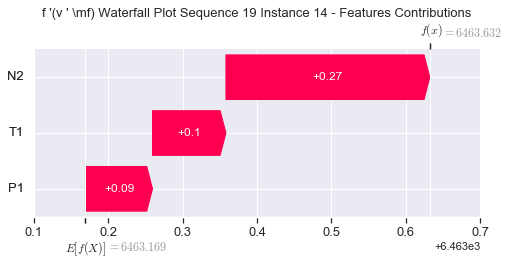

None

Contribution: [0.08457164 0.13967536 0.26585748]


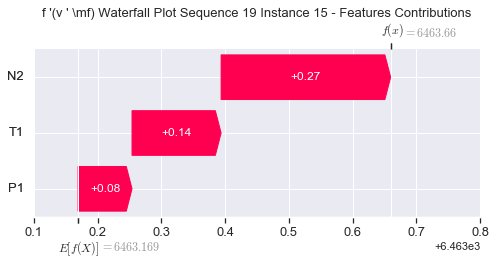

None

Contribution: [0.09196809 0.2086257  0.25958954]


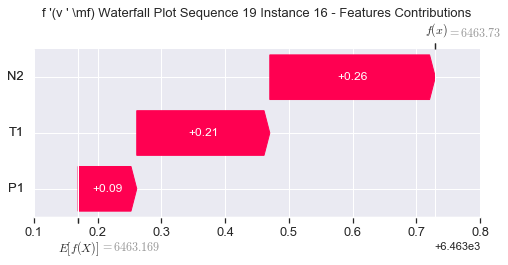

None

Contribution: [0.08218002 0.30389657 0.26098415]


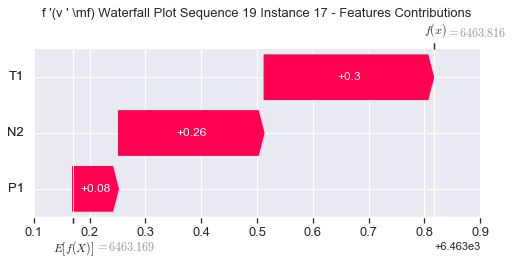

None

Contribution: [0.08272902 0.39829699 0.26371429]


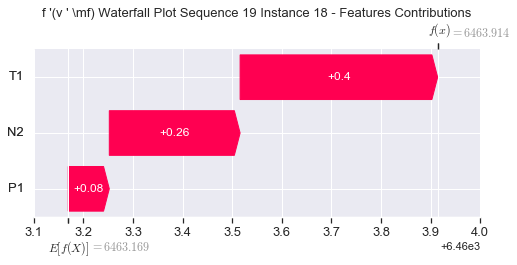

None

Contribution: [0.07752185 0.46824258 0.27891851]


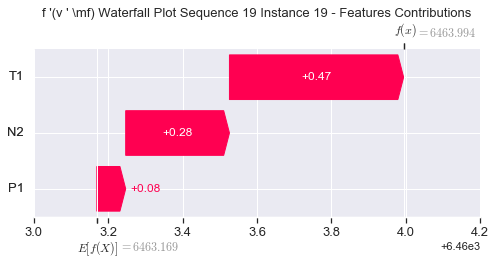

None

Contribution: [0.10152042 0.44411493 0.30638521]


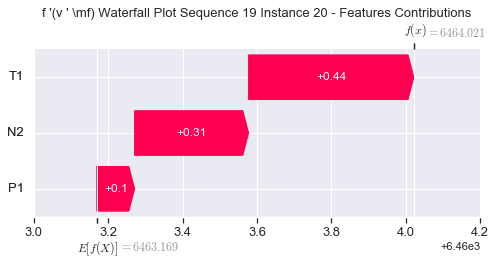

None

Contribution: [0.14888713 0.15654498 0.39117584]


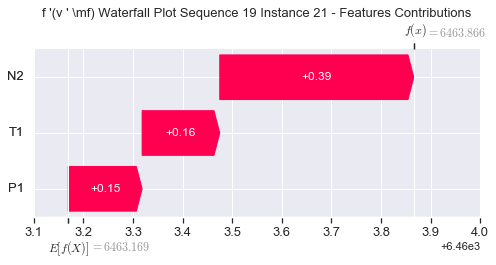

None

Contribution: [ 0.2576343  -0.77388928  0.62363696]


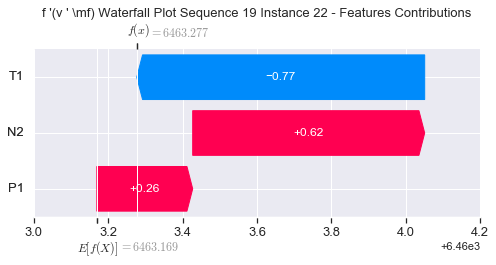

None

Contribution: [ 0.38411656 -3.23145493  1.32006473]


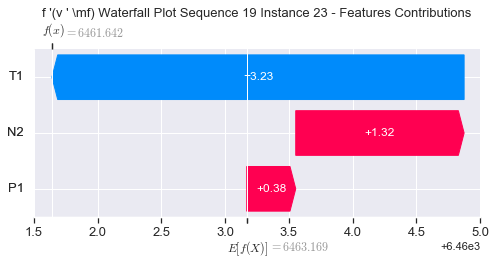

None

Contribution: [ 1.10257377 -9.21365136  3.41091348]


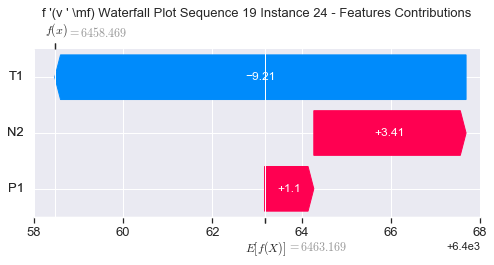

None

Contribution: [   7.4495022  -163.41449024   46.39903033]


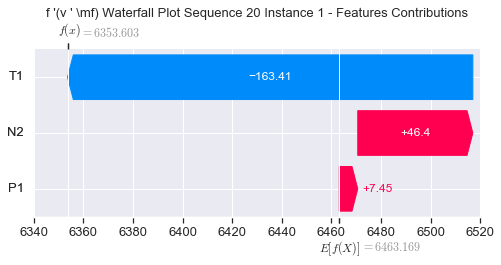

None

Contribution: [0.43969014 3.3398895  2.27978778]


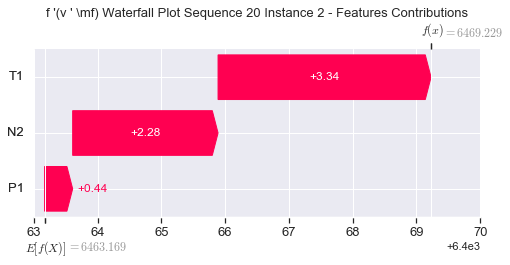

None

Contribution: [ 0.43034131 -2.05241049  1.23400737]


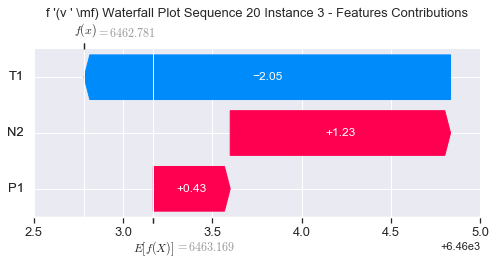

None

Contribution: [ 0.15014506 -0.02276504  0.50029407]


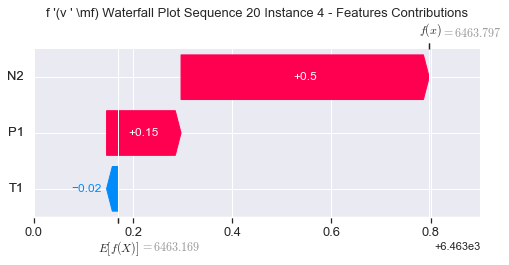

None

Contribution: [0.1288373  0.01987014 0.37171306]


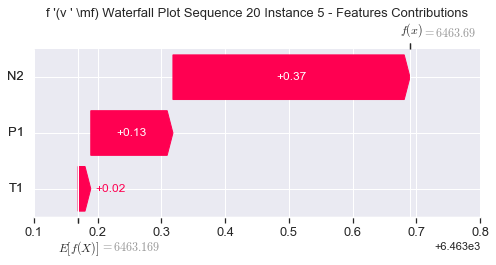

None

Contribution: [ 0.10865705 -0.00803163  0.33191196]


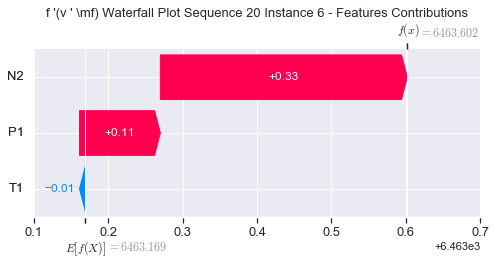

None

Contribution: [ 0.10746008 -0.01353428  0.32440993]


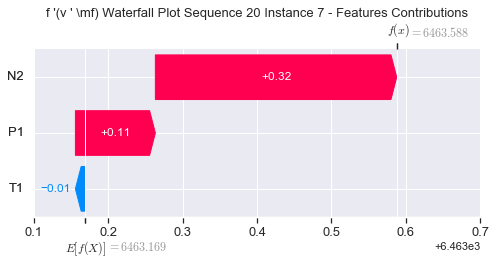

None

Contribution: [ 0.10233812 -0.01994722  0.31218266]


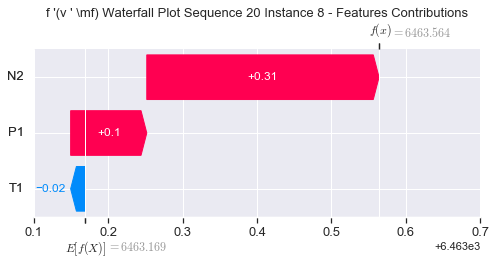

None

Contribution: [ 0.08548012 -0.0208773   0.30974732]


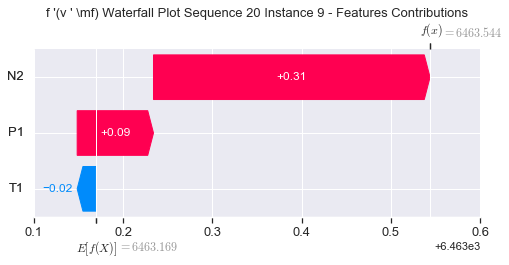

None

Contribution: [ 0.09231859 -0.04310863  0.2996875 ]


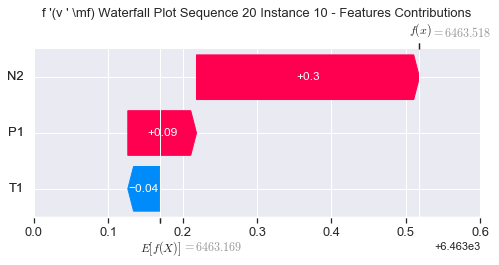

None

Contribution: [ 0.07660996 -0.01162716  0.28795543]


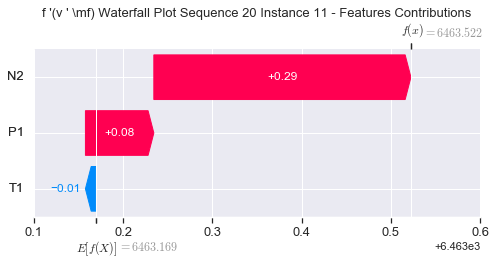

None

Contribution: [0.09409367 0.00600015 0.28163874]


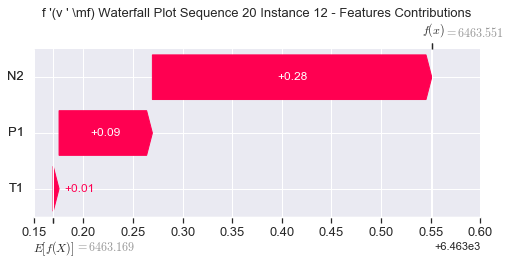

None

Contribution: [0.09476174 0.03179853 0.2771654 ]


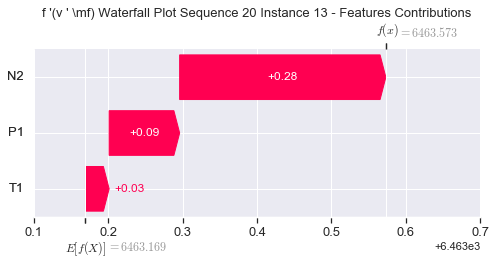

None

Contribution: [0.08980622 0.06133444 0.27159324]


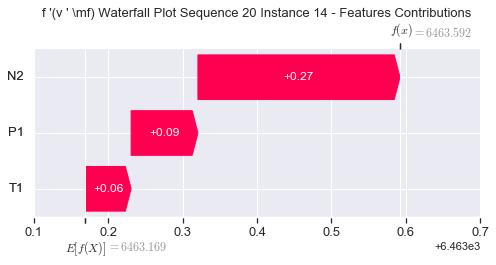

None

Contribution: [0.08684378 0.08177622 0.26599725]


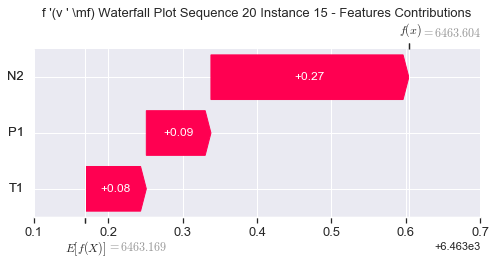

None

Contribution: [0.0892586  0.12573831 0.2619881 ]


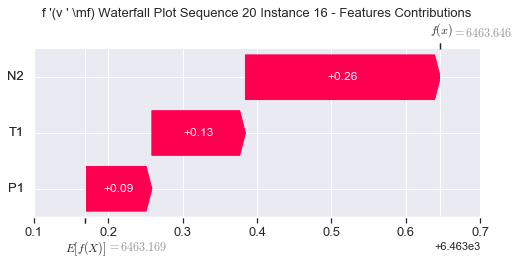

None

Contribution: [0.08578662 0.20150071 0.26066203]


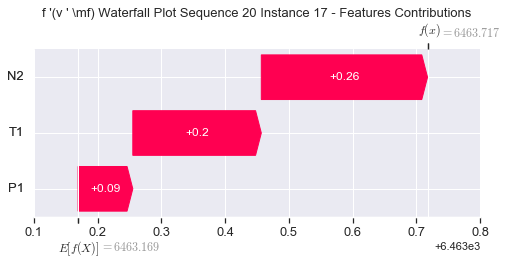

None

Contribution: [0.08637874 0.26953697 0.26215529]


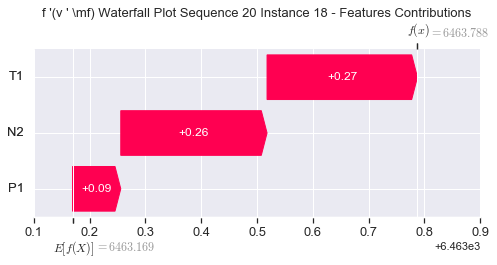

None

Contribution: [0.07673604 0.31599263 0.27754932]


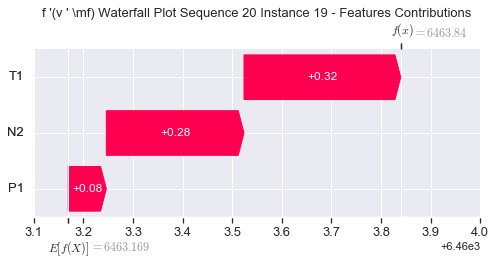

None

Contribution: [0.10845809 0.27522764 0.30612337]


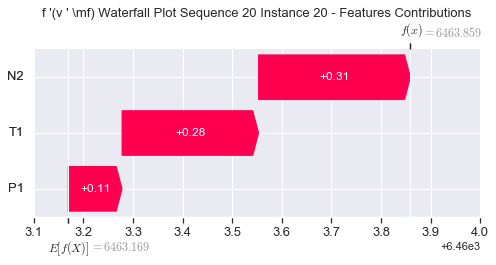

None

Contribution: [0.16020621 0.00087738 0.39617066]


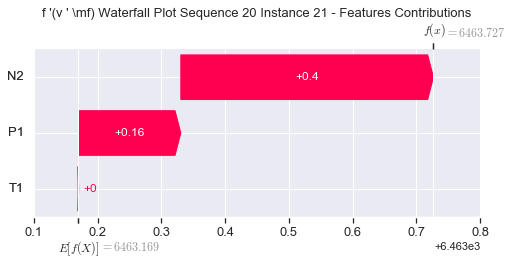

None

Contribution: [ 0.28033477 -0.82568299  0.63815101]


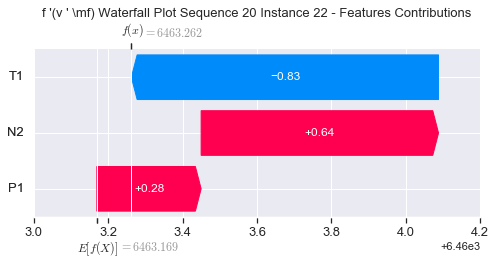

None

Contribution: [ 0.41517302 -3.07771815  1.36543762]


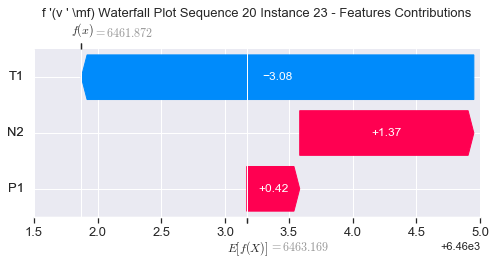

None

Contribution: [ 1.4333647  -8.42506895  3.54682809]


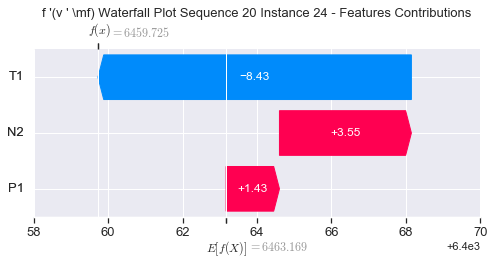

None

Contribution: [  24.68127613 -135.88594568   51.38804092]


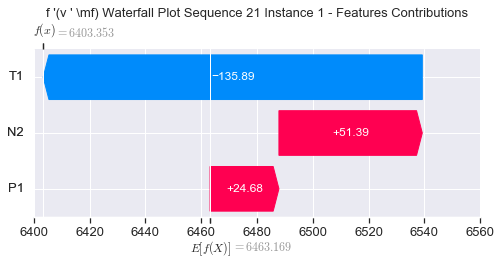

None

Contribution: [0.25471779 3.03762451 2.15645619]


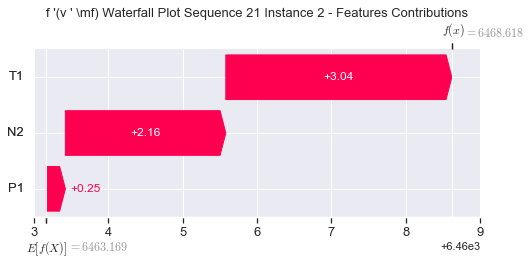

None

Contribution: [ 0.4759247  -1.03388141  1.2401695 ]


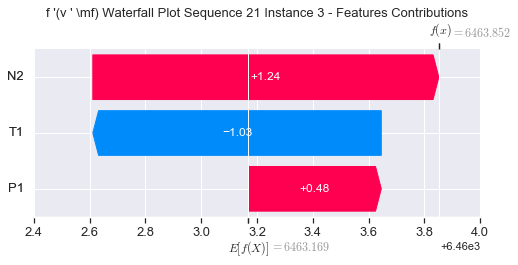

None

Contribution: [0.17756532 0.05240397 0.50466258]


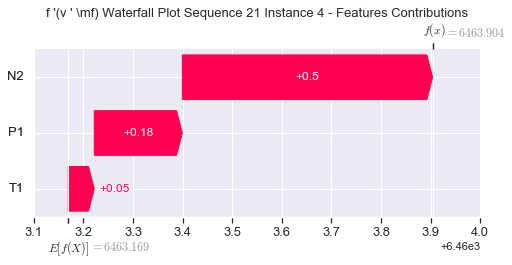

None

Contribution: [0.12589856 0.02558893 0.3716065 ]


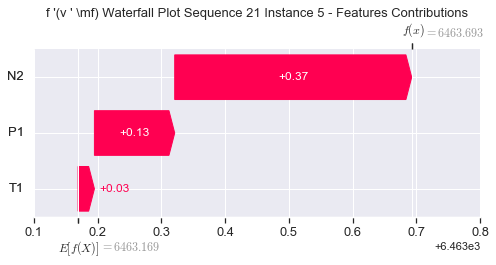

None

Contribution: [0.11852659 0.01477075 0.33561313]


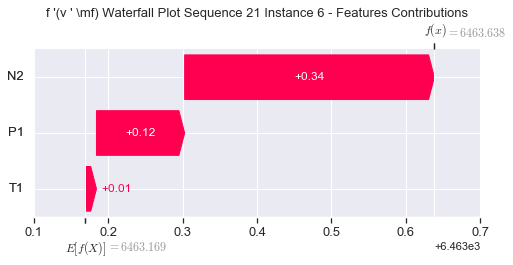

None

Contribution: [0.11404339 0.00646358 0.32592059]


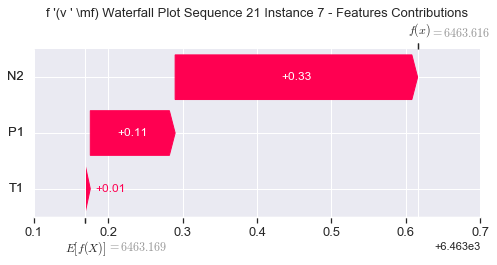

None

Contribution: [ 0.11023056 -0.00072931  0.31473774]


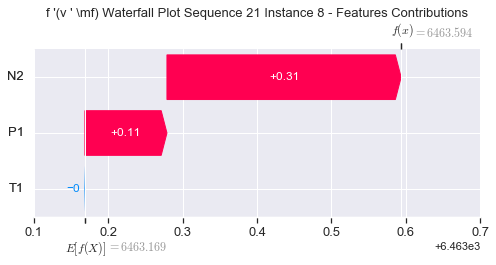

None

Contribution: [ 0.0986552  -0.0034134   0.30986041]


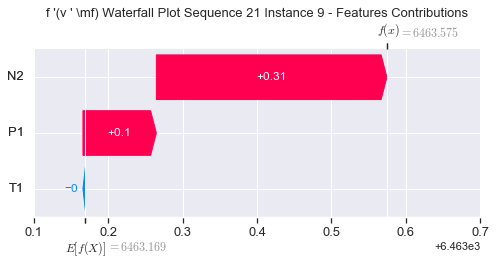

None

Contribution: [0.06736414 0.009286   0.30176707]


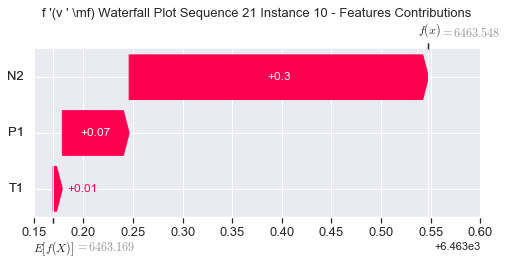

None

Contribution: [0.09739971 0.01369493 0.29581908]


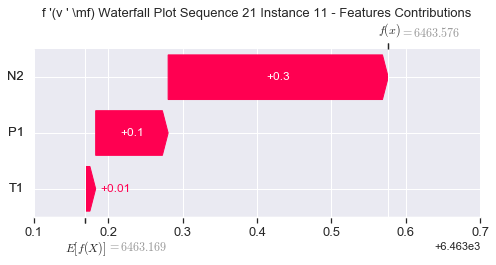

None

Contribution: [0.09181626 0.01186182 0.28375703]


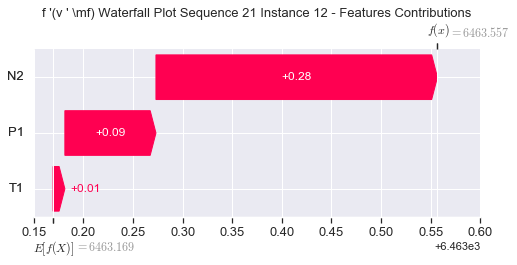

None

Contribution: [0.09093551 0.04351614 0.27770173]


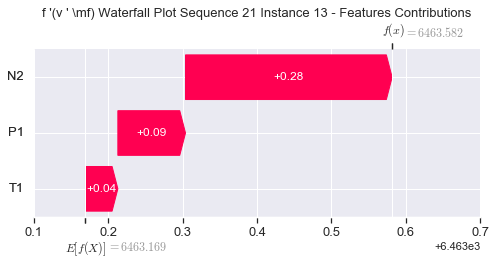

None

Contribution: [0.0949833  0.07716569 0.27393111]


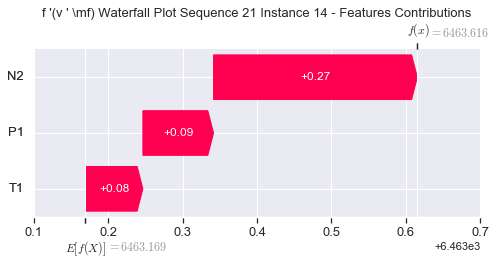

None

Contribution: [0.08620054 0.11503869 0.26701294]


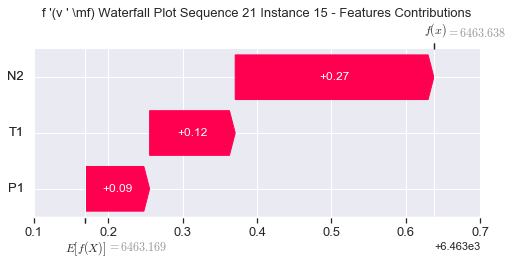

None

Contribution: [0.09176503 0.17892073 0.26070828]


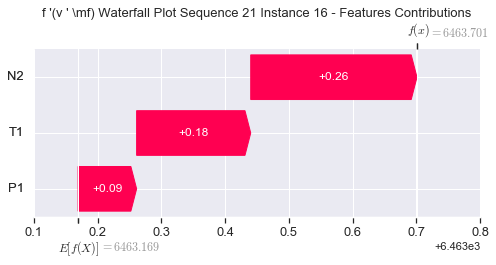

None

Contribution: [0.08339637 0.26598622 0.2601305 ]


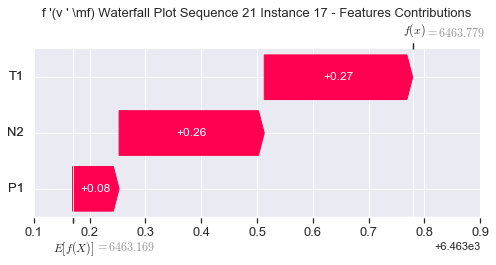

None

Contribution: [0.08350498 0.35271216 0.26142116]


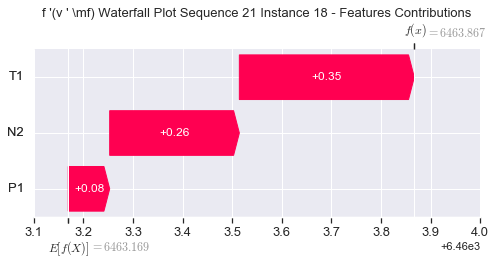

None

Contribution: [0.07386526 0.41561007 0.27609435]


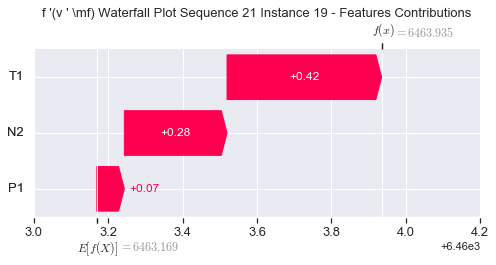

None

Contribution: [0.10407813 0.37383028 0.3075289 ]


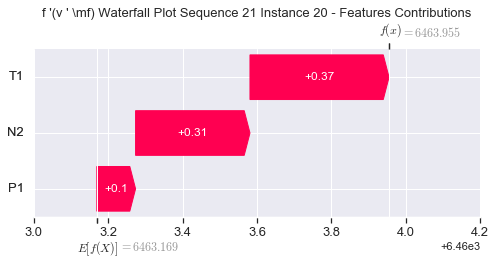

None

Contribution: [0.14873004 0.03912846 0.40464943]


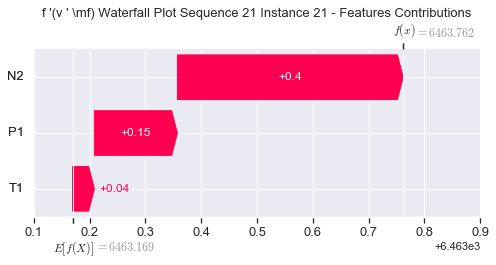

None

Contribution: [ 0.25065899 -1.00798425  0.67442533]


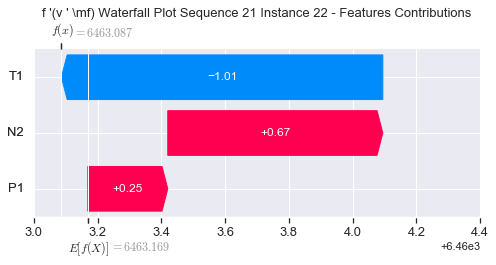

None

Contribution: [ 0.42519598 -3.67749116  1.5013805 ]


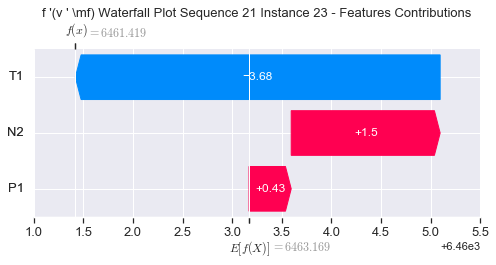

None

Contribution: [  1.09626448 -10.25021821   3.82200587]


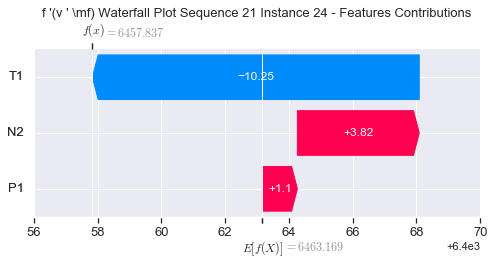

None

Contribution: [  -3.10253002 -190.47852652   51.07688723]


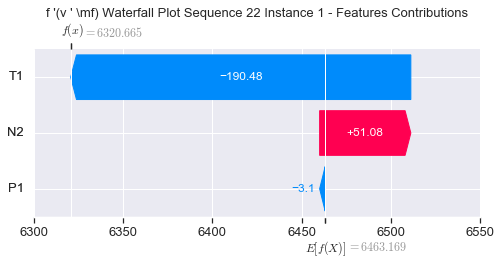

None

Contribution: [0.68738329 3.75984931 2.20231967]


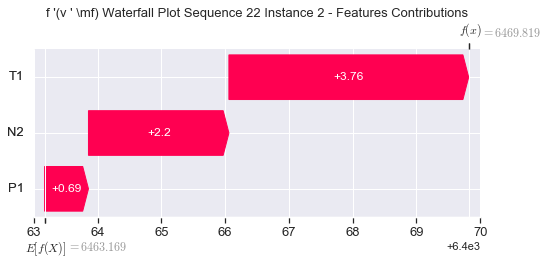

None

Contribution: [ 0.48018535 -2.75873939  1.38438393]


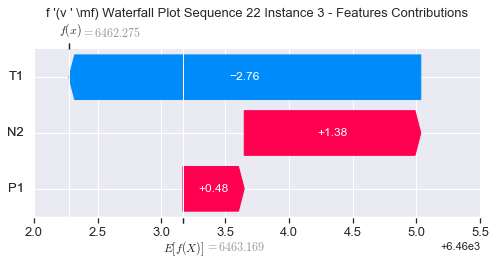

None

Contribution: [ 0.17842937 -0.11400372  0.51415866]


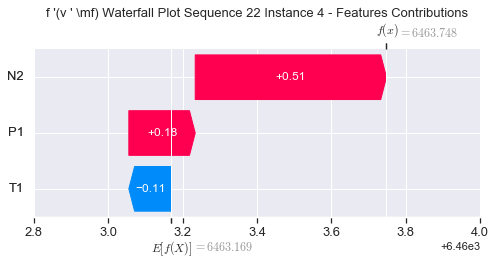

None

Contribution: [ 0.1231633  -0.0527043   0.36414282]


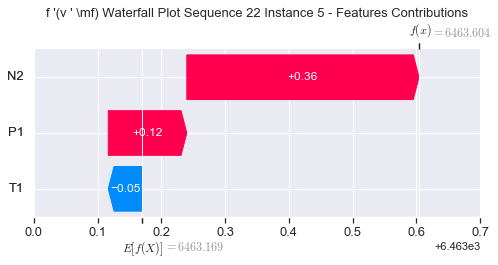

None

Contribution: [ 0.10986569 -0.05787138  0.3256574 ]


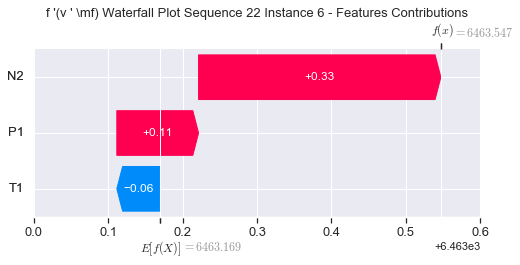

None

Contribution: [ 0.10988466 -0.065853    0.31726175]


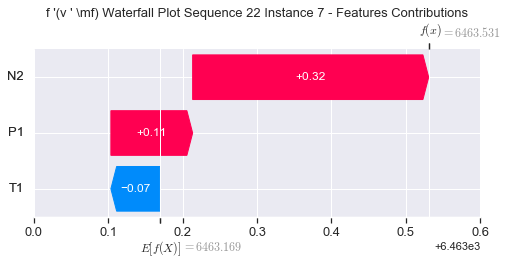

None

Contribution: [ 0.1038721  -0.06471341  0.30623638]


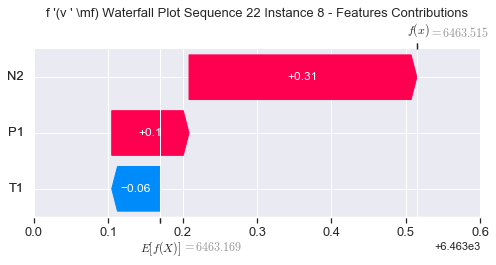

None

Contribution: [ 0.0889927  -0.05789969  0.29789077]


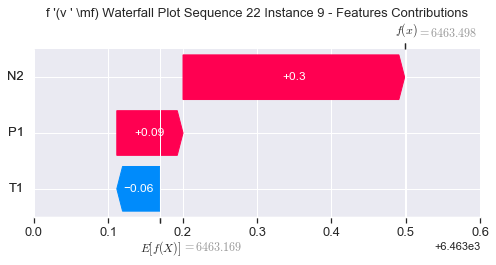

None

Contribution: [ 0.08720479 -0.02921888  0.29655639]


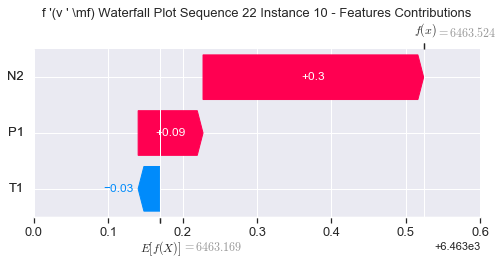

None

Contribution: [ 0.07666689 -0.02434646  0.28189592]


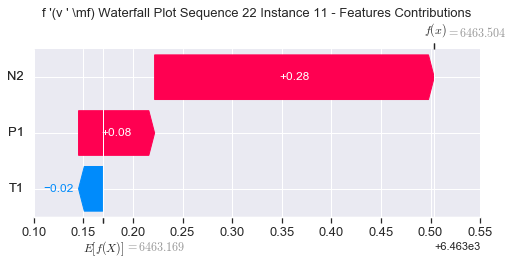

None

Contribution: [ 0.09136113 -0.02587672  0.27901223]


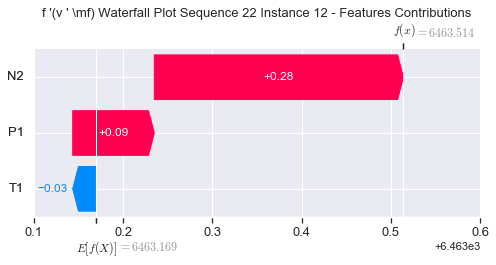

None

Contribution: [ 0.09303267 -0.00226173  0.27461954]


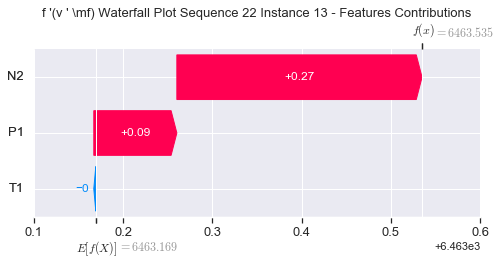

None

Contribution: [0.08827647 0.02618556 0.27083282]


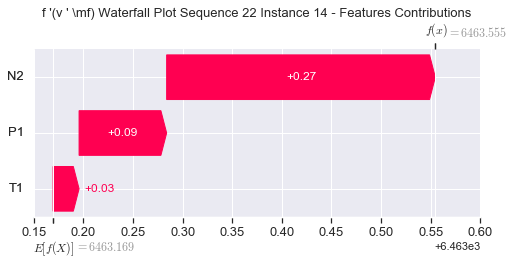

None

Contribution: [0.08749767 0.04826286 0.26504074]


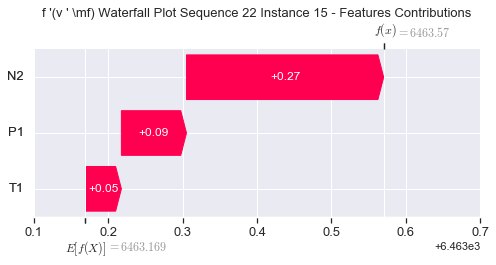

None

Contribution: [0.09153969 0.09752329 0.2635985 ]


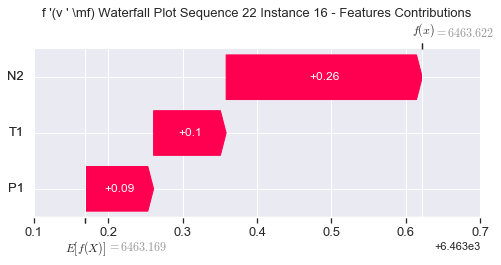

None

Contribution: [0.08789623 0.16362235 0.26067677]


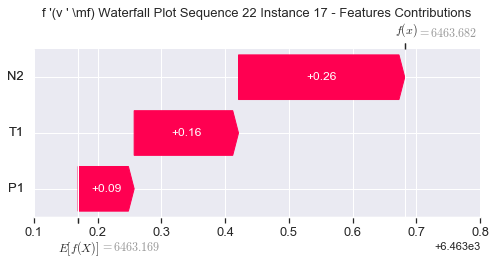

None

Contribution: [0.08845166 0.22575307 0.26241606]


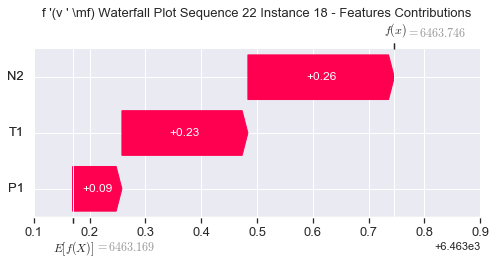

None

Contribution: [0.07415133 0.26203055 0.27725647]


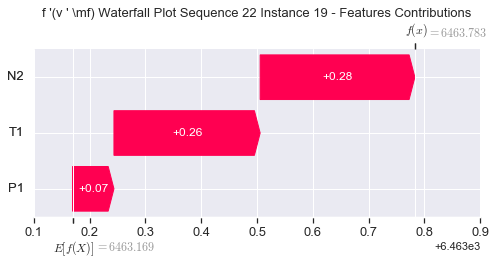

None

Contribution: [0.11501548 0.21804081 0.30721848]


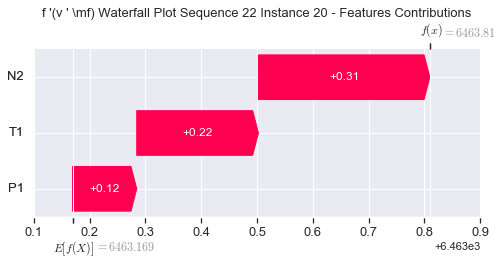

None

Contribution: [ 0.16972676 -0.04906564  0.40194333]


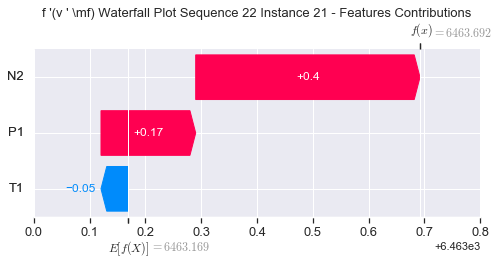

None

Contribution: [ 0.28206121 -0.83158034  0.66630993]


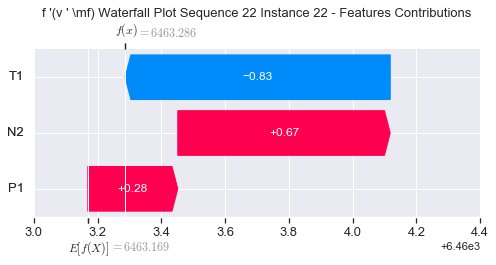

None

Contribution: [ 0.44632334 -2.71083021  1.45957742]


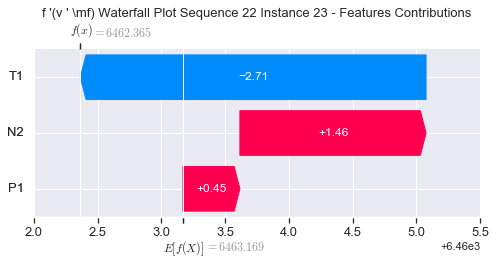

None

Contribution: [ 1.26018092 -7.80488292  3.88261298]


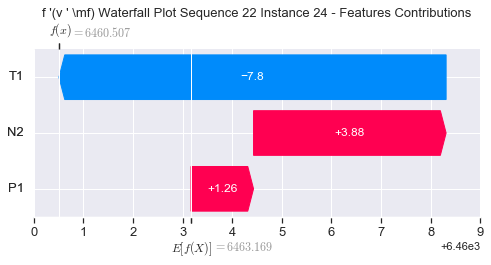

None

Contribution: [   8.20945522 -144.3207781    59.35892609]


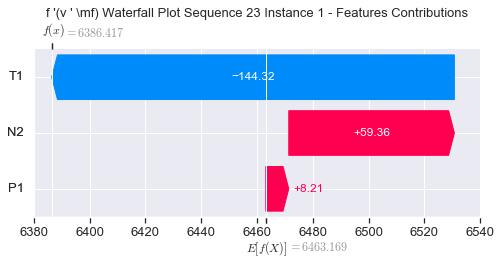

None

Contribution: [0.43369379 2.89994473 2.07641841]


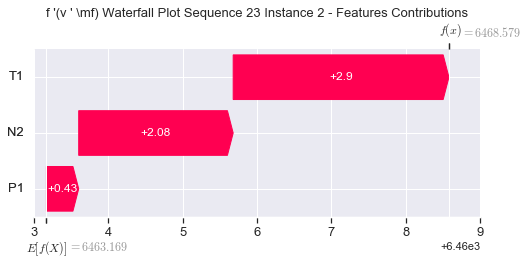

None

Contribution: [ 0.18593378 -2.52098249  1.30357167]


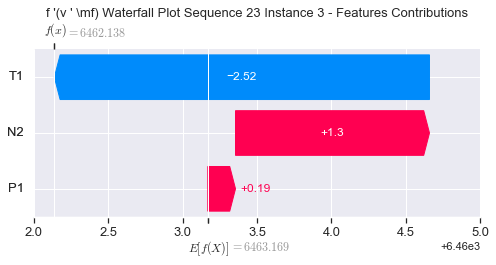

None

Contribution: [ 0.1349281  -0.07643007  0.50412655]


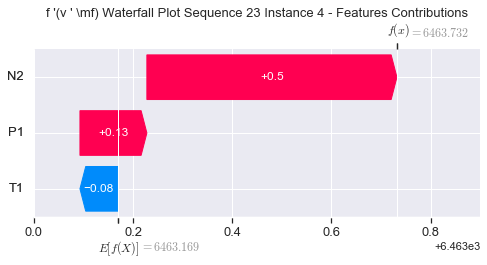

None

Contribution: [ 0.12406751 -0.00941432  0.37344115]


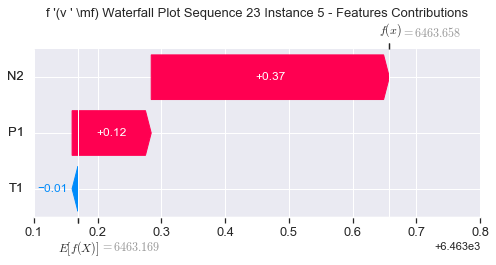

None

Contribution: [ 0.11532579 -0.01648096  0.33627666]


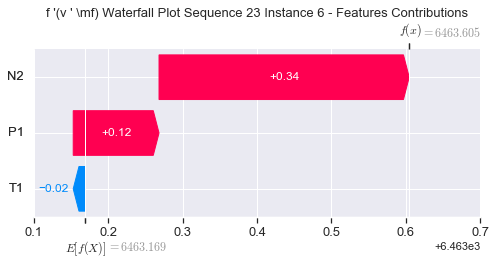

None

Contribution: [ 0.11364353 -0.02100357  0.32769192]


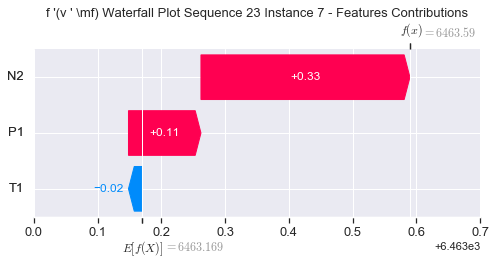

None

Contribution: [ 0.10816007 -0.02575111  0.31619627]


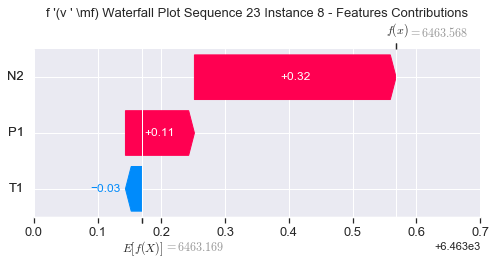

None

Contribution: [ 0.09833381 -0.01574448  0.31389881]


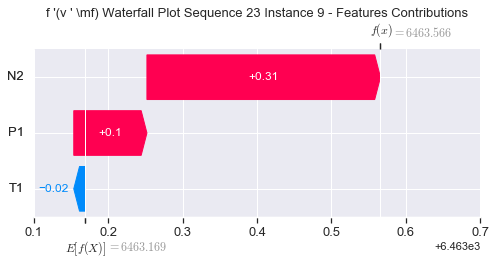

None

Contribution: [ 0.09531041 -0.00225407  0.30802415]


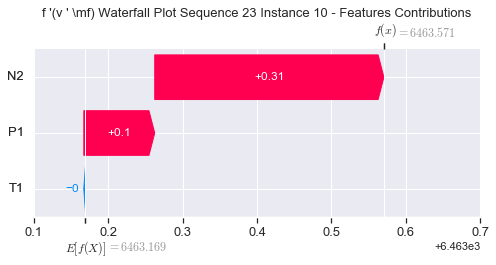

None

Contribution: [0.09054663 0.00030245 0.29590482]


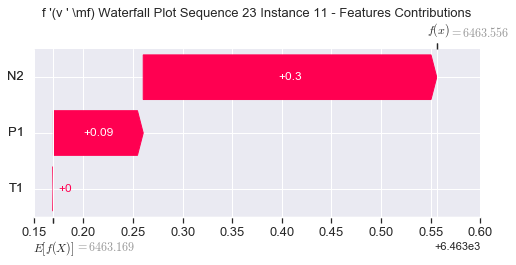

None

Contribution: [0.09611454 0.00554098 0.2853169 ]


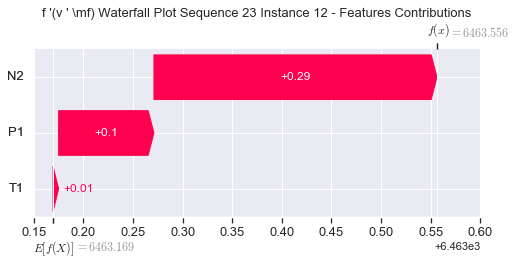

None

Contribution: [0.09542839 0.03571985 0.27967481]


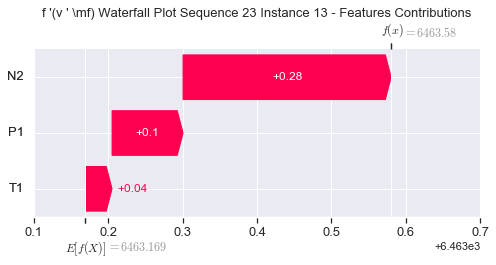

None

Contribution: [0.09224022 0.07033538 0.27571242]


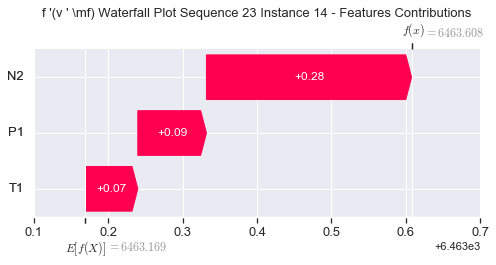

None

Contribution: [0.08761768 0.10138661 0.26798401]


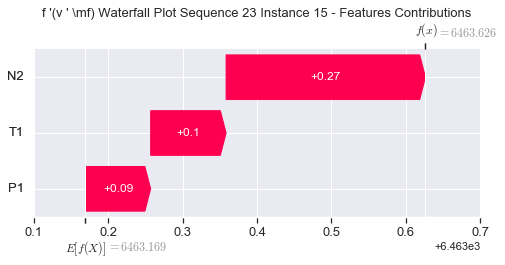

None

Contribution: [0.08841768 0.15823723 0.26094235]


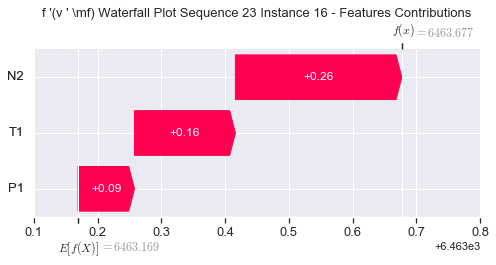

None

Contribution: [0.08479068 0.23975338 0.2610389 ]


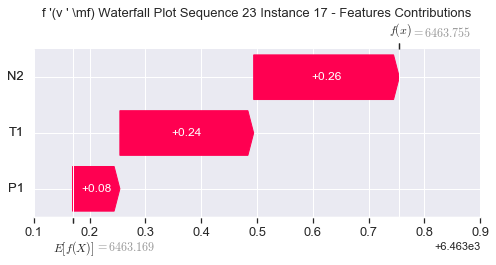

None

Contribution: [0.08480815 0.31752912 0.26228621]


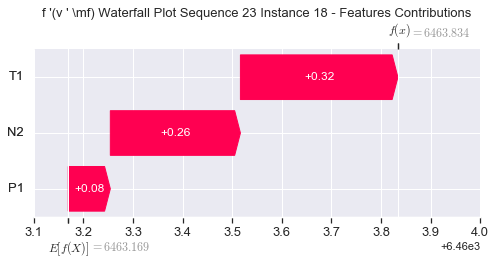

None

Contribution: [0.07541756 0.3737134  0.27743473]


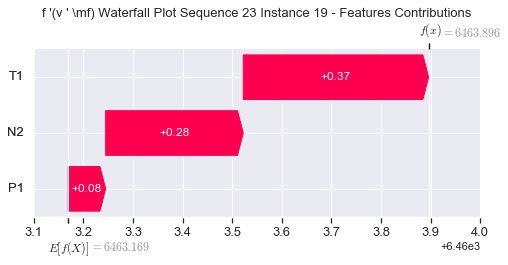

None

Contribution: [0.1063502  0.33903297 0.30864007]


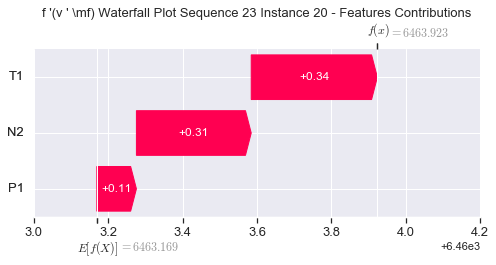

None

Contribution: [0.15341713 0.05380756 0.40650782]


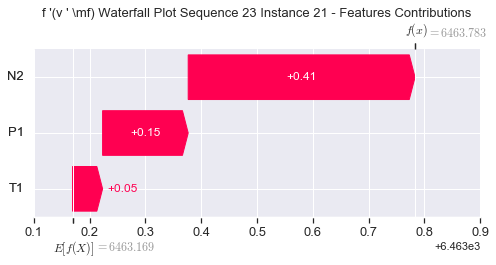

None

Contribution: [ 0.24843233 -0.83544943  0.67218349]


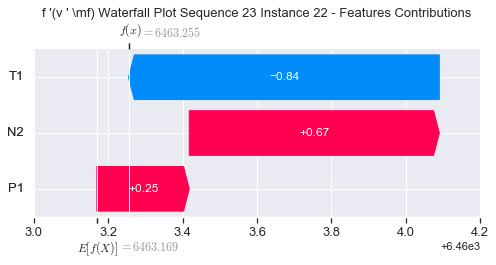

None

Contribution: [ 0.39319654 -3.07360947  1.47264534]


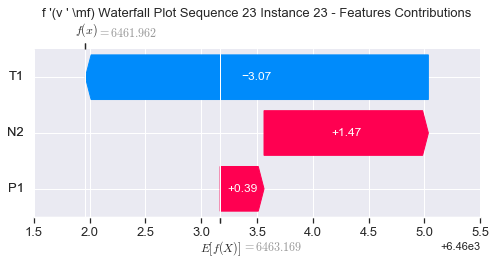

None

Contribution: [ 1.55236053 -8.59482202  3.93079747]


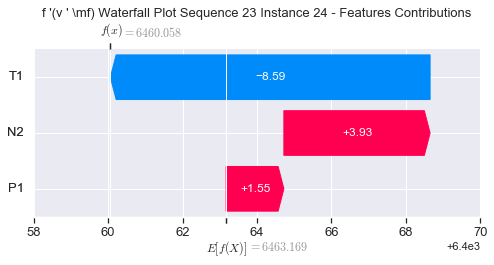

None

Contribution: [  37.73316373 -134.1997424    64.1529567 ]


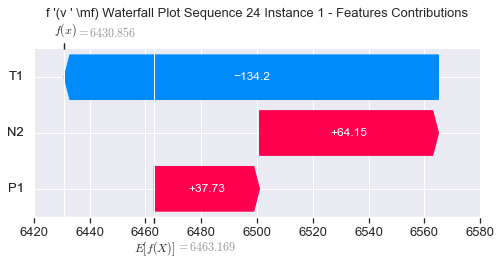

None

Contribution: [0.51112708 3.27814037 2.0204245 ]


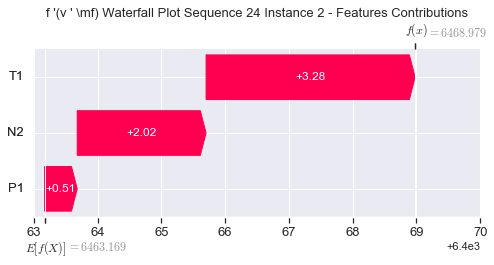

None

Contribution: [ 0.45761686 -1.7269267   1.36678529]


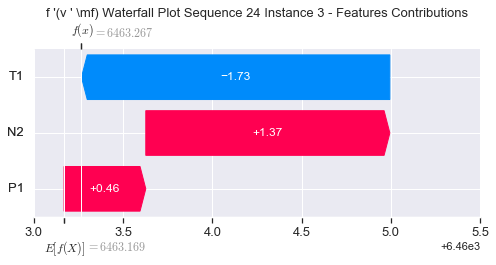

None

Contribution: [ 0.18916457 -0.04361898  0.51545472]


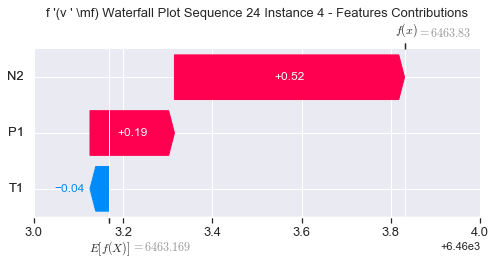

None

Contribution: [ 0.12852851 -0.00489366  0.37519943]


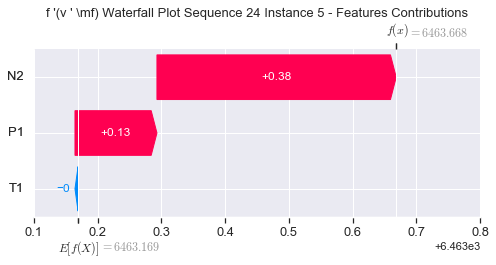

None

Contribution: [ 0.11534113 -0.01699731  0.33810115]


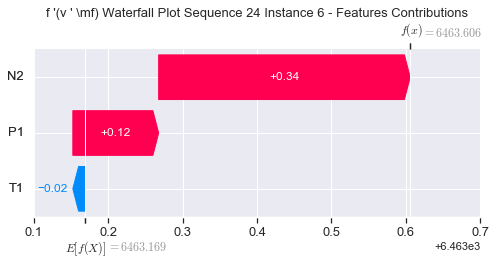

None

Contribution: [ 0.11371201 -0.02036044  0.32945361]


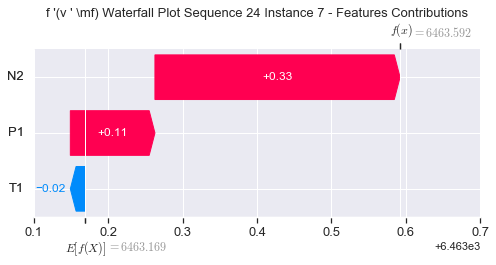

None

Contribution: [ 0.10801565 -0.02033716  0.31707941]


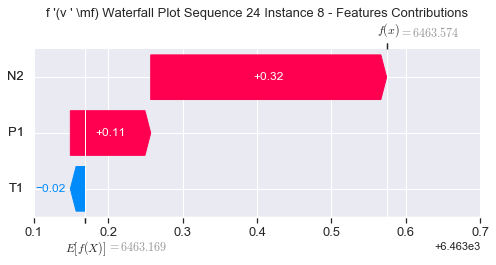

None

Contribution: [ 0.09151773 -0.01070258  0.31096905]


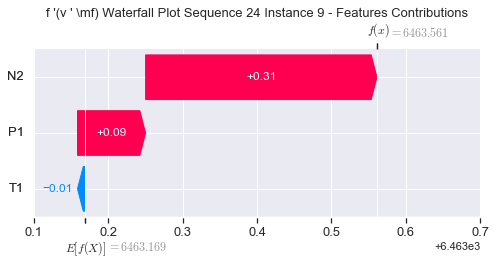

None

Contribution: [ 0.08915211 -0.0063605   0.30633943]


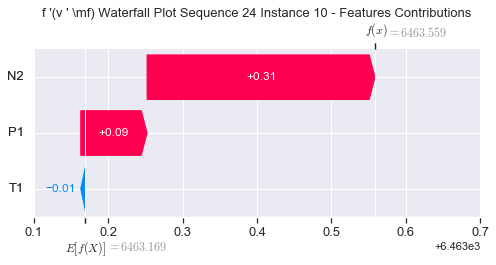

None

Contribution: [0.08689268 0.00958139 0.29397394]


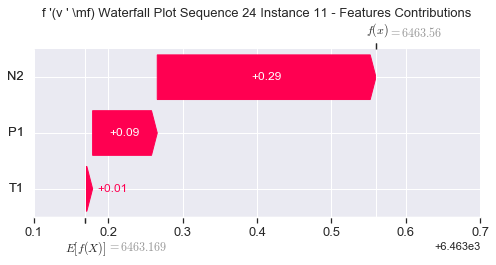

None

Contribution: [0.09818258 0.01908825 0.28648625]


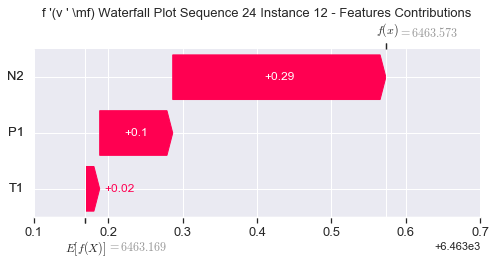

None

Contribution: [0.09652593 0.05967036 0.2802444 ]


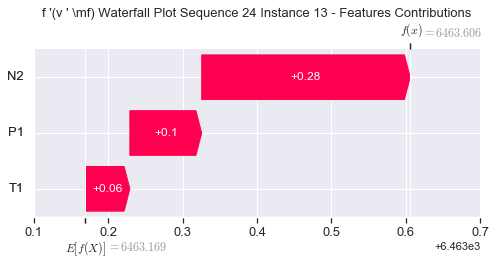

None

Contribution: [0.08844283 0.09665719 0.2719982 ]


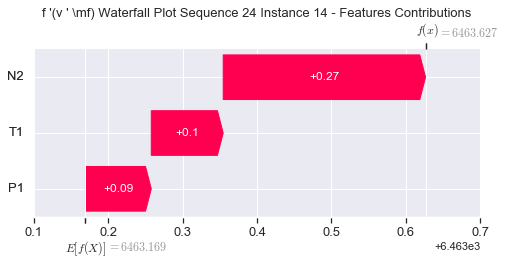

None

Contribution: [0.08695177 0.14839194 0.26786243]


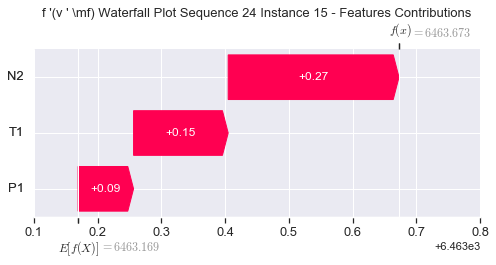

None

Contribution: [0.09207172 0.21682012 0.2589485 ]


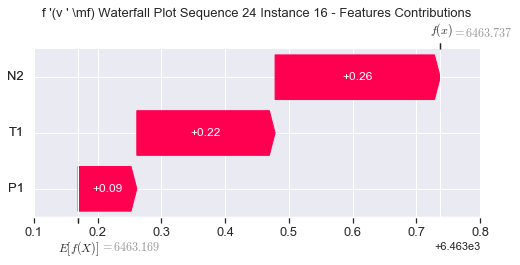

None

Contribution: [0.08042829 0.31178841 0.25976367]


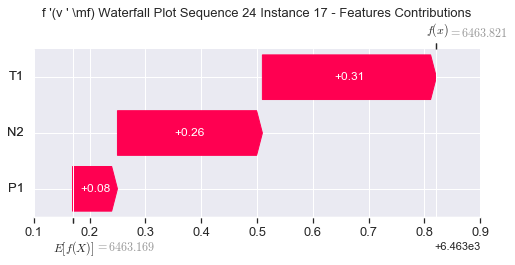

None

Contribution: [0.07950306 0.40202452 0.26099808]


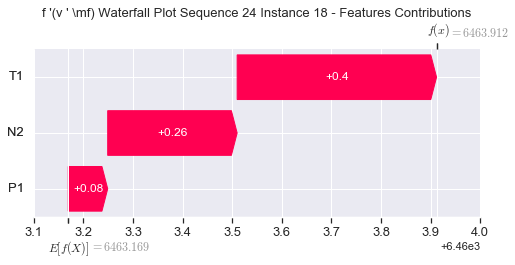

None

Contribution: [0.07356282 0.47080857 0.2732472 ]


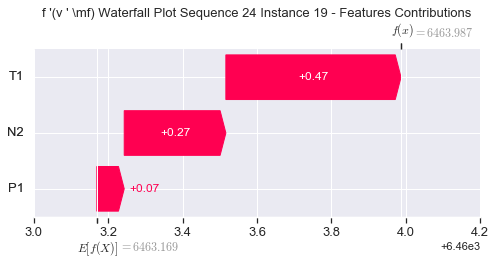

None

Contribution: [0.10164233 0.46645168 0.3087296 ]


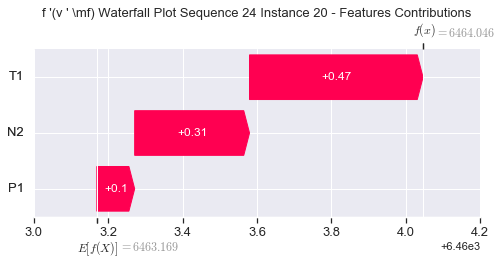

None

Contribution: [0.15849871 0.25557548 0.40826945]


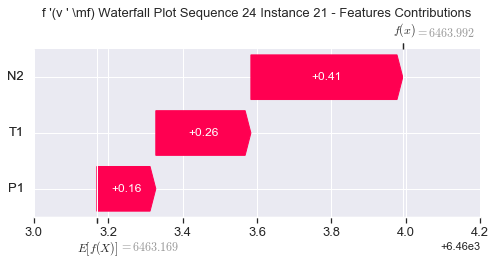

None

Contribution: [ 0.29928372 -0.43627257  0.67909947]


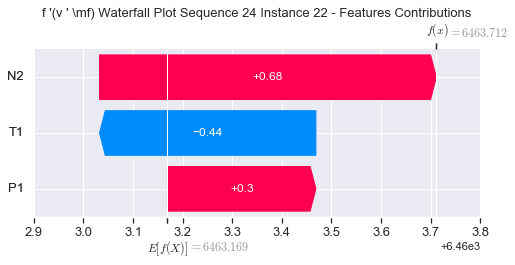

None

Contribution: [ 0.51753105 -2.21405639  1.49920737]


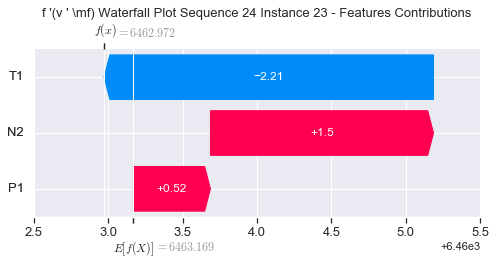

None

Contribution: [ 1.58244877 -6.39821964  3.87739672]


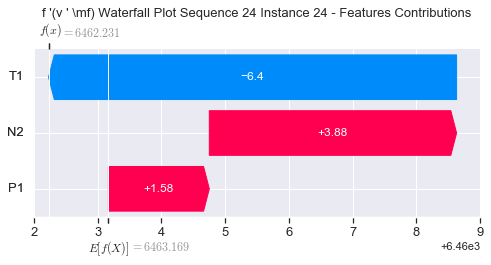

None

Contribution: [  24.77295525 -103.72112127   58.94128391]


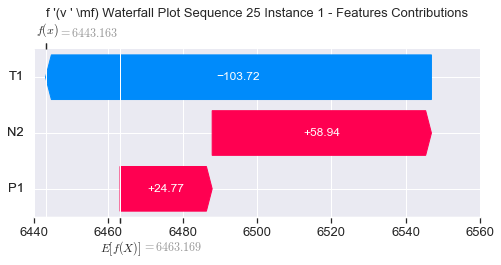

None

Contribution: [0.24886545 2.7708569  1.98692538]


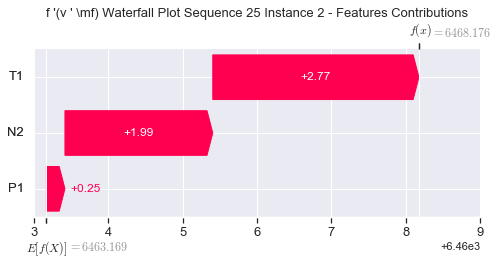

None

Contribution: [ 0.55904234 -1.33056702  1.37657242]


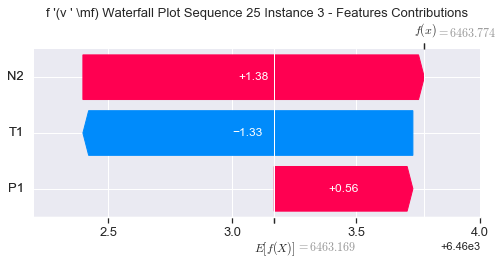

None

Contribution: [ 0.15047683 -0.02077971  0.50729649]


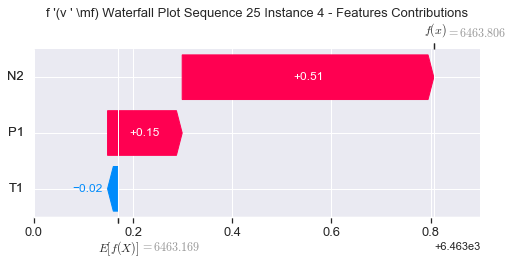

None

Contribution: [0.12105897 0.03438711 0.37298881]


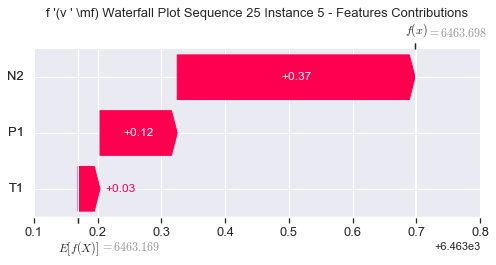

None

Contribution: [0.10731025 0.01390125 0.33589088]


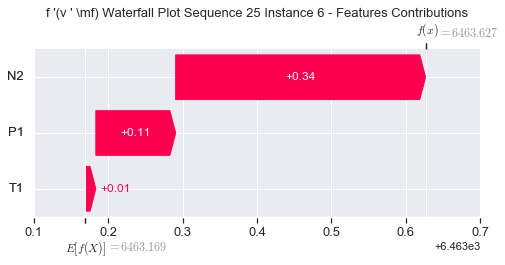

None

Contribution: [0.10432995 0.00666642 0.32666439]


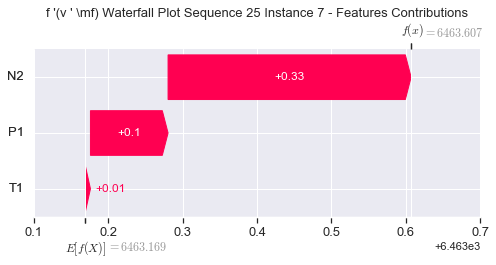

None

Contribution: [0.10127385 0.01021365 0.31549747]


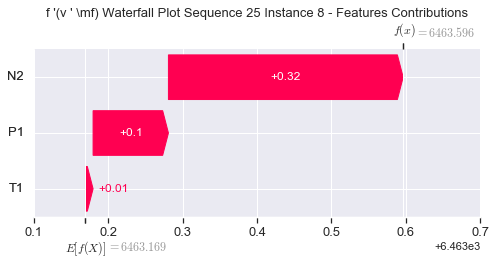

None

Contribution: [0.0960767  0.01979812 0.31439865]


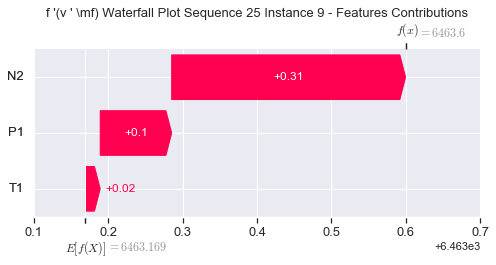

None

Contribution: [0.06806728 0.01444166 0.30260907]


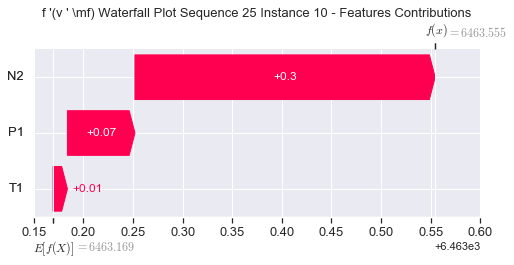

None

Contribution: [0.09250202 0.0527234  0.29833232]


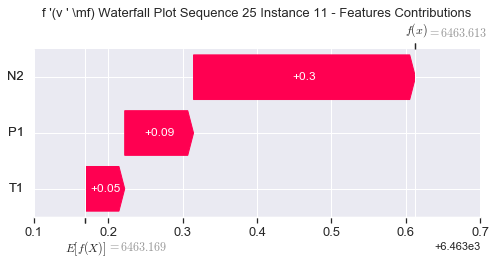

None

Contribution: [0.09190578 0.04968903 0.28569509]


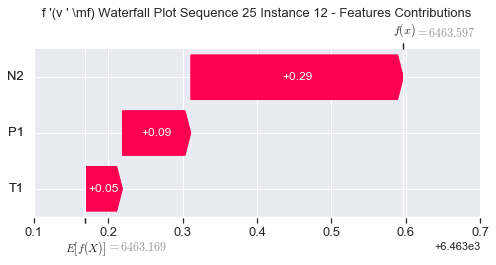

None

Contribution: [0.09093008 0.08562425 0.27929391]


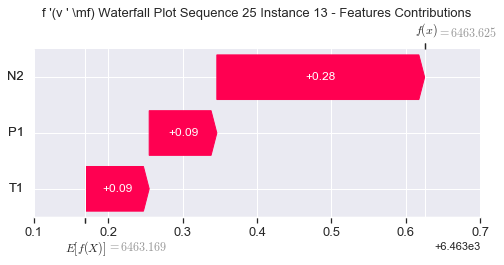

None

Contribution: [0.08952333 0.12034622 0.27201834]


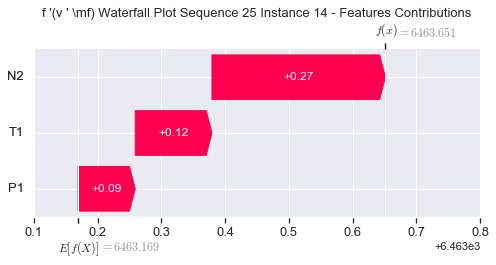

None

Contribution: [0.08408899 0.16856646 0.26721894]


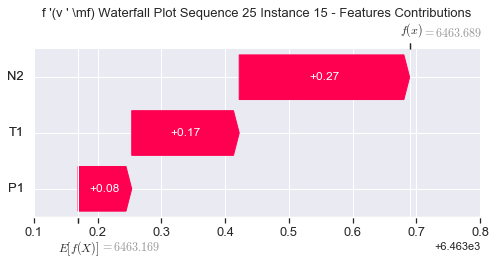

None

Contribution: [0.09332939 0.23640809 0.25834555]


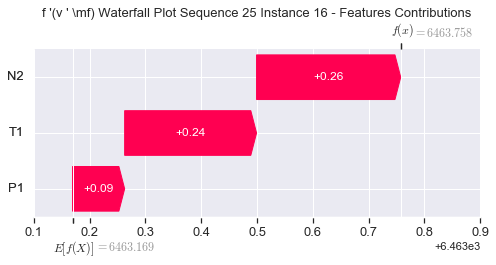

None

Contribution: [0.08134319 0.33026151 0.25933619]


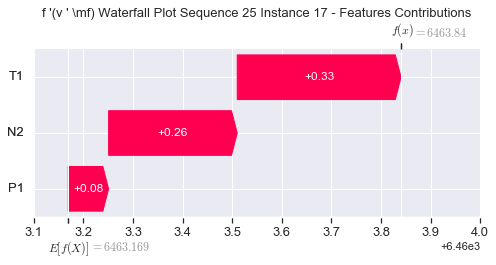

None

Contribution: [0.08194832 0.42258219 0.26068159]


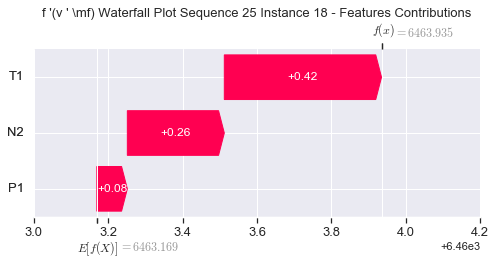

None

Contribution: [0.06883495 0.4991234  0.27387973]


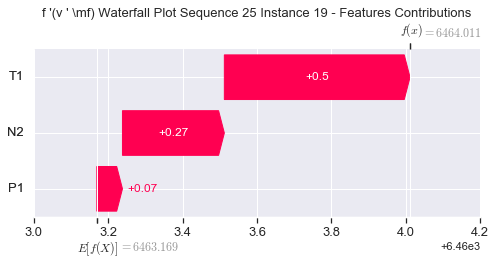

None

Contribution: [0.09909363 0.50058772 0.30781511]


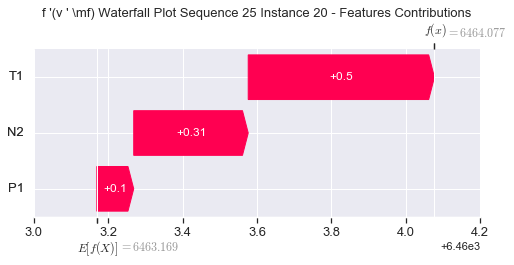

None

Contribution: [0.14107846 0.30906386 0.40679114]


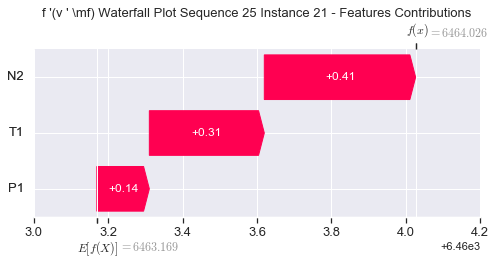

None

Contribution: [ 0.24882628 -0.30513003  0.6790715 ]


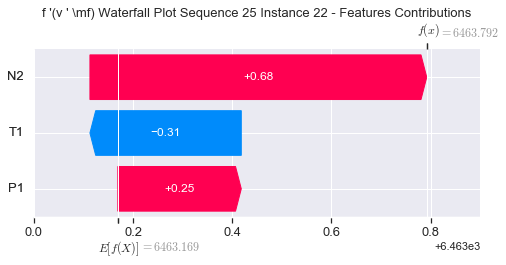

None

Contribution: [ 0.39033076 -1.96706558  1.50589535]


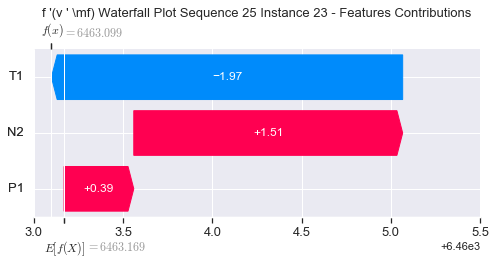

None

Contribution: [ 1.27632257 -5.79005817  3.99863803]


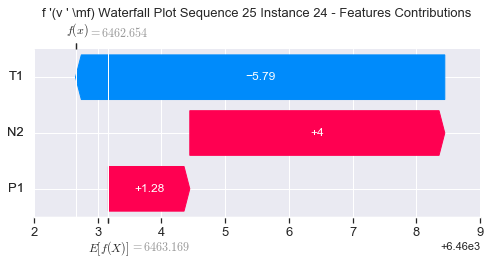

None

Contribution: [ 21.20390106 -87.07765317  66.66233426]


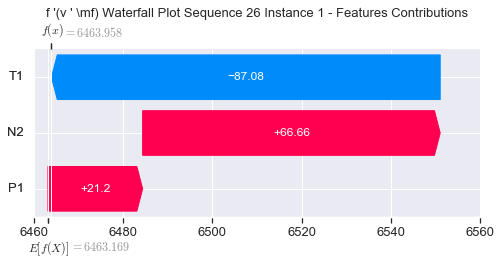

None

Contribution: [0.37000097 2.5205435  1.92801556]


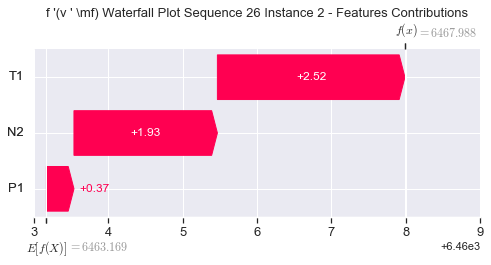

None

Contribution: [ 0.50539731 -0.7066729   1.40105273]


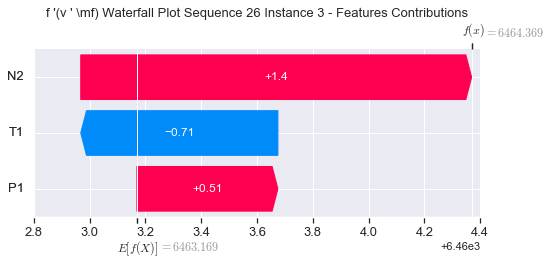

None

Contribution: [0.16961349 0.0555584  0.51708819]


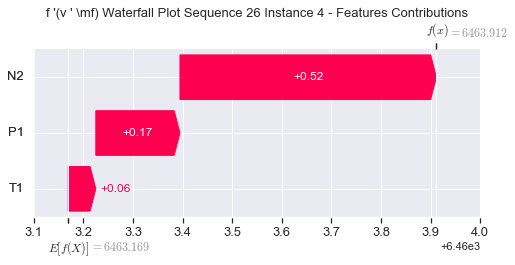

None

Contribution: [0.12567278 0.0622865  0.37863277]


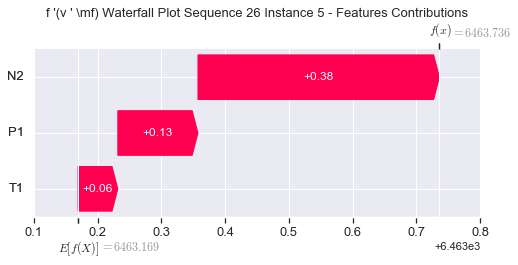

None

Contribution: [0.10763457 0.04208366 0.33914772]


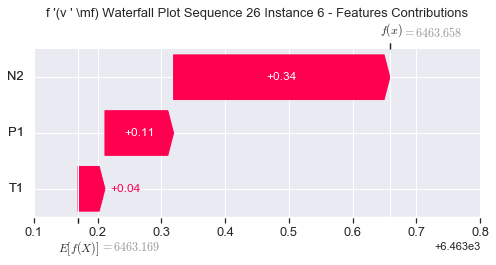

None

Contribution: [0.10535229 0.03822486 0.32979573]


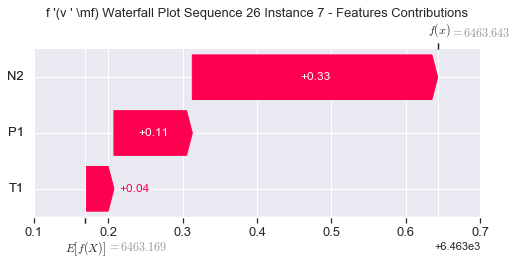

None

Contribution: [0.10172439 0.03812305 0.31779489]


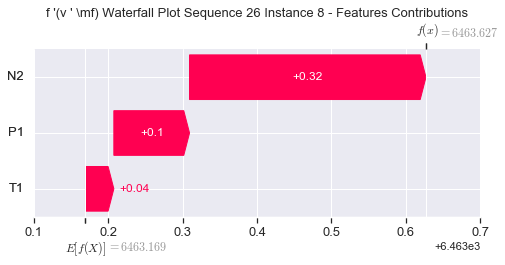

None

Contribution: [0.09185227 0.04727293 0.31277339]


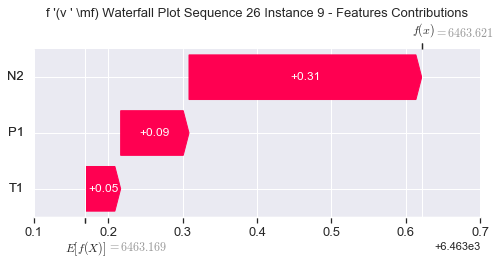

None

Contribution: [0.0833856  0.06022848 0.30774983]


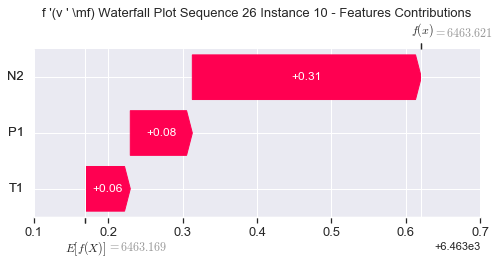

None

Contribution: [0.09047123 0.06960493 0.29643151]


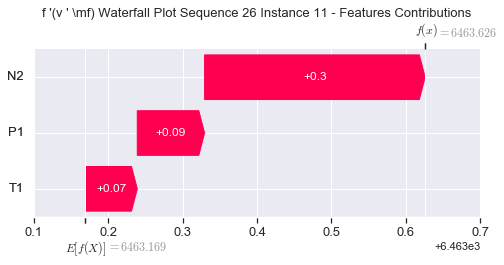

None

Contribution: [0.09773139 0.07558503 0.28718213]


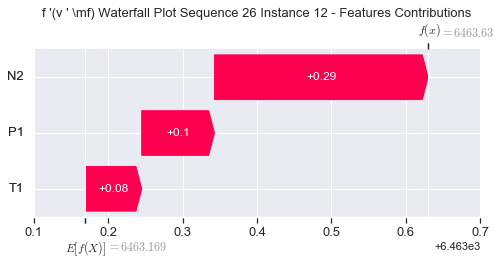

None

Contribution: [0.09469629 0.11277573 0.28024339]


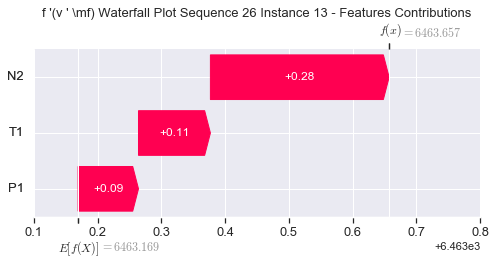

None

Contribution: [0.08801621 0.15100759 0.27256496]


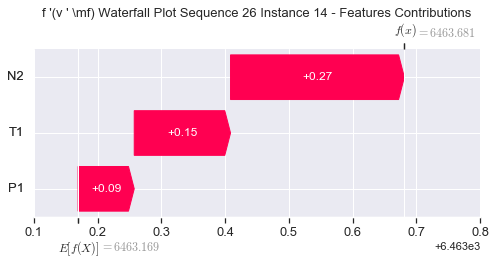

None

Contribution: [0.08355432 0.19734749 0.26676027]


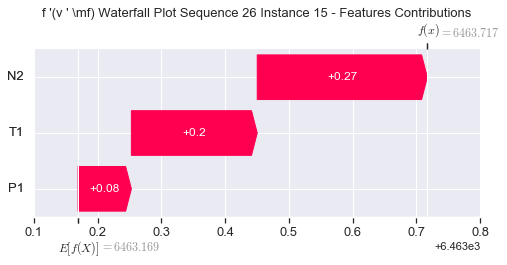

None

Contribution: [0.09413953 0.26320399 0.25689496]


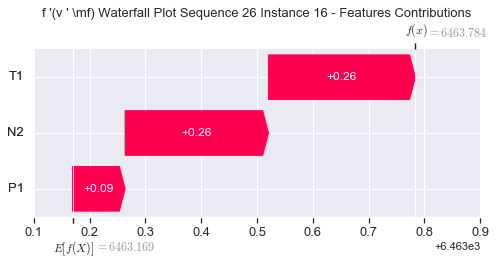

None

Contribution: [0.07821628 0.36750486 0.25798547]


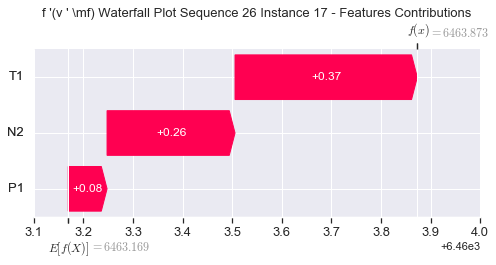

None

Contribution: [0.0791496  0.46857456 0.25942412]


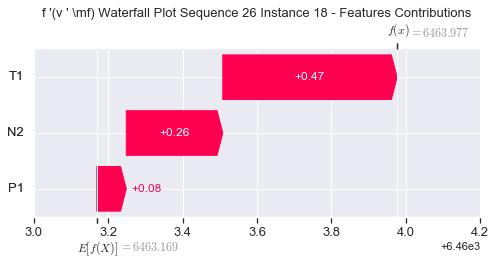

None

Contribution: [0.07229492 0.54636026 0.27384552]


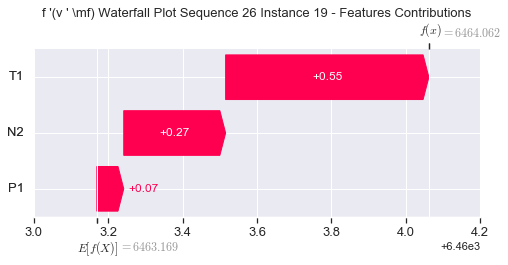

None

Contribution: [0.09676099 0.56593882 0.30644785]


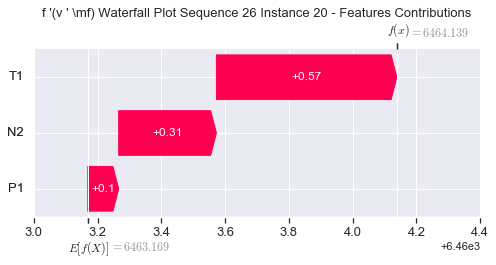

None

Contribution: [0.13716618 0.37239251 0.40389273]


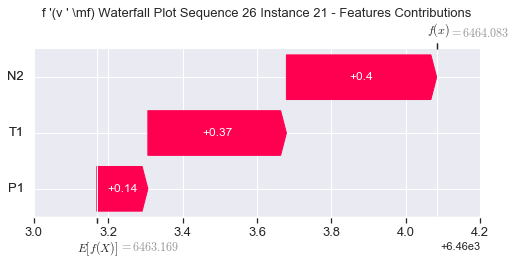

None

Contribution: [ 0.25308656 -0.31491391  0.67349803]


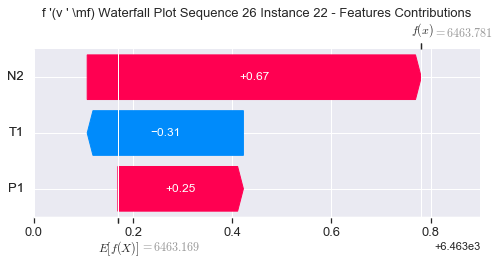

None

Contribution: [ 0.38120082 -2.17214136  1.4773274 ]


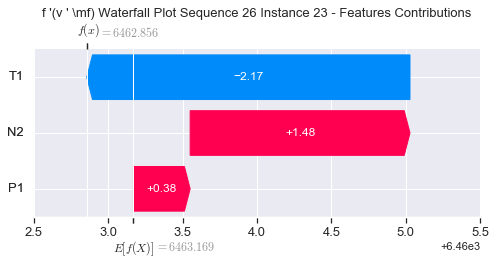

None

Contribution: [ 1.09015723 -6.6746806   3.80821897]


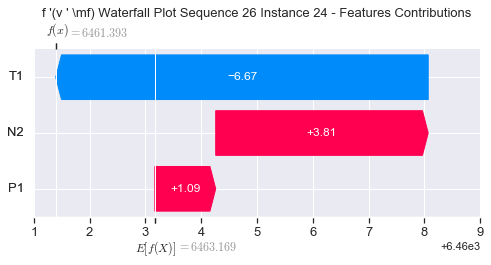

None

Contribution: [  17.08168074 -110.43339719   57.22878831]


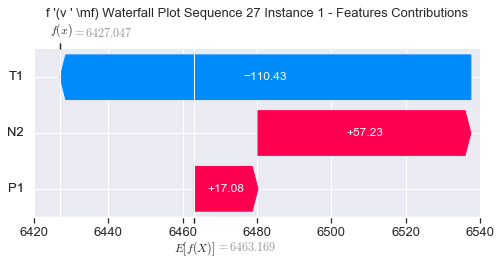

None

Contribution: [0.17858166 2.76492634 1.98569708]


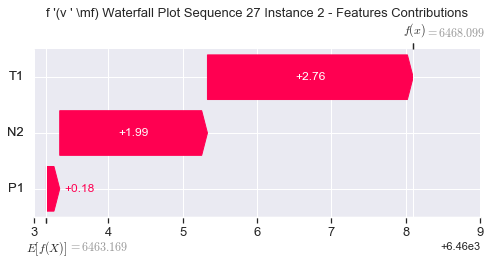

None

Contribution: [ 0.50652928 -1.51018684  1.40087839]


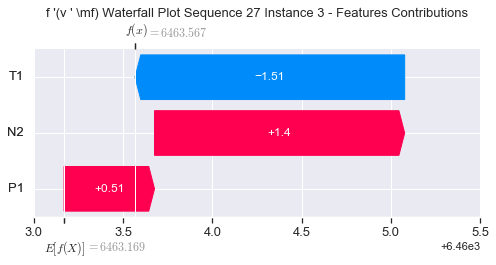

None

Contribution: [0.17420231 0.02591218 0.51634801]


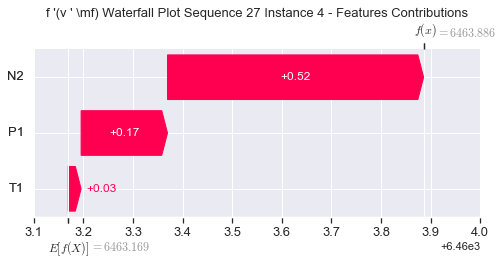

None

Contribution: [0.11384648 0.01160315 0.3714328 ]


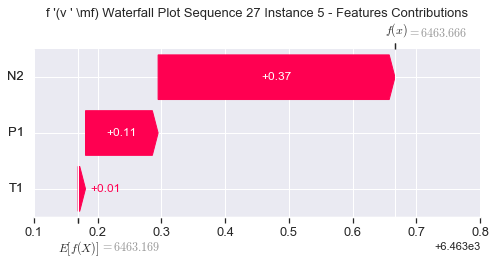

None

Contribution: [0.10963281 0.009911   0.33614212]


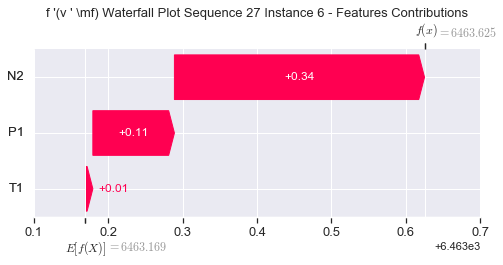

None

Contribution: [0.10659681 0.00744826 0.32665892]


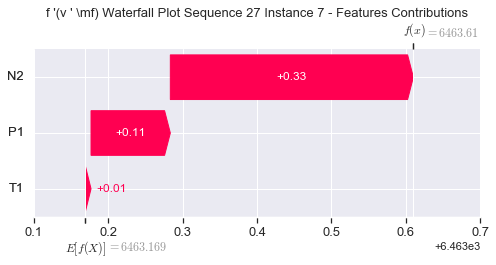

None

Contribution: [0.10134037 0.00483816 0.31480113]


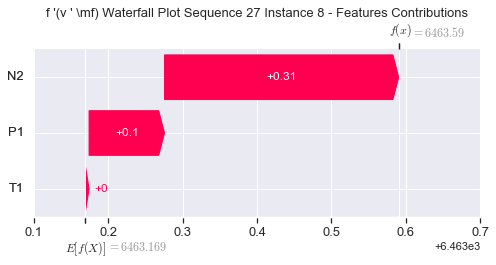

None

Contribution: [0.08651152 0.01761781 0.30983489]


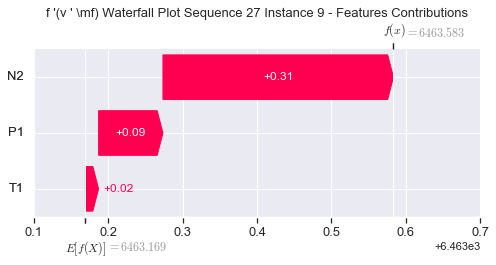

None

Contribution: [0.07908389 0.02629692 0.30412685]


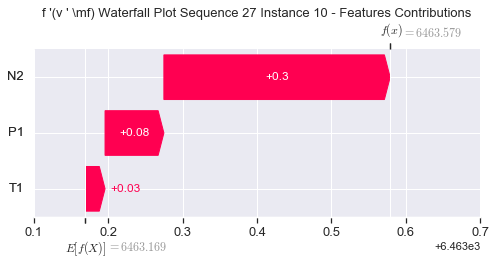

None

Contribution: [0.0835953  0.02785196 0.2931831 ]


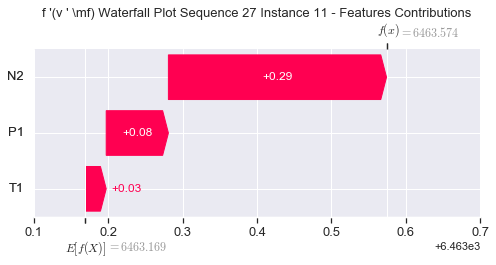

None

Contribution: [0.0871849  0.03053479 0.28147   ]


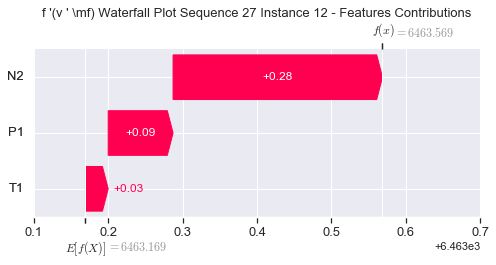

None

Contribution: [0.08724267 0.06899831 0.27608697]


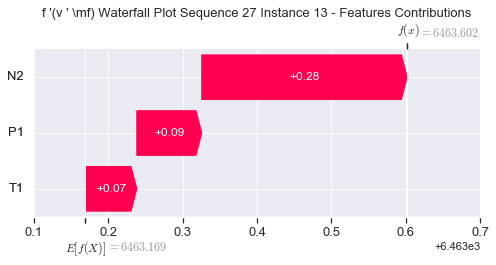

None

Contribution: [0.0851062  0.11036475 0.27137674]


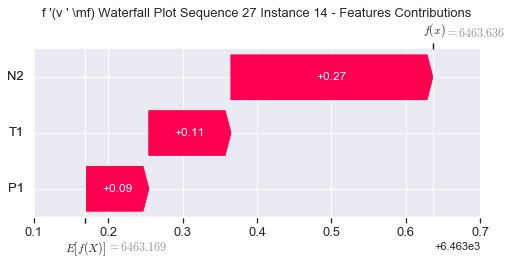

None

Contribution: [0.08306015 0.15003769 0.26621996]


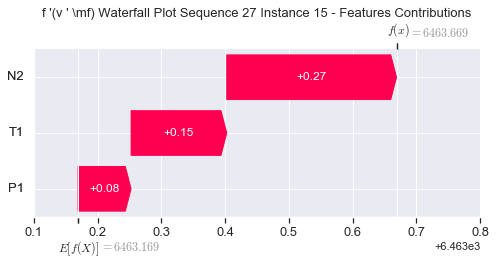

None

Contribution: [0.0923914  0.21365901 0.25989579]


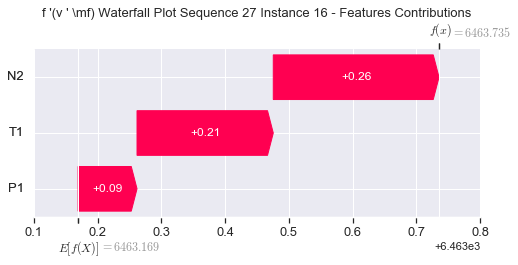

None

Contribution: [0.08272547 0.30103021 0.2606993 ]


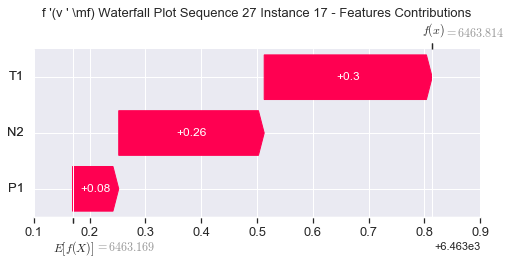

None

Contribution: [0.08319273 0.38532252 0.26250482]


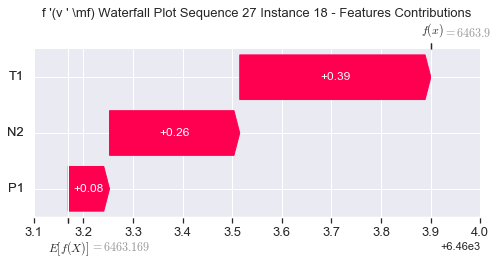

None

Contribution: [0.07510706 0.45643338 0.27818405]


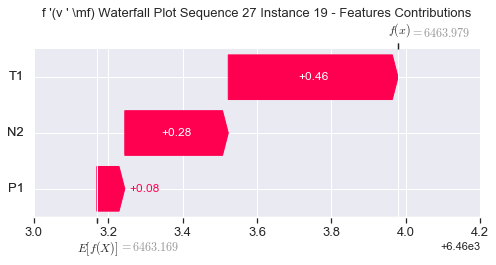

None

Contribution: [0.10058414 0.45895347 0.30794679]


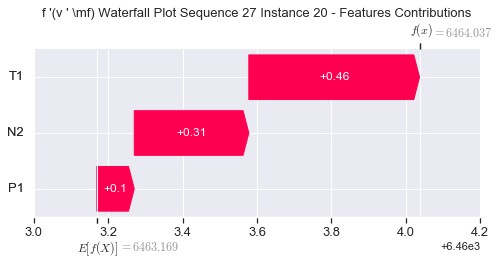

None

Contribution: [0.13483118 0.27645246 0.39991396]


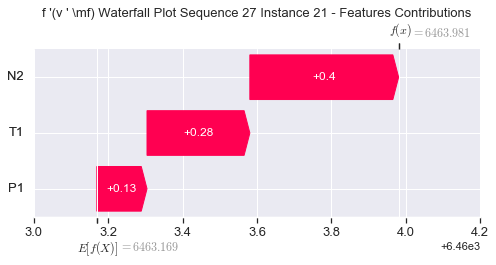

None

Contribution: [ 0.1951033  -0.37994068  0.64772081]


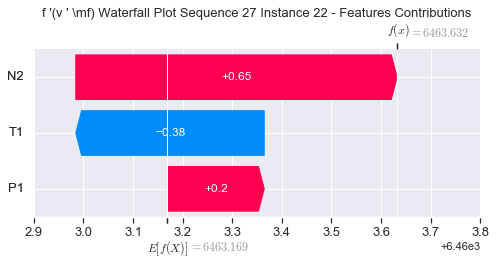

None

Contribution: [ 0.30566253 -1.99142549  1.42689084]


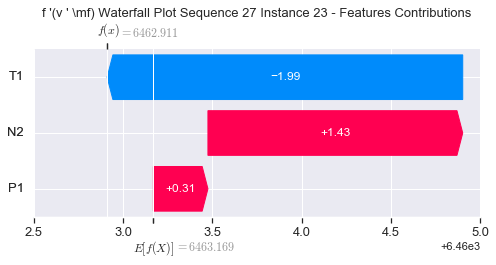

None

Contribution: [ 1.00723246 -5.67826481  3.74403467]


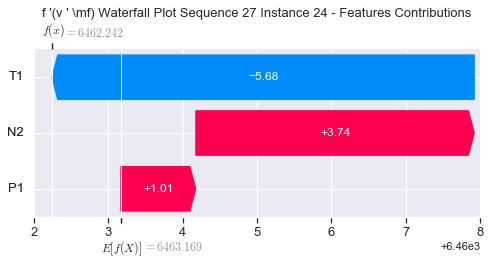

None

Contribution: [  9.69942488 -86.89724611  55.41388458]


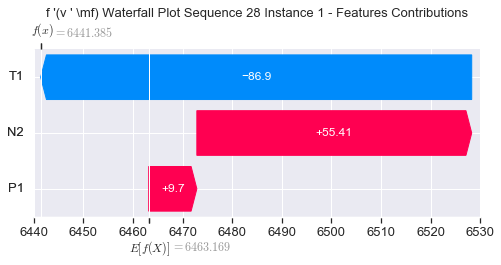

None

Contribution: [0.78784091 2.87275007 2.12656277]


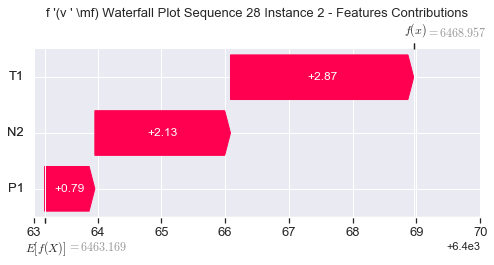

None

Contribution: [-9.29903277e-04 -1.32679839e+00  1.23090910e+00]


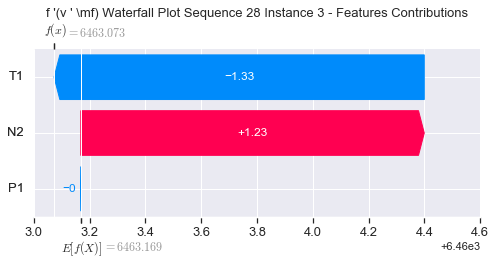

None

Contribution: [0.17534069 0.03225701 0.51000463]


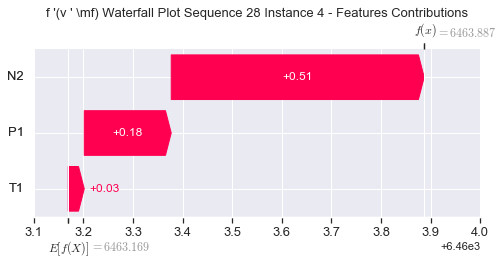

None

Contribution: [0.13668926 0.04113603 0.37754188]


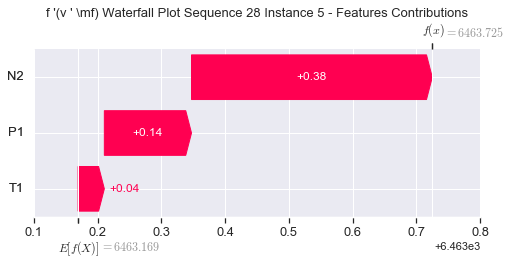

None

Contribution: [0.11611518 0.05300865 0.33717907]


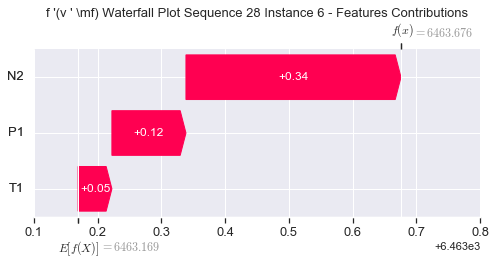

None

Contribution: [0.10799536 0.06187747 0.32866939]


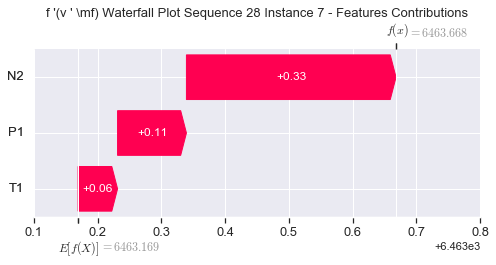

None

Contribution: [0.10981994 0.04155716 0.317544  ]


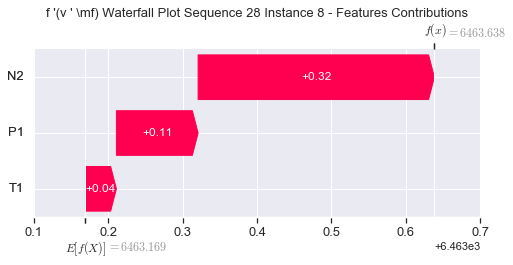

None

Contribution: [0.09454334 0.0854246  0.32047882]


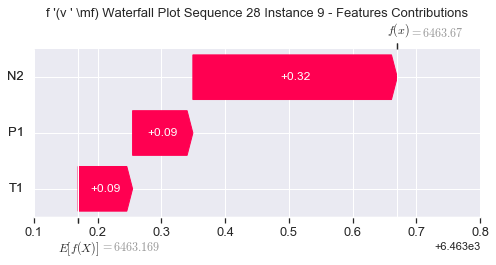

None

Contribution: [0.10124336 0.08632822 0.31401097]


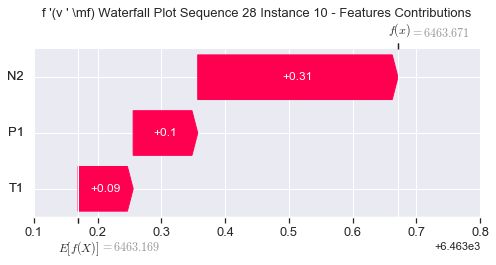

None

Contribution: [0.10362438 0.05643949 0.29917633]


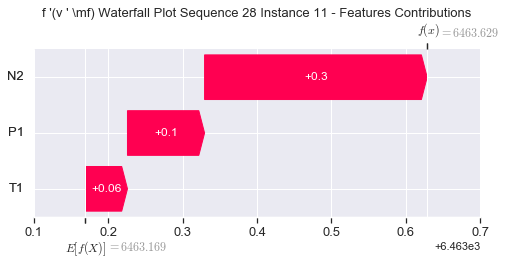

None

Contribution: [0.09910172 0.04727715 0.28545369]


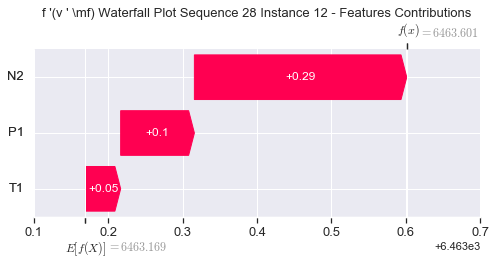

None

Contribution: [0.09665291 0.08220396 0.27950627]


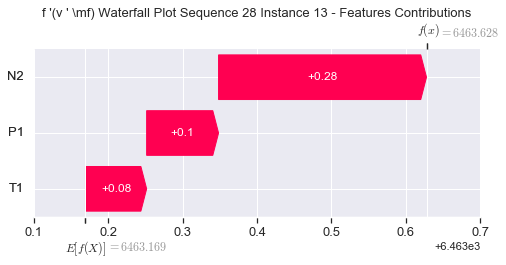

None

Contribution: [0.08539657 0.11184031 0.27083502]


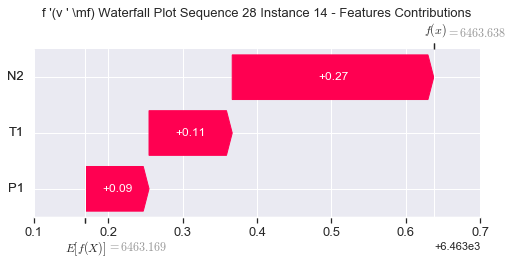

None

Contribution: [0.08693345 0.15750884 0.26662445]


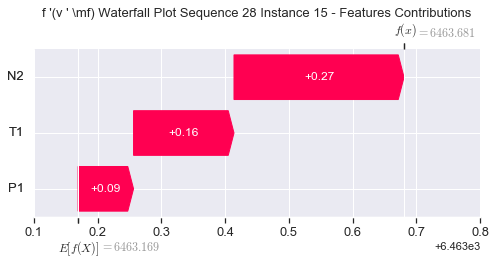

None

Contribution: [0.09289015 0.2270421  0.259009  ]


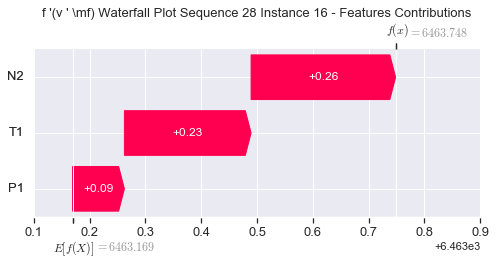

None

Contribution: [0.07824128 0.32946494 0.2588642 ]


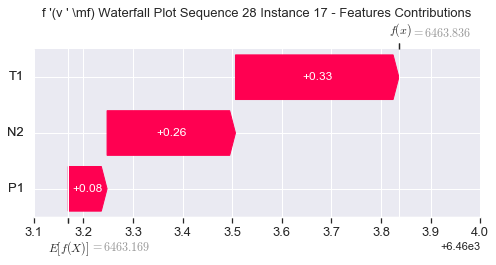

None

Contribution: [0.07394605 0.43774864 0.25993852]


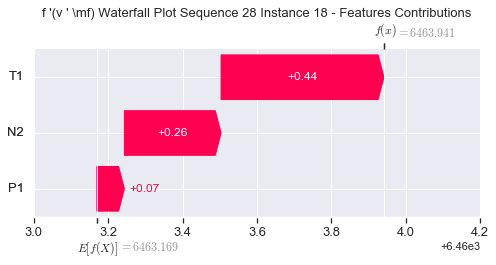

None

Contribution: [0.07275333 0.52241799 0.27404302]


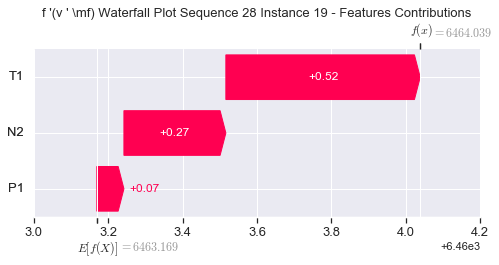

None

Contribution: [0.10066402 0.48503666 0.30641711]


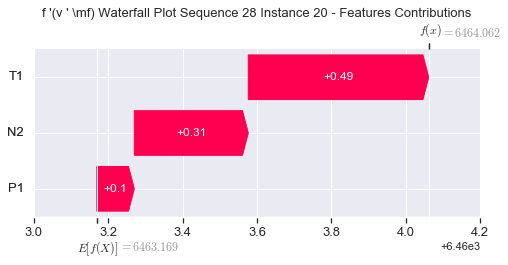

None

Contribution: [0.19879249 0.07038959 0.40944536]


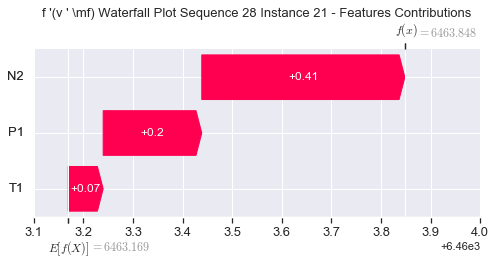

None

Contribution: [ 0.50451023 -1.41302397  0.69149642]


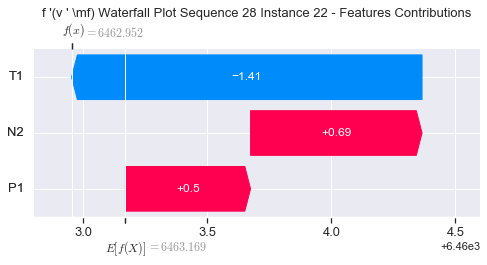

None

Contribution: [ 1.11571096 -5.10307907  1.51656885]


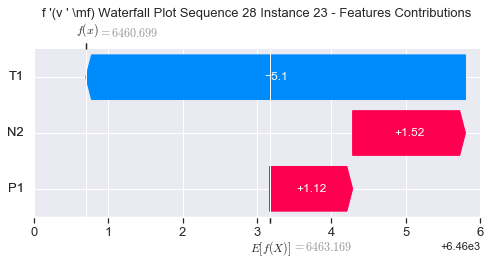

None

Contribution: [  4.66728553 -16.59140967   4.31955667]


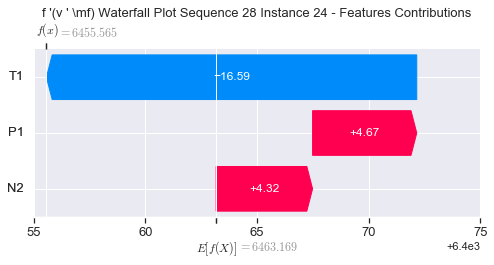

None

Contribution: [ 136.7645461  -359.52583085   84.78987007]


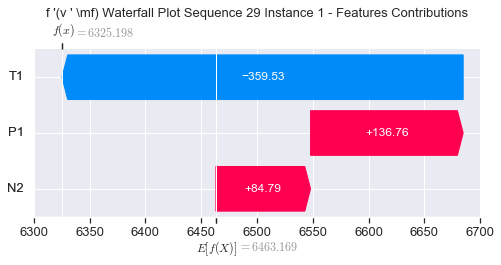

None

Contribution: [-0.53617291  4.96695587  2.09069009]


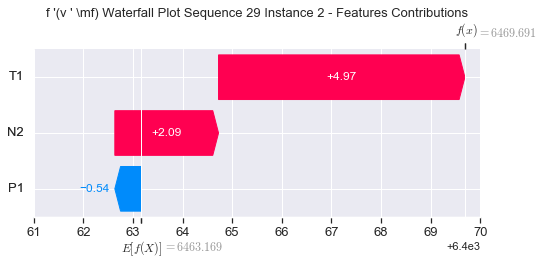

None

Contribution: [ 1.54005647 -6.03387429  1.46964688]


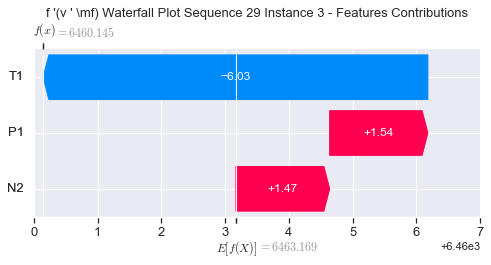

None

Contribution: [ 0.31699564 -0.40880318  0.53984423]


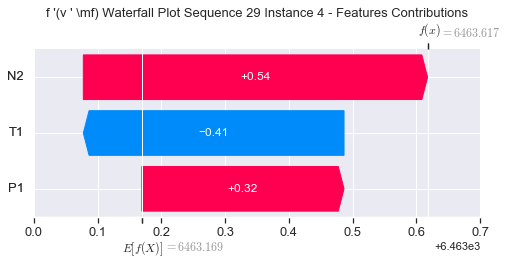

None

Contribution: [ 0.17532614 -0.22719002  0.37204596]


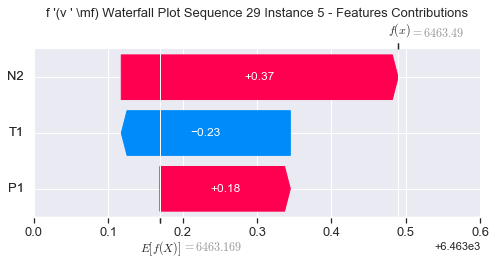

None

Contribution: [ 0.20510437 -0.27014244  0.34686211]


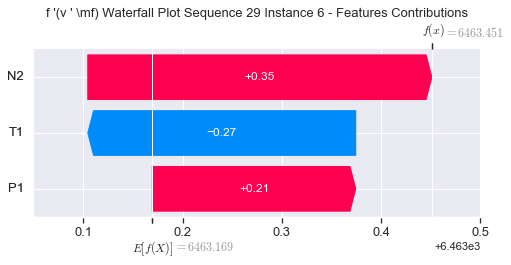

None

Contribution: [ 0.20564275 -0.29247283  0.33766083]


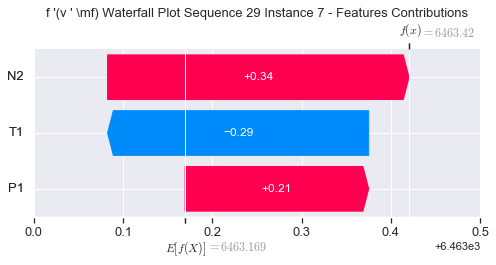

None

Contribution: [ 0.19126545 -0.27803689  0.32577429]


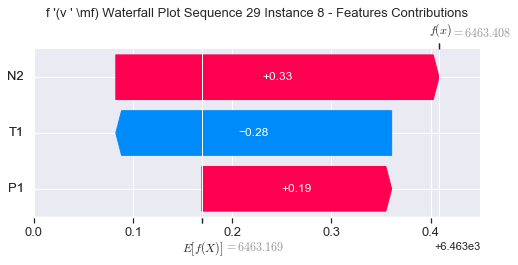

None

Contribution: [ 0.17090096 -0.29399729  0.31793584]


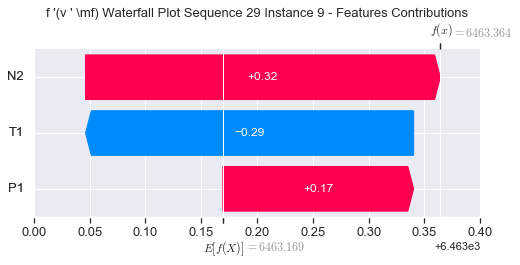

None

Contribution: [ 0.11138248 -0.26899972  0.3046218 ]


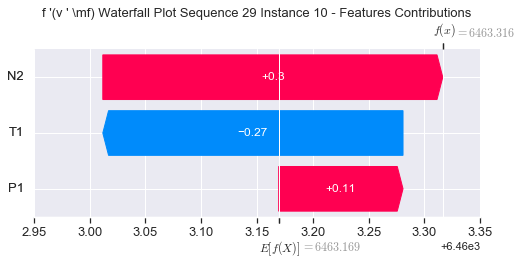

None

Contribution: [ 0.17045299 -0.25336639  0.30868577]


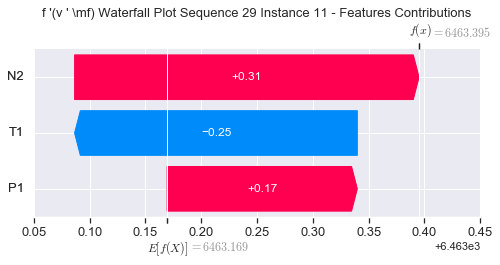

None

Contribution: [ 0.18149201 -0.25123372  0.29834169]


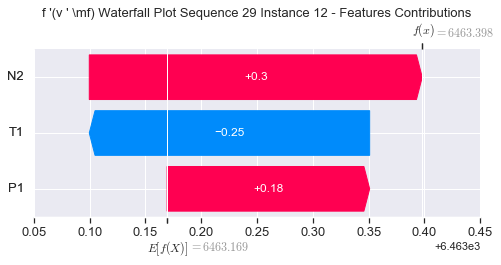

None

Contribution: [ 0.16662642 -0.19774707  0.28995187]


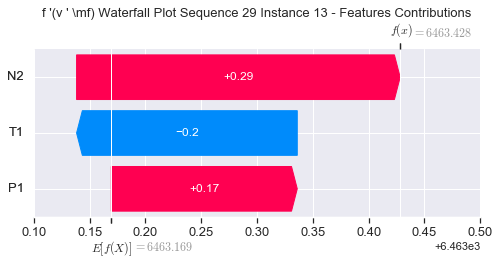

None

Contribution: [ 0.18443935 -0.14194699  0.28816742]


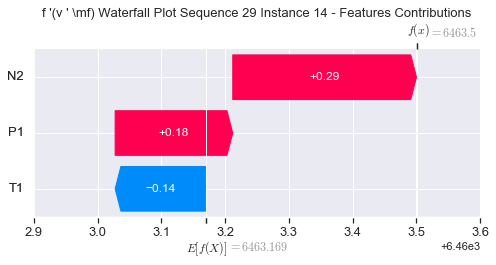

None

Contribution: [ 0.13964044 -0.0818943   0.27682887]


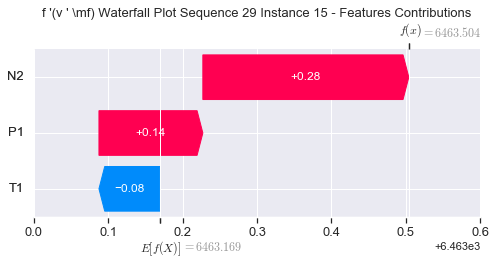

None

Contribution: [ 0.13597885 -0.02898244  0.27173725]


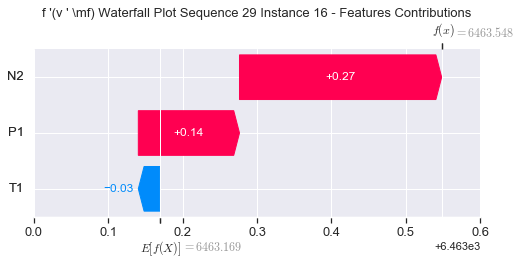

None

Contribution: [0.11230731 0.09793911 0.26638865]


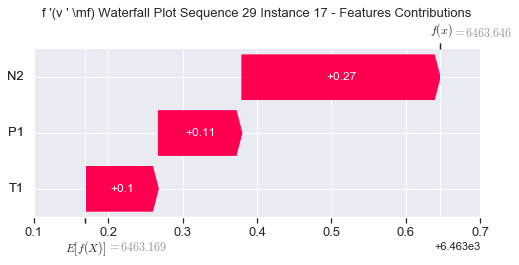

None

Contribution: [0.10511615 0.18188768 0.26689152]


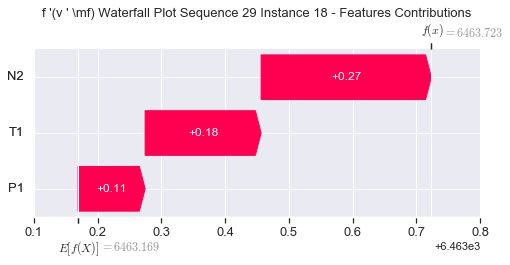

None

Contribution: [0.08710036 0.2302888  0.2798892 ]


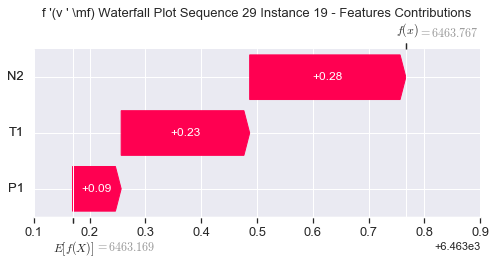

None

Contribution: [0.13683303 0.11003236 0.31477892]


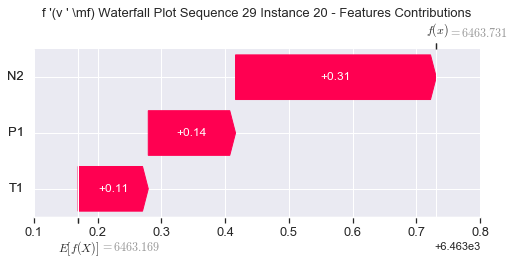

None

Contribution: [ 0.21385707 -0.34353058  0.41832714]


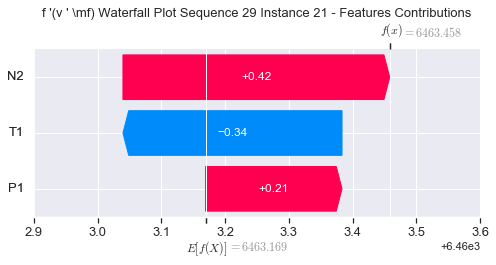

None

Contribution: [ 0.30426691 -1.4529512   0.69058043]


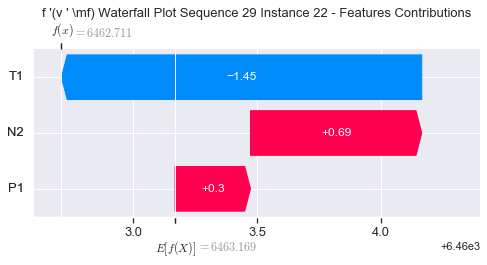

None

Contribution: [ 0.67585173 -4.29784205  1.58672458]


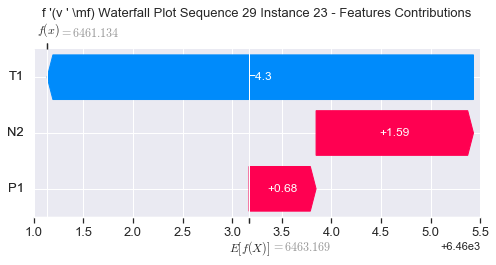

None

Contribution: [ 1.02230836 -9.0448068   4.07448358]


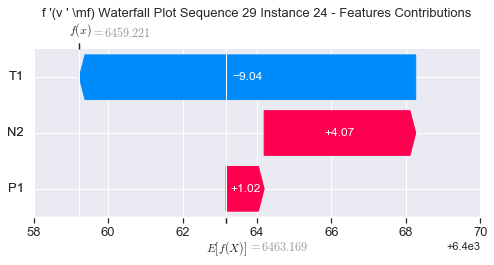

None

Contribution: [  12.18601008 -130.0061393    66.7398019 ]


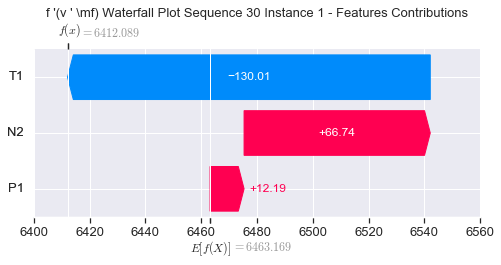

None

Contribution: [0.88039394 3.68795828 2.0885797 ]


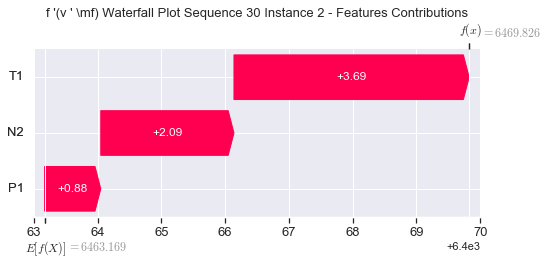

None

Contribution: [ 0.2188352  -2.58927976  1.32029174]


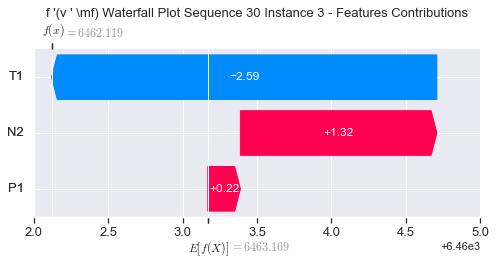

None

Contribution: [ 0.10369298 -0.12956345  0.50374918]


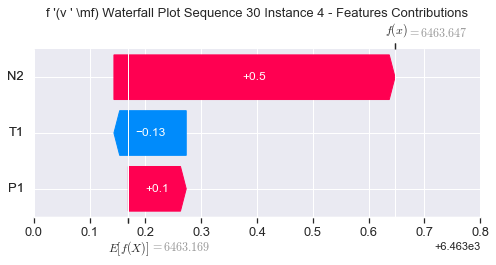

None

Contribution: [0.12395014 0.02941346 0.376104  ]


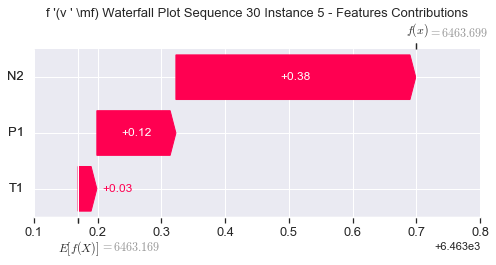

None

Contribution: [0.10880403 0.00739637 0.33801374]


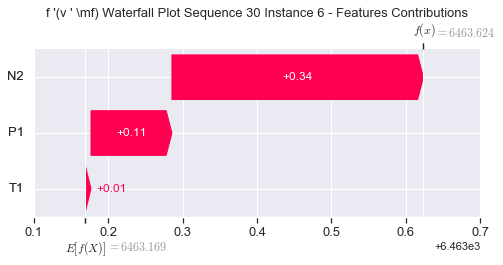

None

Contribution: [0.10541531 0.00164314 0.328049  ]


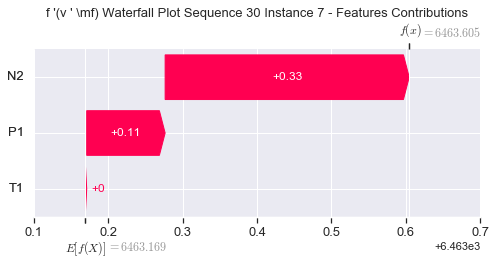

None

Contribution: [0.10128713 0.00119247 0.31681186]


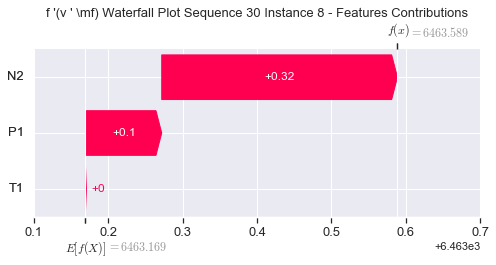

None

Contribution: [0.09121531 0.0226132  0.31085424]


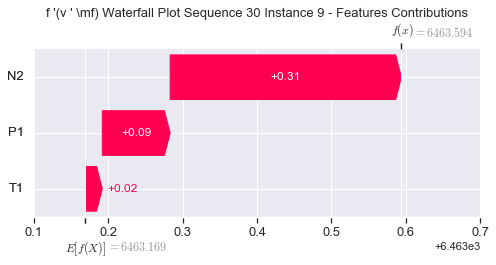

None

Contribution: [0.08668525 0.02065408 0.30766372]


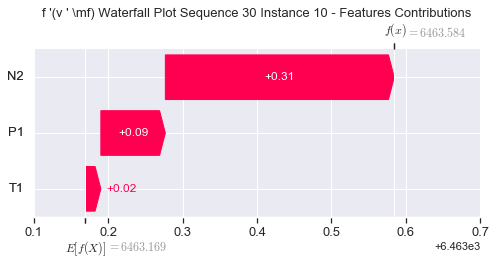

None

Contribution: [0.08363532 0.03346567 0.29662297]


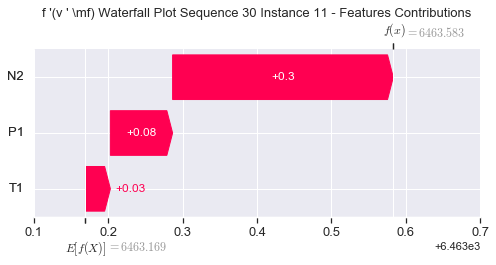

None

Contribution: [0.08576583 0.01933115 0.28503811]


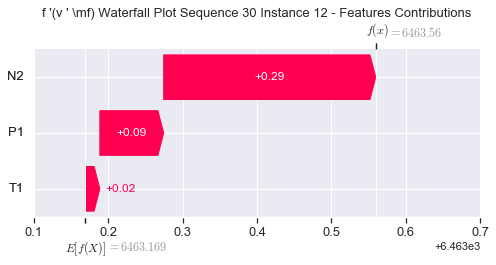

None

Contribution: [0.08674395 0.05464997 0.27863577]


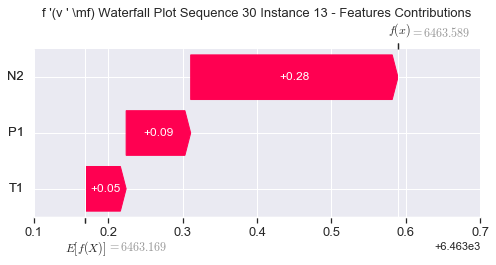

None

Contribution: [0.08603691 0.07880529 0.27013462]


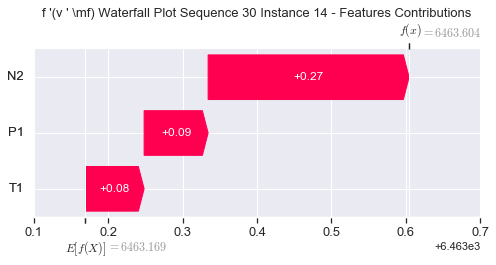

None

Contribution: [0.08234619 0.12872161 0.26736123]


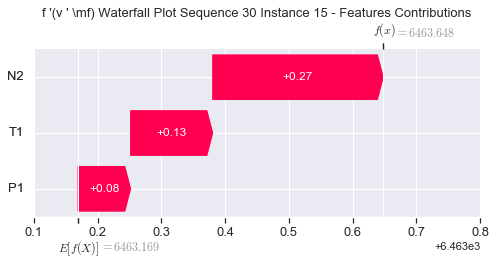

None

Contribution: [0.09217497 0.19131788 0.26140991]


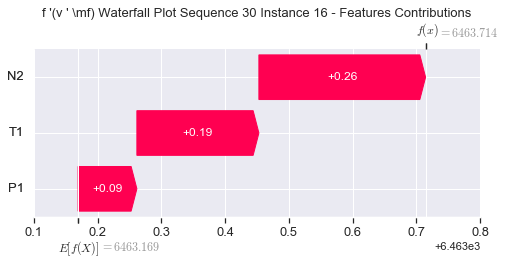

None

Contribution: [0.08381756 0.27800279 0.26073856]


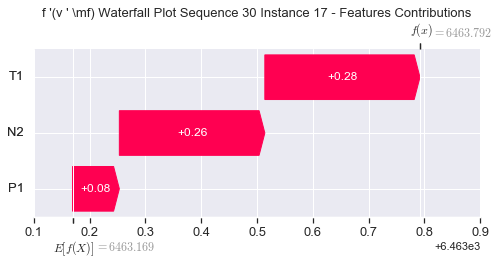

None

Contribution: [0.08596618 0.36280257 0.26254788]


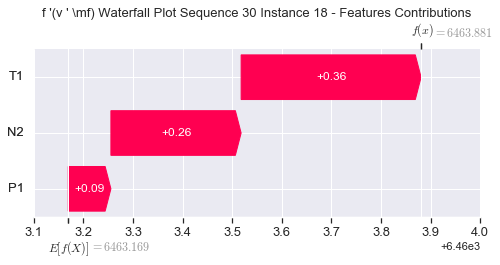

None

Contribution: [0.07523377 0.42122882 0.2775139 ]


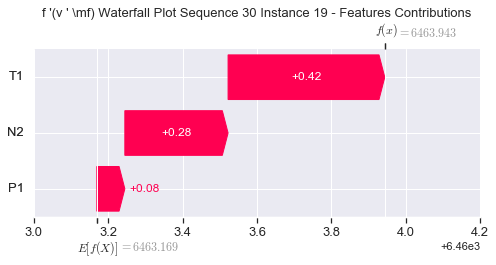

None

Contribution: [0.09993428 0.41138536 0.30738866]


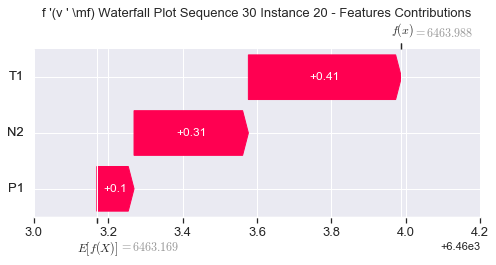

None

Contribution: [0.1266033  0.1742306  0.39914535]


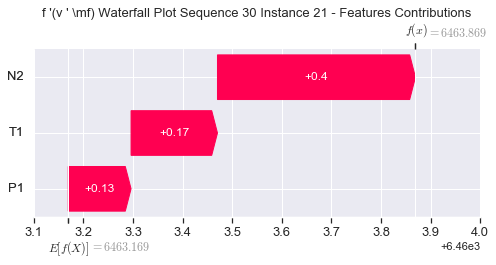

None

Contribution: [ 0.1789235  -0.58164102  0.65773408]


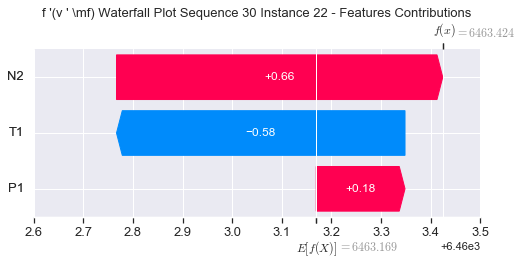

None

Contribution: [ 0.18670569 -2.60334769  1.43593276]


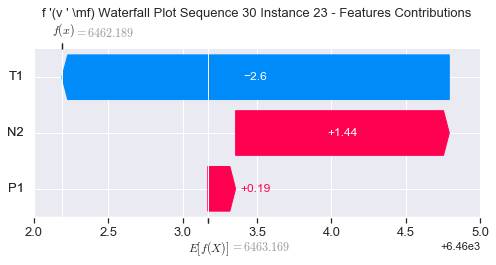

None

Contribution: [ 1.16221328 -6.91735846  3.92340204]


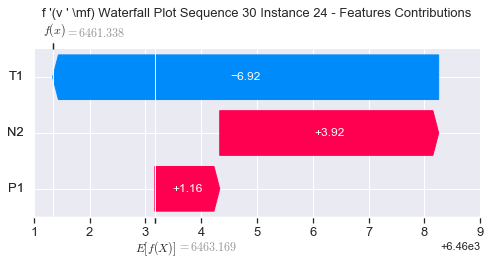

None

Contribution: [ 30.49114254 -91.99062547  66.41945029]


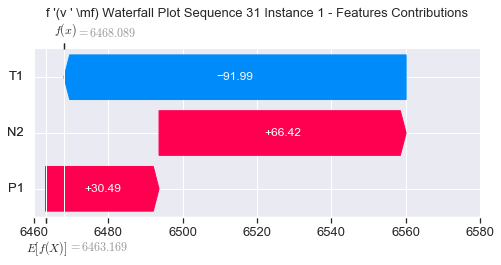

None

Contribution: [0.69029925 3.00043101 1.9873675 ]


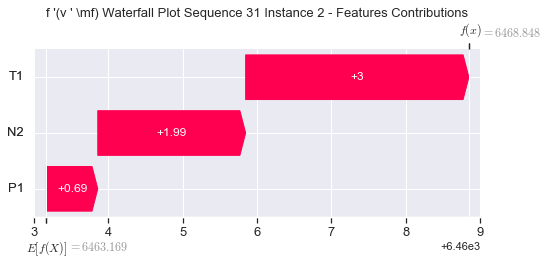

None

Contribution: [ 0.192584   -1.06780699  1.45792922]


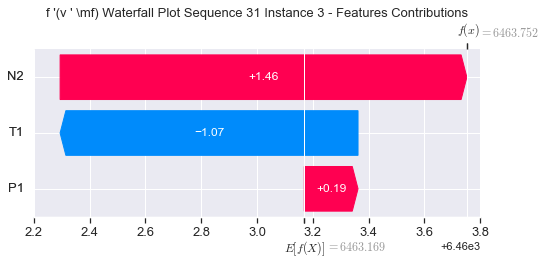

None

Contribution: [0.14703968 0.04701293 0.51444496]


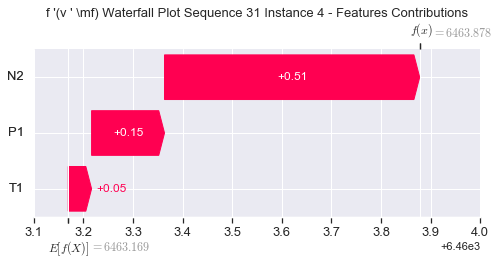

None

Contribution: [0.12442333 0.04703249 0.38732888]


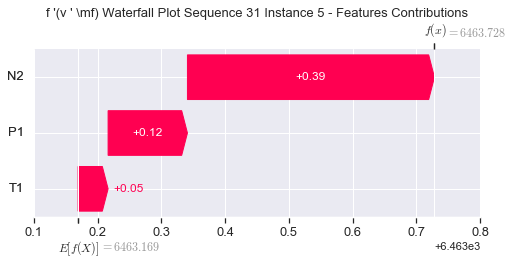

None

Contribution: [0.10321267 0.03266646 0.34413806]


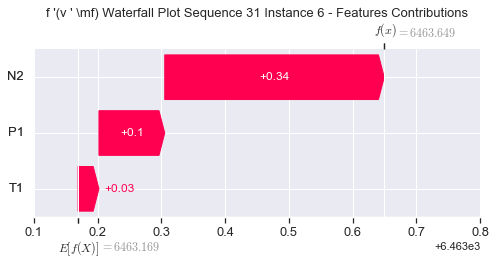

None

Contribution: [0.10143322 0.02862974 0.33378282]


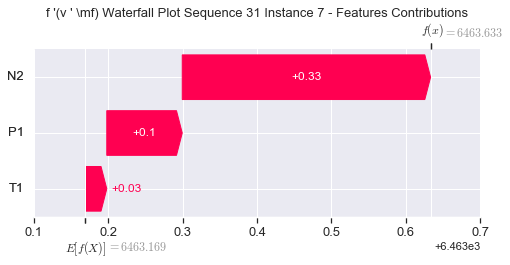

None

Contribution: [0.09976931 0.02844874 0.32243924]


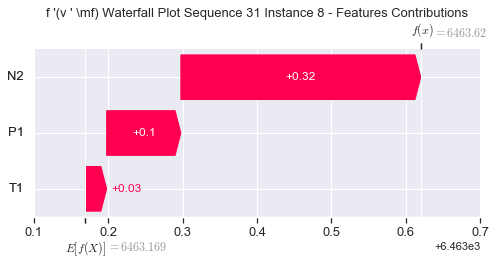

None

Contribution: [0.10452794 0.03763793 0.31826164]


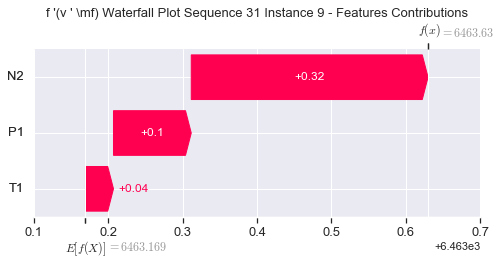

None

Contribution: [0.08747207 0.06294275 0.30935533]


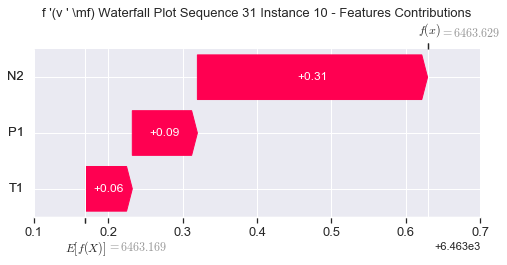

None

Contribution: [0.09220394 0.06507739 0.29936495]


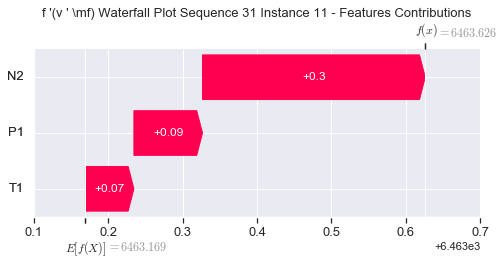

None

Contribution: [0.08464808 0.06779255 0.28498347]


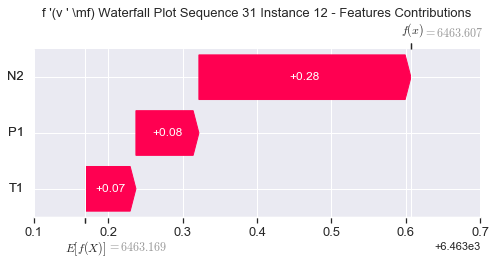

None

Contribution: [0.08650781 0.10713485 0.27887523]


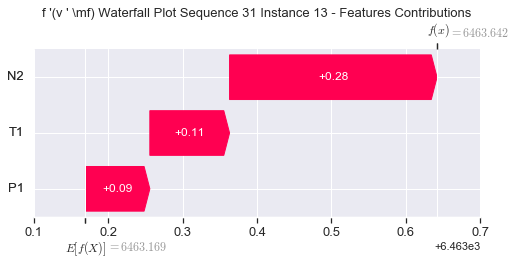

None

Contribution: [0.08376977 0.14349297 0.27208126]


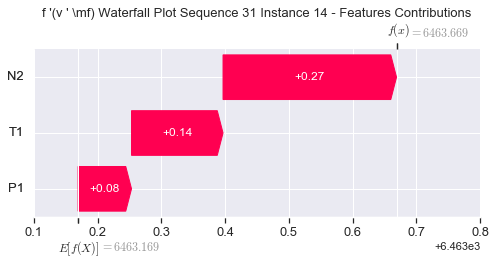

None

Contribution: [0.08216516 0.2002137  0.2662915 ]


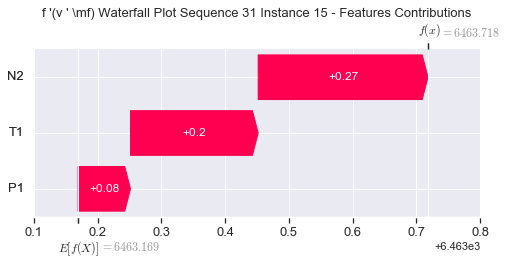

None

Contribution: [0.09425571 0.26705079 0.25599907]


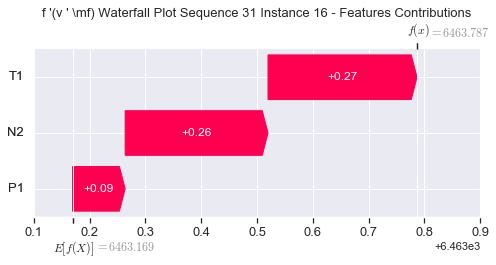

None

Contribution: [0.08166682 0.38027363 0.25866607]


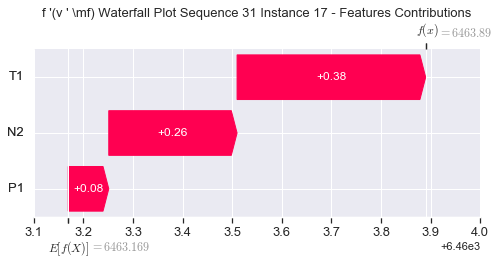

None

Contribution: [0.08316583 0.48588873 0.26021552]


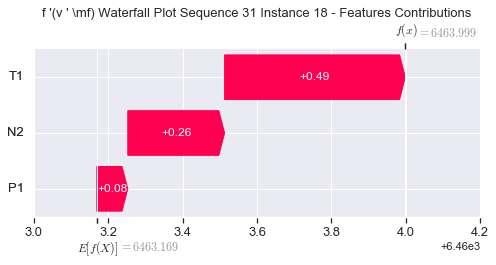

None

Contribution: [0.08115832 0.57479295 0.27006616]


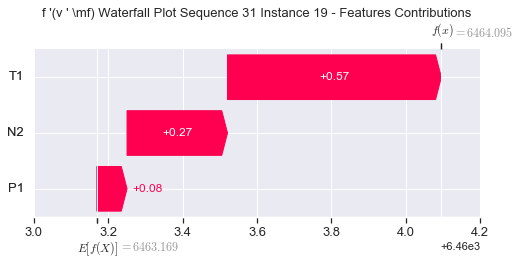

None

Contribution: [0.09455748 0.58067777 0.30587145]


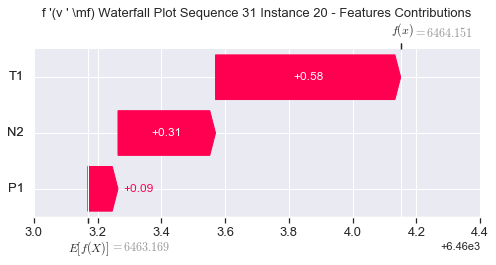

None

Contribution: [0.1423162  0.36182891 0.40645196]


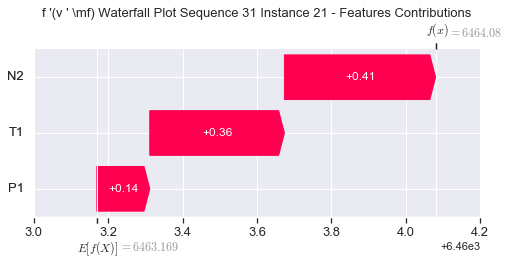

None

Contribution: [ 0.2630742  -0.39798701  0.68468965]


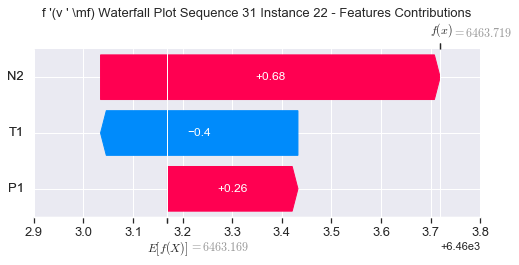

None

Contribution: [ 0.39355393 -2.41484456  1.48898168]


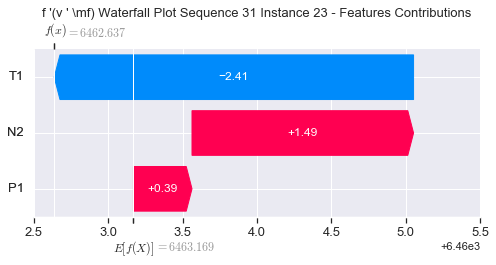

None

Contribution: [ 1.2071878  -7.69571572  3.97488432]


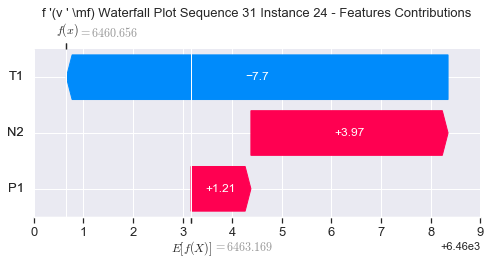

None

Contribution: [   8.75727428 -157.12014188   58.56551737]


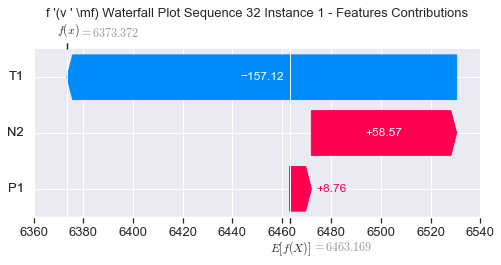

None

Contribution: [0.37726341 3.00302909 2.10936119]


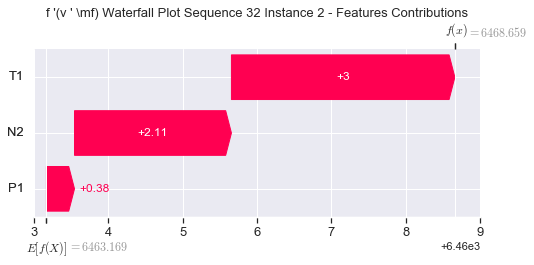

None

Contribution: [ 0.02294435 -1.74944128  1.38572854]


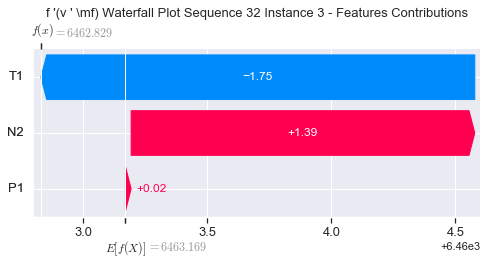

None

Contribution: [ 0.16818159 -0.01061578  0.53626628]


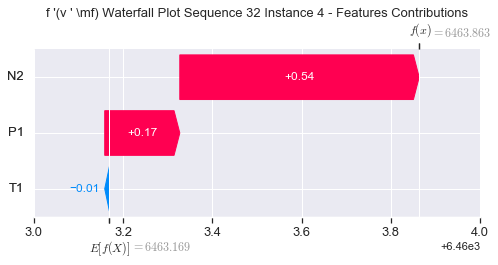

None

Contribution: [0.13534706 0.0124616  0.39479375]


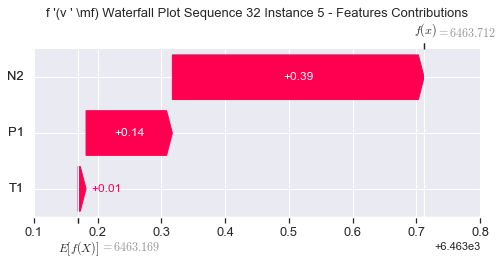

None

Contribution: [ 0.12014181 -0.00739202  0.35466037]


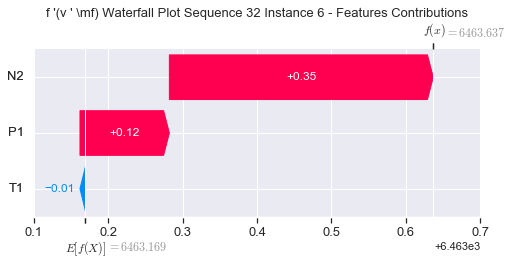

None

Contribution: [ 0.11632529 -0.01350058  0.3451598 ]


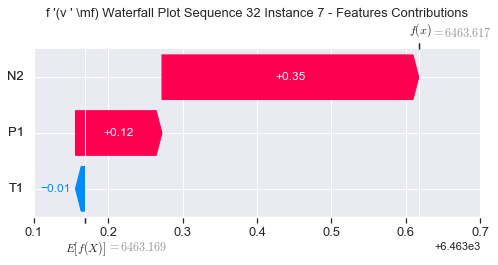

None

Contribution: [ 0.10998971 -0.01702101  0.33233789]


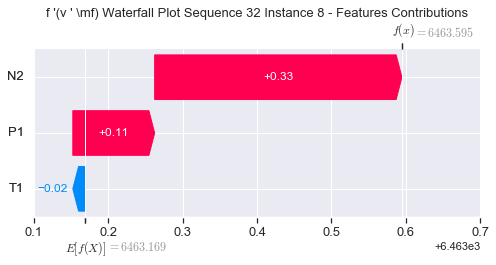

None

Contribution: [ 0.07883125 -0.002029    0.31505207]


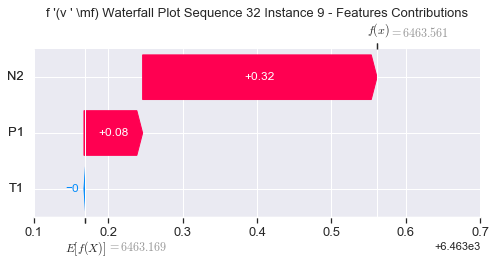

None

Contribution: [0.06169505 0.00907452 0.3006023 ]


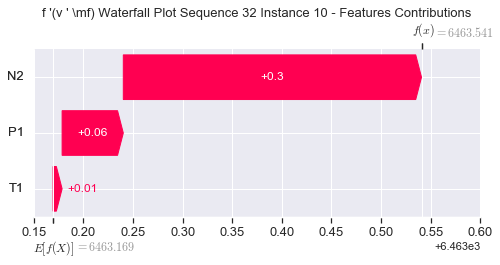

None

Contribution: [0.07942673 0.00931165 0.29985284]


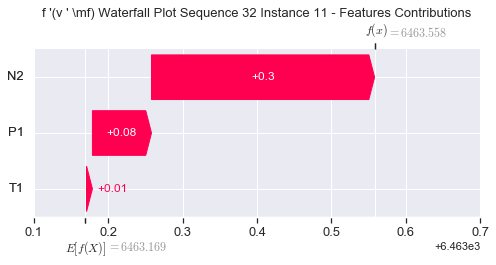

None

Contribution: [0.09999356 0.00755392 0.29932209]


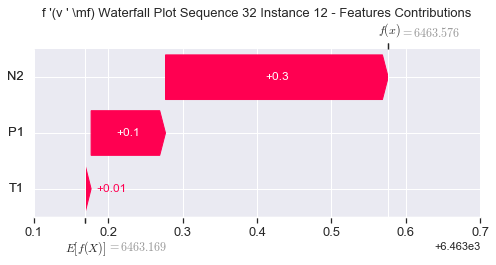

None

Contribution: [0.09774389 0.0356919  0.29184575]


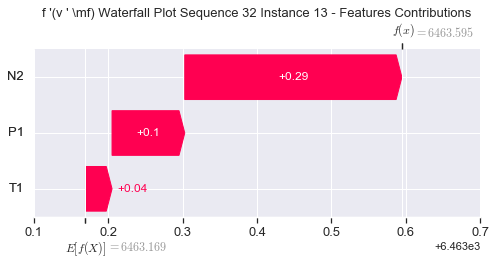

None

Contribution: [0.0877198  0.07839438 0.28266869]


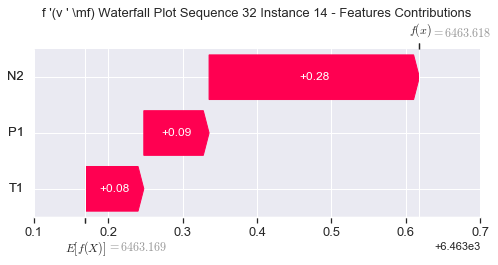

None

Contribution: [0.0874072  0.09120746 0.27540074]


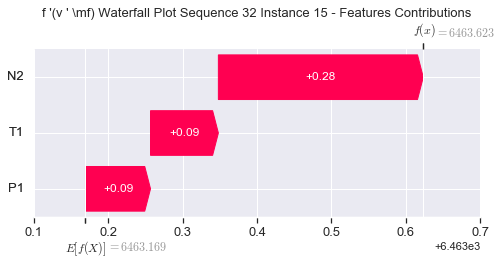

None

Contribution: [0.08740444 0.14469926 0.26548936]


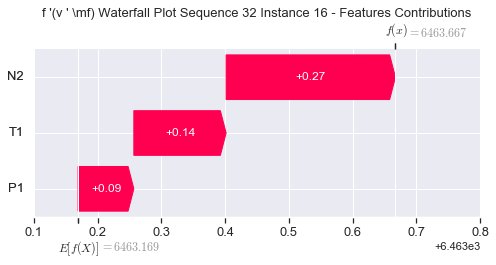

None

Contribution: [0.08490566 0.22373197 0.26251623]


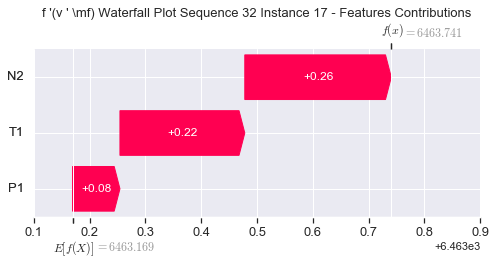

None

Contribution: [0.08551408 0.29835719 0.26166347]


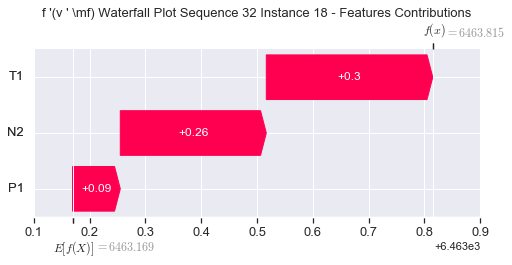

None

Contribution: [0.07370193 0.34968749 0.27629893]


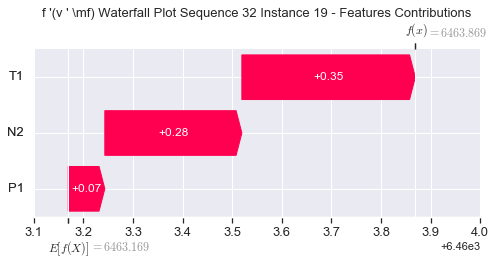

None

Contribution: [0.10319068 0.30871817 0.31746094]


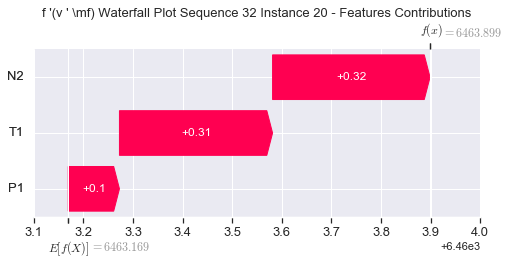

None

Contribution: [0.1439689  0.01448351 0.44481561]


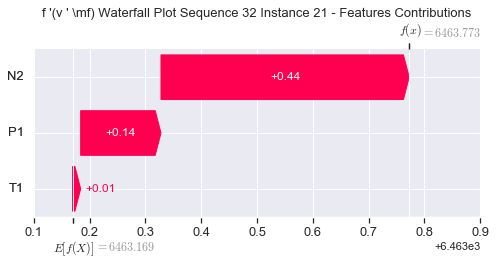

None

Contribution: [ 0.22992519 -0.90092798  0.79113933]


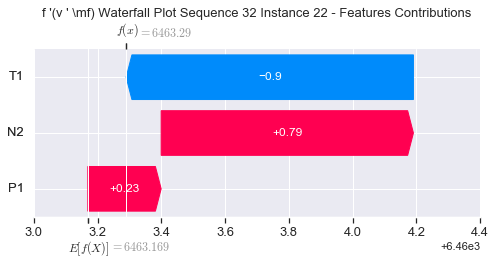

None

Contribution: [ 0.32022353 -3.28094374  1.77155641]


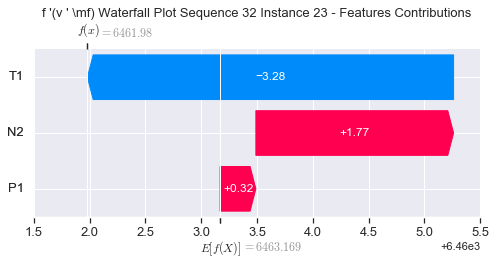

None

Contribution: [ 1.16316686 -8.9703419   4.67419375]


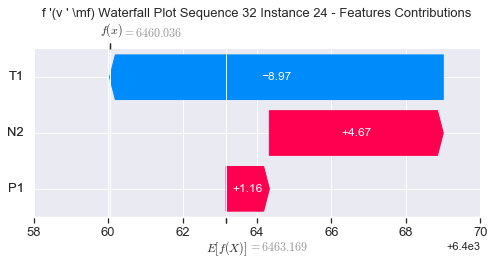

None

Contribution: [  19.13194279 -140.78742532   75.28971255]


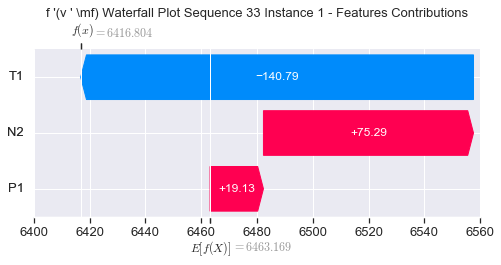

None

Contribution: [0.51954107 3.30144398 1.73782578]


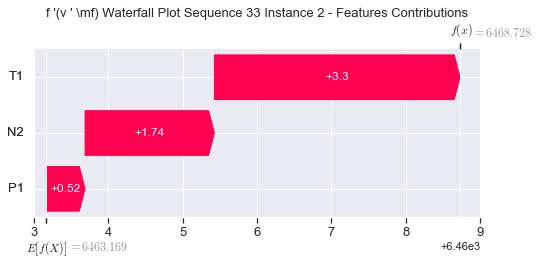

None

Contribution: [-0.01806557 -2.19394413  1.54774536]


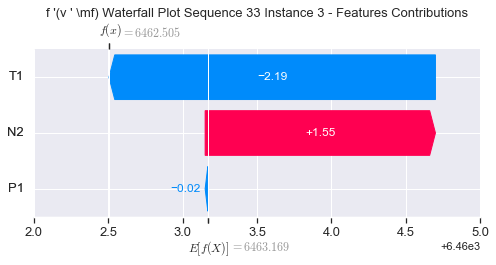

None

Contribution: [0.17312447 0.01981343 0.54064067]


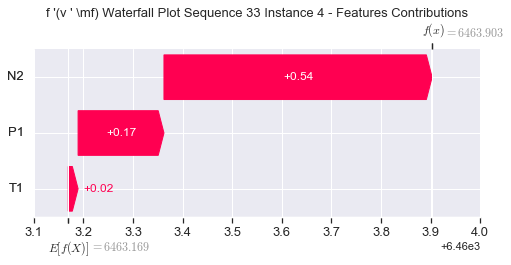

None

Contribution: [ 0.11146762 -0.00170652  0.38815359]


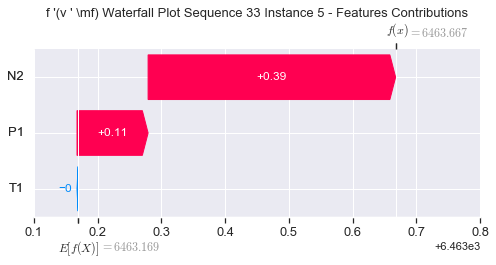

None

Contribution: [ 0.11083922 -0.01082732  0.34976408]


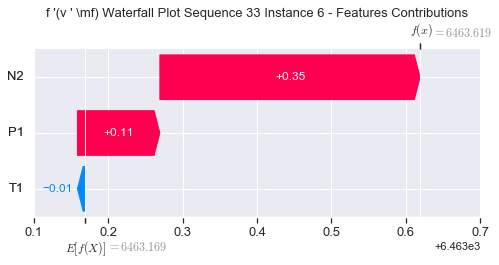

None

Contribution: [ 0.10359697 -0.02339305  0.33803464]


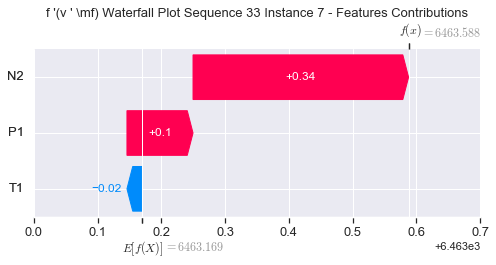

None

Contribution: [ 0.09761683 -0.02563911  0.32594751]


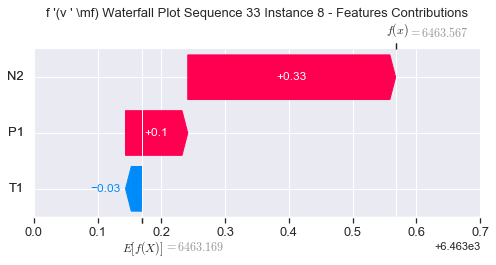

None

Contribution: [ 0.06216379 -0.02422524  0.31485918]


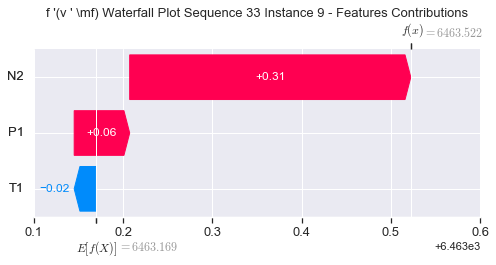

None

Contribution: [0.06503761 0.00443463 0.30273114]


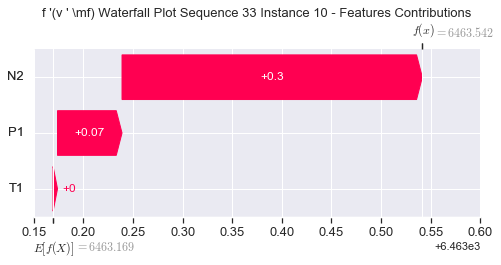

None

Contribution: [0.07694382 0.00606728 0.30252235]


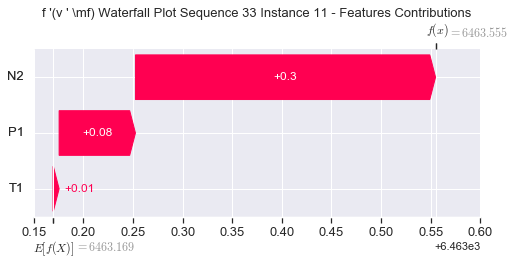

None

Contribution: [ 0.09073393 -0.00863021  0.28849964]


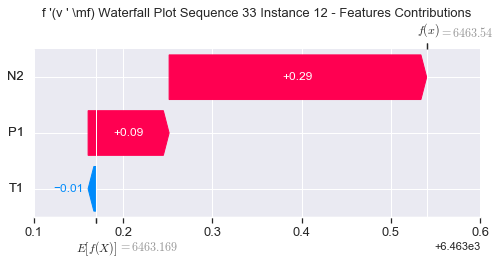

None

Contribution: [0.08713711 0.02696597 0.28096041]


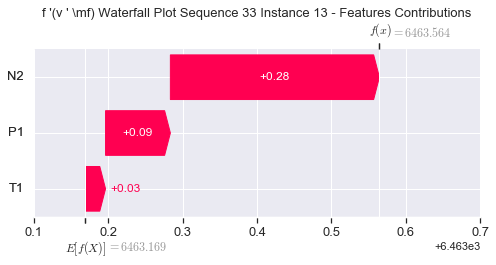

None

Contribution: [0.08393761 0.06347536 0.27113045]


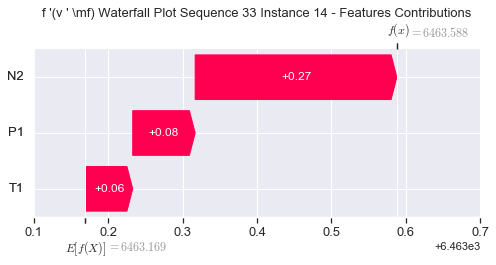

None

Contribution: [0.08257624 0.11219323 0.26781114]


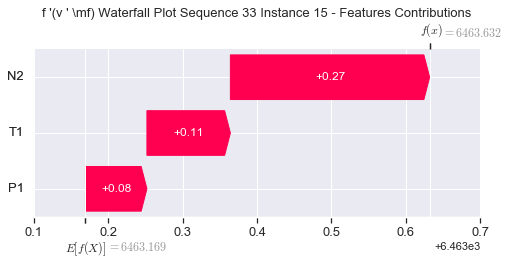

None

Contribution: [0.08932332 0.18545392 0.25957426]


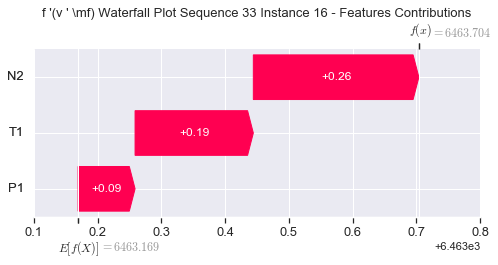

None

Contribution: [0.08379257 0.2824659  0.25984058]


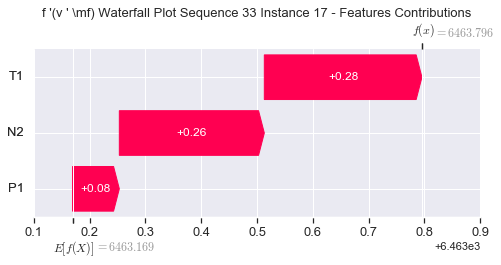

None

Contribution: [0.08617936 0.37727951 0.26147684]


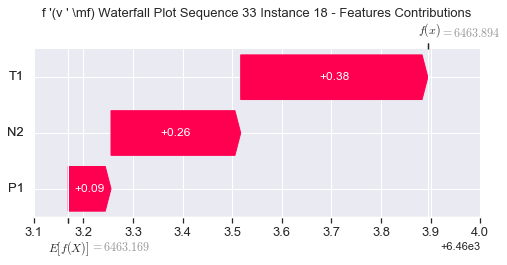

None

Contribution: [0.08057067 0.4417176  0.27750759]


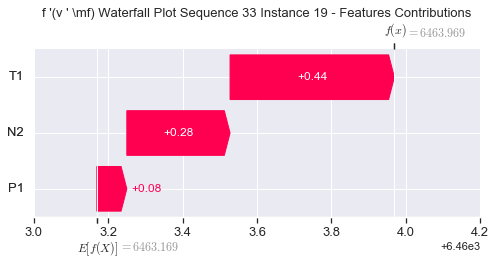

None

Contribution: [0.0945326  0.38803525 0.30576493]


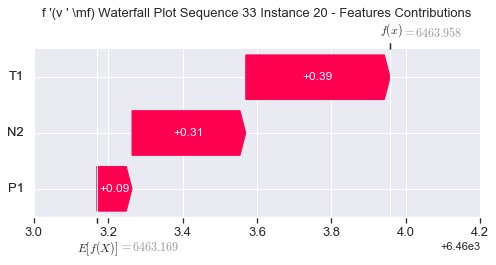

None

Contribution: [0.09510477 0.00370367 0.39434707]


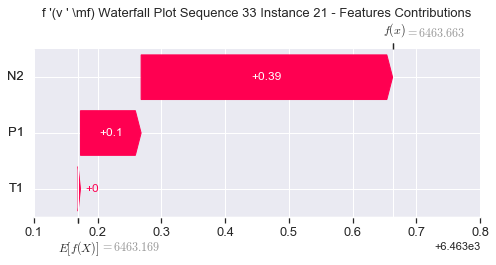

None

Contribution: [ 0.08547971 -1.16349491  0.64045599]


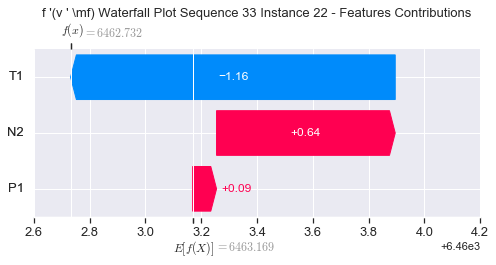

None

Contribution: [ 0.04391966 -4.07806559  1.38763797]


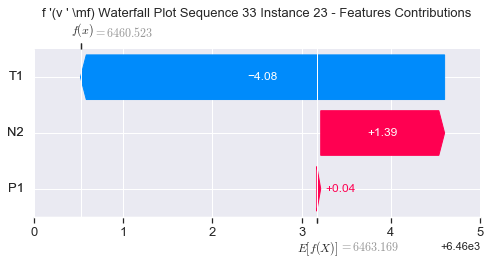

None

Contribution: [  0.61960493 -10.77485794   3.84595522]


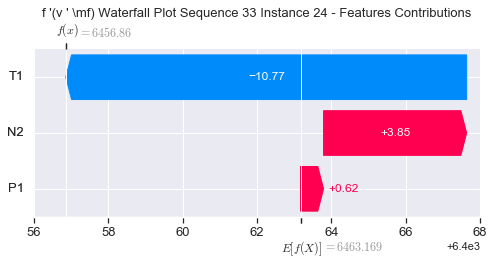

None

Contribution: [  18.26308593 -182.12753795   64.48942834]


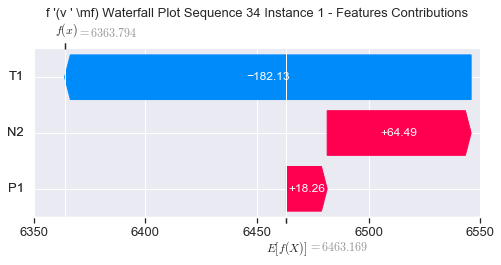

None

Contribution: [1.09213157 4.21150013 2.29585294]


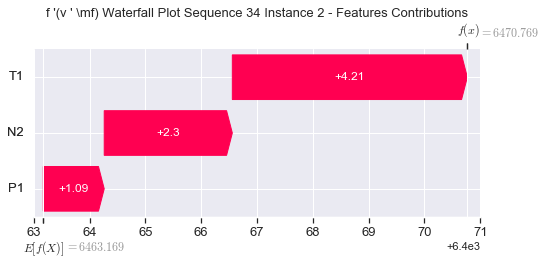

None

Contribution: [ 0.06186464 -3.41628296  1.28052954]


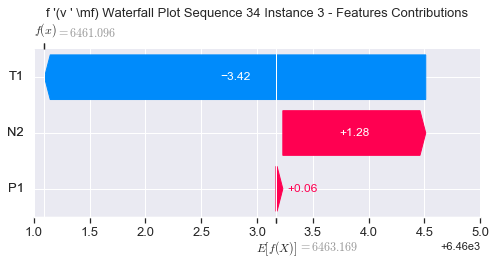

None

Contribution: [ 0.13876313 -0.13647252  0.50981797]


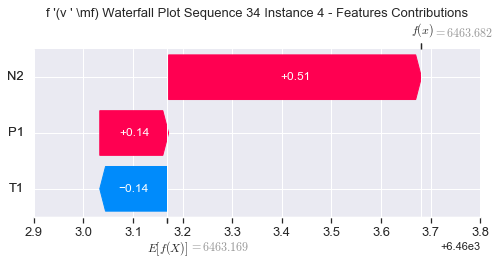

None

Contribution: [ 0.10110605 -0.06027705  0.36632941]


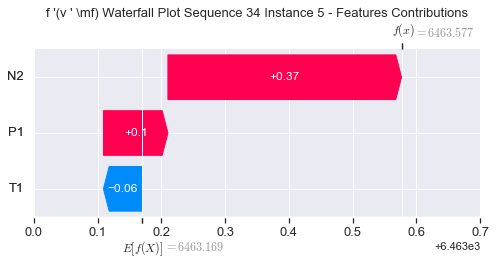

None

Contribution: [ 0.09017562 -0.06935456  0.33230463]


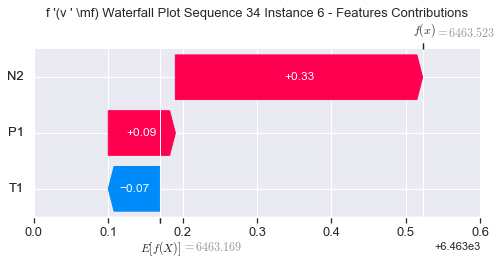

None

Contribution: [ 0.08630768 -0.07805514  0.32350128]


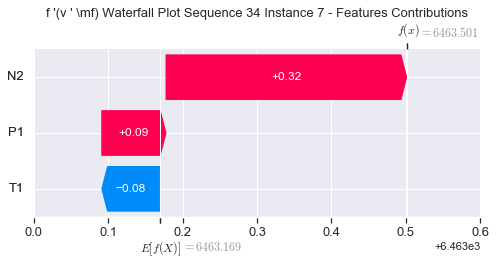

None

Contribution: [ 0.07892954 -0.0844742   0.31239991]


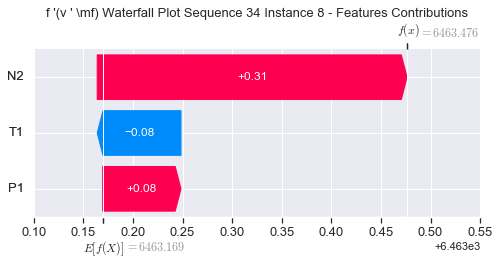

None

Contribution: [ 0.05252807 -0.0851356   0.3099754 ]


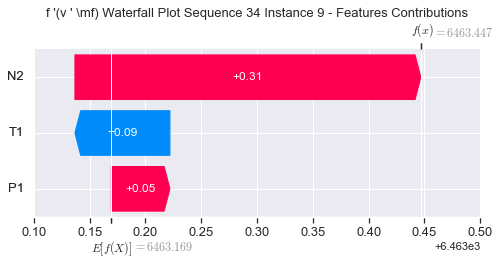

None

Contribution: [ 0.04164309 -0.08050643  0.30473289]


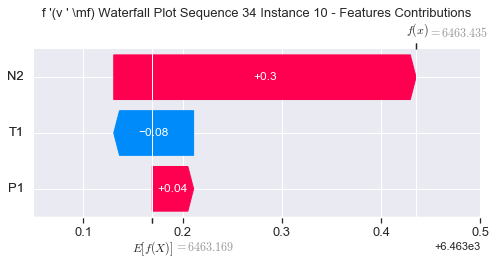

None

Contribution: [ 0.04585807 -0.06438462  0.29537094]


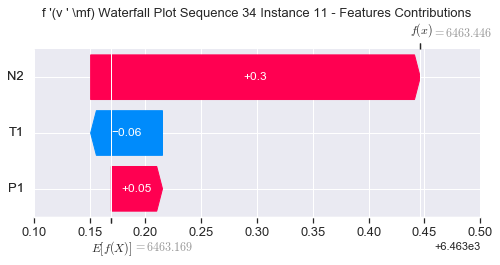

None

Contribution: [ 0.06060636 -0.05851692  0.28397753]


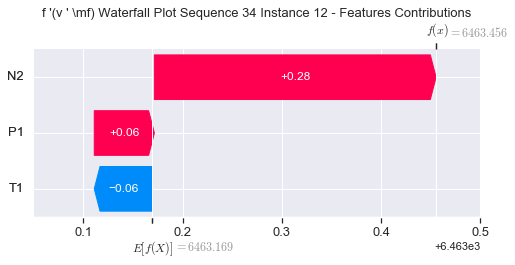

None

Contribution: [ 0.06432091 -0.02726367  0.27795612]


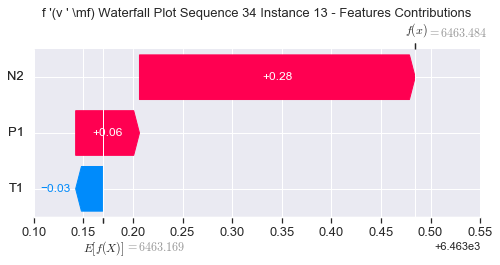

None

Contribution: [ 0.04995126 -0.00243791  0.27115122]


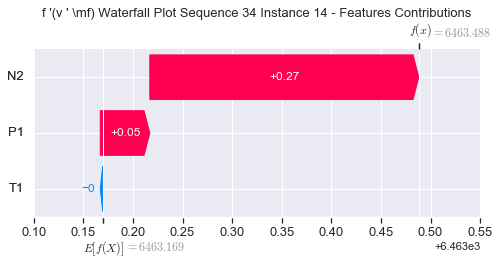

None

Contribution: [0.06887967 0.04439227 0.26720622]


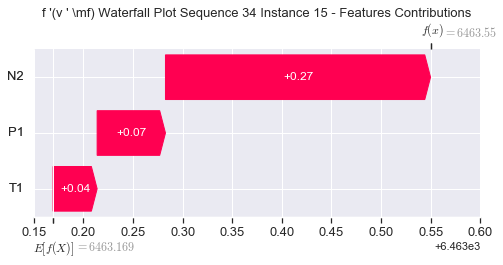

None

Contribution: [0.08361083 0.09943161 0.26513804]


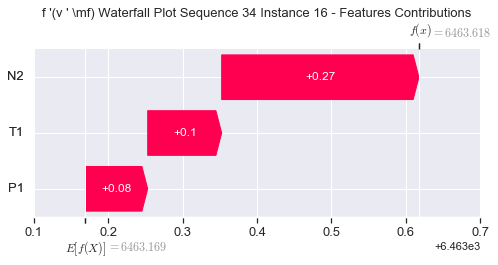

None

Contribution: [0.07905951 0.18973889 0.26120889]


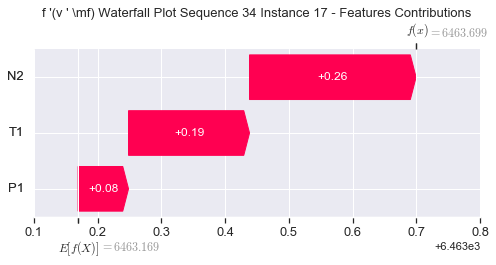

None

Contribution: [0.08371117 0.26704892 0.26258069]


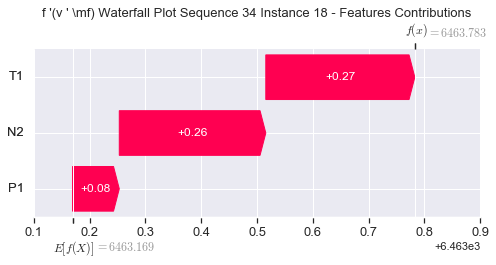

None

Contribution: [0.06823781 0.30628857 0.27690223]


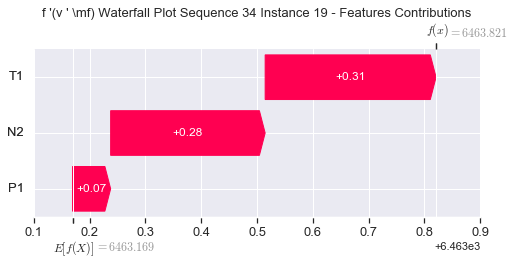

None

Contribution: [0.08541349 0.22581569 0.30697959]


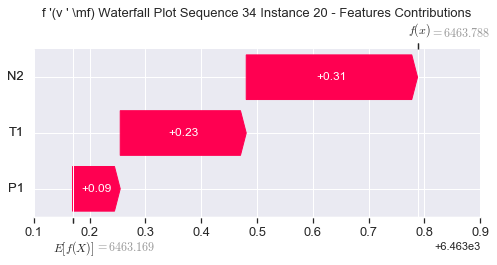

None

Contribution: [ 0.07056661 -0.19495099  0.39993947]


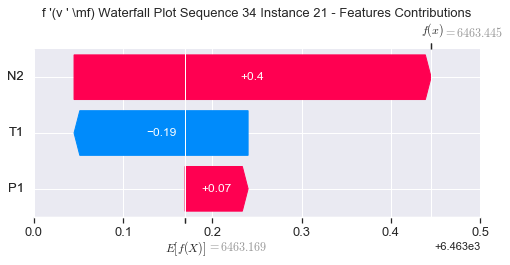

None

Contribution: [ 0.01242836 -1.41222549  0.65399151]


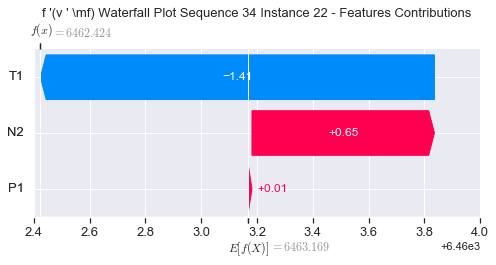

None

Contribution: [-0.23608708 -4.46697159  1.452426  ]


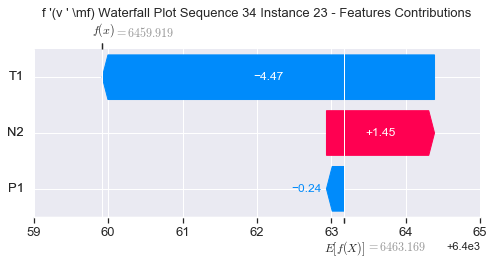

None

Contribution: [  0.19281565 -11.80017389   3.84604132]


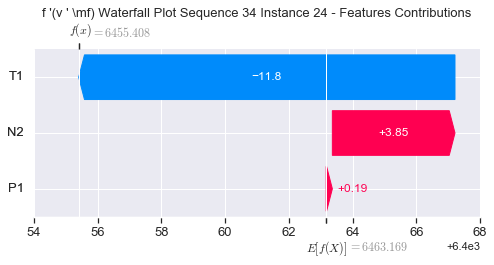

None

In [78]:
#Waterfall Plot for Consistency metric

sns.set()
instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("f '(v ' \mf) Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)